Esercizio

Ricostruzione della mappa

L'obiettivo consiste nel ricostruire una mappa attraverso informazioni sensoriali e attraverso un insieme di posizioni che assumerà il robot nei suoi movimenti.
Le zone più scure della mappa indicheranno un’alta probabilità che le celle, in quel punto, siano occupate.
Le zone più chiare della mappa indicheranno, invece, una più bassa probabilità che le celle in quel punto siano occupate.

Si importano le seguenti librerie

In [5]:
import scipy.io
import scipy.stats
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

Creaiamo una classe Map utile per creare e caricare l'oggetto mappa.

Definiamo i due metodi utili allo scopo:

- _init_ = tramite questo metodo (a cui passiamo come parametri: dimenzioni della mappa e numero di celle per riga xsize e per colonna ysize) definiamo le caratteristiche della mappa, in particolare:
    - aggiungiamo due celle extra per i bordi, sia in orizzontale che in verticale e salviamo le dimensioni della griglia;
    - settiamo a 0 tutti i valori randomici binari di ogni cella;
    - settiamo alpha, beta e z_max che corrispondo rispettivamente a spessore degli ostacoli, larghezza del raggio laser e distanza massima di lettura del laser;
    - precalcoliamo le coordinate di tutte le celle per velocizzare;
    - settiamo le percentuali che rendono una cella libera o occupata.

- _update_map_ = tramite questo metodo (a cui passiamo come parametri: l' oggetto self(la mappa), la posizione del robot e il dato sensoriale ) vengono calcolate le celle libere e le celle occupate tramite l'algoritmo di inverse range sensor model, che si basa sulla posizione corrente e sul dato sensoriale rilevato.






In [6]:
class Map():

    def __init__(self, xsize, ysize, grid_size):
        self.xsize = xsize+2 # Add extra cells for the borders
        self.ysize = ysize+2
        self.grid_size = grid_size # save this off for future use
        self.log_prob_map = np.zeros((self.xsize, self.ysize)) # set all to zero

        self.alpha = 1.0 # settiamo alpha= spessore ostacoli 
        self.beta = 5.0*np.pi/180.0 # settiamo beta= larghezza del raggio laser
        self.z_max = 150.0 # settiamo la massima lettura del laser(la distanza massima)

        # Pre-allocare la posizione x e y di tutte le posizioni della griglia in un tensore 3D
        self.grid_position_m = np.array([np.tile(np.arange(0, self.xsize*self.grid_size, self.grid_size)[:,None], (1, self.ysize)),
                                         np.tile(np.arange(0, self.ysize*self.grid_size, self.grid_size)[:,None].T, (self.xsize, 1))])

        # settiamo le percentuali(probabilità logaritmica, log-odd )  che rendono una cella libera o occupata
        self.l_occ = np.log(0.65/0.35)
        self.l_free = np.log(0.35/0.65)
    
    def update_map(self, pose, z):

        dx = self.grid_position_m.copy() # A tensore di coordinate di tutte le celle
        dx[0, :, :] -= pose[0] # Una mtarice di tutte le coordinate x delle celle 
        dx[1, :, :] -= pose[1] # Una matrice di tutte le coordinate y delle celle 
        theta_to_grid = np.arctan2(dx[1, :, :], dx[0, :, :]) - pose[2] # Una matrice di tutti i cuscinetti dal robot alle celle 

        # conversione angolo in radianti
        theta_to_grid[theta_to_grid > np.pi] -= 2. * np.pi
        theta_to_grid[theta_to_grid < -np.pi] += 2. * np.pi

        # matrice delle distanze (calcolate utilizzando la norma 2) di tutte le celle rispetto alla posizione del robot
        dist_to_grid = scipy.linalg.norm(dx, axis=0) # matrix of L2 distance to all cells from robot

        # For each laser beam
        for z_i in z:
            r = z_i[0] #  (range del raggio laser)
            b = z_i[1] #  (angolo percepito (misura del raggio laser))

            free_mask = (np.abs(theta_to_grid - b) <= self.beta/2.0) & (dist_to_grid < (r - self.alpha/2.0))
            occ_mask = (np.abs(theta_to_grid - b) <= self.beta/2.0) & (np.abs(dist_to_grid - r) <= self.alpha/2.0)

            # Adjust the cells appropriately
            self.log_prob_map[occ_mask] += self.l_occ
            self.log_prob_map[free_mask] += self.l_free

Carichiamo posizione del robot nella mappa e misurazioni sensoriali per la simulazione.

Definiamo i parametri della mappa costruendo una mappa 100x100 con celle 1x1.

Per ogni posizione che il robot assume e per ogni dato sensoriale ricevuto, viene chiamato il metodo update_map, dettagliato precedentemente, per aggiornare la mappa.

Infine, viene plottato il risultato.

  0%|          | 0/759 [00:00<?, ?it/s]

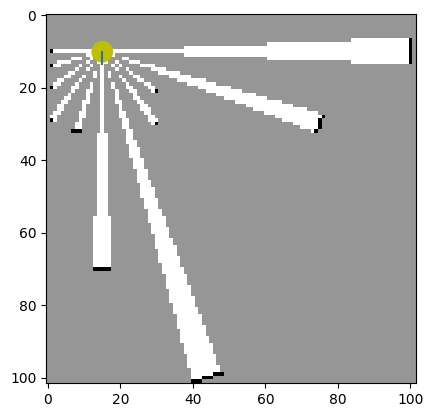

  0%|          | 1/759 [00:00<06:33,  1.93it/s]

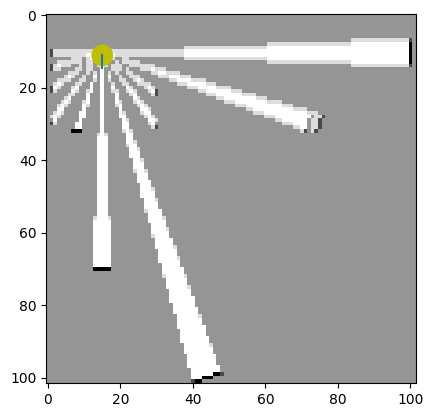

  0%|          | 2/759 [00:00<05:50,  2.16it/s]

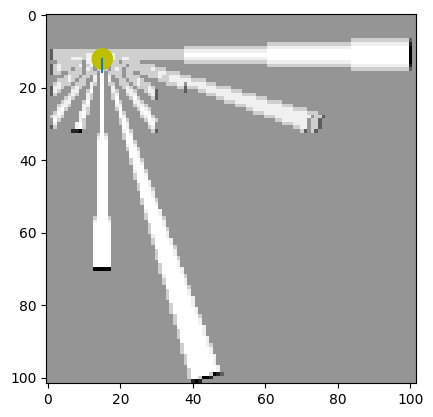

  0%|          | 3/759 [00:01<05:10,  2.43it/s]

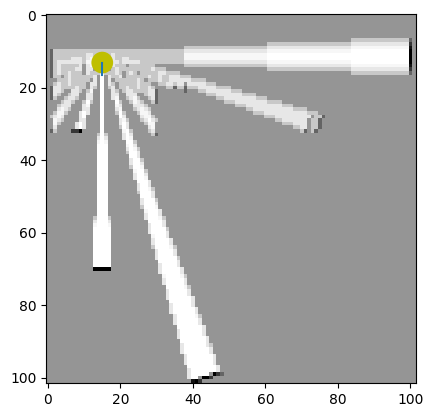

  1%|          | 4/759 [00:01<05:00,  2.51it/s]

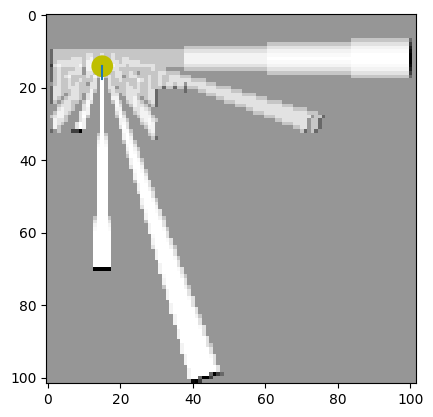

  1%|          | 5/759 [00:02<04:50,  2.60it/s]

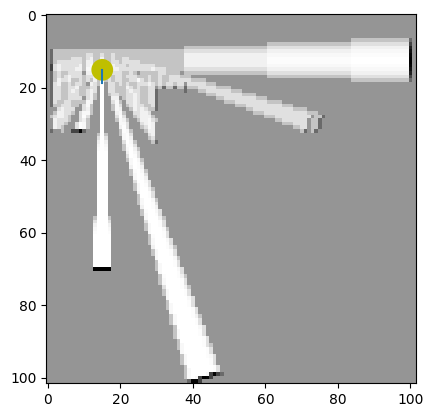

  1%|          | 6/759 [00:02<04:35,  2.74it/s]

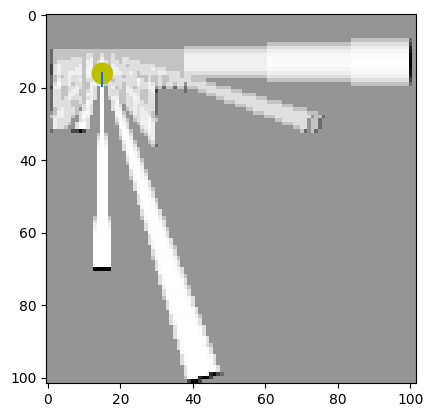

  1%|          | 7/759 [00:02<04:25,  2.83it/s]

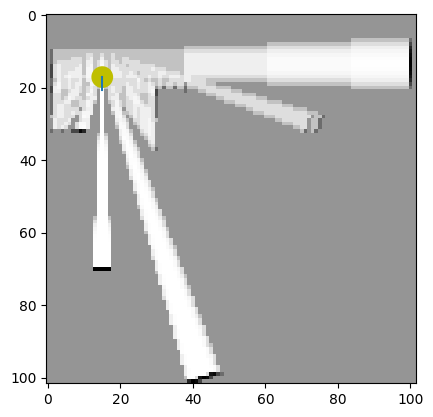

  1%|          | 8/759 [00:03<04:32,  2.76it/s]

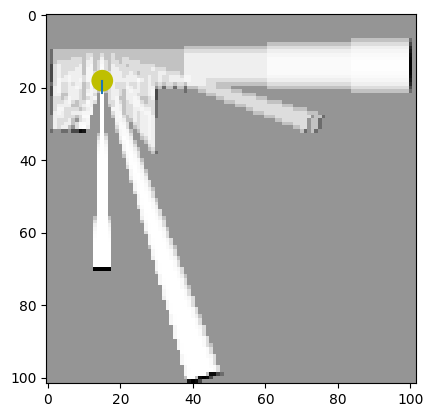

  1%|          | 9/759 [00:03<04:19,  2.88it/s]

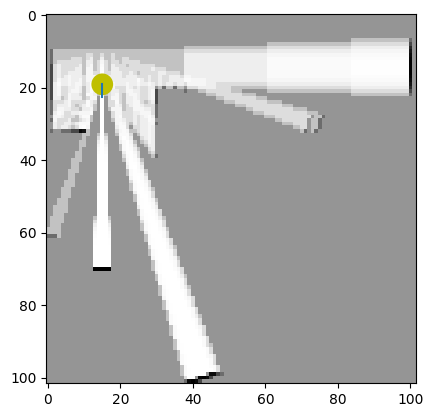

  1%|▏         | 10/759 [00:03<04:30,  2.77it/s]

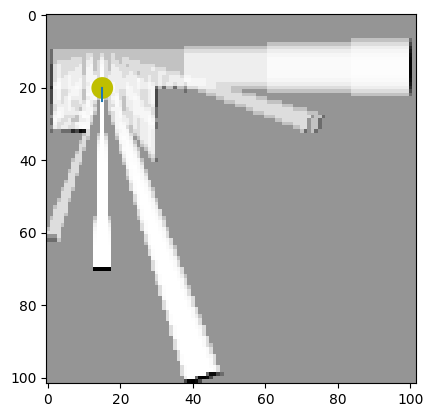

  1%|▏         | 11/759 [00:04<04:29,  2.78it/s]

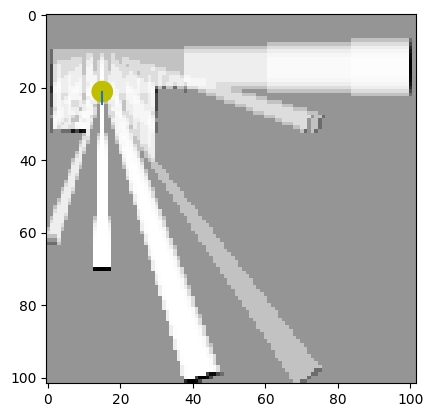

  2%|▏         | 12/759 [00:04<04:14,  2.93it/s]

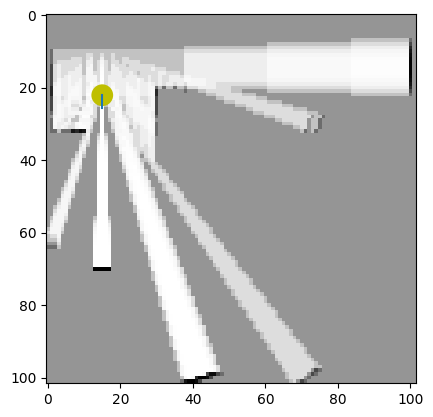

  2%|▏         | 13/759 [00:04<04:29,  2.77it/s]

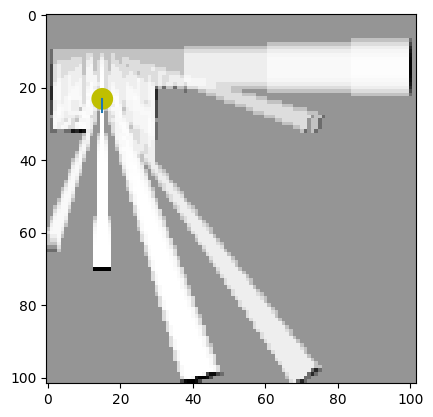

  2%|▏         | 14/759 [00:05<04:21,  2.85it/s]

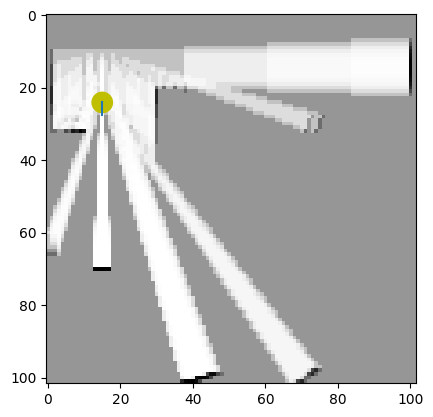

  2%|▏         | 15/759 [00:05<03:58,  3.11it/s]

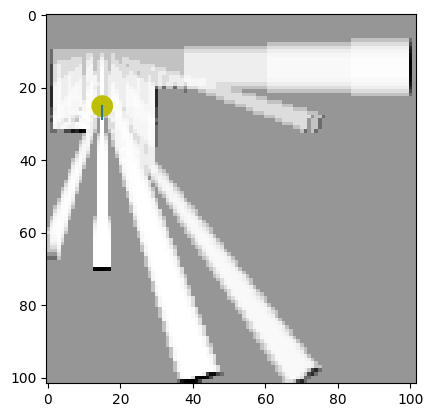

  2%|▏         | 16/759 [00:05<03:46,  3.27it/s]

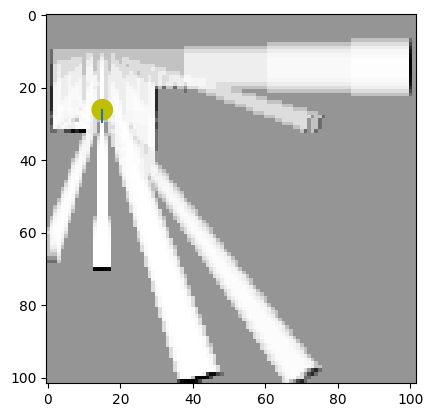

  2%|▏         | 17/759 [00:05<03:38,  3.39it/s]

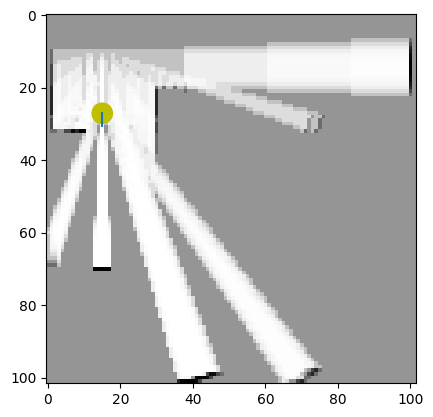

  2%|▏         | 18/759 [00:06<03:25,  3.60it/s]

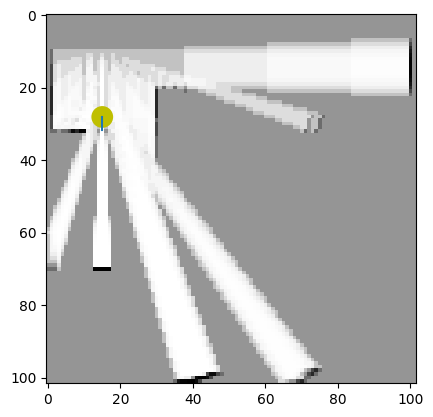

  3%|▎         | 19/759 [00:06<03:23,  3.63it/s]

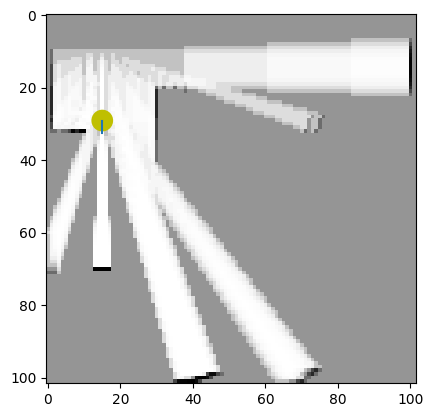

  3%|▎         | 20/759 [00:06<03:14,  3.80it/s]

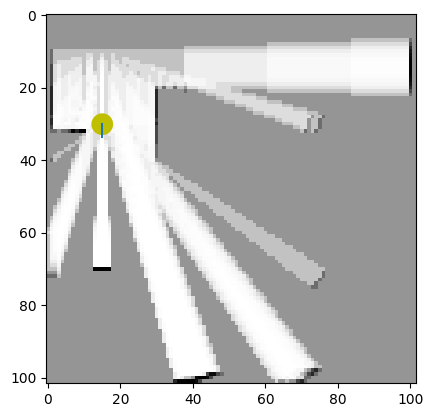

  3%|▎         | 21/759 [00:06<03:11,  3.85it/s]

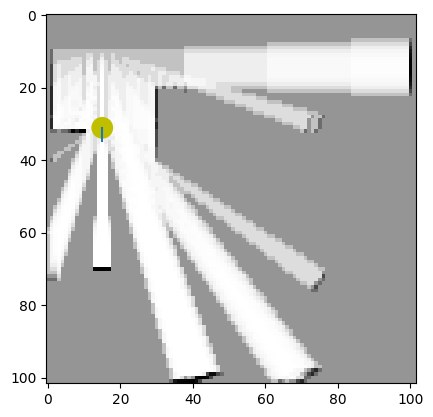

  3%|▎         | 22/759 [00:07<03:10,  3.87it/s]

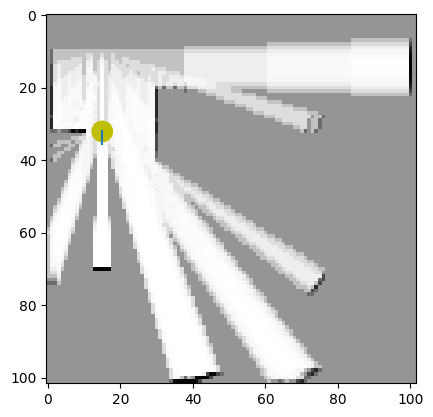

  3%|▎         | 23/759 [00:07<03:05,  3.97it/s]

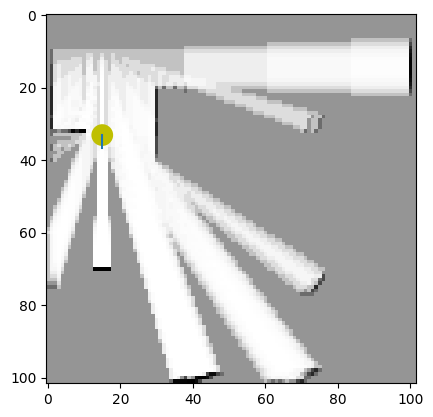

  3%|▎         | 24/759 [00:07<03:04,  3.97it/s]

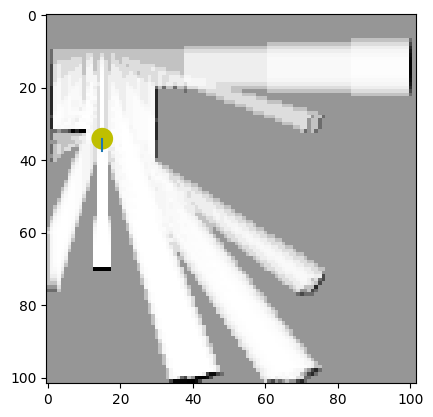

  3%|▎         | 25/759 [00:07<03:01,  4.04it/s]

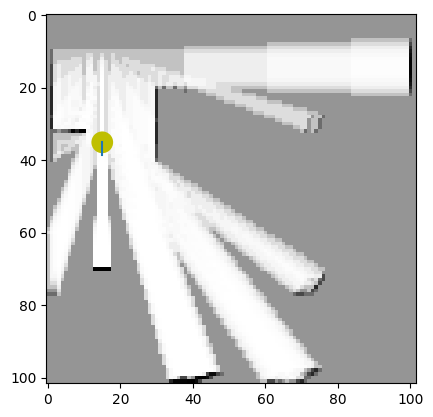

  3%|▎         | 26/759 [00:08<03:03,  3.99it/s]

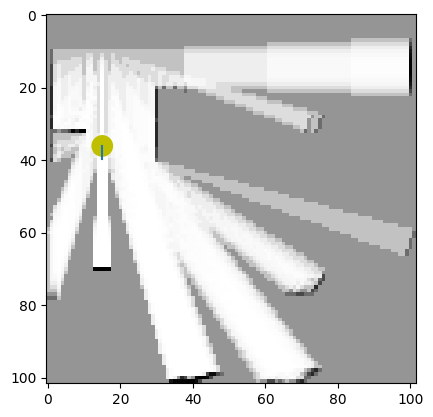

  4%|▎         | 27/759 [00:08<03:35,  3.40it/s]

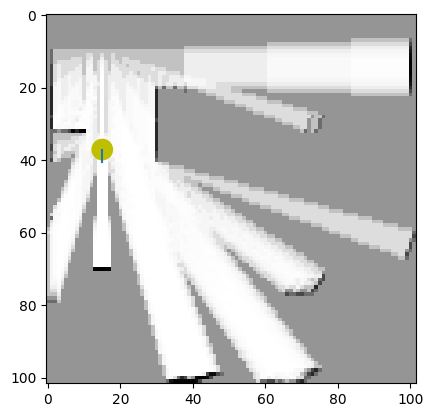

  4%|▎         | 28/759 [00:08<03:22,  3.61it/s]

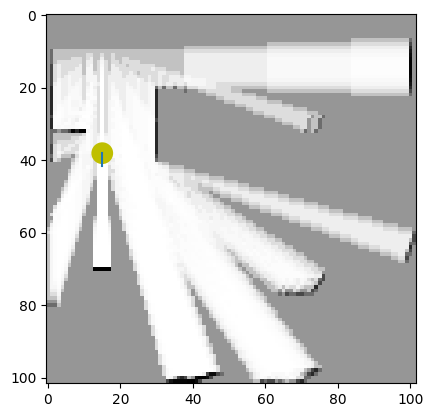

  4%|▍         | 29/759 [00:09<03:22,  3.60it/s]

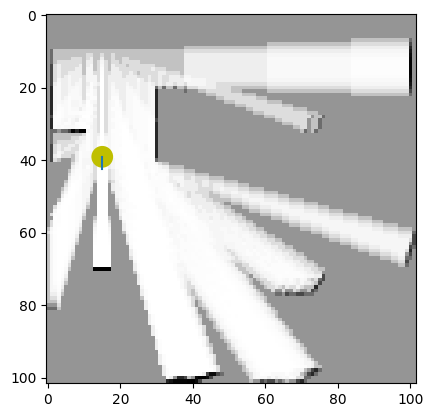

  4%|▍         | 30/759 [00:09<03:21,  3.62it/s]

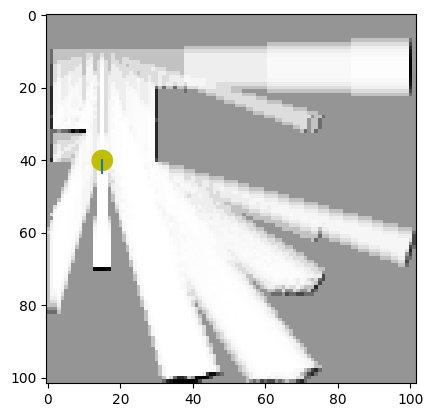

  4%|▍         | 31/759 [00:09<03:22,  3.60it/s]

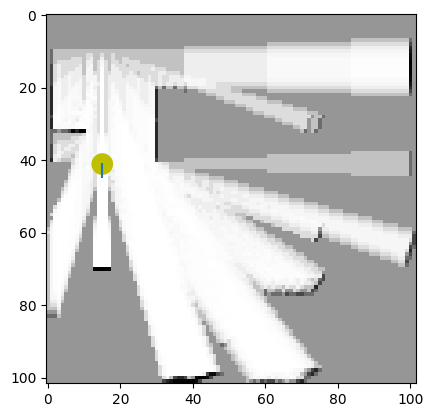

  4%|▍         | 32/759 [00:09<03:15,  3.72it/s]

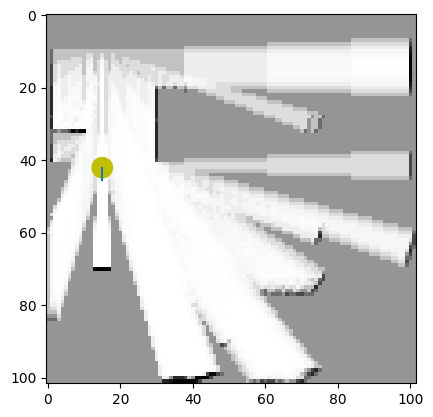

  4%|▍         | 33/759 [00:10<03:51,  3.14it/s]

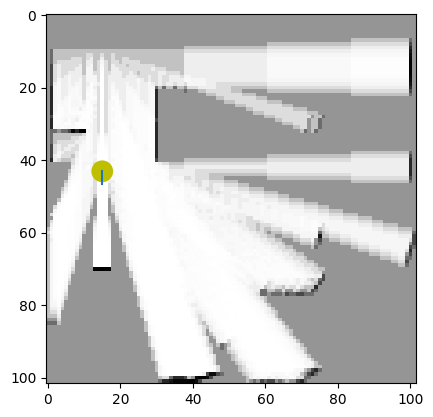

  4%|▍         | 34/759 [00:10<03:52,  3.12it/s]

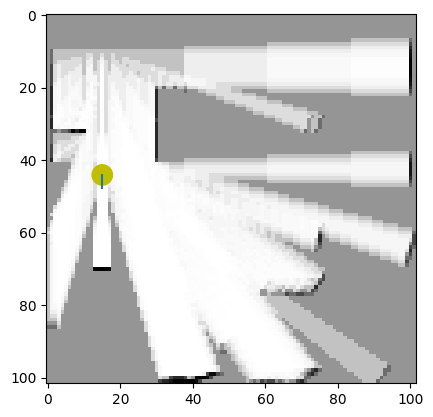

  5%|▍         | 35/759 [00:10<03:47,  3.19it/s]

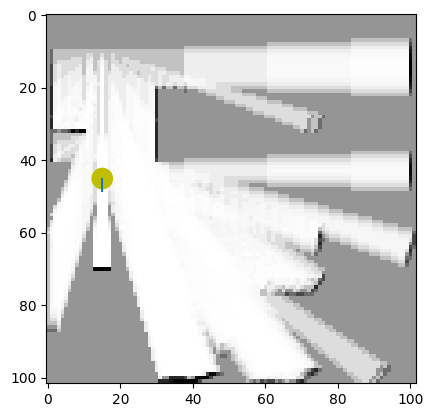

  5%|▍         | 36/759 [00:11<03:32,  3.40it/s]

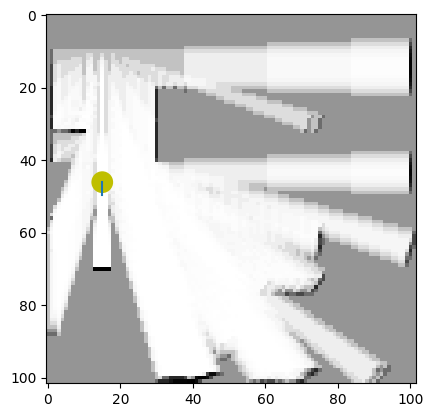

  5%|▍         | 37/759 [00:11<03:19,  3.63it/s]

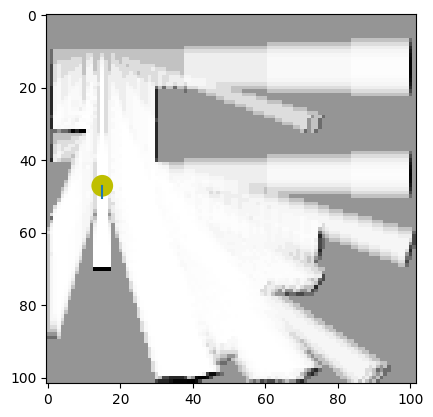

  5%|▌         | 38/759 [00:11<03:30,  3.43it/s]

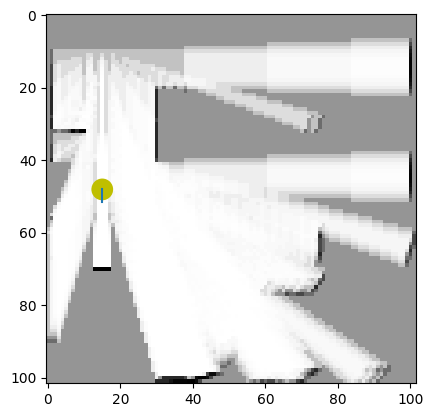

  5%|▌         | 39/759 [00:12<03:27,  3.46it/s]

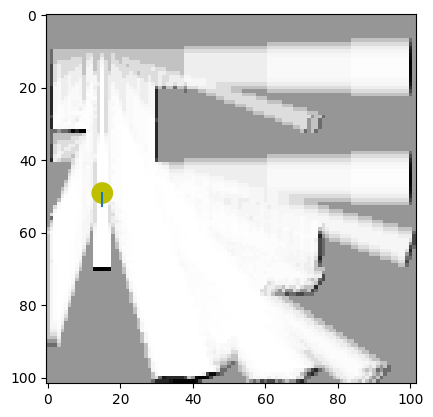

  5%|▌         | 40/759 [00:12<03:16,  3.65it/s]

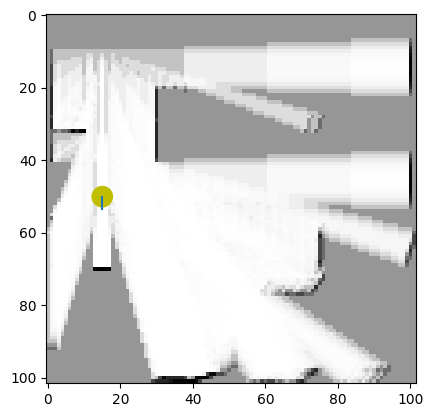

  5%|▌         | 41/759 [00:12<03:10,  3.77it/s]

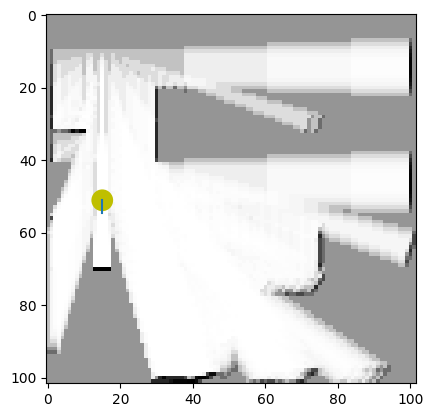

  6%|▌         | 42/759 [00:12<03:11,  3.74it/s]

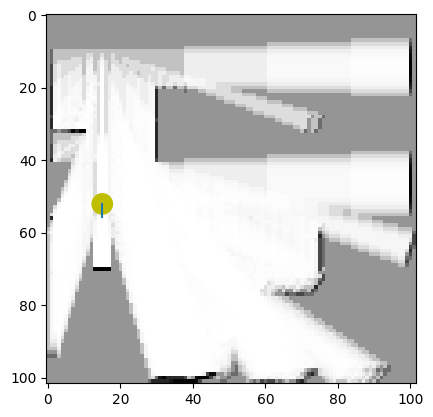

  6%|▌         | 43/759 [00:13<03:32,  3.37it/s]

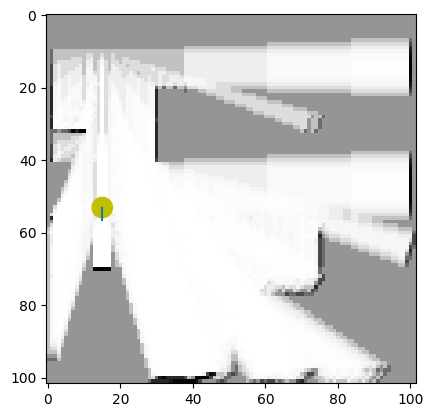

  6%|▌         | 44/759 [00:13<03:20,  3.57it/s]

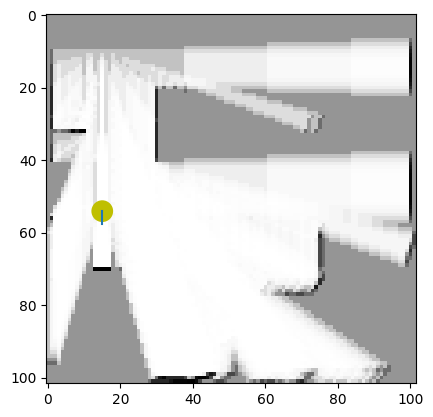

  6%|▌         | 45/759 [00:13<03:33,  3.34it/s]

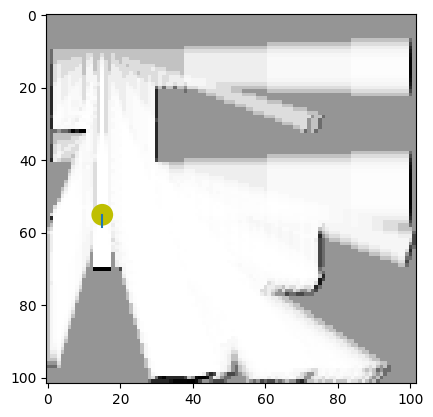

  6%|▌         | 46/759 [00:14<04:22,  2.71it/s]

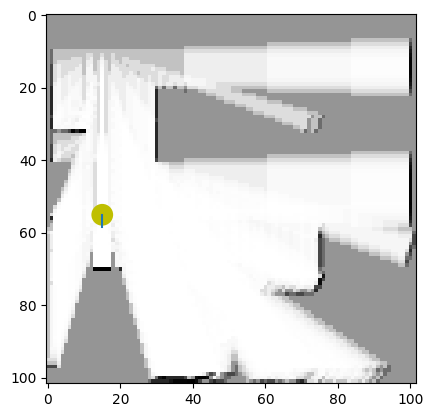

  6%|▌         | 47/759 [00:14<04:18,  2.76it/s]

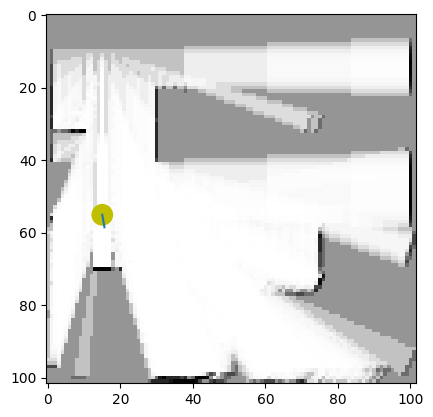

  6%|▋         | 48/759 [00:14<04:14,  2.80it/s]

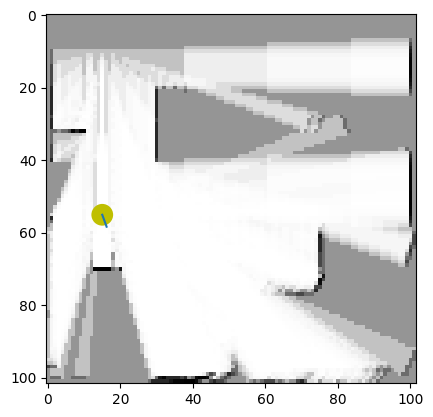

  6%|▋         | 49/759 [00:15<04:14,  2.79it/s]

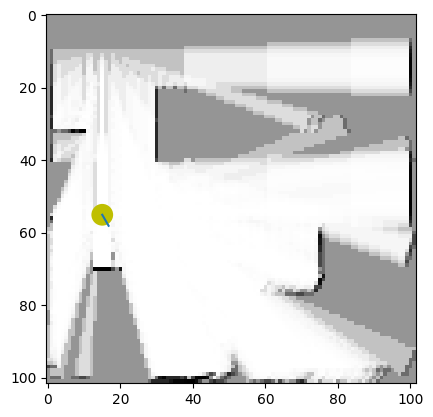

  7%|▋         | 50/759 [00:15<03:55,  3.01it/s]

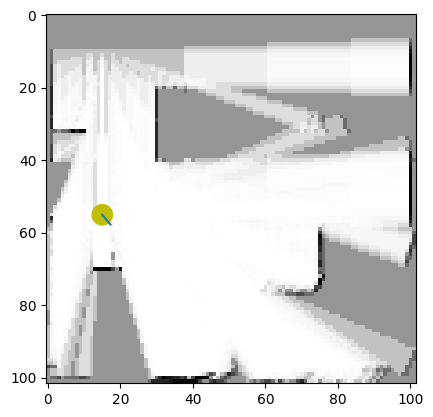

  7%|▋         | 51/759 [00:15<03:37,  3.25it/s]

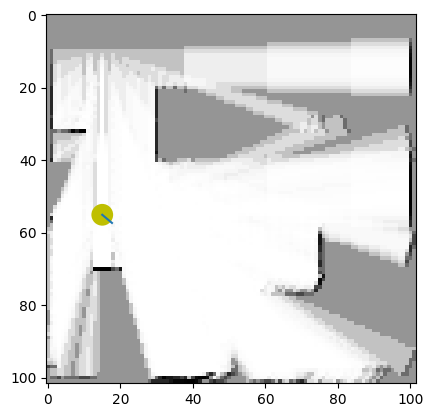

  7%|▋         | 52/759 [00:16<03:57,  2.97it/s]

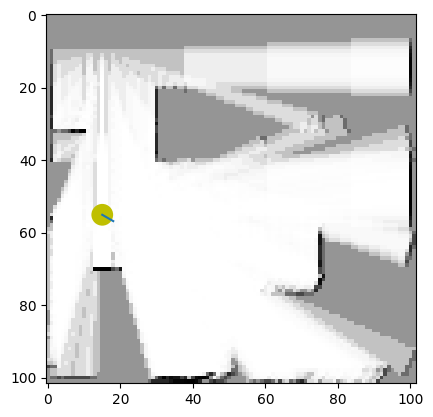

  7%|▋         | 53/759 [00:16<03:47,  3.10it/s]

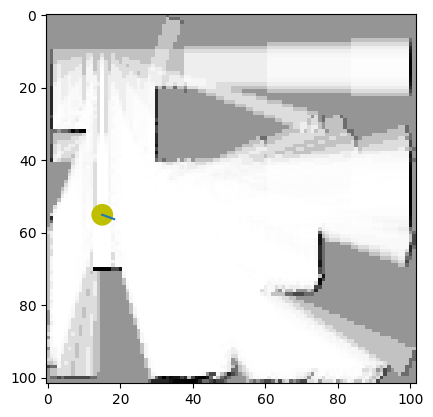

  7%|▋         | 54/759 [00:16<03:46,  3.11it/s]

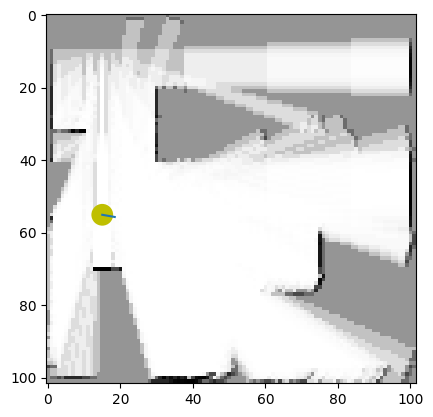

  7%|▋         | 55/759 [00:17<04:11,  2.80it/s]

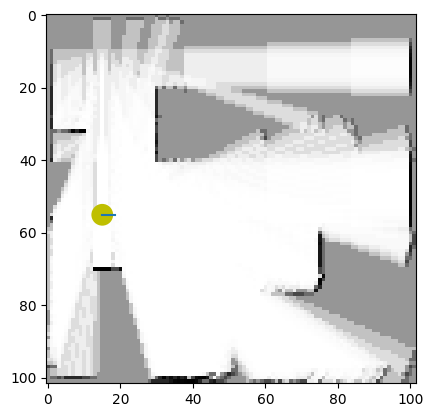

  7%|▋         | 56/759 [00:17<04:25,  2.64it/s]

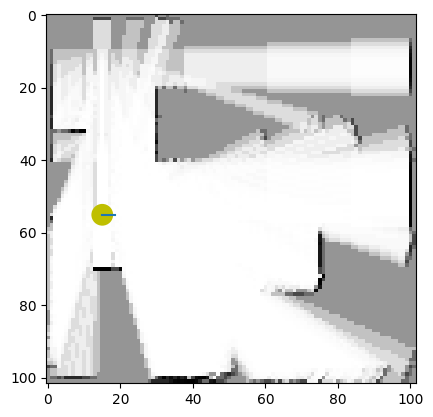

  8%|▊         | 57/759 [00:18<04:12,  2.78it/s]

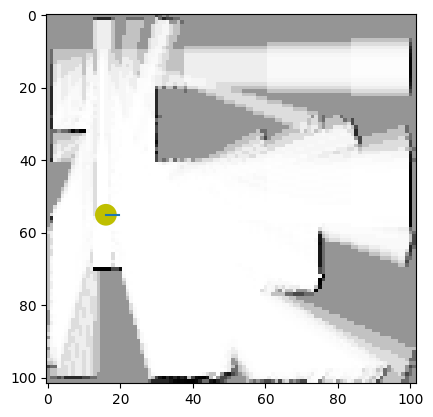

  8%|▊         | 58/759 [00:18<04:30,  2.59it/s]

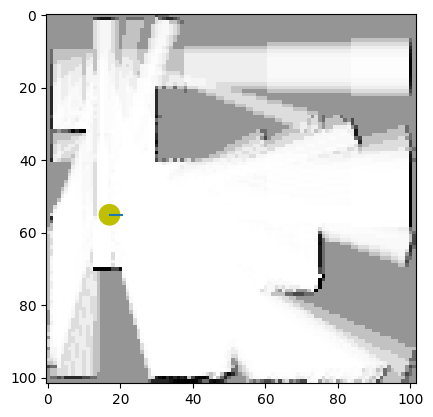

  8%|▊         | 59/759 [00:18<04:27,  2.61it/s]

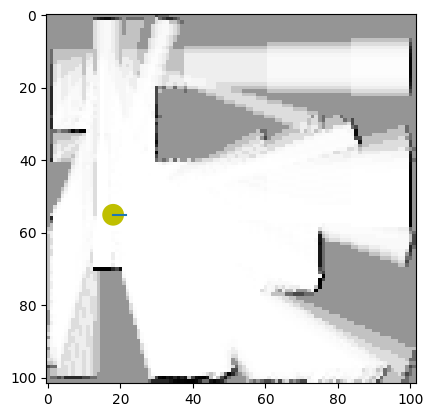

  8%|▊         | 60/759 [00:19<04:13,  2.76it/s]

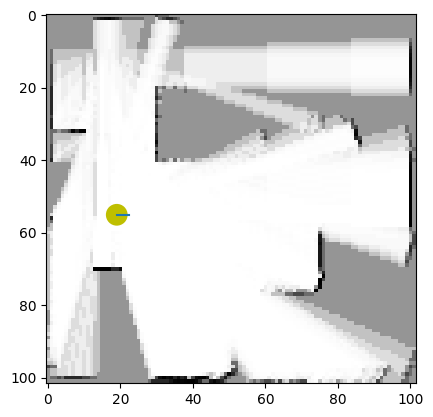

  8%|▊         | 61/759 [00:19<04:37,  2.51it/s]

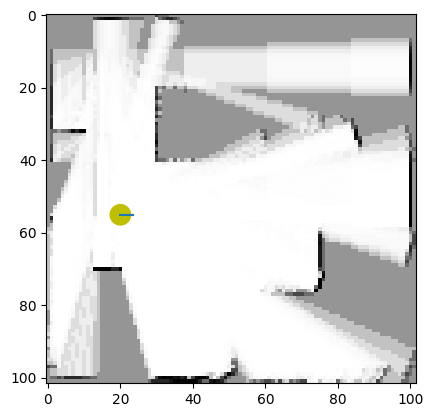

  8%|▊         | 62/759 [00:19<04:16,  2.72it/s]

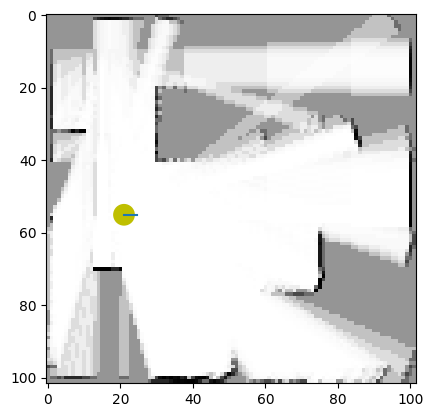

  8%|▊         | 63/759 [00:20<04:05,  2.84it/s]

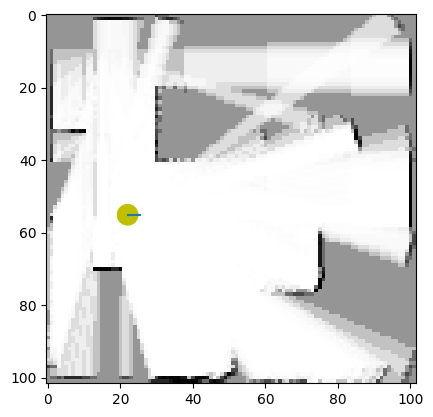

  8%|▊         | 64/759 [00:20<04:29,  2.58it/s]

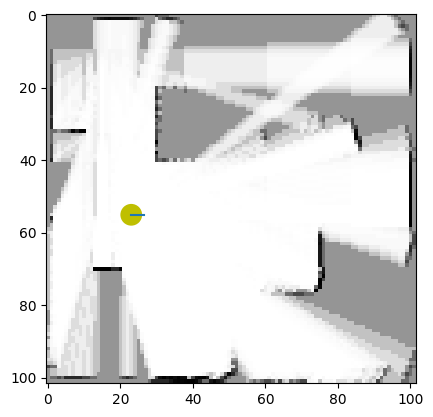

  9%|▊         | 65/759 [00:21<04:14,  2.73it/s]

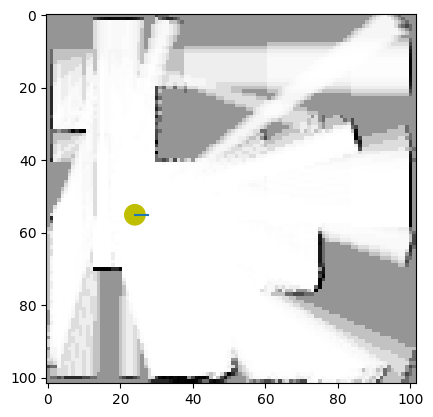

  9%|▊         | 66/759 [00:21<04:00,  2.89it/s]

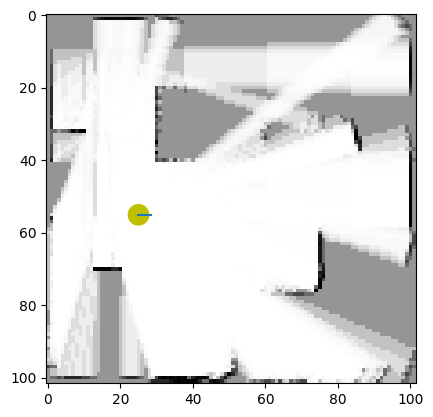

  9%|▉         | 67/759 [00:21<04:24,  2.62it/s]

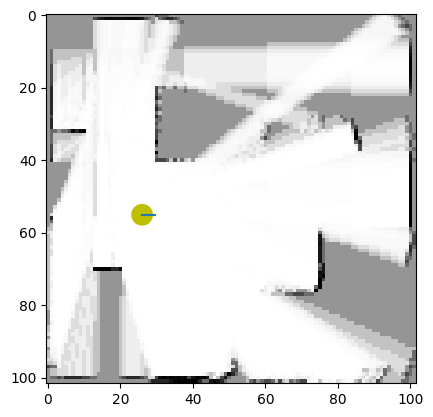

  9%|▉         | 68/759 [00:22<04:11,  2.75it/s]

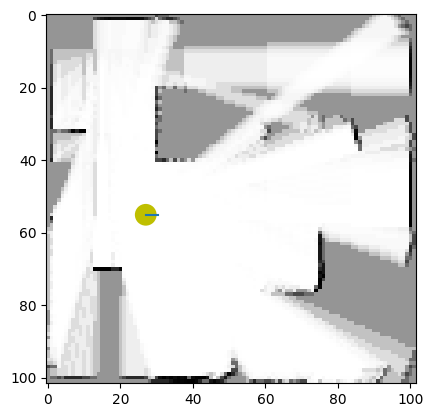

  9%|▉         | 69/759 [00:22<03:48,  3.02it/s]

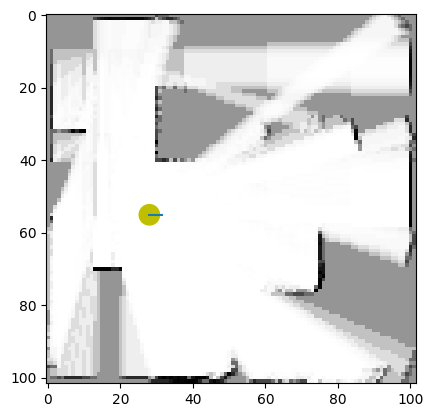

  9%|▉         | 70/759 [00:22<04:00,  2.86it/s]

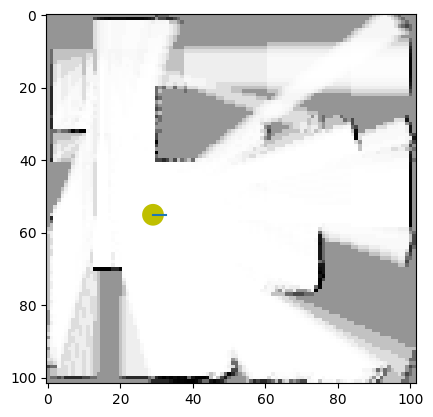

  9%|▉         | 71/759 [00:23<03:47,  3.03it/s]

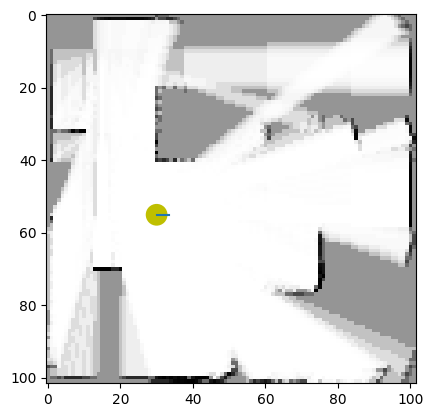

  9%|▉         | 72/759 [00:23<03:41,  3.10it/s]

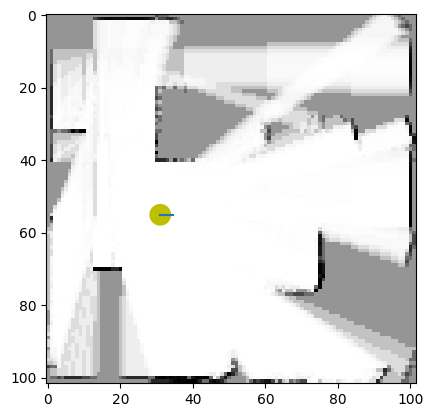

 10%|▉         | 73/759 [00:23<04:01,  2.84it/s]

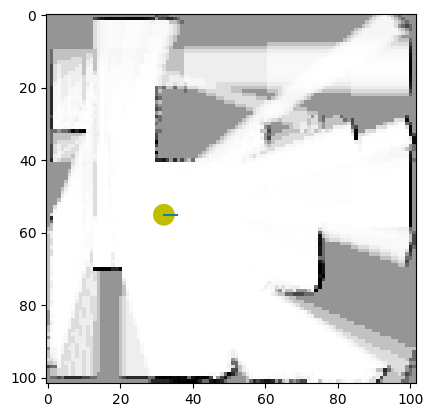

 10%|▉         | 74/759 [00:24<04:05,  2.79it/s]

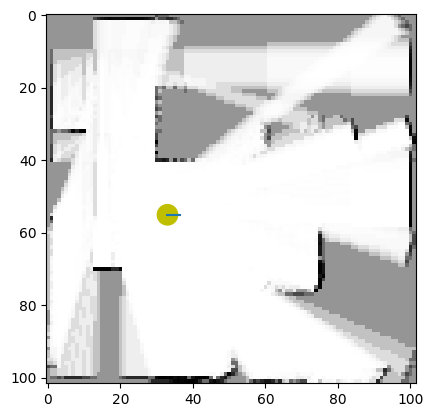

 10%|▉         | 75/759 [00:24<04:24,  2.59it/s]

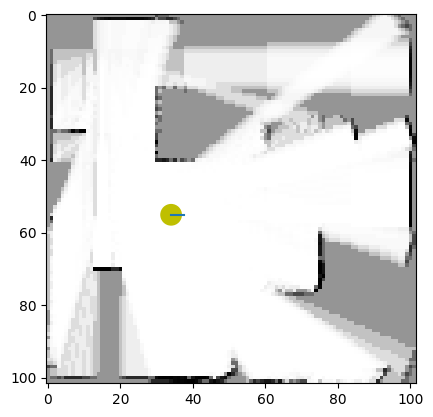

 10%|█         | 76/759 [00:25<04:25,  2.57it/s]

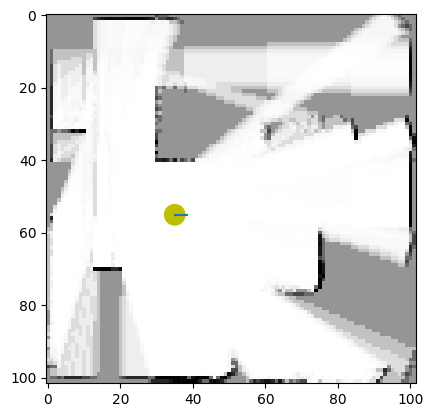

 10%|█         | 77/759 [00:25<04:55,  2.30it/s]

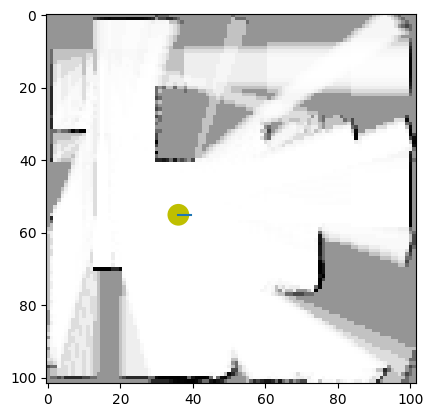

 10%|█         | 78/759 [00:26<05:07,  2.21it/s]

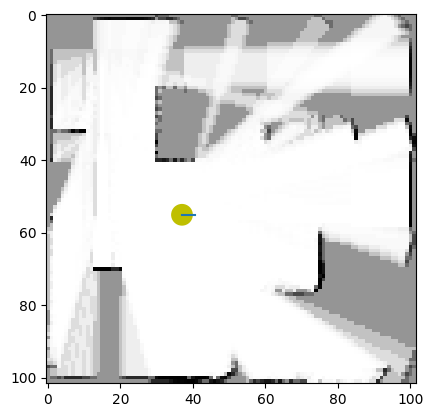

 10%|█         | 79/759 [00:26<05:13,  2.17it/s]

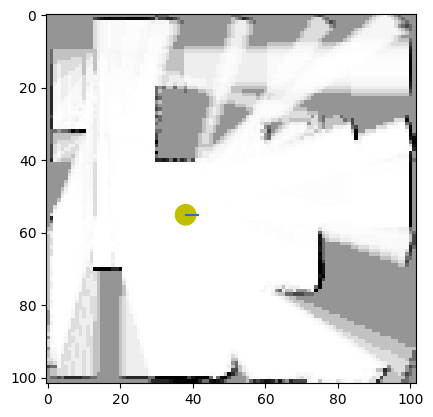

 11%|█         | 80/759 [00:26<04:56,  2.29it/s]

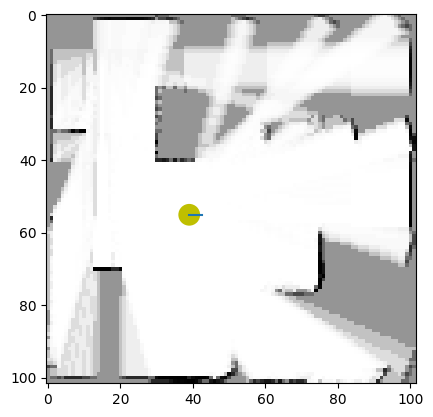

 11%|█         | 81/759 [00:27<04:38,  2.44it/s]

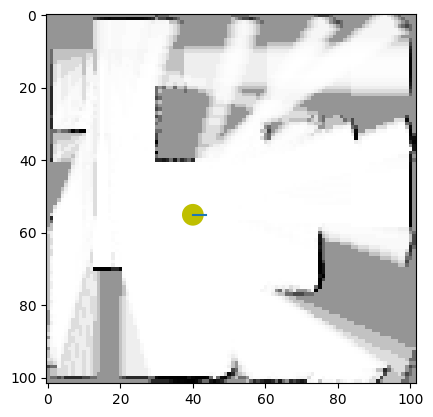

 11%|█         | 82/759 [00:27<04:55,  2.29it/s]

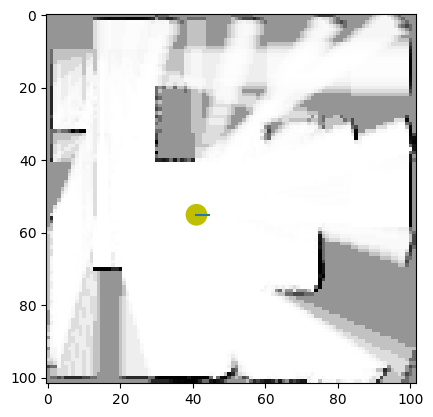

 11%|█         | 83/759 [00:28<04:40,  2.41it/s]

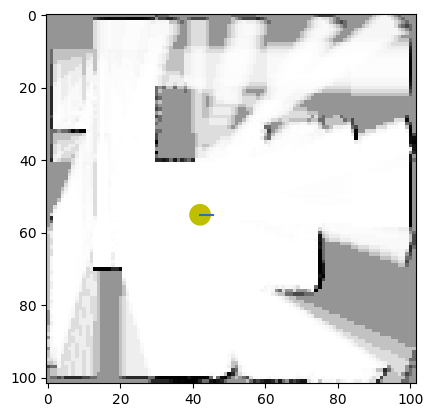

 11%|█         | 84/759 [00:28<04:25,  2.54it/s]

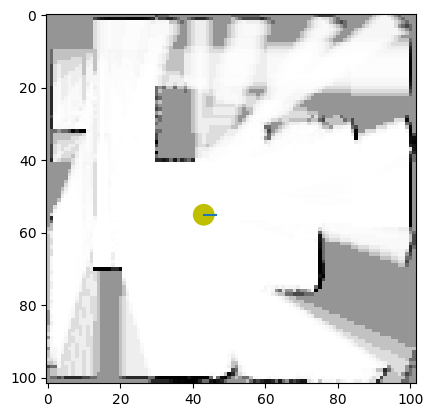

 11%|█         | 85/759 [00:28<04:46,  2.35it/s]

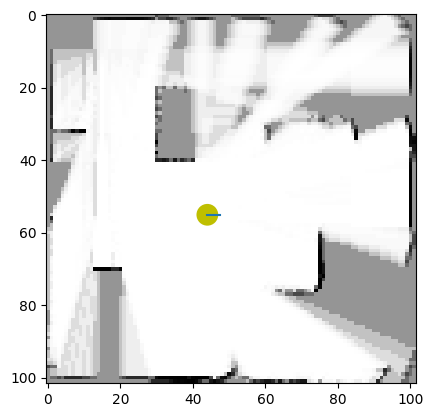

 11%|█▏        | 86/759 [00:29<04:51,  2.31it/s]

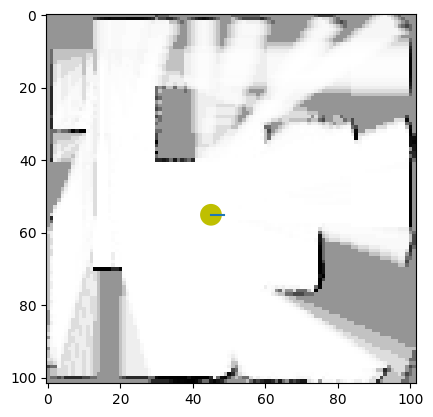

 11%|█▏        | 87/759 [00:29<04:45,  2.35it/s]

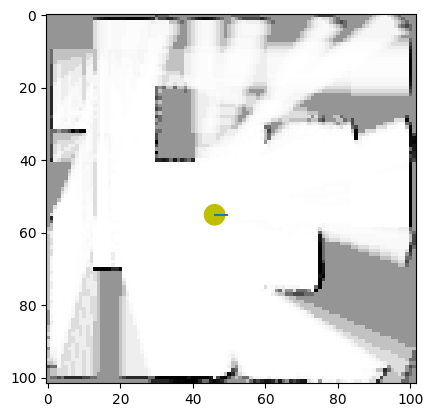

 12%|█▏        | 88/759 [00:30<04:53,  2.28it/s]

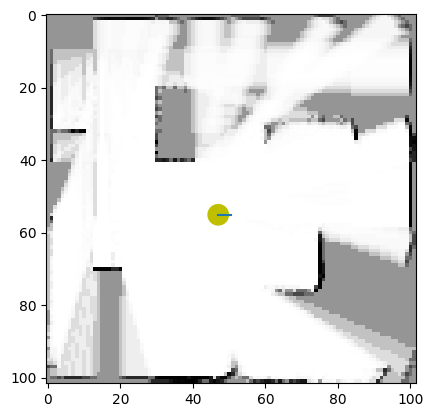

 12%|█▏        | 89/759 [00:30<04:38,  2.41it/s]

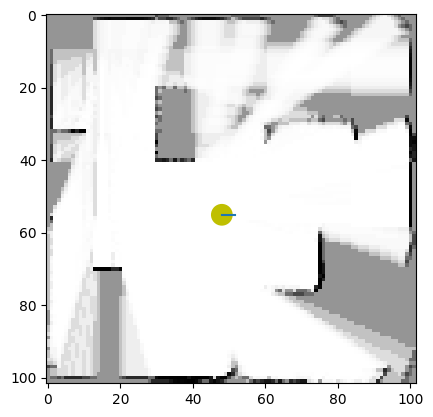

 12%|█▏        | 90/759 [00:31<04:36,  2.42it/s]

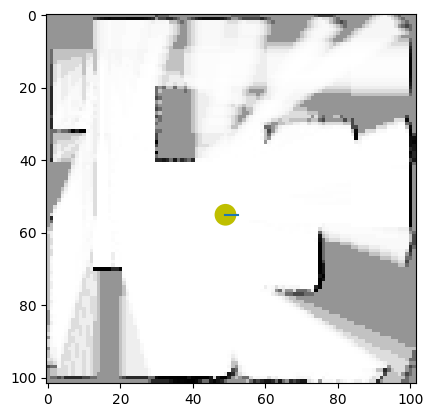

 12%|█▏        | 91/759 [00:31<04:43,  2.36it/s]

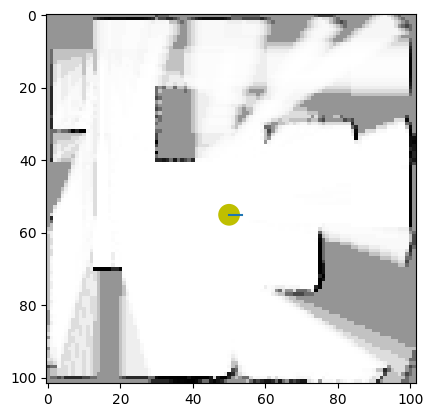

 12%|█▏        | 92/759 [00:31<04:17,  2.59it/s]

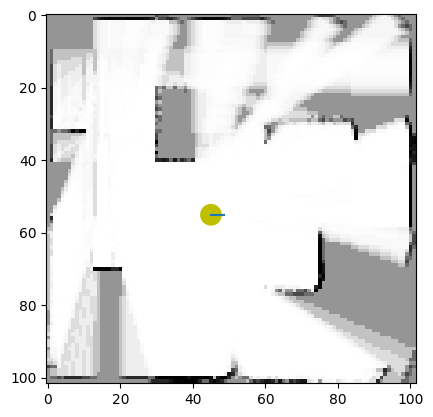

 12%|█▏        | 93/759 [00:32<04:23,  2.52it/s]

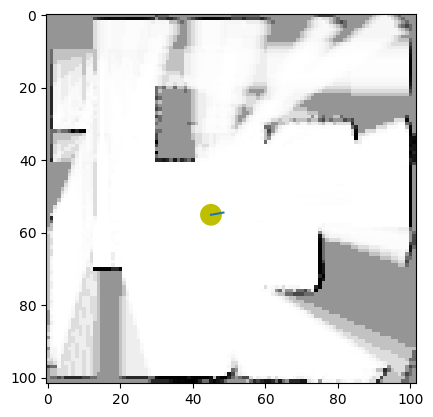

 12%|█▏        | 94/759 [00:32<04:25,  2.50it/s]

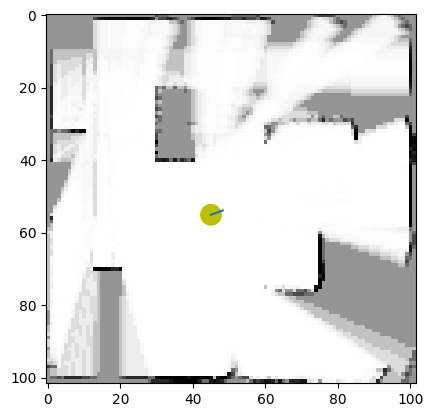

 13%|█▎        | 95/759 [00:33<04:49,  2.29it/s]

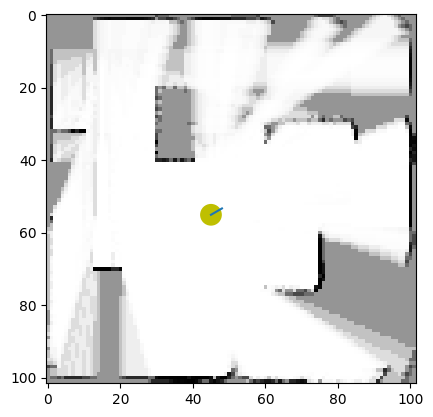

 13%|█▎        | 96/759 [00:33<04:31,  2.44it/s]

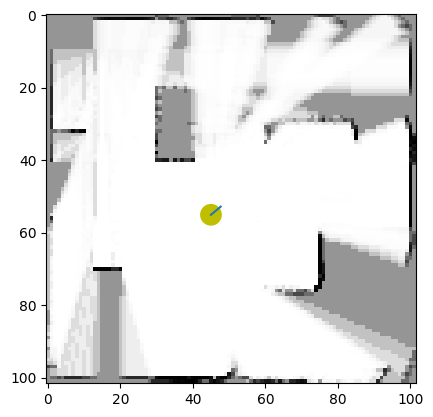

 13%|█▎        | 97/759 [00:34<05:24,  2.04it/s]

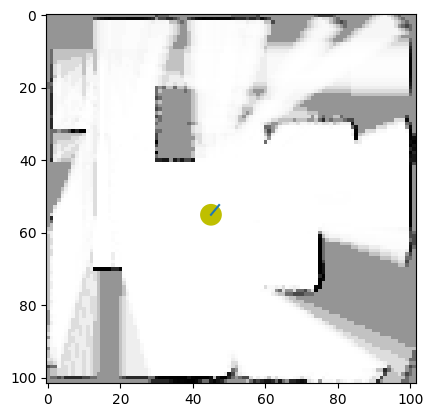

 13%|█▎        | 98/759 [00:34<04:58,  2.21it/s]

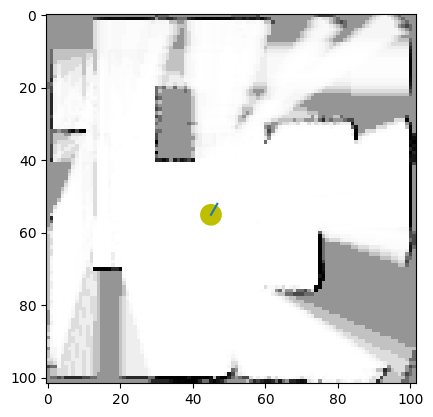

 13%|█▎        | 99/759 [00:35<05:26,  2.02it/s]

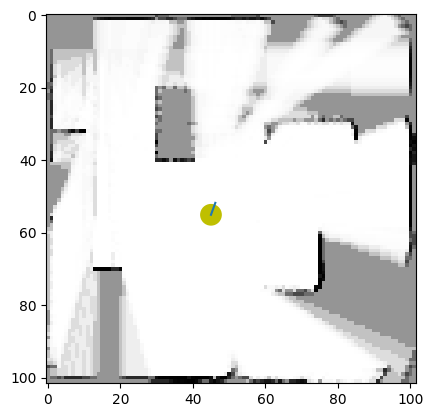

 13%|█▎        | 100/759 [00:35<04:52,  2.26it/s]

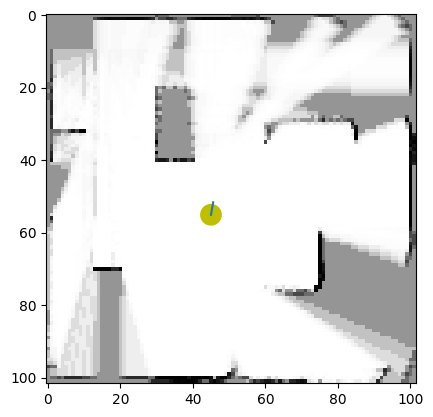

 13%|█▎        | 101/759 [00:36<05:08,  2.13it/s]

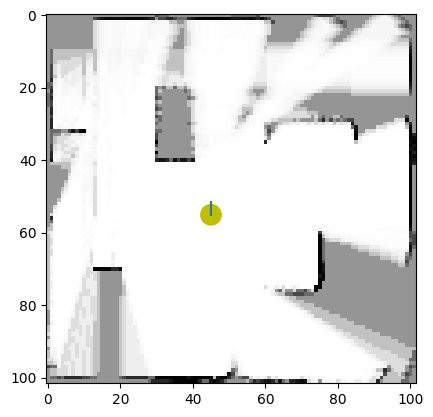

 13%|█▎        | 102/759 [00:36<04:51,  2.25it/s]

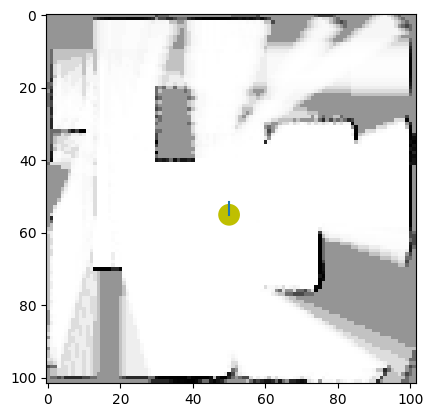

 14%|█▎        | 103/759 [00:37<05:27,  2.00it/s]

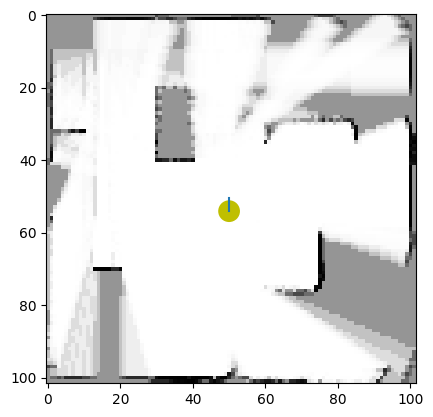

 14%|█▎        | 104/759 [00:37<05:11,  2.10it/s]

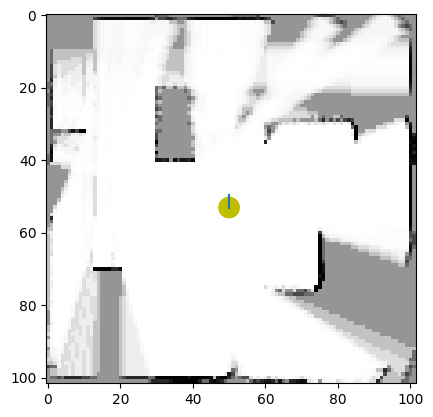

 14%|█▍        | 105/759 [00:37<05:06,  2.14it/s]

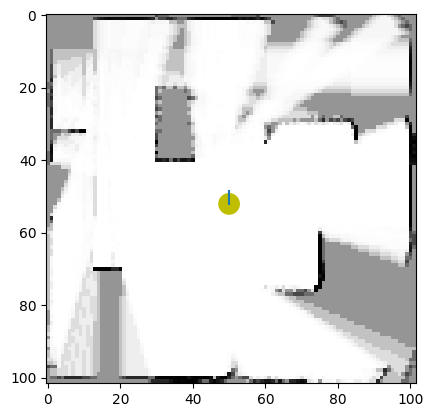

 14%|█▍        | 106/759 [00:38<05:15,  2.07it/s]

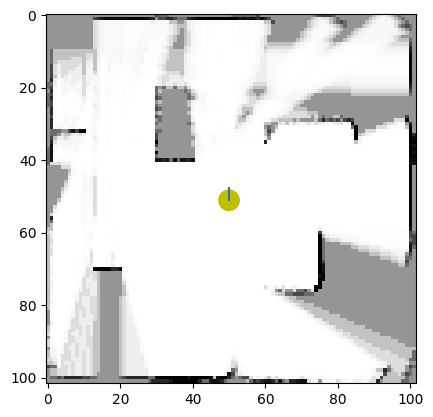

 14%|█▍        | 107/759 [00:38<05:00,  2.17it/s]

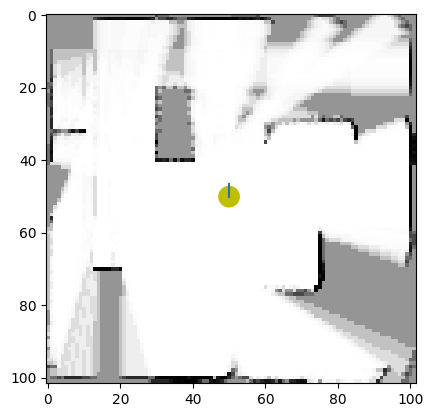

 14%|█▍        | 108/759 [00:39<05:17,  2.05it/s]

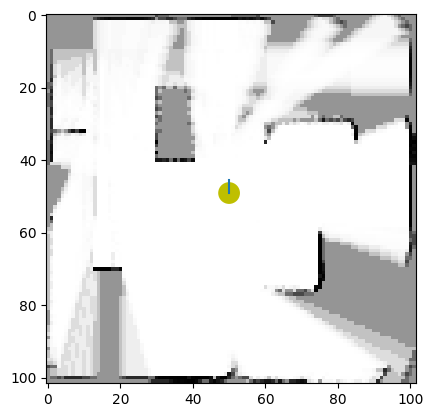

 14%|█▍        | 109/759 [00:40<05:48,  1.87it/s]

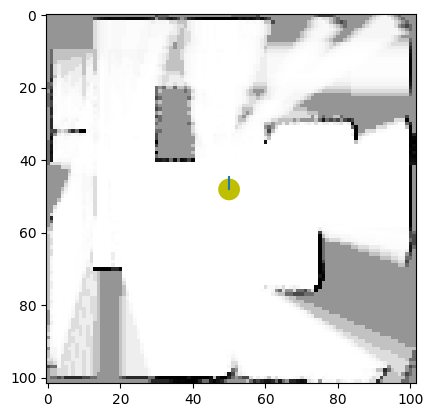

 14%|█▍        | 110/759 [00:40<05:28,  1.97it/s]

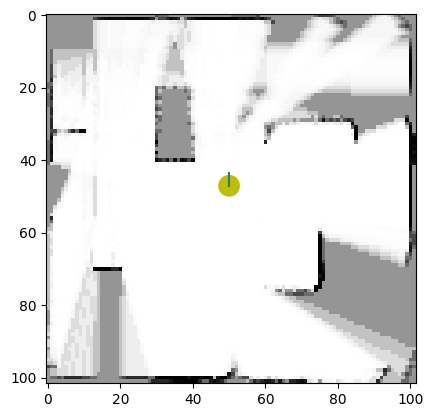

 15%|█▍        | 111/759 [00:40<05:21,  2.01it/s]

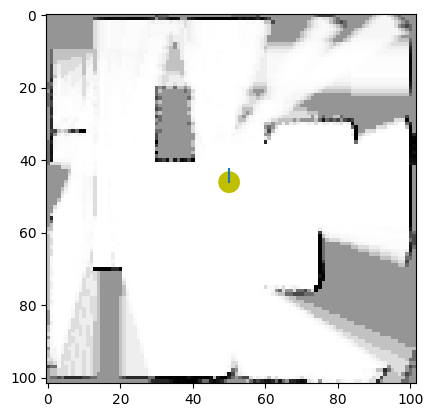

 15%|█▍        | 112/759 [00:41<05:10,  2.08it/s]

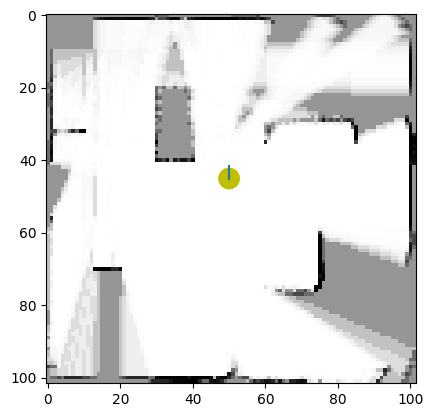

 15%|█▍        | 113/759 [00:41<05:27,  1.97it/s]

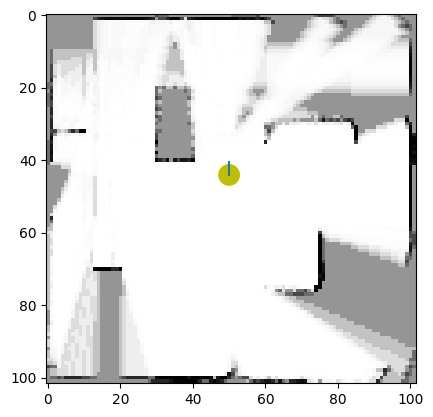

 15%|█▌        | 114/759 [00:42<04:46,  2.25it/s]

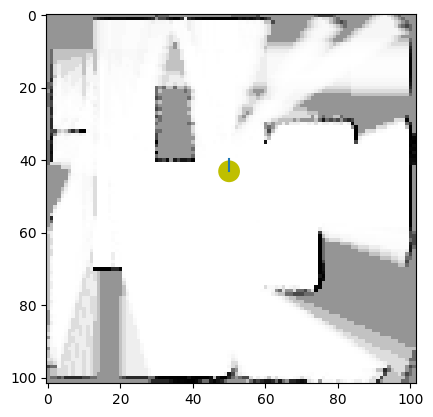

 15%|█▌        | 115/759 [00:42<04:47,  2.24it/s]

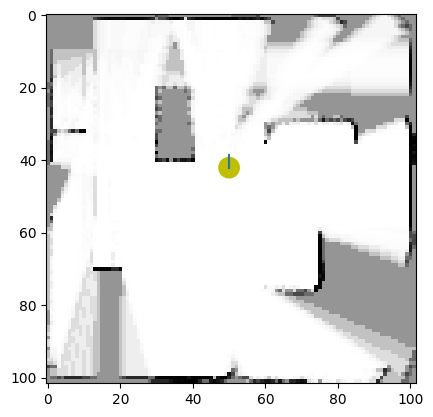

 15%|█▌        | 116/759 [00:43<04:33,  2.35it/s]

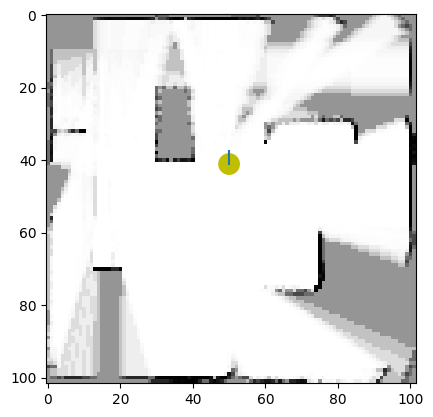

 15%|█▌        | 117/759 [00:43<04:55,  2.17it/s]

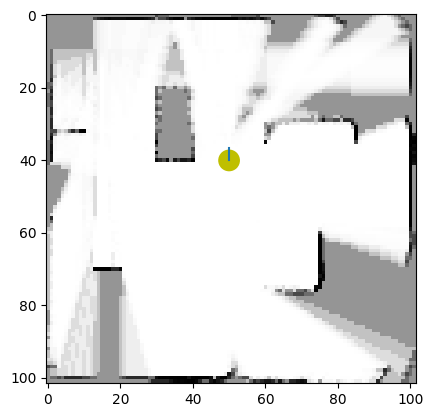

 16%|█▌        | 118/759 [00:43<04:30,  2.37it/s]

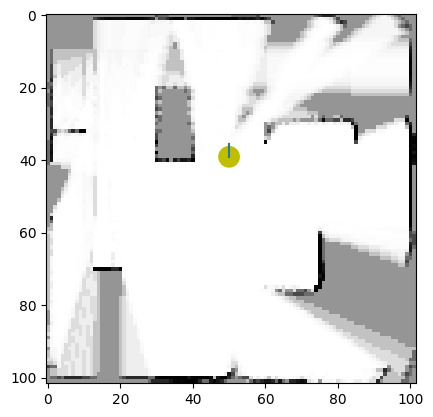

 16%|█▌        | 119/759 [00:44<04:53,  2.18it/s]

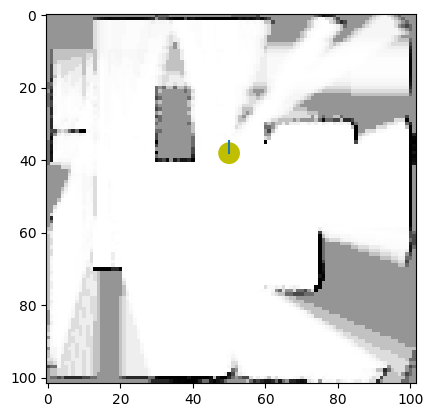

 16%|█▌        | 120/759 [00:44<04:35,  2.32it/s]

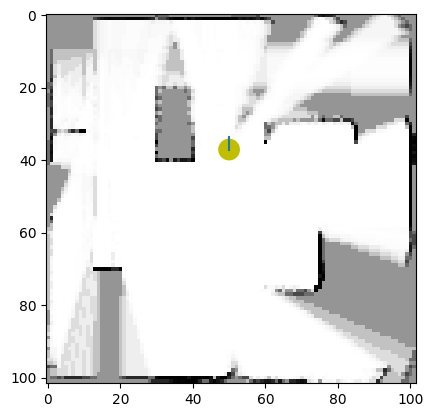

 16%|█▌        | 121/759 [00:45<05:14,  2.03it/s]

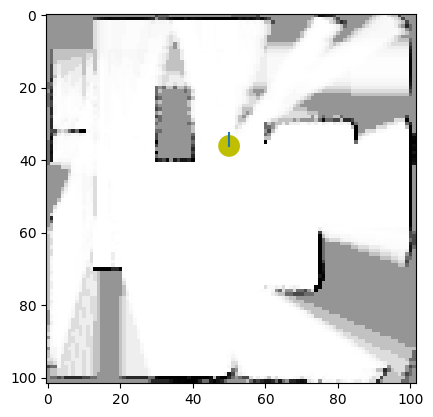

 16%|█▌        | 122/759 [00:45<04:49,  2.20it/s]

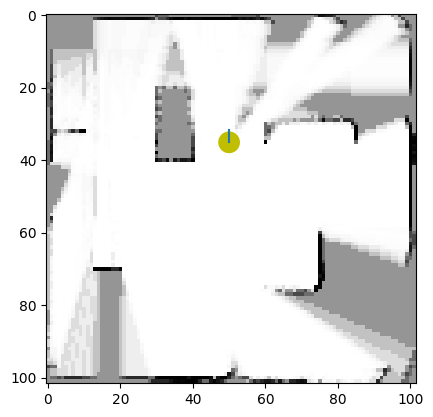

 16%|█▌        | 123/759 [00:46<04:51,  2.18it/s]

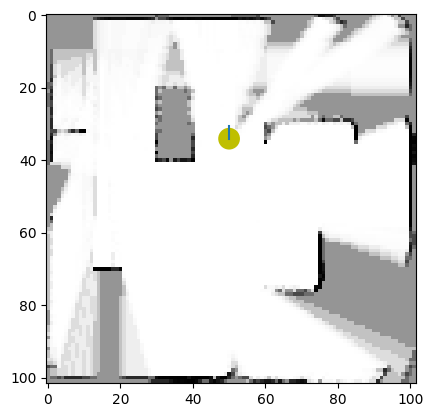

 16%|█▋        | 124/759 [00:46<04:46,  2.22it/s]

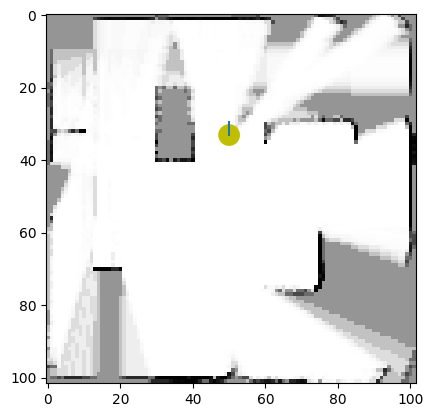

 16%|█▋        | 125/759 [00:47<04:58,  2.12it/s]

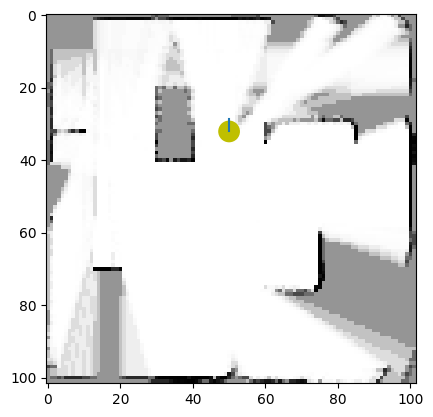

 17%|█▋        | 126/759 [00:47<04:34,  2.31it/s]

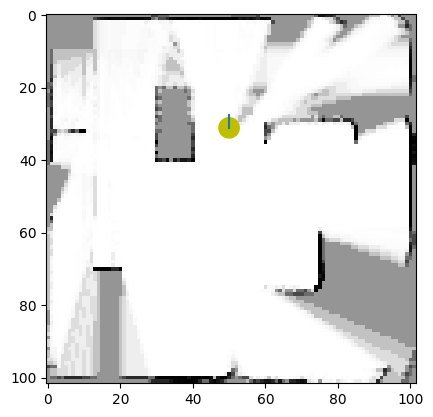

 17%|█▋        | 127/759 [00:48<05:01,  2.10it/s]

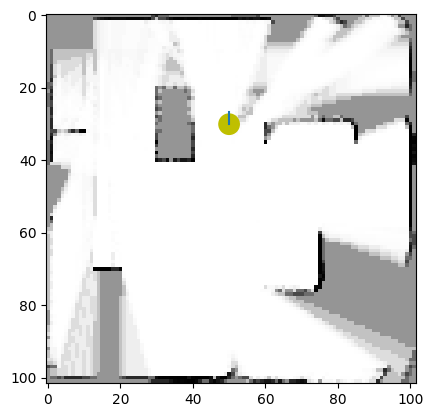

 17%|█▋        | 128/759 [00:48<04:35,  2.29it/s]

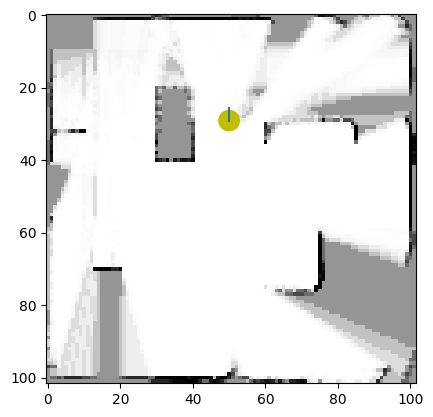

 17%|█▋        | 129/759 [00:49<04:49,  2.17it/s]

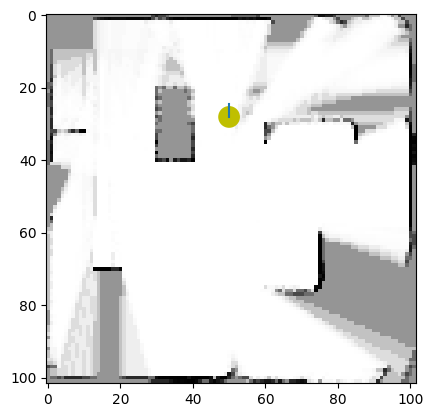

 17%|█▋        | 130/759 [00:49<04:27,  2.35it/s]

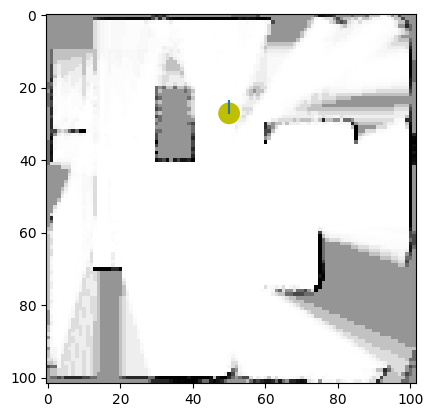

 17%|█▋        | 131/759 [00:49<04:05,  2.56it/s]

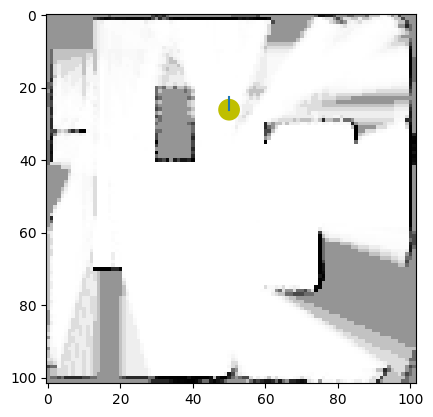

 17%|█▋        | 132/759 [00:50<04:19,  2.41it/s]

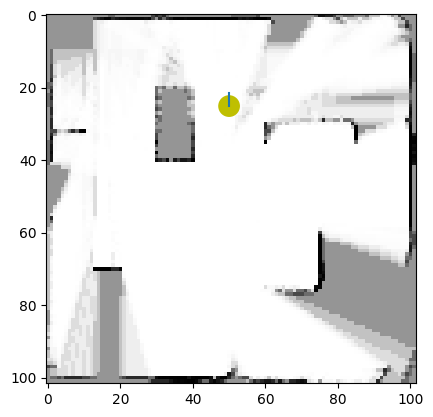

 18%|█▊        | 133/759 [00:50<04:06,  2.54it/s]

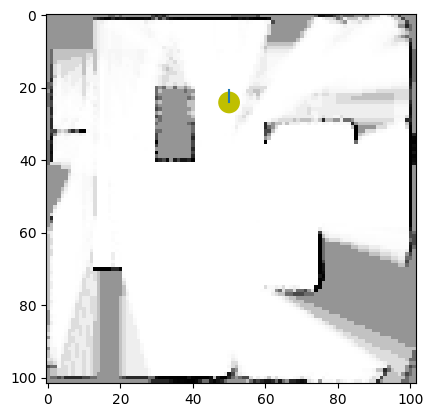

 18%|█▊        | 134/759 [00:50<03:49,  2.73it/s]

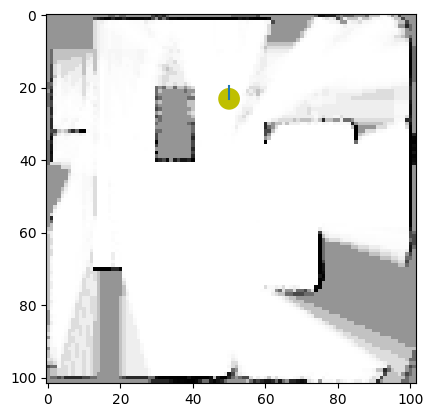

 18%|█▊        | 135/759 [00:51<03:50,  2.71it/s]

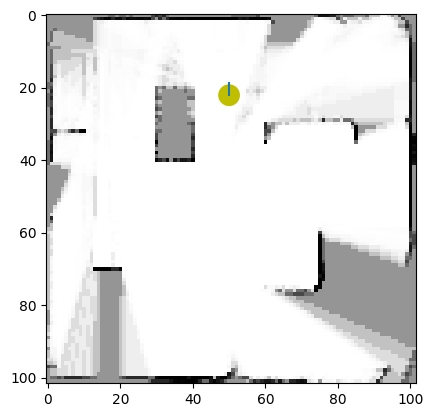

 18%|█▊        | 136/759 [00:51<03:46,  2.75it/s]

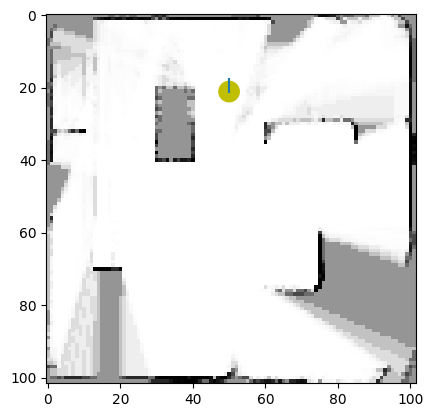

 18%|█▊        | 137/759 [00:51<03:45,  2.76it/s]

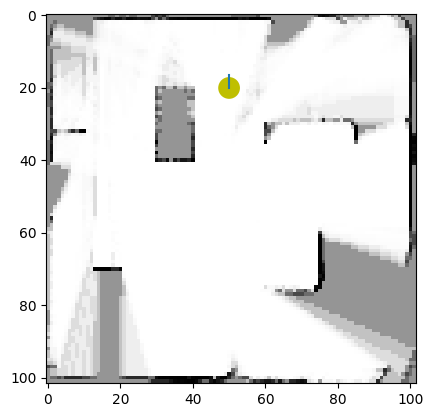

 18%|█▊        | 138/759 [00:52<03:47,  2.73it/s]

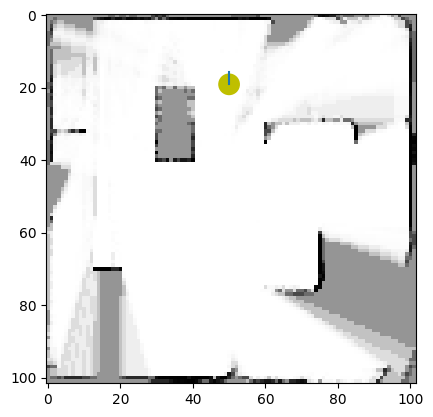

 18%|█▊        | 139/759 [00:52<03:37,  2.85it/s]

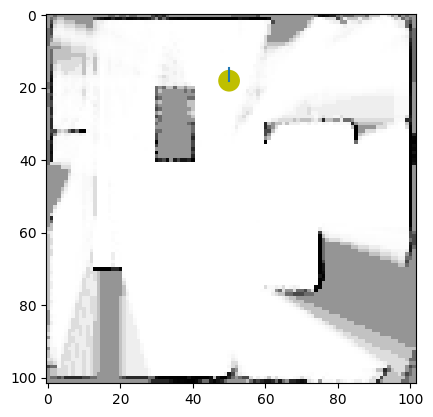

 18%|█▊        | 140/759 [00:52<03:36,  2.86it/s]

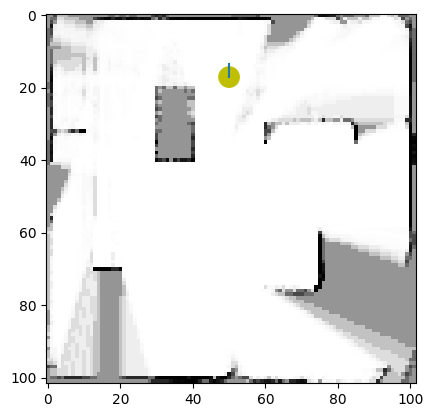

 19%|█▊        | 141/759 [00:53<04:00,  2.57it/s]

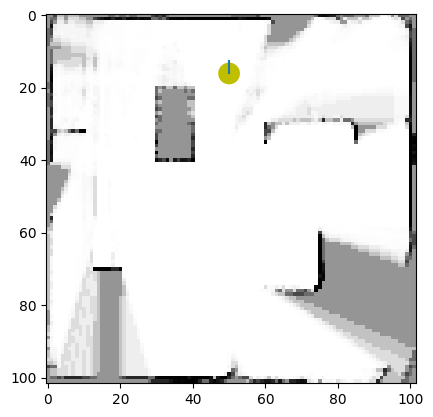

 19%|█▊        | 142/759 [00:53<03:51,  2.66it/s]

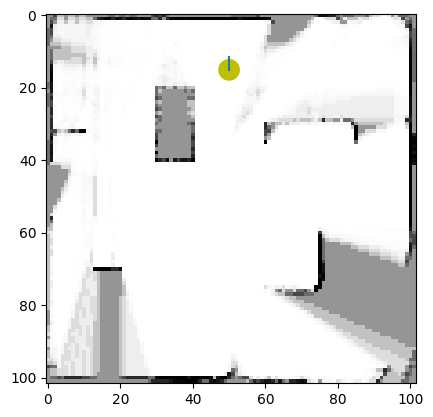

 19%|█▉        | 143/759 [00:54<04:06,  2.50it/s]

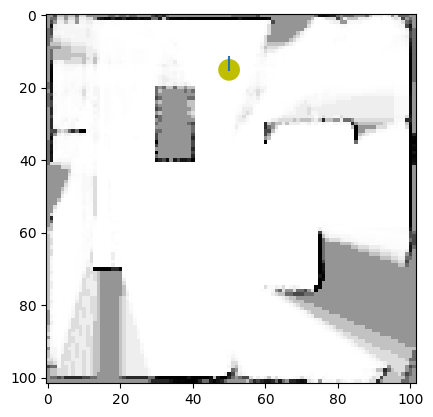

 19%|█▉        | 144/759 [00:54<04:01,  2.55it/s]

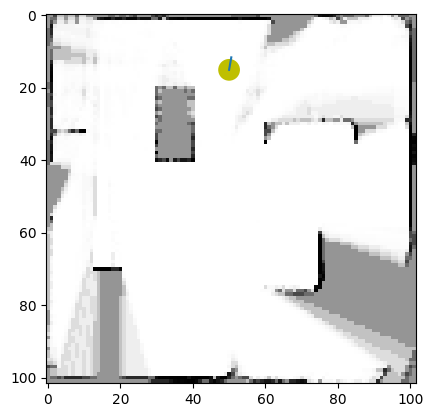

 19%|█▉        | 145/759 [00:54<03:54,  2.62it/s]

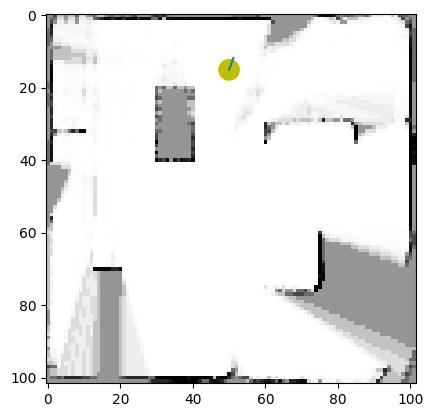

 19%|█▉        | 146/759 [00:55<03:45,  2.72it/s]

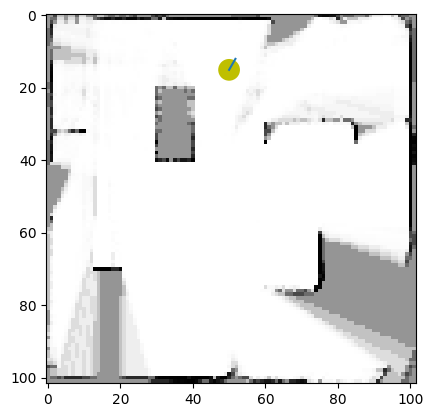

 19%|█▉        | 147/759 [00:55<04:36,  2.21it/s]

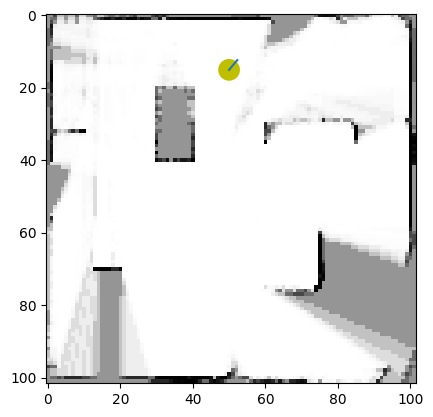

 19%|█▉        | 148/759 [00:56<04:42,  2.16it/s]

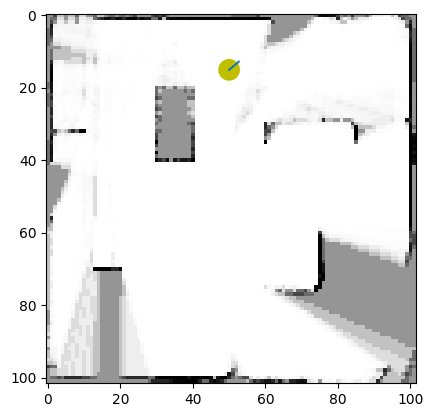

 20%|█▉        | 149/759 [00:56<04:41,  2.17it/s]

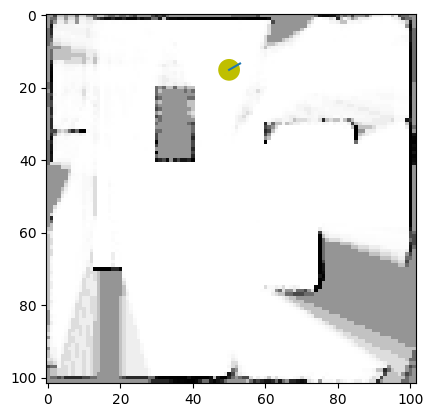

 20%|█▉        | 150/759 [00:57<05:25,  1.87it/s]

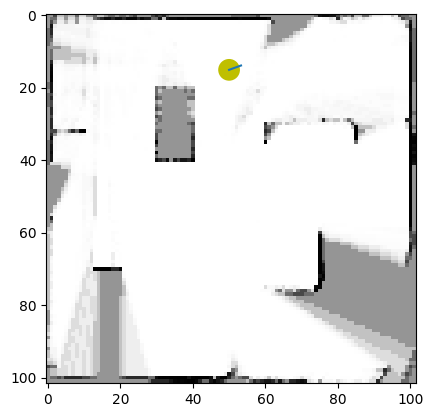

 20%|█▉        | 151/759 [00:58<05:21,  1.89it/s]

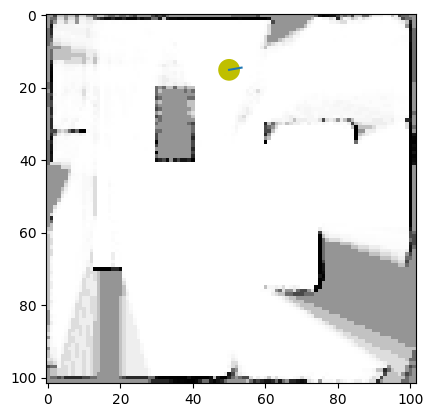

 20%|██        | 152/759 [00:58<05:34,  1.81it/s]

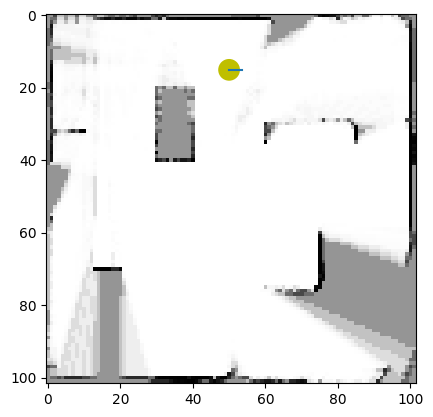

 20%|██        | 153/759 [00:59<05:43,  1.76it/s]

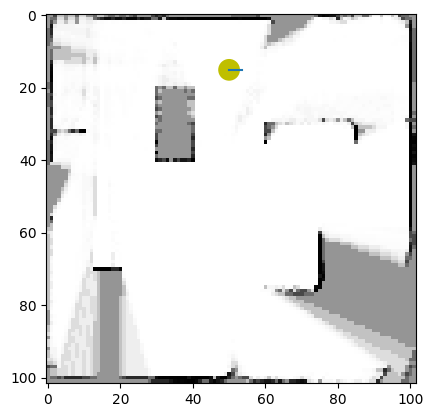

 20%|██        | 154/759 [00:59<05:48,  1.74it/s]

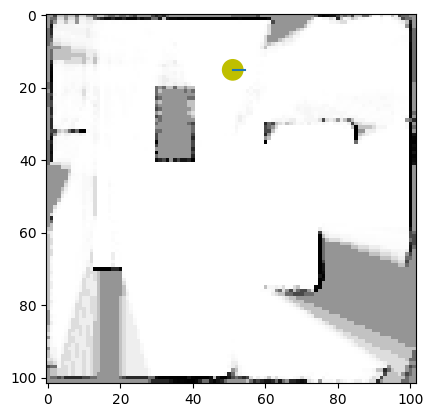

 20%|██        | 155/759 [01:00<05:19,  1.89it/s]

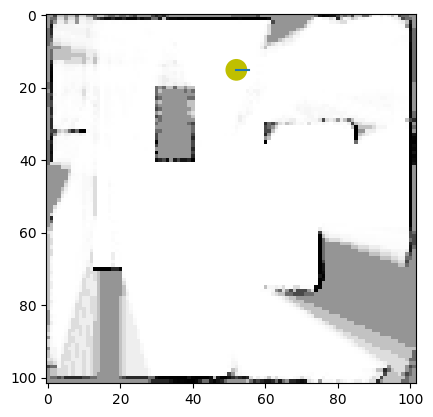

 21%|██        | 156/759 [01:00<05:24,  1.86it/s]

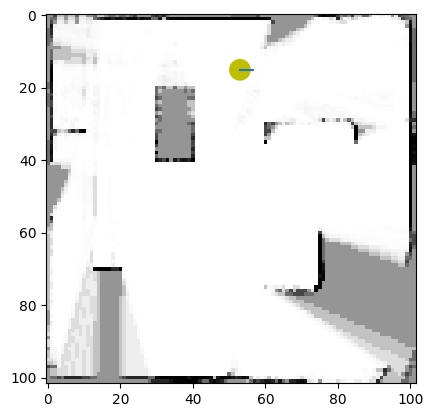

 21%|██        | 157/759 [01:01<04:55,  2.04it/s]

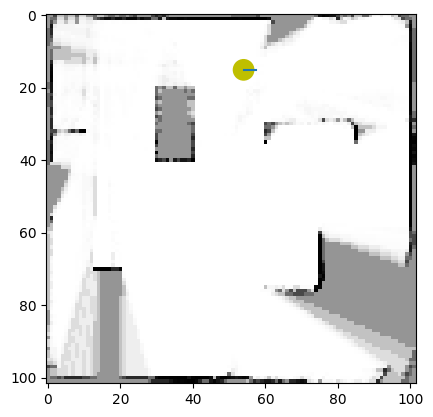

 21%|██        | 158/759 [01:01<05:01,  1.99it/s]

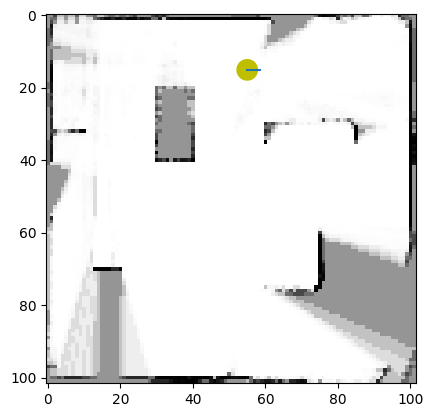

 21%|██        | 159/759 [01:02<05:01,  1.99it/s]

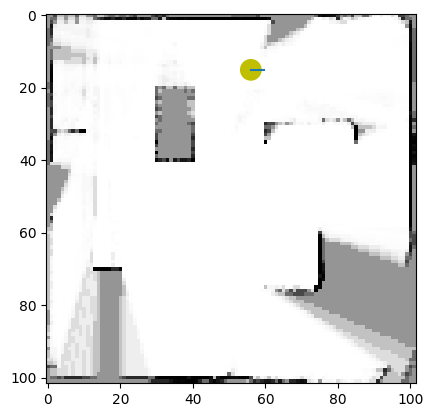

 21%|██        | 160/759 [01:02<04:41,  2.13it/s]

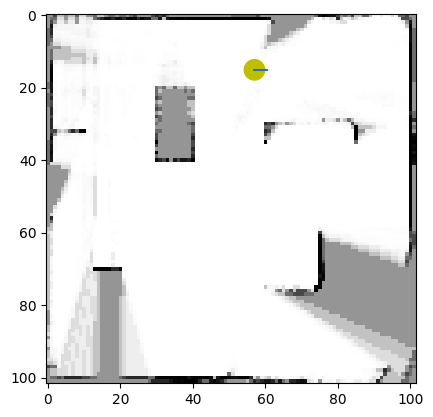

 21%|██        | 161/759 [01:03<04:24,  2.26it/s]

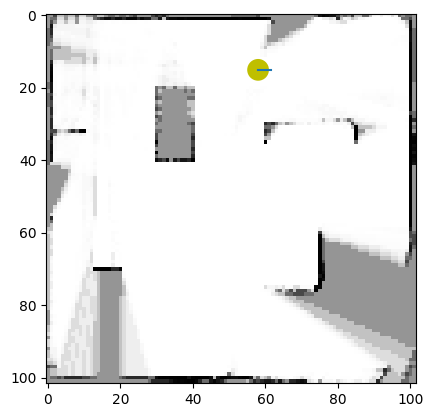

 21%|██▏       | 162/759 [01:03<04:20,  2.30it/s]

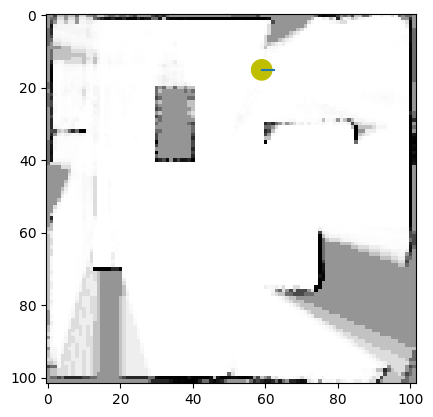

 21%|██▏       | 163/759 [01:03<03:57,  2.51it/s]

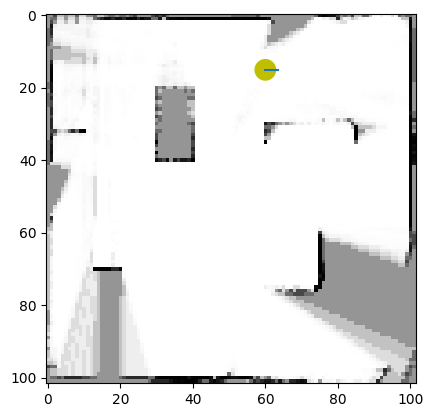

 22%|██▏       | 164/759 [01:04<04:17,  2.31it/s]

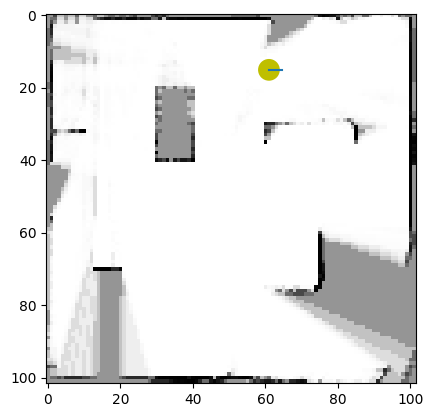

 22%|██▏       | 165/759 [01:04<03:53,  2.55it/s]

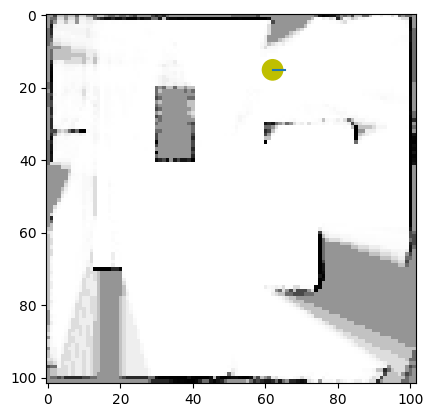

 22%|██▏       | 166/759 [01:05<03:57,  2.50it/s]

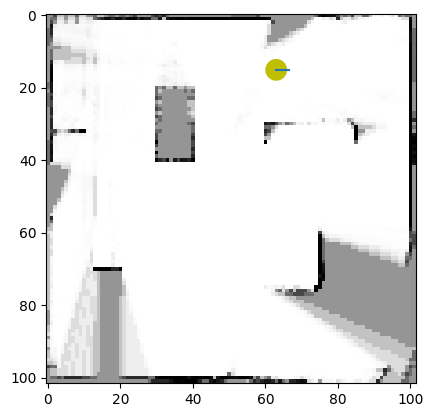

 22%|██▏       | 167/759 [01:05<03:44,  2.63it/s]

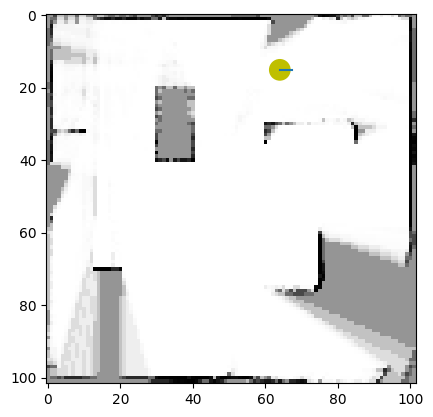

 22%|██▏       | 168/759 [01:05<03:54,  2.52it/s]

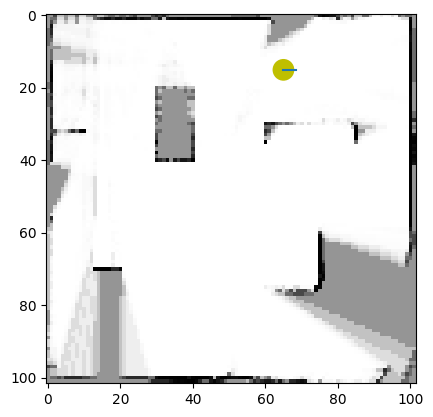

 22%|██▏       | 169/759 [01:06<03:47,  2.59it/s]

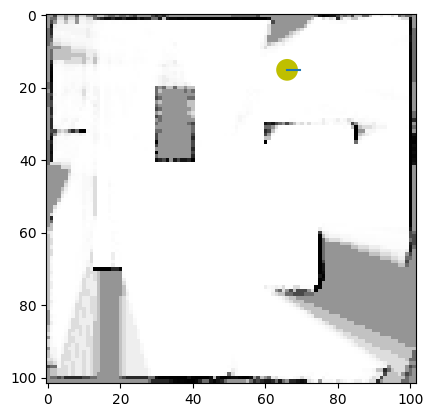

 22%|██▏       | 170/759 [01:06<03:56,  2.49it/s]

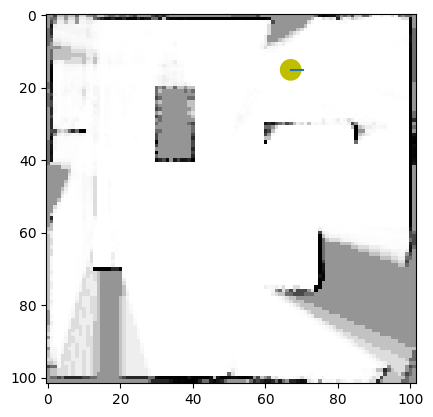

 23%|██▎       | 171/759 [01:06<03:46,  2.60it/s]

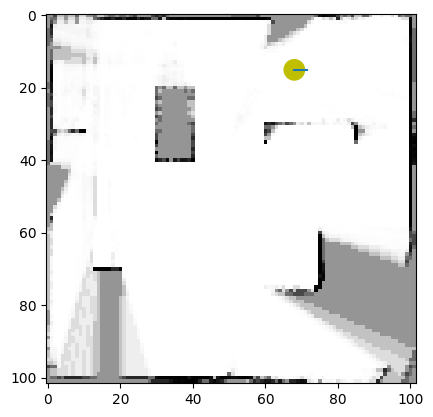

 23%|██▎       | 172/759 [01:07<03:42,  2.64it/s]

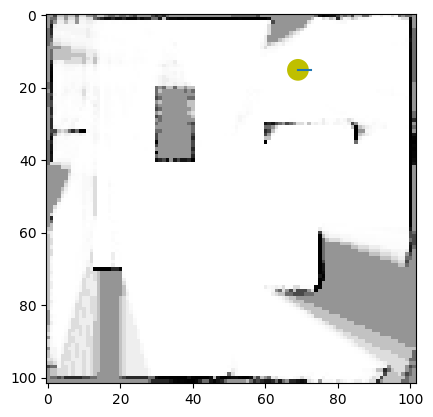

 23%|██▎       | 173/759 [01:07<03:57,  2.46it/s]

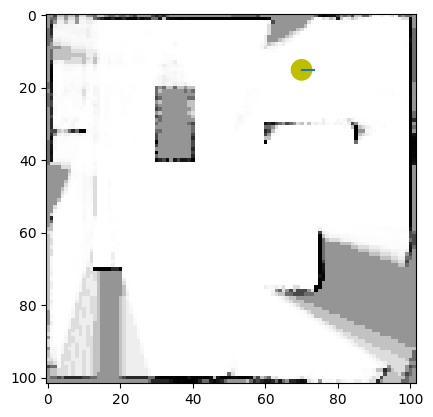

 23%|██▎       | 174/759 [01:08<03:50,  2.54it/s]

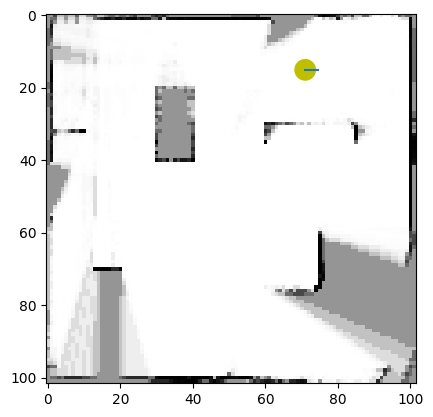

 23%|██▎       | 175/759 [01:08<03:55,  2.48it/s]

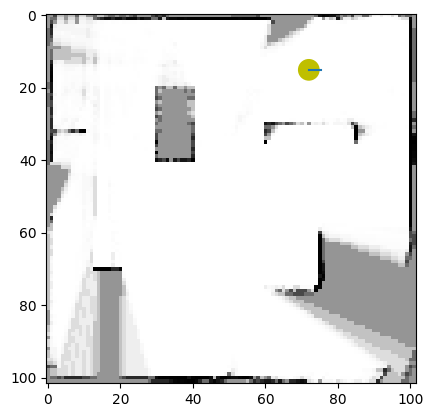

 23%|██▎       | 176/759 [01:08<03:50,  2.53it/s]

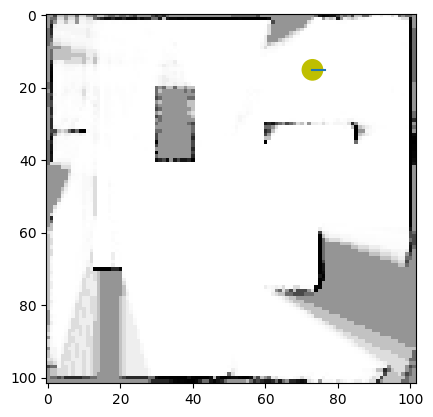

 23%|██▎       | 177/759 [01:09<03:46,  2.56it/s]

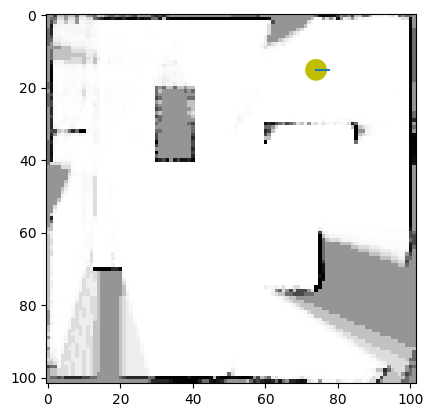

 23%|██▎       | 178/759 [01:09<03:38,  2.66it/s]

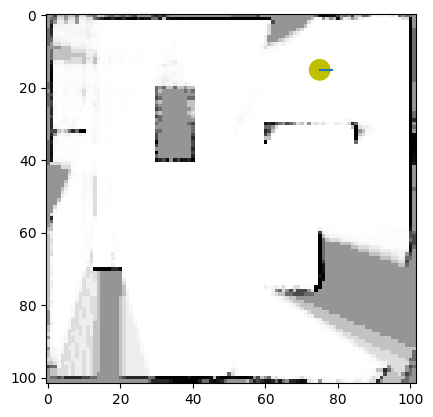

 24%|██▎       | 179/759 [01:10<03:47,  2.55it/s]

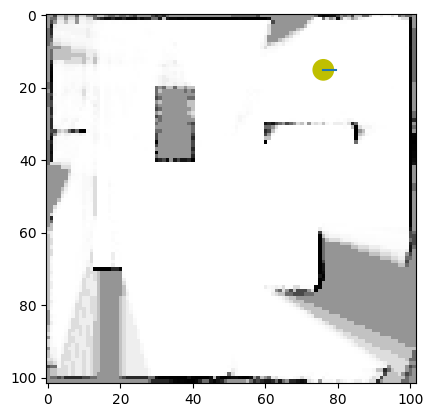

 24%|██▎       | 180/759 [01:10<03:38,  2.65it/s]

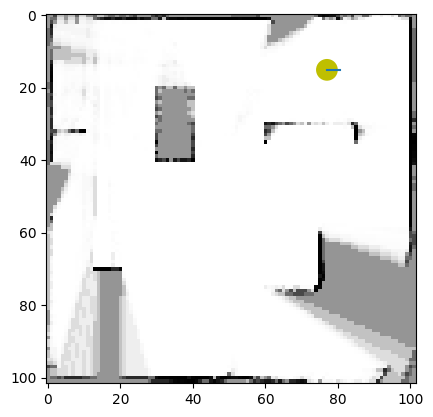

 24%|██▍       | 181/759 [01:10<03:43,  2.59it/s]

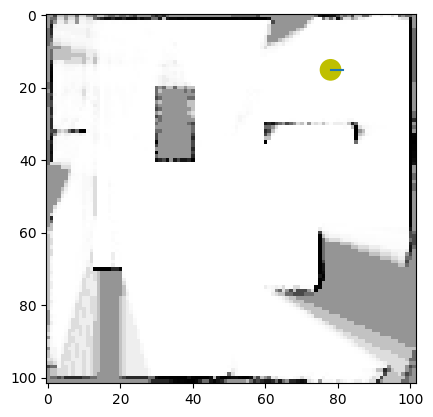

 24%|██▍       | 182/759 [01:11<03:35,  2.68it/s]

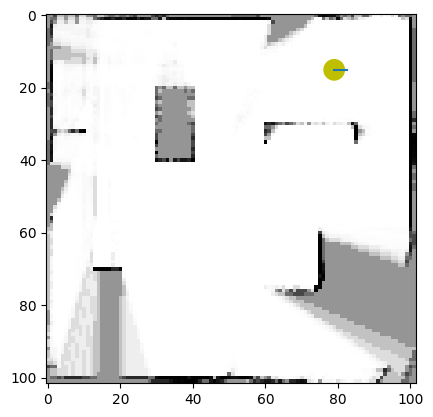

 24%|██▍       | 183/759 [01:11<03:49,  2.51it/s]

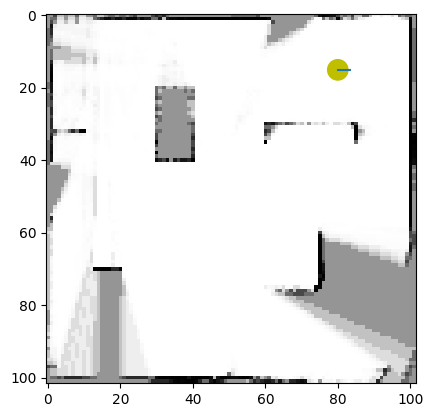

 24%|██▍       | 184/759 [01:12<03:54,  2.45it/s]

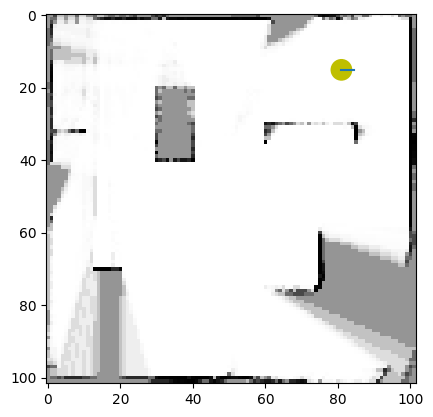

 24%|██▍       | 185/759 [01:12<04:08,  2.31it/s]

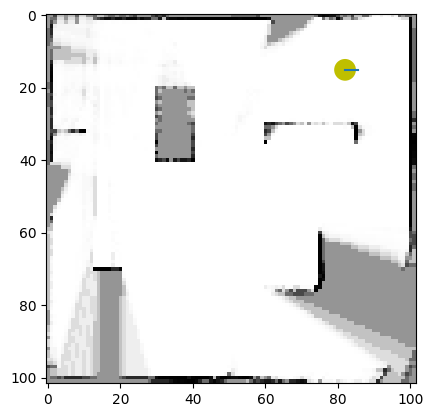

 25%|██▍       | 186/759 [01:13<04:27,  2.14it/s]

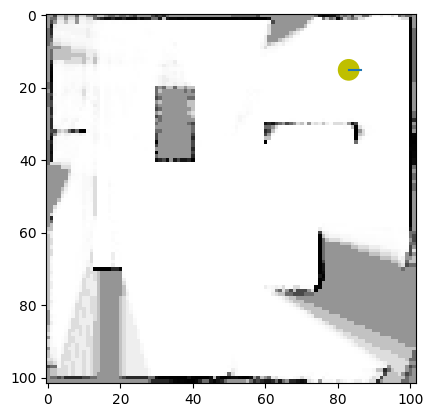

 25%|██▍       | 187/759 [01:13<04:16,  2.23it/s]

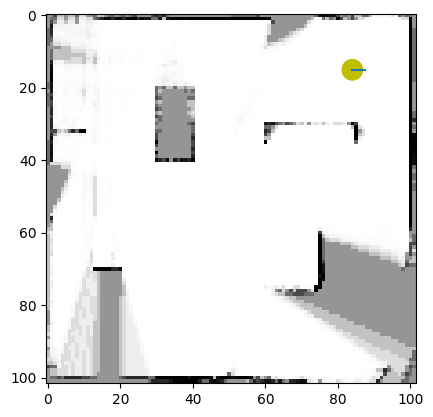

 25%|██▍       | 188/759 [01:13<03:50,  2.48it/s]

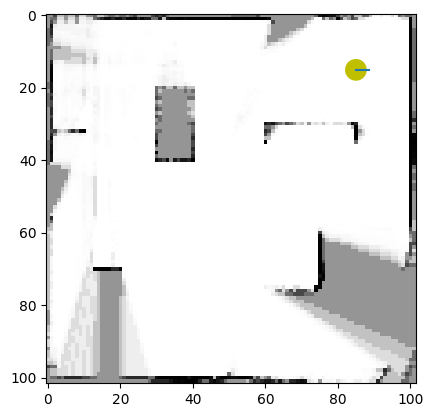

 25%|██▍       | 189/759 [01:14<03:37,  2.62it/s]

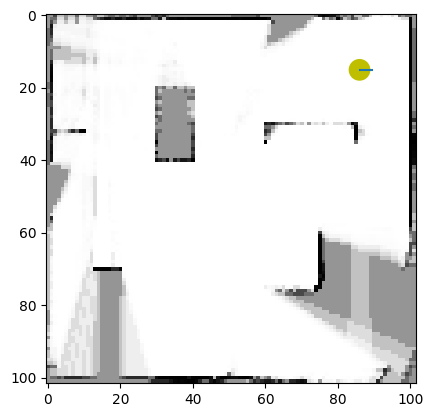

 25%|██▌       | 190/759 [01:14<03:18,  2.87it/s]

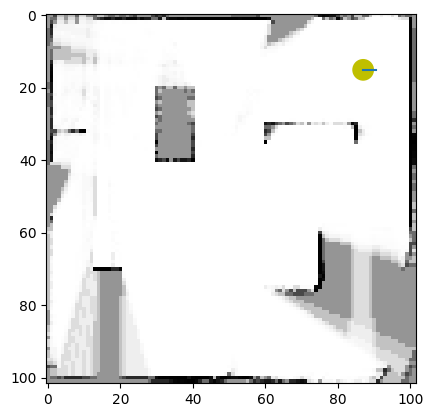

 25%|██▌       | 191/759 [01:14<03:21,  2.81it/s]

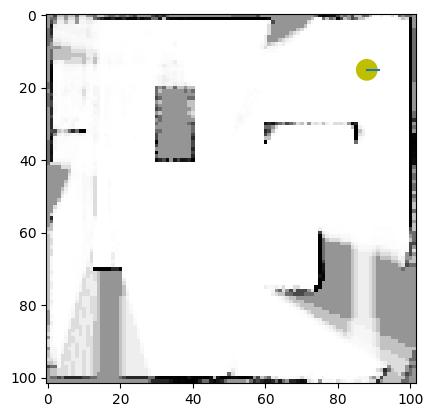

 25%|██▌       | 192/759 [01:15<03:17,  2.87it/s]

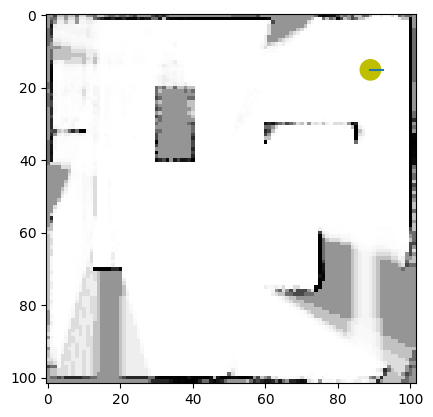

 25%|██▌       | 193/759 [01:15<03:22,  2.80it/s]

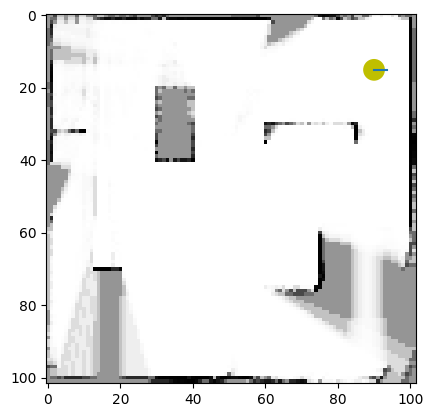

 26%|██▌       | 194/759 [01:15<03:04,  3.07it/s]

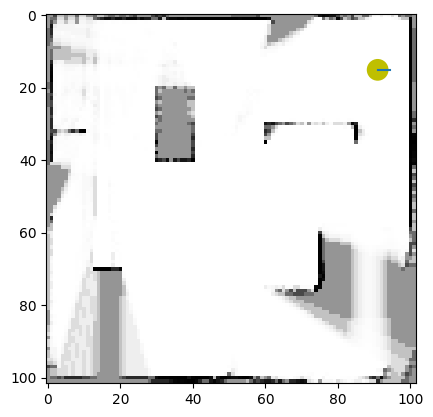

 26%|██▌       | 195/759 [01:16<03:07,  3.00it/s]

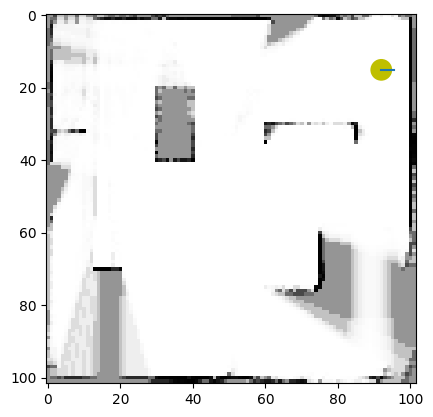

 26%|██▌       | 196/759 [01:16<03:04,  3.05it/s]

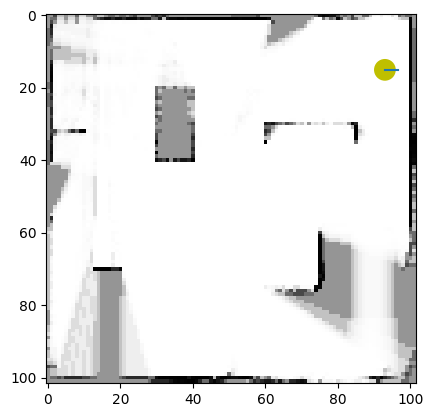

 26%|██▌       | 197/759 [01:16<03:12,  2.92it/s]

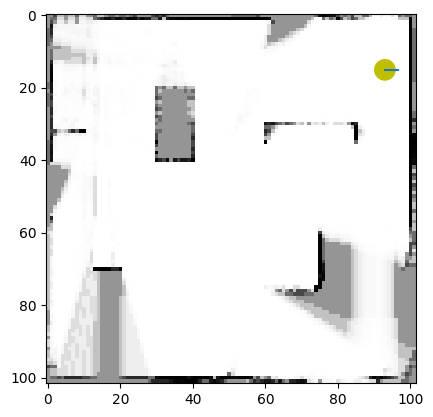

 26%|██▌       | 198/759 [01:17<03:14,  2.88it/s]

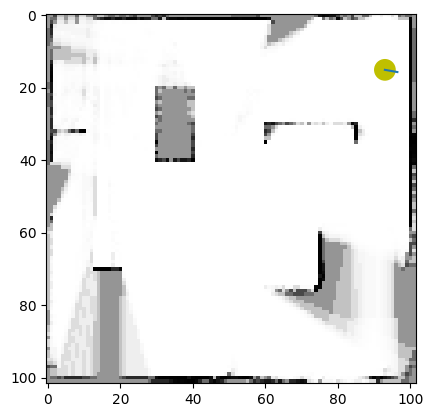

 26%|██▌       | 199/759 [01:17<03:24,  2.74it/s]

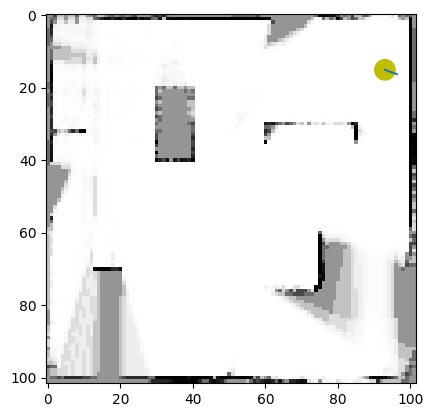

 26%|██▋       | 200/759 [01:17<03:12,  2.90it/s]

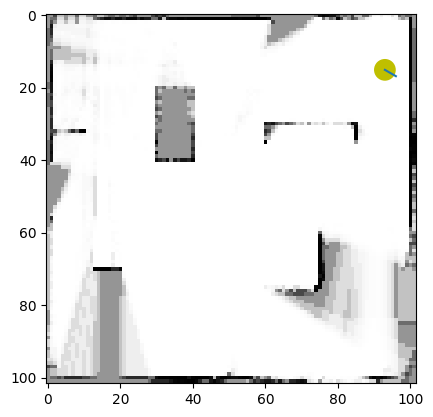

 26%|██▋       | 201/759 [01:18<03:21,  2.77it/s]

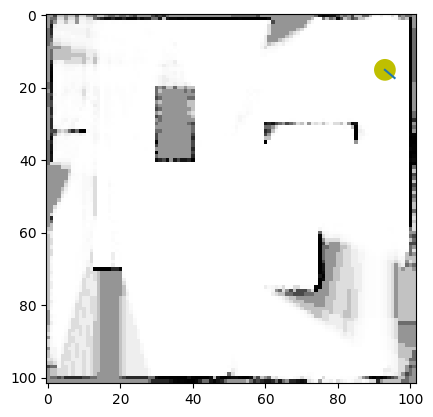

 27%|██▋       | 202/759 [01:18<03:08,  2.96it/s]

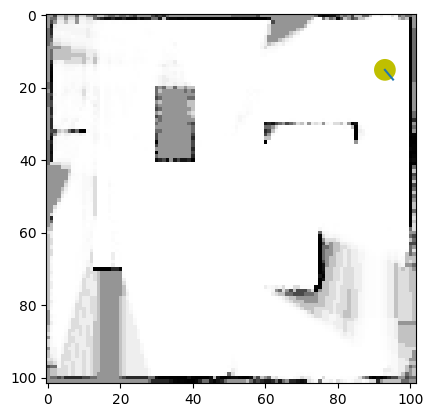

 27%|██▋       | 203/759 [01:18<03:09,  2.93it/s]

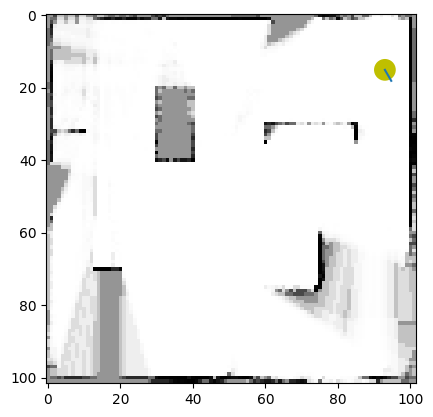

 27%|██▋       | 204/759 [01:19<02:59,  3.09it/s]

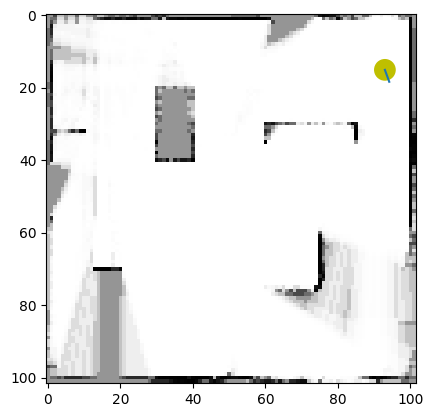

 27%|██▋       | 205/759 [01:19<03:34,  2.58it/s]

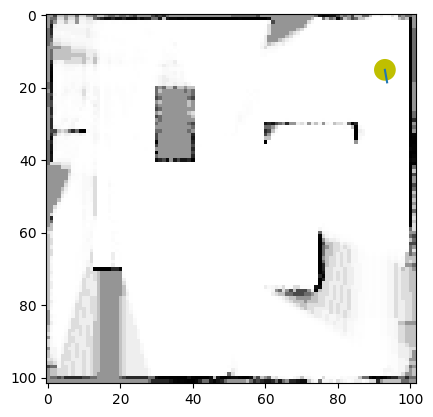

 27%|██▋       | 206/759 [01:20<04:04,  2.26it/s]

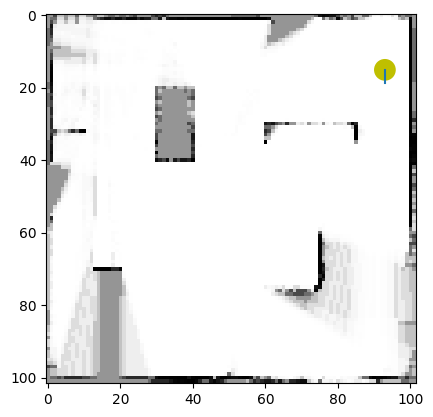

 27%|██▋       | 207/759 [01:20<03:48,  2.41it/s]

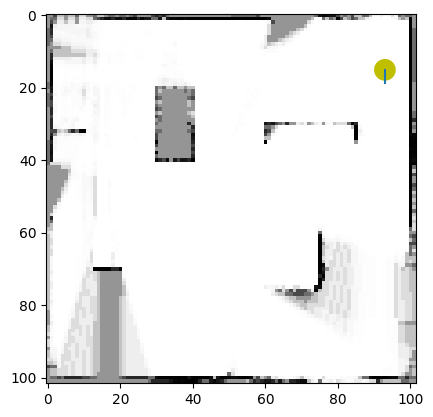

 27%|██▋       | 208/759 [01:21<03:50,  2.39it/s]

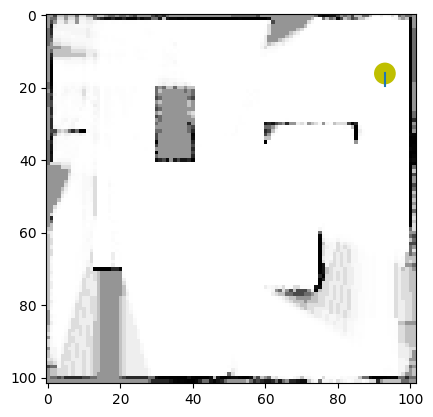

 28%|██▊       | 209/759 [01:21<03:24,  2.69it/s]

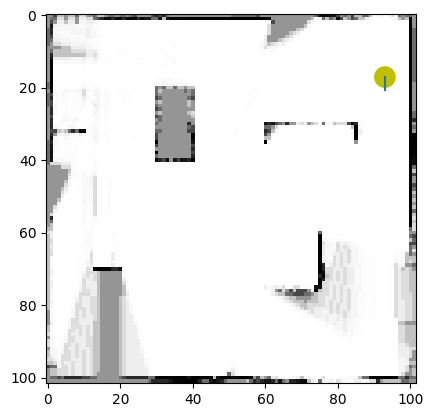

 28%|██▊       | 210/759 [01:21<03:44,  2.45it/s]

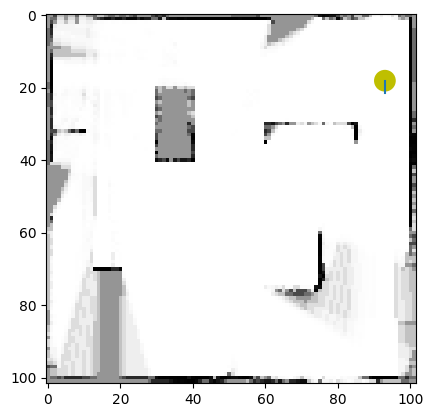

 28%|██▊       | 211/759 [01:22<03:42,  2.46it/s]

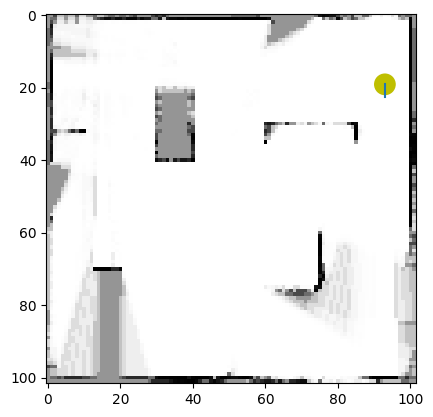

 28%|██▊       | 212/759 [01:22<04:18,  2.12it/s]

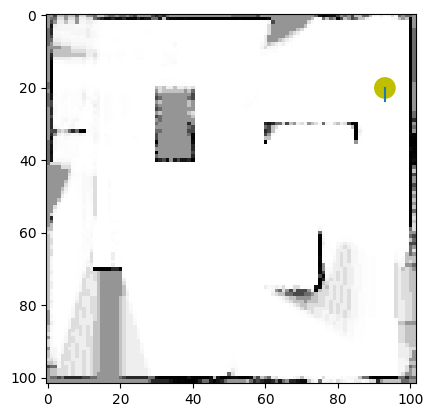

 28%|██▊       | 213/759 [01:23<05:02,  1.81it/s]

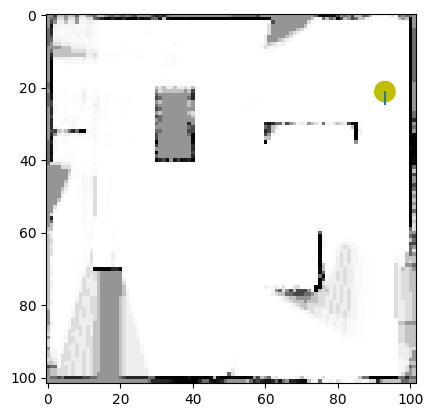

 28%|██▊       | 214/759 [01:24<04:50,  1.87it/s]

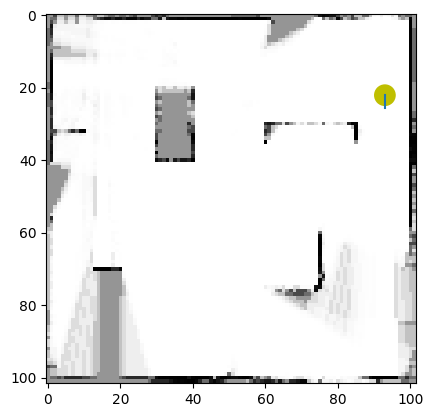

 28%|██▊       | 215/759 [01:24<04:16,  2.12it/s]

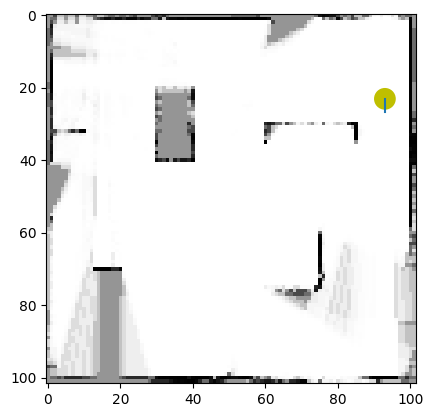

 28%|██▊       | 216/759 [01:24<04:07,  2.19it/s]

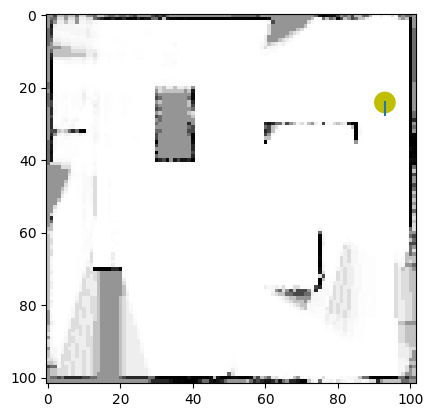

 29%|██▊       | 217/759 [01:25<03:44,  2.41it/s]

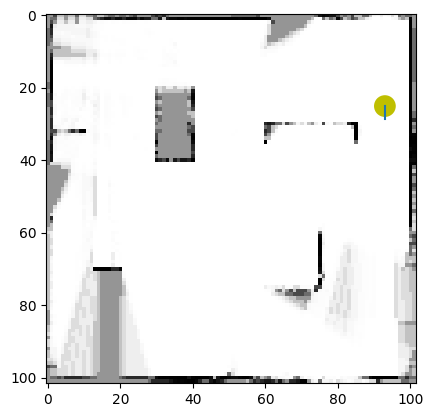

 29%|██▊       | 218/759 [01:25<03:53,  2.32it/s]

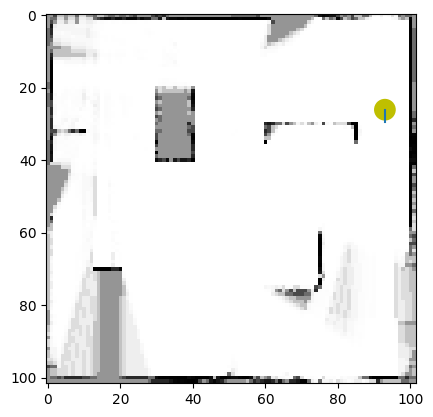

 29%|██▉       | 219/759 [01:26<04:17,  2.10it/s]

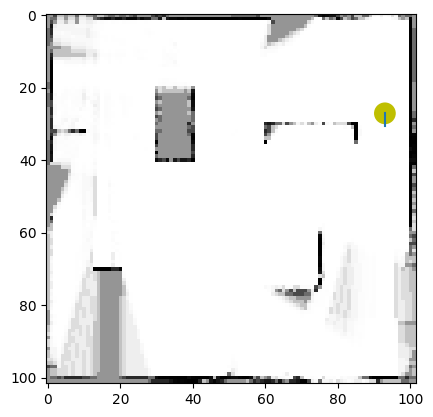

 29%|██▉       | 220/759 [01:26<03:57,  2.27it/s]

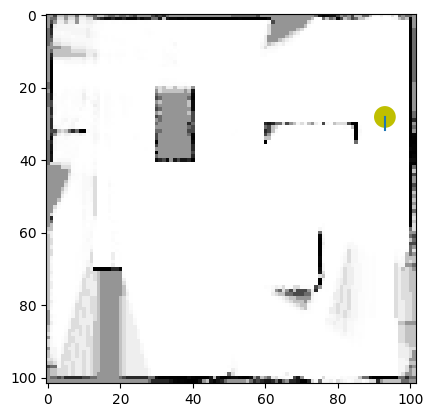

 29%|██▉       | 221/759 [01:26<03:53,  2.30it/s]

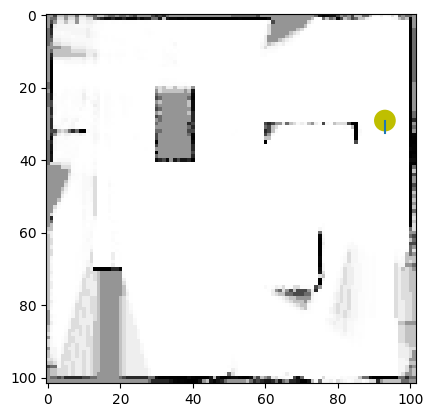

 29%|██▉       | 222/759 [01:27<03:39,  2.45it/s]

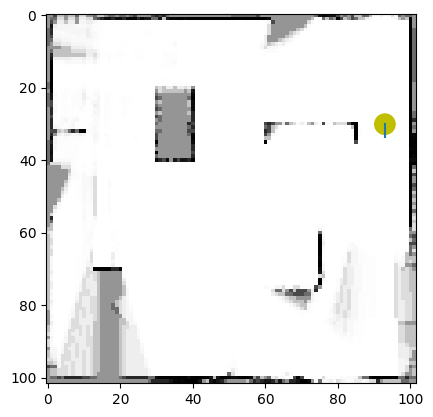

 29%|██▉       | 223/759 [01:27<03:40,  2.43it/s]

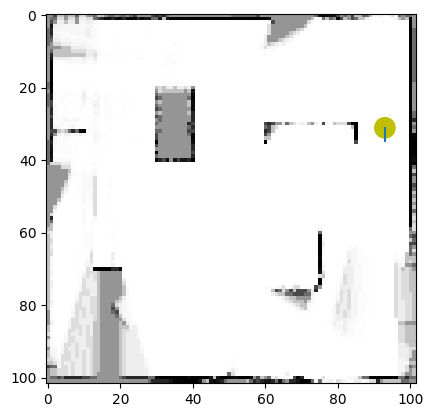

 30%|██▉       | 224/759 [01:28<03:32,  2.52it/s]

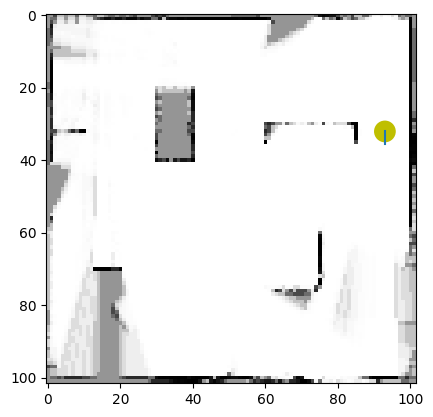

 30%|██▉       | 225/759 [01:28<03:36,  2.47it/s]

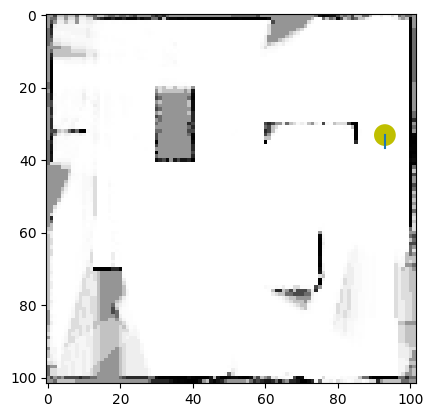

 30%|██▉       | 226/759 [01:28<03:28,  2.55it/s]

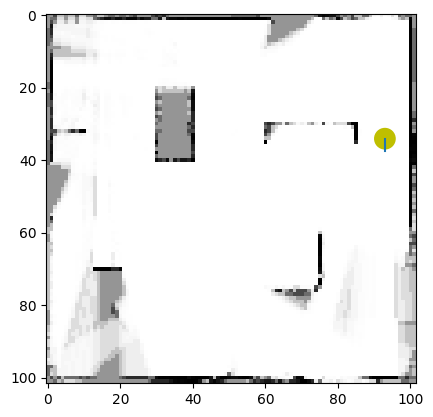

 30%|██▉       | 227/759 [01:29<03:37,  2.44it/s]

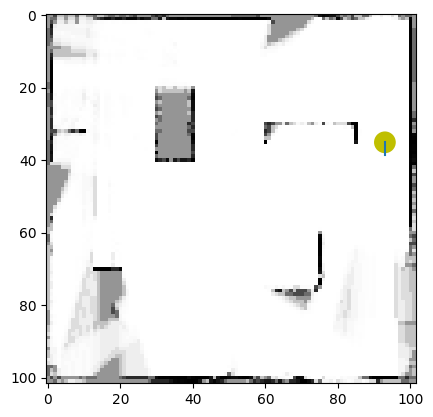

 30%|███       | 228/759 [01:29<03:46,  2.35it/s]

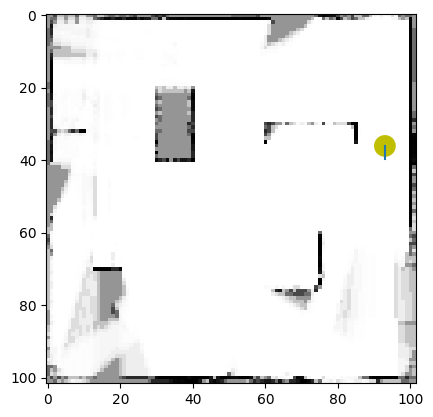

 30%|███       | 229/759 [01:30<03:36,  2.45it/s]

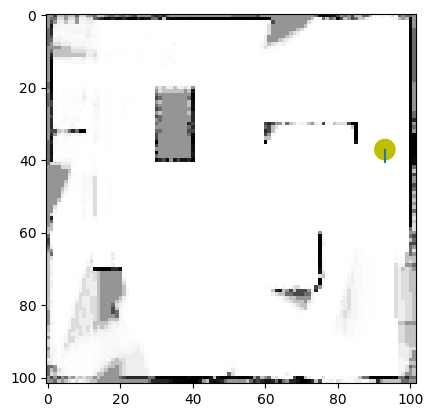

 30%|███       | 230/759 [01:30<03:40,  2.40it/s]

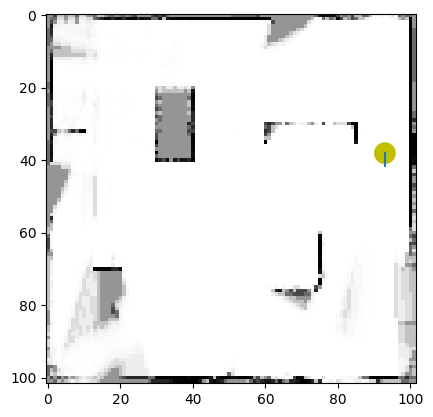

 30%|███       | 231/759 [01:31<03:43,  2.37it/s]

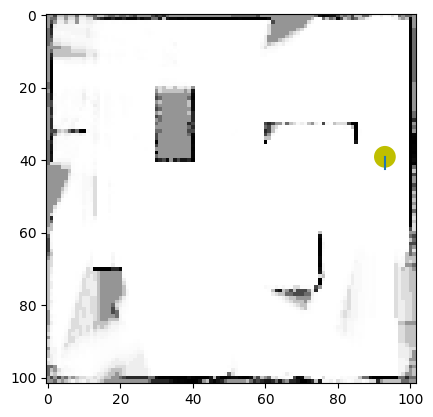

 31%|███       | 232/759 [01:31<03:33,  2.47it/s]

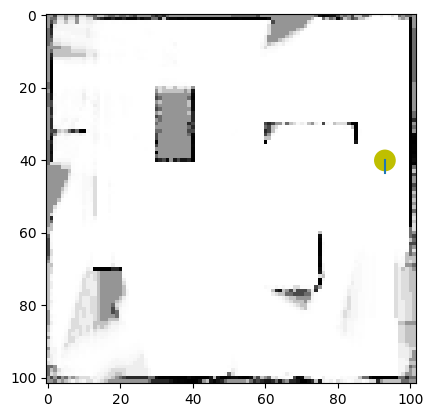

 31%|███       | 233/759 [01:31<03:39,  2.39it/s]

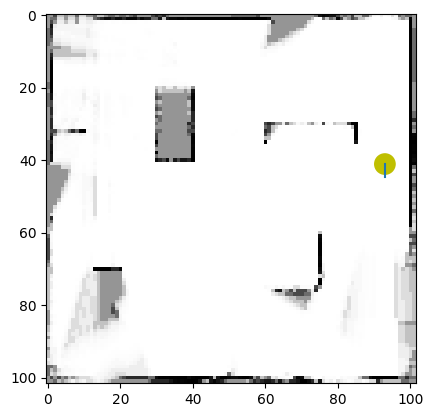

 31%|███       | 234/759 [01:32<03:42,  2.36it/s]

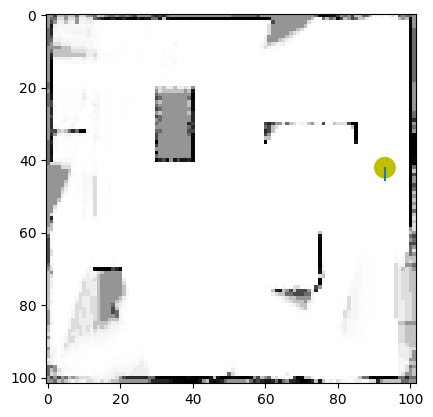

 31%|███       | 235/759 [01:32<03:39,  2.39it/s]

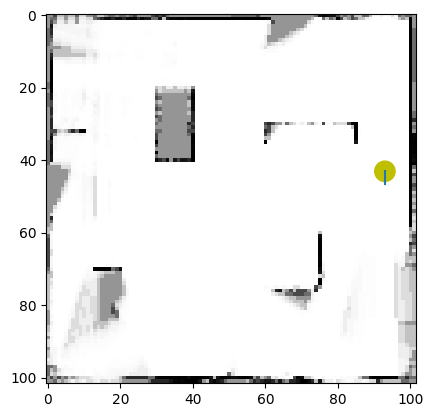

 31%|███       | 236/759 [01:33<04:11,  2.08it/s]

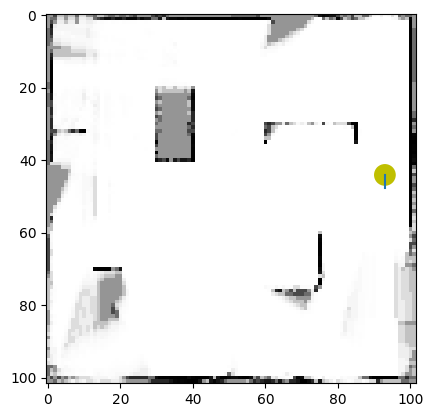

 31%|███       | 237/759 [01:33<04:01,  2.16it/s]

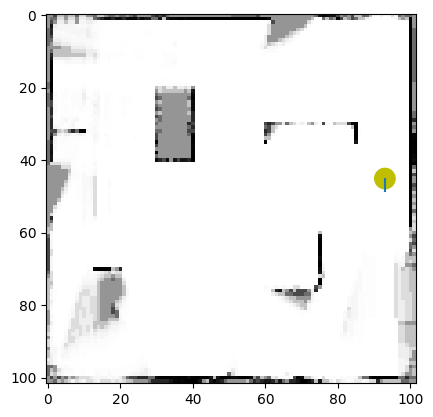

 31%|███▏      | 238/759 [01:34<04:25,  1.96it/s]

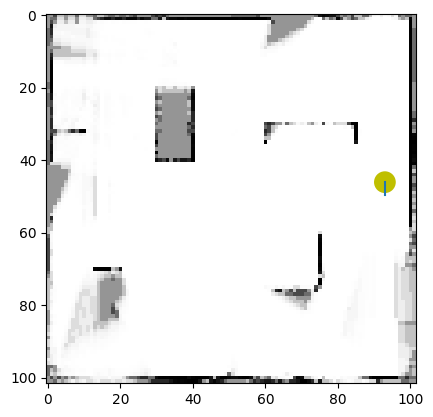

 31%|███▏      | 239/759 [01:34<04:06,  2.11it/s]

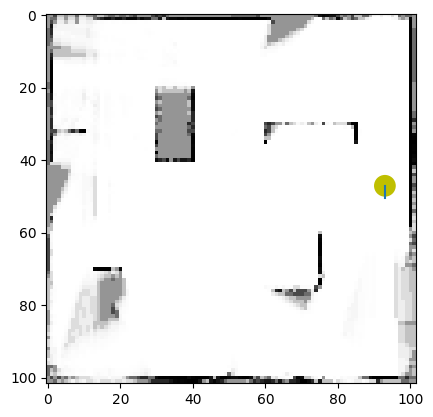

 32%|███▏      | 240/759 [01:35<04:45,  1.82it/s]

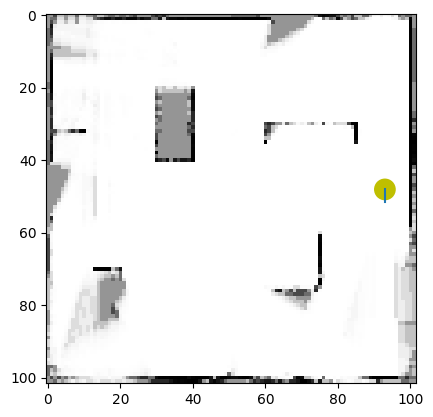

 32%|███▏      | 241/759 [01:35<04:15,  2.02it/s]

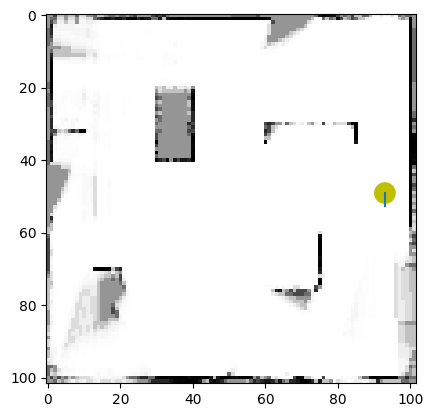

 32%|███▏      | 242/759 [01:36<04:09,  2.07it/s]

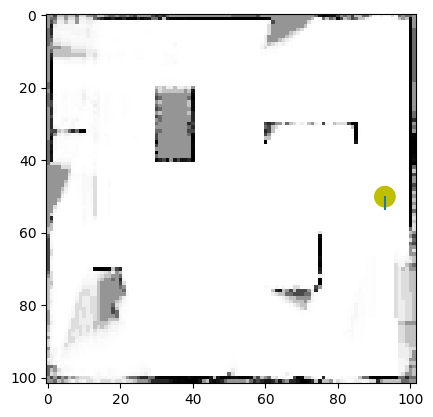

 32%|███▏      | 243/759 [01:36<04:10,  2.06it/s]

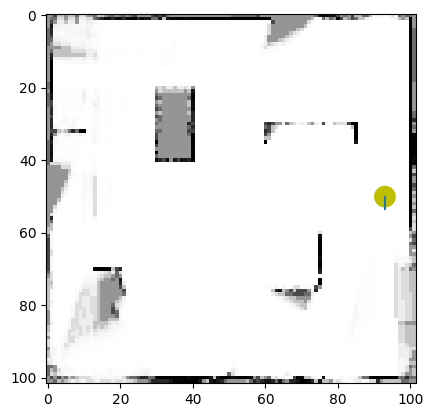

 32%|███▏      | 244/759 [01:37<04:21,  1.97it/s]

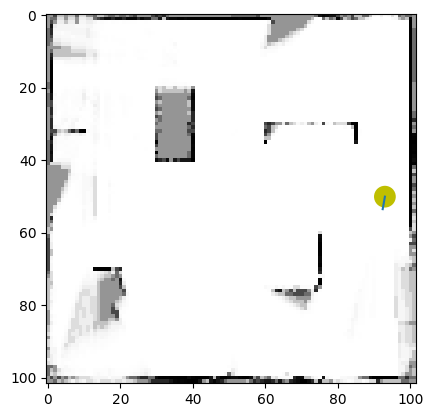

 32%|███▏      | 245/759 [01:37<04:12,  2.03it/s]

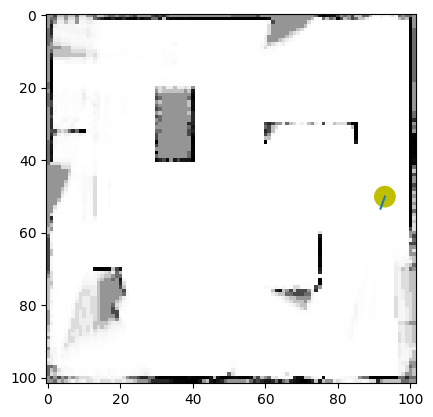

 32%|███▏      | 246/759 [01:38<03:53,  2.20it/s]

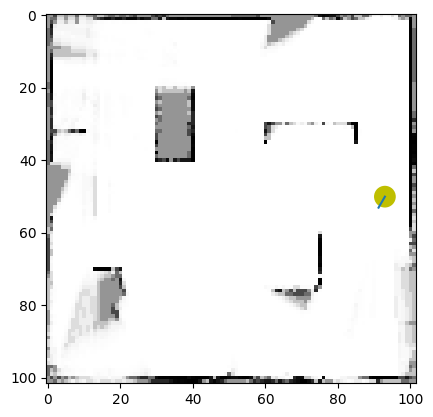

 33%|███▎      | 247/759 [01:38<03:47,  2.26it/s]

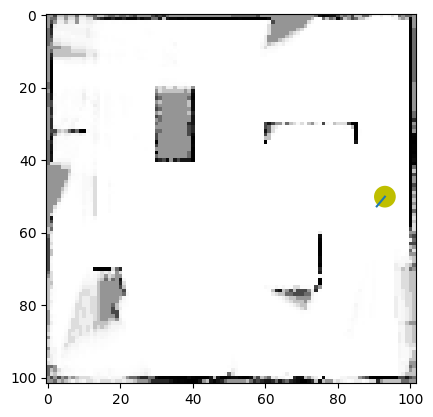

 33%|███▎      | 248/759 [01:38<03:28,  2.45it/s]

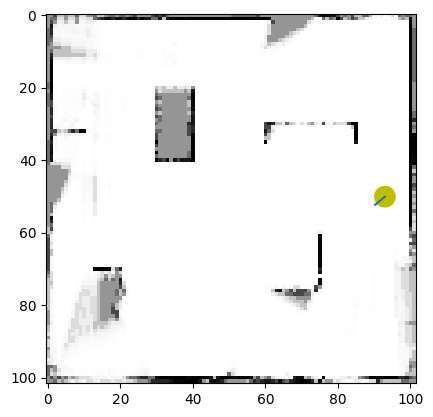

 33%|███▎      | 249/759 [01:39<03:46,  2.25it/s]

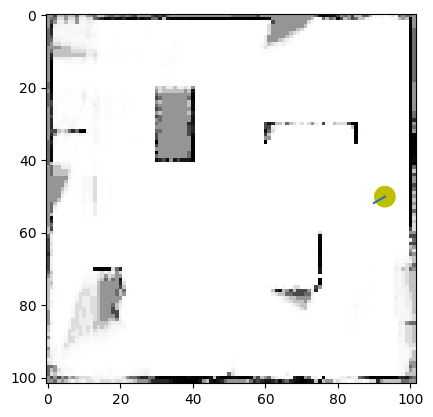

 33%|███▎      | 250/759 [01:39<03:50,  2.21it/s]

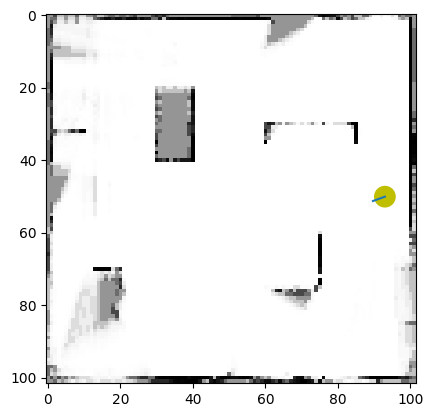

 33%|███▎      | 251/759 [01:40<03:42,  2.28it/s]

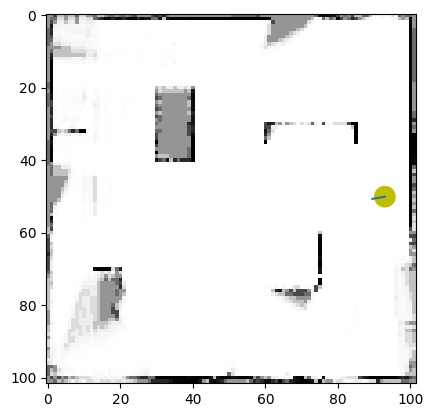

 33%|███▎      | 252/759 [01:40<03:49,  2.21it/s]

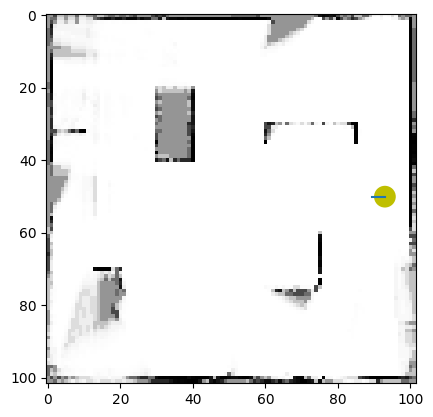

 33%|███▎      | 253/759 [01:41<03:48,  2.21it/s]

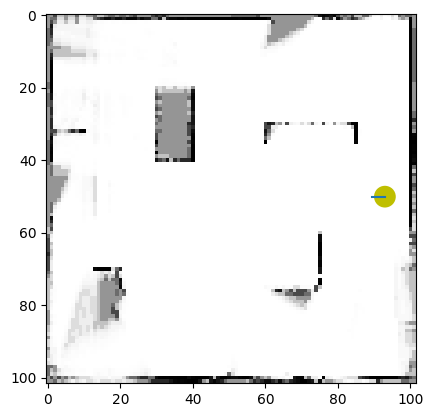

 33%|███▎      | 254/759 [01:41<03:38,  2.31it/s]

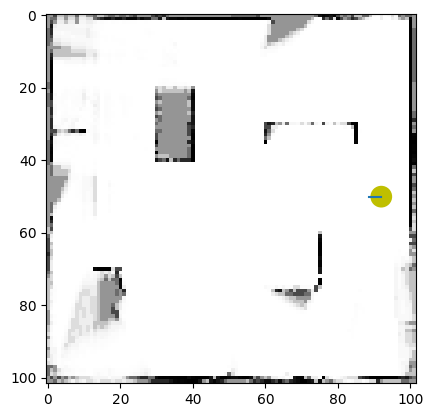

 34%|███▎      | 255/759 [01:42<03:56,  2.13it/s]

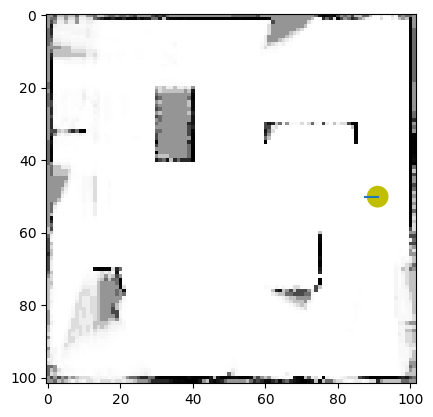

 34%|███▎      | 256/759 [01:42<03:45,  2.23it/s]

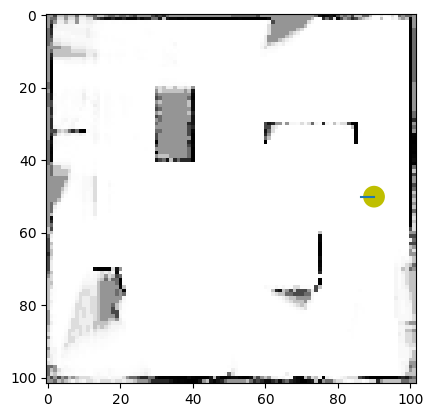

 34%|███▍      | 257/759 [01:43<03:42,  2.26it/s]

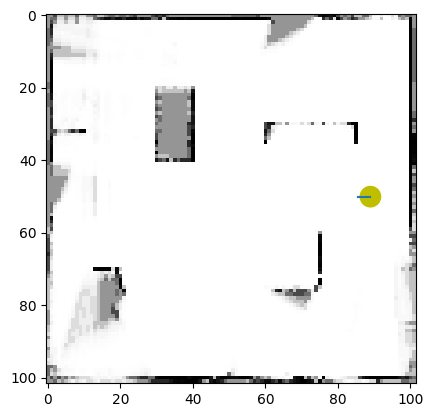

 34%|███▍      | 258/759 [01:43<03:17,  2.53it/s]

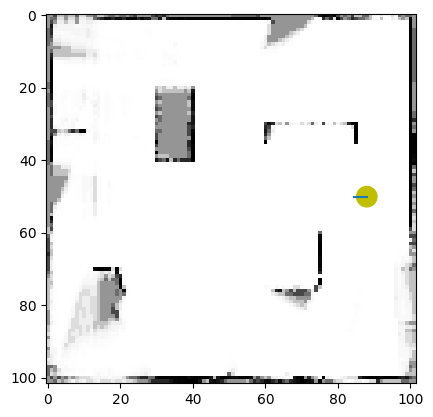

 34%|███▍      | 259/759 [01:43<03:24,  2.45it/s]

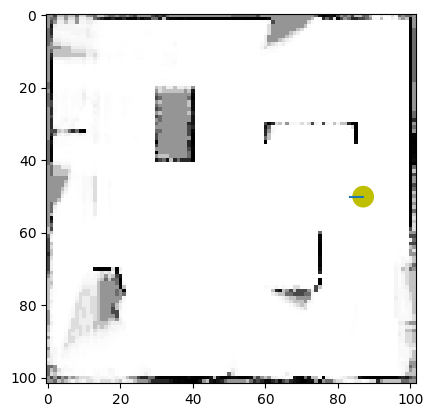

 34%|███▍      | 260/759 [01:44<03:23,  2.45it/s]

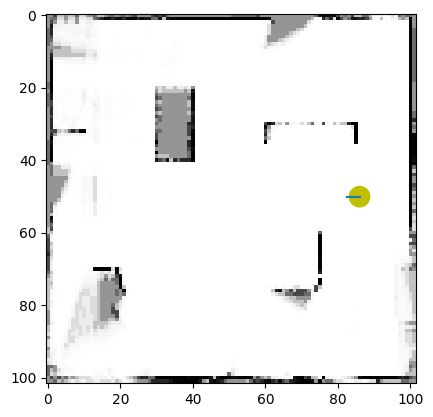

 34%|███▍      | 261/759 [01:44<03:02,  2.73it/s]

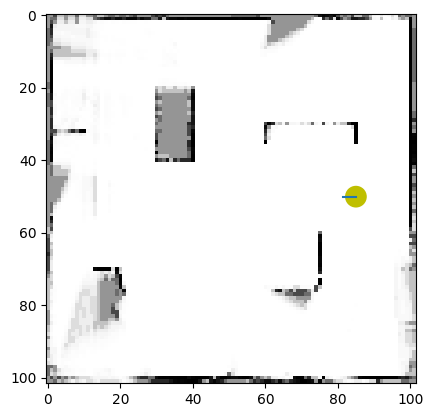

 35%|███▍      | 262/759 [01:44<02:58,  2.78it/s]

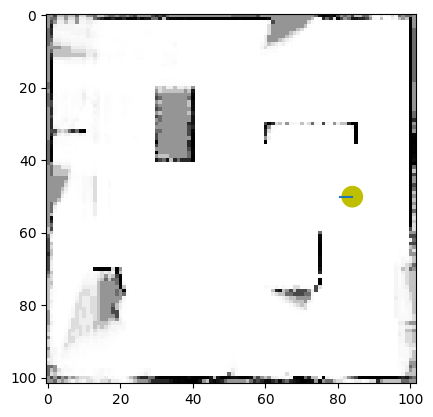

 35%|███▍      | 263/759 [01:45<03:08,  2.64it/s]

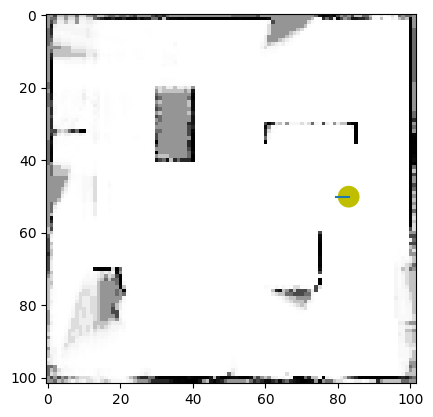

 35%|███▍      | 264/759 [01:45<03:07,  2.64it/s]

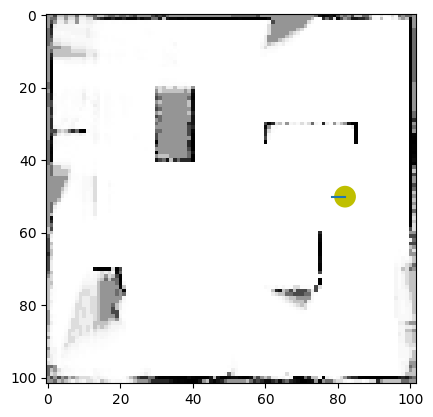

 35%|███▍      | 265/759 [01:46<03:25,  2.41it/s]

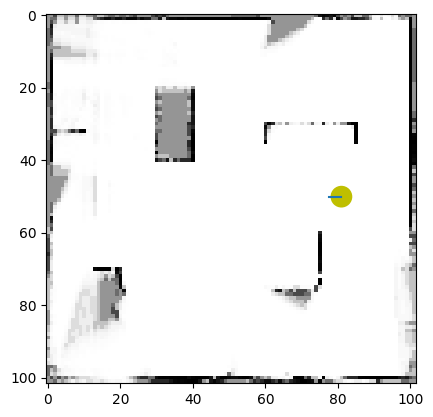

 35%|███▌      | 266/759 [01:46<03:14,  2.54it/s]

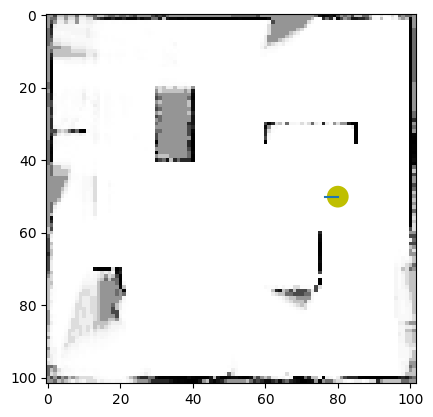

 35%|███▌      | 267/759 [01:46<03:21,  2.45it/s]

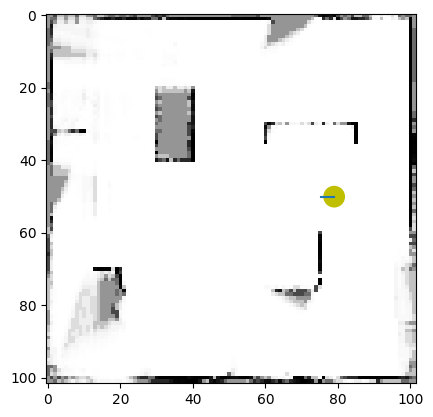

 35%|███▌      | 268/759 [01:47<02:58,  2.75it/s]

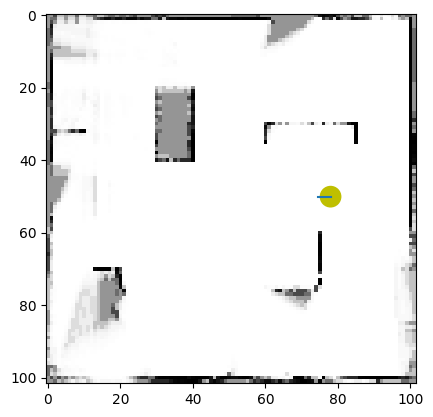

 35%|███▌      | 269/759 [01:47<02:56,  2.78it/s]

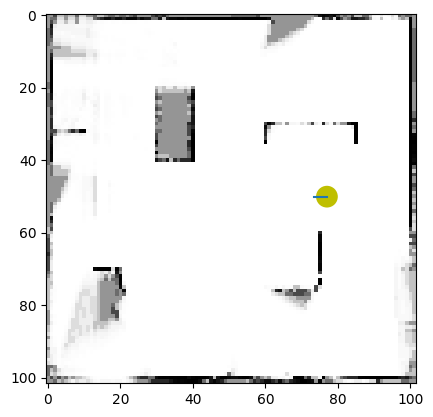

 36%|███▌      | 270/759 [01:47<02:40,  3.05it/s]

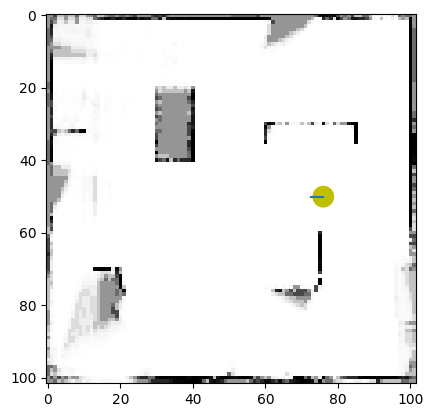

 36%|███▌      | 271/759 [01:48<02:42,  3.01it/s]

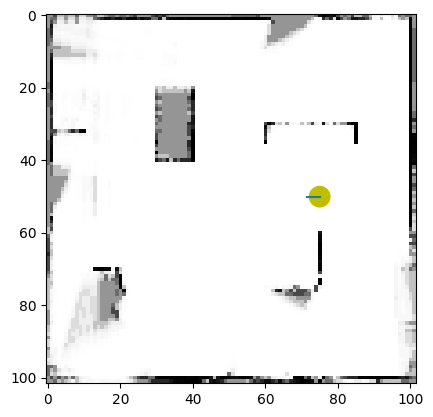

 36%|███▌      | 272/759 [01:48<02:32,  3.19it/s]

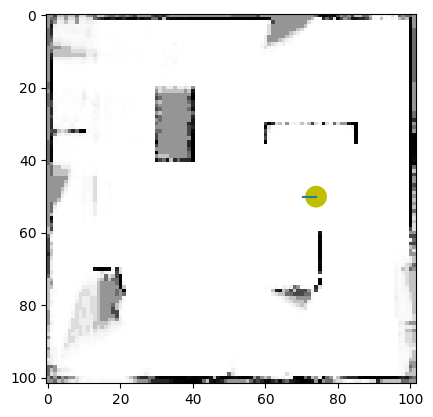

 36%|███▌      | 273/759 [01:48<02:37,  3.09it/s]

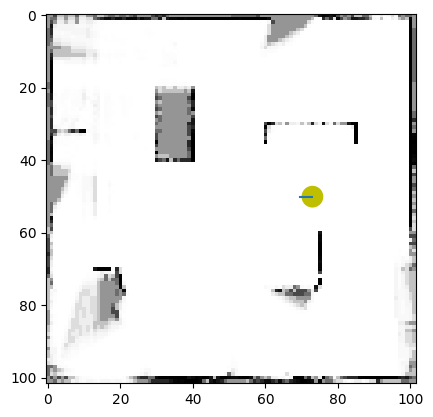

 36%|███▌      | 274/759 [01:49<02:45,  2.94it/s]

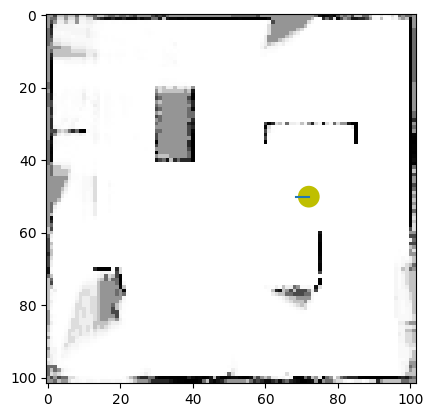

 36%|███▌      | 275/759 [01:49<02:37,  3.07it/s]

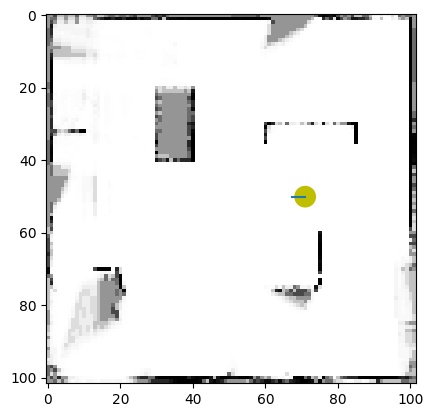

 36%|███▋      | 276/759 [01:49<02:44,  2.94it/s]

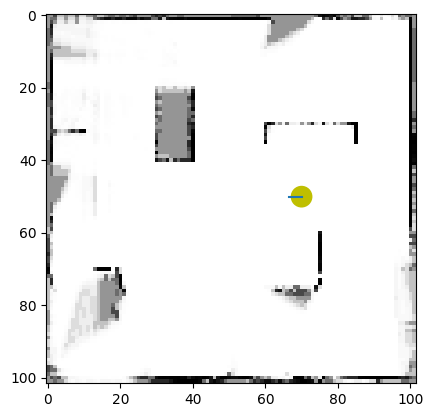

 36%|███▋      | 277/759 [01:50<02:35,  3.10it/s]

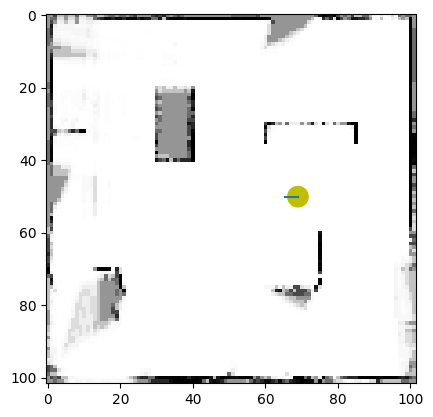

 37%|███▋      | 278/759 [01:50<02:49,  2.83it/s]

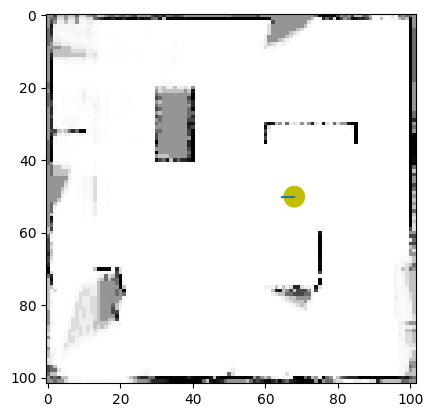

 37%|███▋      | 279/759 [01:50<02:54,  2.75it/s]

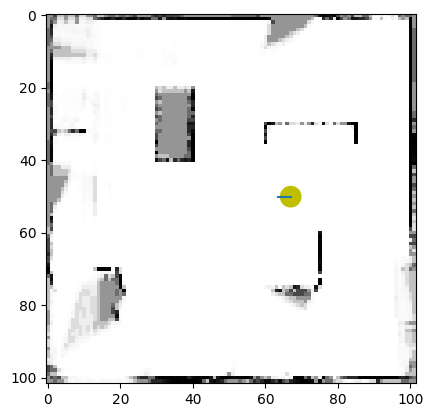

 37%|███▋      | 280/759 [01:51<02:43,  2.93it/s]

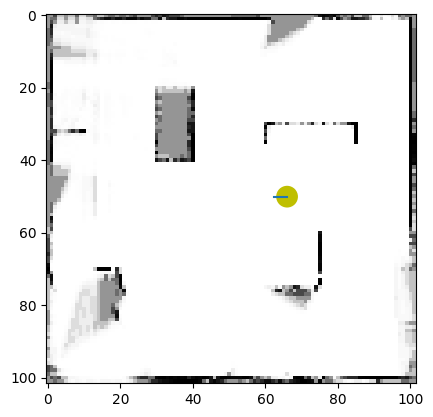

 37%|███▋      | 281/759 [01:51<02:45,  2.89it/s]

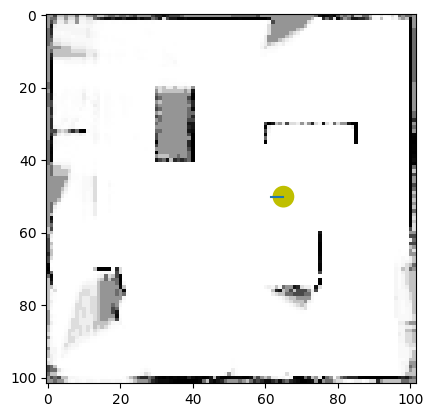

 37%|███▋      | 282/759 [01:51<02:42,  2.94it/s]

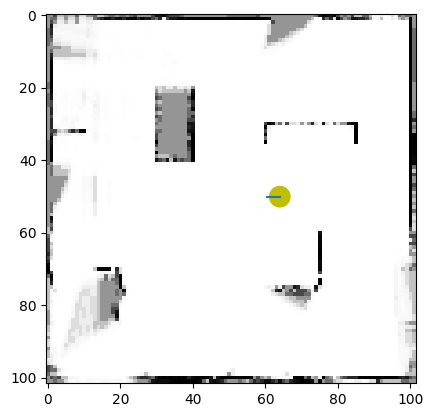

 37%|███▋      | 283/759 [01:52<02:29,  3.19it/s]

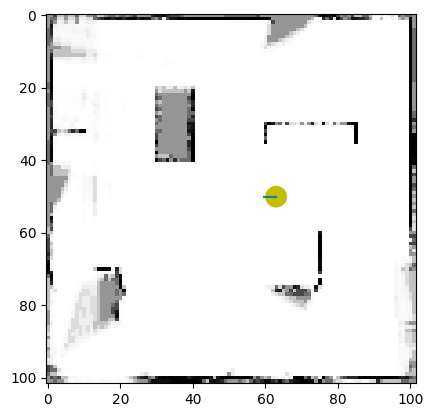

 37%|███▋      | 284/759 [01:52<03:14,  2.45it/s]

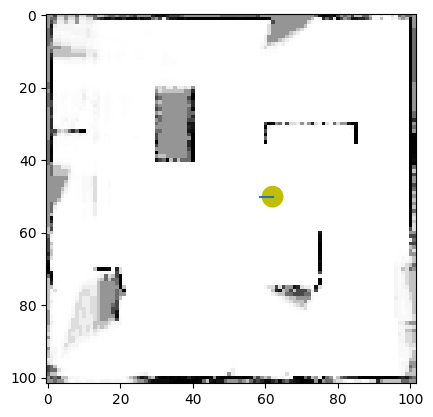

 38%|███▊      | 285/759 [01:53<03:38,  2.17it/s]

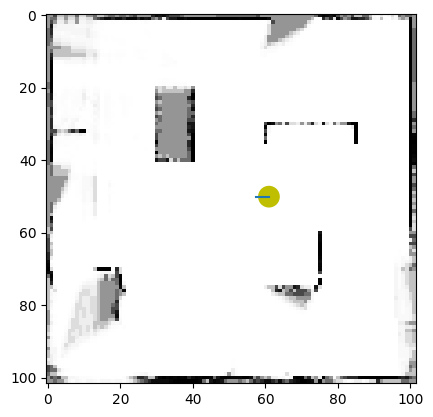

 38%|███▊      | 286/759 [01:53<03:38,  2.16it/s]

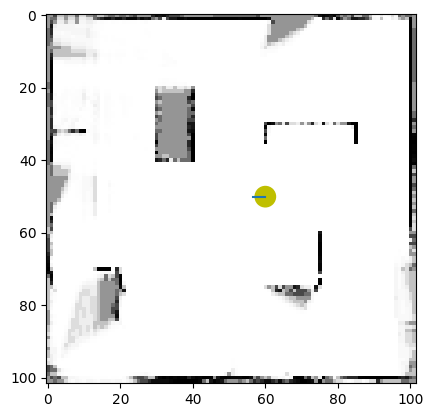

 38%|███▊      | 287/759 [01:54<03:33,  2.21it/s]

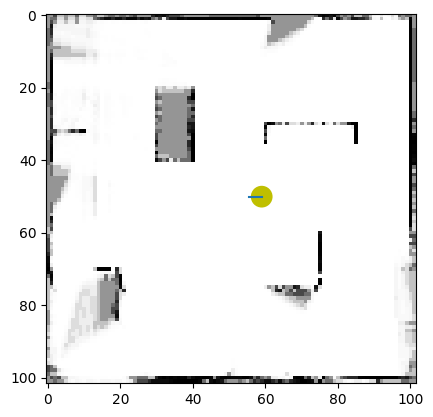

 38%|███▊      | 288/759 [01:54<03:37,  2.17it/s]

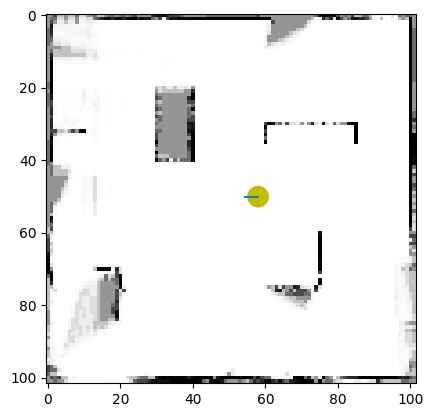

 38%|███▊      | 289/759 [01:55<03:30,  2.23it/s]

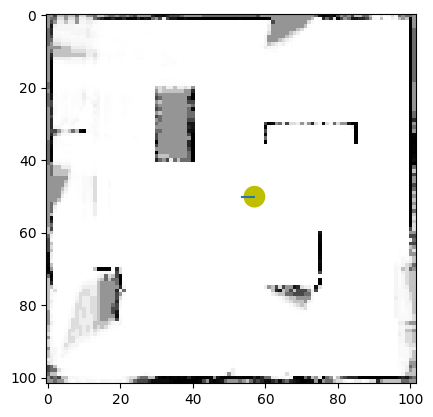

 38%|███▊      | 290/759 [01:55<03:31,  2.22it/s]

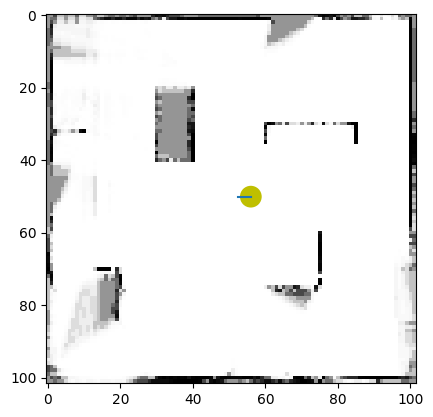

 38%|███▊      | 291/759 [01:55<03:28,  2.25it/s]

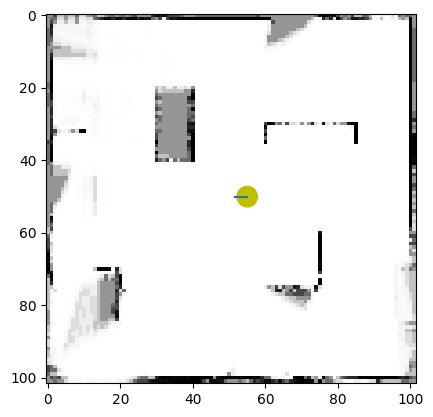

 38%|███▊      | 292/759 [01:56<03:27,  2.25it/s]

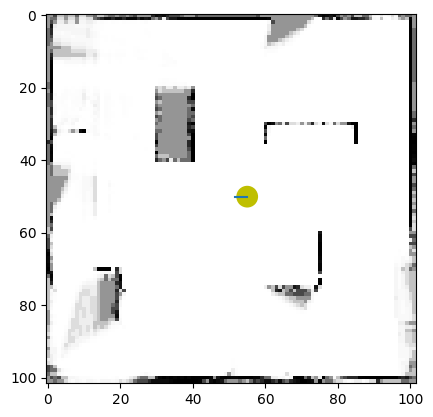

 39%|███▊      | 293/759 [01:56<03:27,  2.25it/s]

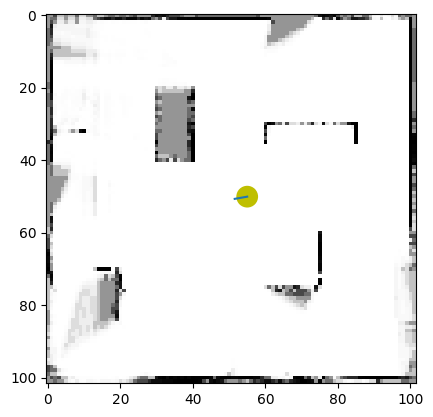

 39%|███▊      | 294/759 [01:57<03:42,  2.09it/s]

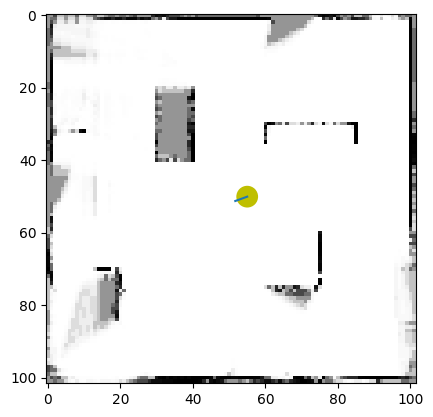

 39%|███▉      | 295/759 [01:57<03:33,  2.18it/s]

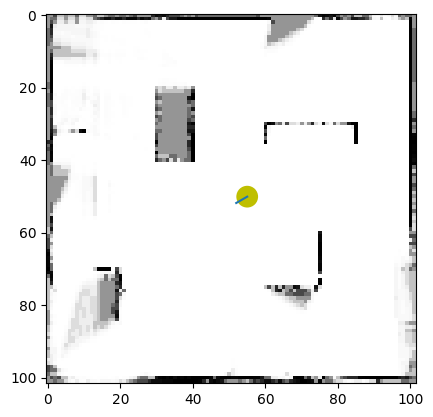

 39%|███▉      | 296/759 [01:58<03:28,  2.22it/s]

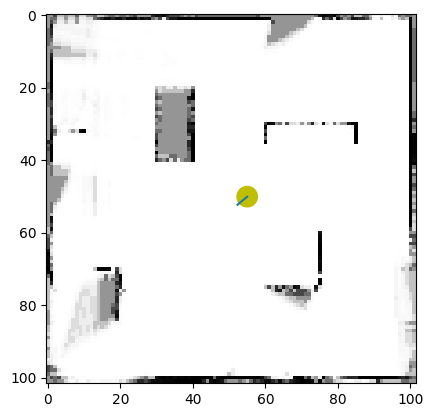

 39%|███▉      | 297/759 [01:58<03:19,  2.31it/s]

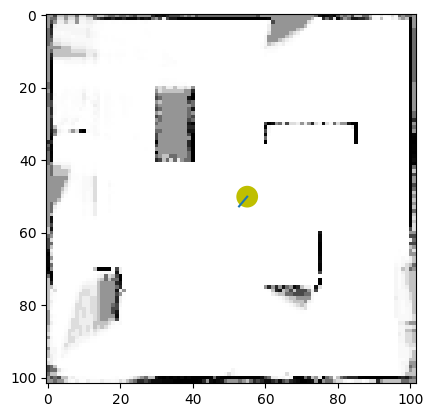

 39%|███▉      | 298/759 [01:59<03:10,  2.42it/s]

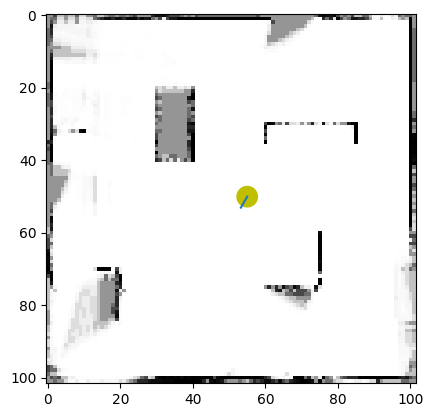

 39%|███▉      | 299/759 [01:59<03:04,  2.50it/s]

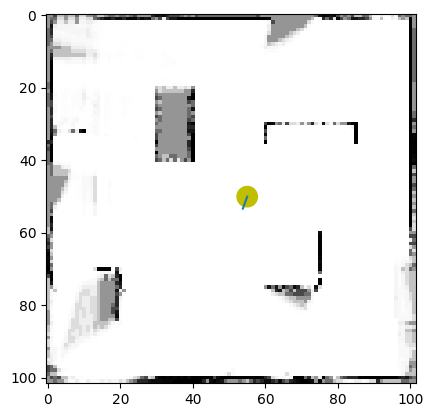

 40%|███▉      | 300/759 [01:59<03:04,  2.48it/s]

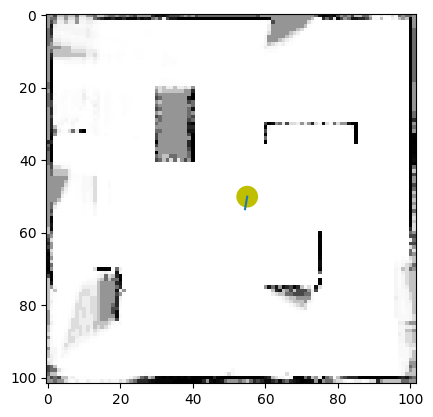

 40%|███▉      | 301/759 [02:00<03:02,  2.50it/s]

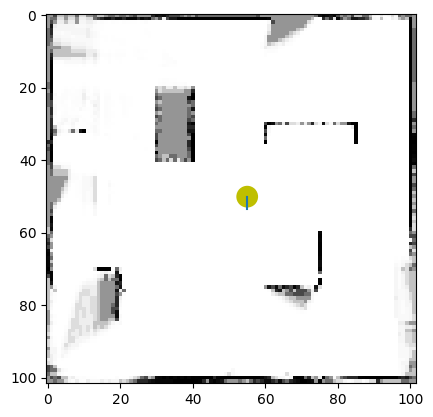

 40%|███▉      | 302/759 [02:00<03:00,  2.54it/s]

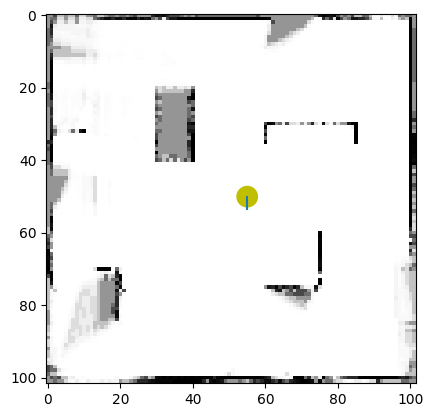

 40%|███▉      | 303/759 [02:00<02:58,  2.55it/s]

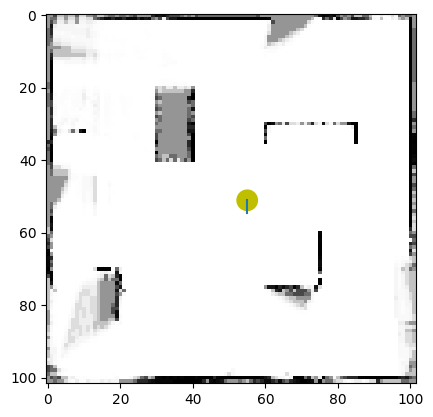

 40%|████      | 304/759 [02:01<02:56,  2.58it/s]

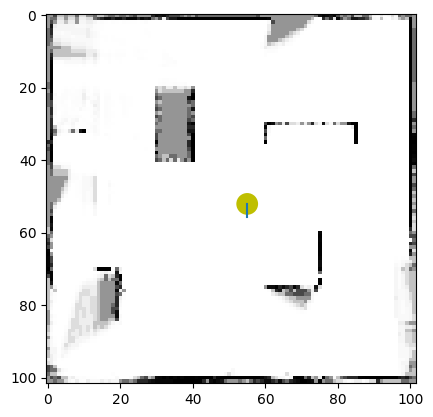

 40%|████      | 305/759 [02:01<02:49,  2.67it/s]

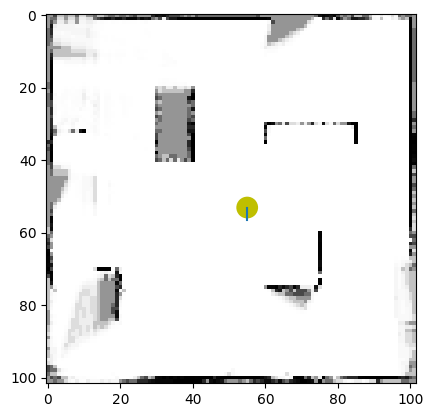

 40%|████      | 306/759 [02:02<02:51,  2.64it/s]

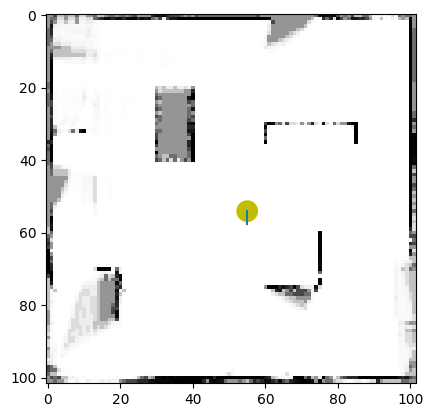

 40%|████      | 307/759 [02:02<02:53,  2.61it/s]

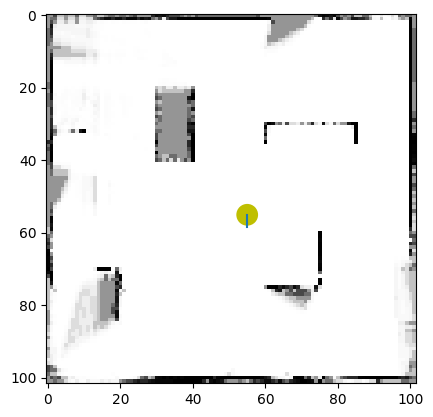

 41%|████      | 308/759 [02:02<02:47,  2.70it/s]

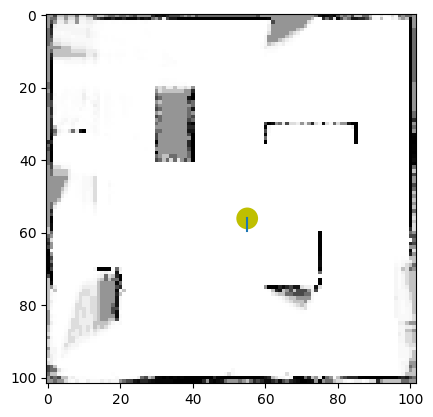

 41%|████      | 309/759 [02:03<02:49,  2.65it/s]

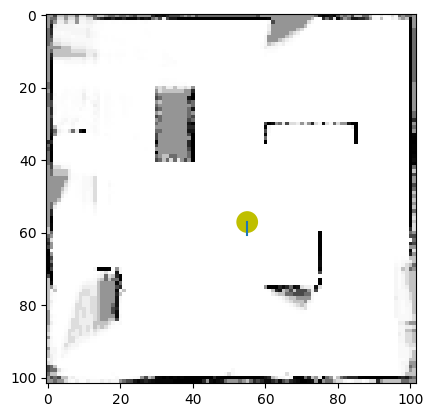

 41%|████      | 310/759 [02:03<02:46,  2.69it/s]

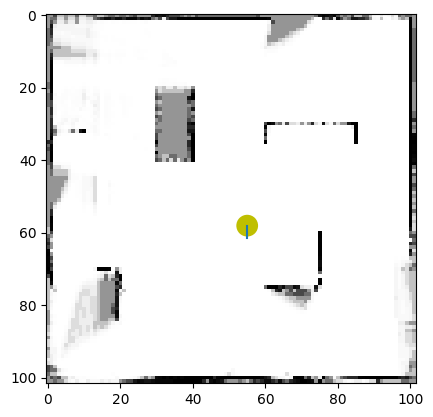

 41%|████      | 311/759 [02:03<02:46,  2.70it/s]

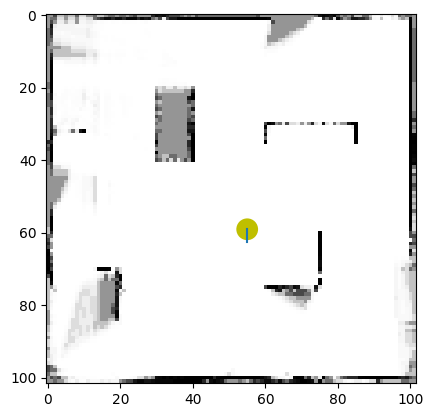

 41%|████      | 312/759 [02:04<02:47,  2.66it/s]

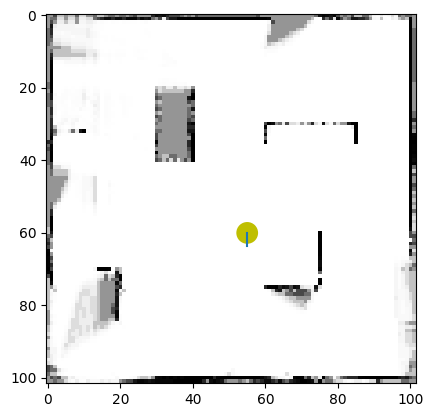

 41%|████      | 313/759 [02:04<02:49,  2.64it/s]

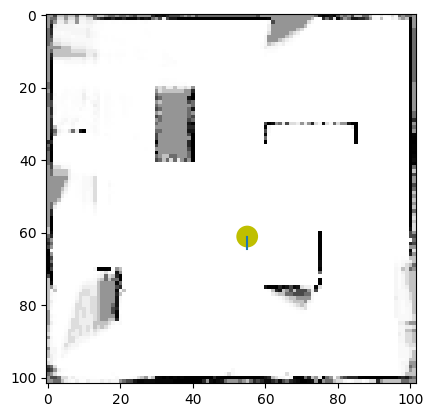

 41%|████▏     | 314/759 [02:05<02:43,  2.71it/s]

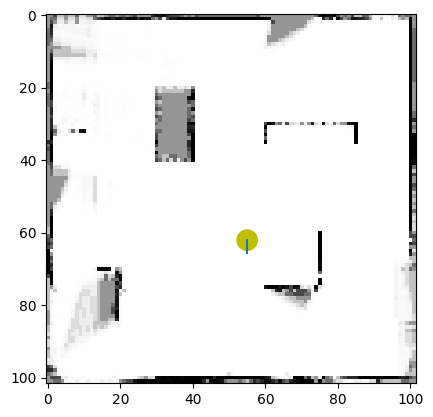

 42%|████▏     | 315/759 [02:05<02:46,  2.67it/s]

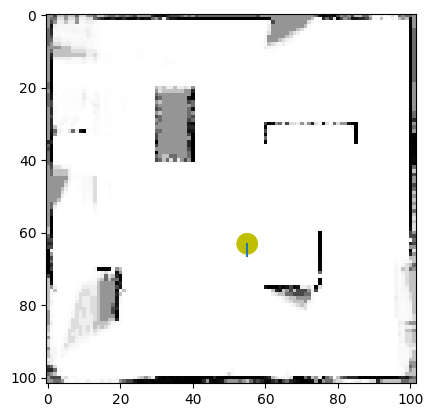

 42%|████▏     | 316/759 [02:05<02:43,  2.71it/s]

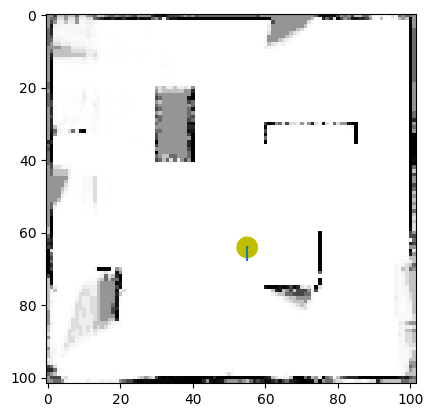

 42%|████▏     | 317/759 [02:06<02:41,  2.74it/s]

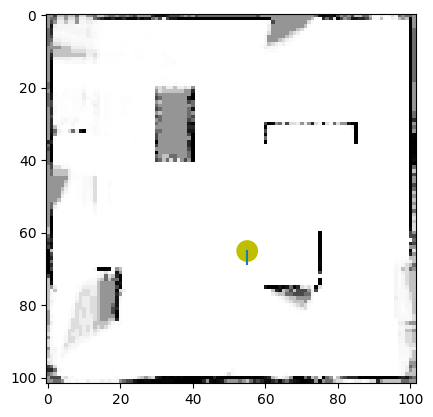

 42%|████▏     | 318/759 [02:06<02:44,  2.68it/s]

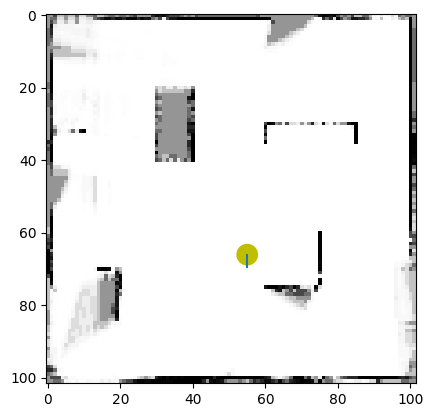

 42%|████▏     | 319/759 [02:06<02:52,  2.54it/s]

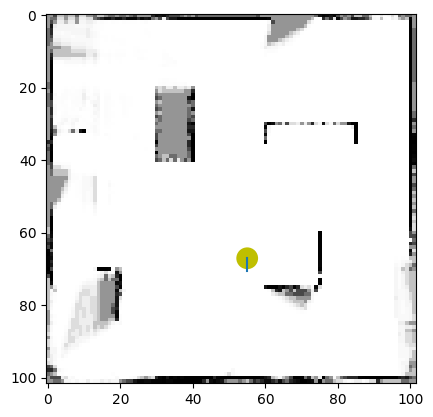

 42%|████▏     | 320/759 [02:07<02:52,  2.55it/s]

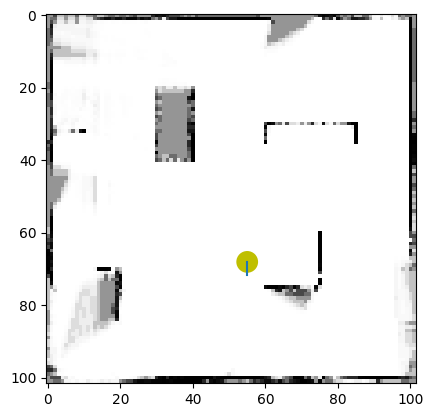

 42%|████▏     | 321/759 [02:07<03:16,  2.23it/s]

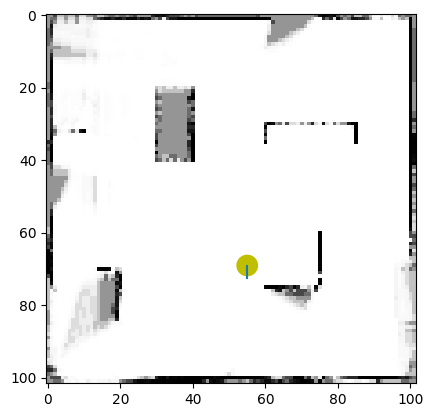

 42%|████▏     | 322/759 [02:08<03:08,  2.32it/s]

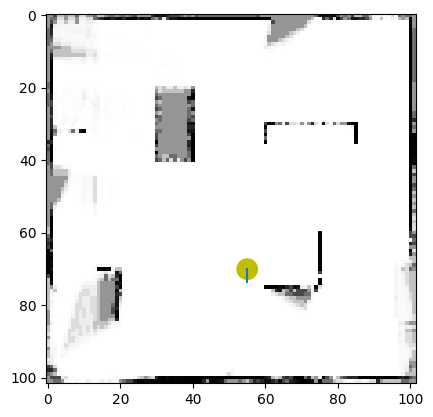

 43%|████▎     | 323/759 [02:08<03:06,  2.33it/s]

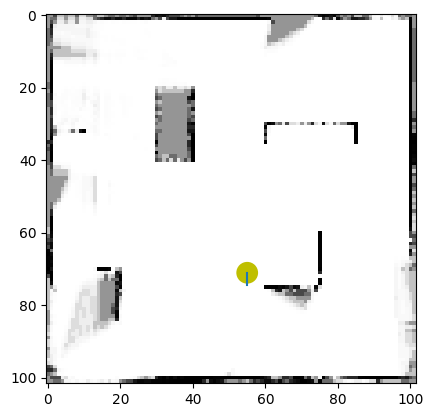

 43%|████▎     | 324/759 [02:09<03:02,  2.39it/s]

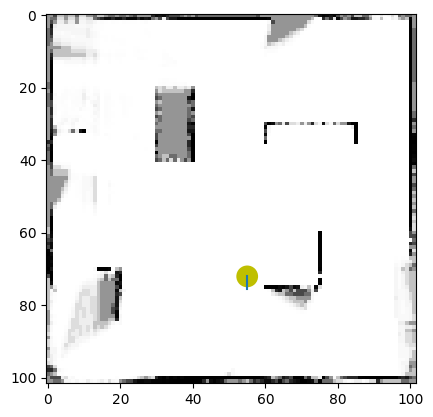

 43%|████▎     | 325/759 [02:09<03:01,  2.39it/s]

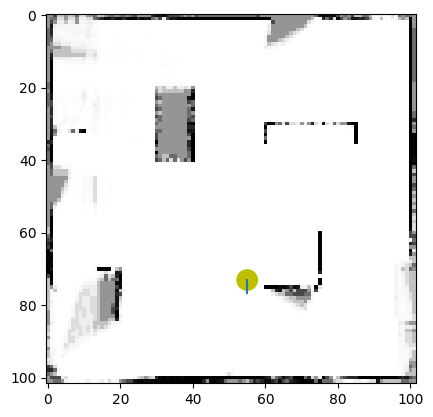

 43%|████▎     | 326/759 [02:10<03:07,  2.31it/s]

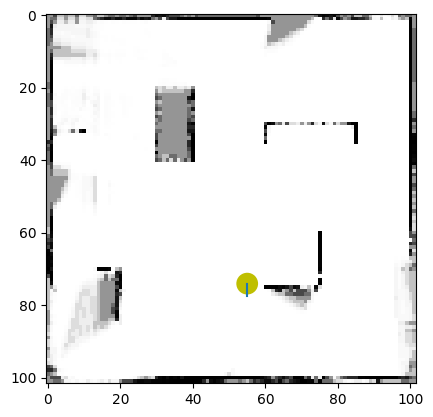

 43%|████▎     | 327/759 [02:10<03:05,  2.32it/s]

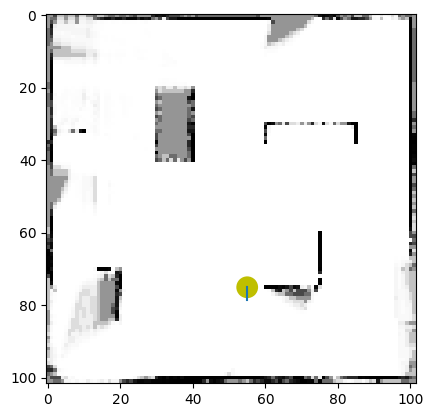

 43%|████▎     | 328/759 [02:10<03:01,  2.37it/s]

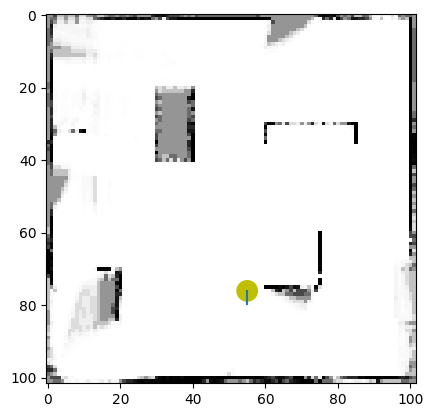

 43%|████▎     | 329/759 [02:11<03:09,  2.27it/s]

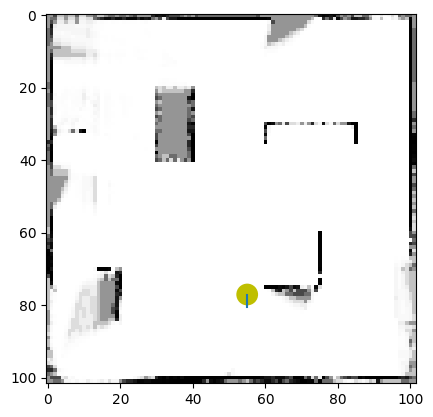

 43%|████▎     | 330/759 [02:12<03:44,  1.91it/s]

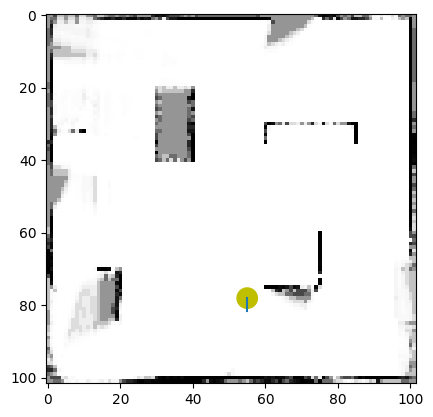

 44%|████▎     | 331/759 [02:12<04:04,  1.75it/s]

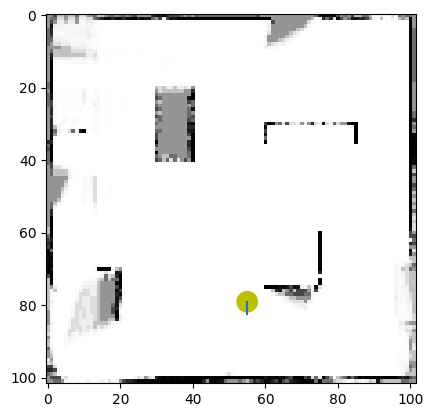

 44%|████▎     | 332/759 [02:13<04:13,  1.69it/s]

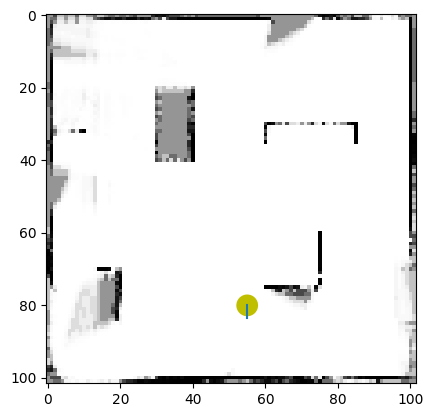

 44%|████▍     | 333/759 [02:14<04:16,  1.66it/s]

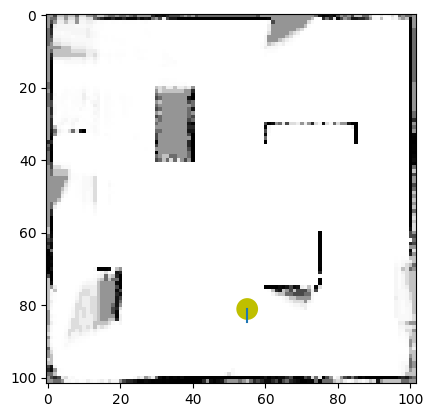

 44%|████▍     | 334/759 [02:14<04:12,  1.68it/s]

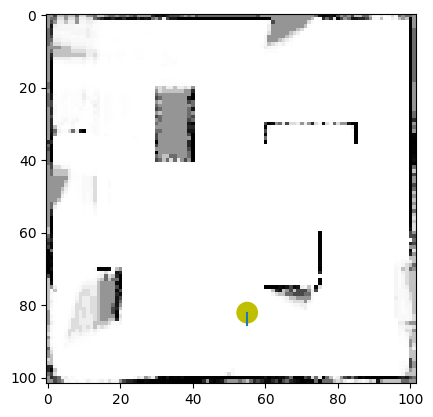

 44%|████▍     | 335/759 [02:15<04:13,  1.67it/s]

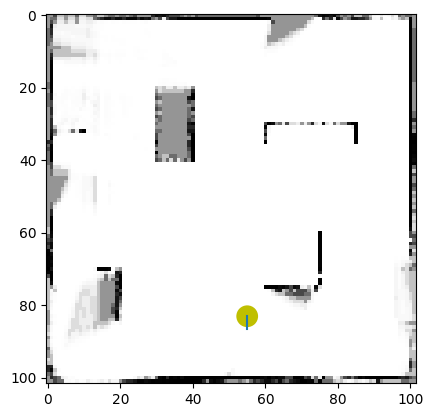

 44%|████▍     | 336/759 [02:15<04:30,  1.56it/s]

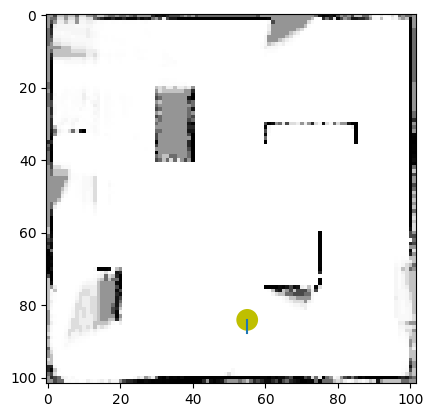

 44%|████▍     | 337/759 [02:16<05:01,  1.40it/s]

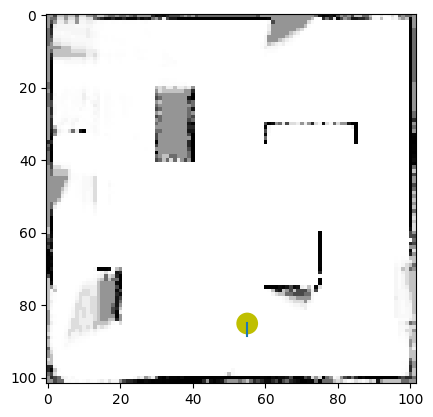

 45%|████▍     | 338/759 [02:17<05:12,  1.35it/s]

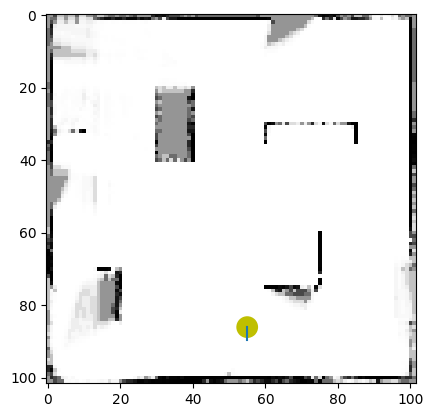

 45%|████▍     | 339/759 [02:18<05:27,  1.28it/s]

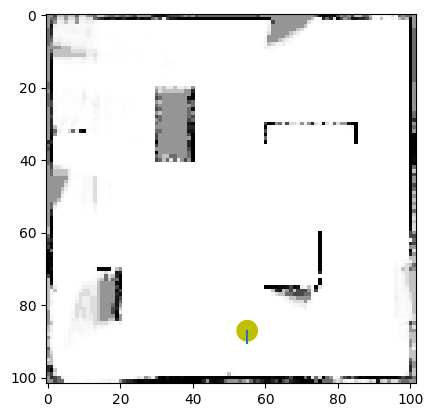

 45%|████▍     | 340/759 [02:19<05:39,  1.24it/s]

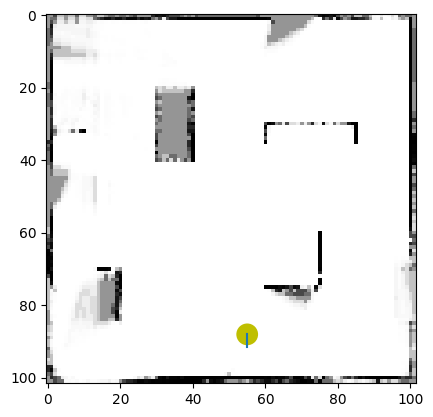

 45%|████▍     | 341/759 [02:20<05:33,  1.25it/s]

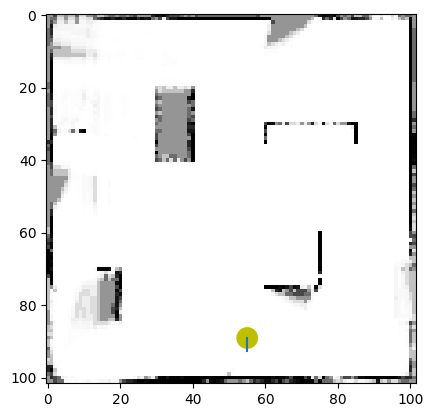

 45%|████▌     | 342/759 [02:20<05:14,  1.32it/s]

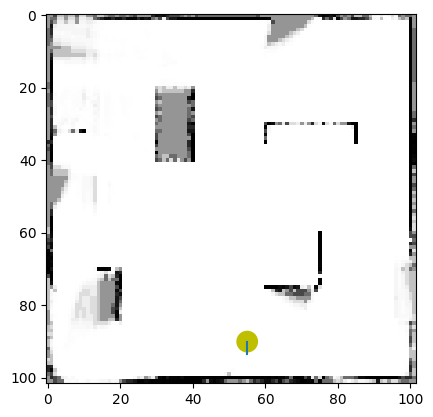

 45%|████▌     | 343/759 [02:21<05:00,  1.38it/s]

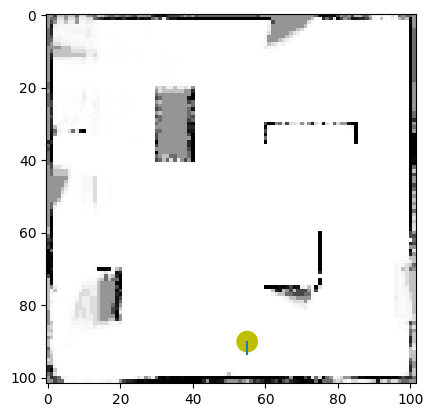

 45%|████▌     | 344/759 [02:22<04:46,  1.45it/s]

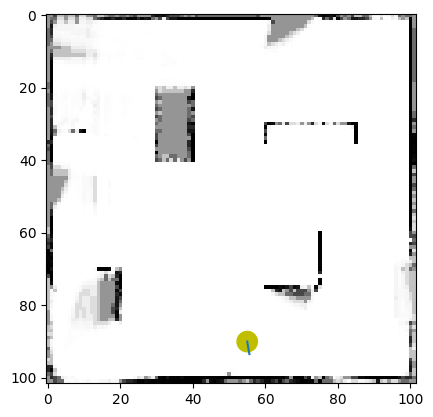

 45%|████▌     | 345/759 [02:22<04:35,  1.51it/s]

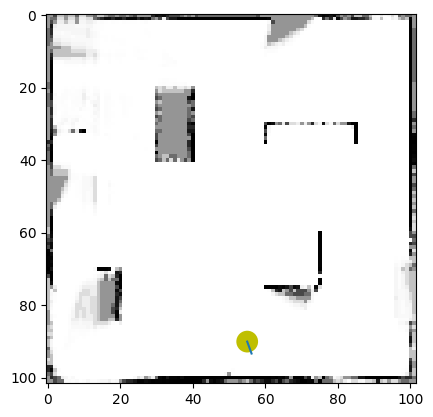

 46%|████▌     | 346/759 [02:23<04:46,  1.44it/s]

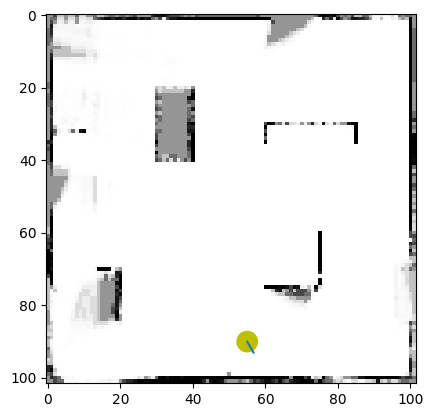

 46%|████▌     | 347/759 [02:23<04:28,  1.53it/s]

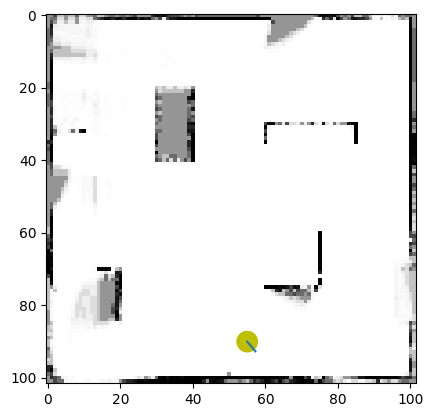

 46%|████▌     | 348/759 [02:24<04:52,  1.41it/s]

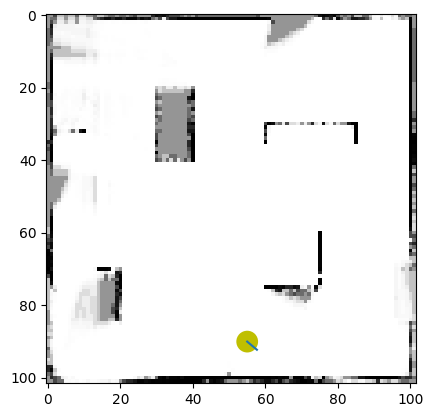

 46%|████▌     | 349/759 [02:25<04:41,  1.46it/s]

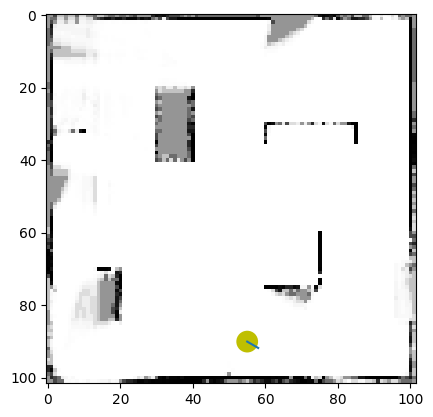

 46%|████▌     | 350/759 [02:25<04:15,  1.60it/s]

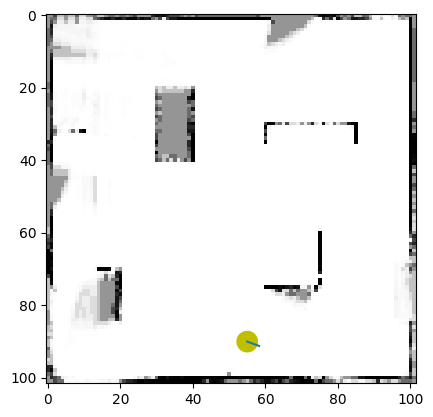

 46%|████▌     | 351/759 [02:26<03:46,  1.80it/s]

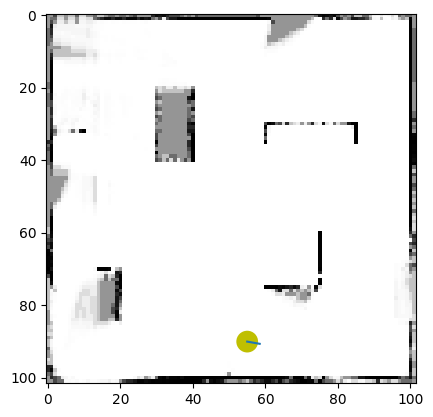

 46%|████▋     | 352/759 [02:26<03:20,  2.02it/s]

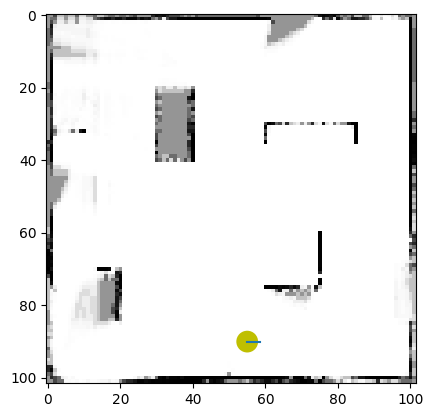

 47%|████▋     | 353/759 [02:26<02:48,  2.41it/s]

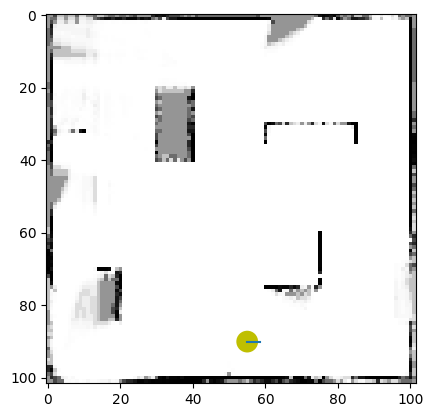

 47%|████▋     | 354/759 [02:27<02:51,  2.37it/s]

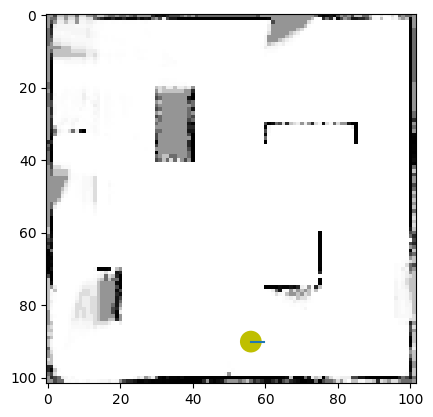

 47%|████▋     | 355/759 [02:27<02:44,  2.46it/s]

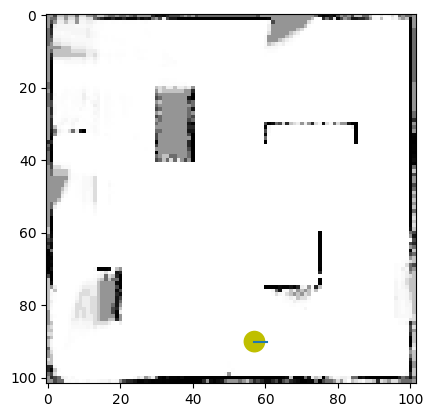

 47%|████▋     | 356/759 [02:28<02:48,  2.40it/s]

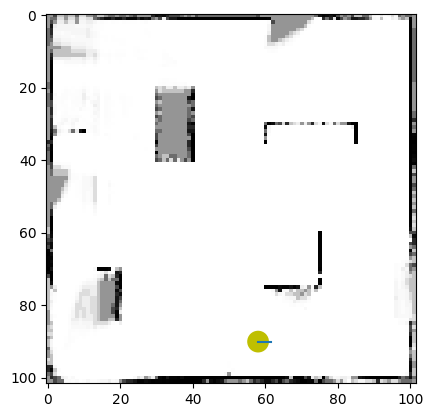

 47%|████▋     | 357/759 [02:28<02:40,  2.50it/s]

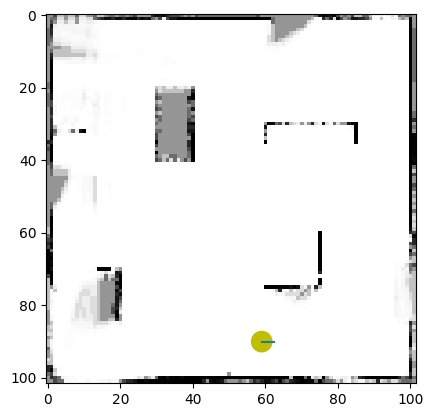

 47%|████▋     | 358/759 [02:28<02:38,  2.52it/s]

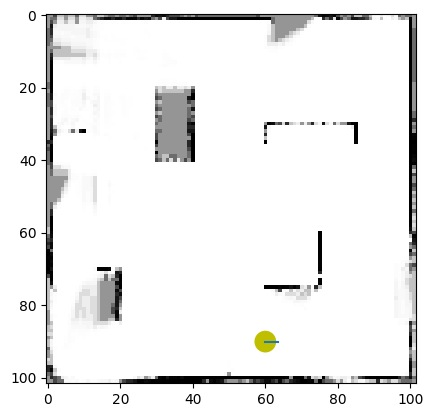

 47%|████▋     | 359/759 [02:29<02:36,  2.56it/s]

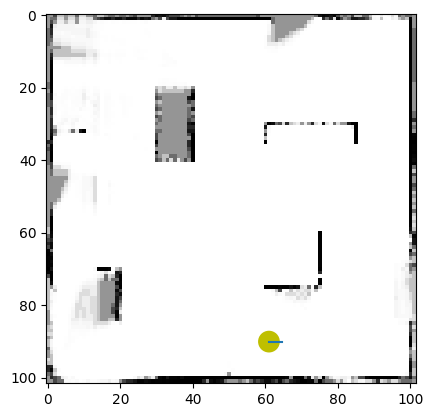

 47%|████▋     | 360/759 [02:29<02:36,  2.55it/s]

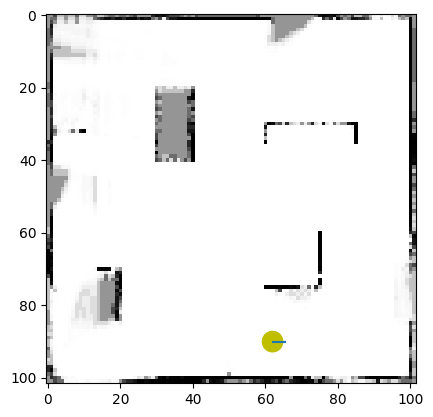

 48%|████▊     | 361/759 [02:30<02:28,  2.68it/s]

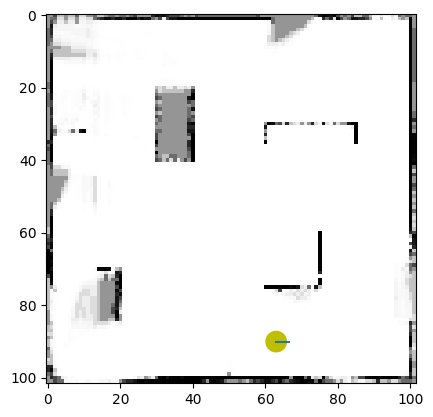

 48%|████▊     | 362/759 [02:30<02:48,  2.36it/s]

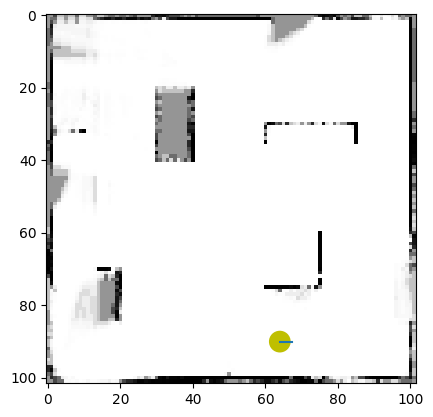

 48%|████▊     | 363/759 [02:30<02:39,  2.48it/s]

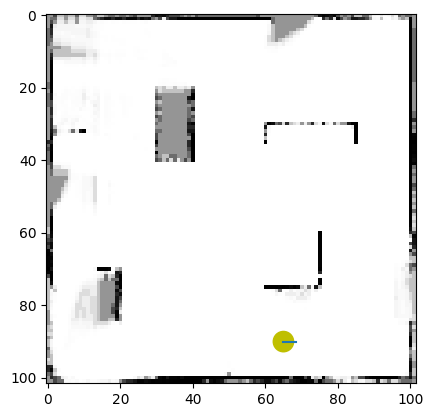

 48%|████▊     | 364/759 [02:31<02:20,  2.81it/s]

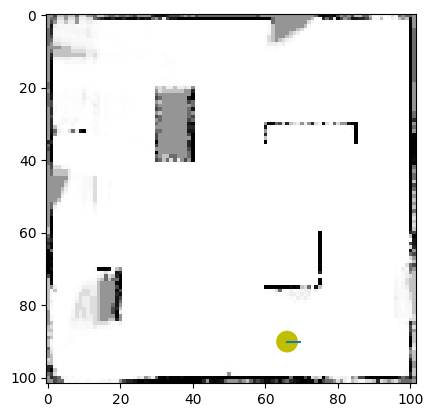

 48%|████▊     | 365/759 [02:31<02:16,  2.89it/s]

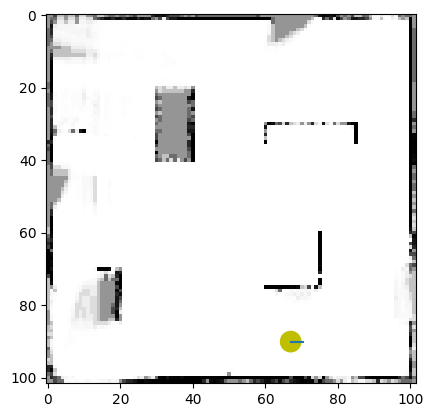

 48%|████▊     | 366/759 [02:31<02:27,  2.66it/s]

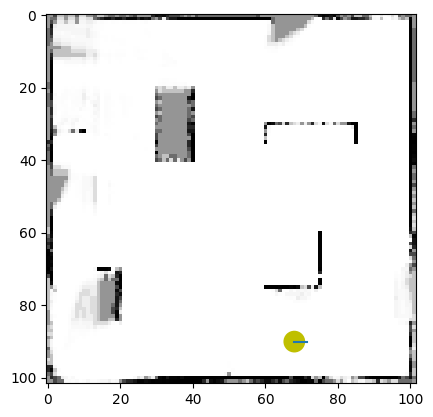

 48%|████▊     | 367/759 [02:32<02:22,  2.75it/s]

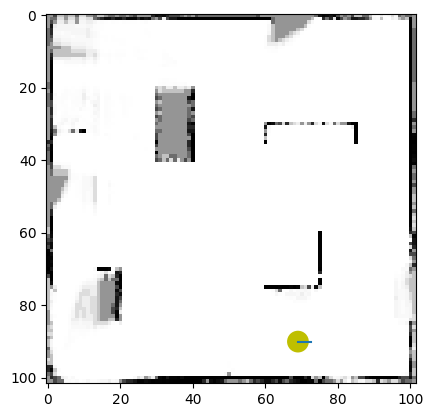

 48%|████▊     | 368/759 [02:32<02:28,  2.62it/s]

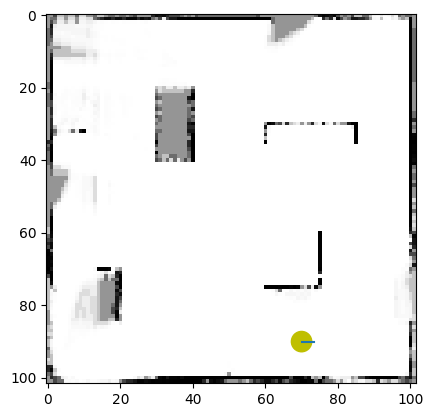

 49%|████▊     | 369/759 [02:33<02:31,  2.58it/s]

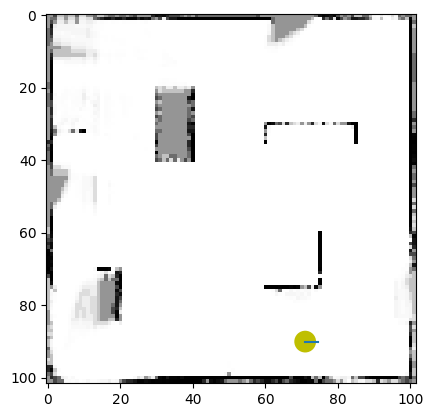

 49%|████▊     | 370/759 [02:33<02:33,  2.54it/s]

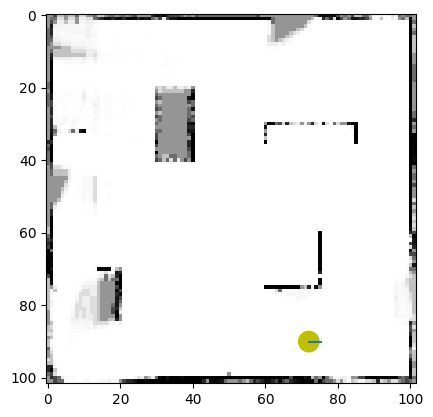

 49%|████▉     | 371/759 [02:33<02:35,  2.50it/s]

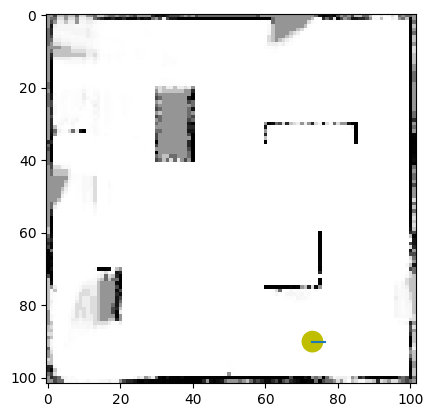

 49%|████▉     | 372/759 [02:34<02:30,  2.57it/s]

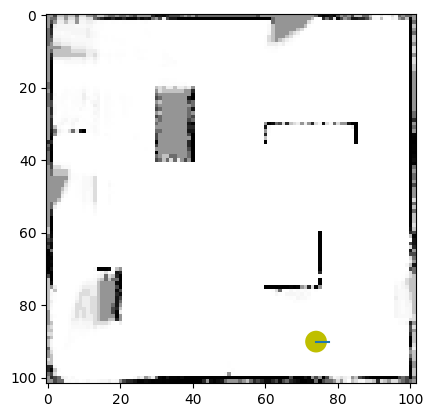

 49%|████▉     | 373/759 [02:34<02:28,  2.59it/s]

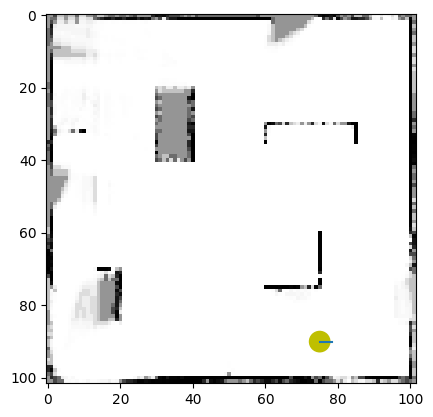

 49%|████▉     | 374/759 [02:34<02:23,  2.68it/s]

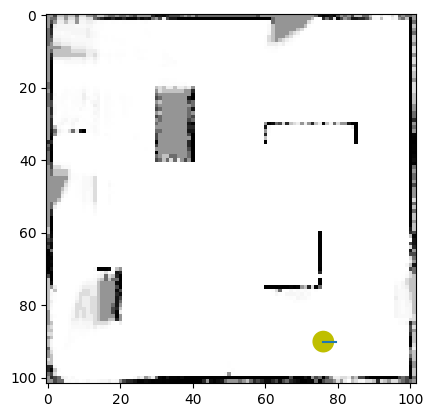

 49%|████▉     | 375/759 [02:35<02:21,  2.72it/s]

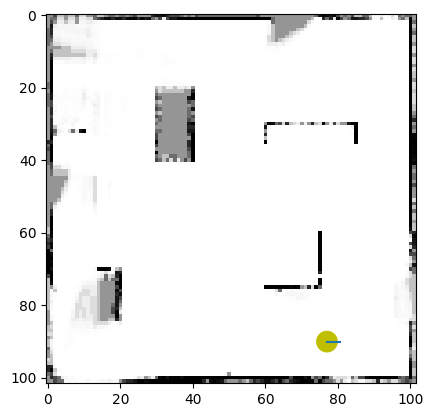

 50%|████▉     | 376/759 [02:35<02:16,  2.80it/s]

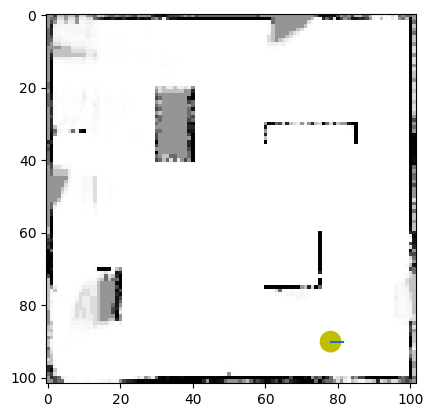

 50%|████▉     | 377/759 [02:36<02:18,  2.76it/s]

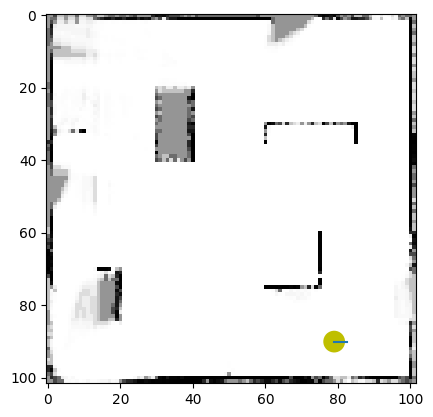

 50%|████▉     | 378/759 [02:36<02:15,  2.82it/s]

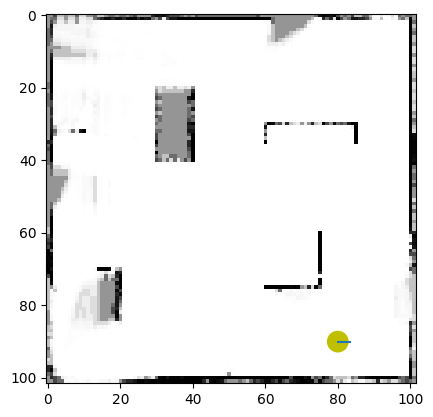

 50%|████▉     | 379/759 [02:36<02:19,  2.73it/s]

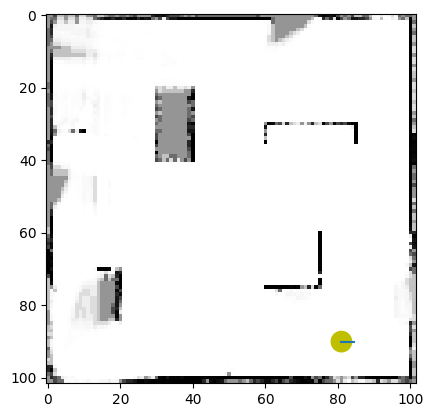

 50%|█████     | 380/759 [02:37<02:21,  2.68it/s]

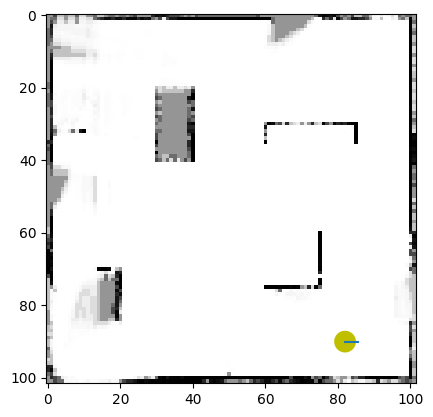

 50%|█████     | 381/759 [02:37<02:23,  2.64it/s]

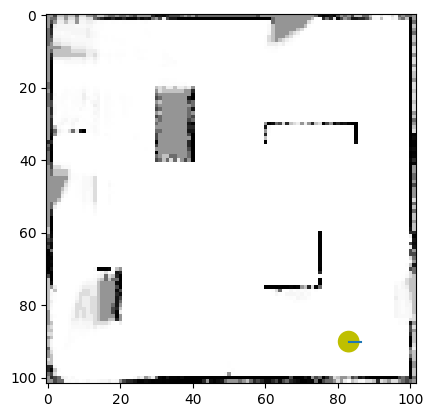

 50%|█████     | 382/759 [02:37<02:23,  2.63it/s]

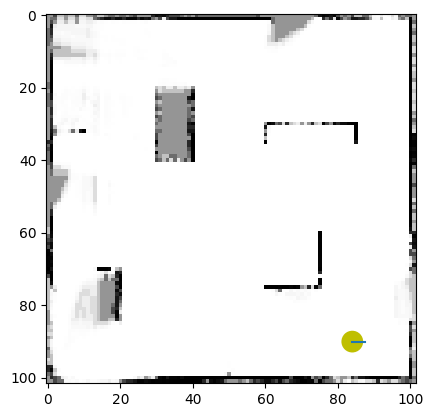

 50%|█████     | 383/759 [02:38<02:21,  2.65it/s]

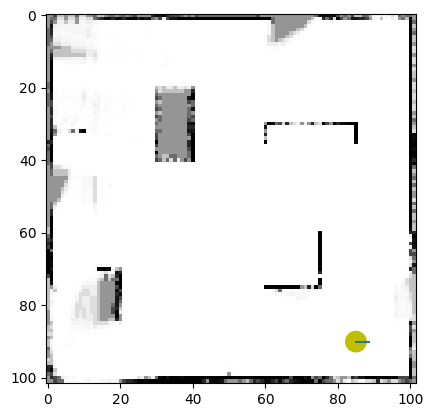

 51%|█████     | 384/759 [02:38<02:17,  2.73it/s]

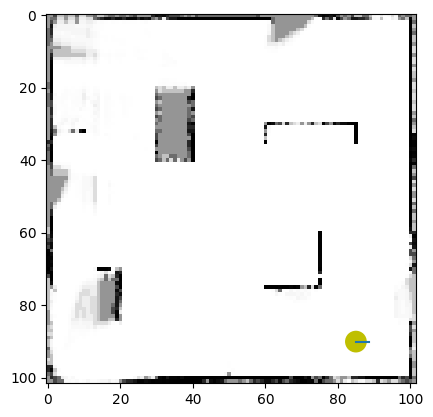

 51%|█████     | 385/759 [02:38<02:00,  3.12it/s]

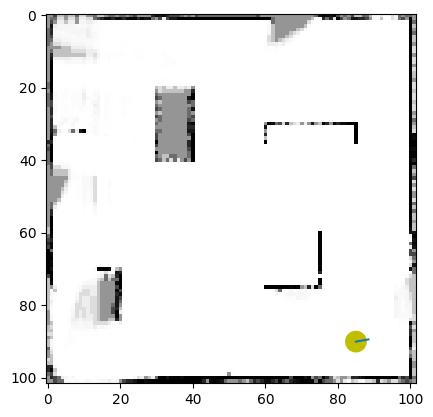

 51%|█████     | 386/759 [02:39<02:09,  2.88it/s]

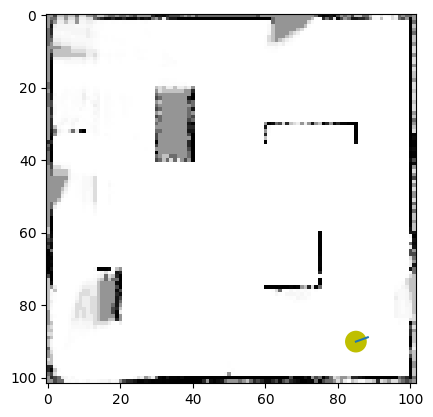

 51%|█████     | 387/759 [02:39<02:11,  2.83it/s]

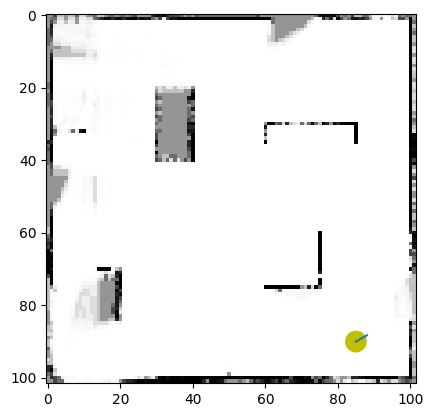

 51%|█████     | 388/759 [02:40<02:11,  2.81it/s]

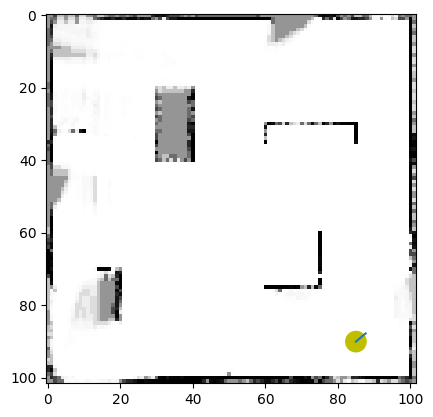

 51%|█████▏    | 389/759 [02:40<02:17,  2.69it/s]

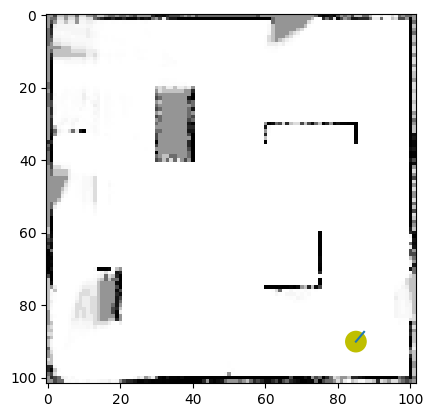

 51%|█████▏    | 390/759 [02:40<02:13,  2.76it/s]

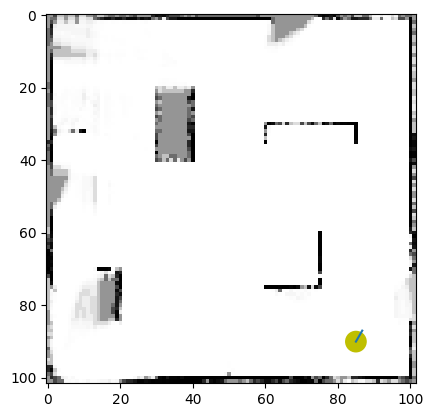

 52%|█████▏    | 391/759 [02:41<02:16,  2.69it/s]

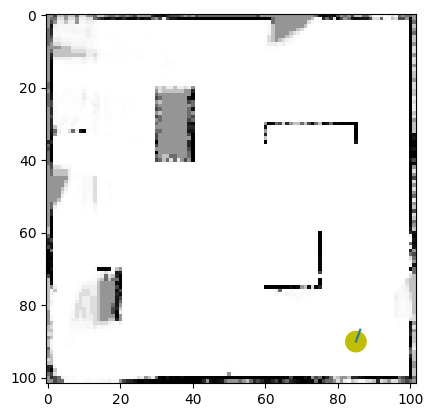

 52%|█████▏    | 392/759 [02:41<02:10,  2.82it/s]

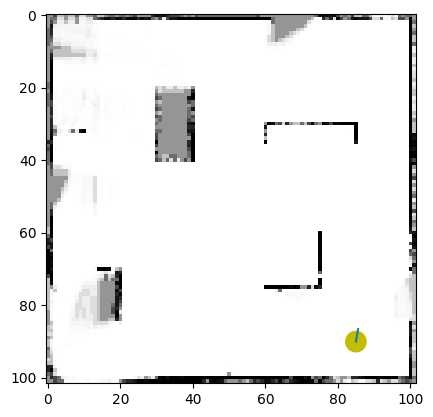

 52%|█████▏    | 393/759 [02:41<01:58,  3.09it/s]

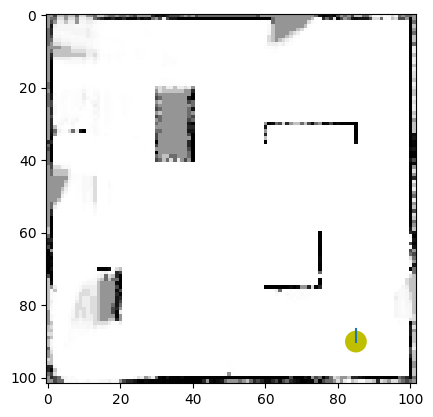

 52%|█████▏    | 394/759 [02:42<01:59,  3.04it/s]

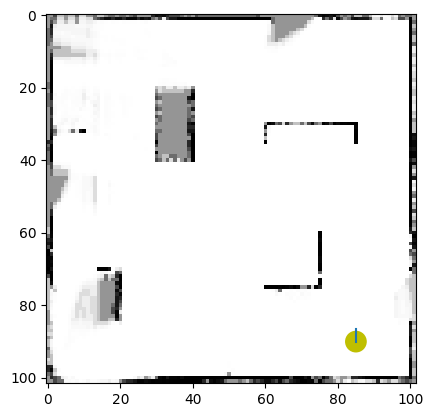

 52%|█████▏    | 395/759 [02:42<02:04,  2.93it/s]

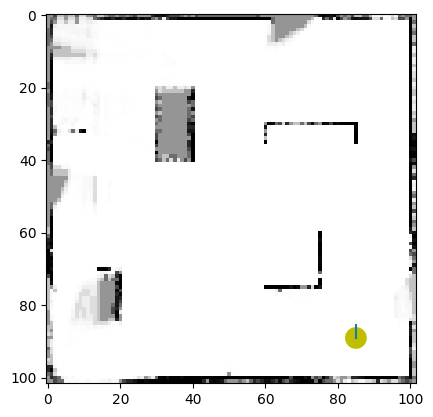

 52%|█████▏    | 396/759 [02:42<02:14,  2.69it/s]

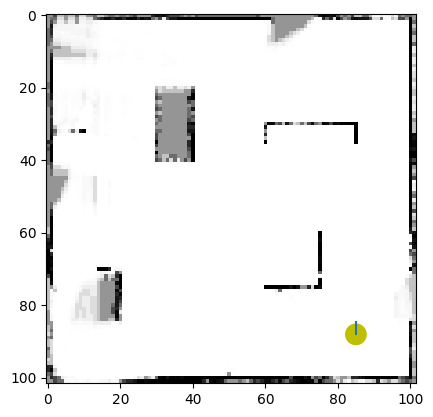

 52%|█████▏    | 397/759 [02:43<02:32,  2.37it/s]

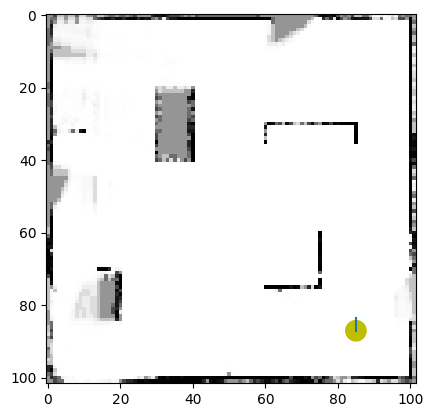

 52%|█████▏    | 398/759 [02:43<02:35,  2.33it/s]

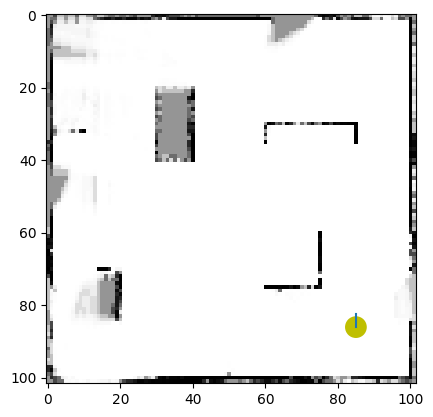

 53%|█████▎    | 399/759 [02:44<02:24,  2.49it/s]

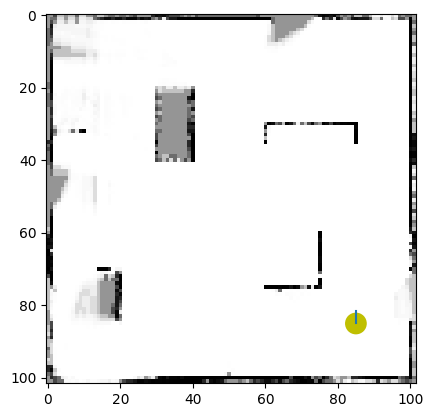

 53%|█████▎    | 400/759 [02:44<02:10,  2.75it/s]

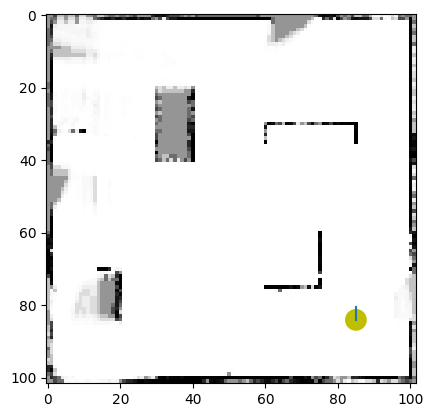

 53%|█████▎    | 401/759 [02:44<01:55,  3.11it/s]

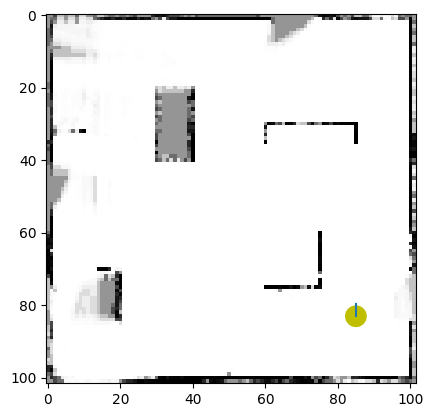

 53%|█████▎    | 402/759 [02:44<01:47,  3.32it/s]

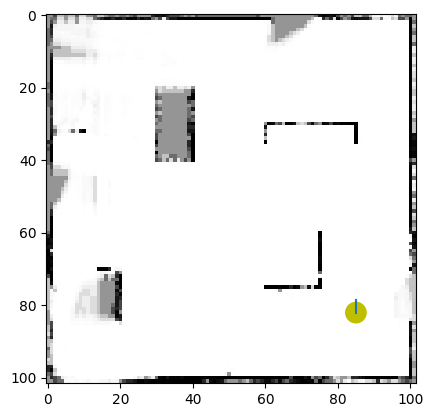

 53%|█████▎    | 403/759 [02:45<01:59,  2.98it/s]

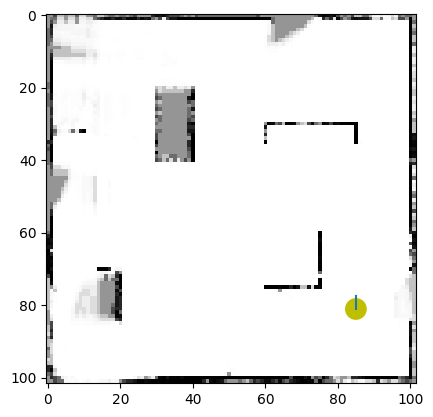

 53%|█████▎    | 404/759 [02:45<01:50,  3.20it/s]

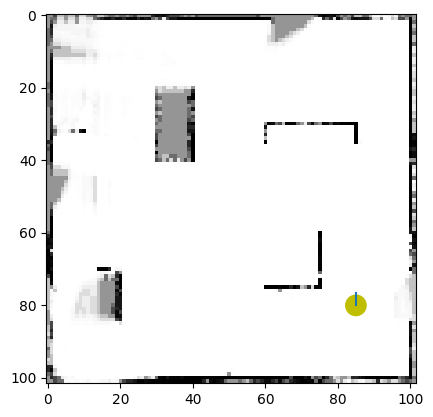

 53%|█████▎    | 405/759 [02:46<01:57,  3.02it/s]

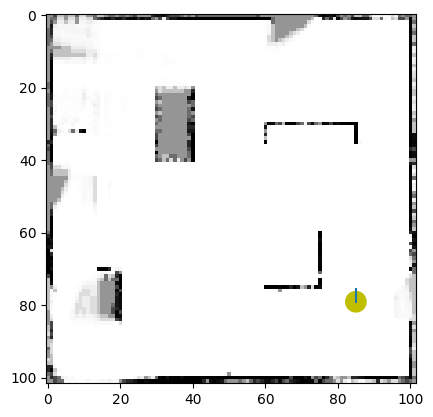

 53%|█████▎    | 406/759 [02:46<02:02,  2.88it/s]

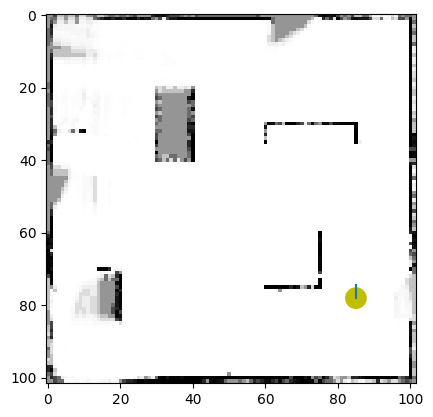

 54%|█████▎    | 407/759 [02:46<02:05,  2.80it/s]

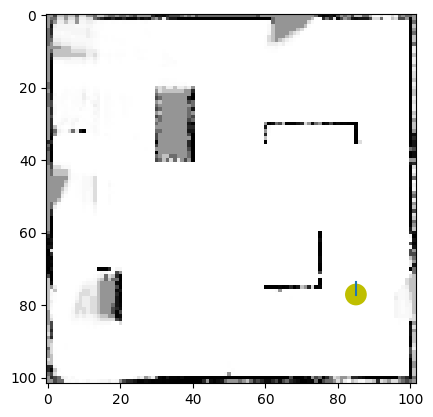

 54%|█████▍    | 408/759 [02:47<02:03,  2.85it/s]

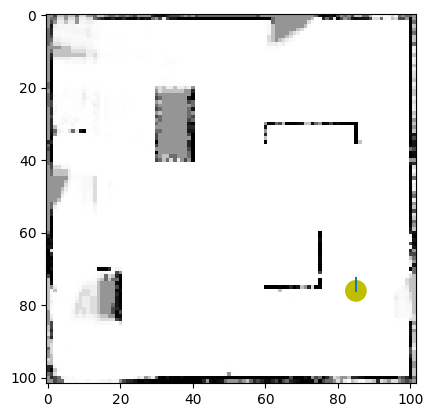

 54%|█████▍    | 409/759 [02:47<02:15,  2.59it/s]

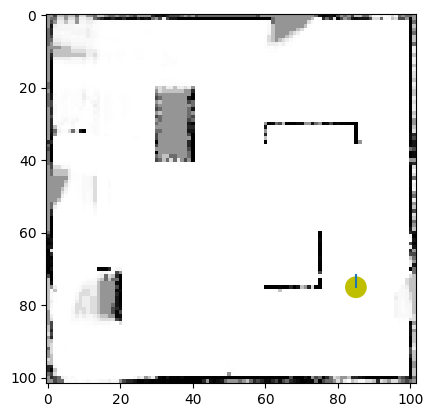

 54%|█████▍    | 410/759 [02:48<02:25,  2.40it/s]

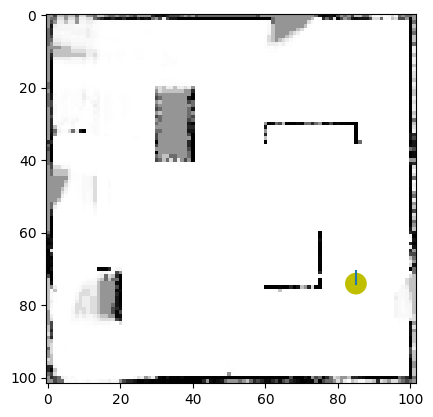

 54%|█████▍    | 411/759 [02:48<02:17,  2.53it/s]

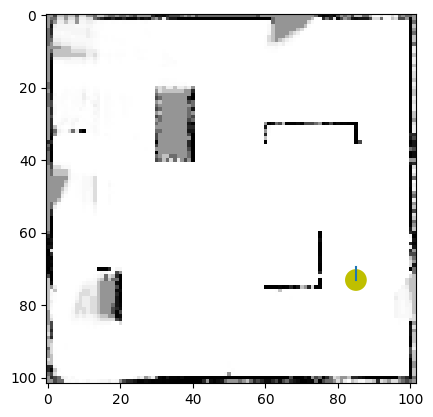

 54%|█████▍    | 412/759 [02:48<02:17,  2.52it/s]

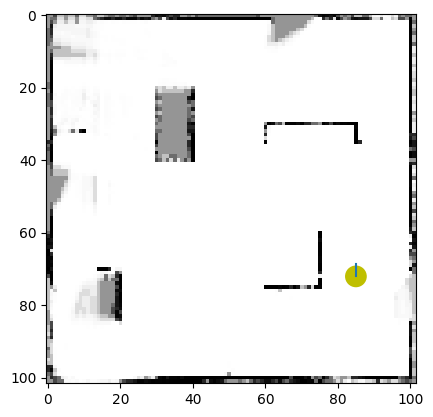

 54%|█████▍    | 413/759 [02:49<02:12,  2.62it/s]

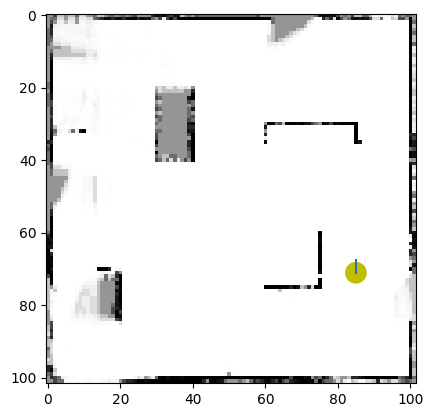

 55%|█████▍    | 414/759 [02:49<02:10,  2.64it/s]

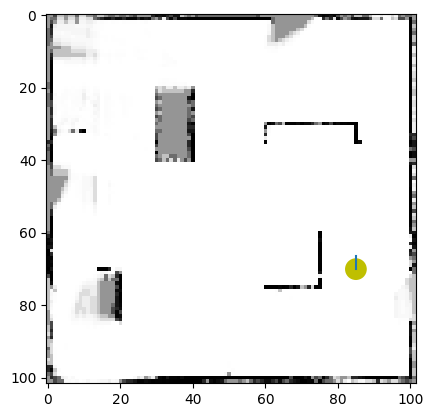

 55%|█████▍    | 415/759 [02:49<01:53,  3.03it/s]

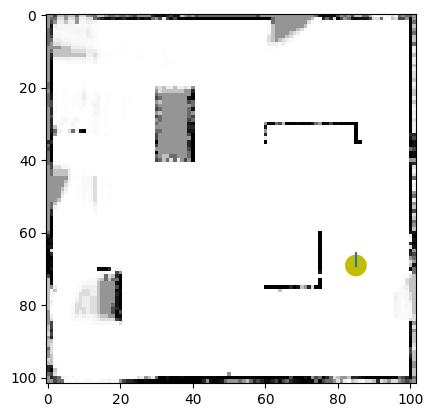

 55%|█████▍    | 416/759 [02:50<02:00,  2.84it/s]

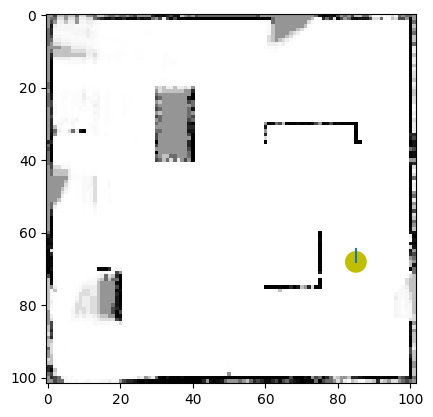

 55%|█████▍    | 417/759 [02:50<01:46,  3.21it/s]

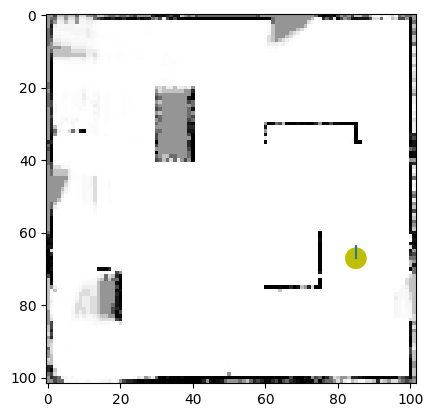

 55%|█████▌    | 418/759 [02:50<01:50,  3.08it/s]

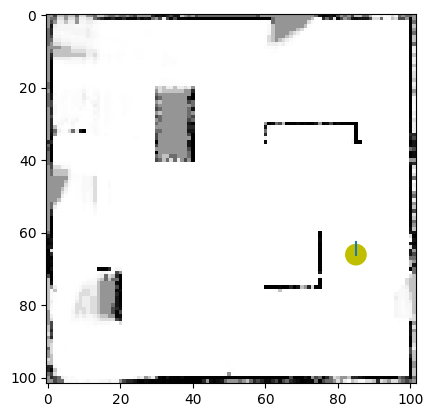

 55%|█████▌    | 419/759 [02:51<01:54,  2.97it/s]

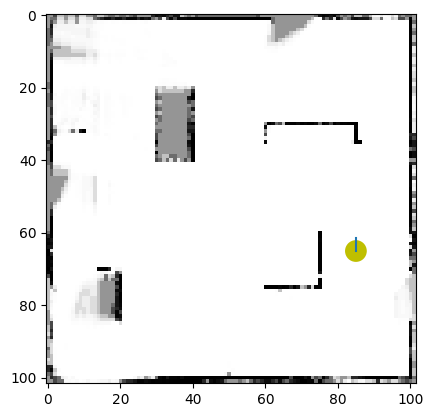

 55%|█████▌    | 420/759 [02:51<01:56,  2.90it/s]

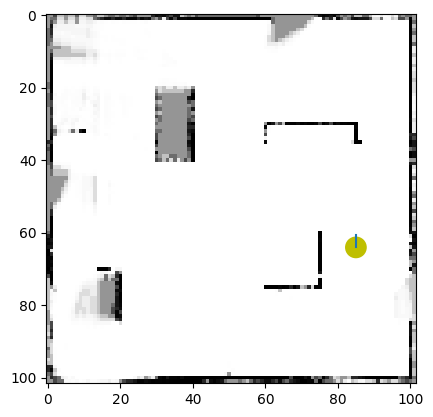

 55%|█████▌    | 421/759 [02:51<02:06,  2.66it/s]

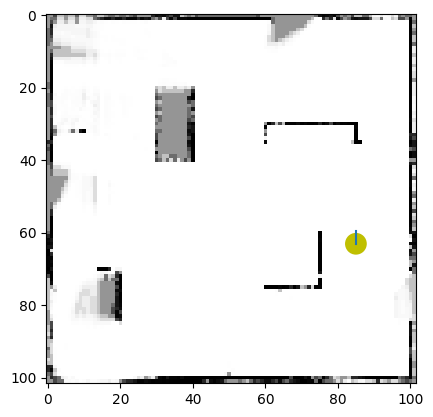

 56%|█████▌    | 422/759 [02:52<01:50,  3.05it/s]

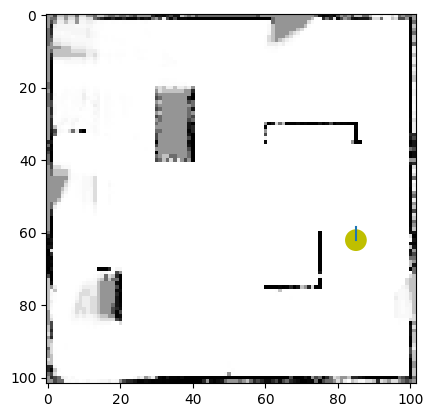

 56%|█████▌    | 423/759 [02:52<01:52,  3.00it/s]

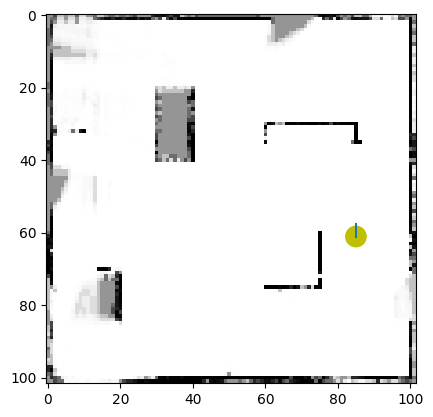

 56%|█████▌    | 424/759 [02:52<02:00,  2.78it/s]

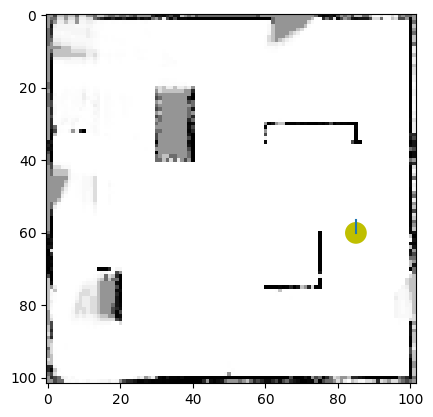

 56%|█████▌    | 425/759 [02:53<01:59,  2.80it/s]

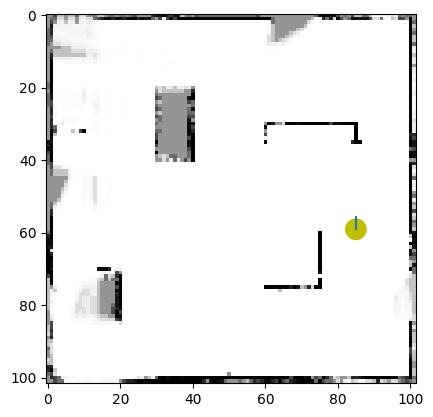

 56%|█████▌    | 426/759 [02:53<02:09,  2.58it/s]

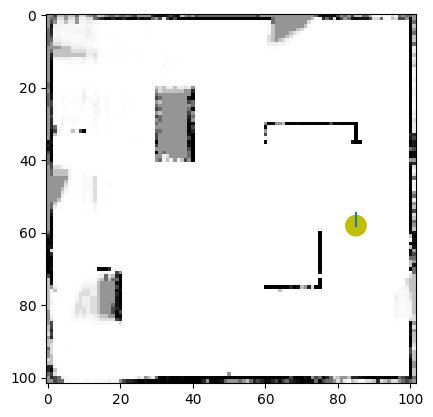

 56%|█████▋    | 427/759 [02:54<02:05,  2.65it/s]

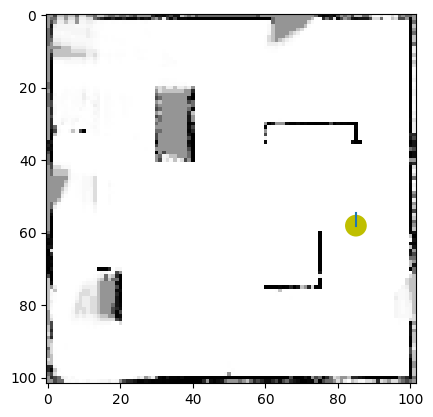

 56%|█████▋    | 428/759 [02:54<02:10,  2.54it/s]

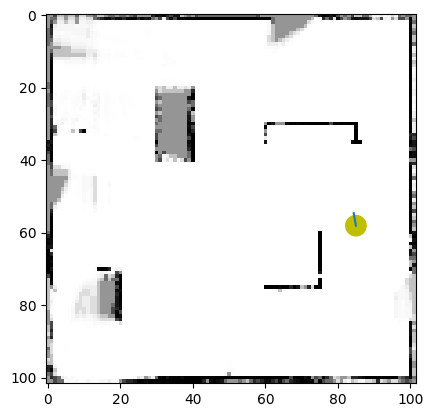

 57%|█████▋    | 429/759 [02:54<02:07,  2.59it/s]

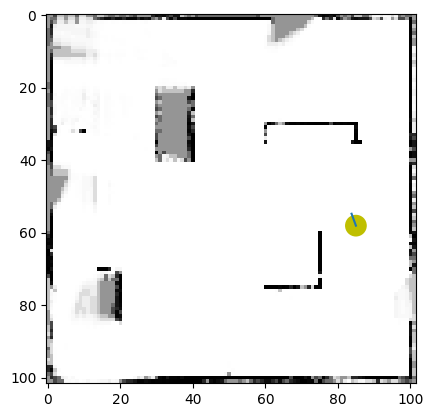

 57%|█████▋    | 430/759 [02:55<02:16,  2.42it/s]

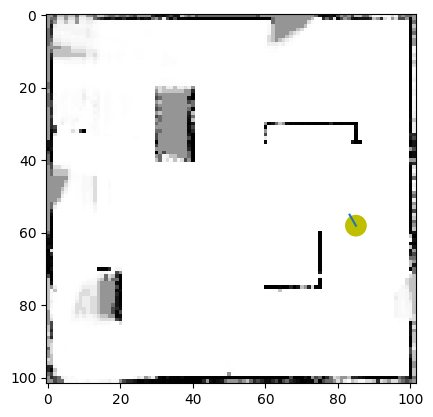

 57%|█████▋    | 431/759 [02:55<02:12,  2.48it/s]

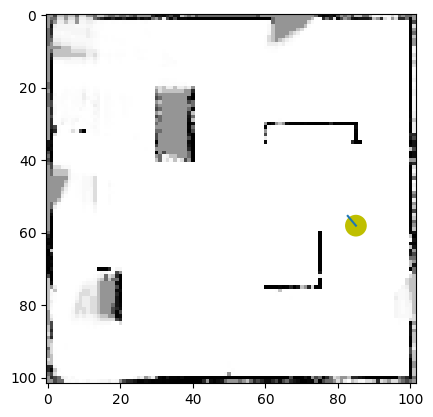

 57%|█████▋    | 432/759 [02:56<02:09,  2.53it/s]

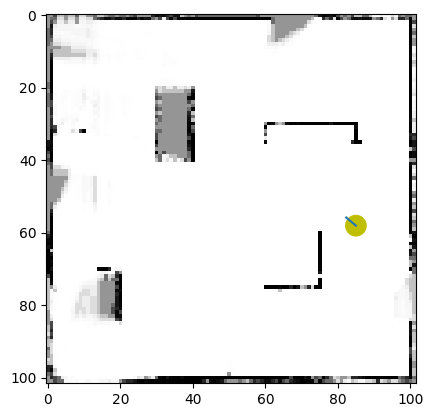

 57%|█████▋    | 433/759 [02:56<02:03,  2.64it/s]

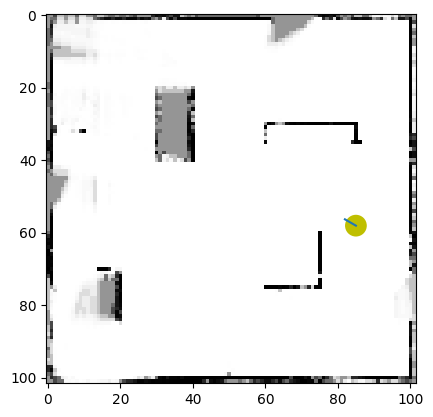

 57%|█████▋    | 434/759 [02:56<02:02,  2.65it/s]

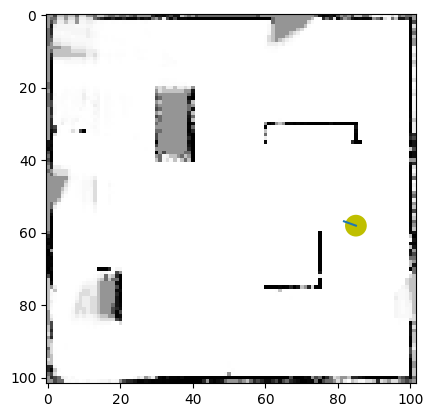

 57%|█████▋    | 435/759 [02:57<01:59,  2.71it/s]

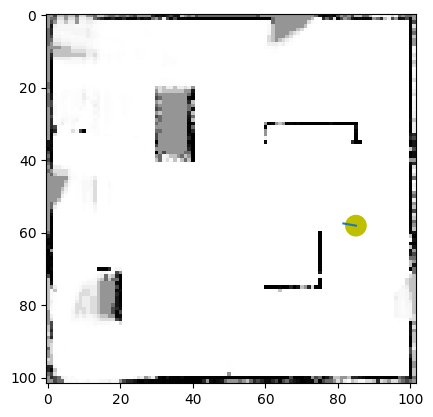

 57%|█████▋    | 436/759 [02:57<01:59,  2.71it/s]

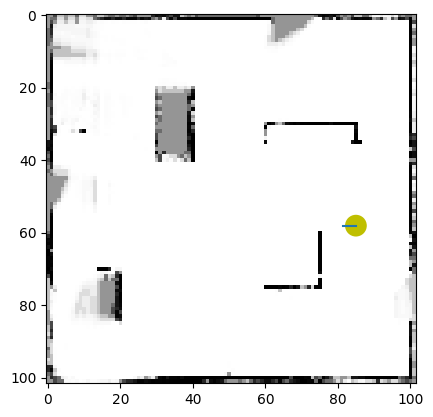

 58%|█████▊    | 437/759 [02:57<01:57,  2.74it/s]

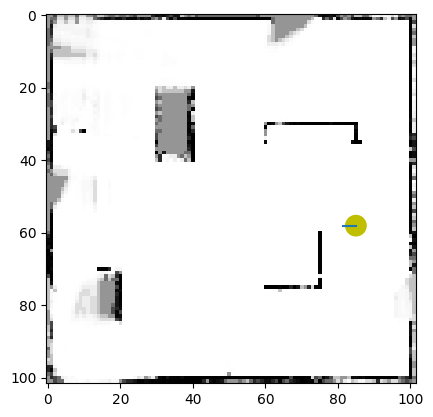

 58%|█████▊    | 438/759 [02:58<01:51,  2.88it/s]

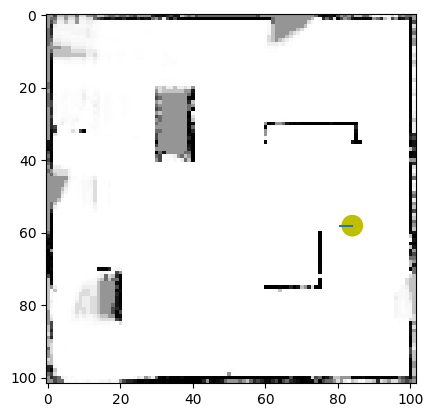

 58%|█████▊    | 439/759 [02:58<01:54,  2.78it/s]

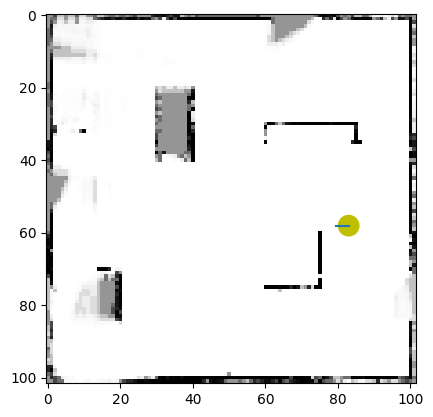

 58%|█████▊    | 440/759 [02:58<01:48,  2.93it/s]

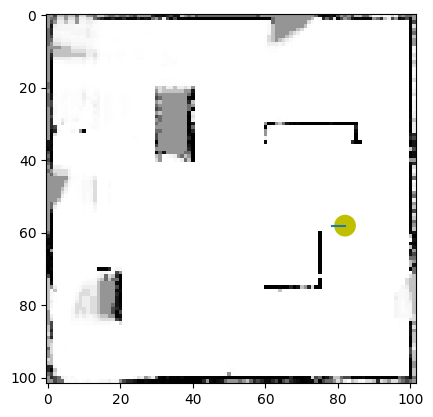

 58%|█████▊    | 441/759 [02:59<01:48,  2.92it/s]

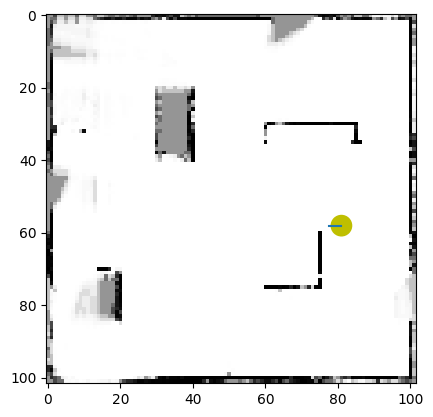

 58%|█████▊    | 442/759 [02:59<01:53,  2.80it/s]

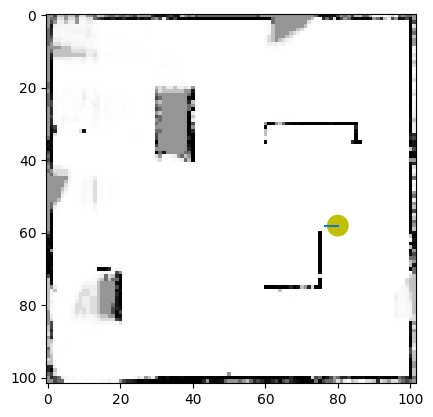

 58%|█████▊    | 443/759 [02:59<01:57,  2.70it/s]

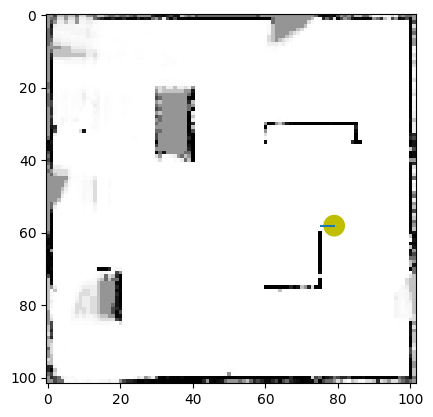

 58%|█████▊    | 444/759 [03:00<01:43,  3.04it/s]

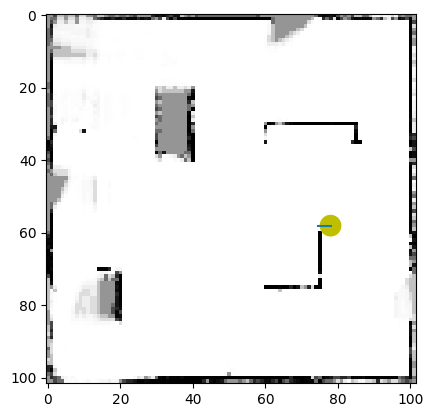

 59%|█████▊    | 445/759 [03:00<01:47,  2.92it/s]

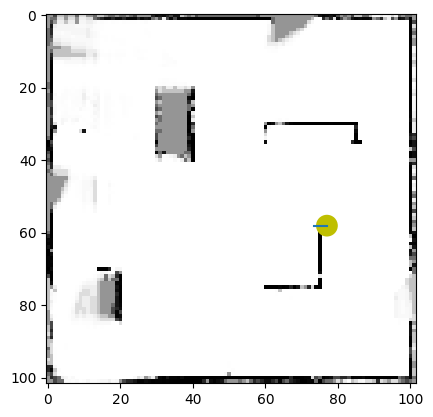

 59%|█████▉    | 446/759 [03:00<01:39,  3.15it/s]

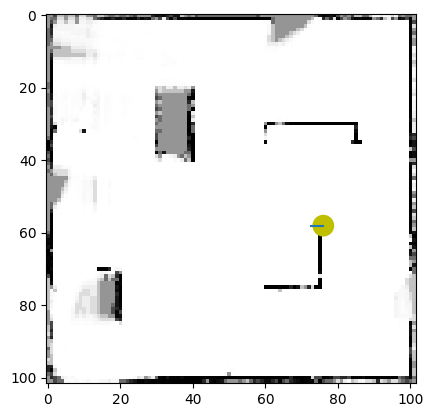

 59%|█████▉    | 447/759 [03:01<01:42,  3.03it/s]

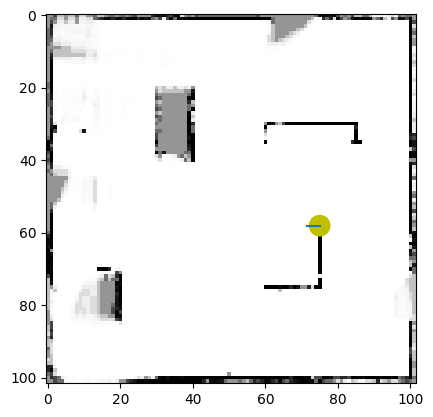

 59%|█████▉    | 448/759 [03:01<01:49,  2.84it/s]

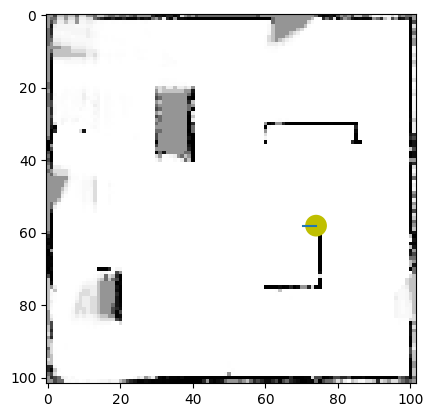

 59%|█████▉    | 449/759 [03:01<01:38,  3.16it/s]

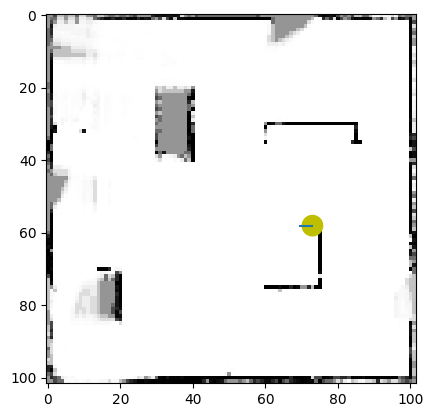

 59%|█████▉    | 450/759 [03:02<01:43,  2.98it/s]

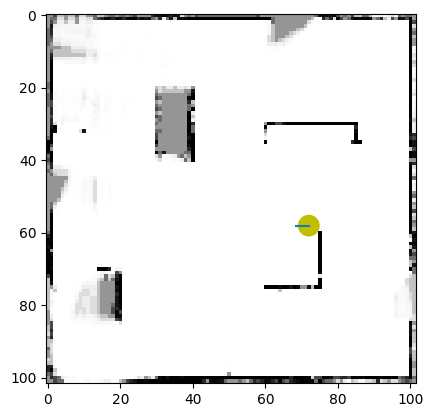

 59%|█████▉    | 451/759 [03:02<01:48,  2.85it/s]

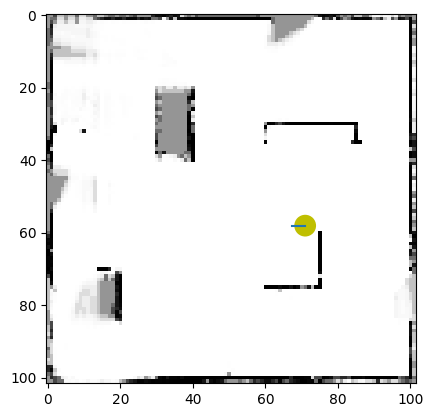

 60%|█████▉    | 452/759 [03:02<01:45,  2.91it/s]

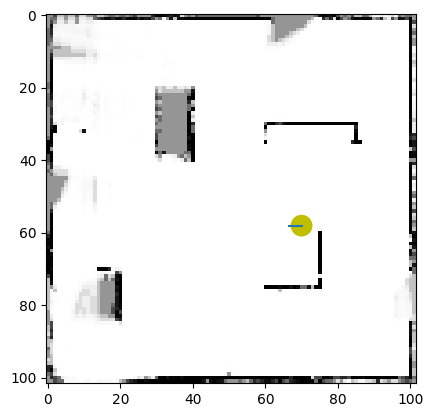

 60%|█████▉    | 453/759 [03:03<01:35,  3.19it/s]

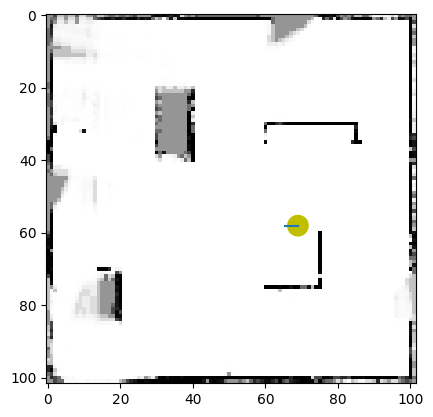

 60%|█████▉    | 454/759 [03:03<01:37,  3.14it/s]

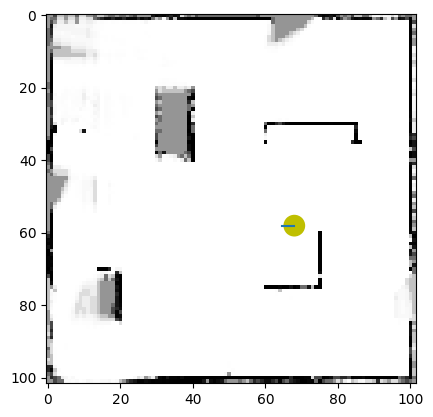

 60%|█████▉    | 455/759 [03:03<01:41,  3.01it/s]

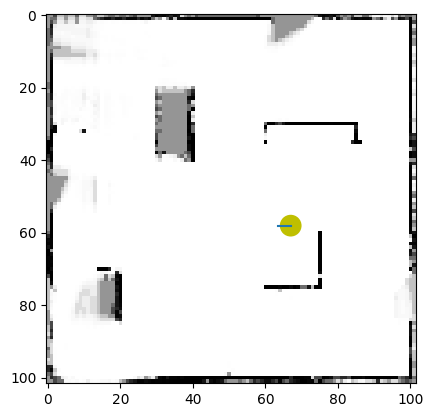

 60%|██████    | 456/759 [03:04<01:42,  2.94it/s]

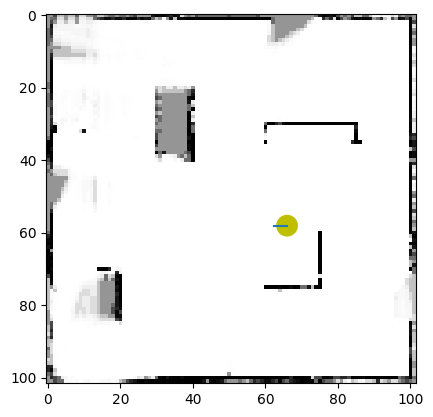

 60%|██████    | 457/759 [03:04<01:53,  2.65it/s]

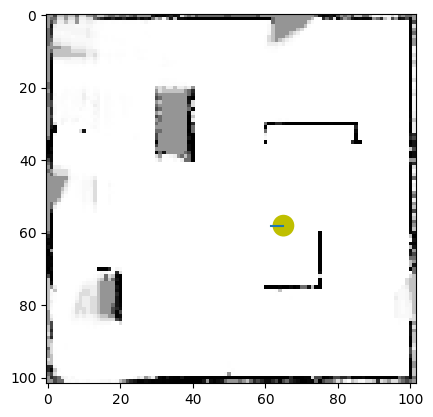

 60%|██████    | 458/759 [03:05<01:50,  2.72it/s]

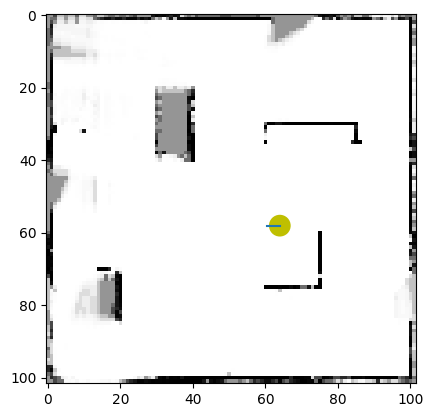

 60%|██████    | 459/759 [03:05<01:48,  2.75it/s]

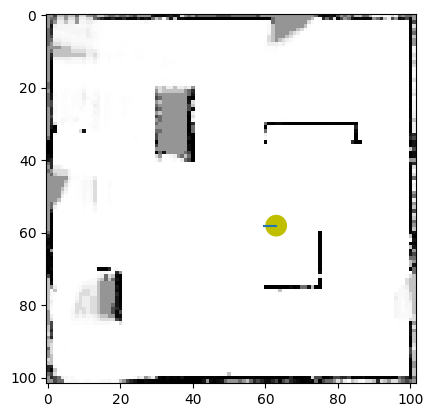

 61%|██████    | 460/759 [03:05<01:51,  2.68it/s]

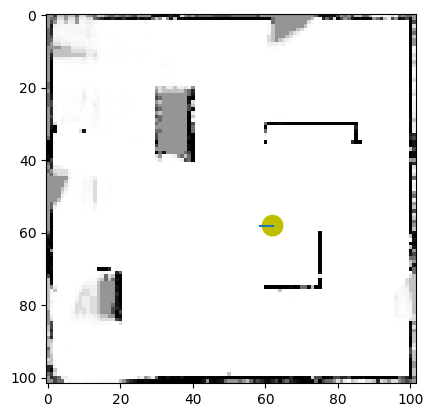

 61%|██████    | 461/759 [03:06<01:49,  2.72it/s]

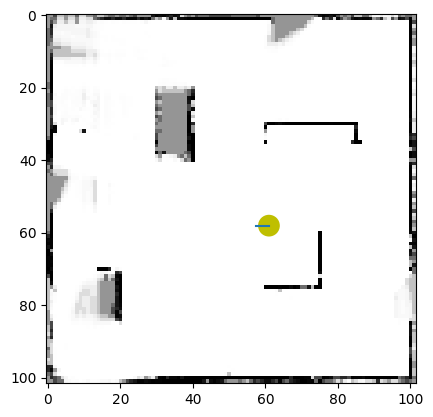

 61%|██████    | 462/759 [03:06<01:46,  2.80it/s]

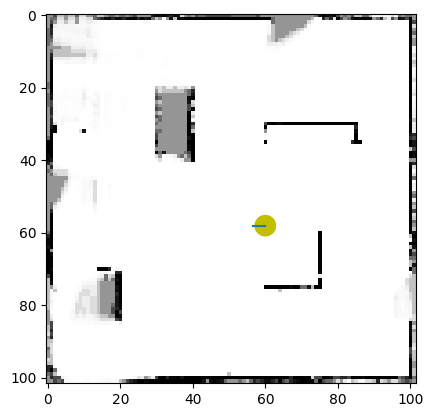

 61%|██████    | 463/759 [03:06<01:49,  2.71it/s]

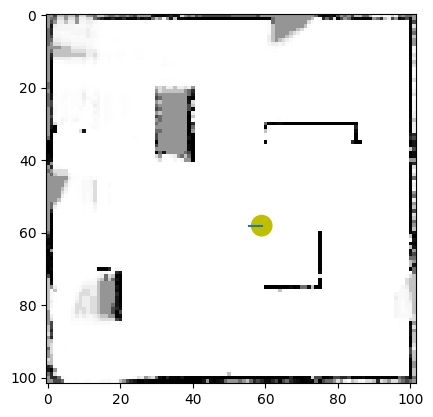

 61%|██████    | 464/759 [03:07<01:48,  2.72it/s]

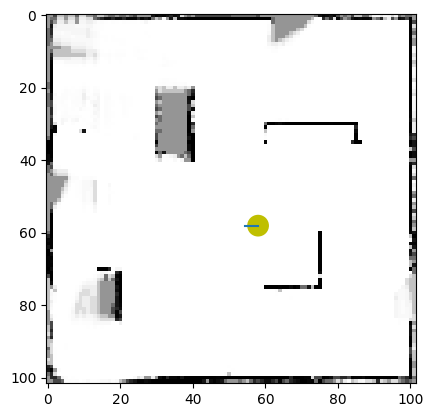

 61%|██████▏   | 465/759 [03:07<01:45,  2.79it/s]

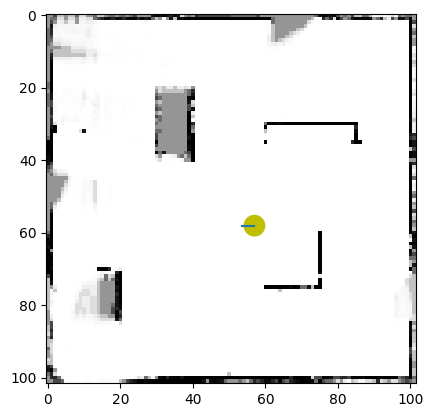

 61%|██████▏   | 466/759 [03:07<01:46,  2.74it/s]

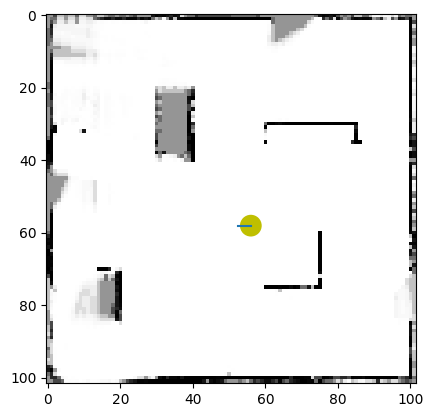

 62%|██████▏   | 467/759 [03:08<01:50,  2.65it/s]

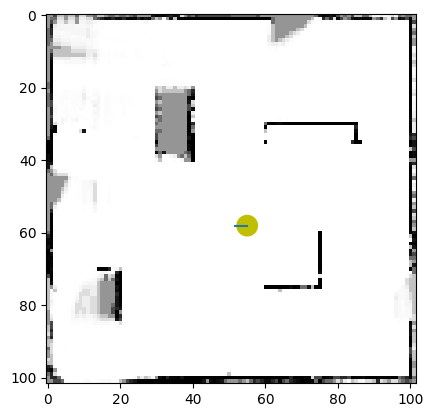

 62%|██████▏   | 468/759 [03:08<01:47,  2.71it/s]

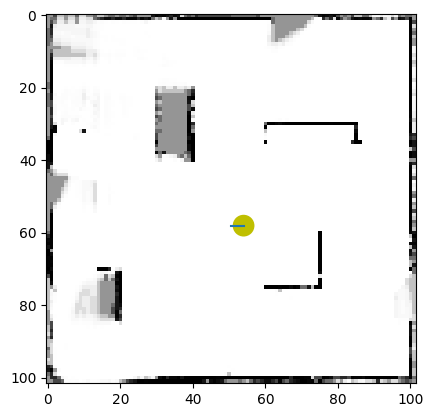

 62%|██████▏   | 469/759 [03:09<01:48,  2.68it/s]

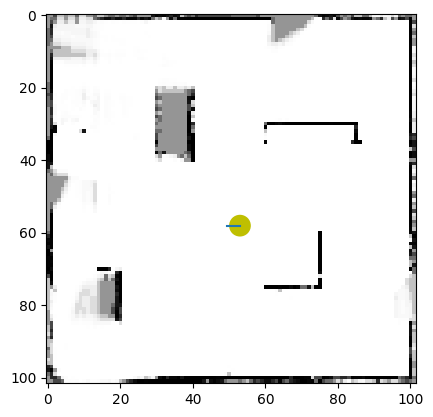

 62%|██████▏   | 470/759 [03:09<01:46,  2.72it/s]

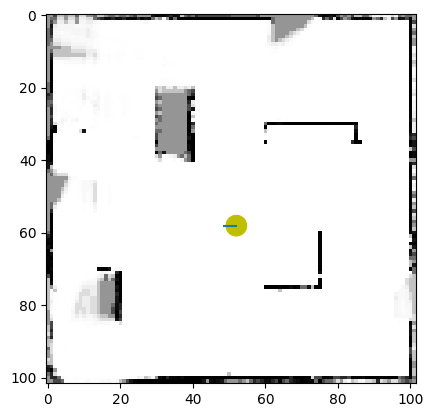

 62%|██████▏   | 471/759 [03:09<01:47,  2.69it/s]

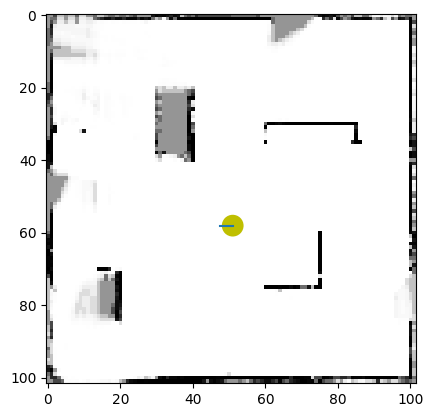

 62%|██████▏   | 472/759 [03:10<01:44,  2.74it/s]

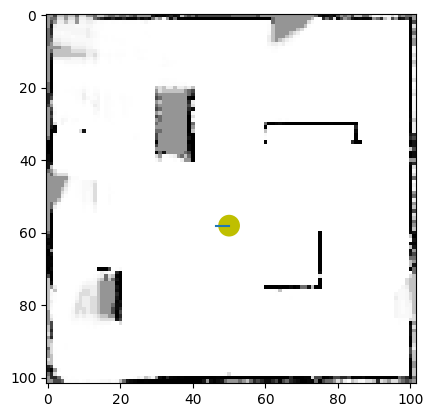

 62%|██████▏   | 473/759 [03:10<01:45,  2.70it/s]

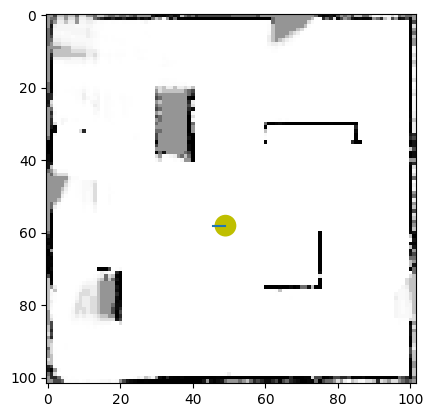

 62%|██████▏   | 474/759 [03:10<01:45,  2.71it/s]

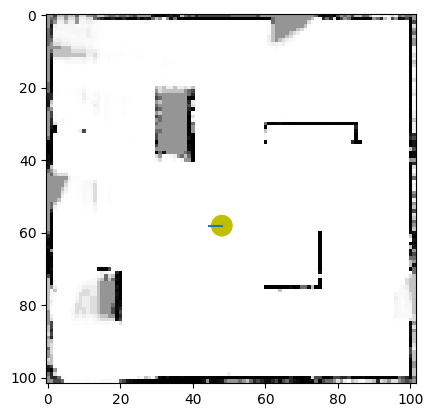

 63%|██████▎   | 475/759 [03:11<01:44,  2.72it/s]

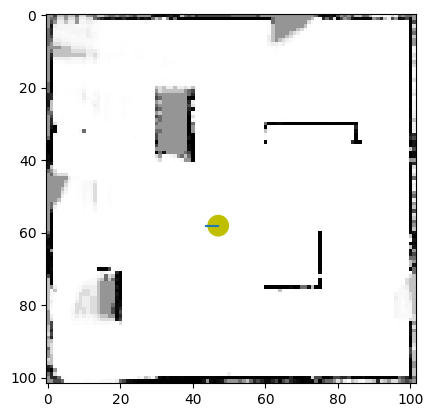

 63%|██████▎   | 476/759 [03:11<01:31,  3.10it/s]

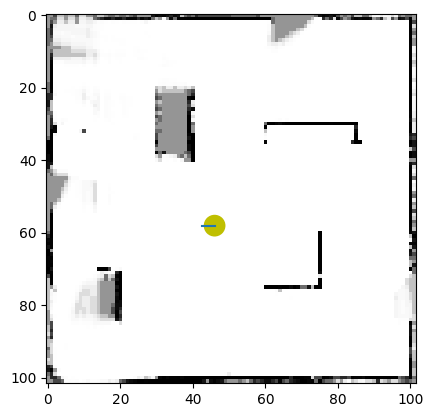

 63%|██████▎   | 477/759 [03:11<01:39,  2.83it/s]

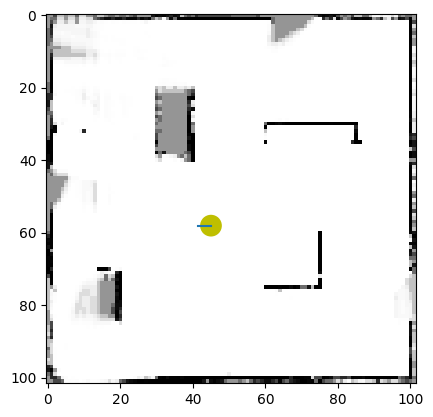

 63%|██████▎   | 478/759 [03:12<01:38,  2.84it/s]

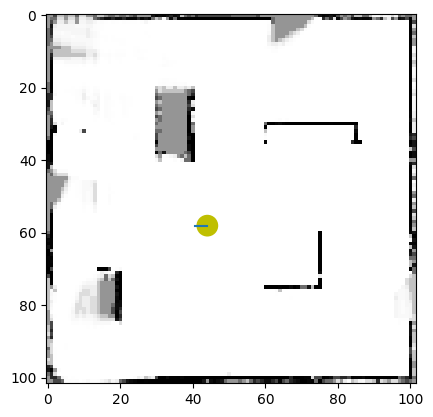

 63%|██████▎   | 479/759 [03:12<01:37,  2.88it/s]

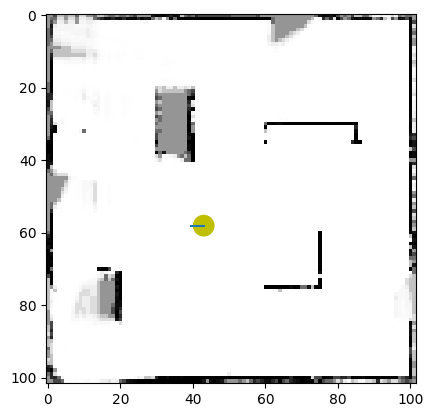

 63%|██████▎   | 480/759 [03:12<01:26,  3.23it/s]

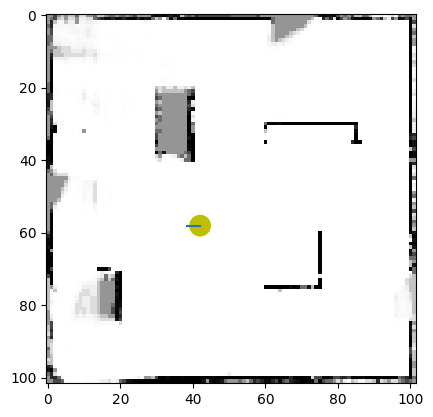

 63%|██████▎   | 481/759 [03:13<01:30,  3.08it/s]

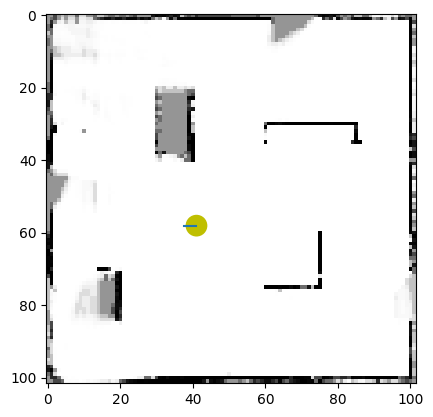

 64%|██████▎   | 482/759 [03:13<01:22,  3.35it/s]

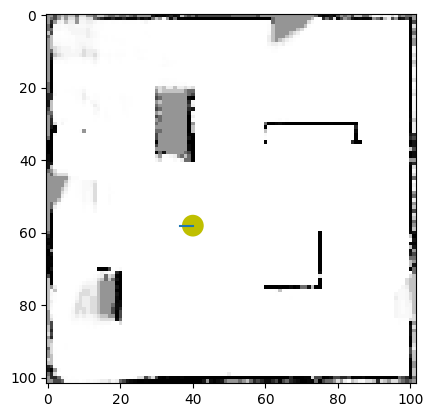

 64%|██████▎   | 483/759 [03:13<01:27,  3.16it/s]

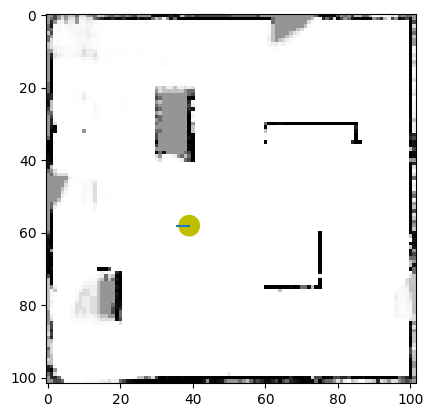

 64%|██████▍   | 484/759 [03:14<01:30,  3.04it/s]

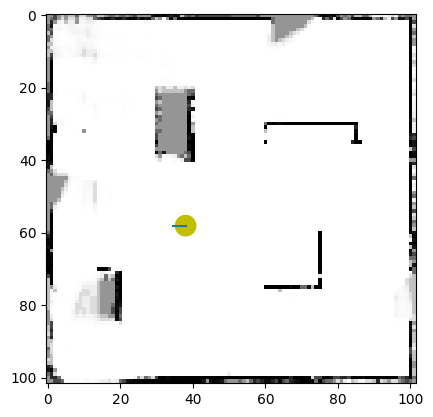

 64%|██████▍   | 485/759 [03:14<01:30,  3.02it/s]

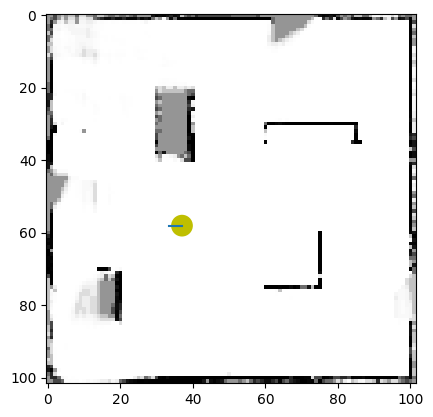

 64%|██████▍   | 486/759 [03:14<01:36,  2.84it/s]

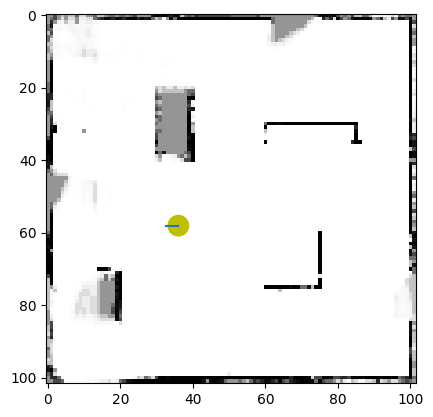

 64%|██████▍   | 487/759 [03:15<01:44,  2.59it/s]

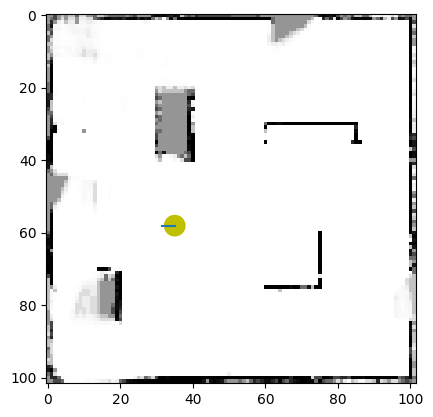

 64%|██████▍   | 488/759 [03:15<01:41,  2.67it/s]

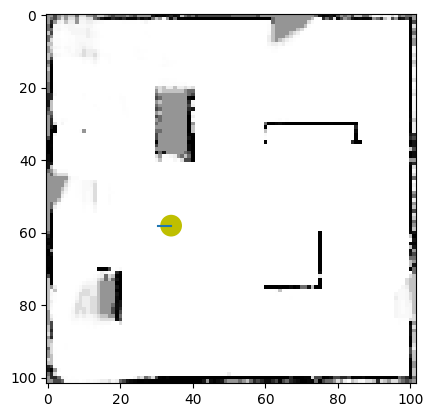

 64%|██████▍   | 489/759 [03:16<01:41,  2.65it/s]

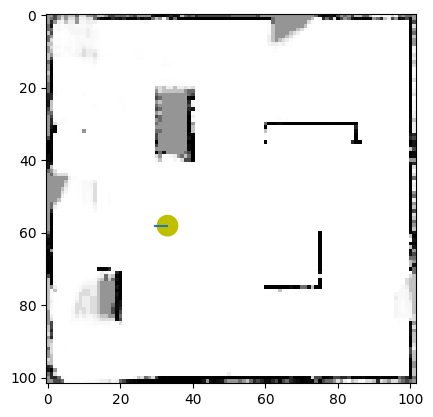

 65%|██████▍   | 490/759 [03:16<01:39,  2.71it/s]

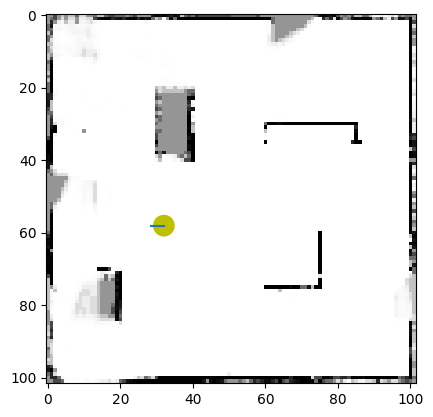

 65%|██████▍   | 491/759 [03:16<01:34,  2.84it/s]

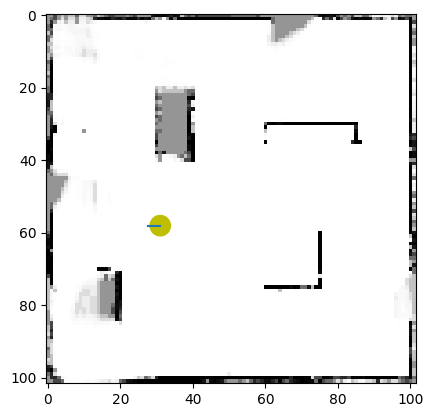

 65%|██████▍   | 492/759 [03:17<01:24,  3.15it/s]

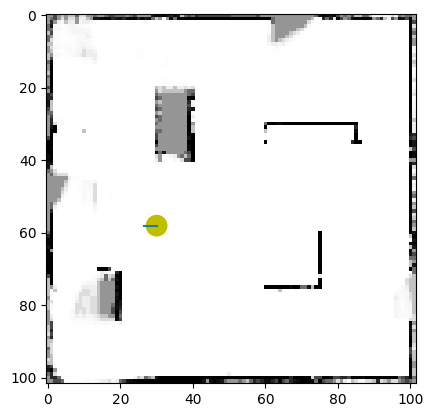

 65%|██████▍   | 493/759 [03:17<01:27,  3.04it/s]

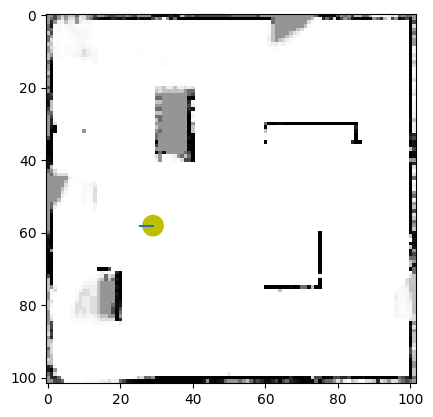

 65%|██████▌   | 494/759 [03:17<01:18,  3.40it/s]

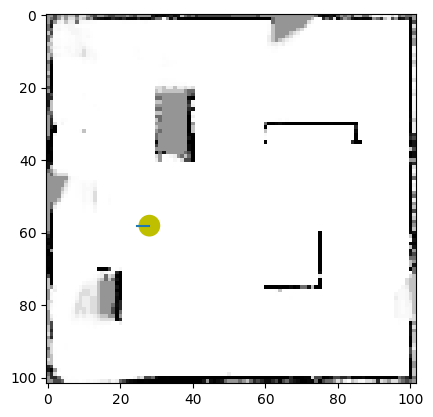

 65%|██████▌   | 495/759 [03:17<01:23,  3.15it/s]

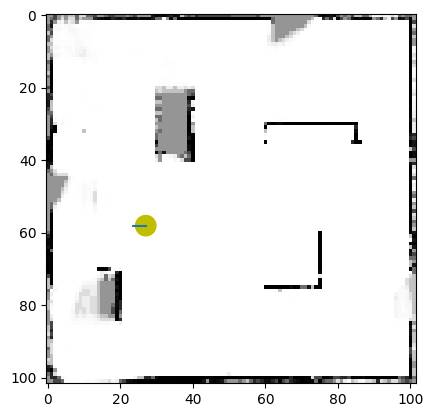

 65%|██████▌   | 496/759 [03:18<01:26,  3.04it/s]

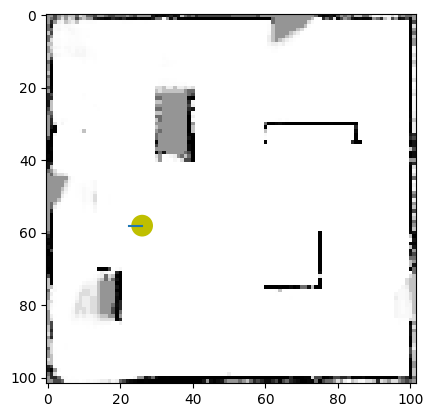

 65%|██████▌   | 497/759 [03:18<01:28,  2.97it/s]

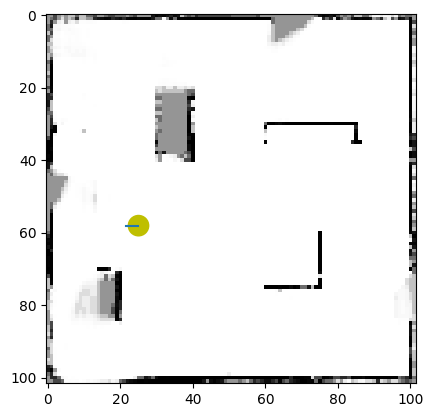

 66%|██████▌   | 498/759 [03:19<01:35,  2.74it/s]

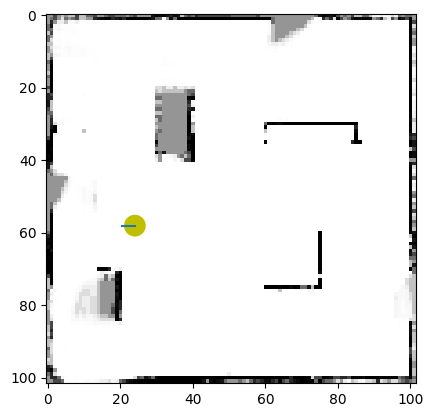

 66%|██████▌   | 499/759 [03:19<01:39,  2.62it/s]

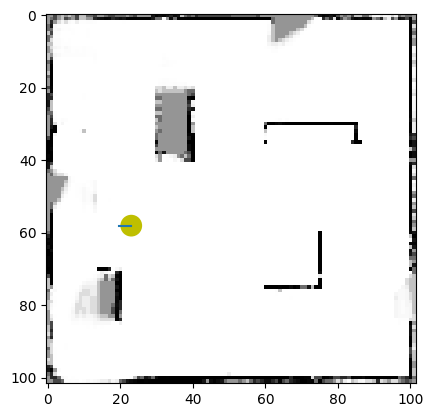

 66%|██████▌   | 500/759 [03:19<01:40,  2.57it/s]

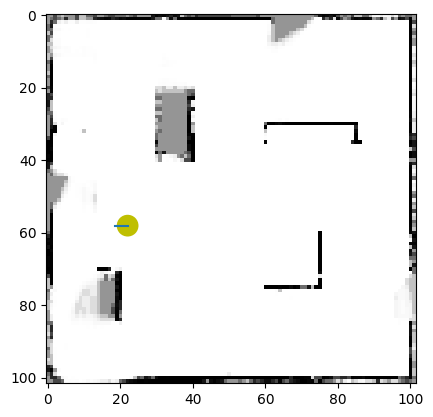

 66%|██████▌   | 501/759 [03:20<01:36,  2.66it/s]

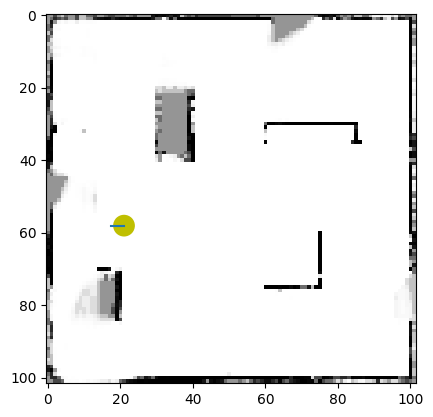

 66%|██████▌   | 502/759 [03:20<01:38,  2.60it/s]

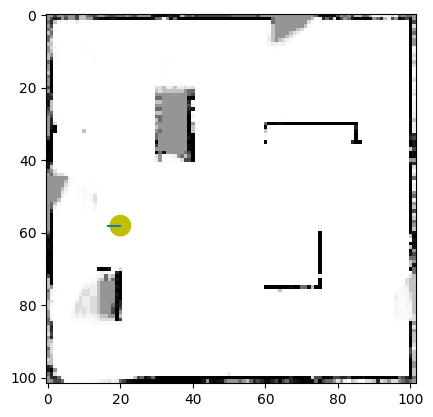

 66%|██████▋   | 503/759 [03:21<01:36,  2.67it/s]

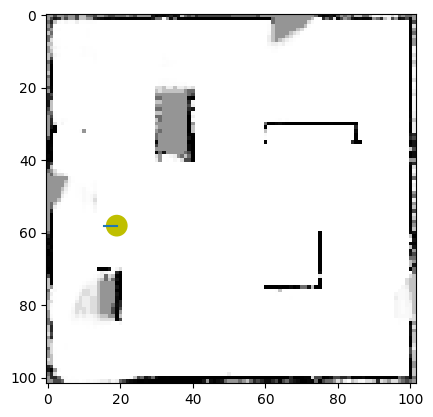

 66%|██████▋   | 504/759 [03:21<01:34,  2.70it/s]

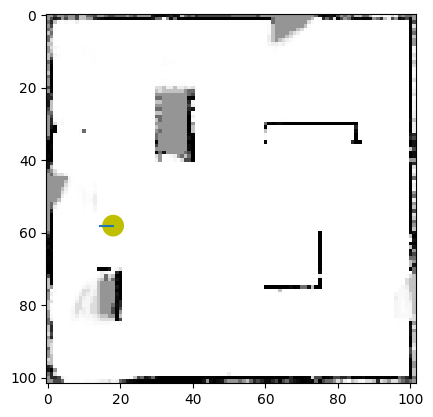

 67%|██████▋   | 505/759 [03:21<01:39,  2.56it/s]

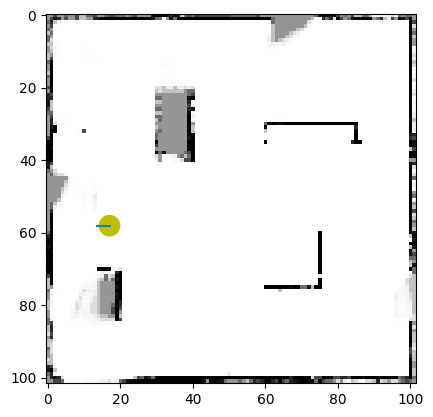

 67%|██████▋   | 506/759 [03:22<01:37,  2.59it/s]

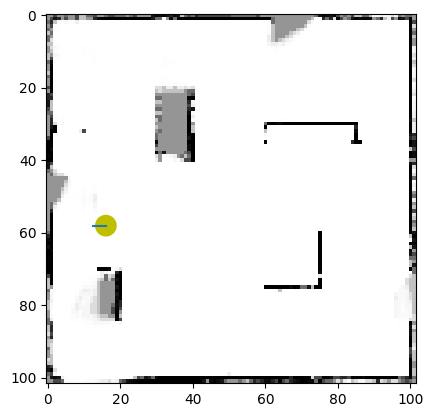

 67%|██████▋   | 507/759 [03:22<01:35,  2.63it/s]

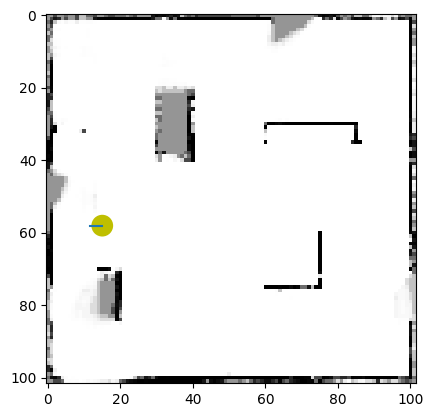

 67%|██████▋   | 508/759 [03:22<01:35,  2.62it/s]

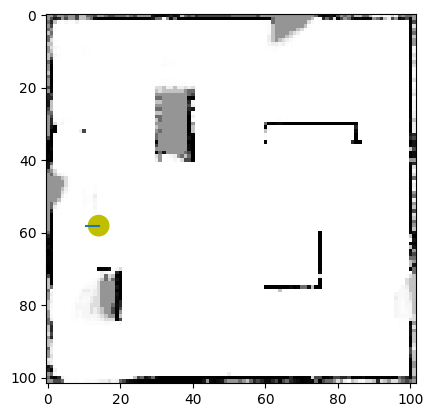

 67%|██████▋   | 509/759 [03:23<01:36,  2.60it/s]

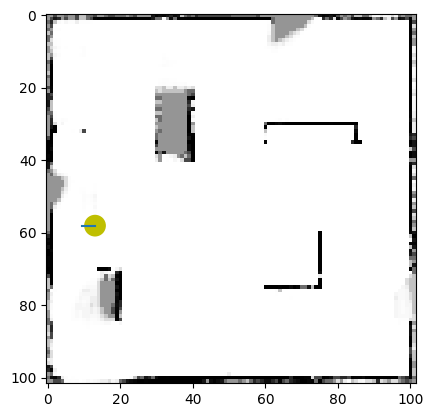

 67%|██████▋   | 510/759 [03:23<01:32,  2.68it/s]

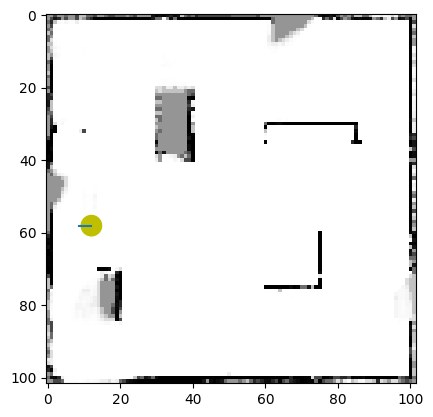

 67%|██████▋   | 511/759 [03:24<01:36,  2.57it/s]

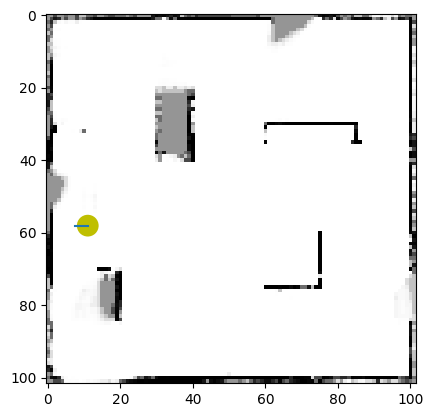

 67%|██████▋   | 512/759 [03:24<01:23,  2.97it/s]

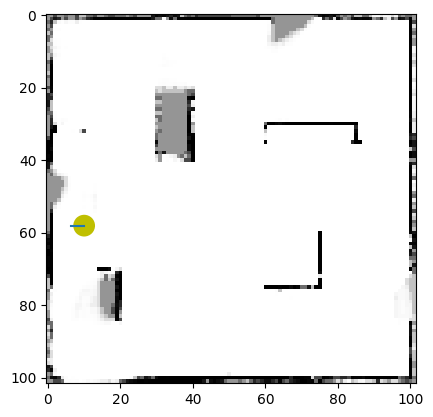

 68%|██████▊   | 513/759 [03:24<01:23,  2.96it/s]

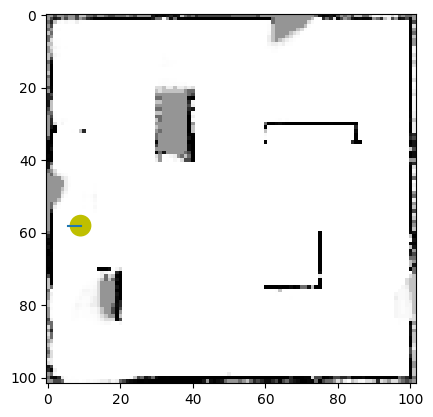

 68%|██████▊   | 514/759 [03:25<01:31,  2.69it/s]

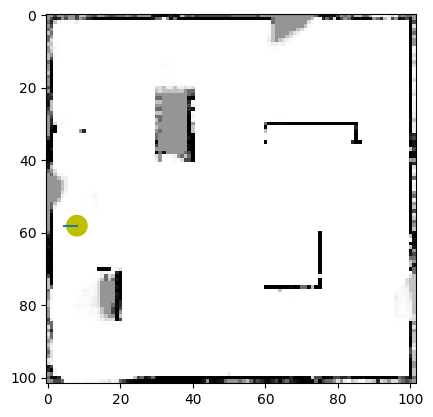

 68%|██████▊   | 515/759 [03:25<01:26,  2.82it/s]

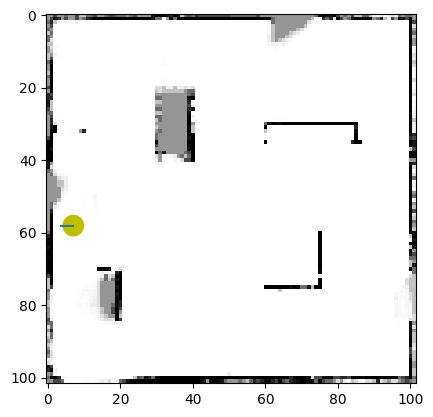

 68%|██████▊   | 516/759 [03:25<01:32,  2.64it/s]

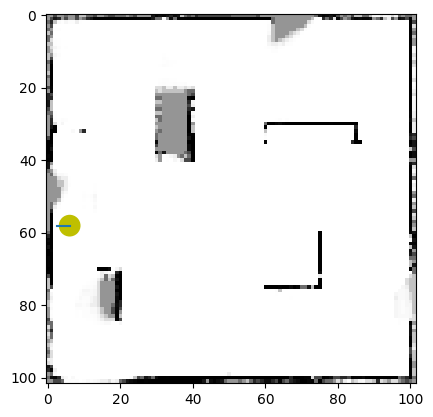

 68%|██████▊   | 517/759 [03:26<01:30,  2.68it/s]

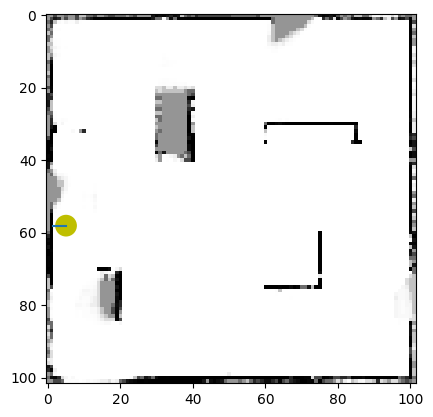

 68%|██████▊   | 518/759 [03:26<01:30,  2.67it/s]

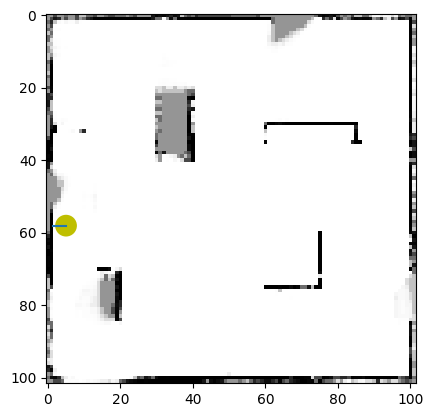

 68%|██████▊   | 519/759 [03:27<01:33,  2.57it/s]

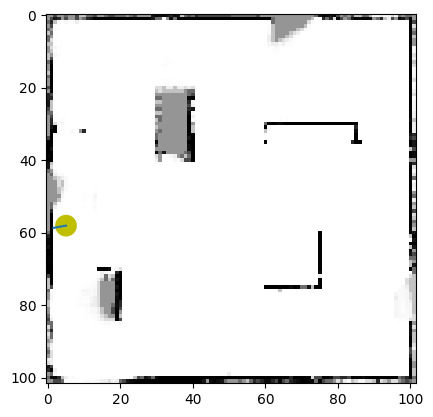

 69%|██████▊   | 520/759 [03:27<01:34,  2.53it/s]

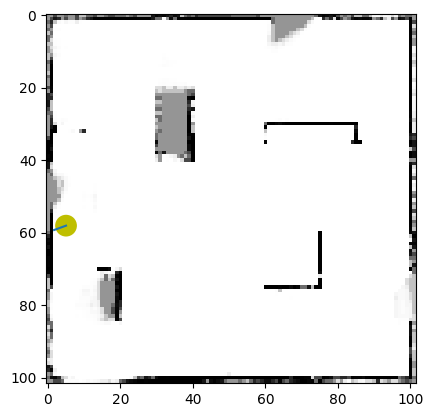

 69%|██████▊   | 521/759 [03:27<01:34,  2.51it/s]

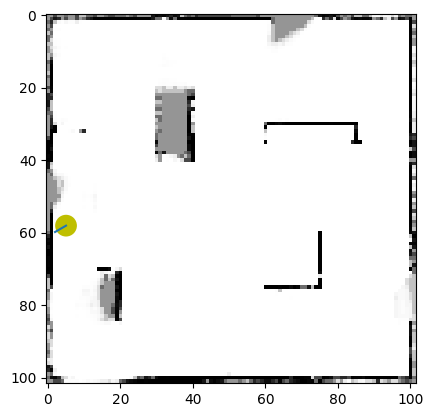

 69%|██████▉   | 522/759 [03:28<01:34,  2.51it/s]

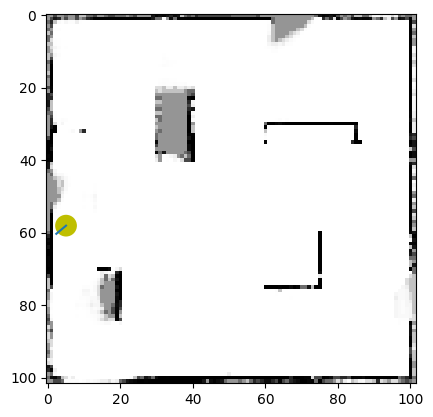

 69%|██████▉   | 523/759 [03:28<01:33,  2.53it/s]

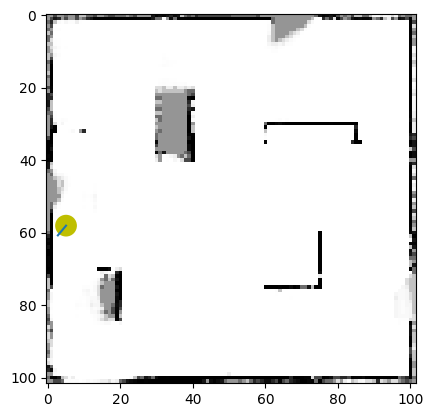

 69%|██████▉   | 524/759 [03:29<01:33,  2.52it/s]

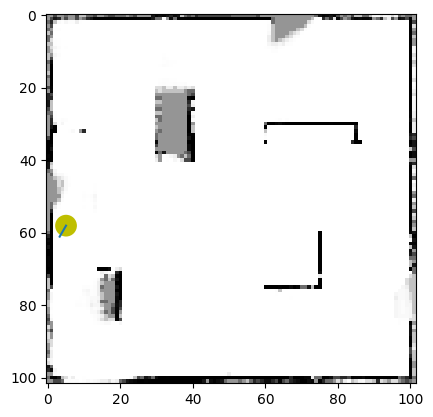

 69%|██████▉   | 525/759 [03:29<01:31,  2.56it/s]

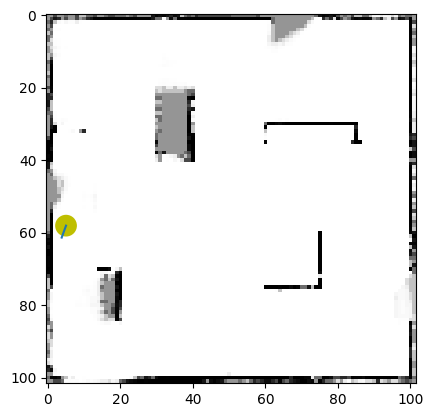

 69%|██████▉   | 526/759 [03:29<01:21,  2.84it/s]

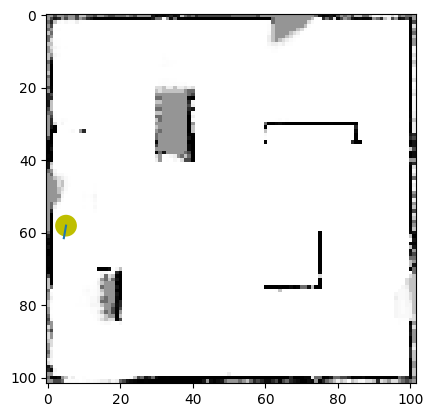

 69%|██████▉   | 527/759 [03:30<01:22,  2.82it/s]

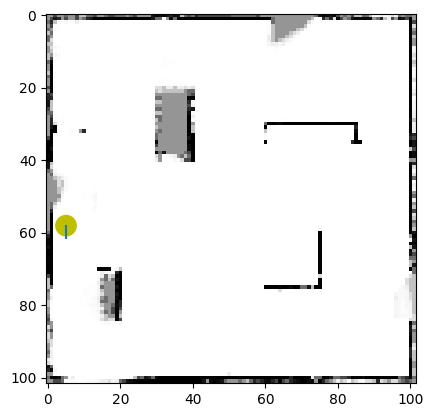

 70%|██████▉   | 528/759 [03:30<01:15,  3.07it/s]

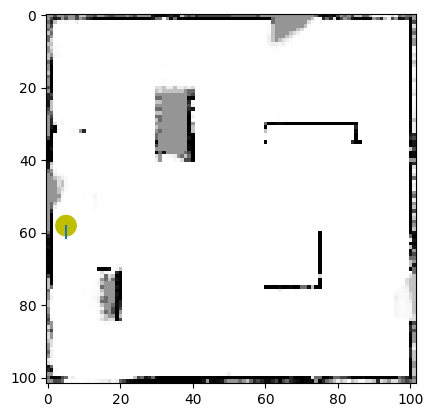

 70%|██████▉   | 529/759 [03:30<01:18,  2.93it/s]

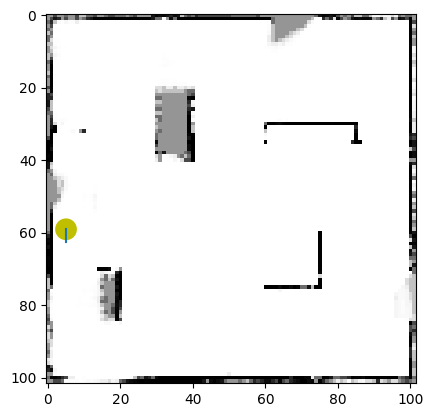

 70%|██████▉   | 530/759 [03:30<01:13,  3.11it/s]

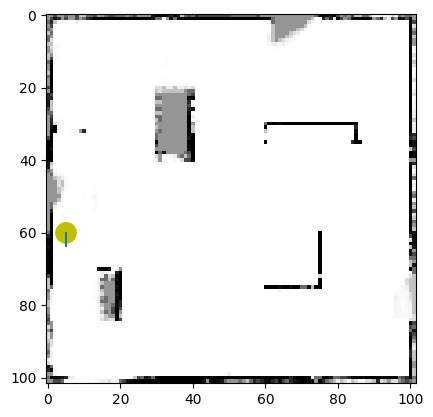

 70%|██████▉   | 531/759 [03:31<01:15,  3.03it/s]

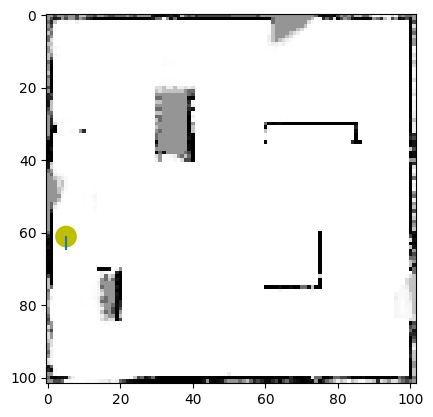

 70%|███████   | 532/759 [03:31<01:17,  2.93it/s]

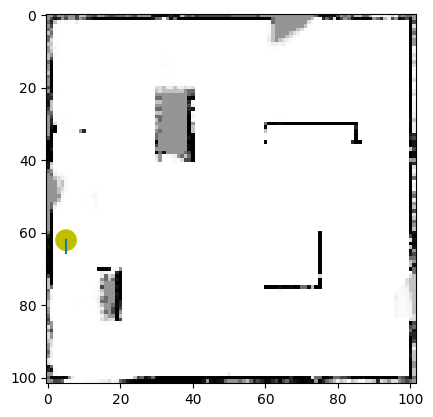

 70%|███████   | 533/759 [03:31<01:17,  2.92it/s]

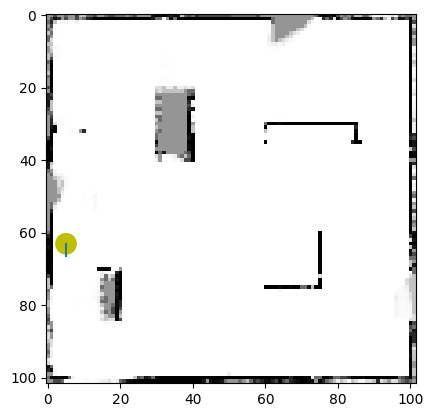

 70%|███████   | 534/759 [03:32<01:10,  3.17it/s]

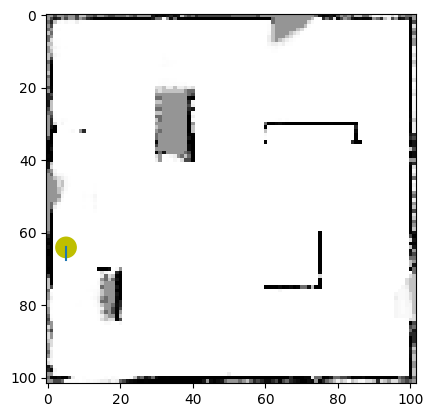

 70%|███████   | 535/759 [03:32<01:13,  3.07it/s]

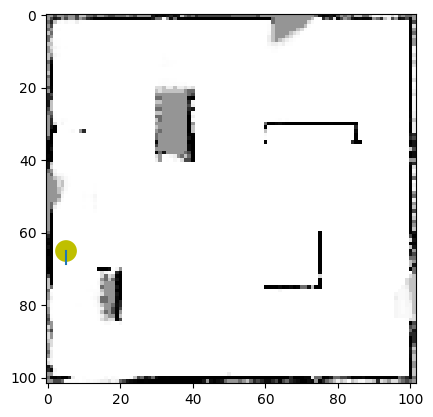

 71%|███████   | 536/759 [03:32<01:14,  3.00it/s]

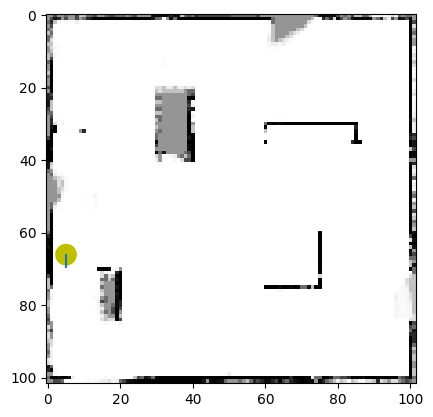

 71%|███████   | 537/759 [03:33<01:13,  3.00it/s]

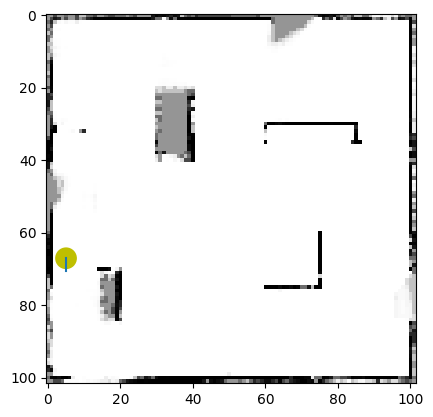

 71%|███████   | 538/759 [03:33<01:05,  3.36it/s]

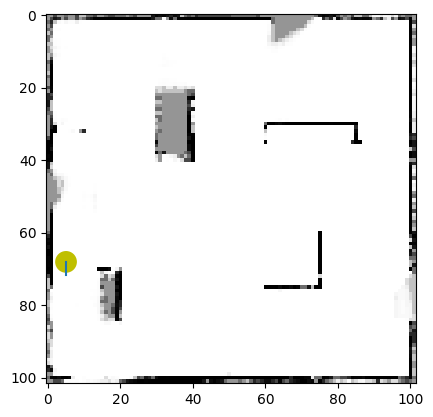

 71%|███████   | 539/759 [03:33<01:10,  3.13it/s]

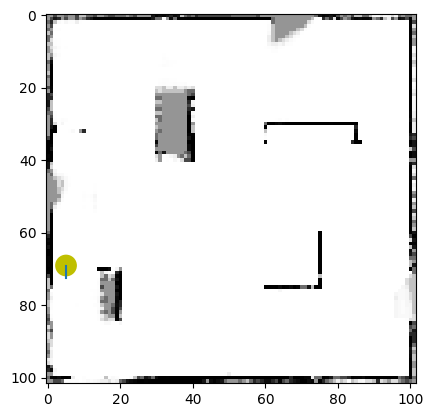

 71%|███████   | 540/759 [03:34<01:11,  3.05it/s]

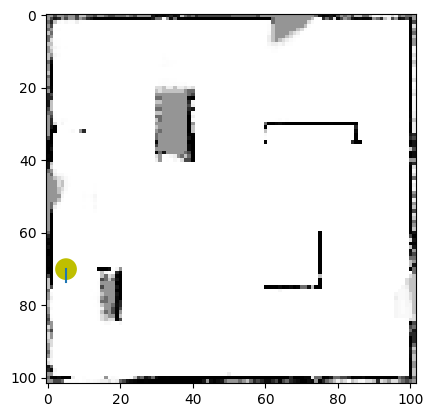

 71%|███████▏  | 541/759 [03:34<01:15,  2.90it/s]

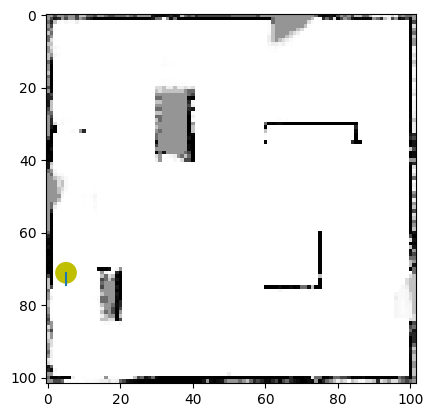

 71%|███████▏  | 542/759 [03:34<01:14,  2.90it/s]

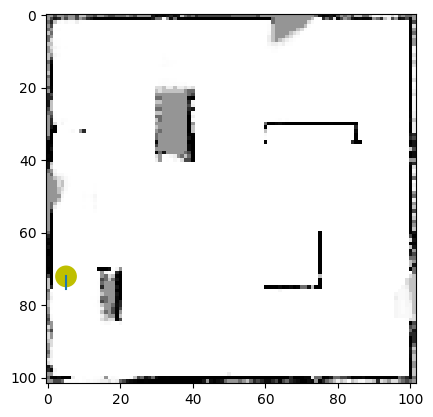

 72%|███████▏  | 543/759 [03:35<01:16,  2.82it/s]

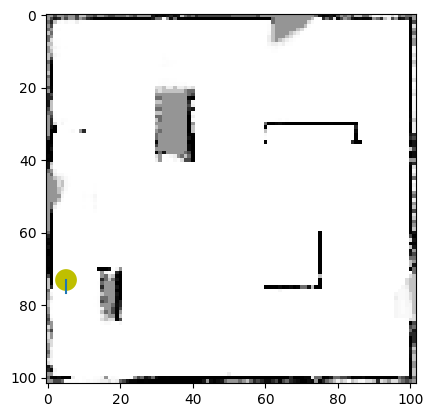

 72%|███████▏  | 544/759 [03:35<01:19,  2.70it/s]

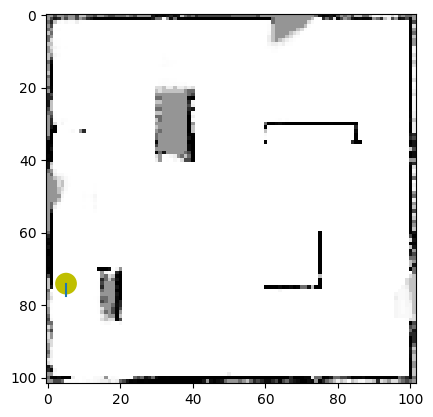

 72%|███████▏  | 545/759 [03:35<01:11,  3.00it/s]

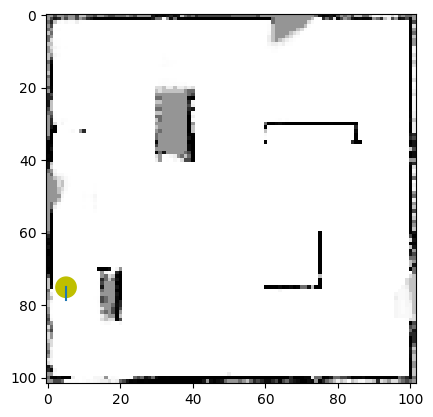

 72%|███████▏  | 546/759 [03:36<01:14,  2.87it/s]

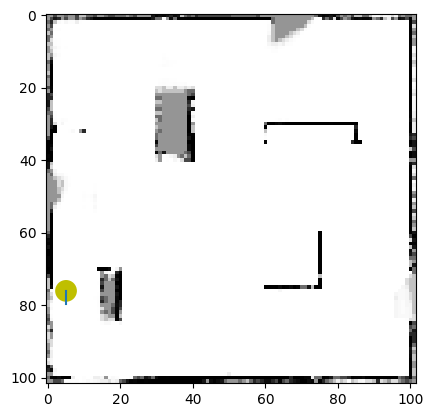

 72%|███████▏  | 547/759 [03:36<01:15,  2.80it/s]

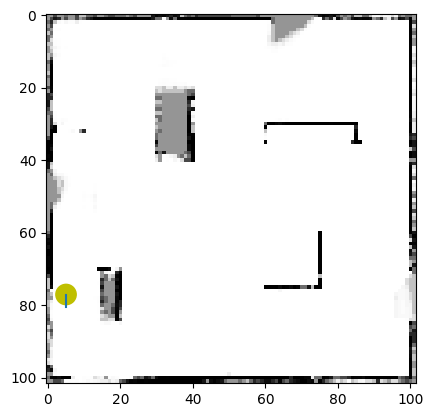

 72%|███████▏  | 548/759 [03:37<01:16,  2.77it/s]

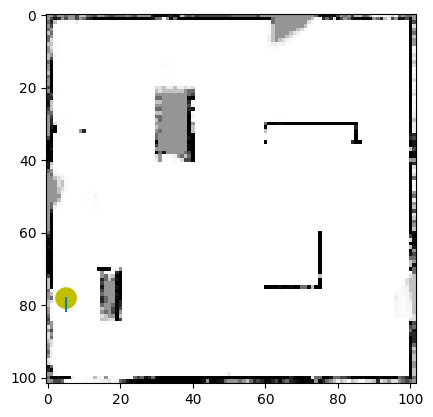

 72%|███████▏  | 549/759 [03:37<01:18,  2.69it/s]

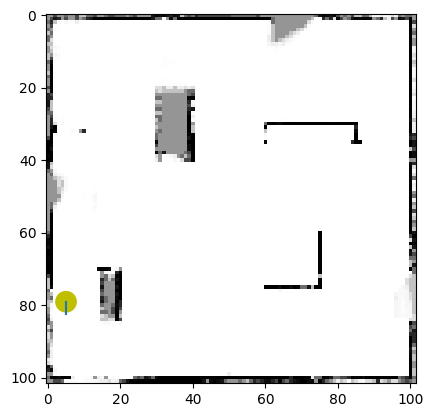

 72%|███████▏  | 550/759 [03:37<01:19,  2.64it/s]

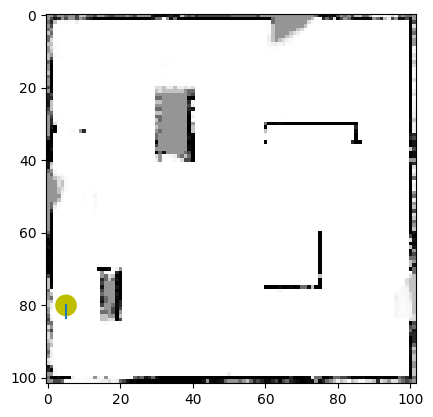

 73%|███████▎  | 551/759 [03:38<01:19,  2.63it/s]

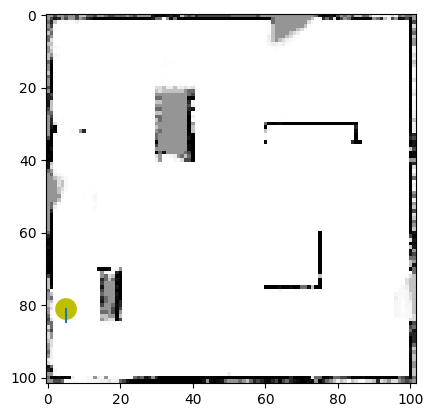

 73%|███████▎  | 552/759 [03:38<01:18,  2.63it/s]

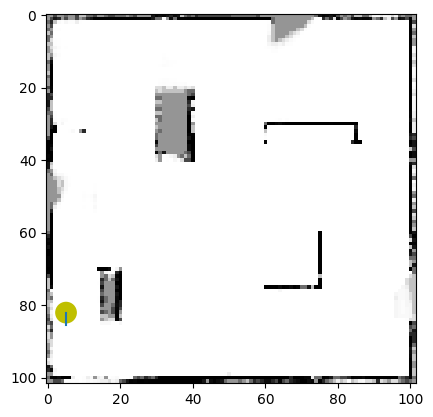

 73%|███████▎  | 553/759 [03:39<01:18,  2.61it/s]

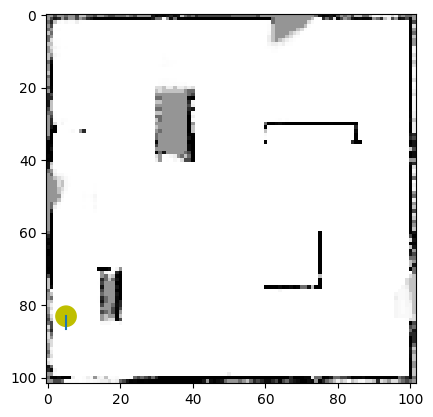

 73%|███████▎  | 554/759 [03:39<01:18,  2.61it/s]

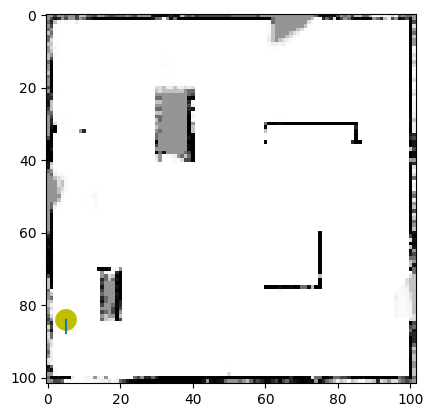

 73%|███████▎  | 555/759 [03:39<01:17,  2.65it/s]

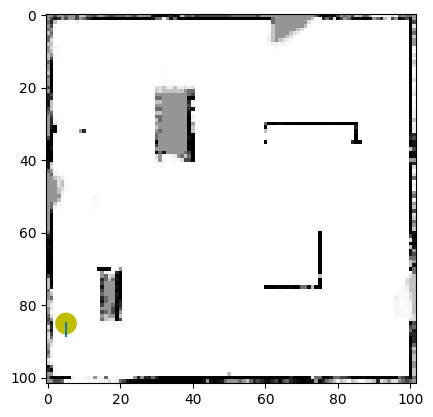

 73%|███████▎  | 556/759 [03:40<01:14,  2.71it/s]

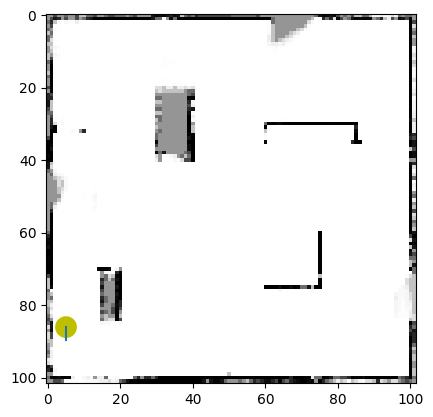

 73%|███████▎  | 557/759 [03:40<01:19,  2.53it/s]

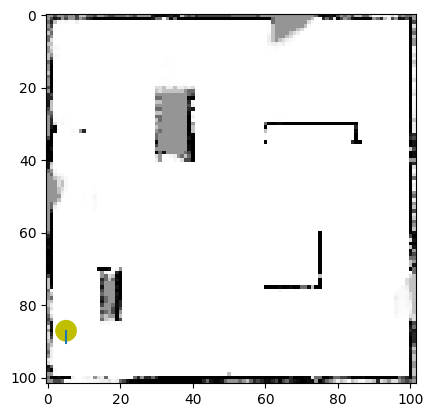

 74%|███████▎  | 558/759 [03:40<01:18,  2.55it/s]

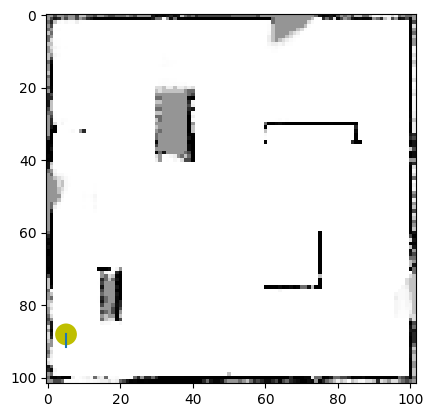

 74%|███████▎  | 559/759 [03:41<01:20,  2.48it/s]

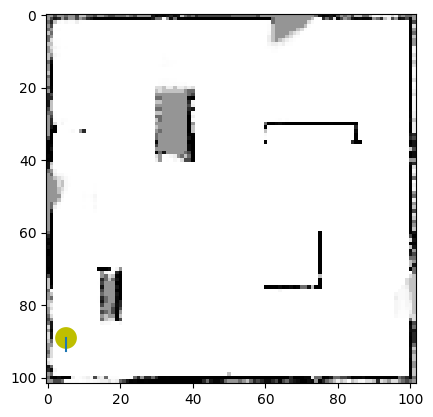

 74%|███████▍  | 560/759 [03:41<01:15,  2.65it/s]

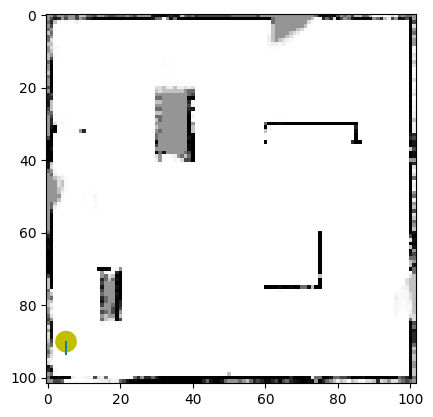

 74%|███████▍  | 561/759 [03:42<01:16,  2.59it/s]

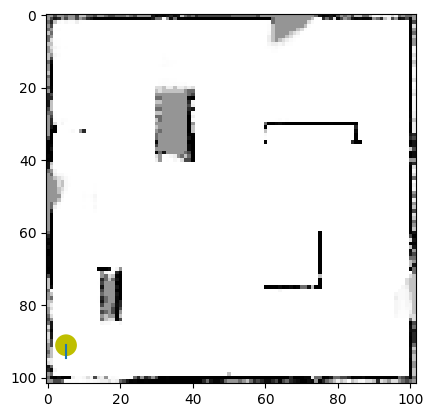

 74%|███████▍  | 562/759 [03:42<01:07,  2.94it/s]

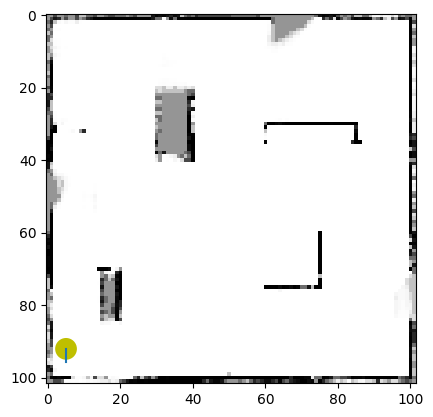

 74%|███████▍  | 563/759 [03:42<01:12,  2.70it/s]

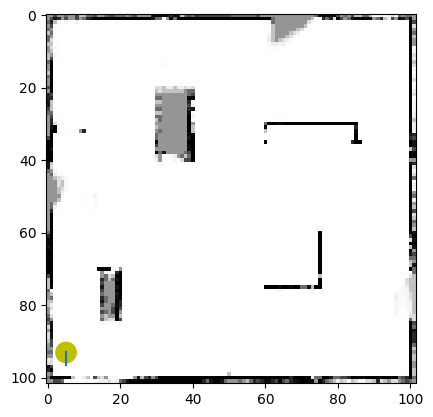

 74%|███████▍  | 564/759 [03:43<01:12,  2.68it/s]

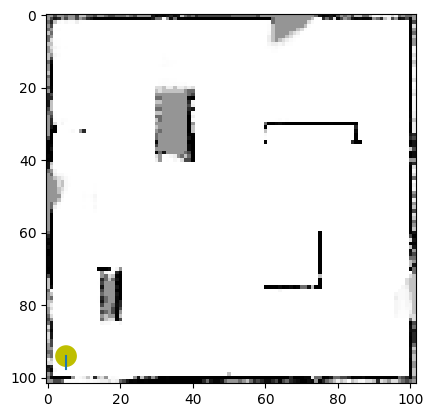

 74%|███████▍  | 565/759 [03:43<01:14,  2.59it/s]

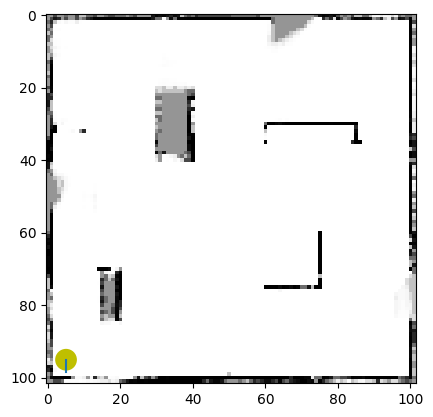

 75%|███████▍  | 566/759 [03:43<01:13,  2.62it/s]

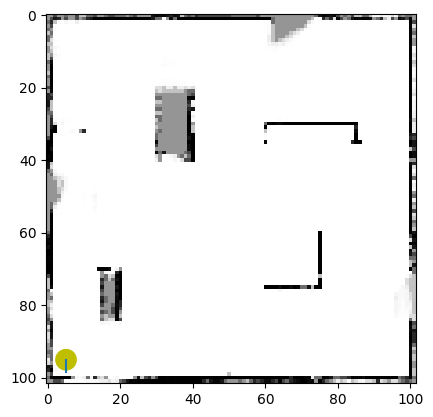

 75%|███████▍  | 567/759 [03:44<01:10,  2.71it/s]

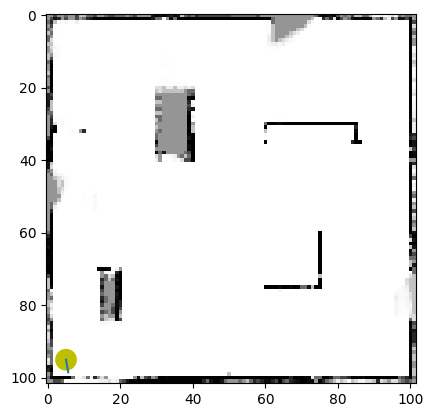

 75%|███████▍  | 568/759 [03:44<01:21,  2.35it/s]

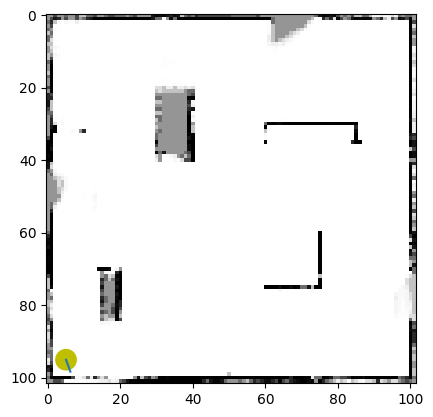

 75%|███████▍  | 569/759 [03:45<01:20,  2.35it/s]

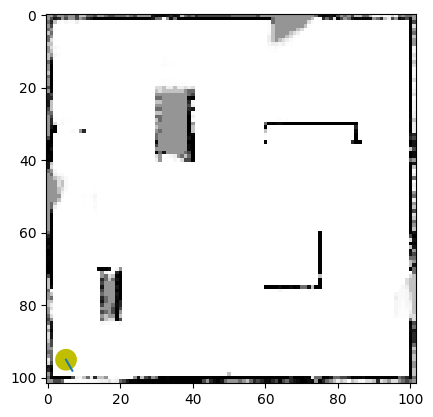

 75%|███████▌  | 570/759 [03:45<01:21,  2.32it/s]

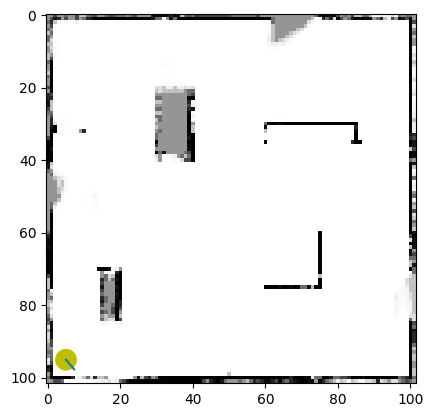

 75%|███████▌  | 571/759 [03:46<01:20,  2.33it/s]

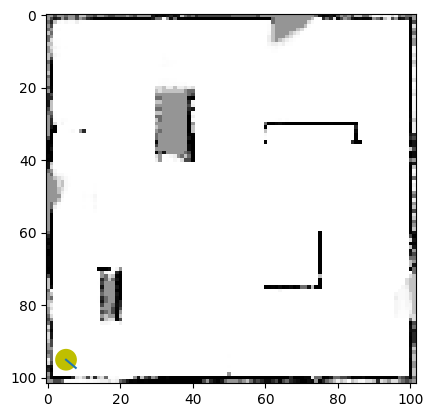

 75%|███████▌  | 572/759 [03:46<01:22,  2.27it/s]

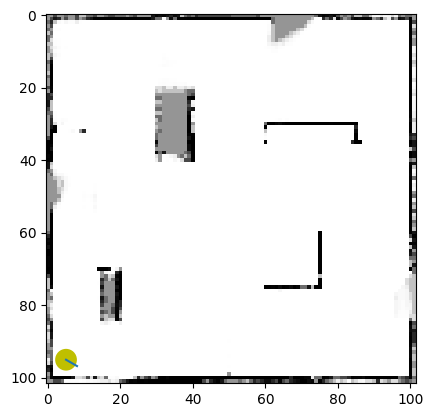

 75%|███████▌  | 573/759 [03:47<01:23,  2.24it/s]

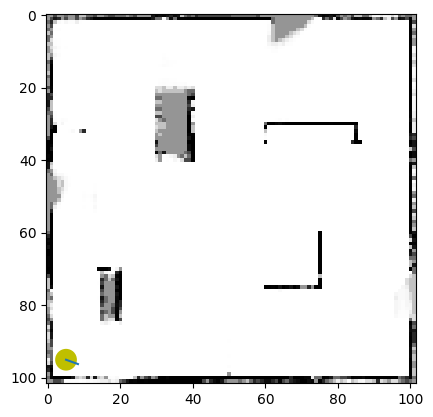

 76%|███████▌  | 574/759 [03:47<01:16,  2.43it/s]

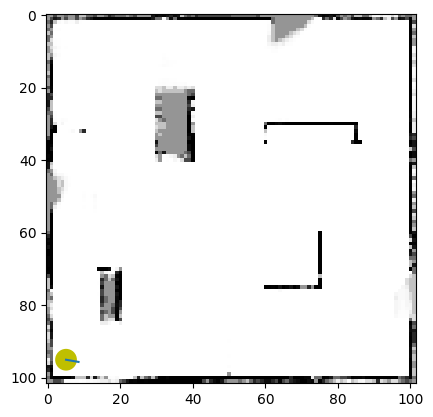

 76%|███████▌  | 575/759 [03:47<01:18,  2.36it/s]

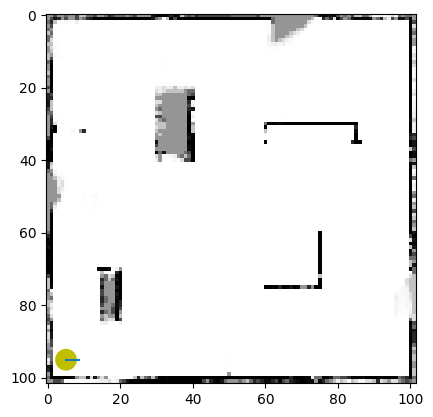

 76%|███████▌  | 576/759 [03:48<01:19,  2.30it/s]

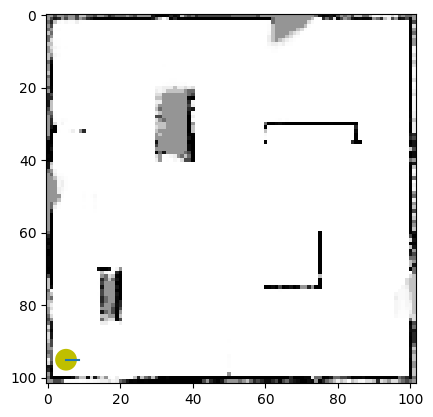

 76%|███████▌  | 577/759 [03:48<01:20,  2.26it/s]

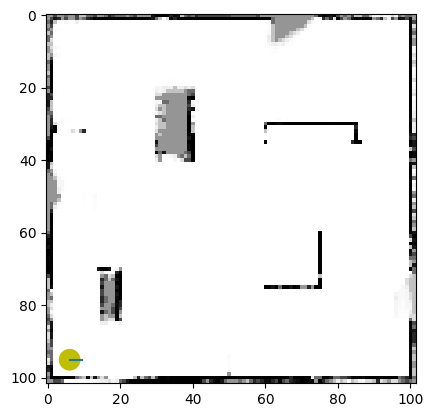

 76%|███████▌  | 578/759 [03:49<01:17,  2.35it/s]

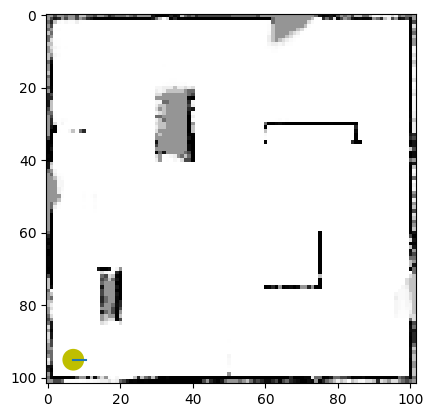

 76%|███████▋  | 579/759 [03:49<01:13,  2.46it/s]

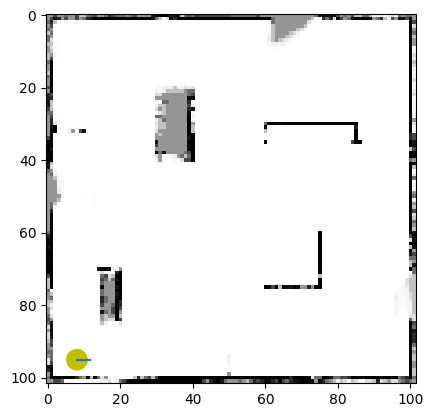

 76%|███████▋  | 580/759 [03:49<01:14,  2.40it/s]

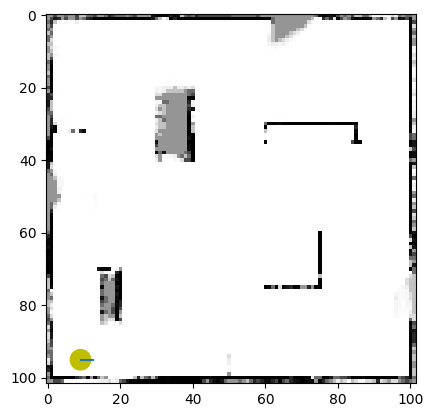

 77%|███████▋  | 581/759 [03:50<01:10,  2.53it/s]

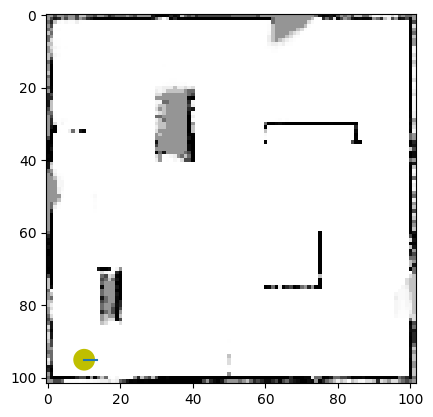

 77%|███████▋  | 582/759 [03:50<01:01,  2.88it/s]

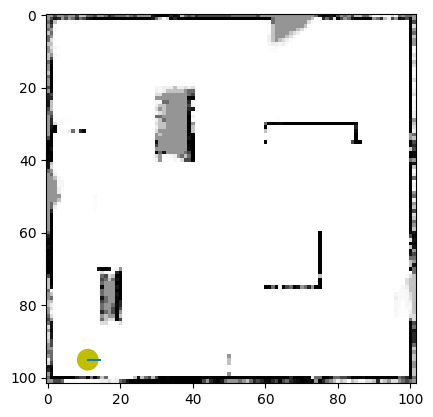

 77%|███████▋  | 583/759 [03:50<00:55,  3.19it/s]

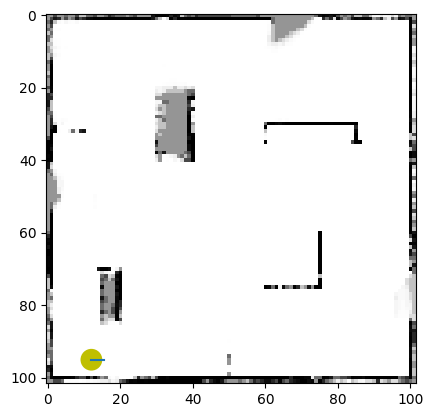

 77%|███████▋  | 584/759 [03:51<01:01,  2.84it/s]

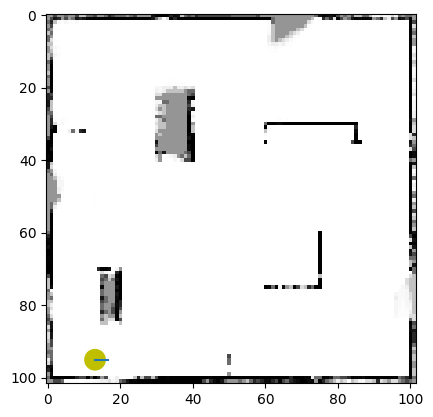

 77%|███████▋  | 585/759 [03:51<01:08,  2.55it/s]

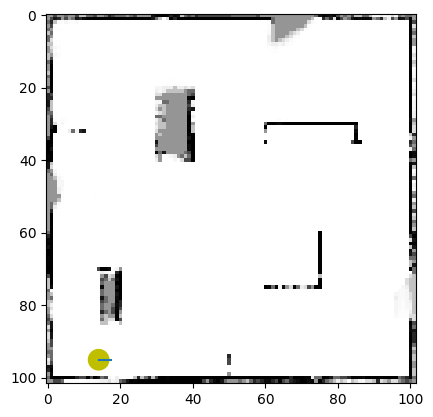

 77%|███████▋  | 586/759 [03:52<01:11,  2.42it/s]

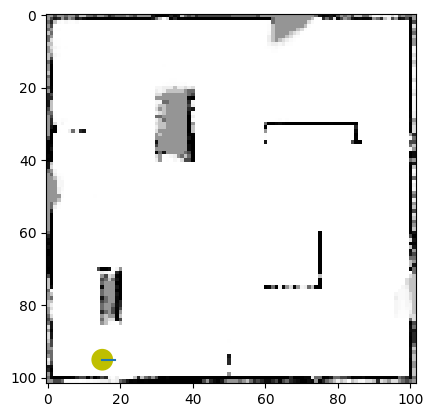

 77%|███████▋  | 587/759 [03:52<01:13,  2.35it/s]

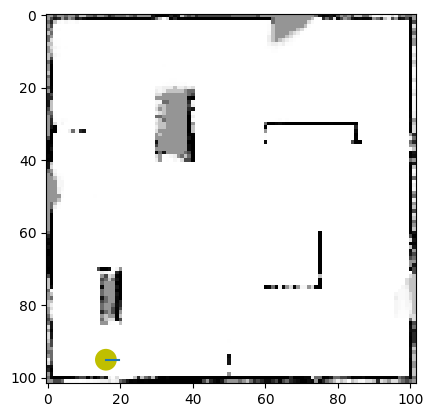

 77%|███████▋  | 588/759 [03:53<01:15,  2.28it/s]

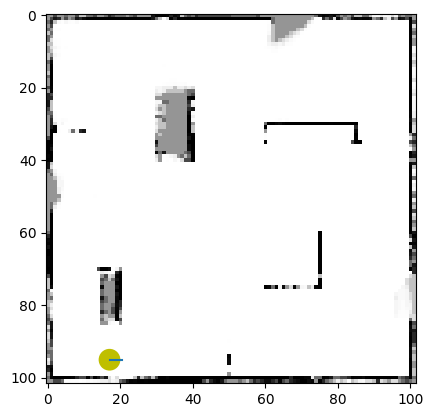

 78%|███████▊  | 589/759 [03:53<01:13,  2.30it/s]

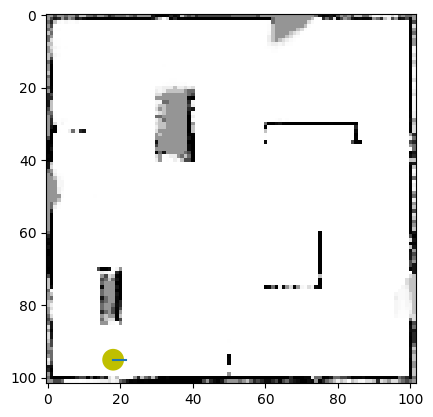

 78%|███████▊  | 590/759 [03:53<01:09,  2.43it/s]

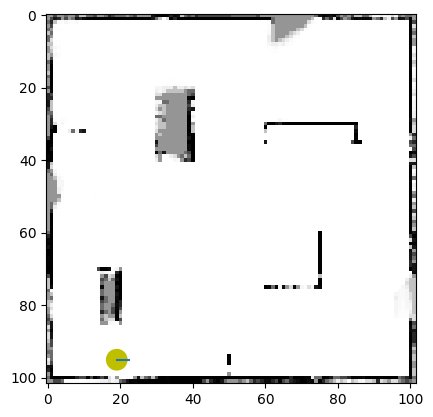

 78%|███████▊  | 591/759 [03:54<01:09,  2.43it/s]

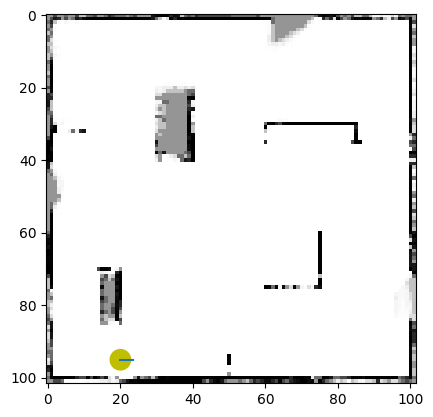

 78%|███████▊  | 592/759 [03:54<01:06,  2.50it/s]

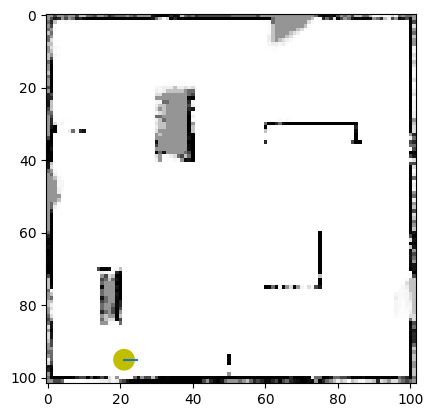

 78%|███████▊  | 593/759 [03:55<01:10,  2.36it/s]

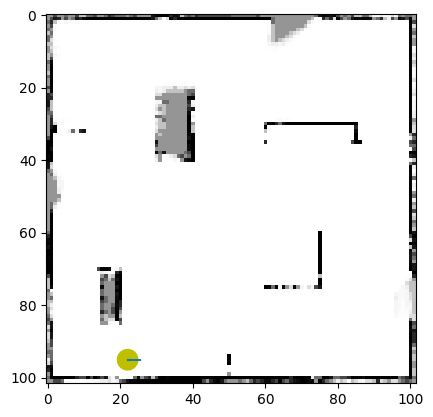

 78%|███████▊  | 594/759 [03:55<01:10,  2.34it/s]

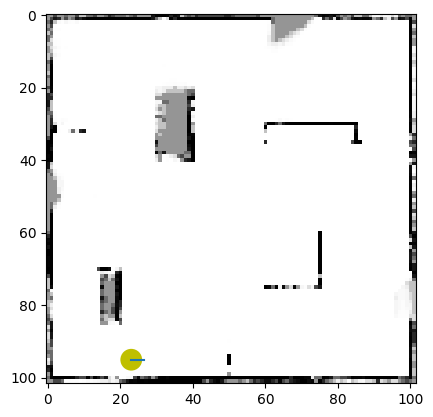

 78%|███████▊  | 595/759 [03:56<01:16,  2.14it/s]

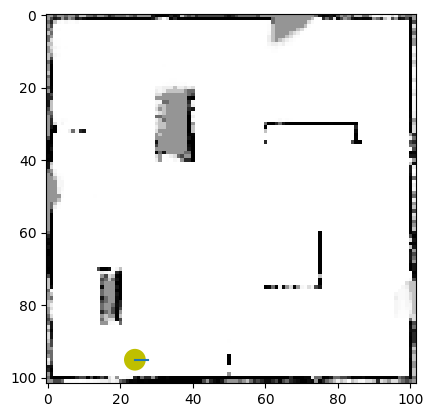

 79%|███████▊  | 596/759 [03:56<01:17,  2.10it/s]

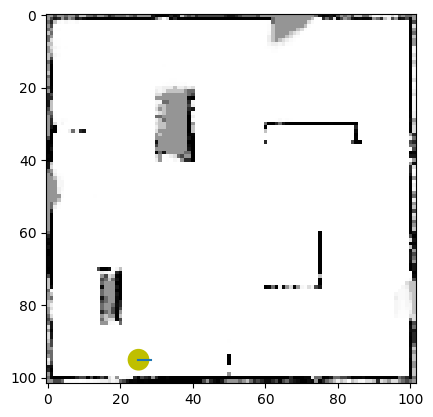

 79%|███████▊  | 597/759 [03:57<01:15,  2.13it/s]

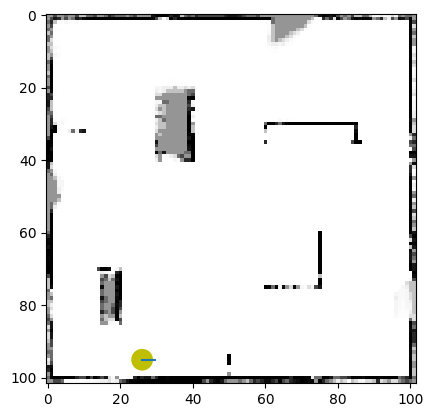

 79%|███████▉  | 598/759 [03:57<01:14,  2.15it/s]

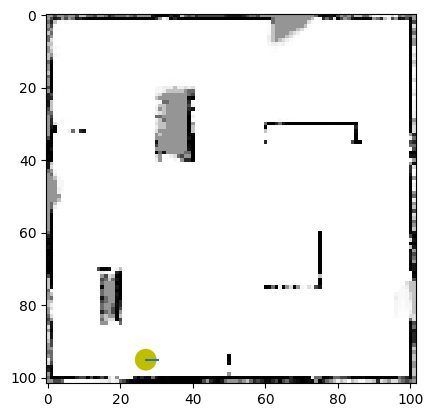

 79%|███████▉  | 599/759 [03:58<01:15,  2.13it/s]

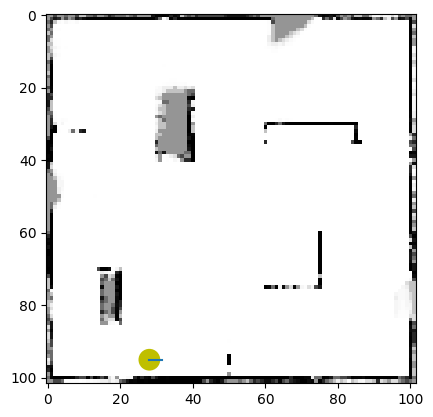

 79%|███████▉  | 600/759 [03:58<01:14,  2.13it/s]

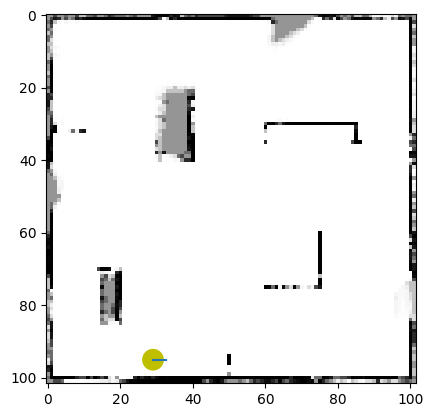

 79%|███████▉  | 601/759 [03:58<01:10,  2.23it/s]

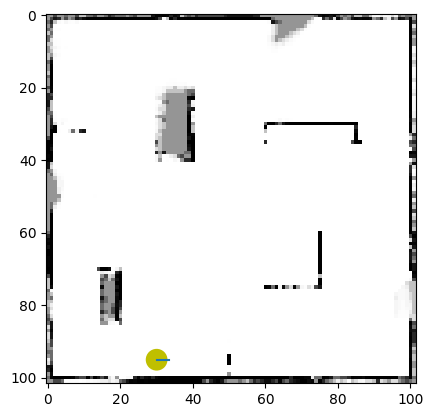

 79%|███████▉  | 602/759 [03:59<01:09,  2.27it/s]

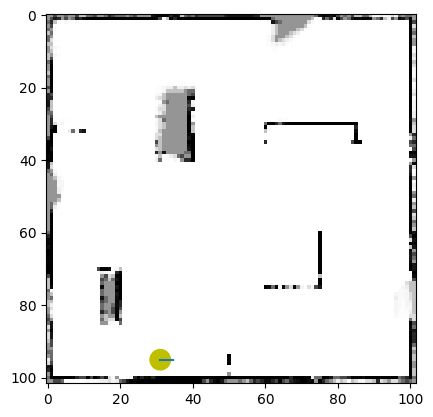

 79%|███████▉  | 603/759 [03:59<01:06,  2.36it/s]

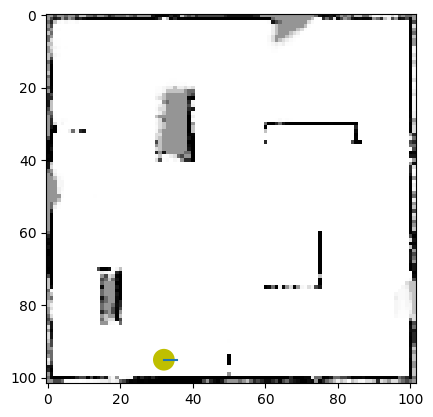

 80%|███████▉  | 604/759 [04:00<01:03,  2.46it/s]

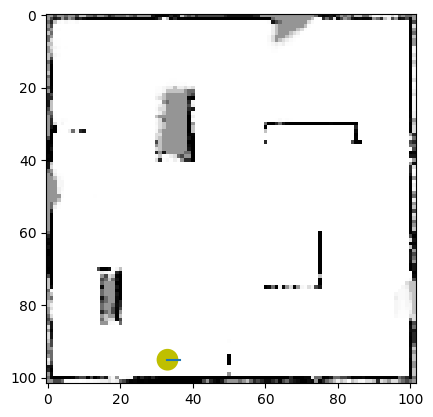

 80%|███████▉  | 605/759 [04:00<01:01,  2.51it/s]

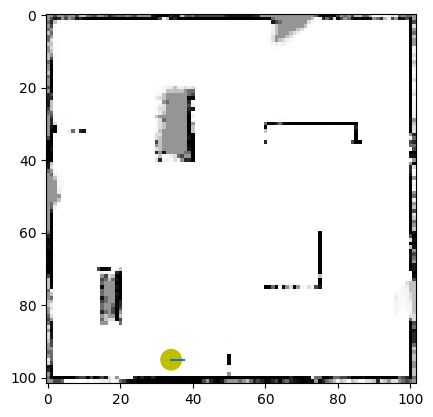

 80%|███████▉  | 606/759 [04:00<01:01,  2.49it/s]

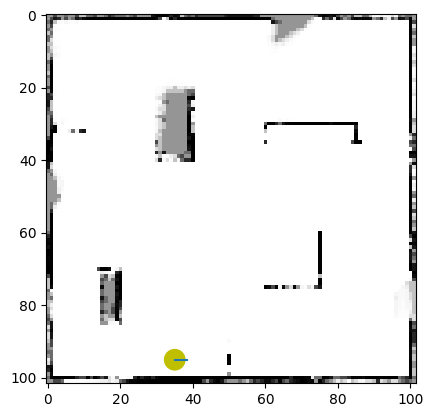

 80%|███████▉  | 607/759 [04:01<01:04,  2.36it/s]

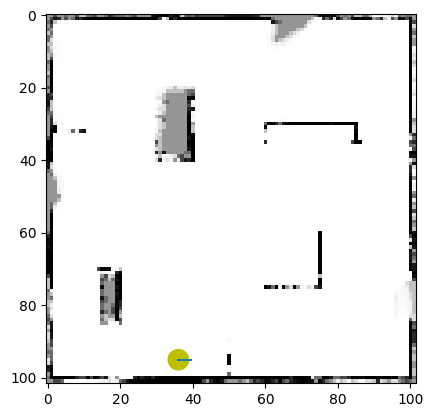

 80%|████████  | 608/759 [04:01<01:06,  2.26it/s]

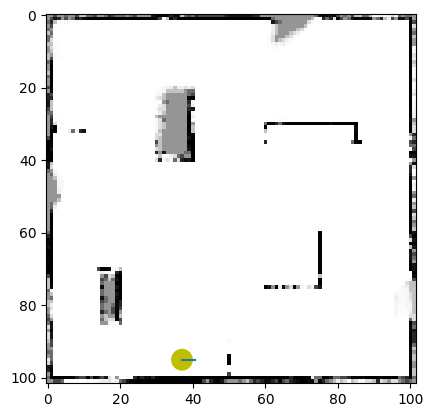

 80%|████████  | 609/759 [04:02<01:08,  2.18it/s]

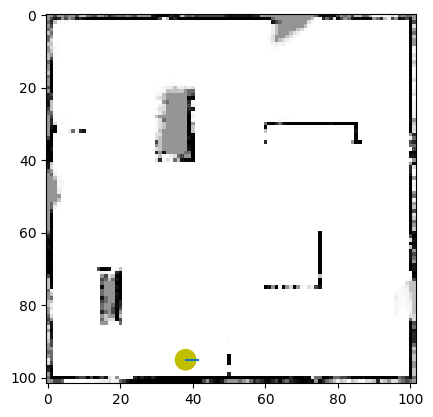

 80%|████████  | 610/759 [04:02<01:09,  2.15it/s]

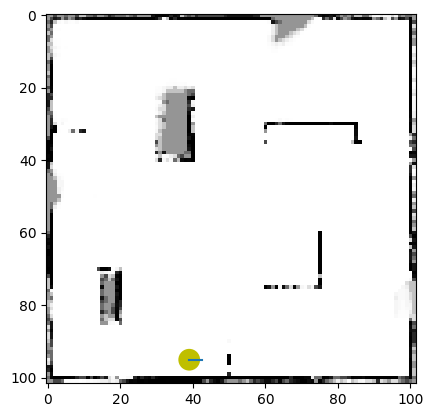

 81%|████████  | 611/759 [04:03<01:08,  2.15it/s]

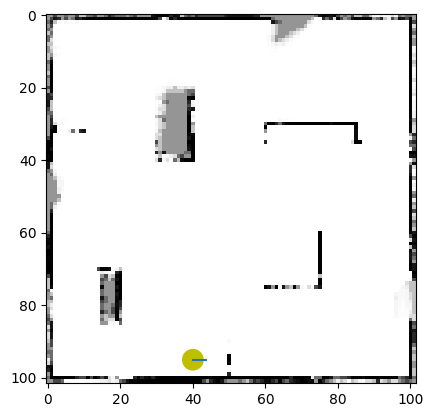

 81%|████████  | 612/759 [04:03<01:07,  2.18it/s]

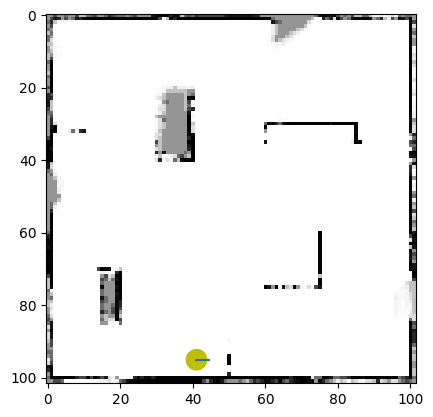

 81%|████████  | 613/759 [04:04<01:04,  2.28it/s]

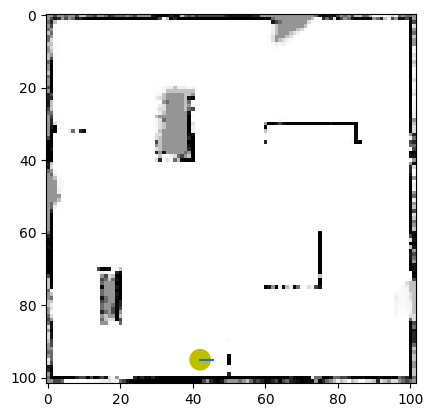

 81%|████████  | 614/759 [04:04<01:04,  2.25it/s]

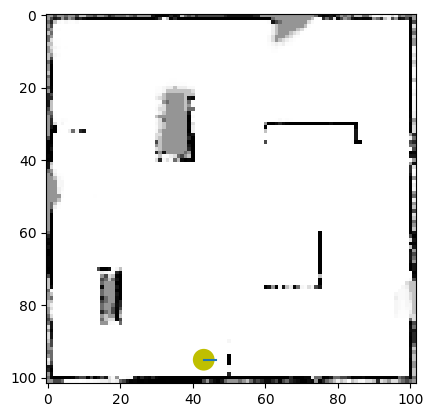

 81%|████████  | 615/759 [04:05<01:06,  2.18it/s]

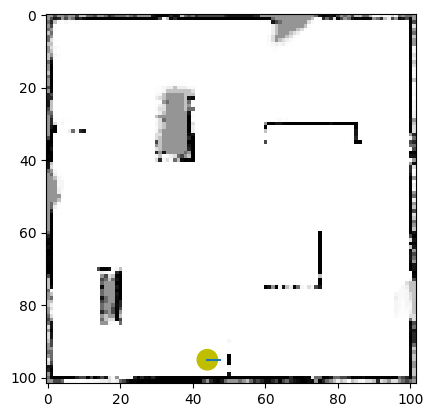

 81%|████████  | 616/759 [04:05<01:06,  2.14it/s]

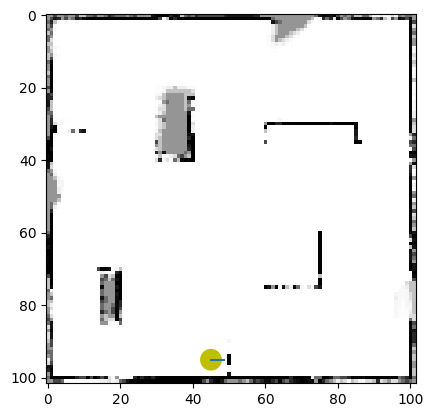

 81%|████████▏ | 617/759 [04:06<01:05,  2.17it/s]

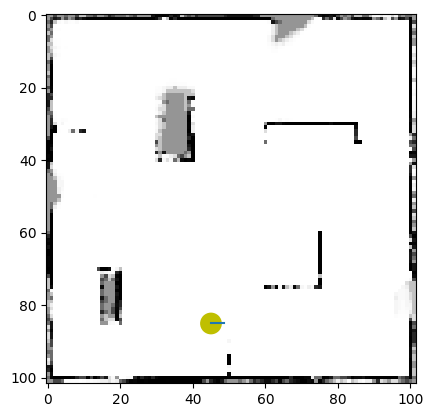

 81%|████████▏ | 618/759 [04:06<01:06,  2.10it/s]

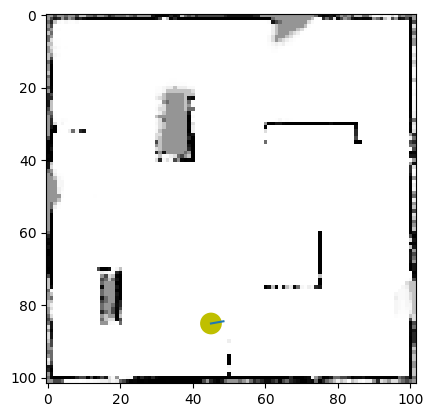

 82%|████████▏ | 619/759 [04:07<01:07,  2.07it/s]

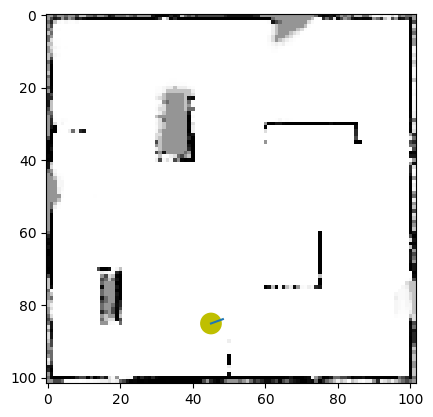

 82%|████████▏ | 620/759 [04:07<01:06,  2.10it/s]

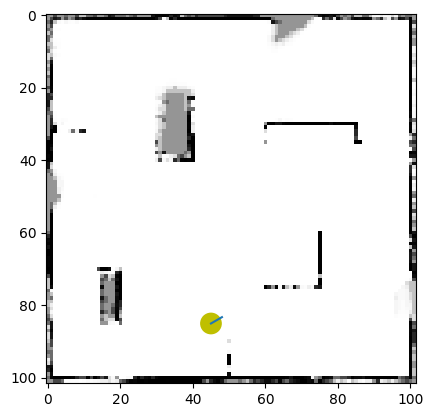

 82%|████████▏ | 621/759 [04:07<01:01,  2.23it/s]

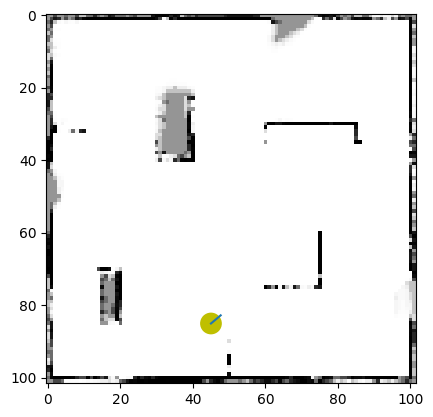

 82%|████████▏ | 622/759 [04:08<01:01,  2.24it/s]

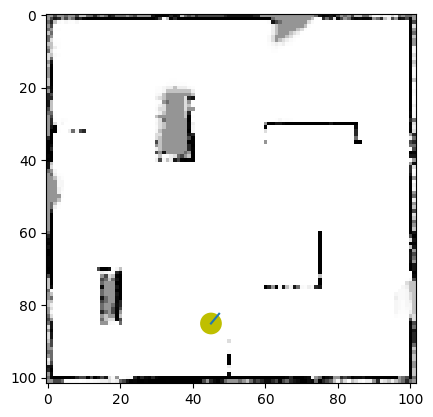

 82%|████████▏ | 623/759 [04:08<01:04,  2.09it/s]

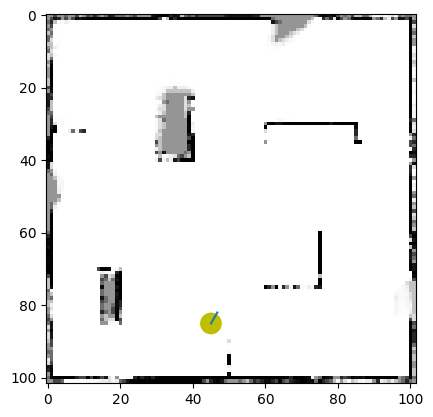

 82%|████████▏ | 624/759 [04:09<01:08,  1.97it/s]

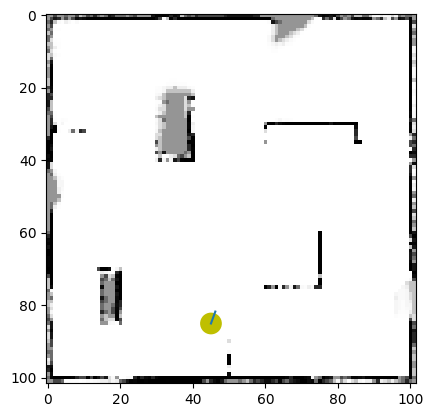

 82%|████████▏ | 625/759 [04:10<01:13,  1.82it/s]

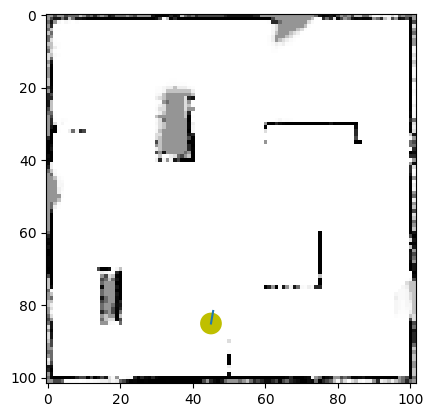

 82%|████████▏ | 626/759 [04:10<01:10,  1.88it/s]

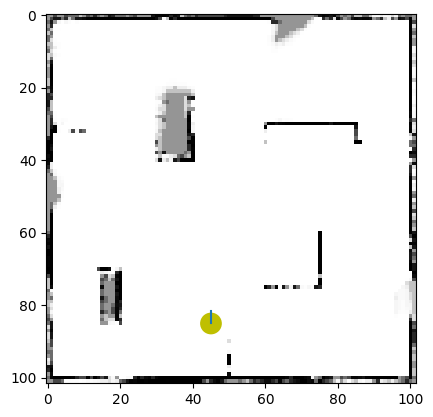

 83%|████████▎ | 627/759 [04:11<01:08,  1.92it/s]

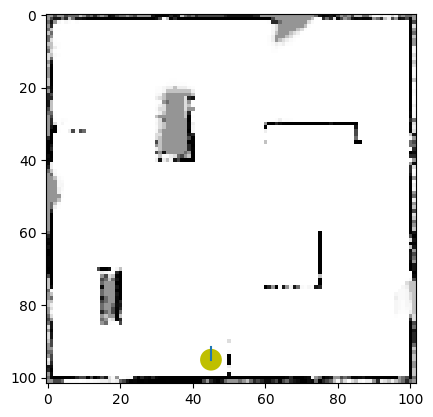

 83%|████████▎ | 628/759 [04:11<01:07,  1.95it/s]

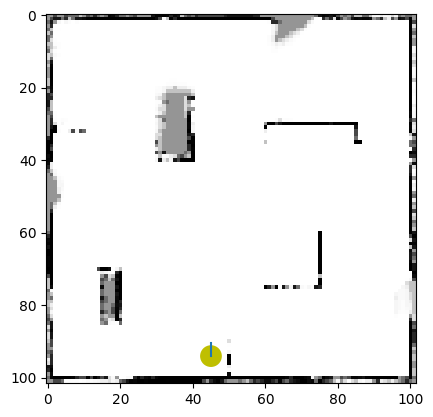

 83%|████████▎ | 629/759 [04:12<01:04,  2.01it/s]

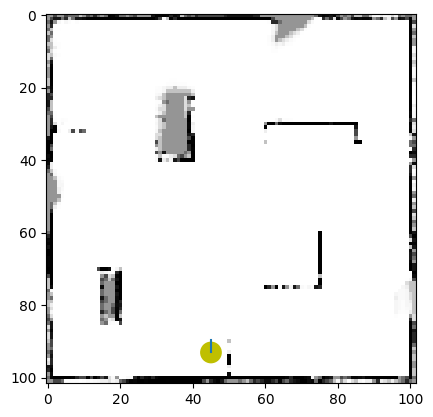

 83%|████████▎ | 630/759 [04:12<01:02,  2.06it/s]

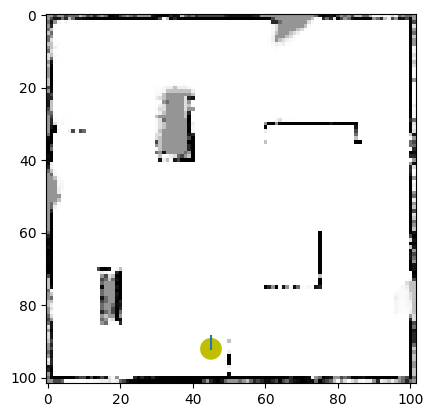

 83%|████████▎ | 631/759 [04:12<01:02,  2.03it/s]

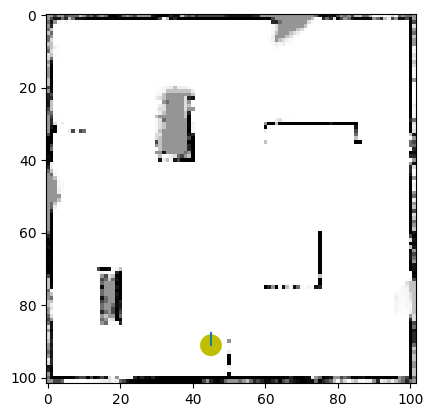

 83%|████████▎ | 632/759 [04:13<00:58,  2.15it/s]

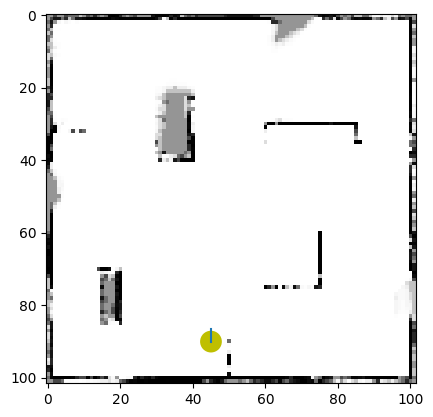

 83%|████████▎ | 633/759 [04:13<01:00,  2.08it/s]

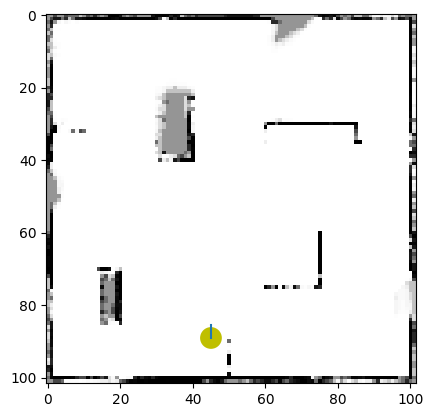

 84%|████████▎ | 634/759 [04:14<00:56,  2.23it/s]

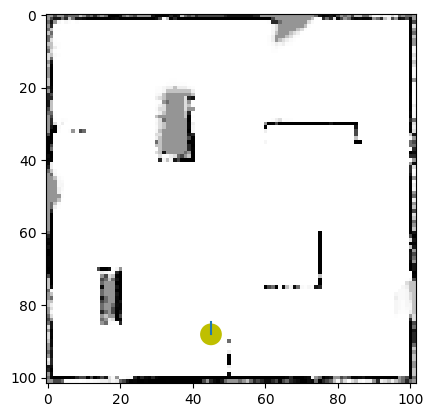

 84%|████████▎ | 635/759 [04:14<00:52,  2.36it/s]

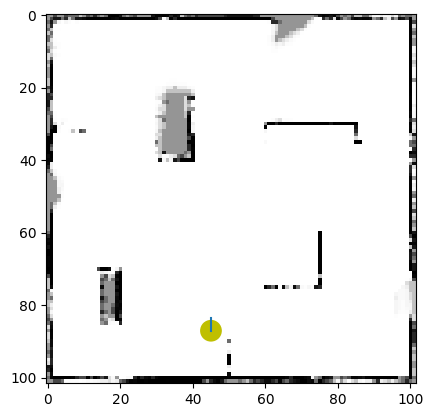

 84%|████████▍ | 636/759 [04:15<00:51,  2.40it/s]

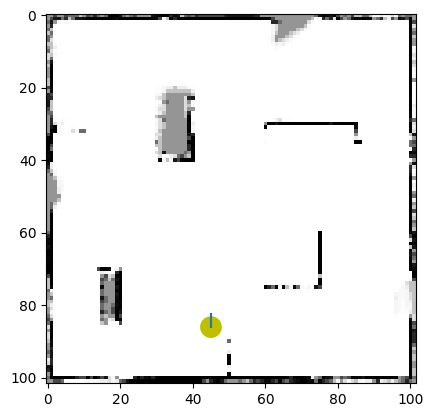

 84%|████████▍ | 637/759 [04:15<00:51,  2.38it/s]

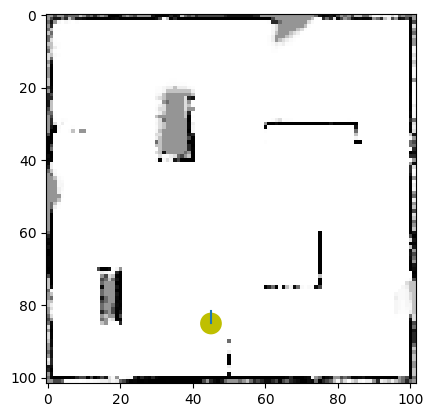

 84%|████████▍ | 638/759 [04:15<00:49,  2.44it/s]

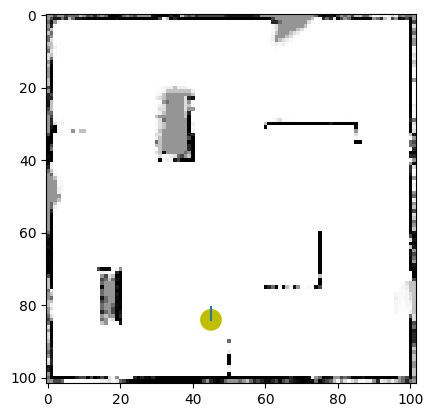

 84%|████████▍ | 639/759 [04:16<00:45,  2.61it/s]

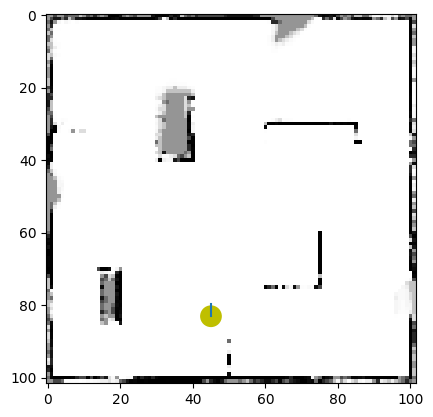

 84%|████████▍ | 640/759 [04:16<00:48,  2.45it/s]

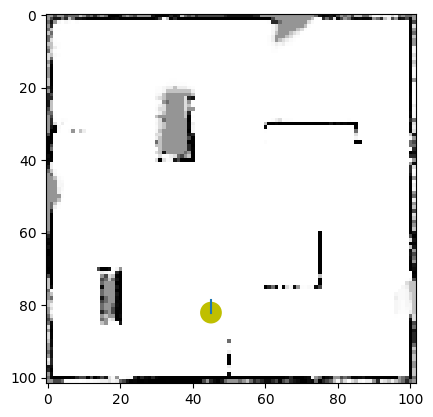

 84%|████████▍ | 641/759 [04:17<00:52,  2.26it/s]

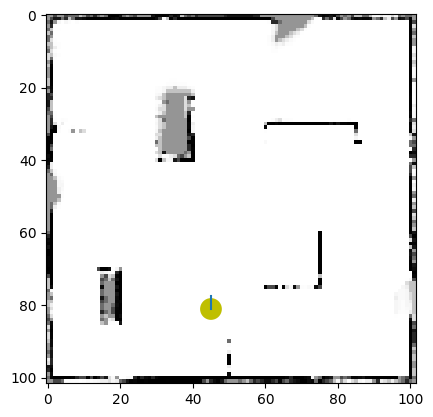

 85%|████████▍ | 642/759 [04:17<00:54,  2.14it/s]

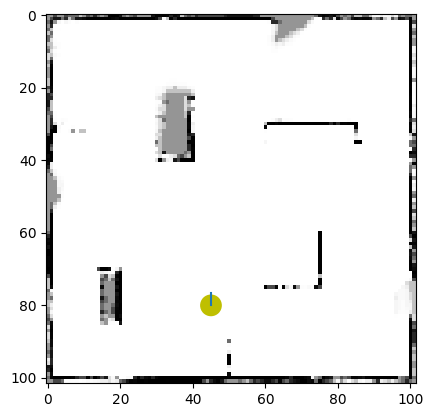

 85%|████████▍ | 643/759 [04:18<00:54,  2.12it/s]

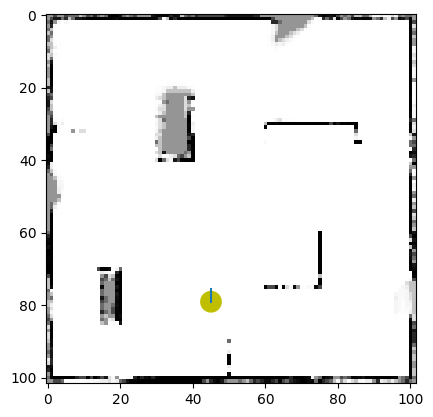

 85%|████████▍ | 644/759 [04:18<00:53,  2.15it/s]

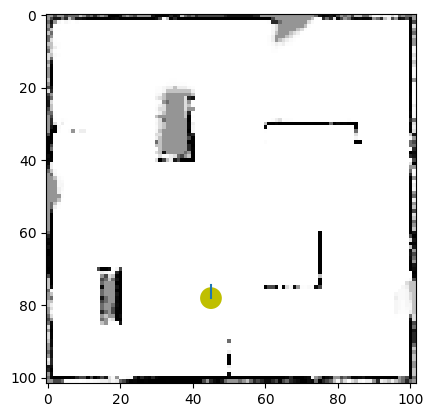

 85%|████████▍ | 645/759 [04:19<00:53,  2.14it/s]

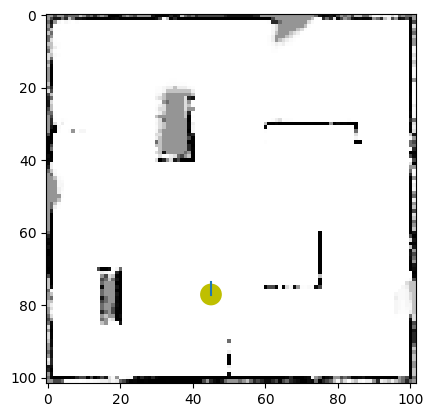

 85%|████████▌ | 646/759 [04:19<00:51,  2.18it/s]

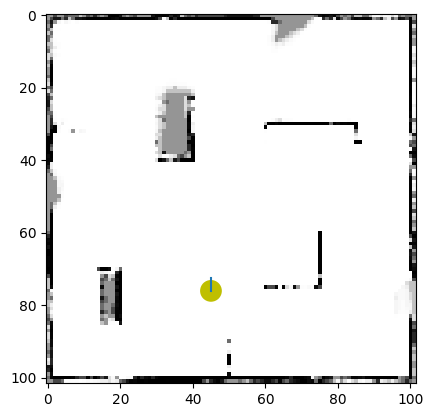

 85%|████████▌ | 647/759 [04:19<00:49,  2.26it/s]

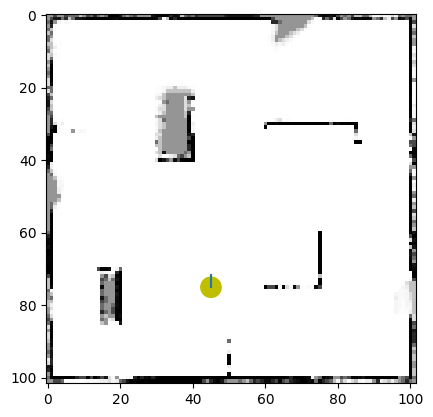

 85%|████████▌ | 648/759 [04:20<00:47,  2.35it/s]

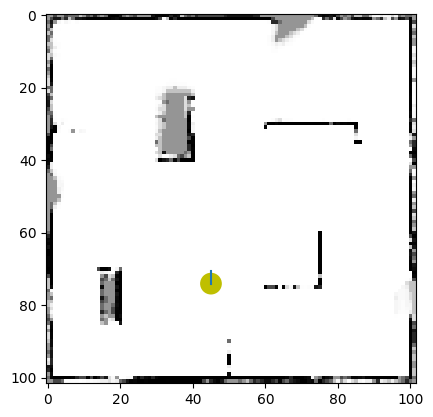

 86%|████████▌ | 649/759 [04:20<00:45,  2.42it/s]

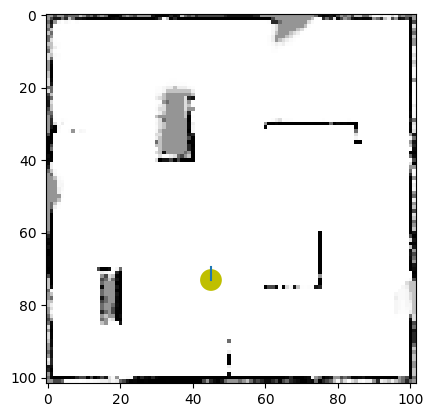

 86%|████████▌ | 650/759 [04:21<00:46,  2.33it/s]

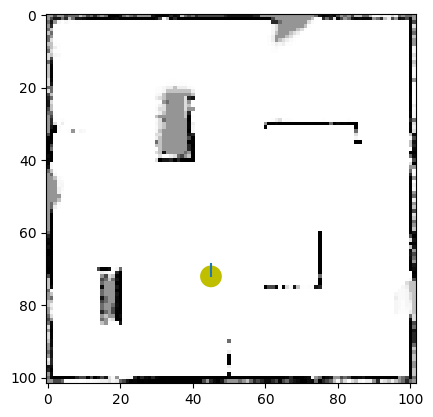

 86%|████████▌ | 651/759 [04:21<00:46,  2.32it/s]

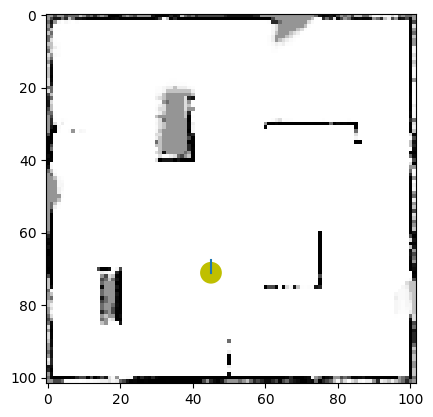

 86%|████████▌ | 652/759 [04:22<00:49,  2.14it/s]

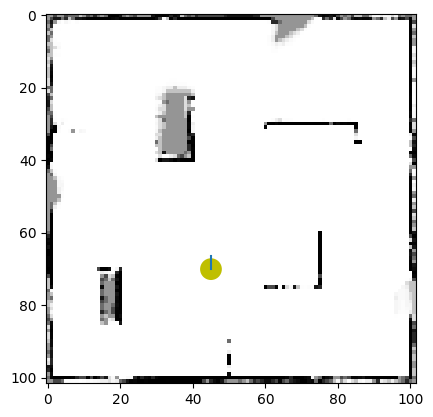

 86%|████████▌ | 653/759 [04:22<00:50,  2.10it/s]

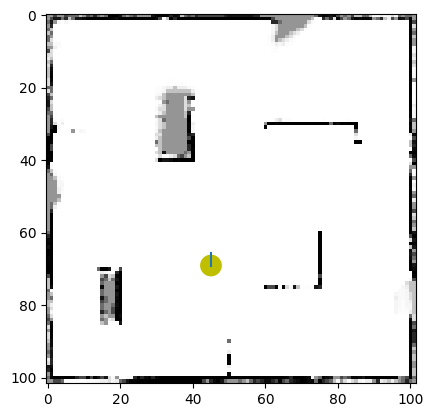

 86%|████████▌ | 654/759 [04:23<00:52,  2.02it/s]

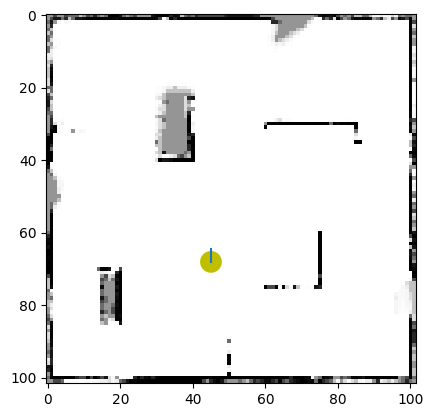

 86%|████████▋ | 655/759 [04:23<00:51,  2.02it/s]

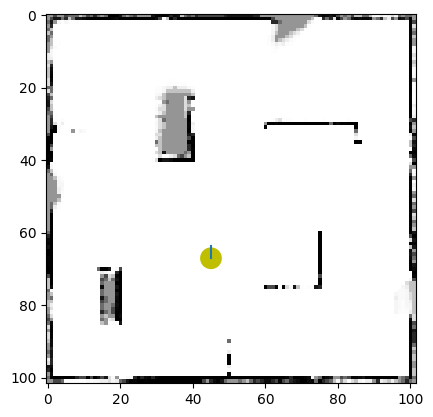

 86%|████████▋ | 656/759 [04:24<00:48,  2.13it/s]

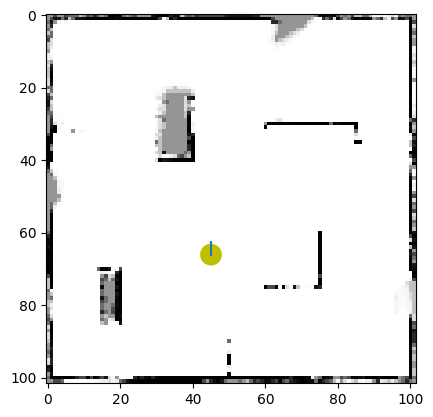

 87%|████████▋ | 657/759 [04:24<00:47,  2.15it/s]

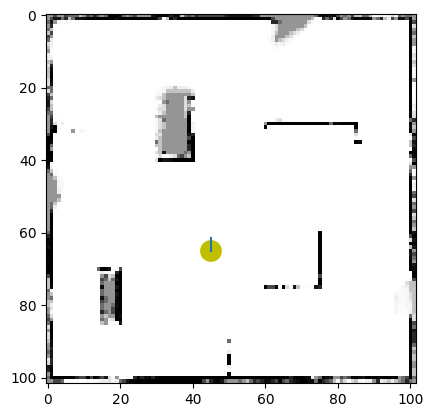

 87%|████████▋ | 658/759 [04:24<00:45,  2.24it/s]

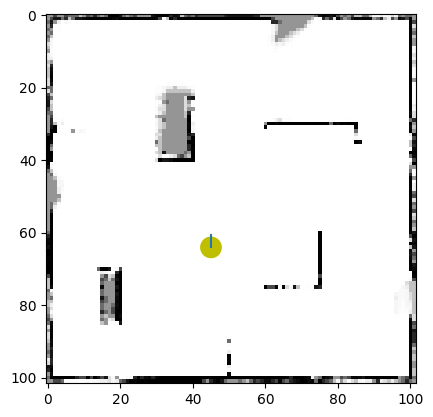

 87%|████████▋ | 659/759 [04:25<00:42,  2.36it/s]

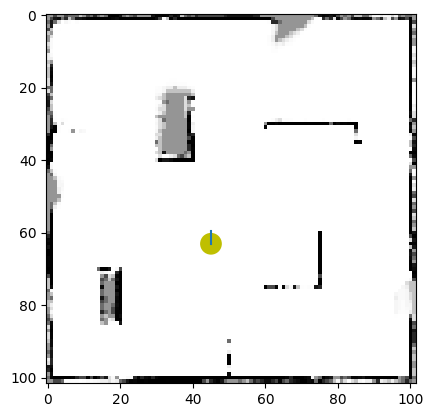

 87%|████████▋ | 660/759 [04:25<00:40,  2.44it/s]

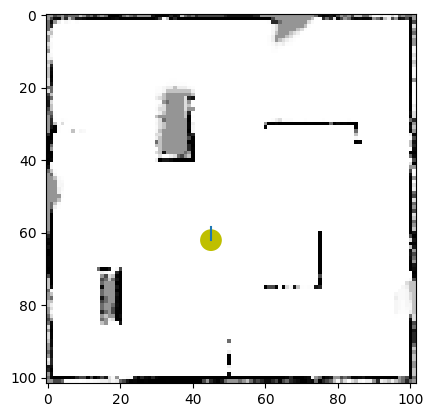

 87%|████████▋ | 661/759 [04:26<00:39,  2.50it/s]

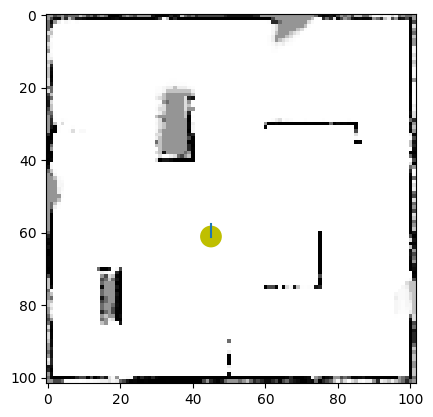

 87%|████████▋ | 662/759 [04:26<00:38,  2.53it/s]

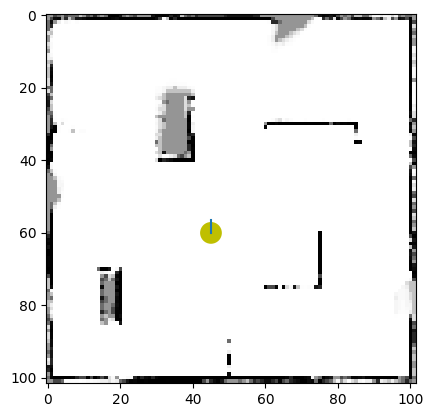

 87%|████████▋ | 663/759 [04:26<00:37,  2.56it/s]

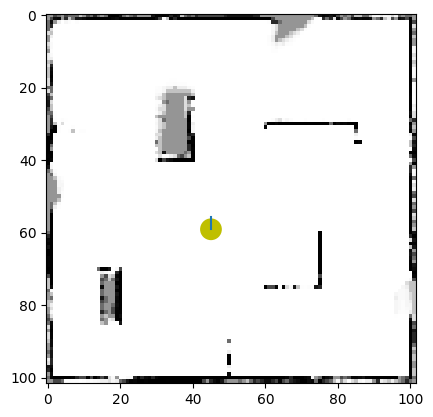

 87%|████████▋ | 664/759 [04:27<00:39,  2.42it/s]

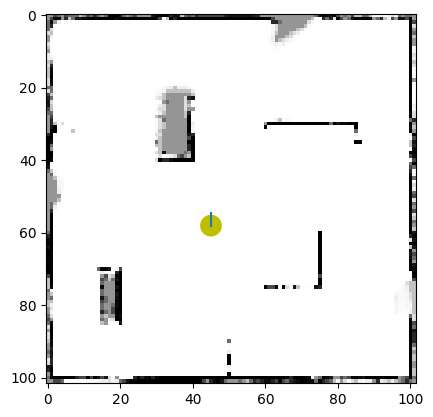

 88%|████████▊ | 665/759 [04:27<00:41,  2.25it/s]

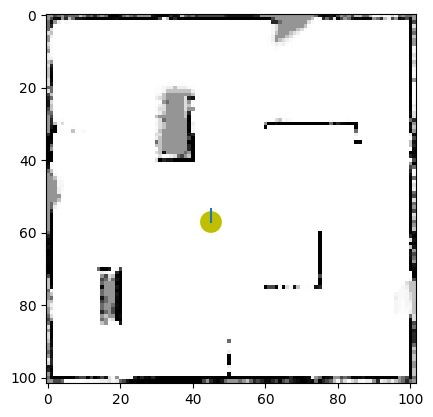

 88%|████████▊ | 666/759 [04:28<00:42,  2.20it/s]

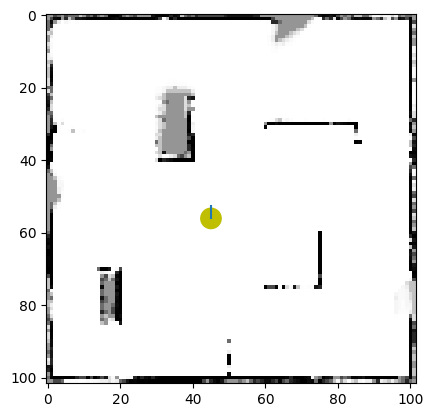

 88%|████████▊ | 667/759 [04:28<00:43,  2.11it/s]

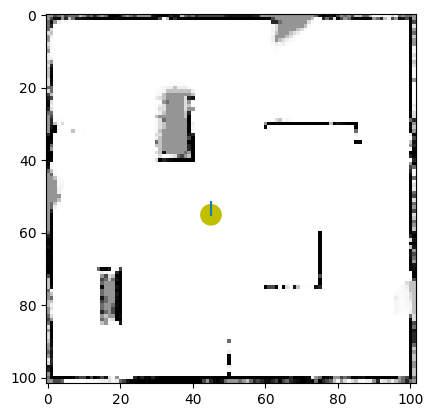

 88%|████████▊ | 668/759 [04:29<00:43,  2.08it/s]

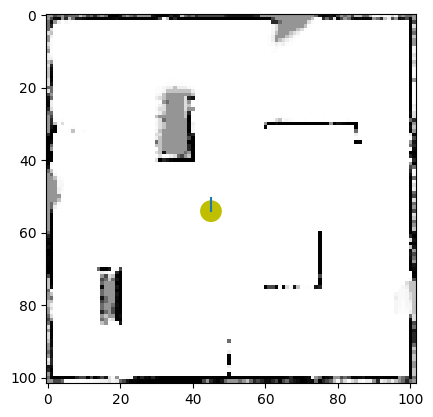

 88%|████████▊ | 669/759 [04:29<00:44,  2.04it/s]

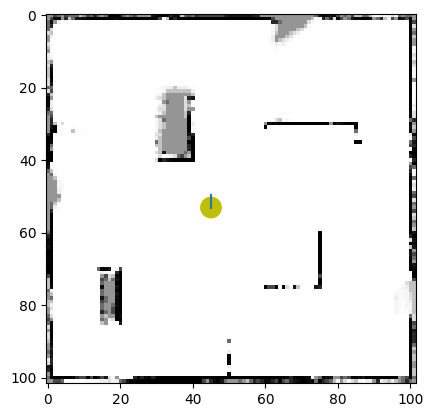

 88%|████████▊ | 670/759 [04:30<00:40,  2.20it/s]

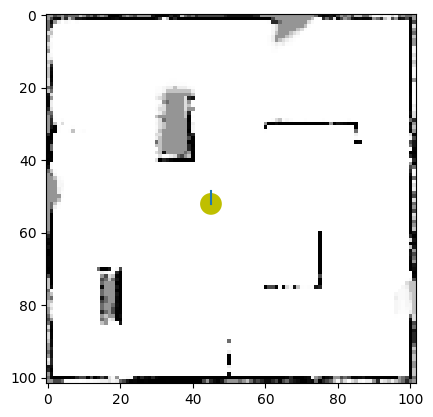

 88%|████████▊ | 671/759 [04:30<00:40,  2.15it/s]

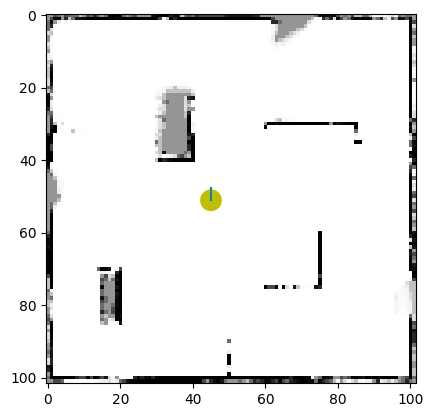

 89%|████████▊ | 672/759 [04:31<00:41,  2.10it/s]

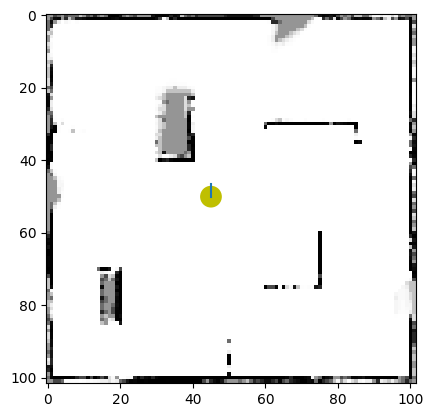

 89%|████████▊ | 673/759 [04:31<00:38,  2.23it/s]

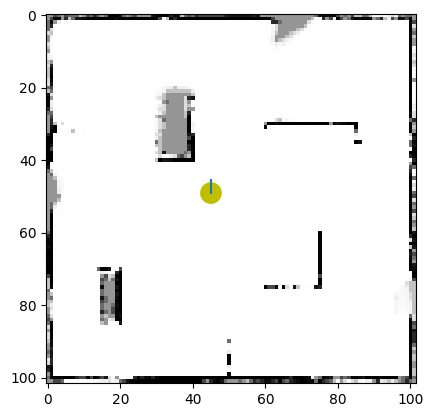

 89%|████████▉ | 674/759 [04:32<00:39,  2.16it/s]

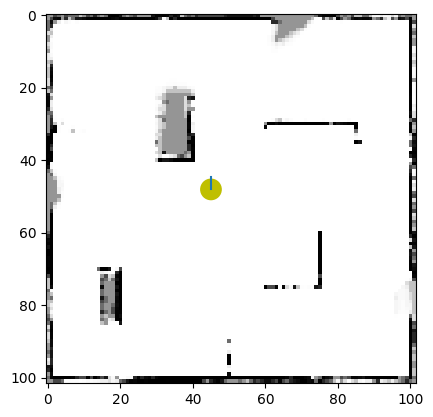

 89%|████████▉ | 675/759 [04:32<00:37,  2.24it/s]

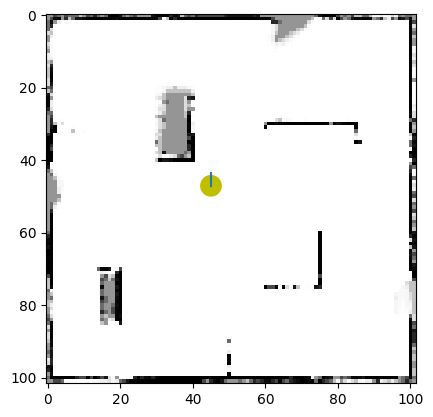

 89%|████████▉ | 676/759 [04:32<00:36,  2.25it/s]

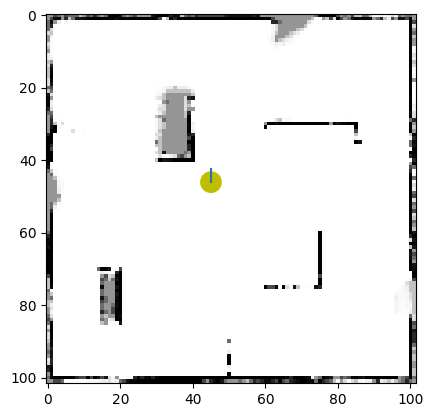

 89%|████████▉ | 677/759 [04:33<00:37,  2.18it/s]

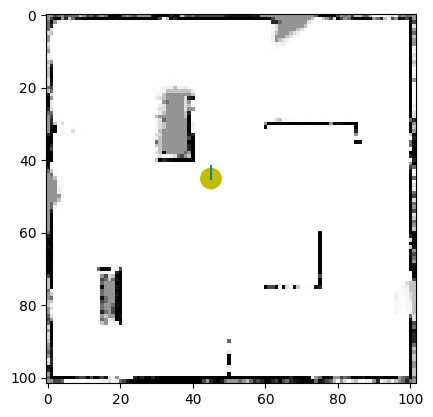

 89%|████████▉ | 678/759 [04:33<00:38,  2.11it/s]

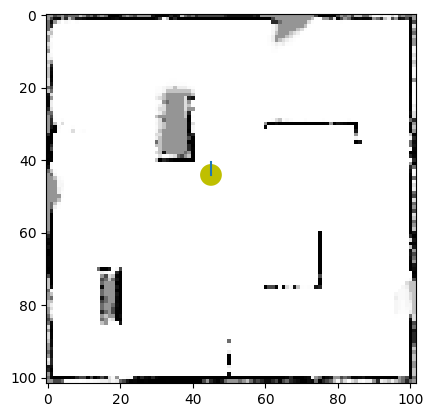

 89%|████████▉ | 679/759 [04:34<00:40,  1.96it/s]

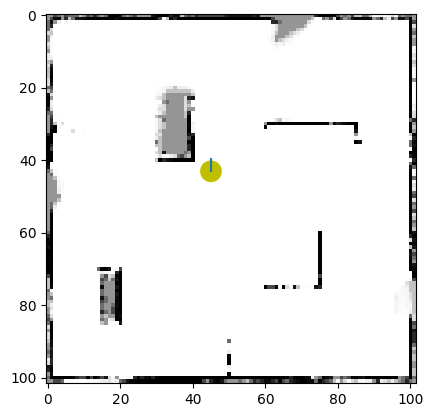

 90%|████████▉ | 680/759 [04:34<00:36,  2.17it/s]

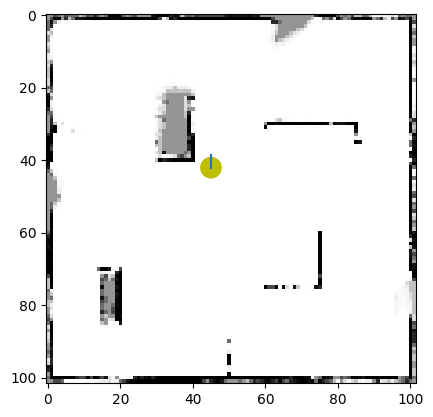

 90%|████████▉ | 681/759 [04:35<00:36,  2.14it/s]

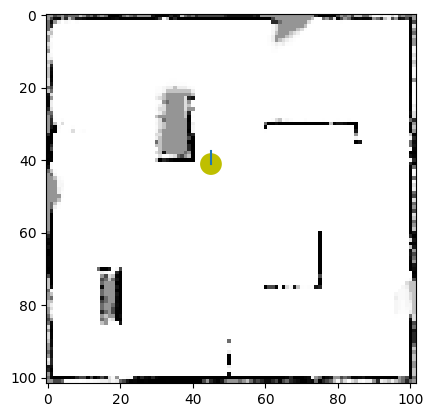

 90%|████████▉ | 682/759 [04:35<00:35,  2.16it/s]

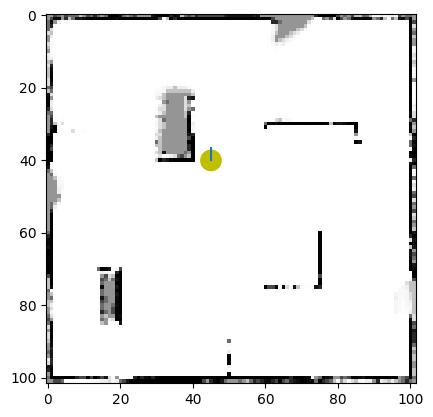

 90%|████████▉ | 683/759 [04:36<00:42,  1.78it/s]

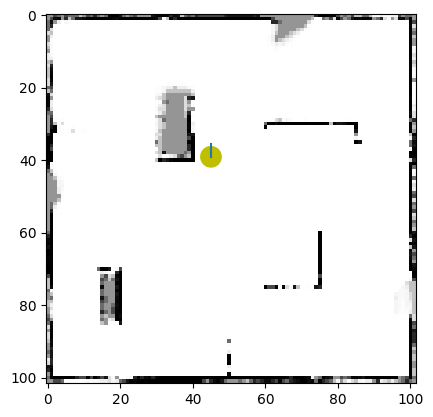

 90%|█████████ | 684/759 [04:37<00:51,  1.46it/s]

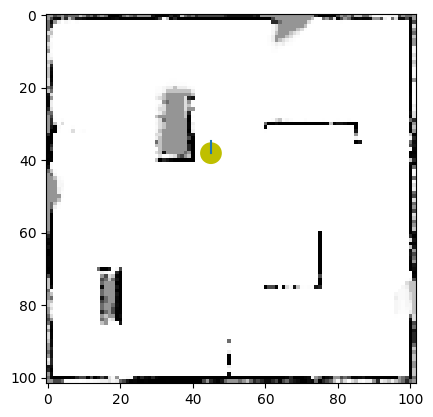

 90%|█████████ | 685/759 [04:38<00:53,  1.39it/s]

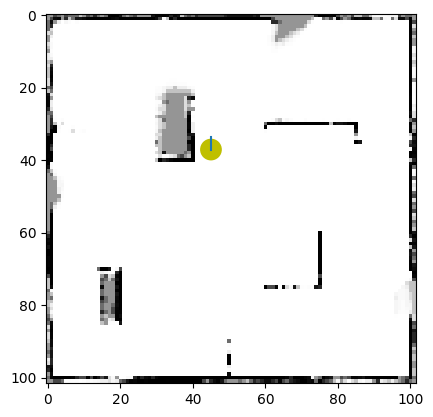

 90%|█████████ | 686/759 [04:39<00:50,  1.43it/s]

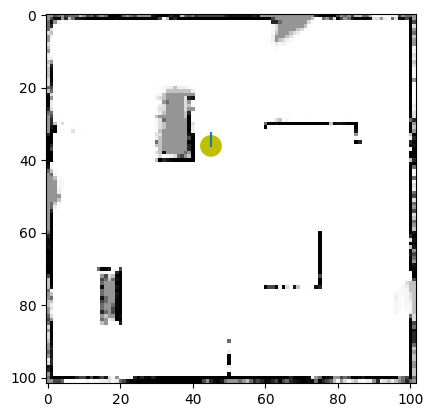

 91%|█████████ | 687/759 [04:39<00:53,  1.34it/s]

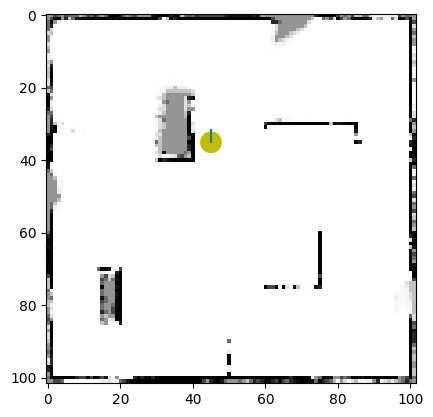

 91%|█████████ | 688/759 [04:40<00:52,  1.36it/s]

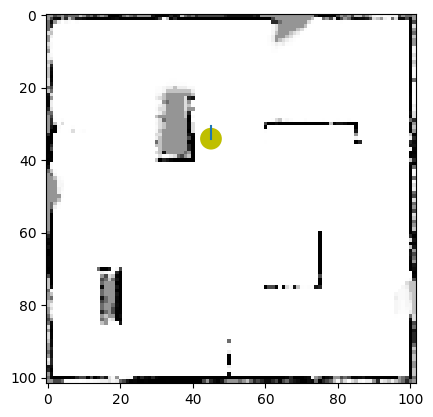

 91%|█████████ | 689/759 [04:41<00:47,  1.46it/s]

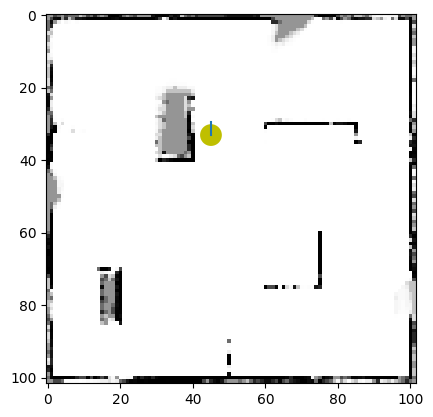

 91%|█████████ | 690/759 [04:41<00:46,  1.47it/s]

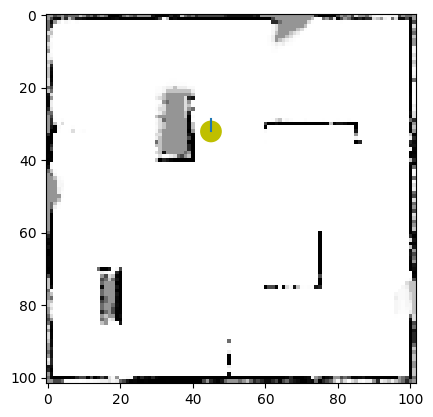

 91%|█████████ | 691/759 [04:42<00:44,  1.53it/s]

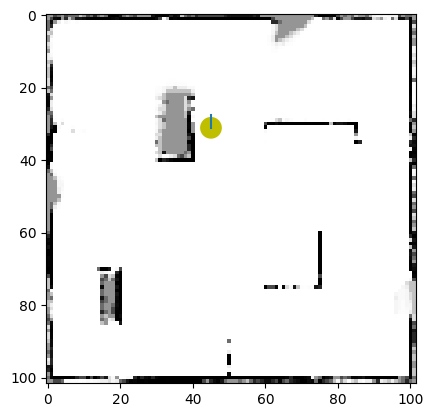

 91%|█████████ | 692/759 [04:43<00:45,  1.49it/s]

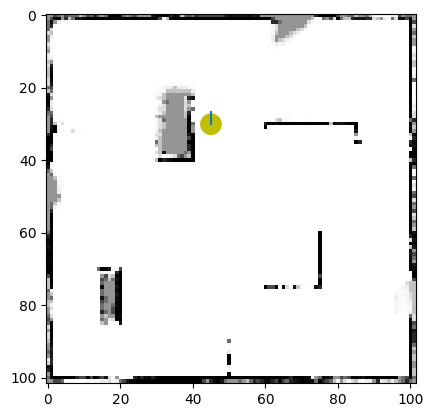

 91%|█████████▏| 693/759 [04:43<00:39,  1.67it/s]

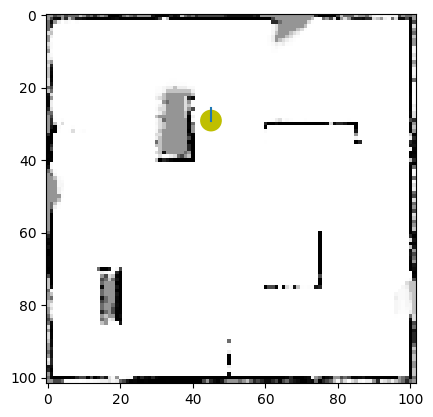

 91%|█████████▏| 694/759 [04:43<00:34,  1.90it/s]

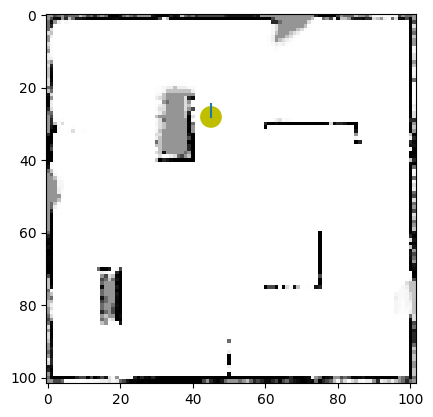

 92%|█████████▏| 695/759 [04:44<00:31,  2.05it/s]

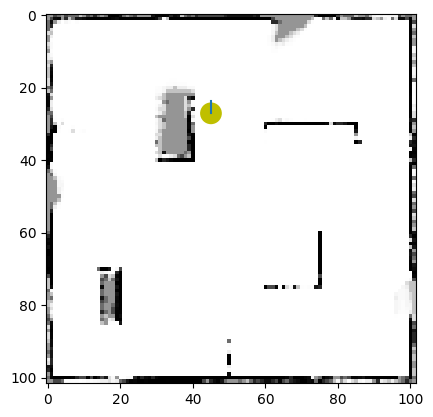

 92%|█████████▏| 696/759 [04:44<00:30,  2.08it/s]

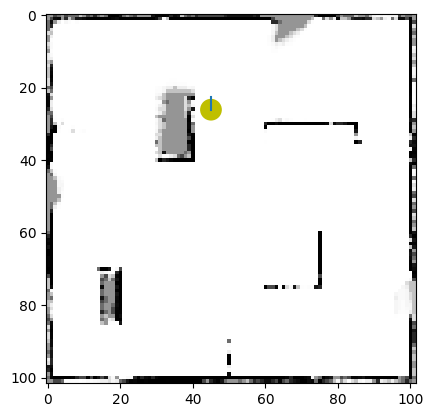

 92%|█████████▏| 697/759 [04:45<00:28,  2.20it/s]

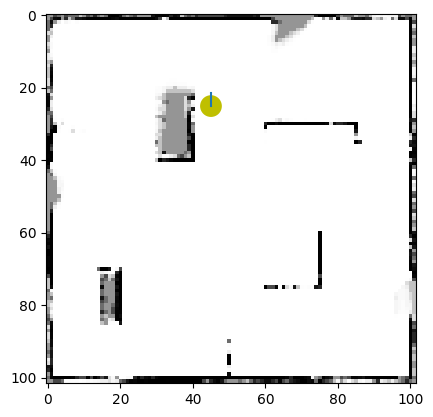

 92%|█████████▏| 698/759 [04:45<00:26,  2.34it/s]

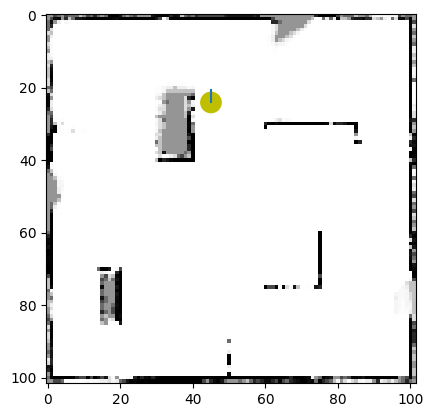

 92%|█████████▏| 699/759 [04:45<00:24,  2.41it/s]

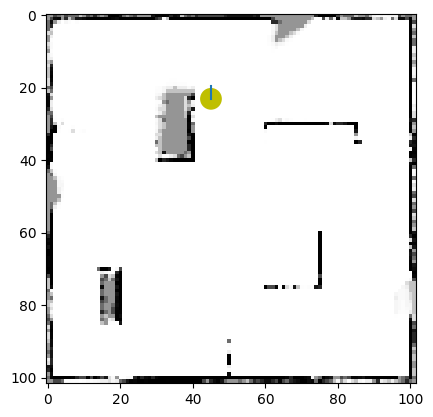

 92%|█████████▏| 700/759 [04:46<00:23,  2.47it/s]

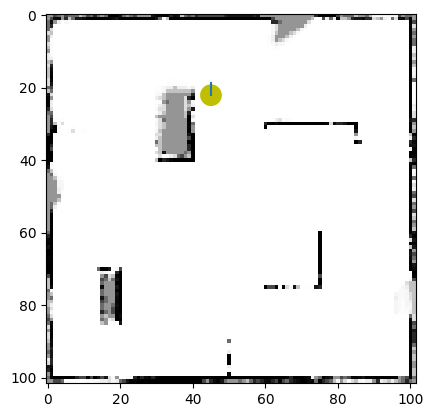

 92%|█████████▏| 701/759 [04:46<00:25,  2.27it/s]

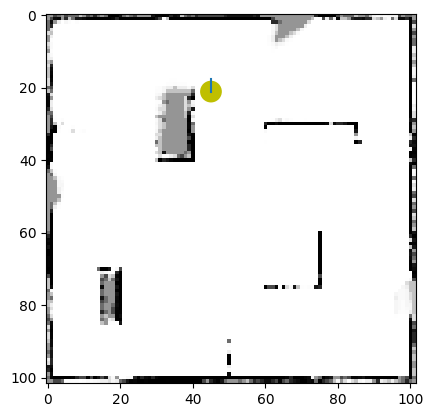

 92%|█████████▏| 702/759 [04:47<00:25,  2.25it/s]

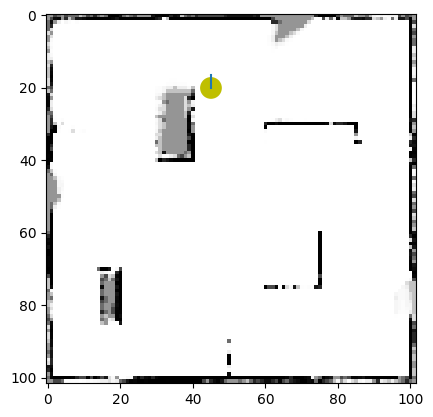

 93%|█████████▎| 703/759 [04:47<00:25,  2.17it/s]

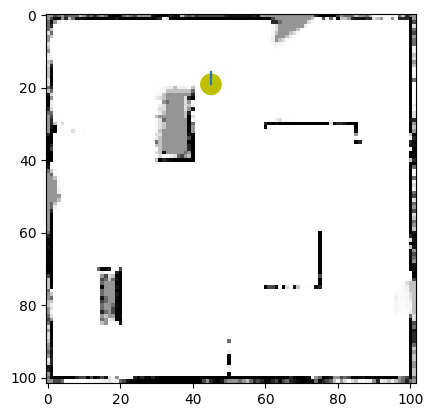

 93%|█████████▎| 704/759 [04:48<00:24,  2.23it/s]

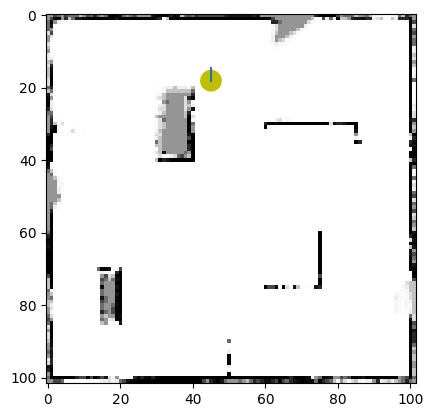

 93%|█████████▎| 705/759 [04:48<00:24,  2.18it/s]

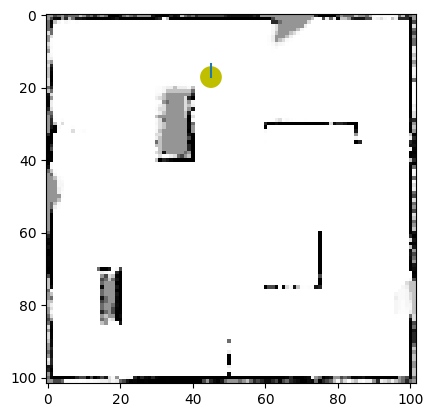

 93%|█████████▎| 706/759 [04:49<00:24,  2.18it/s]

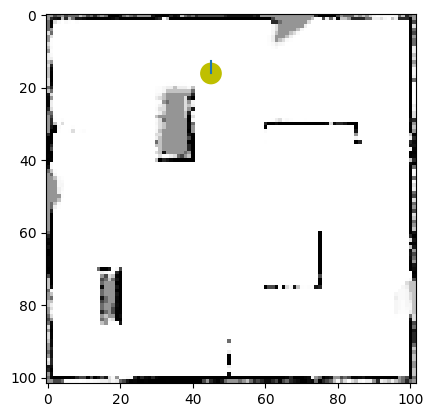

 93%|█████████▎| 707/759 [04:49<00:25,  2.01it/s]

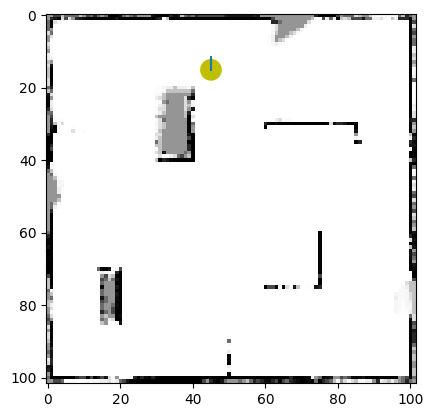

 93%|█████████▎| 708/759 [04:50<00:25,  2.00it/s]

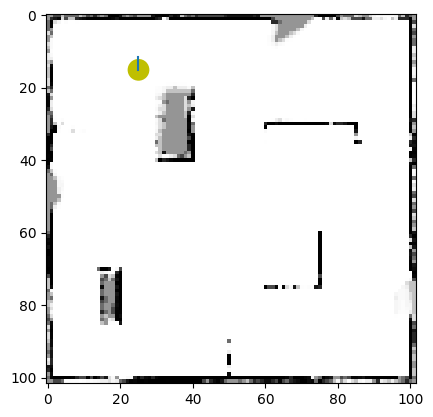

 93%|█████████▎| 709/759 [04:50<00:24,  2.04it/s]

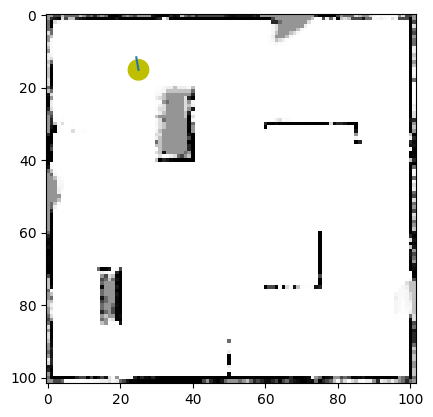

 94%|█████████▎| 710/759 [04:51<00:22,  2.21it/s]

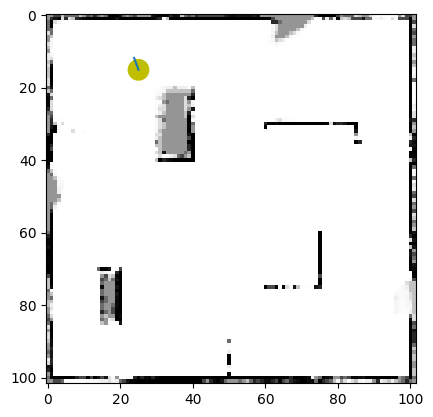

 94%|█████████▎| 711/759 [04:51<00:23,  2.08it/s]

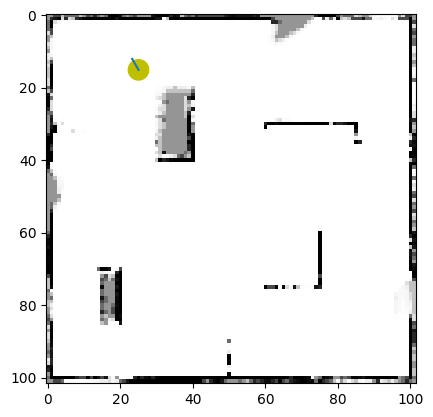

 94%|█████████▍| 712/759 [04:52<00:21,  2.16it/s]

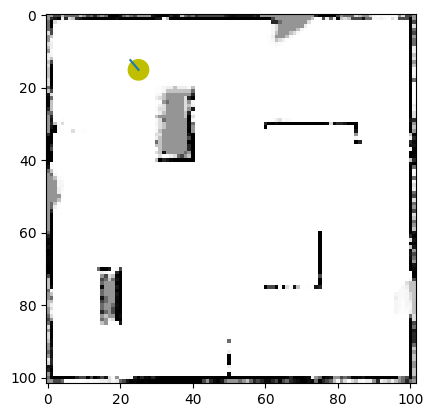

 94%|█████████▍| 713/759 [04:52<00:22,  2.08it/s]

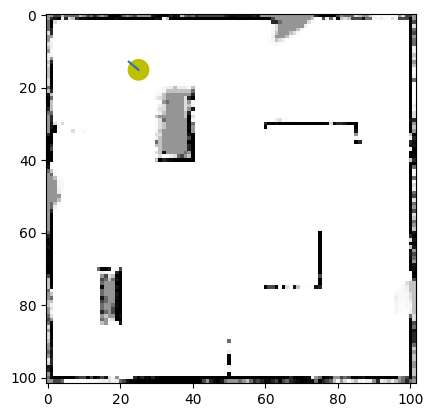

 94%|█████████▍| 714/759 [04:53<00:21,  2.09it/s]

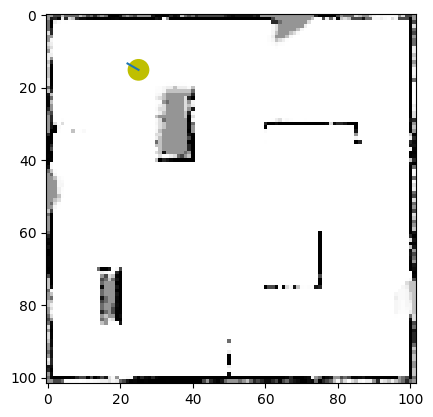

 94%|█████████▍| 715/759 [04:53<00:20,  2.10it/s]

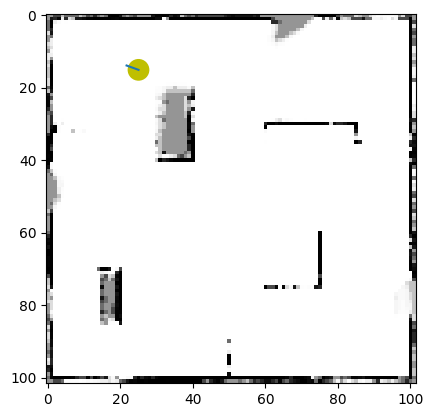

 94%|█████████▍| 716/759 [04:53<00:19,  2.15it/s]

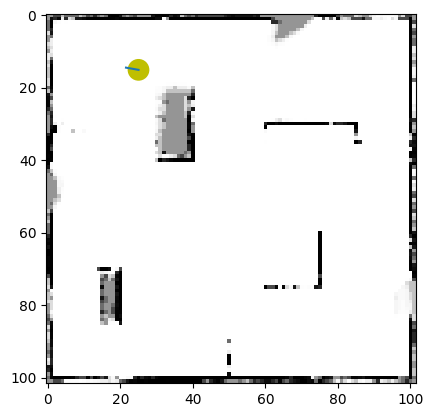

 94%|█████████▍| 717/759 [04:54<00:18,  2.31it/s]

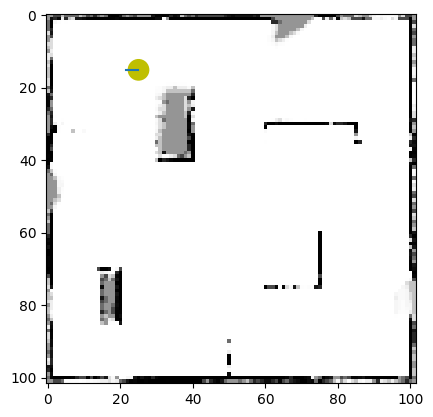

 95%|█████████▍| 718/759 [04:54<00:17,  2.36it/s]

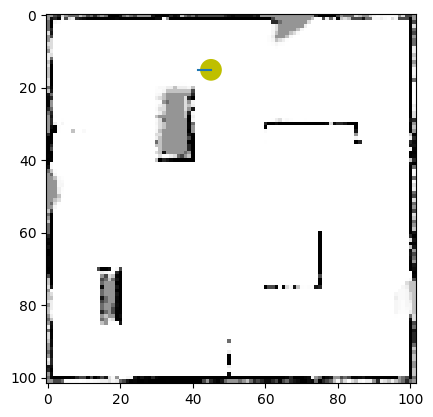

 95%|█████████▍| 719/759 [04:55<00:18,  2.21it/s]

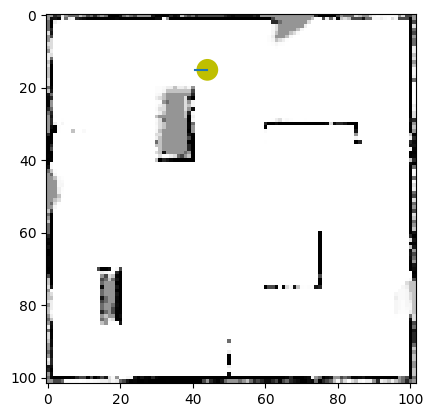

 95%|█████████▍| 720/759 [04:55<00:17,  2.28it/s]

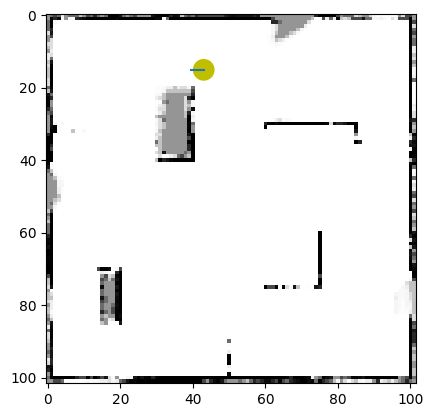

 95%|█████████▍| 721/759 [04:56<00:17,  2.19it/s]

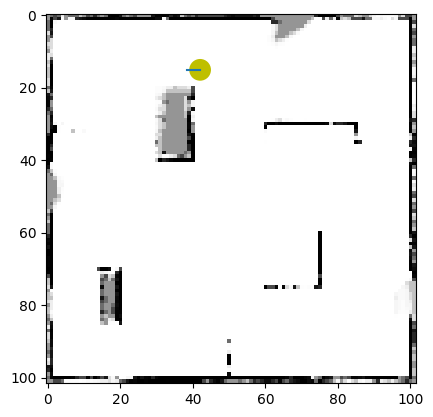

 95%|█████████▌| 722/759 [04:56<00:17,  2.10it/s]

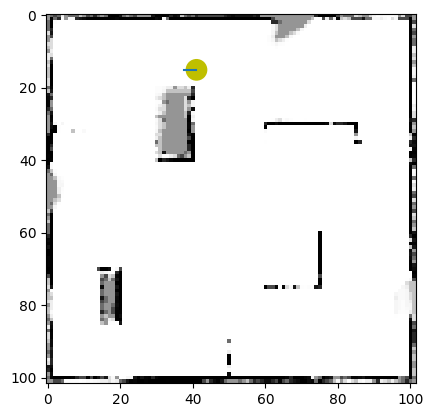

 95%|█████████▌| 723/759 [04:57<00:18,  1.93it/s]

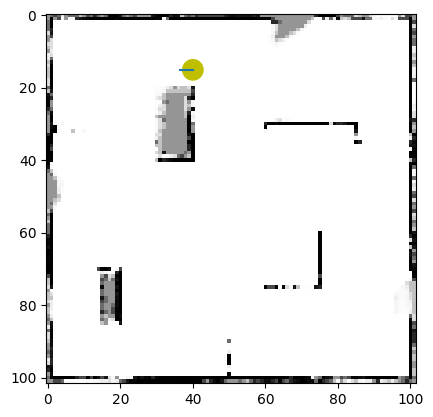

 95%|█████████▌| 724/759 [04:57<00:17,  2.02it/s]

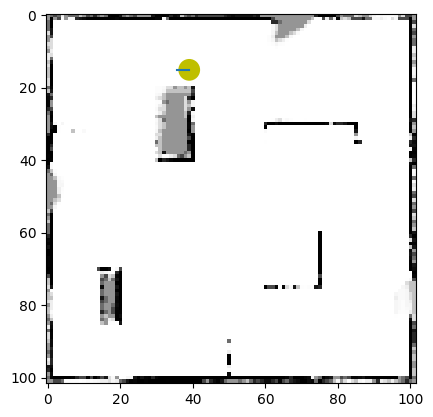

 96%|█████████▌| 725/759 [04:58<00:16,  2.04it/s]

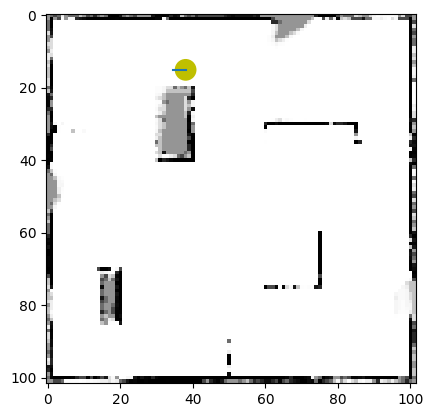

 96%|█████████▌| 726/759 [04:58<00:16,  2.06it/s]

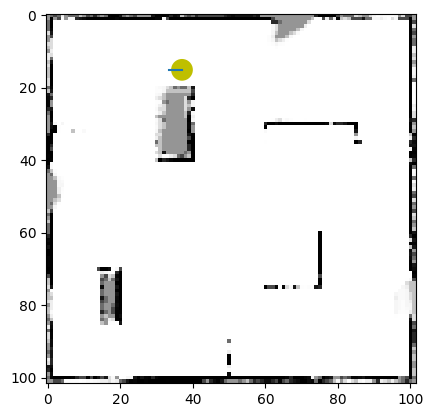

 96%|█████████▌| 727/759 [04:59<00:15,  2.11it/s]

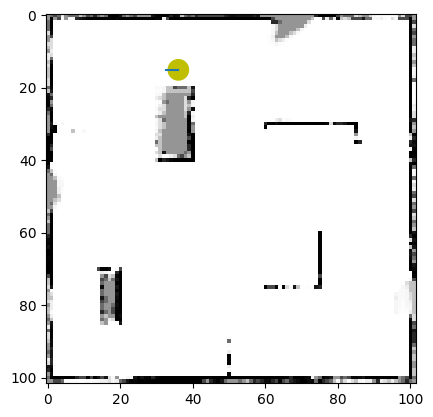

 96%|█████████▌| 728/759 [04:59<00:14,  2.10it/s]

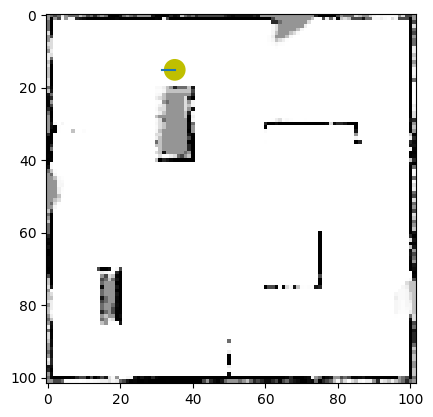

 96%|█████████▌| 729/759 [05:00<00:15,  1.93it/s]

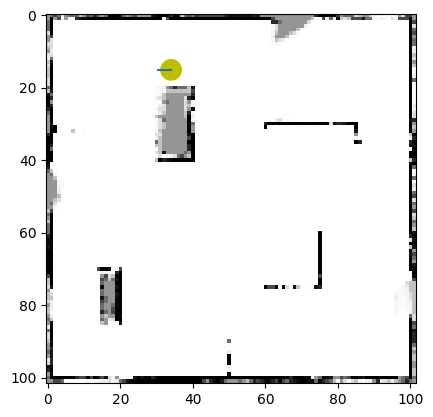

 96%|█████████▌| 730/759 [05:00<00:14,  1.97it/s]

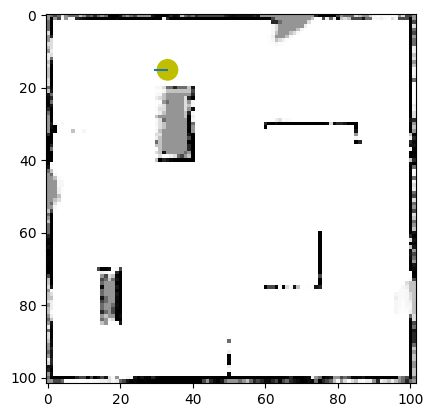

 96%|█████████▋| 731/759 [05:01<00:13,  2.00it/s]

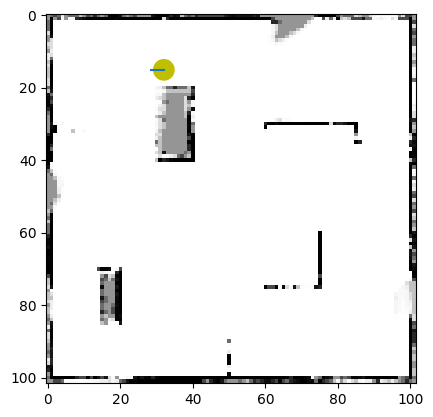

 96%|█████████▋| 732/759 [05:01<00:13,  1.93it/s]

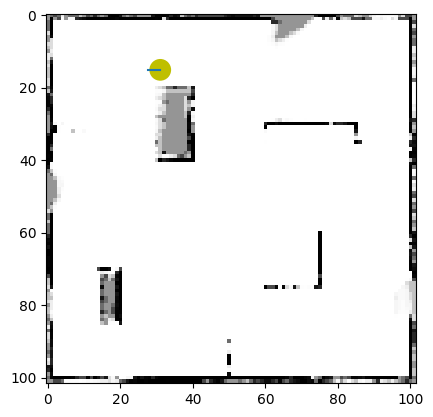

 97%|█████████▋| 733/759 [05:02<00:13,  1.95it/s]

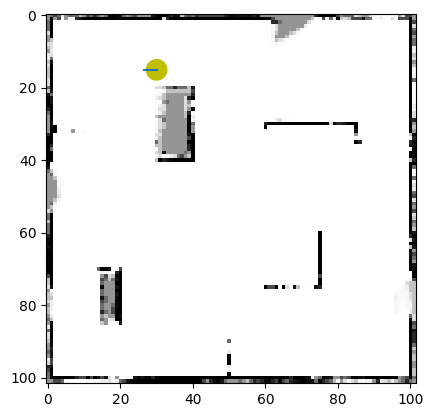

 97%|█████████▋| 734/759 [05:02<00:12,  2.02it/s]

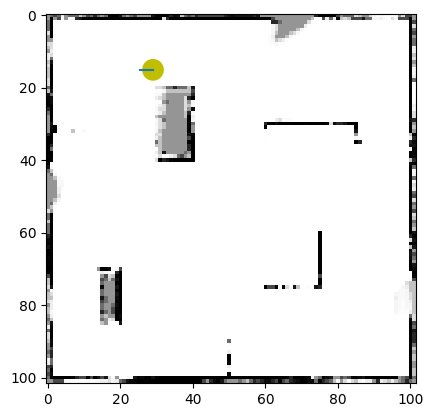

 97%|█████████▋| 735/759 [05:03<00:12,  1.95it/s]

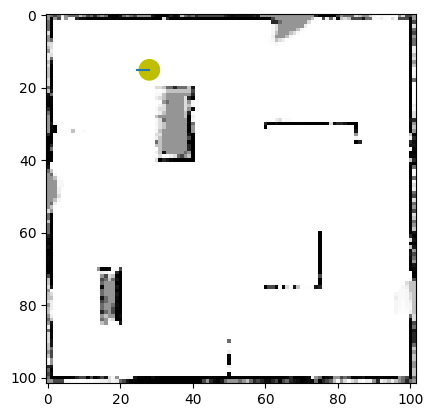

 97%|█████████▋| 736/759 [05:03<00:11,  2.02it/s]

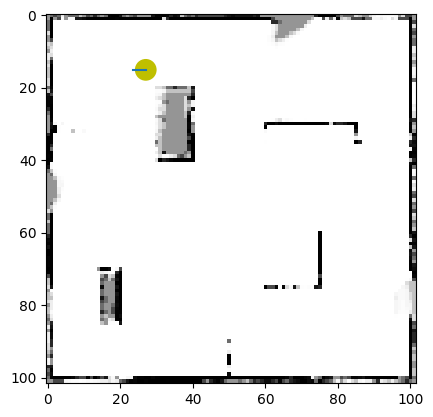

 97%|█████████▋| 737/759 [05:03<00:09,  2.29it/s]

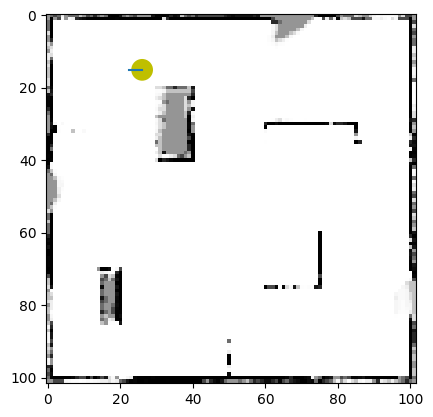

 97%|█████████▋| 738/759 [05:04<00:09,  2.17it/s]

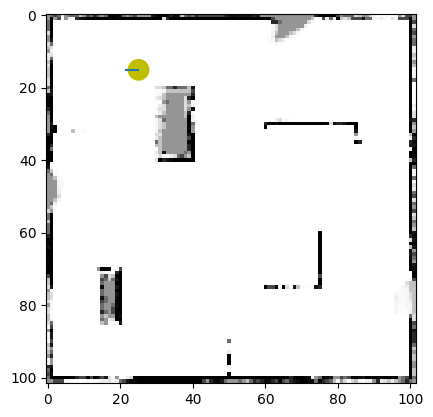

 97%|█████████▋| 739/759 [05:04<00:08,  2.35it/s]

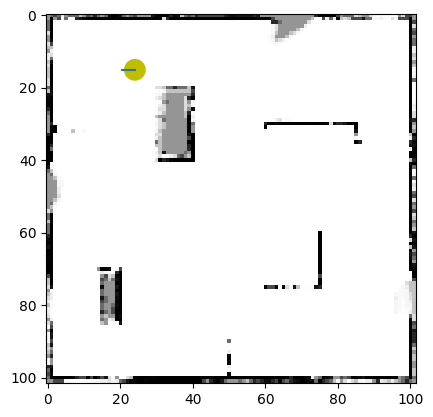

 97%|█████████▋| 740/759 [05:05<00:08,  2.24it/s]

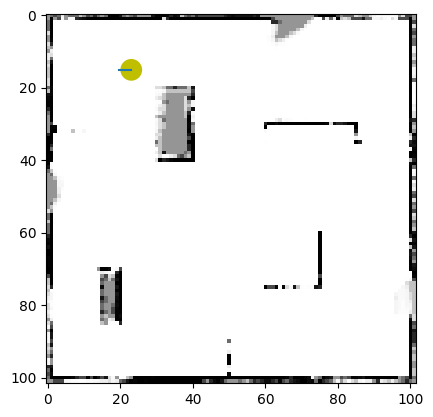

 98%|█████████▊| 741/759 [05:05<00:08,  2.07it/s]

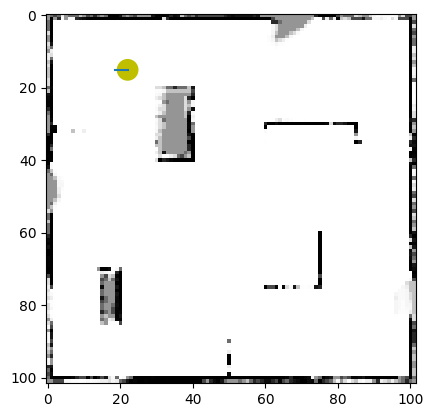

 98%|█████████▊| 742/759 [05:06<00:08,  2.06it/s]

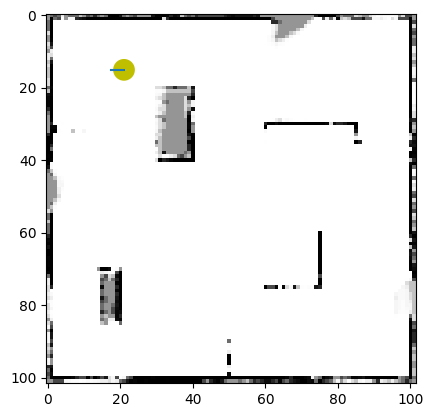

 98%|█████████▊| 743/759 [05:06<00:08,  1.93it/s]

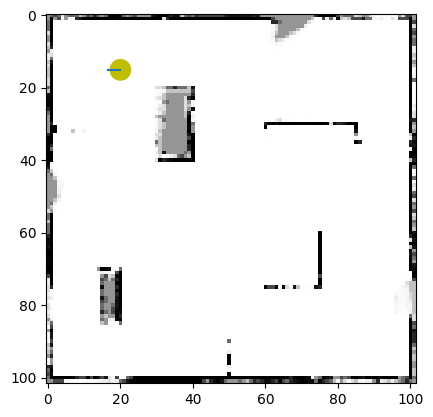

 98%|█████████▊| 744/759 [05:07<00:07,  2.09it/s]

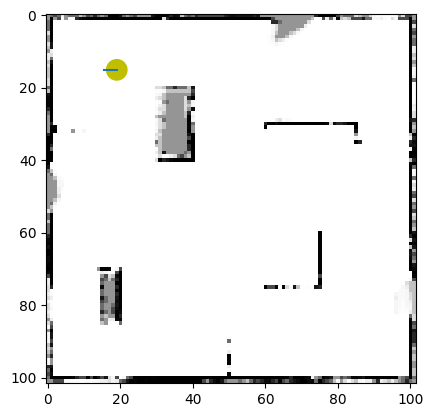

 98%|█████████▊| 745/759 [05:07<00:07,  1.96it/s]

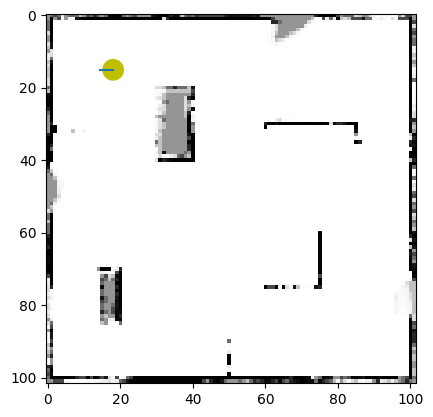

 98%|█████████▊| 746/759 [05:08<00:06,  1.96it/s]

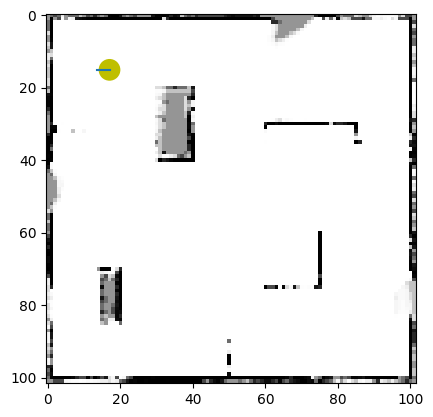

 98%|█████████▊| 747/759 [05:08<00:06,  1.97it/s]

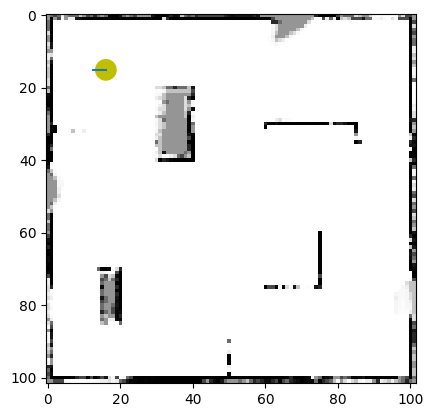

 99%|█████████▊| 748/759 [05:09<00:05,  1.95it/s]

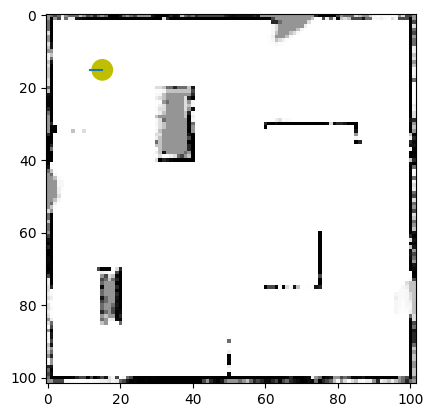

 99%|█████████▊| 749/759 [05:10<00:05,  1.93it/s]

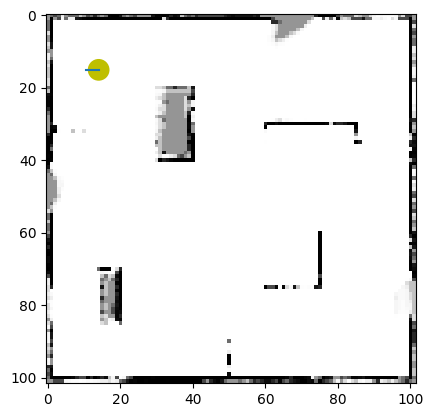

 99%|█████████▉| 750/759 [05:10<00:04,  1.95it/s]

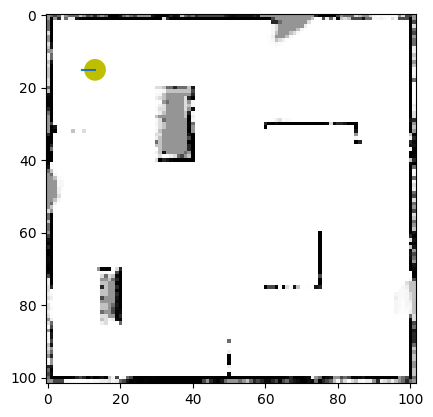

 99%|█████████▉| 751/759 [05:11<00:04,  1.88it/s]

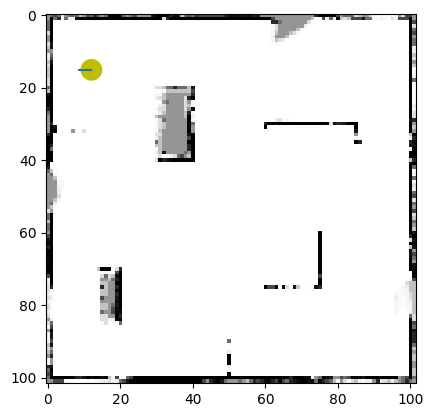

 99%|█████████▉| 752/759 [05:11<00:03,  2.05it/s]

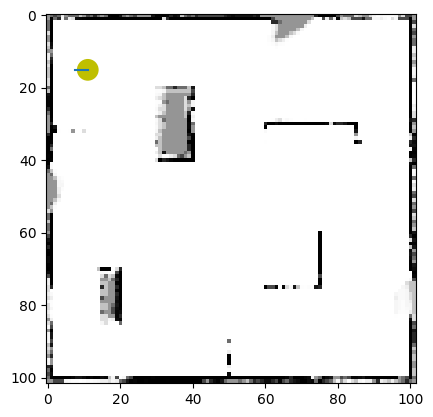

 99%|█████████▉| 753/759 [05:11<00:02,  2.06it/s]

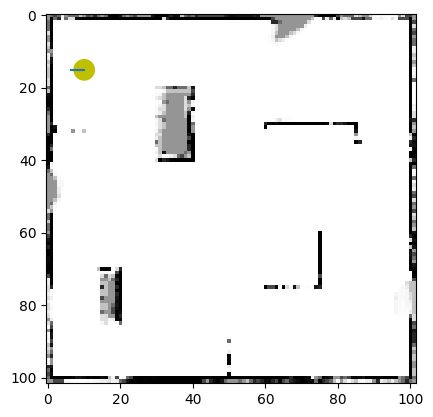

 99%|█████████▉| 754/759 [05:12<00:02,  2.08it/s]

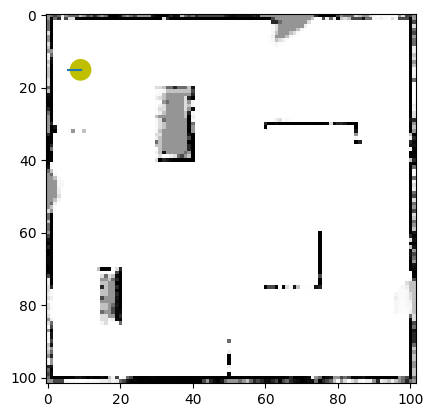

 99%|█████████▉| 755/759 [05:12<00:01,  2.04it/s]

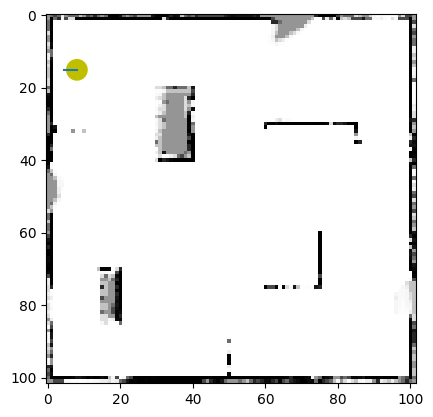

100%|█████████▉| 756/759 [05:13<00:01,  2.04it/s]

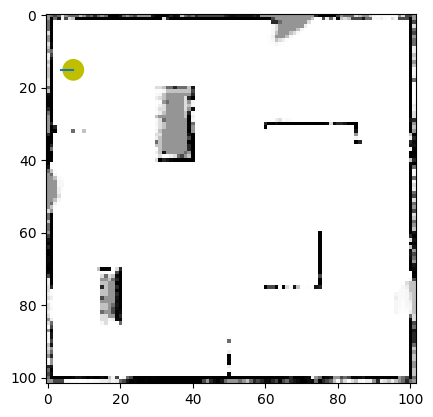

100%|█████████▉| 757/759 [05:13<00:00,  2.15it/s]

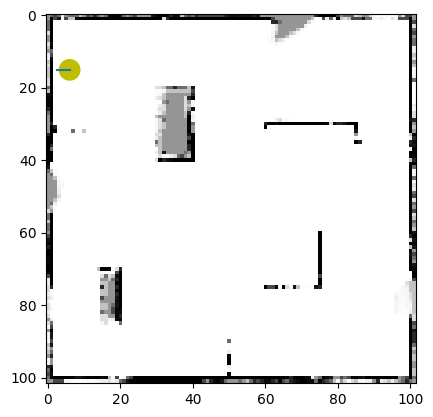

100%|█████████▉| 758/759 [05:14<00:00,  2.11it/s]

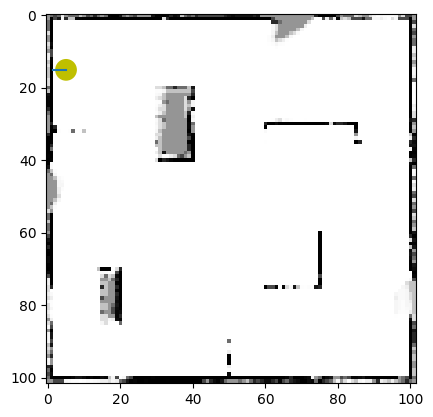

100%|██████████| 759/759 [05:14<00:00,  2.41it/s]


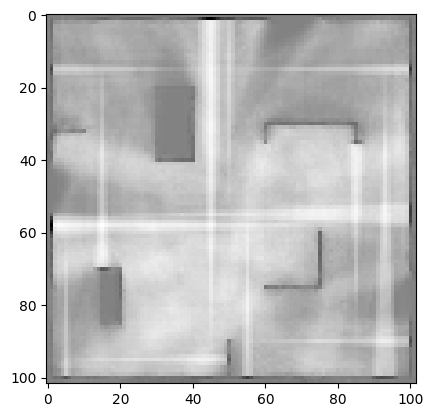

In [7]:
if __name__ == '__main__':
    
    # carichiamo stato e misurazioni sensoriali
    # load matlab generated data (located at https://gitlab.magiccvs.byu.edu/superjax/595R/blob/88a577579a75dc744bca7630716211334e04a528/lab6/state_meas_data.mat?)
    data = scipy.io.loadmat('state_meas_data.mat')
    state = data['X']
    meas = data['z']

    # definiamo i parametri della mappa costruendo una mappa 100x100 con celle 1x1
    grid_size = 1.0
    map = Map(int(100/grid_size), int(100/grid_size), grid_size)

    plt.ion() # enable real-time plotting
    plt.figure(1) # create a plot
    #per ogni stato della mappa(posizione del robot) carica, aggiorna la mappa 
    for i in tqdm(range(len(state.T))): #tqdm è una libreria che genera automaticamente una barra di caricamento
        map.update_map(state[:,i], meas[:,:,i].T) # update the map

        # Real-Time Plotting 
        # (comment out these next lines to make it run super fast, matplotlib is painfully slow)
        plt.clf()
        pose = state[:,i]
        circle = plt.Circle((pose[1], pose[0]), radius=3.0, fc='y')
        plt.gca().add_patch(circle)
        arrow = pose[0:2] + np.array([3.5, 0]).dot(np.array([[np.cos(pose[2]), np.sin(pose[2])], [-np.sin(pose[2]), np.cos(pose[2])]]))
        plt.plot([pose[1], arrow[1]], [pose[0], arrow[0]])
        plt.imshow(1.0 - 1./(1.+np.exp(map.log_prob_map)), 'Greys')
        plt.pause(0.005)

    # Final Plotting
    plt.ioff()
    plt.clf()
    plt.imshow(1.0 - 1./(1.+np.exp(map.log_prob_map)), 'Greys') # This is probability
    plt.imshow(map.log_prob_map, 'Greys') # log probabilities (looks really cool)
    plt.show()

Di seguito si riporta il codice completo

  0%|          | 0/759 [00:00<?, ?it/s]

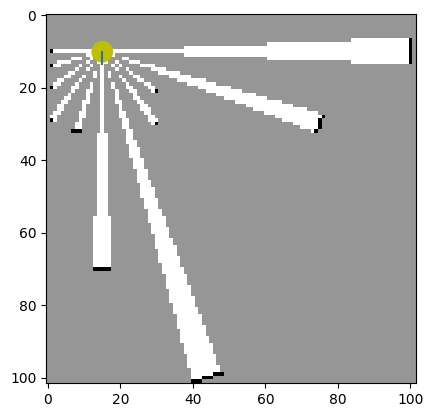

  0%|          | 1/759 [00:00<03:16,  3.87it/s]

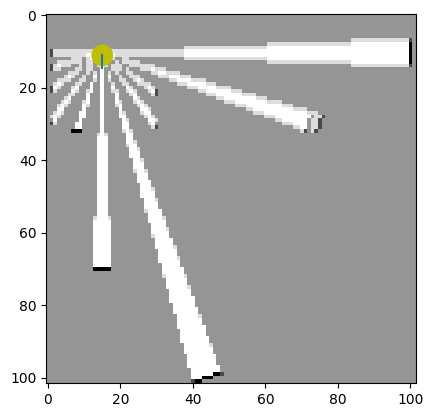

  0%|          | 2/759 [00:00<03:06,  4.05it/s]

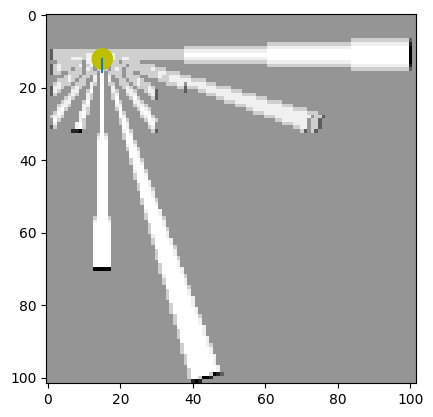

  0%|          | 3/759 [00:00<03:03,  4.12it/s]

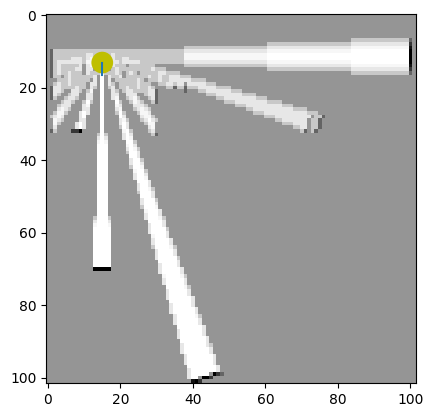

  1%|          | 4/759 [00:00<03:03,  4.10it/s]

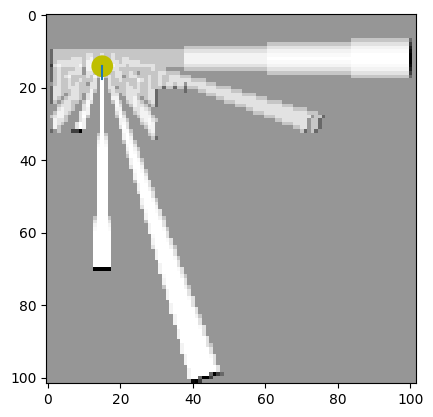

  1%|          | 5/759 [00:01<03:05,  4.07it/s]

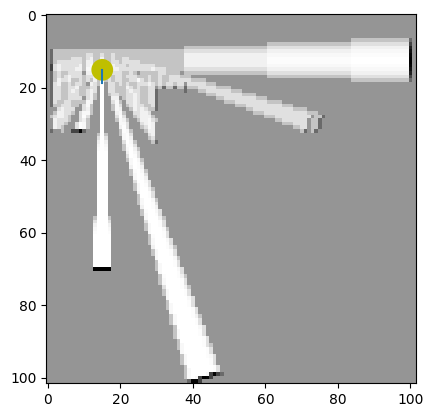

  1%|          | 6/759 [00:01<03:03,  4.10it/s]

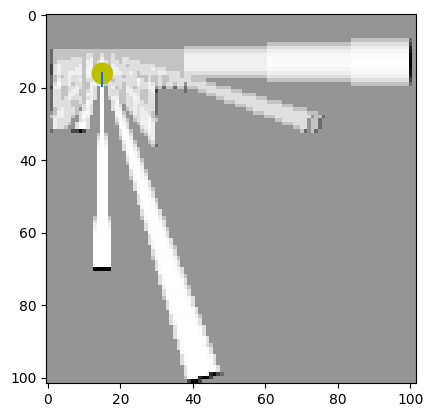

  1%|          | 7/759 [00:01<03:00,  4.17it/s]

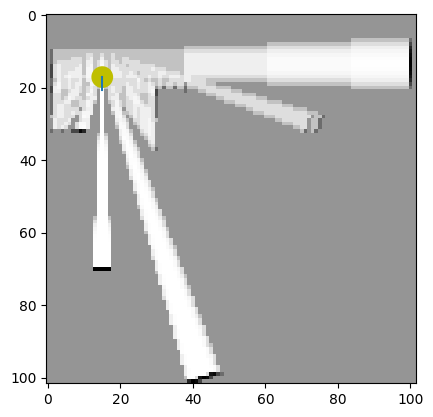

  1%|          | 8/759 [00:01<02:55,  4.28it/s]

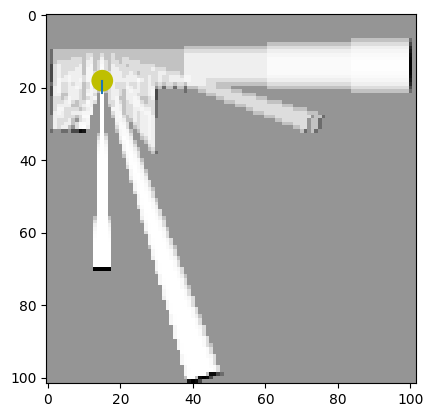

  1%|          | 9/759 [00:02<02:55,  4.28it/s]

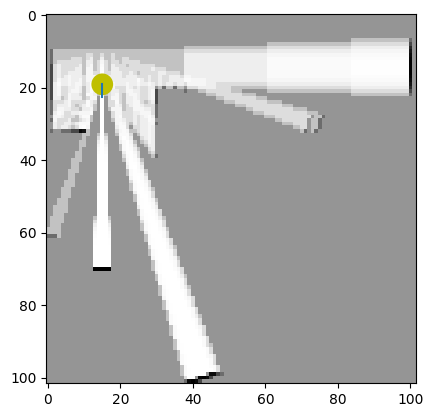

  1%|▏         | 10/759 [00:02<02:55,  4.27it/s]

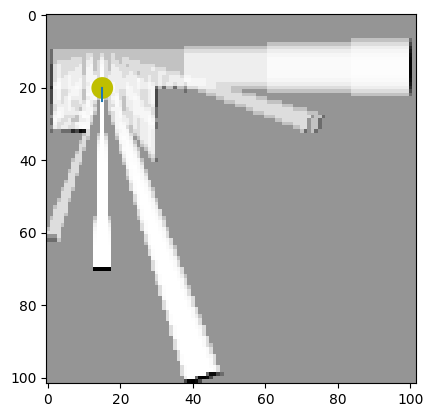

  1%|▏         | 11/759 [00:02<02:51,  4.35it/s]

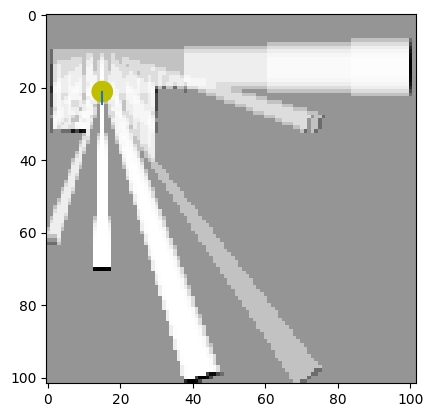

  2%|▏         | 12/759 [00:02<02:53,  4.32it/s]

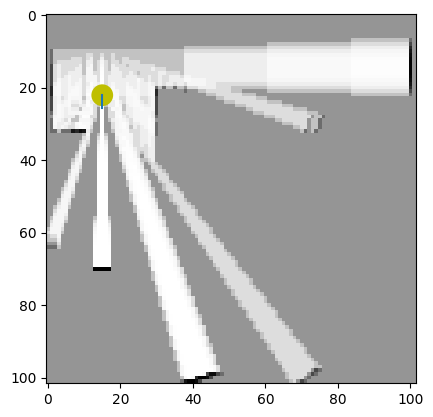

  2%|▏         | 13/759 [00:03<02:56,  4.22it/s]

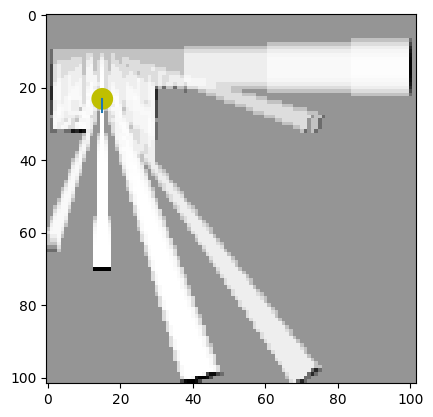

  2%|▏         | 14/759 [00:03<02:55,  4.24it/s]

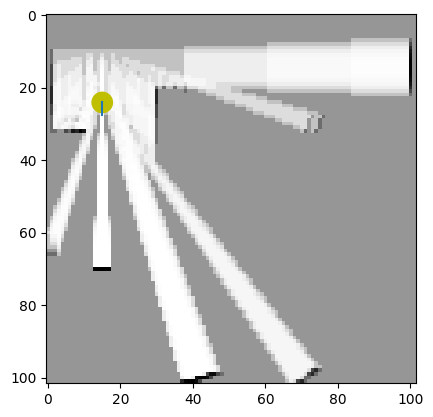

  2%|▏         | 15/759 [00:03<02:55,  4.25it/s]

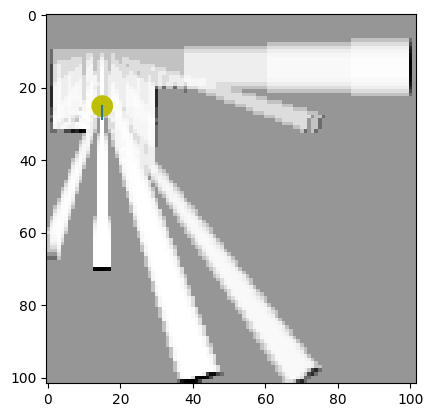

  2%|▏         | 16/759 [00:03<02:54,  4.26it/s]

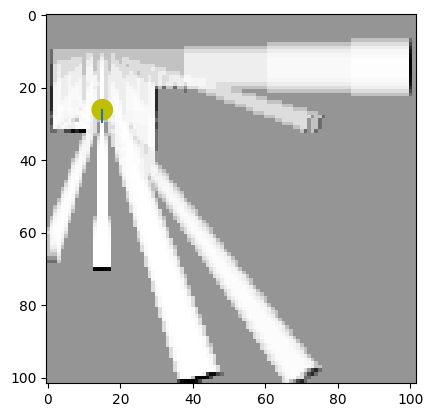

  2%|▏         | 17/759 [00:04<02:54,  4.24it/s]

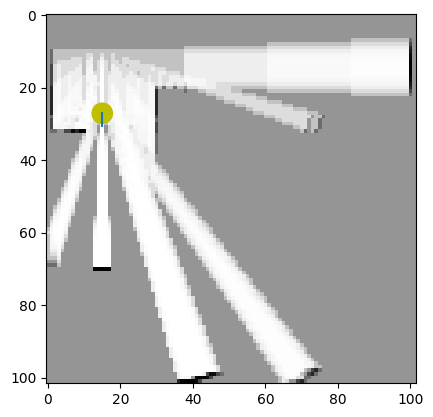

  2%|▏         | 18/759 [00:04<02:54,  4.24it/s]

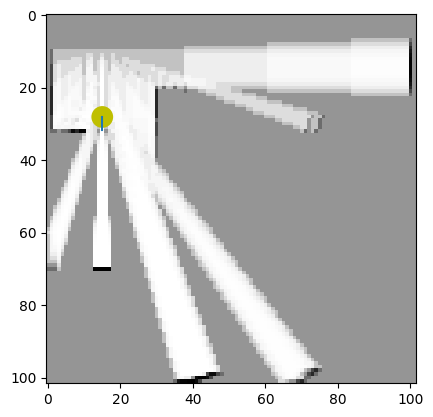

  3%|▎         | 19/759 [00:04<02:54,  4.24it/s]

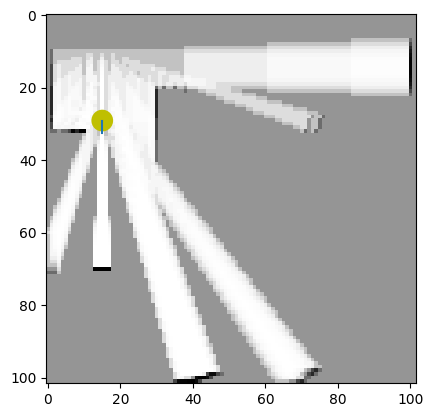

  3%|▎         | 20/759 [00:04<02:53,  4.25it/s]

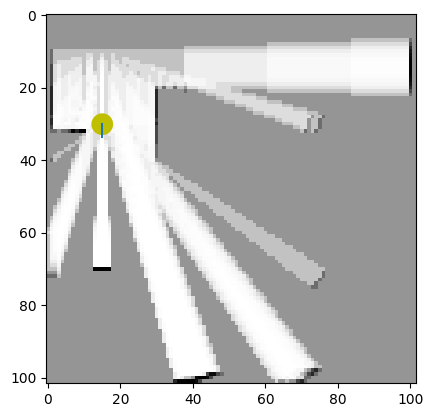

  3%|▎         | 21/759 [00:05<03:21,  3.67it/s]

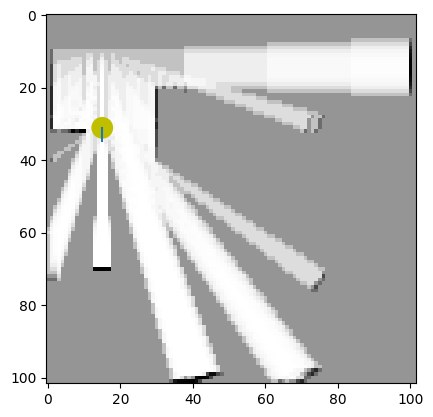

  3%|▎         | 22/759 [00:05<03:12,  3.84it/s]

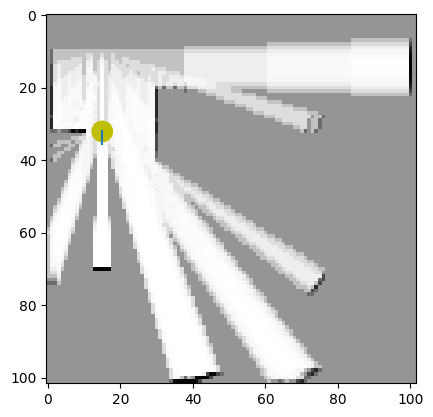

  3%|▎         | 23/759 [00:05<03:06,  3.94it/s]

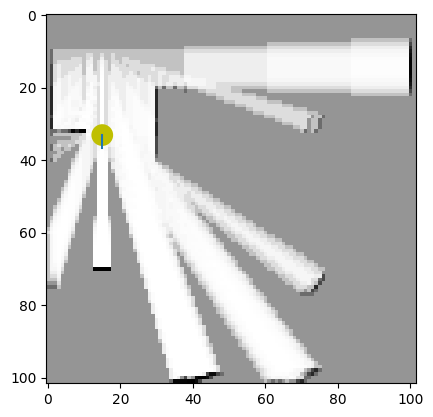

  3%|▎         | 24/759 [00:05<03:10,  3.86it/s]

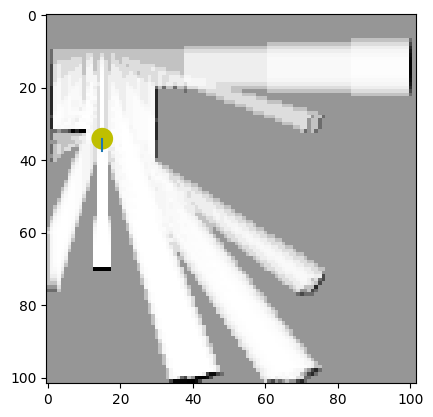

  3%|▎         | 25/759 [00:06<03:04,  3.99it/s]

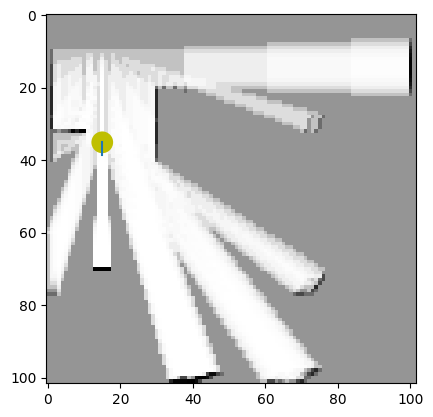

  3%|▎         | 26/759 [00:06<03:00,  4.05it/s]

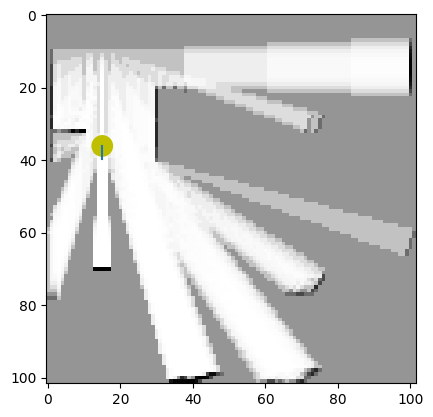

  4%|▎         | 27/759 [00:06<03:09,  3.85it/s]

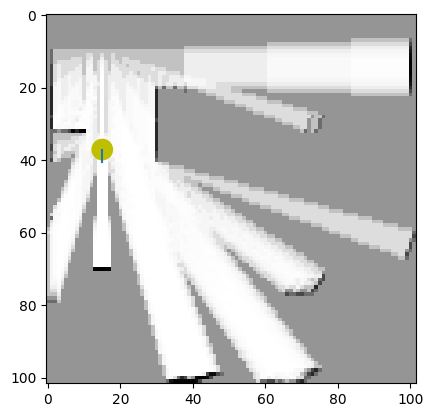

  4%|▎         | 28/759 [00:06<03:21,  3.62it/s]

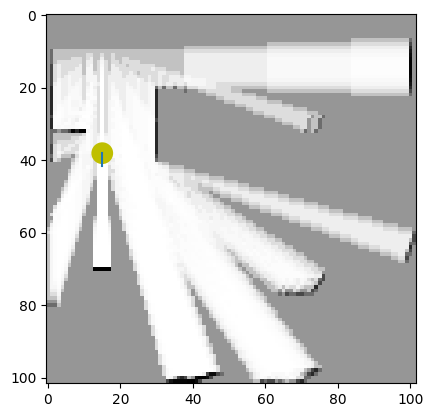

  4%|▍         | 29/759 [00:07<03:26,  3.53it/s]

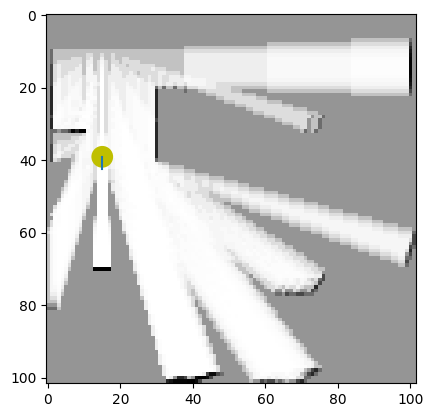

  4%|▍         | 30/759 [00:07<03:42,  3.27it/s]

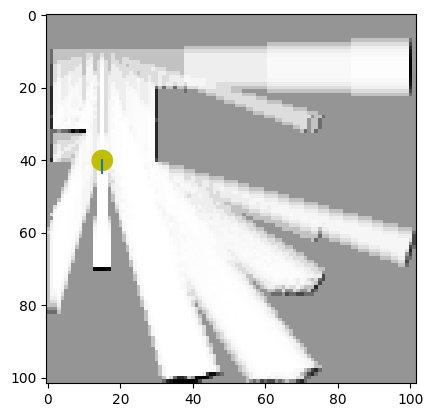

  4%|▍         | 31/759 [00:07<03:24,  3.57it/s]

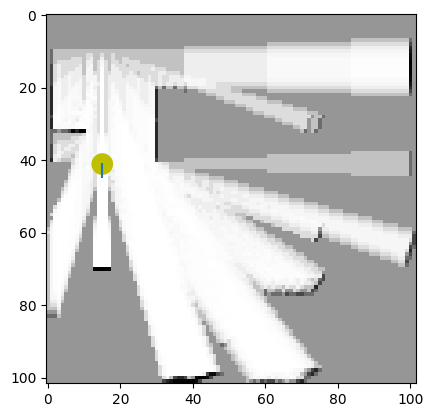

  4%|▍         | 32/759 [00:08<03:13,  3.76it/s]

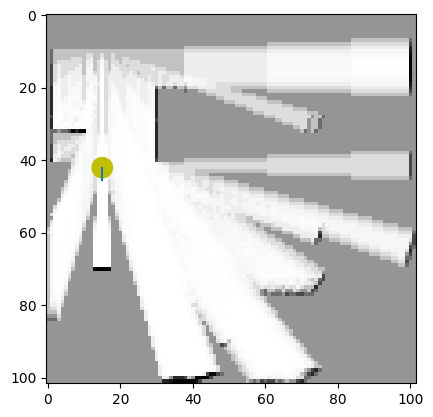

  4%|▍         | 33/759 [00:08<03:06,  3.88it/s]

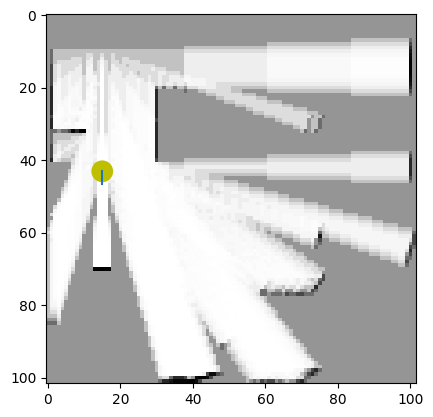

  4%|▍         | 34/759 [00:08<02:59,  4.04it/s]

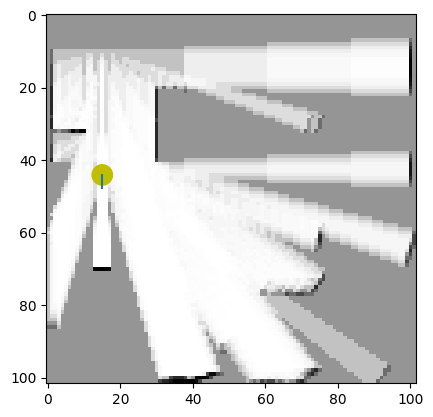

  5%|▍         | 35/759 [00:08<03:06,  3.89it/s]

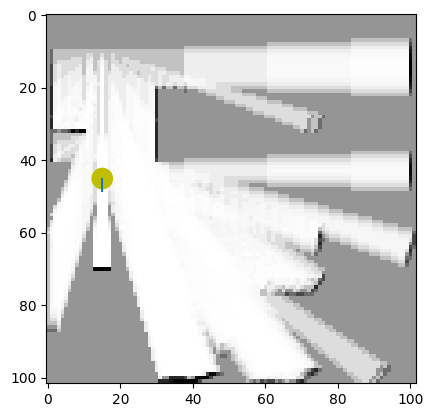

  5%|▍         | 36/759 [00:09<03:10,  3.79it/s]

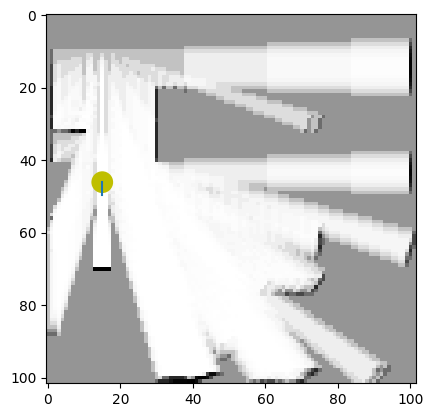

  5%|▍         | 37/759 [00:09<03:12,  3.75it/s]

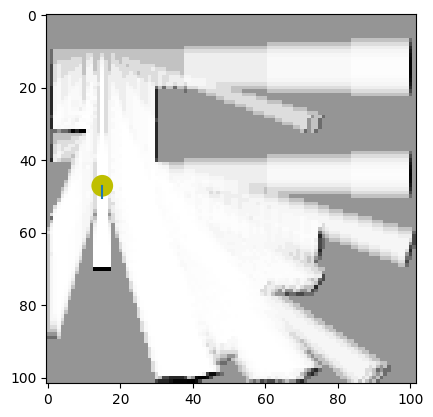

  5%|▌         | 38/759 [00:09<03:14,  3.71it/s]

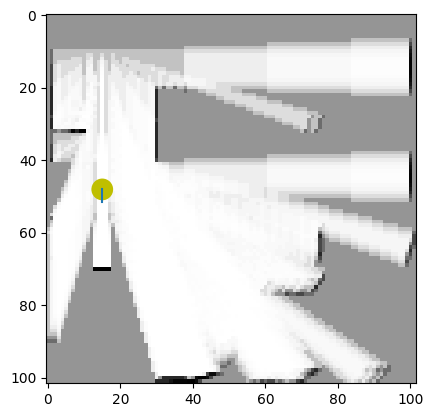

  5%|▌         | 39/759 [00:09<03:06,  3.86it/s]

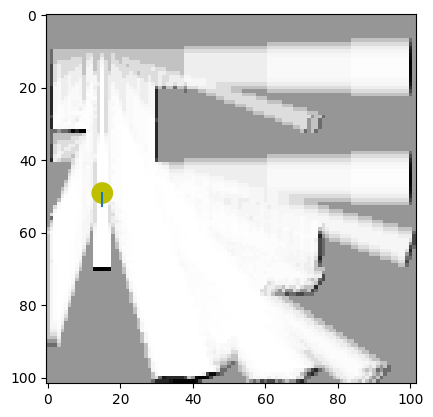

  5%|▌         | 40/759 [00:10<03:31,  3.40it/s]

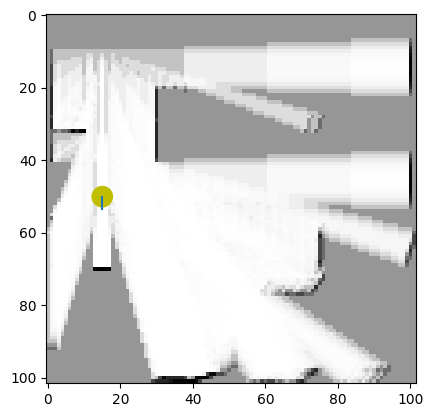

  5%|▌         | 41/759 [00:10<03:21,  3.57it/s]

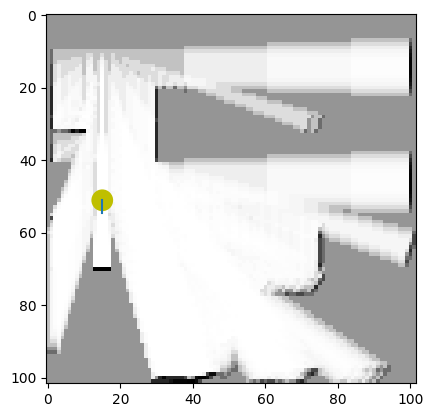

  6%|▌         | 42/759 [00:10<03:31,  3.39it/s]

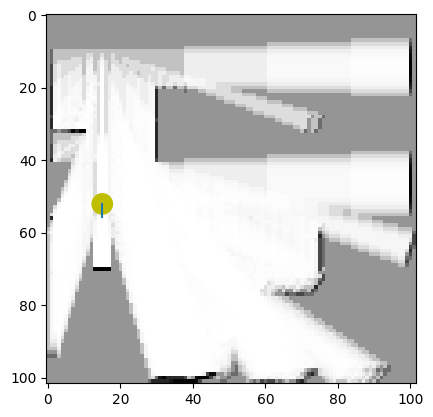

  6%|▌         | 43/759 [00:11<03:28,  3.43it/s]

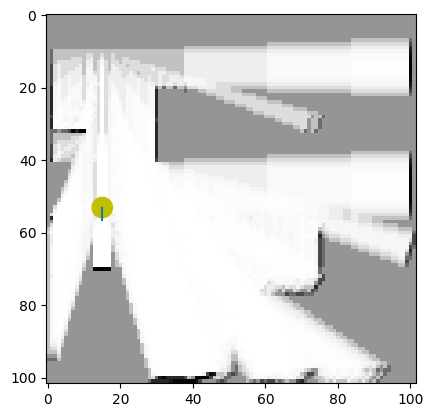

  6%|▌         | 44/759 [00:11<03:26,  3.46it/s]

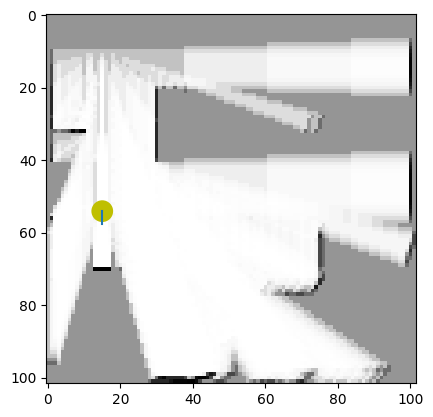

  6%|▌         | 45/759 [00:11<03:11,  3.73it/s]

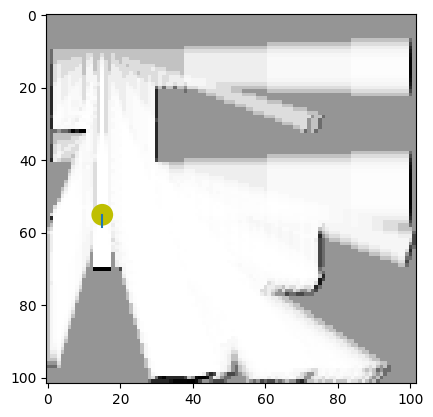

  6%|▌         | 46/759 [00:11<03:03,  3.89it/s]

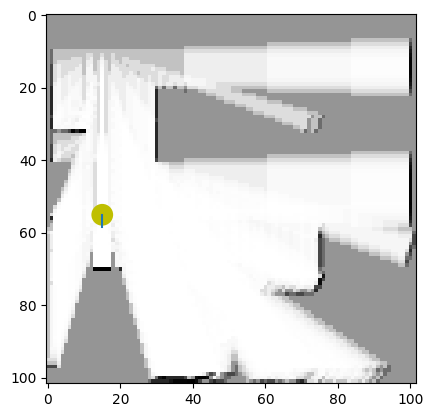

  6%|▌         | 47/759 [00:12<02:54,  4.08it/s]

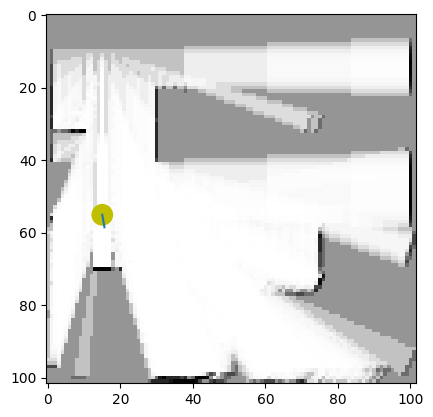

  6%|▋         | 48/759 [00:12<02:49,  4.19it/s]

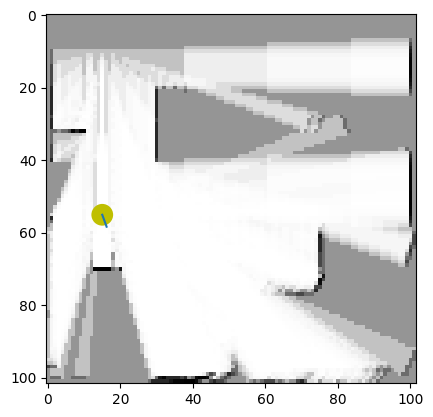

  6%|▋         | 49/759 [00:12<02:38,  4.49it/s]

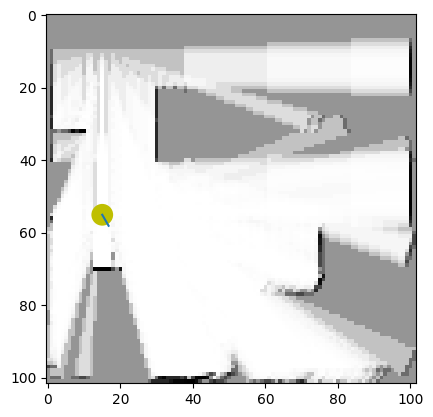

  7%|▋         | 50/759 [00:12<02:34,  4.59it/s]

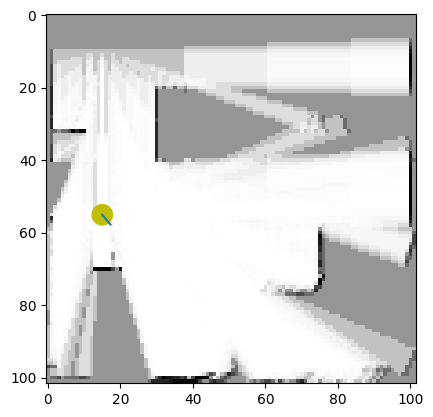

  7%|▋         | 51/759 [00:12<02:33,  4.62it/s]

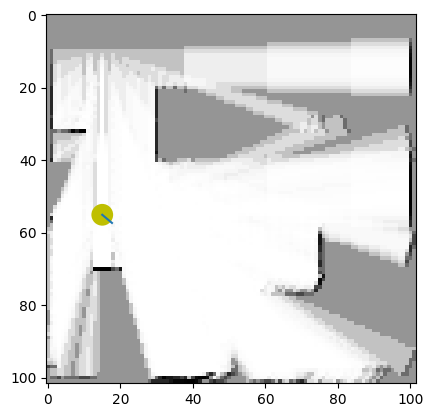

  7%|▋         | 52/759 [00:13<02:31,  4.65it/s]

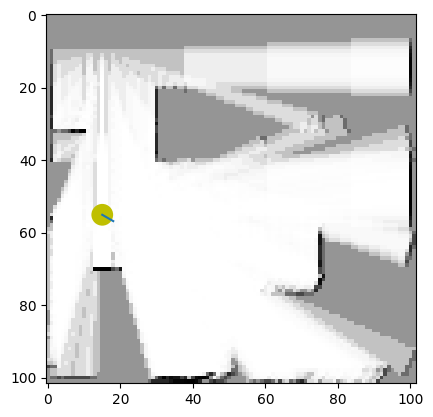

  7%|▋         | 53/759 [00:13<02:30,  4.68it/s]

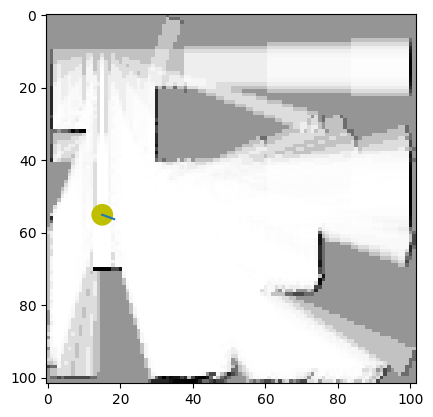

  7%|▋         | 54/759 [00:13<02:29,  4.73it/s]

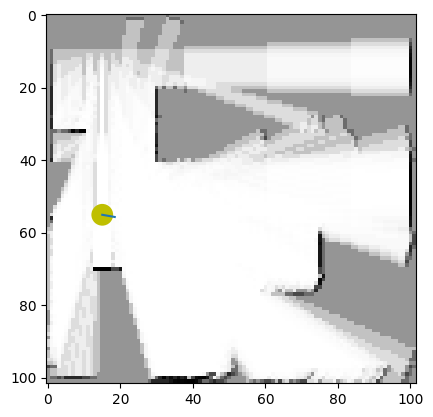

  7%|▋         | 55/759 [00:13<02:29,  4.70it/s]

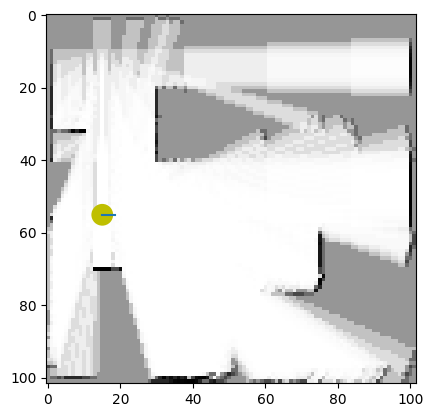

  7%|▋         | 56/759 [00:13<02:35,  4.51it/s]

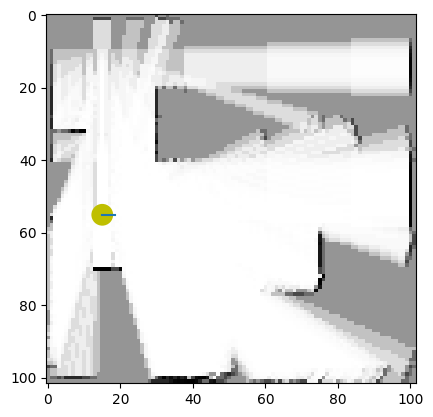

  8%|▊         | 57/759 [00:14<03:06,  3.75it/s]

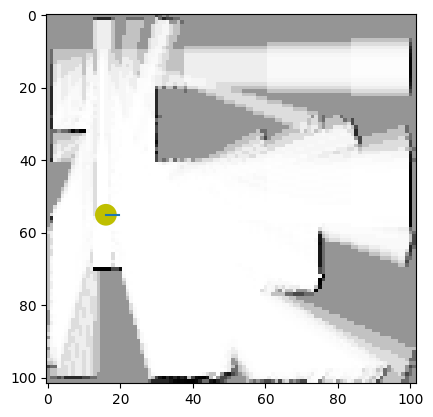

  8%|▊         | 58/759 [00:14<02:56,  3.96it/s]

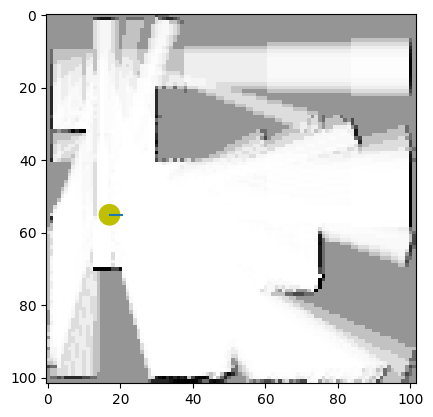

  8%|▊         | 59/759 [00:14<02:53,  4.03it/s]

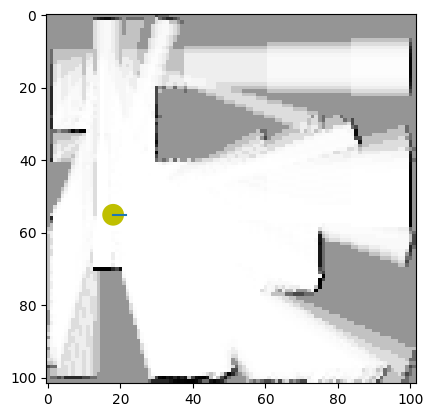

  8%|▊         | 60/759 [00:14<02:45,  4.23it/s]

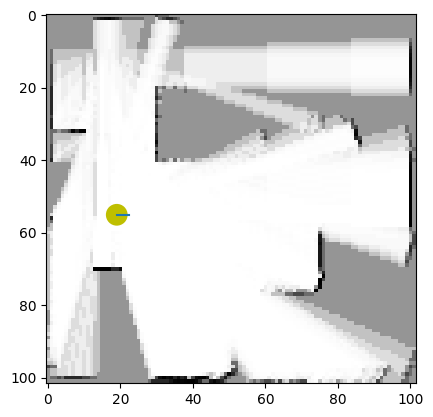

  8%|▊         | 61/759 [00:15<02:39,  4.37it/s]

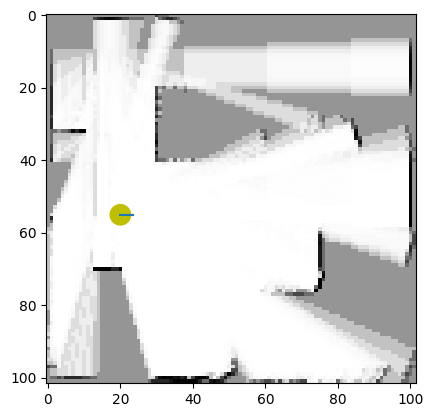

  8%|▊         | 62/759 [00:15<02:40,  4.33it/s]

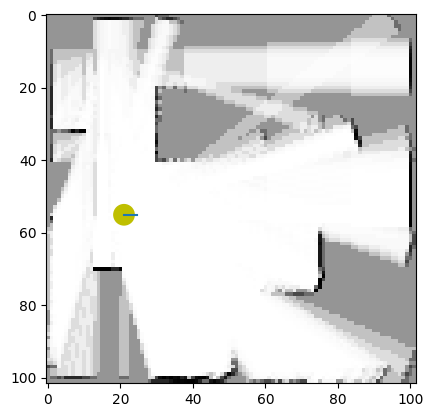

  8%|▊         | 63/759 [00:15<02:40,  4.33it/s]

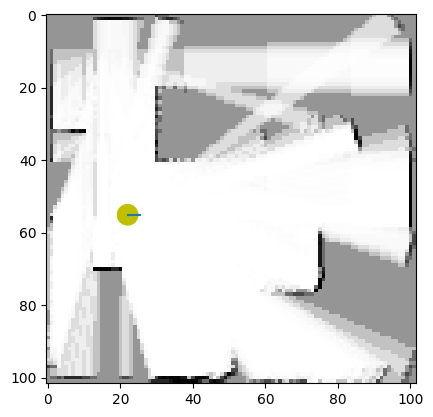

  8%|▊         | 64/759 [00:15<02:57,  3.91it/s]

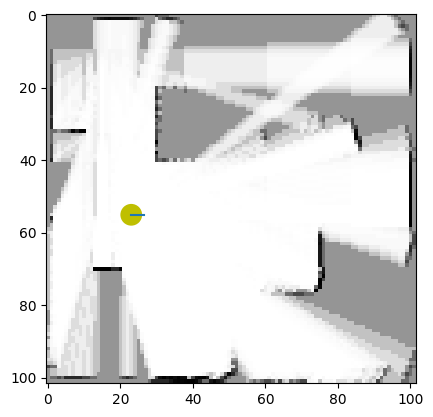

  9%|▊         | 65/759 [00:16<02:45,  4.19it/s]

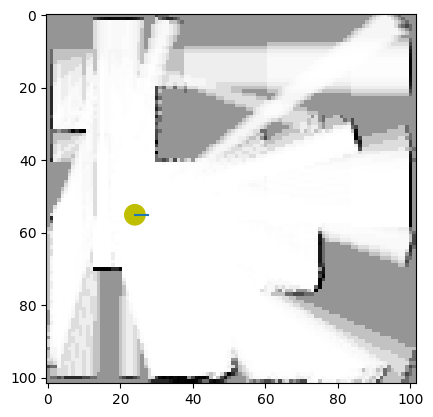

  9%|▊         | 66/759 [00:16<02:59,  3.86it/s]

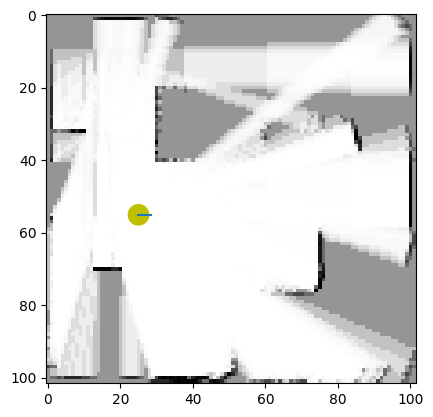

  9%|▉         | 67/759 [00:16<02:50,  4.06it/s]

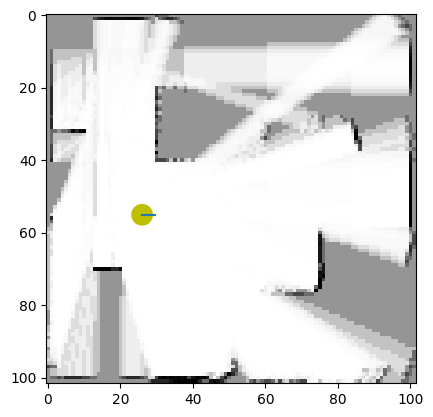

  9%|▉         | 68/759 [00:16<02:39,  4.33it/s]

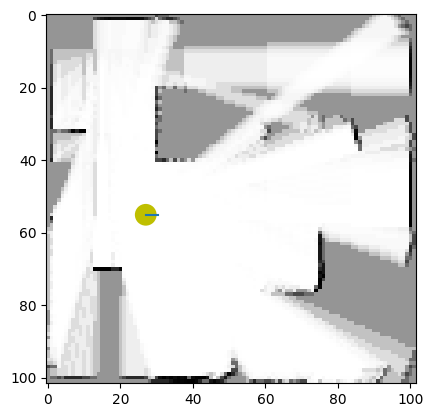

  9%|▉         | 69/759 [00:17<02:32,  4.51it/s]

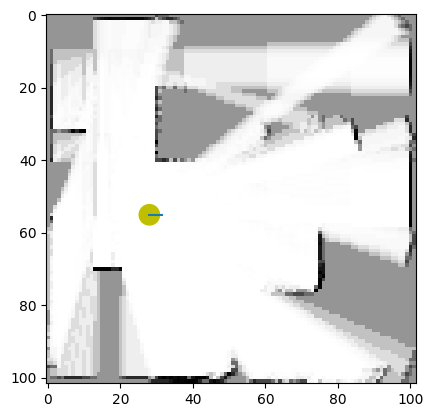

  9%|▉         | 70/759 [00:17<02:56,  3.91it/s]

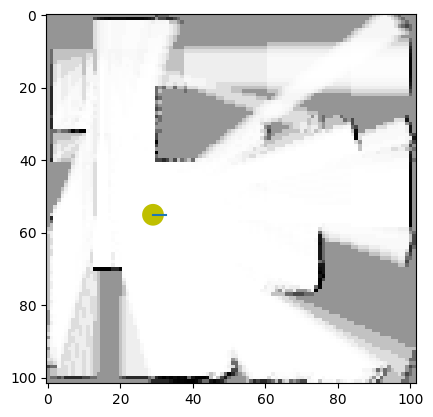

  9%|▉         | 71/759 [00:17<02:45,  4.17it/s]

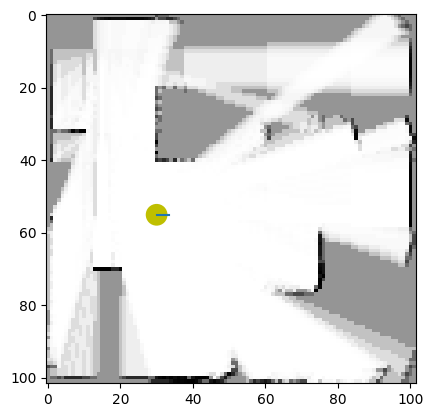

  9%|▉         | 72/759 [00:17<02:48,  4.09it/s]

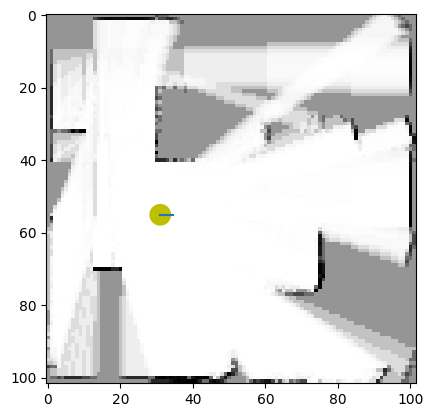

 10%|▉         | 73/759 [00:18<03:11,  3.59it/s]

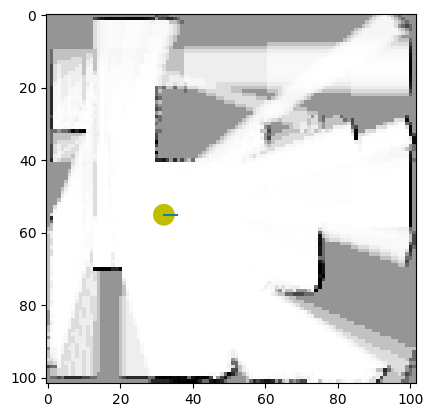

 10%|▉         | 74/759 [00:18<02:57,  3.87it/s]

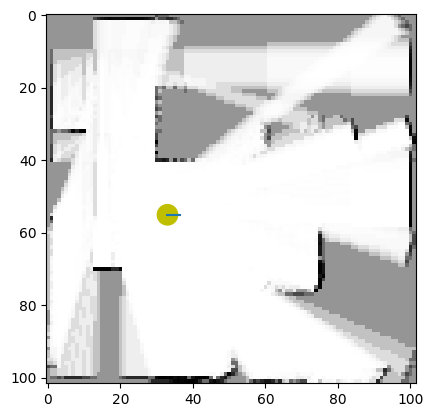

 10%|▉         | 75/759 [00:18<03:42,  3.07it/s]

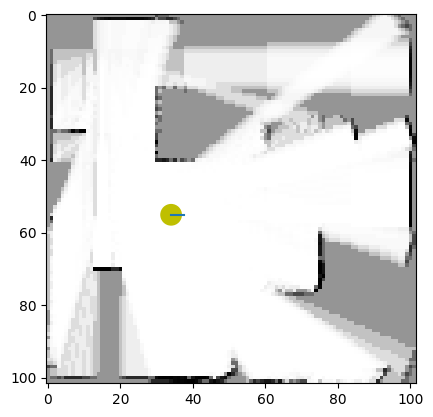

 10%|█         | 76/759 [00:19<03:31,  3.23it/s]

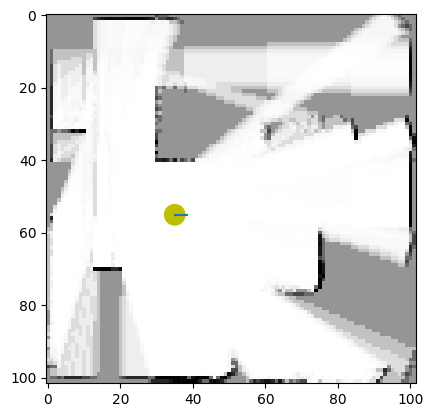

 10%|█         | 77/759 [00:19<03:08,  3.62it/s]

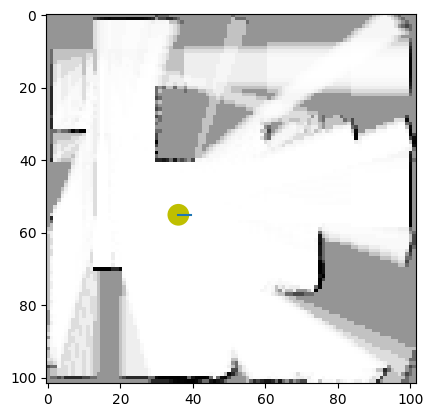

 10%|█         | 78/759 [00:19<03:47,  3.00it/s]

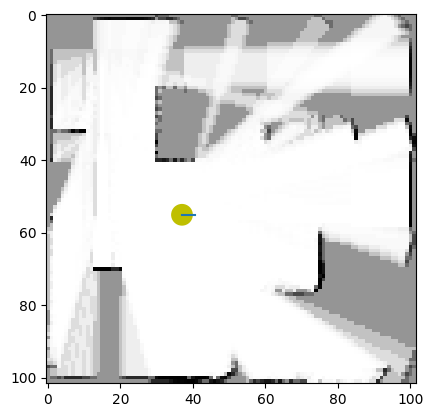

 10%|█         | 79/759 [00:20<03:24,  3.33it/s]

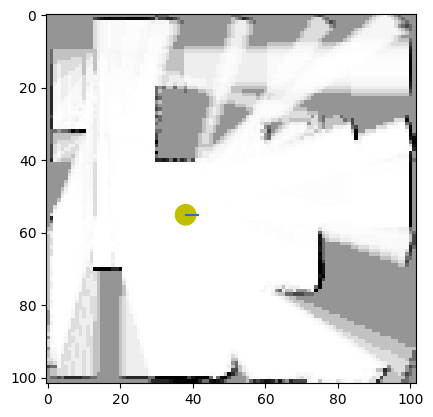

 11%|█         | 80/759 [00:20<03:18,  3.42it/s]

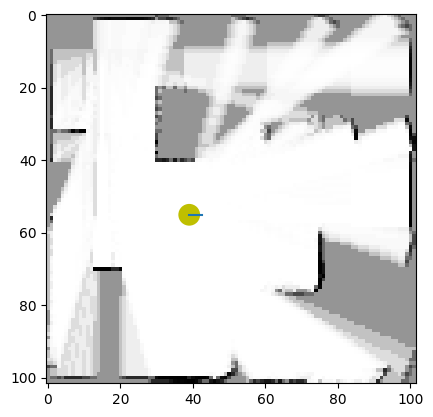

 11%|█         | 81/759 [00:20<03:14,  3.49it/s]

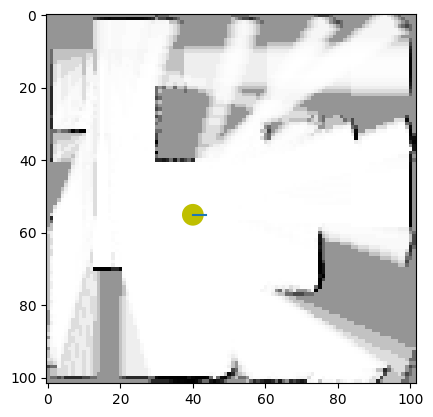

 11%|█         | 82/759 [00:20<03:22,  3.34it/s]

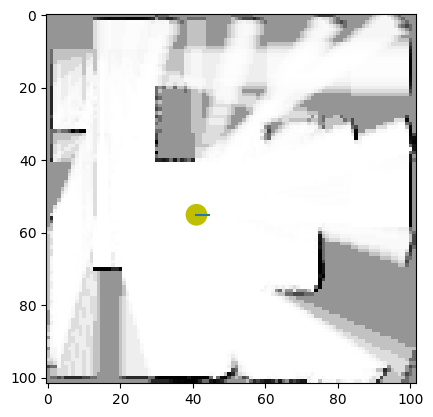

 11%|█         | 83/759 [00:21<03:29,  3.23it/s]

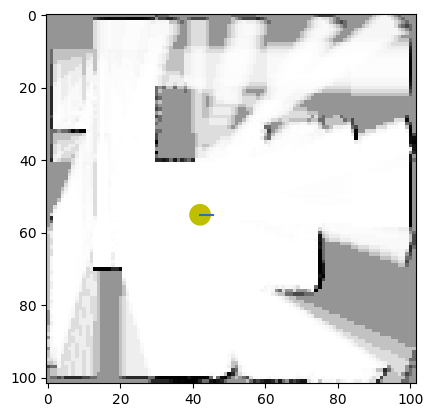

 11%|█         | 84/759 [00:21<03:27,  3.25it/s]

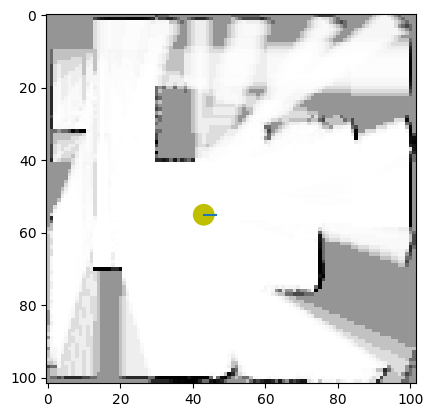

 11%|█         | 85/759 [00:21<03:28,  3.23it/s]

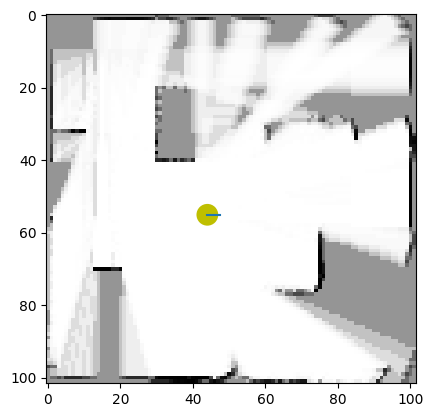

 11%|█▏        | 86/759 [00:22<03:12,  3.50it/s]

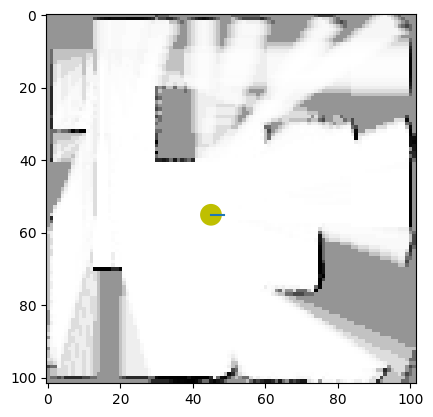

 11%|█▏        | 87/759 [00:22<03:10,  3.53it/s]

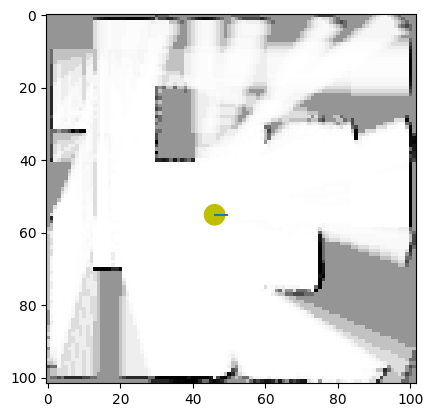

 12%|█▏        | 88/759 [00:22<03:23,  3.30it/s]

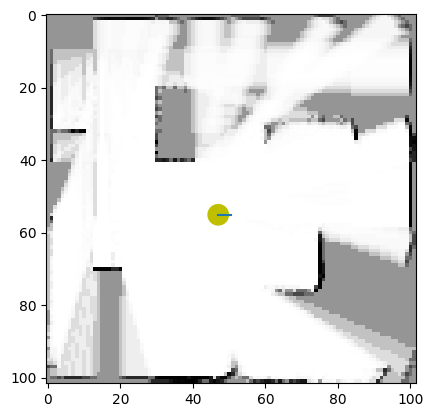

 12%|█▏        | 89/759 [00:22<03:07,  3.58it/s]

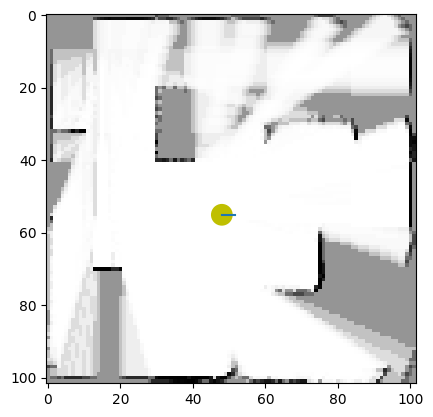

 12%|█▏        | 90/759 [00:23<03:09,  3.53it/s]

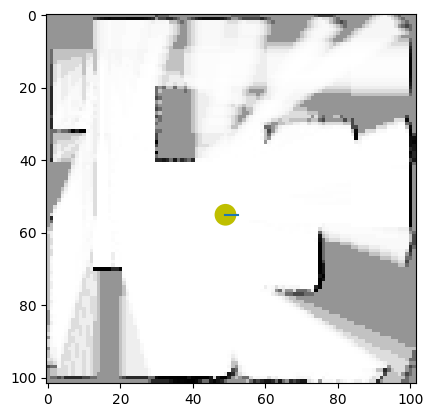

 12%|█▏        | 91/759 [00:23<03:09,  3.52it/s]

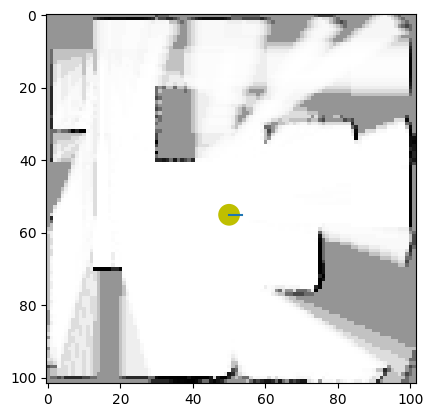

 12%|█▏        | 92/759 [00:23<02:55,  3.79it/s]

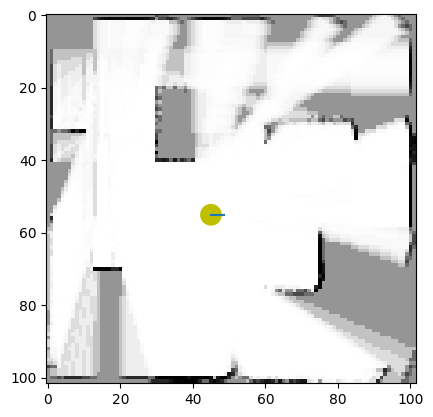

 12%|█▏        | 93/759 [00:23<02:42,  4.11it/s]

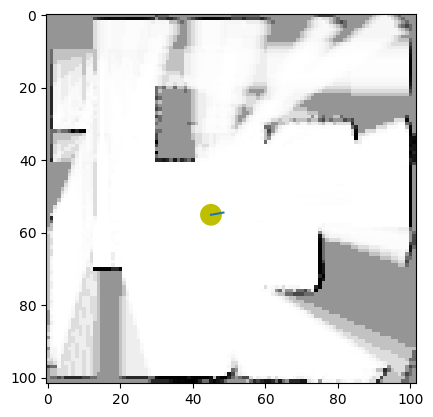

 12%|█▏        | 94/759 [00:24<02:33,  4.34it/s]

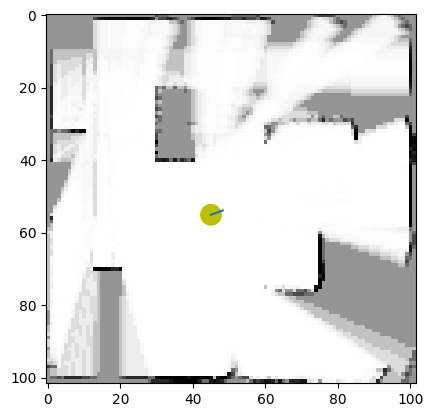

 13%|█▎        | 95/759 [00:24<02:48,  3.94it/s]

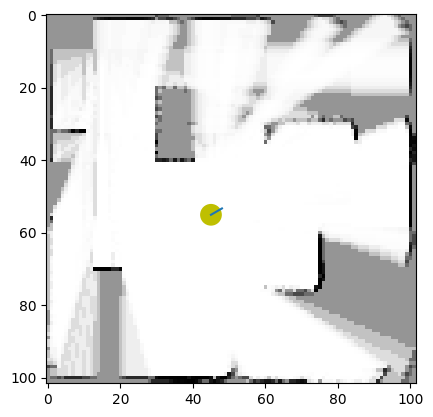

 13%|█▎        | 96/759 [00:24<02:39,  4.17it/s]

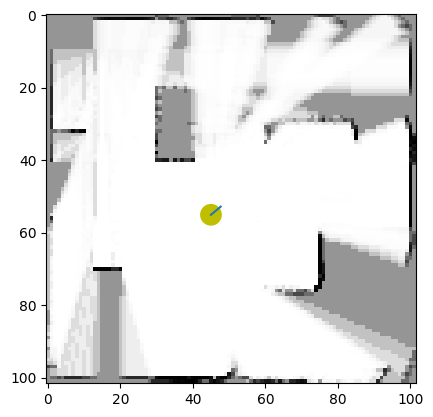

 13%|█▎        | 97/759 [00:24<02:40,  4.13it/s]

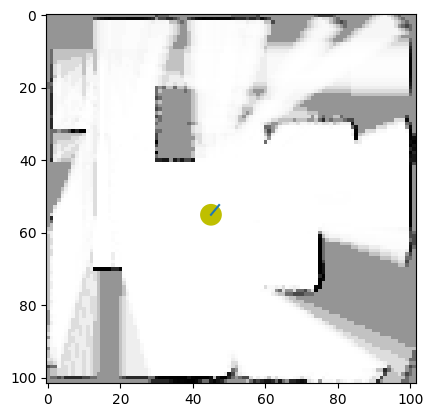

 13%|█▎        | 98/759 [00:25<03:01,  3.64it/s]

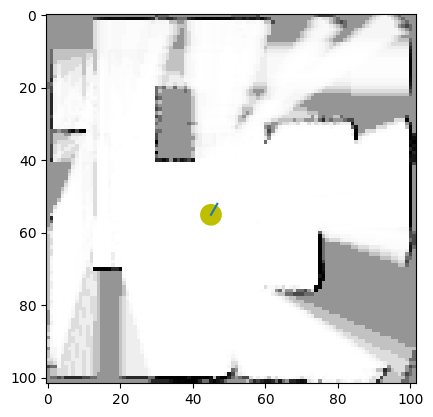

 13%|█▎        | 99/759 [00:25<02:51,  3.85it/s]

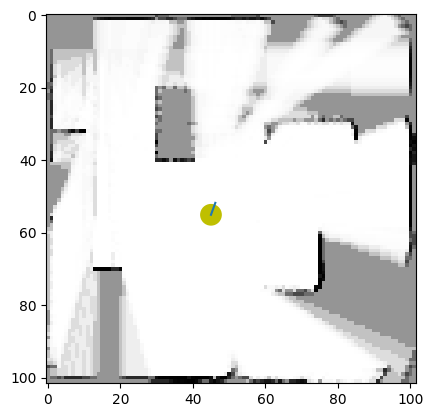

 13%|█▎        | 100/759 [00:25<02:38,  4.15it/s]

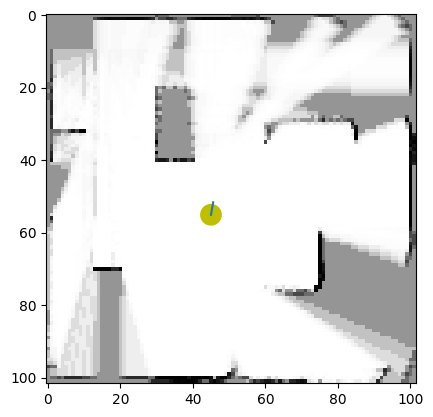

 13%|█▎        | 101/759 [00:25<02:31,  4.36it/s]

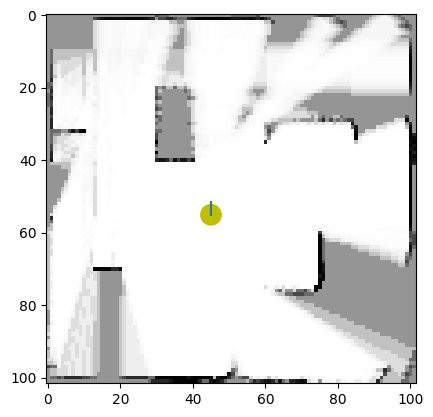

 13%|█▎        | 102/759 [00:26<02:48,  3.89it/s]

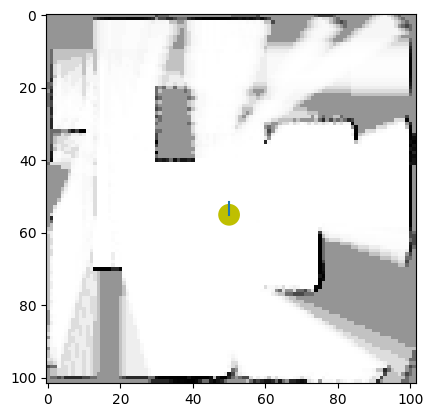

 14%|█▎        | 103/759 [00:26<02:45,  3.96it/s]

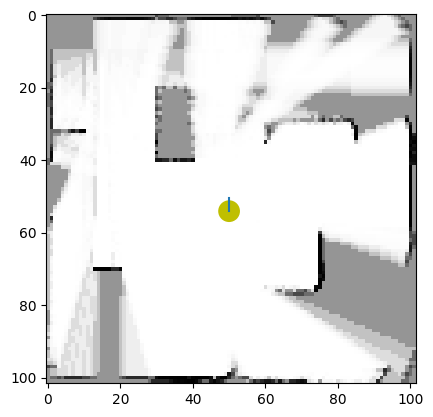

 14%|█▎        | 104/759 [00:26<02:36,  4.20it/s]

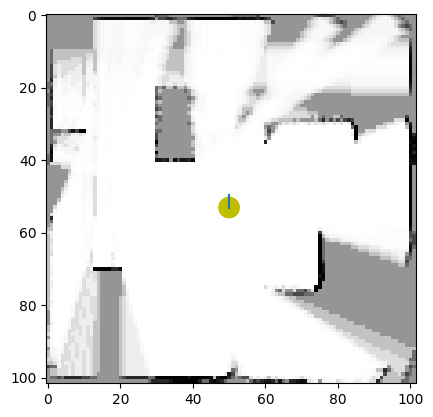

 14%|█▍        | 105/759 [00:26<02:29,  4.38it/s]

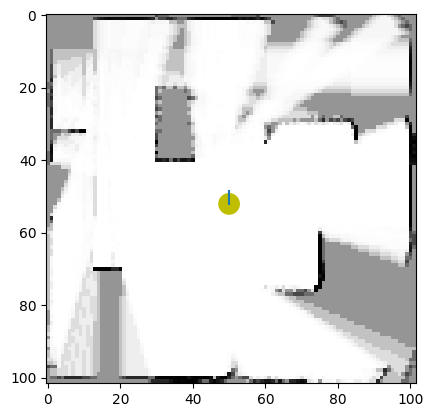

 14%|█▍        | 106/759 [00:27<02:46,  3.93it/s]

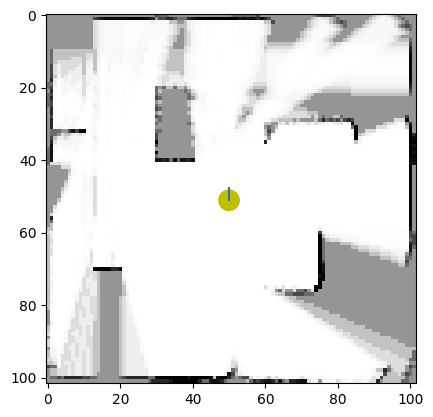

 14%|█▍        | 107/759 [00:27<02:55,  3.71it/s]

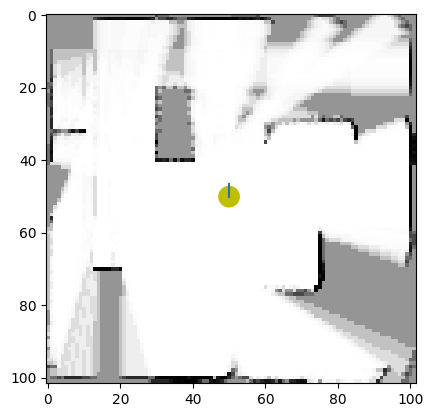

 14%|█▍        | 108/759 [00:27<02:46,  3.91it/s]

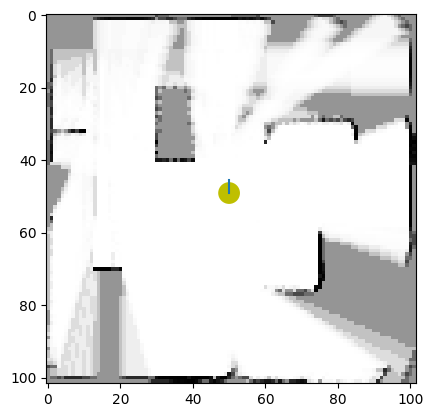

 14%|█▍        | 109/759 [00:28<02:56,  3.68it/s]

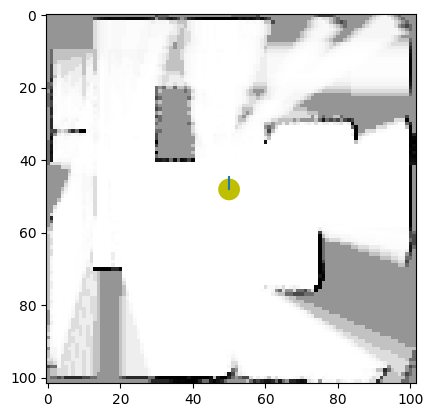

 14%|█▍        | 110/759 [00:28<02:49,  3.84it/s]

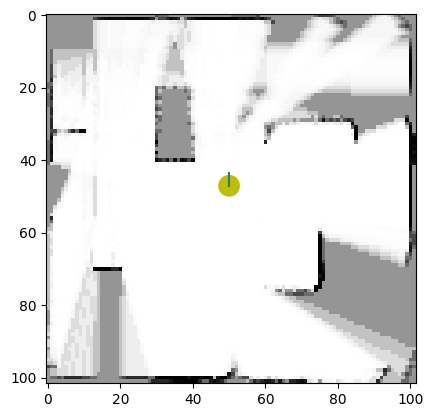

 15%|█▍        | 111/759 [00:28<03:16,  3.30it/s]

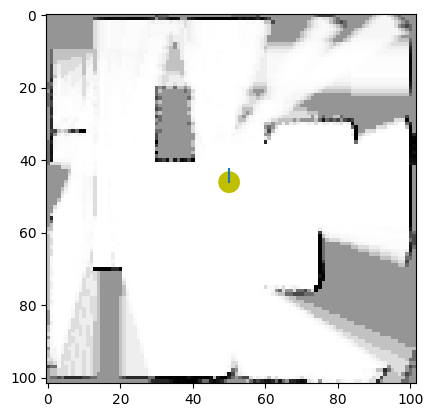

 15%|█▍        | 112/759 [00:28<02:58,  3.63it/s]

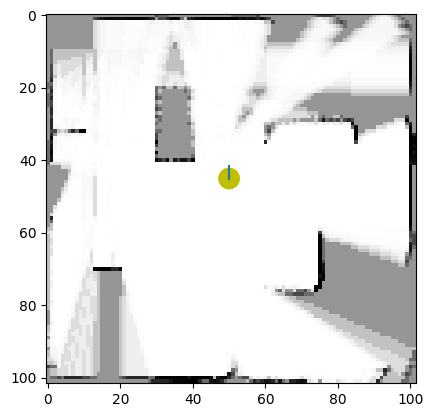

 15%|█▍        | 113/759 [00:29<03:03,  3.53it/s]

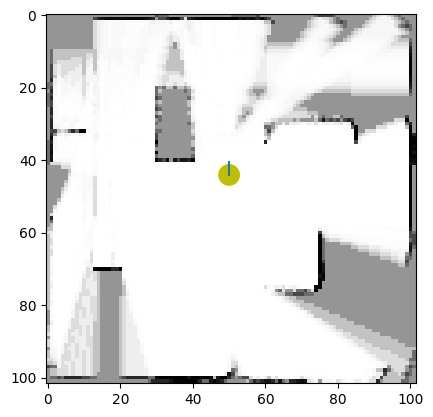

 15%|█▌        | 114/759 [00:29<03:23,  3.18it/s]

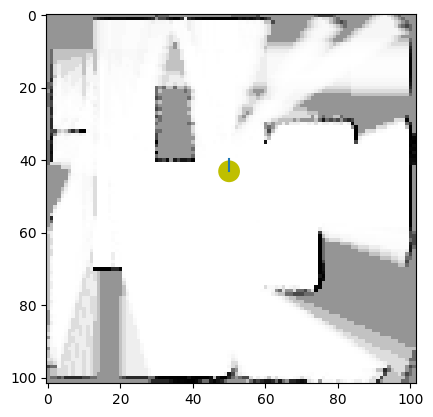

 15%|█▌        | 115/759 [00:29<03:24,  3.16it/s]

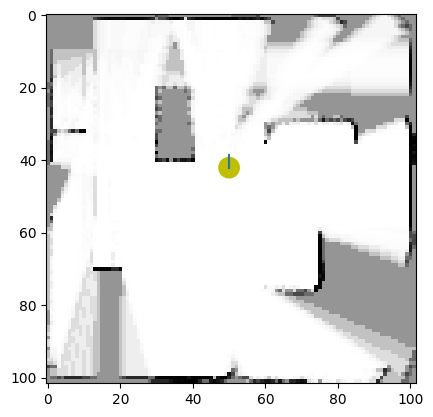

 15%|█▌        | 116/759 [00:30<03:05,  3.46it/s]

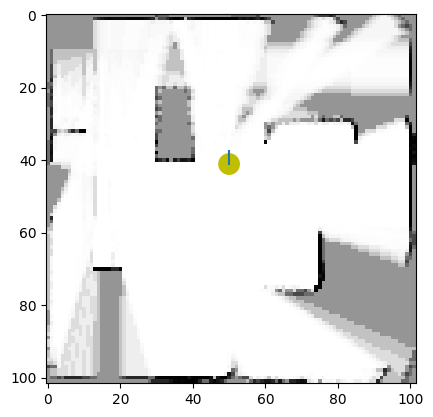

 15%|█▌        | 117/759 [00:30<02:51,  3.74it/s]

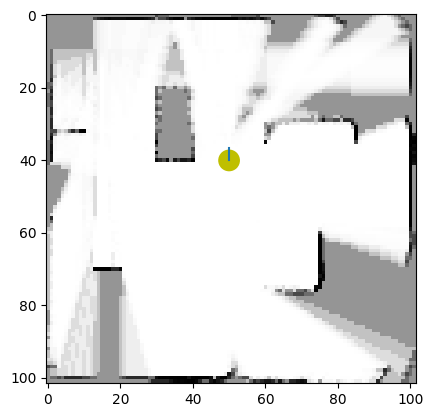

 16%|█▌        | 118/759 [00:30<03:09,  3.38it/s]

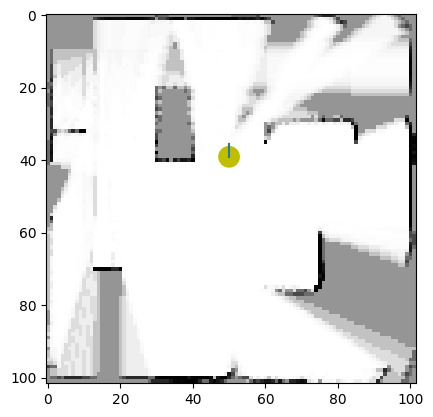

 16%|█▌        | 119/759 [00:31<03:42,  2.88it/s]

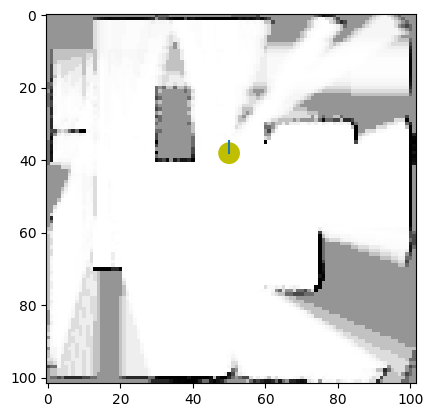

 16%|█▌        | 120/759 [00:31<03:26,  3.09it/s]

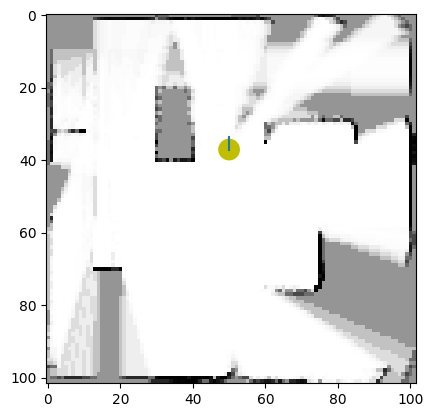

 16%|█▌        | 121/759 [00:31<03:12,  3.31it/s]

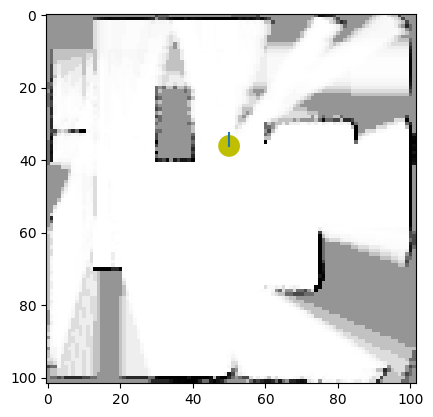

 16%|█▌        | 122/759 [00:32<03:23,  3.13it/s]

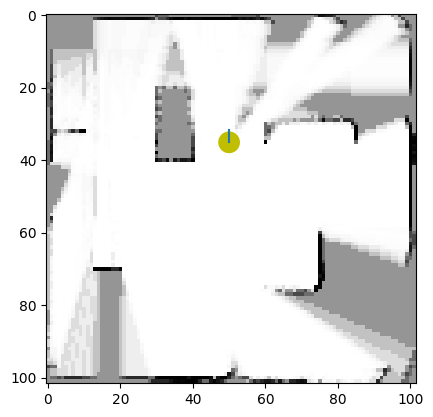

 16%|█▌        | 123/759 [00:32<03:18,  3.20it/s]

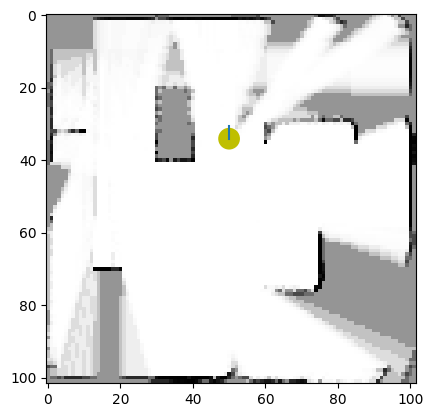

 16%|█▋        | 124/759 [00:32<03:36,  2.93it/s]

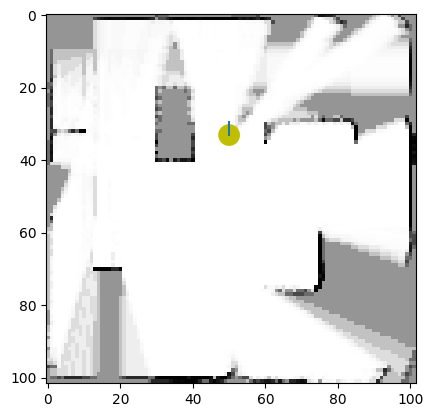

 16%|█▋        | 125/759 [00:33<03:19,  3.18it/s]

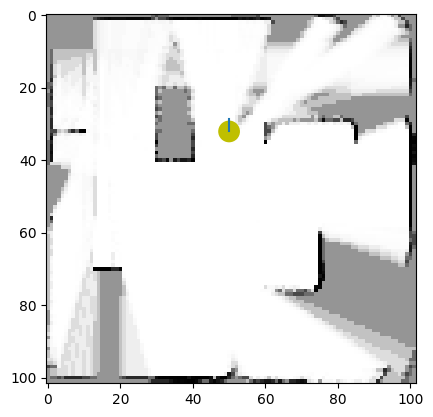

 17%|█▋        | 126/759 [00:33<03:20,  3.15it/s]

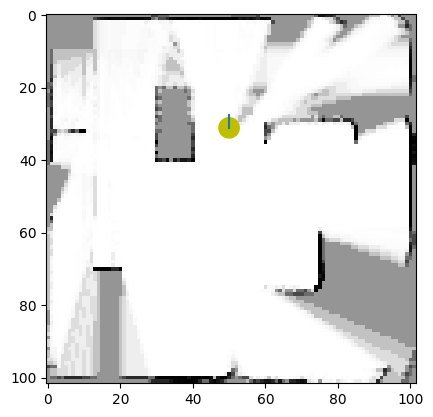

 17%|█▋        | 127/759 [00:33<03:24,  3.09it/s]

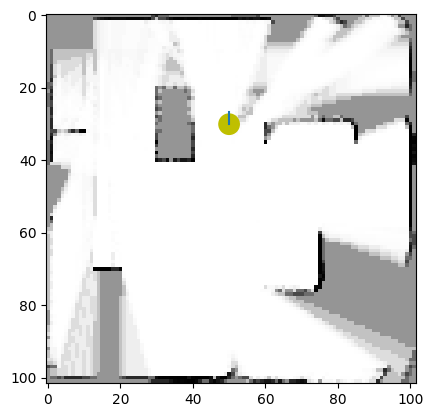

 17%|█▋        | 128/759 [00:34<03:28,  3.03it/s]

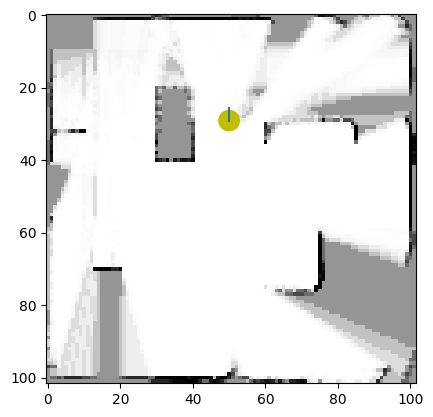

 17%|█▋        | 129/759 [00:34<03:16,  3.20it/s]

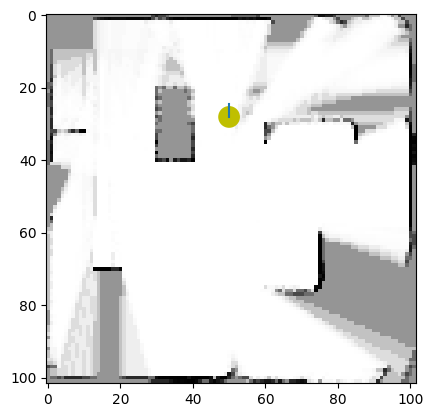

 17%|█▋        | 130/759 [00:34<03:18,  3.17it/s]

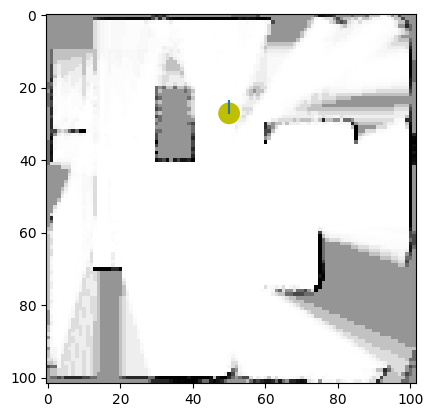

 17%|█▋        | 131/759 [00:34<03:10,  3.29it/s]

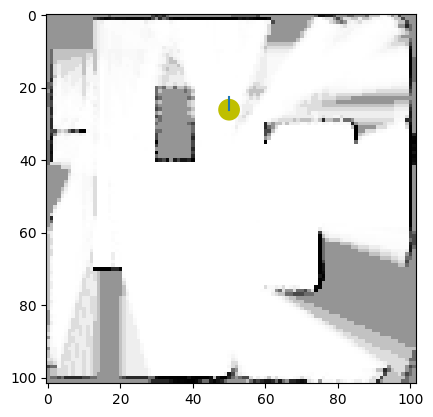

 17%|█▋        | 132/759 [00:35<03:10,  3.30it/s]

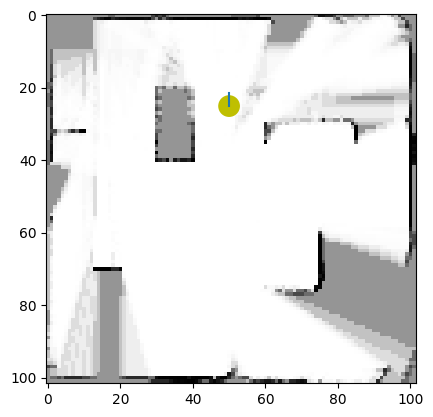

 18%|█▊        | 133/759 [00:35<02:51,  3.64it/s]

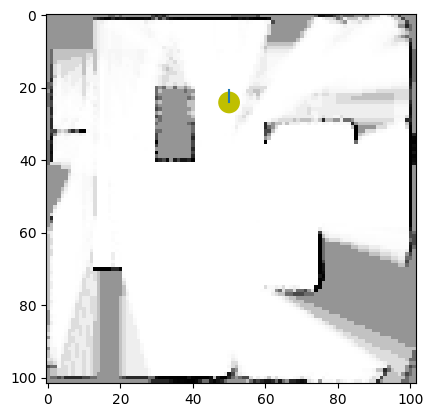

 18%|█▊        | 134/759 [00:35<02:40,  3.90it/s]

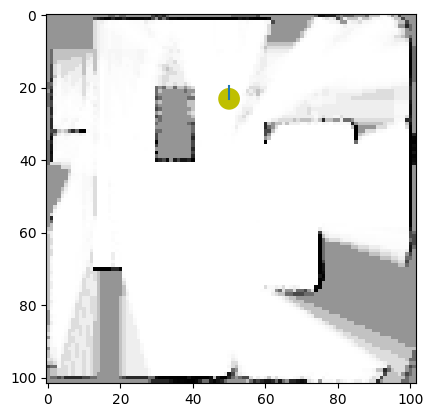

 18%|█▊        | 135/759 [00:36<03:08,  3.32it/s]

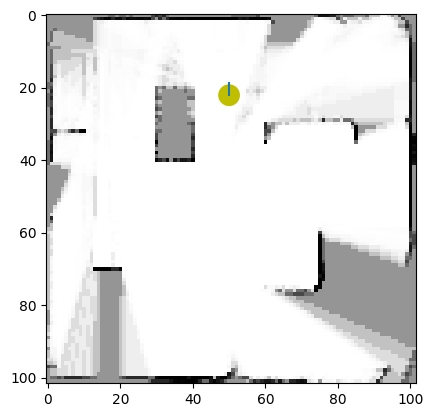

 18%|█▊        | 136/759 [00:36<02:53,  3.59it/s]

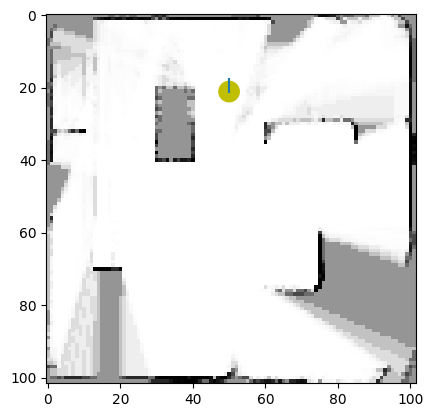

 18%|█▊        | 137/759 [00:36<02:55,  3.55it/s]

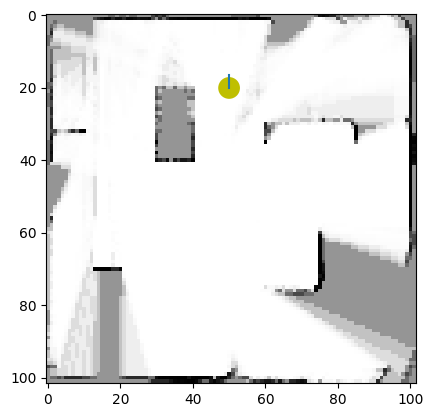

 18%|█▊        | 138/759 [00:36<03:06,  3.32it/s]

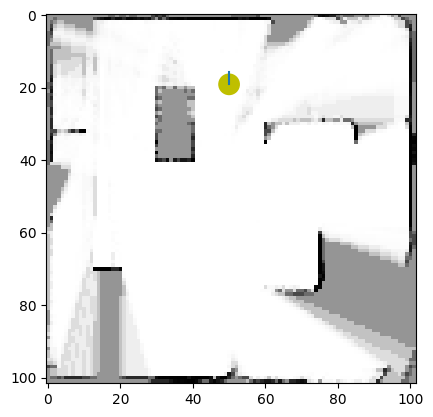

 18%|█▊        | 139/759 [00:37<03:27,  2.99it/s]

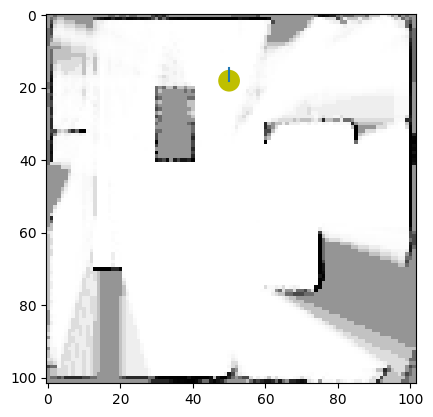

 18%|█▊        | 140/759 [00:37<03:01,  3.40it/s]

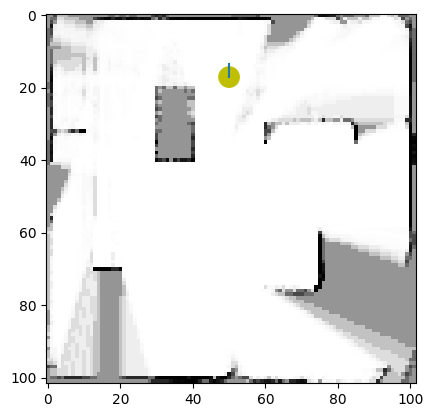

 19%|█▊        | 141/759 [00:37<03:01,  3.40it/s]

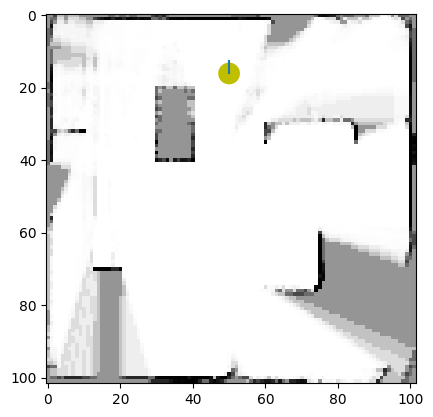

 19%|█▊        | 142/759 [00:38<03:16,  3.13it/s]

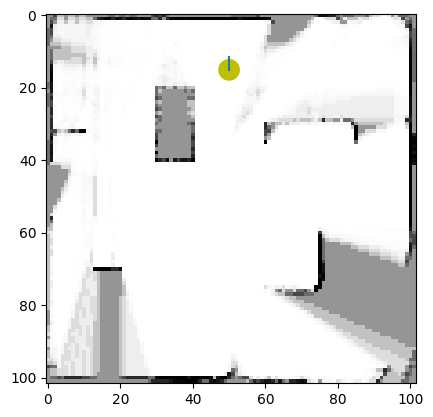

 19%|█▉        | 143/759 [00:38<02:54,  3.53it/s]

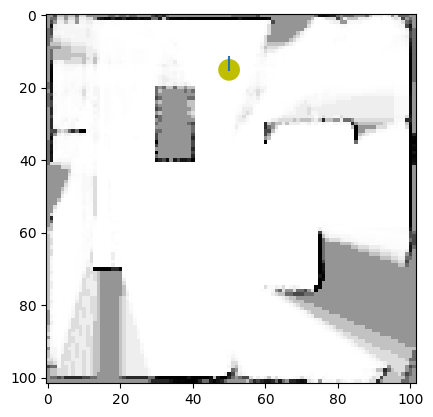

 19%|█▉        | 144/759 [00:38<03:01,  3.38it/s]

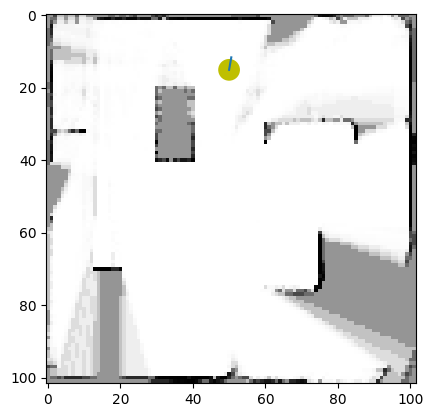

 19%|█▉        | 145/759 [00:38<02:53,  3.55it/s]

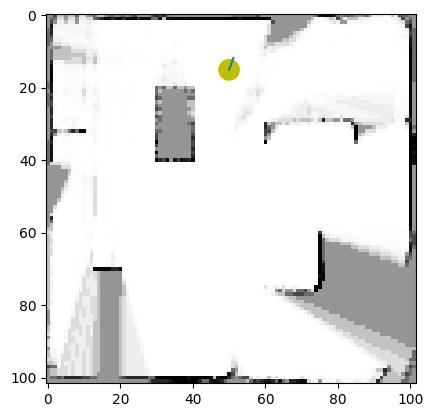

 19%|█▉        | 146/759 [00:39<03:27,  2.96it/s]

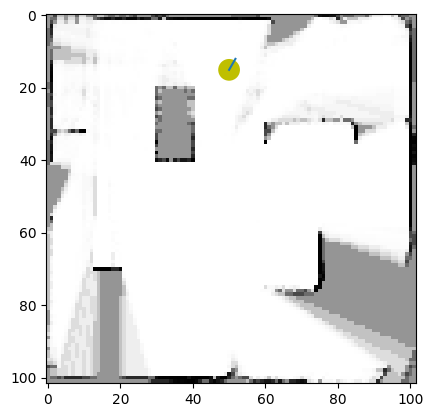

 19%|█▉        | 147/759 [00:39<03:34,  2.86it/s]

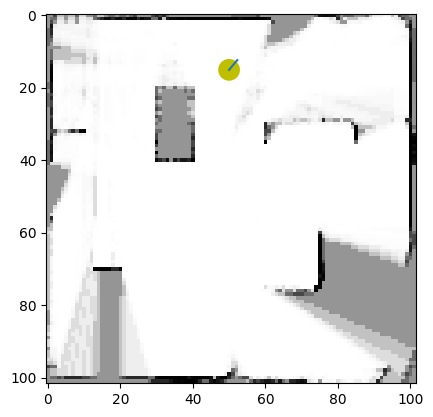

 19%|█▉        | 148/759 [00:40<03:38,  2.79it/s]

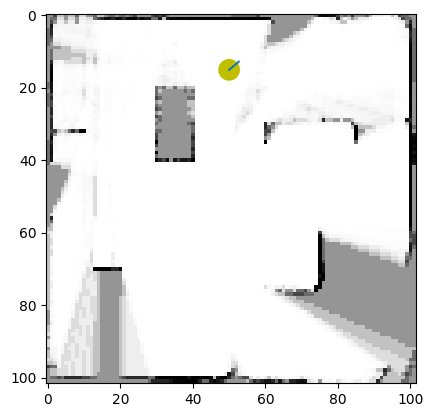

 20%|█▉        | 149/759 [00:40<03:45,  2.70it/s]

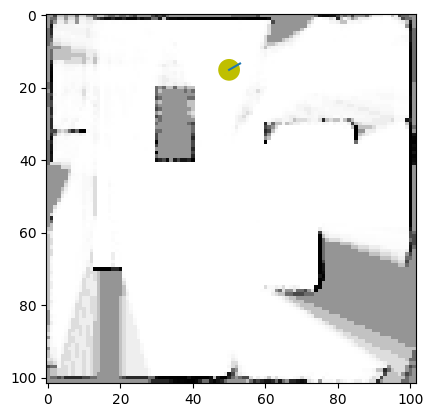

 20%|█▉        | 150/759 [00:40<03:50,  2.64it/s]

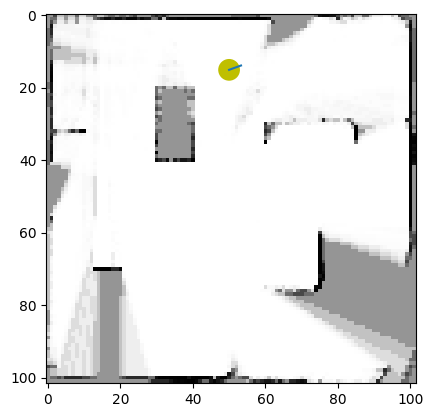

 20%|█▉        | 151/759 [00:41<03:47,  2.67it/s]

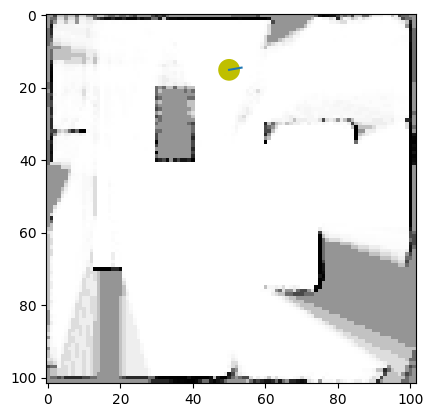

 20%|██        | 152/759 [00:41<03:40,  2.76it/s]

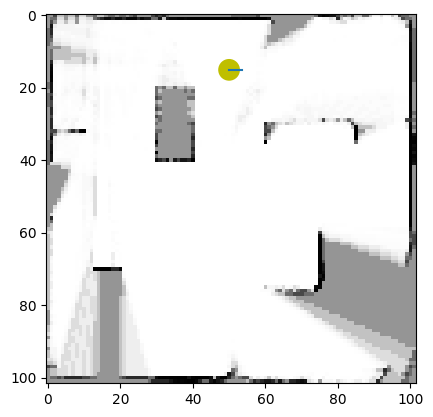

 20%|██        | 153/759 [00:41<03:22,  3.00it/s]

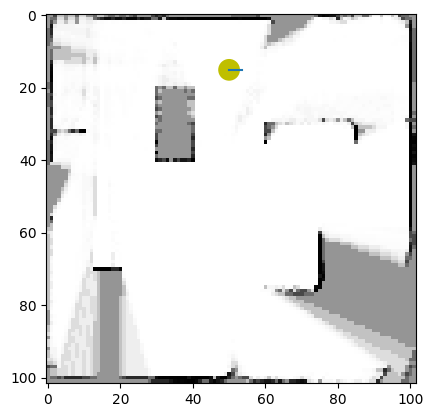

 20%|██        | 154/759 [00:42<03:21,  3.00it/s]

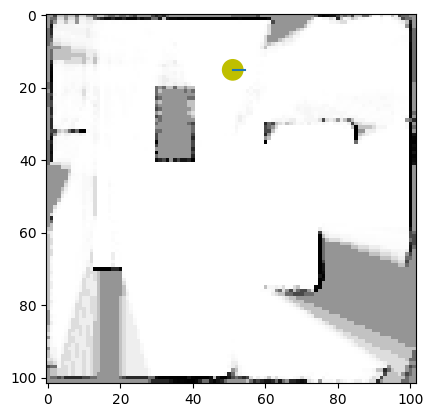

 20%|██        | 155/759 [00:42<03:00,  3.34it/s]

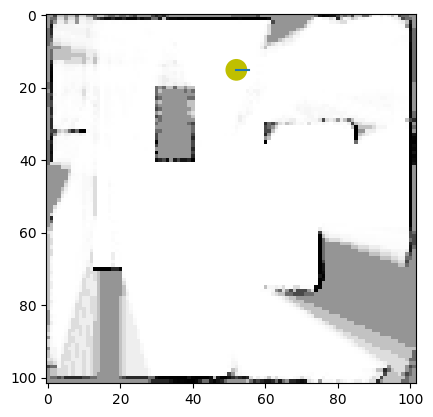

 21%|██        | 156/759 [00:42<03:12,  3.14it/s]

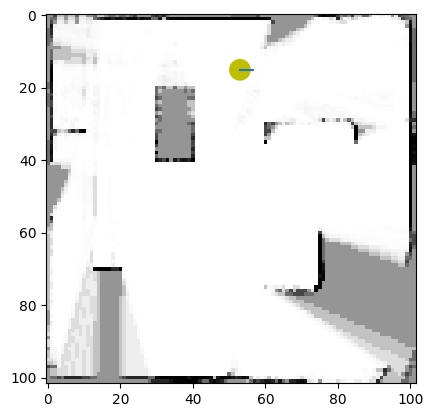

 21%|██        | 157/759 [00:43<02:53,  3.47it/s]

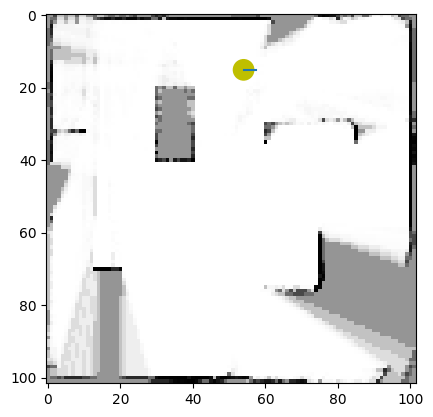

 21%|██        | 158/759 [00:43<02:56,  3.41it/s]

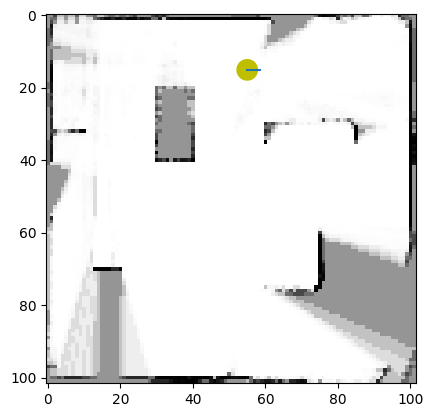

 21%|██        | 159/759 [00:43<03:08,  3.19it/s]

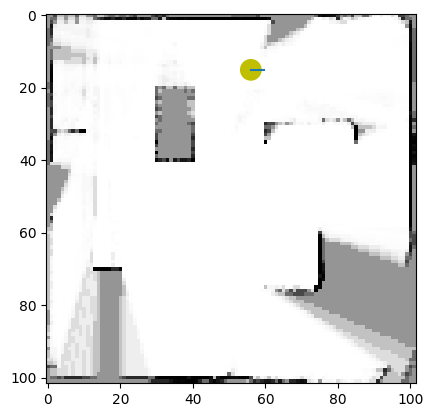

 21%|██        | 160/759 [00:43<02:54,  3.43it/s]

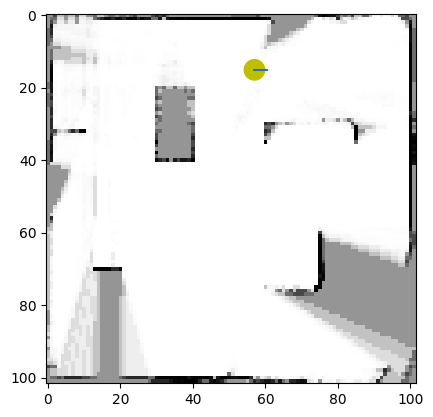

 21%|██        | 161/759 [00:44<03:03,  3.26it/s]

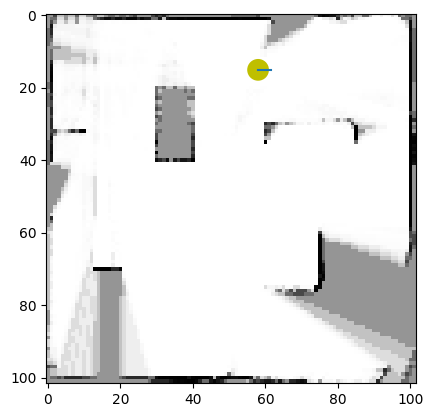

 21%|██▏       | 162/759 [00:44<02:43,  3.65it/s]

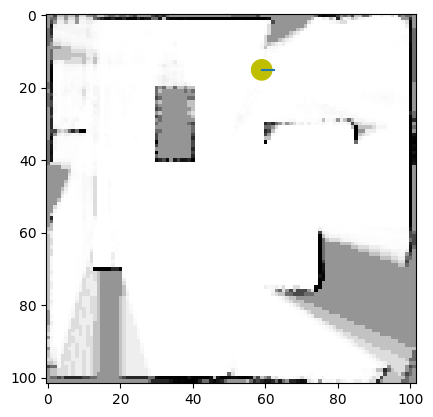

 21%|██▏       | 163/759 [00:44<03:13,  3.07it/s]

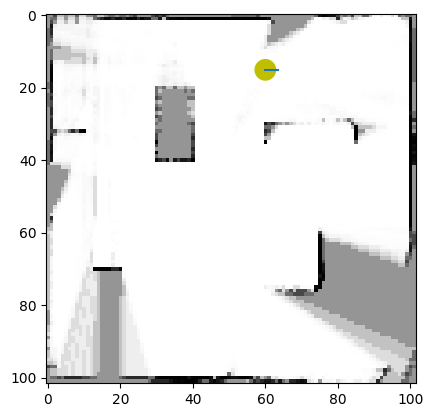

 22%|██▏       | 164/759 [00:45<02:52,  3.46it/s]

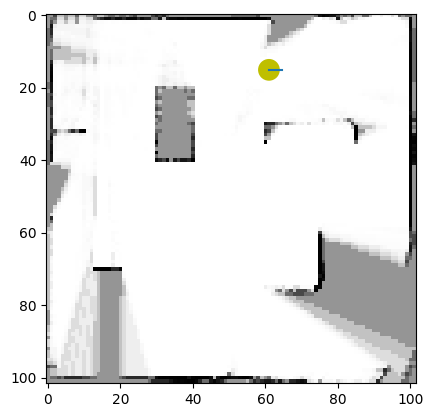

 22%|██▏       | 165/759 [00:45<02:53,  3.42it/s]

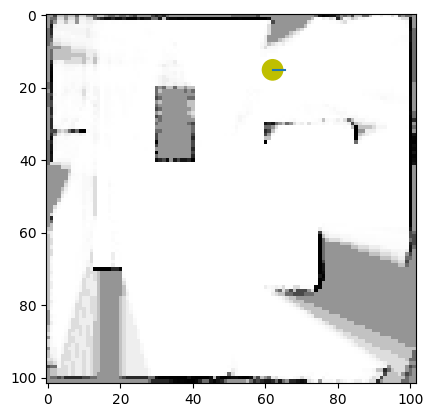

 22%|██▏       | 166/759 [00:45<02:44,  3.61it/s]

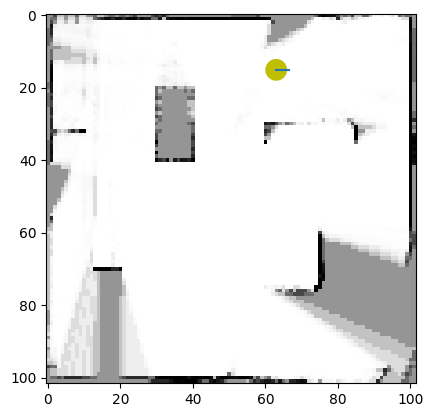

 22%|██▏       | 167/759 [00:46<03:12,  3.08it/s]

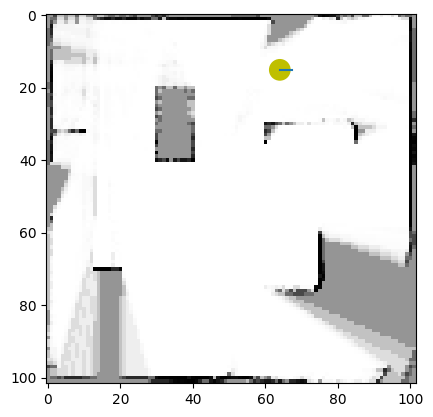

 22%|██▏       | 168/759 [00:46<03:11,  3.09it/s]

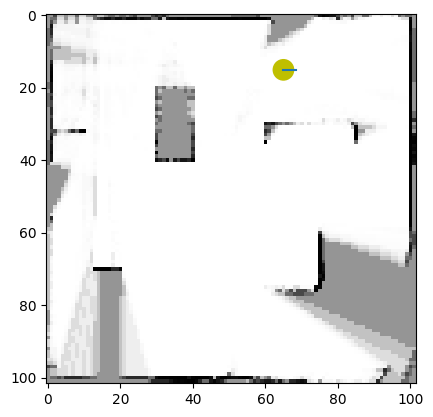

 22%|██▏       | 169/759 [00:46<03:09,  3.11it/s]

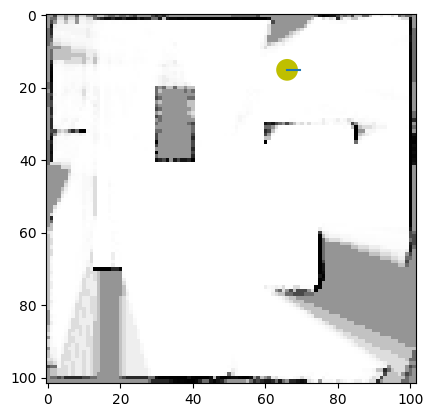

 22%|██▏       | 170/759 [00:47<03:05,  3.17it/s]

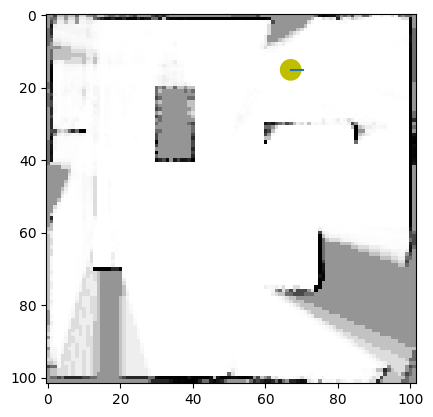

 23%|██▎       | 171/759 [00:47<03:10,  3.08it/s]

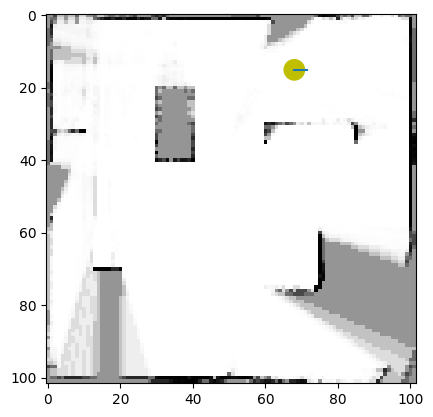

 23%|██▎       | 172/759 [00:47<02:50,  3.44it/s]

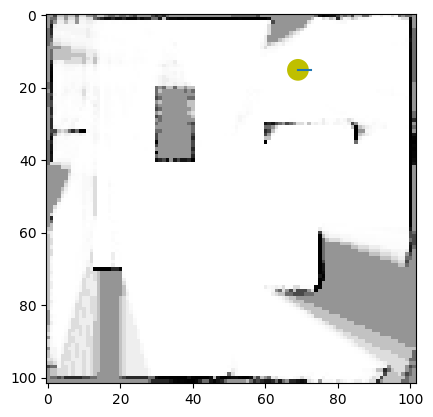

 23%|██▎       | 173/759 [00:48<03:09,  3.09it/s]

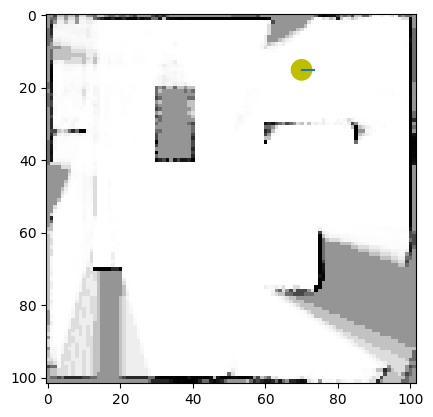

 23%|██▎       | 174/759 [00:48<02:51,  3.42it/s]

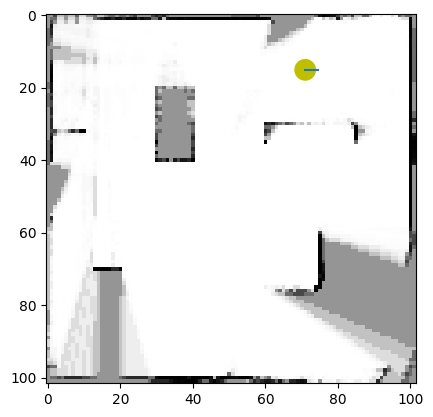

 23%|██▎       | 175/759 [00:48<02:54,  3.34it/s]

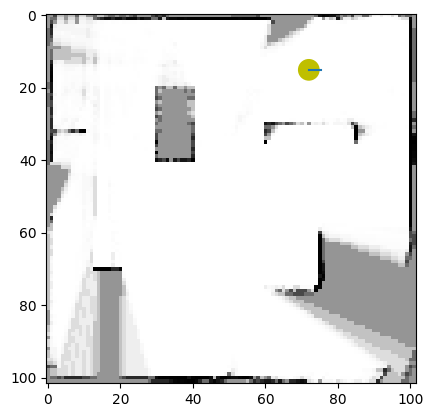

 23%|██▎       | 176/759 [00:48<02:57,  3.29it/s]

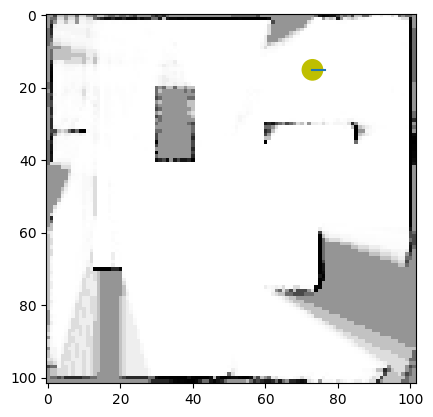

 23%|██▎       | 177/759 [00:49<02:58,  3.25it/s]

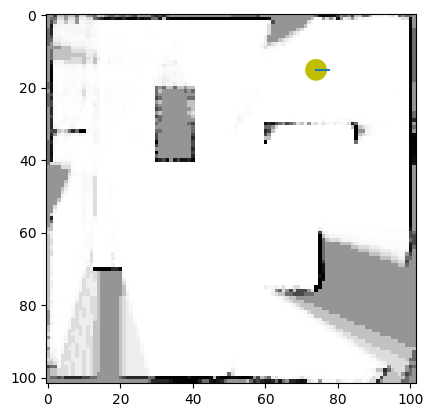

 23%|██▎       | 178/759 [00:49<02:47,  3.48it/s]

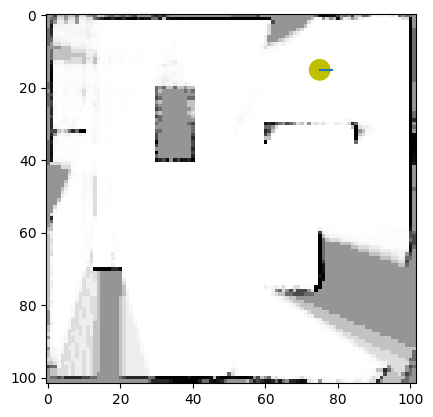

 24%|██▎       | 179/759 [00:49<02:57,  3.26it/s]

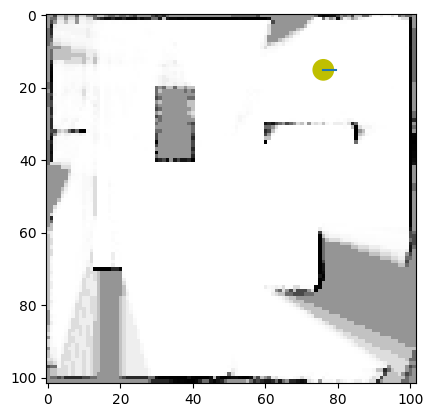

 24%|██▎       | 180/759 [00:50<02:41,  3.59it/s]

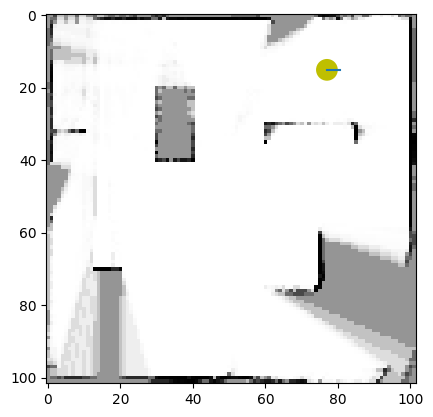

 24%|██▍       | 181/759 [00:50<02:44,  3.50it/s]

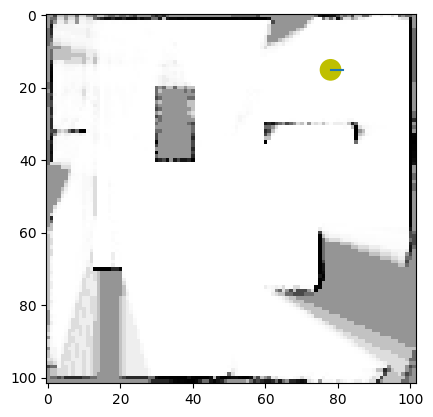

 24%|██▍       | 182/759 [00:50<02:43,  3.53it/s]

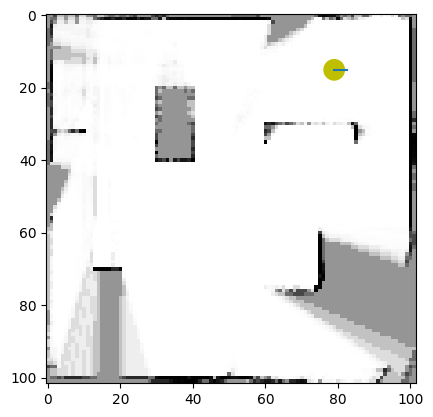

 24%|██▍       | 183/759 [00:50<02:48,  3.43it/s]

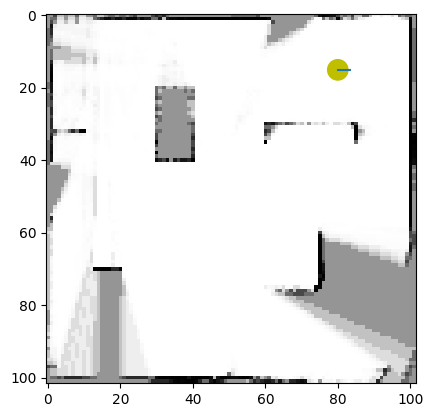

 24%|██▍       | 184/759 [00:51<02:31,  3.80it/s]

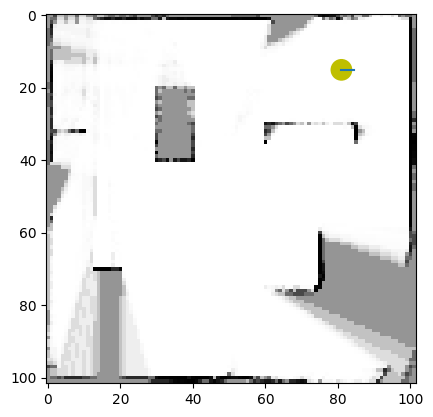

 24%|██▍       | 185/759 [00:51<02:29,  3.84it/s]

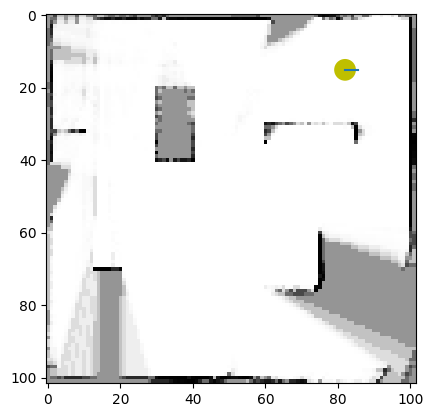

 25%|██▍       | 186/759 [00:51<02:40,  3.57it/s]

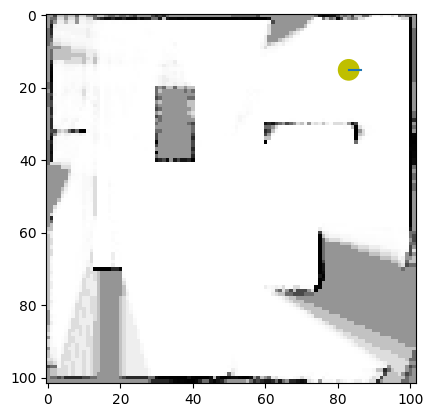

 25%|██▍       | 187/759 [00:52<02:48,  3.40it/s]

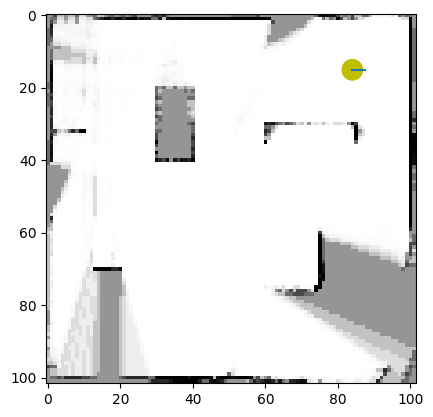

 25%|██▍       | 188/759 [00:52<02:43,  3.49it/s]

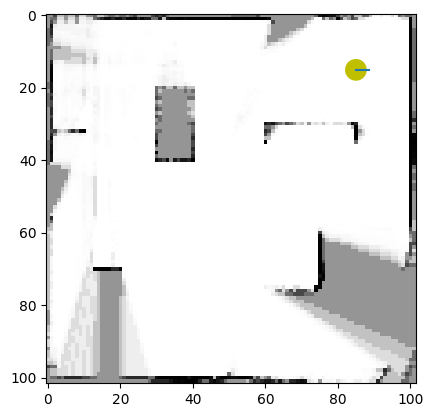

 25%|██▍       | 189/759 [00:52<02:54,  3.26it/s]

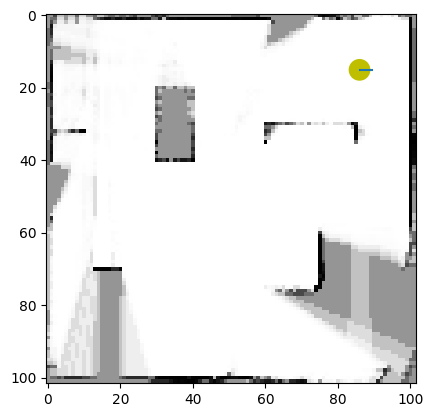

 25%|██▌       | 190/759 [00:52<02:41,  3.52it/s]

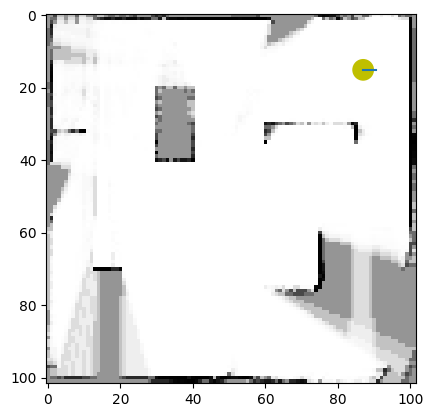

 25%|██▌       | 191/759 [00:53<02:47,  3.40it/s]

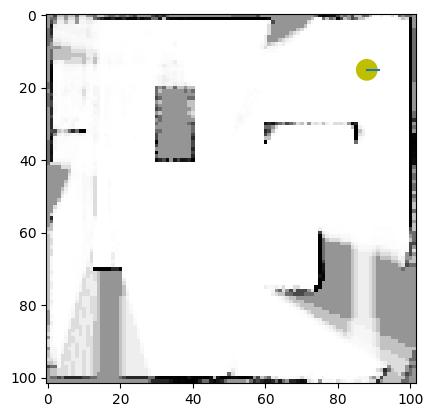

 25%|██▌       | 192/759 [00:53<03:03,  3.09it/s]

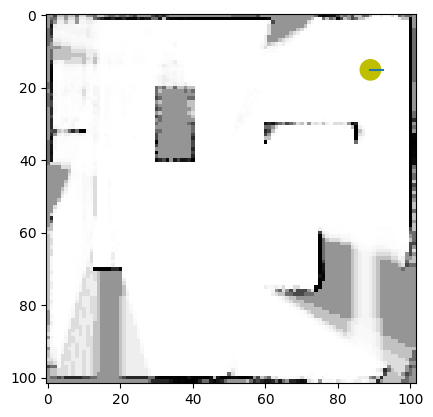

 25%|██▌       | 193/759 [00:53<03:08,  3.01it/s]

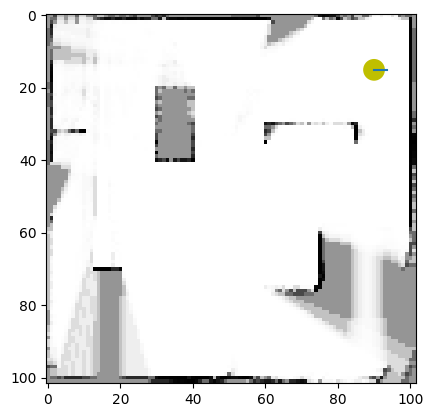

 26%|██▌       | 194/759 [00:54<03:15,  2.88it/s]

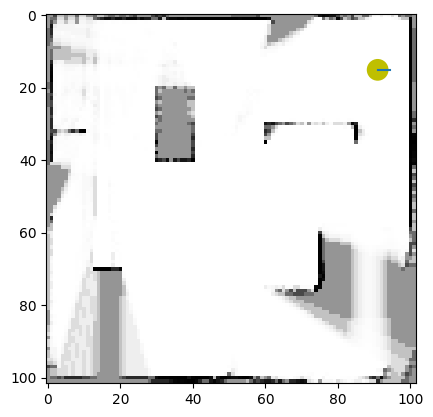

 26%|██▌       | 195/759 [00:54<04:03,  2.32it/s]

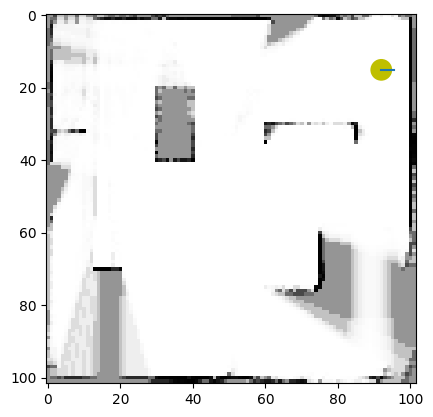

 26%|██▌       | 196/759 [00:55<03:41,  2.55it/s]

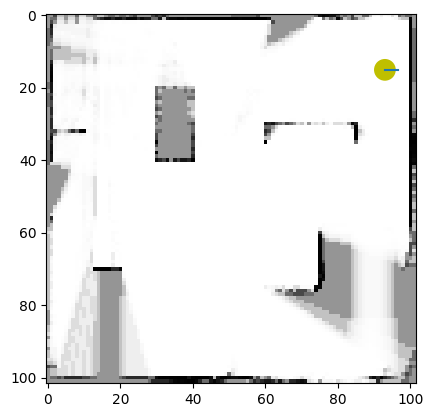

 26%|██▌       | 197/759 [00:55<03:27,  2.70it/s]

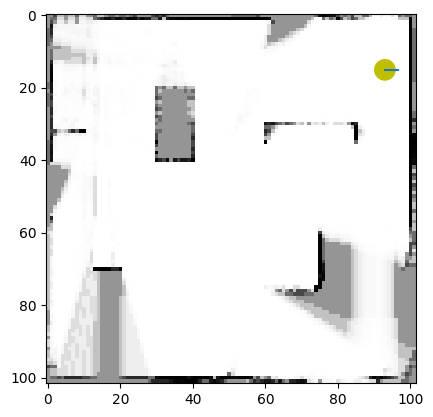

 26%|██▌       | 198/759 [00:55<03:21,  2.79it/s]

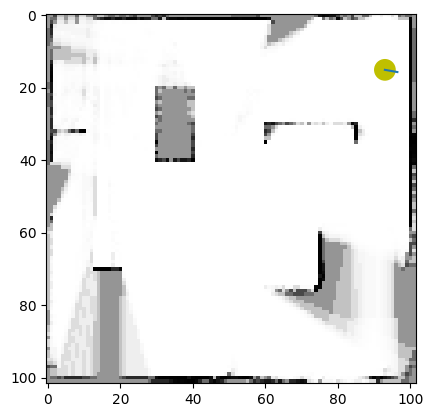

 26%|██▌       | 199/759 [00:56<03:34,  2.61it/s]

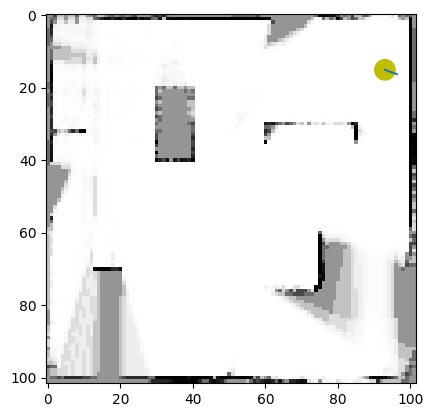

 26%|██▋       | 200/759 [00:56<03:06,  3.00it/s]

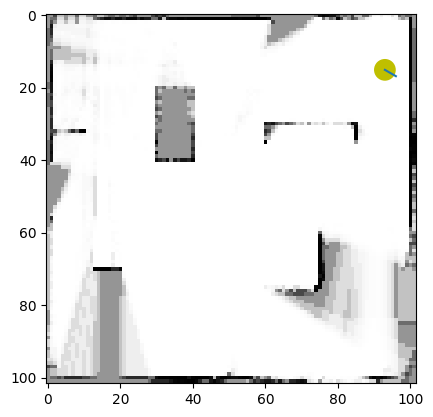

 26%|██▋       | 201/759 [00:56<03:23,  2.74it/s]

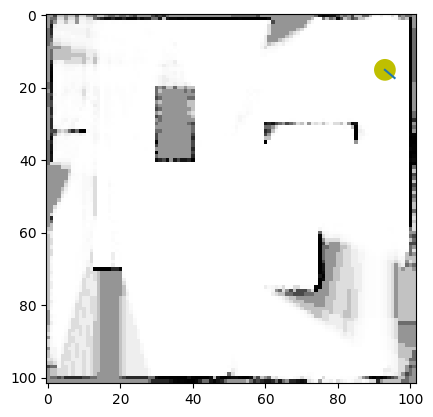

 27%|██▋       | 202/759 [00:57<02:55,  3.17it/s]

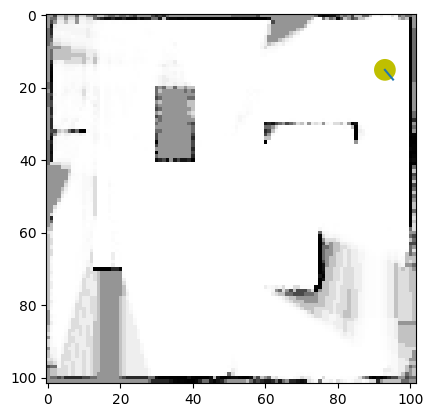

 27%|██▋       | 203/759 [00:57<03:13,  2.88it/s]

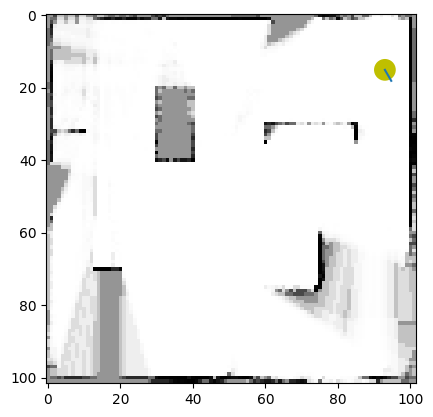

 27%|██▋       | 204/759 [00:57<02:53,  3.19it/s]

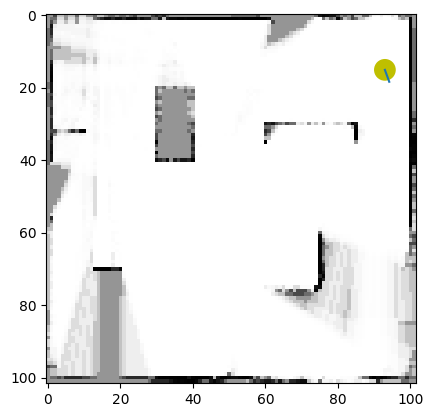

 27%|██▋       | 205/759 [00:58<02:52,  3.21it/s]

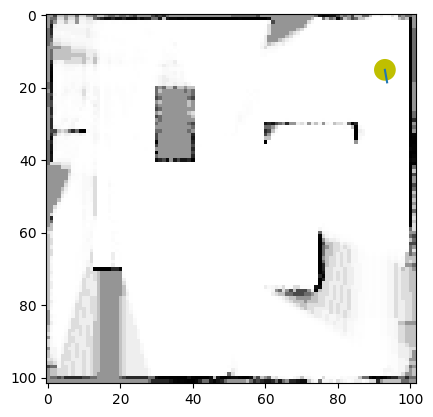

 27%|██▋       | 206/759 [00:58<02:47,  3.31it/s]

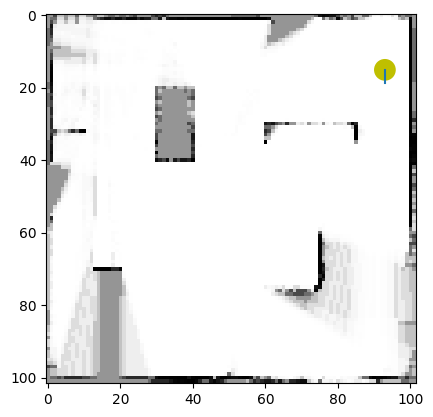

 27%|██▋       | 207/759 [00:58<02:53,  3.18it/s]

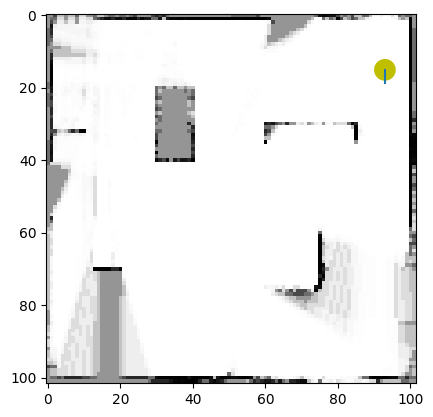

 27%|██▋       | 208/759 [00:58<02:35,  3.54it/s]

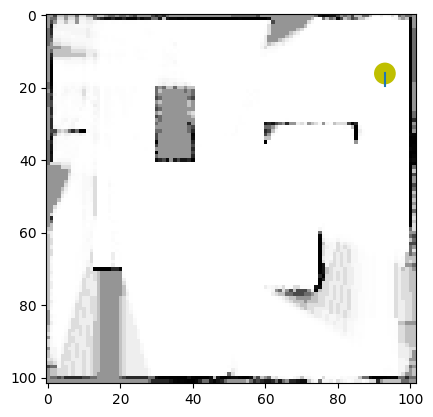

 28%|██▊       | 209/759 [00:59<02:56,  3.12it/s]

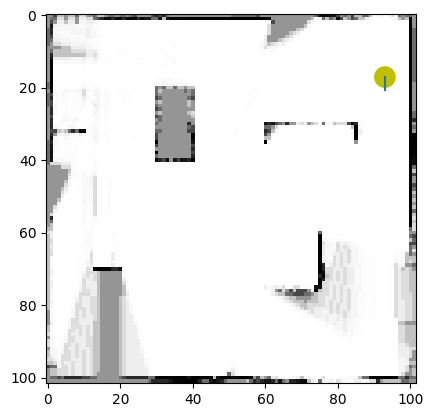

 28%|██▊       | 210/759 [00:59<02:35,  3.53it/s]

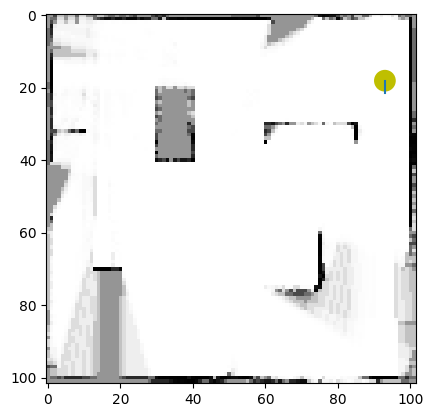

 28%|██▊       | 211/759 [00:59<02:45,  3.31it/s]

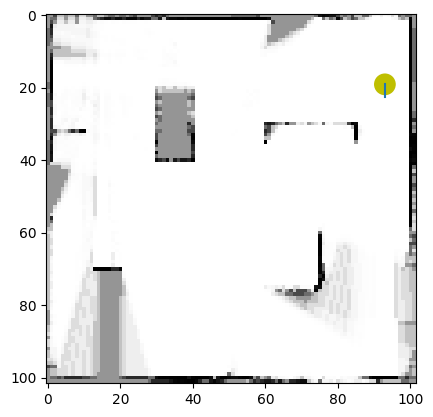

 28%|██▊       | 212/759 [01:00<02:37,  3.46it/s]

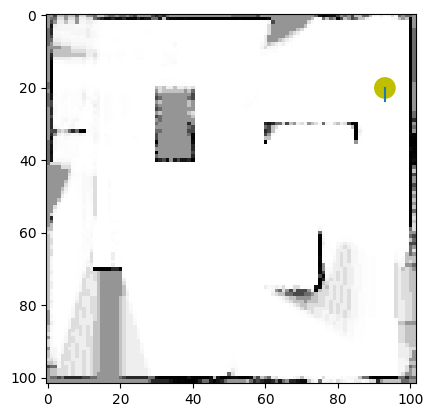

 28%|██▊       | 213/759 [01:00<02:45,  3.30it/s]

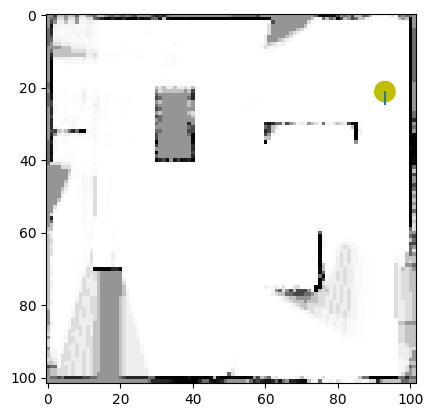

 28%|██▊       | 214/759 [01:00<02:37,  3.45it/s]

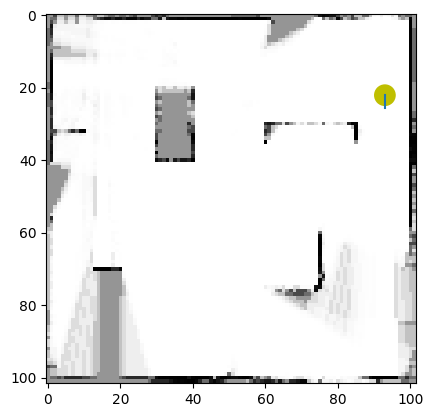

 28%|██▊       | 215/759 [01:01<02:44,  3.32it/s]

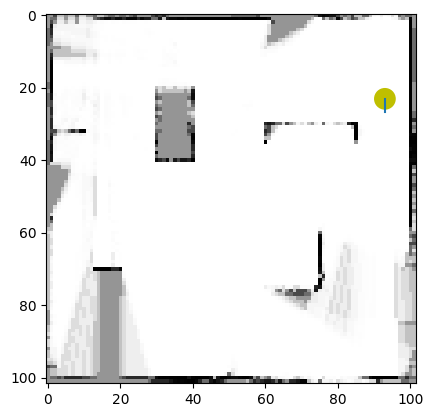

 28%|██▊       | 216/759 [01:01<02:28,  3.66it/s]

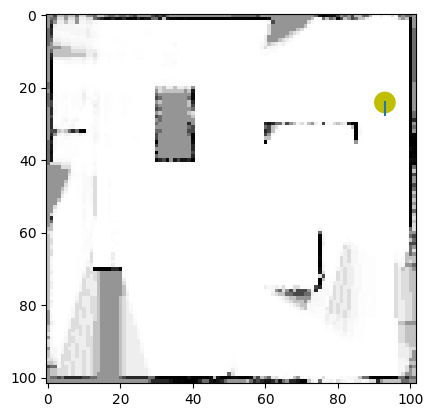

 29%|██▊       | 217/759 [01:01<02:51,  3.16it/s]

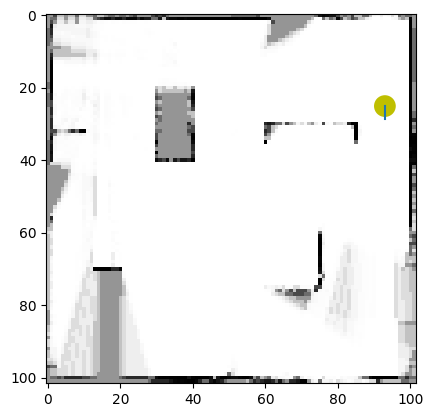

 29%|██▊       | 218/759 [01:02<02:51,  3.16it/s]

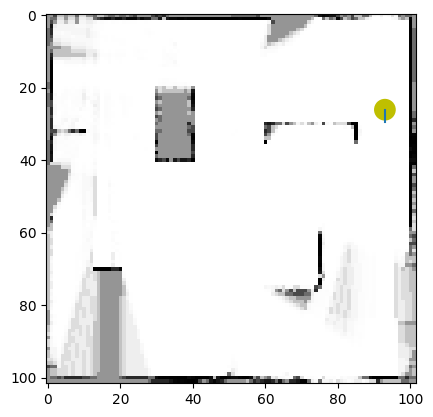

 29%|██▉       | 219/759 [01:02<02:47,  3.22it/s]

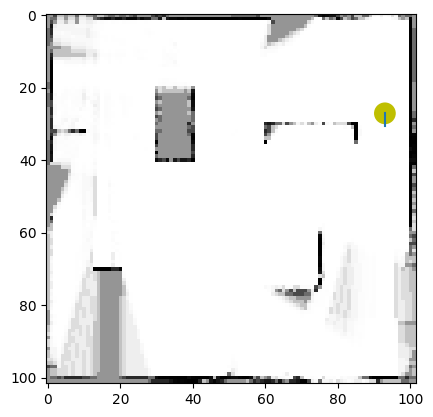

 29%|██▉       | 220/759 [01:02<02:48,  3.19it/s]

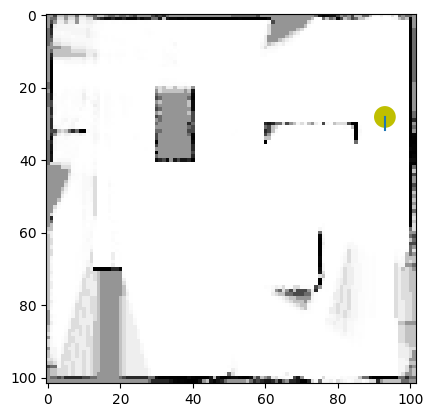

 29%|██▉       | 221/759 [01:02<02:32,  3.53it/s]

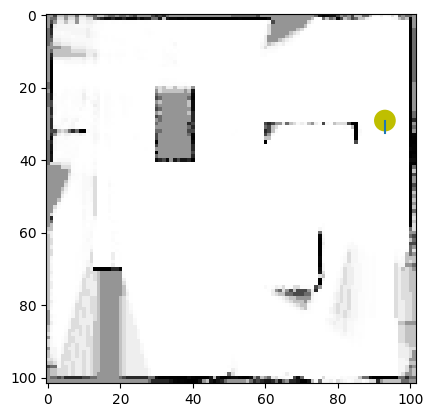

 29%|██▉       | 222/759 [01:03<02:54,  3.09it/s]

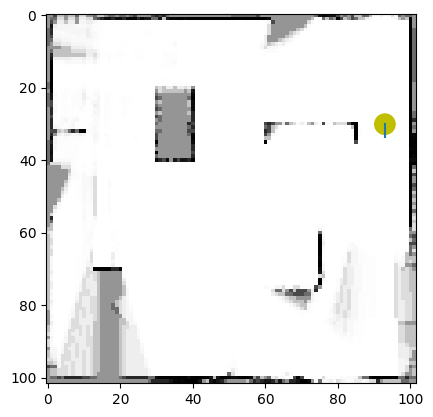

 29%|██▉       | 223/759 [01:03<02:51,  3.13it/s]

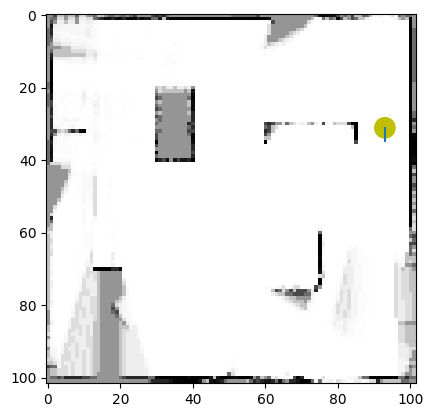

 30%|██▉       | 224/759 [01:03<02:34,  3.47it/s]

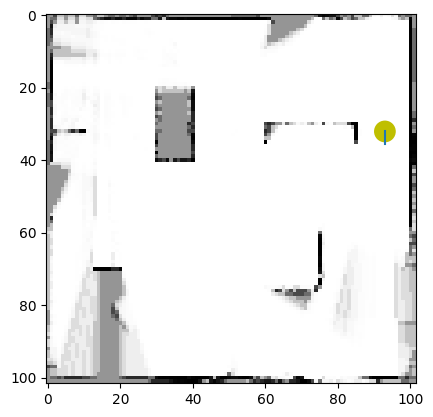

 30%|██▉       | 225/759 [01:04<03:16,  2.72it/s]

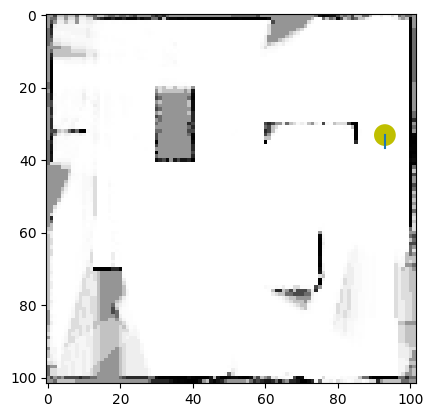

 30%|██▉       | 226/759 [01:04<03:20,  2.66it/s]

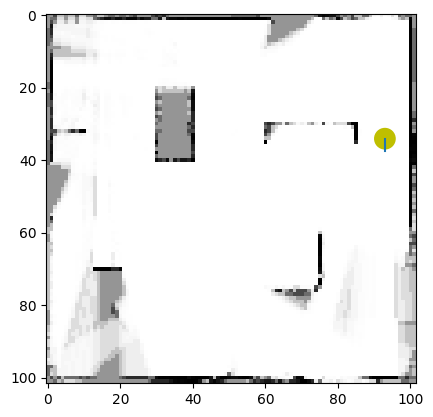

 30%|██▉       | 227/759 [01:05<03:09,  2.81it/s]

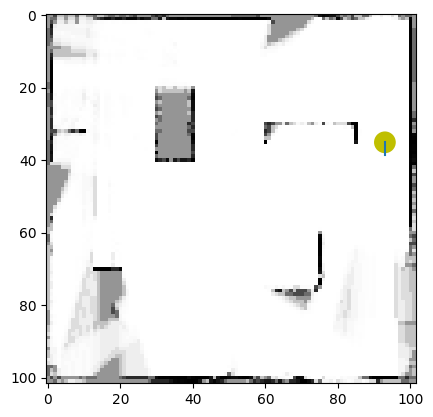

 30%|███       | 228/759 [01:05<03:17,  2.69it/s]

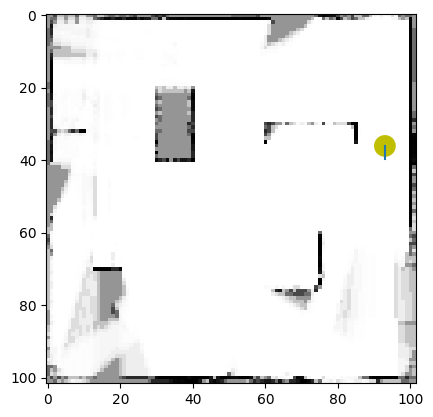

 30%|███       | 229/759 [01:05<03:25,  2.58it/s]

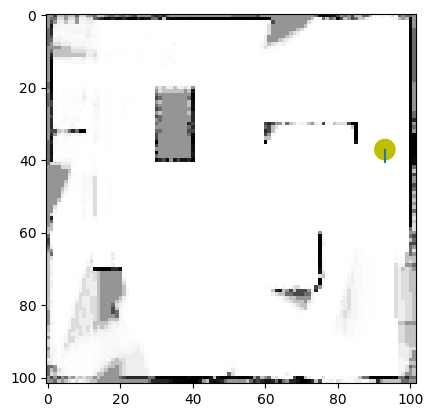

 30%|███       | 230/759 [01:06<03:09,  2.79it/s]

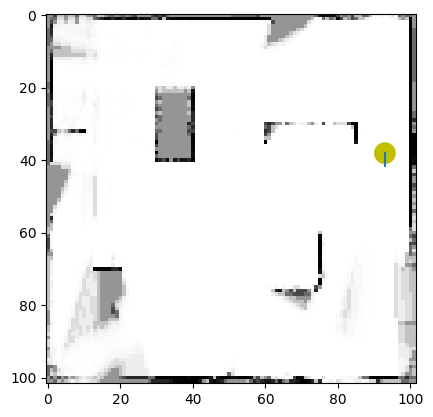

 30%|███       | 231/759 [01:06<03:10,  2.78it/s]

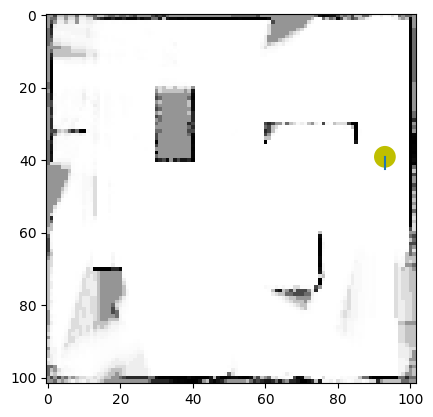

 31%|███       | 232/759 [01:06<03:02,  2.88it/s]

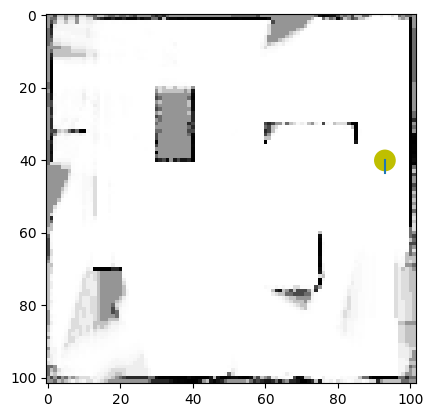

 31%|███       | 233/759 [01:07<03:02,  2.89it/s]

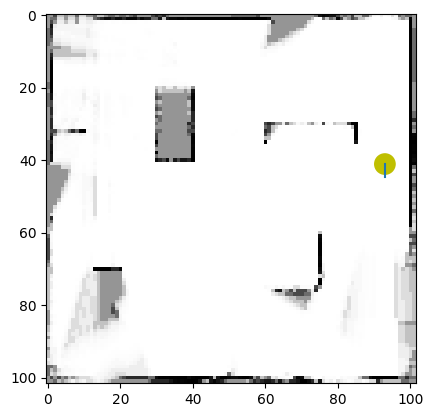

 31%|███       | 234/759 [01:07<02:42,  3.22it/s]

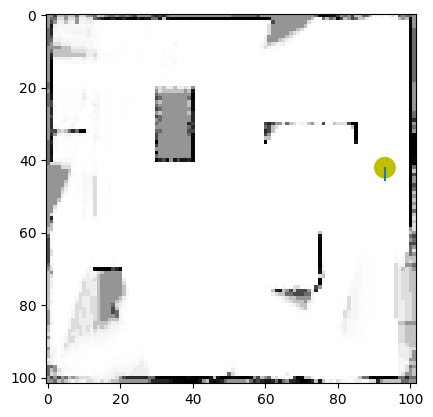

 31%|███       | 235/759 [01:07<02:55,  2.99it/s]

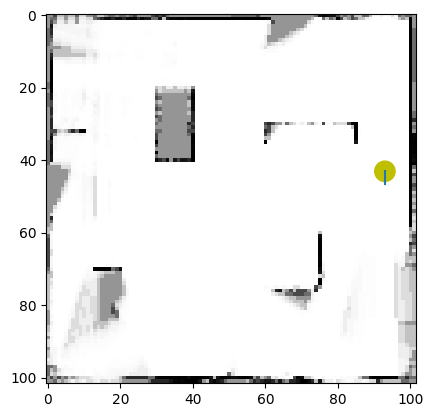

 31%|███       | 236/759 [01:08<02:57,  2.95it/s]

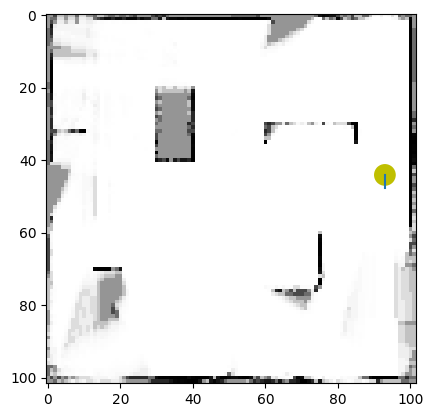

 31%|███       | 237/759 [01:08<03:08,  2.77it/s]

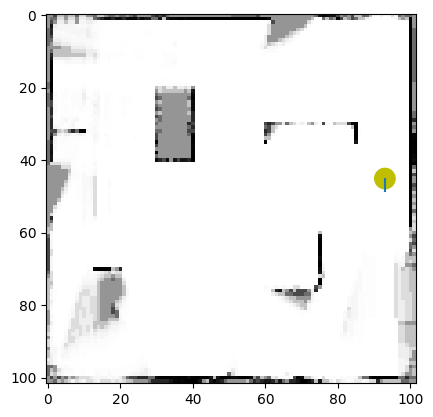

 31%|███▏      | 238/759 [01:09<03:24,  2.54it/s]

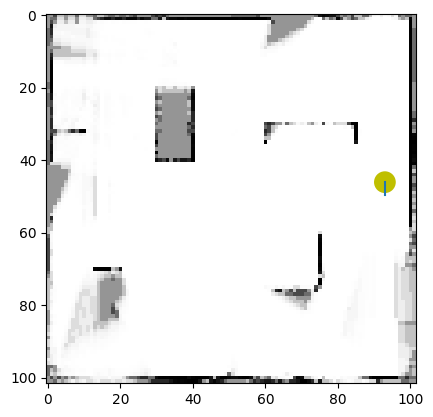

 31%|███▏      | 239/759 [01:09<03:27,  2.51it/s]

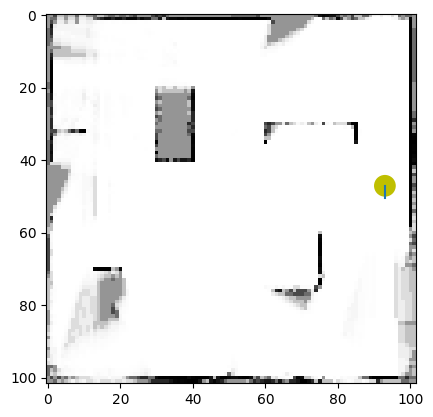

 32%|███▏      | 240/759 [01:10<03:48,  2.27it/s]

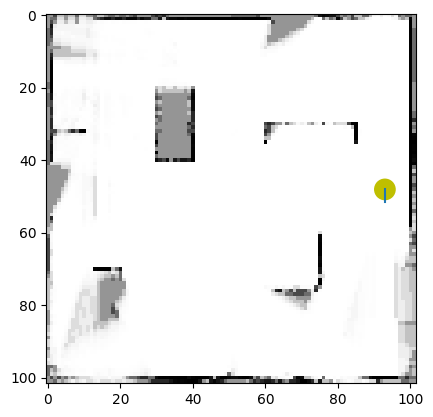

 32%|███▏      | 241/759 [01:10<03:38,  2.37it/s]

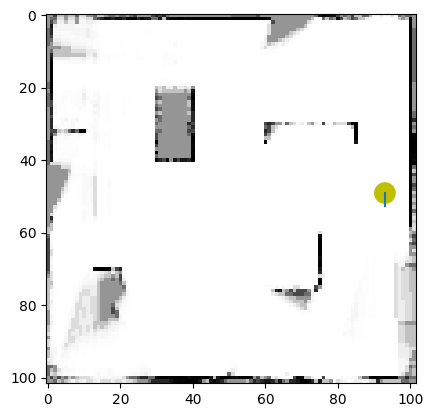

 32%|███▏      | 242/759 [01:10<03:58,  2.17it/s]

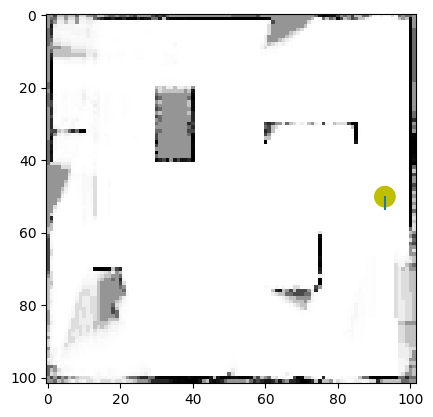

 32%|███▏      | 243/759 [01:11<03:38,  2.36it/s]

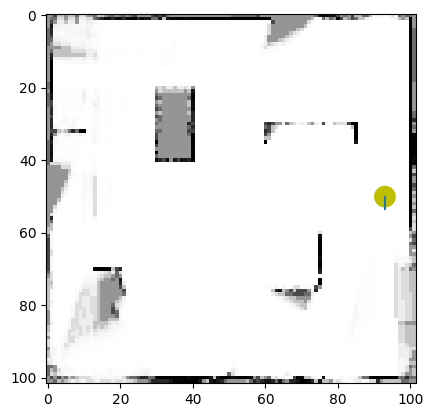

 32%|███▏      | 244/759 [01:11<03:52,  2.22it/s]

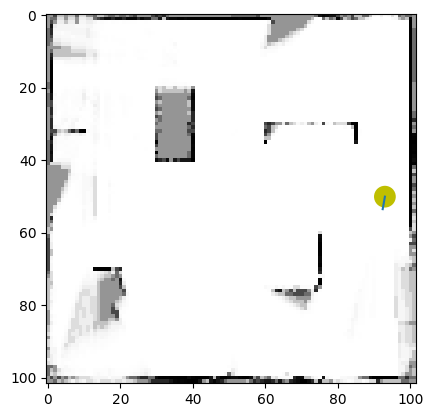

 32%|███▏      | 245/759 [01:12<03:49,  2.24it/s]

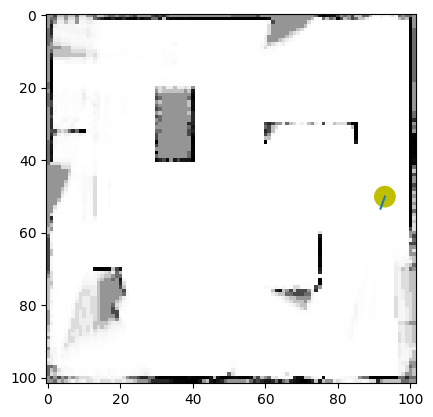

 32%|███▏      | 246/759 [01:12<03:21,  2.55it/s]

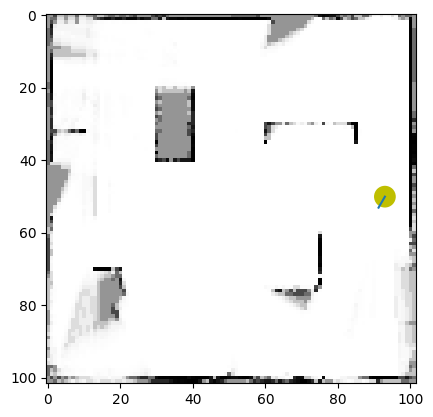

 33%|███▎      | 247/759 [01:13<03:37,  2.35it/s]

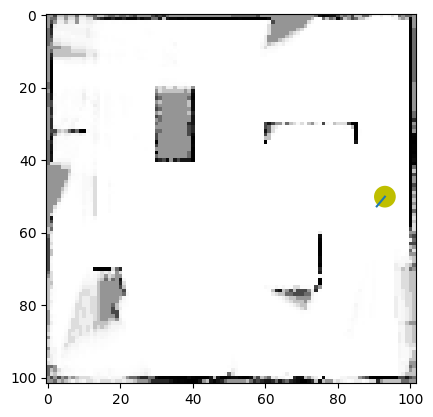

 33%|███▎      | 248/759 [01:13<03:08,  2.71it/s]

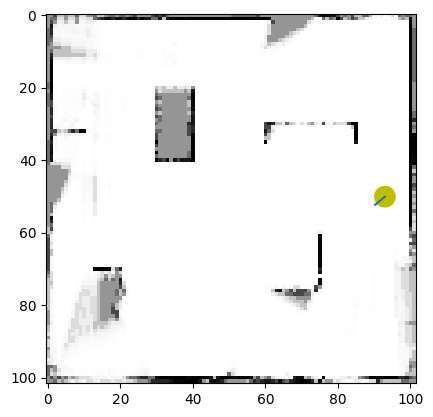

 33%|███▎      | 249/759 [01:13<03:17,  2.58it/s]

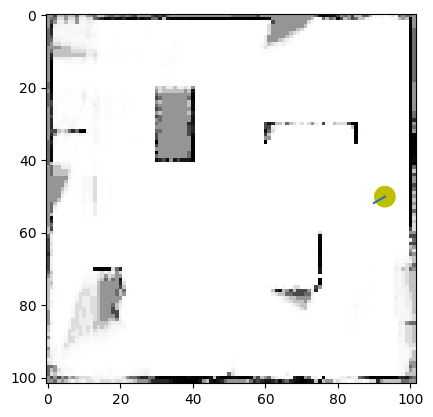

 33%|███▎      | 250/759 [01:13<02:54,  2.92it/s]

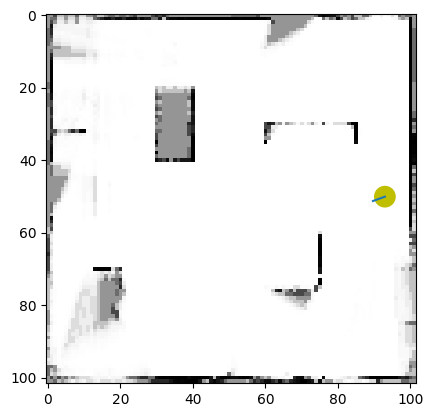

 33%|███▎      | 251/759 [01:14<03:13,  2.63it/s]

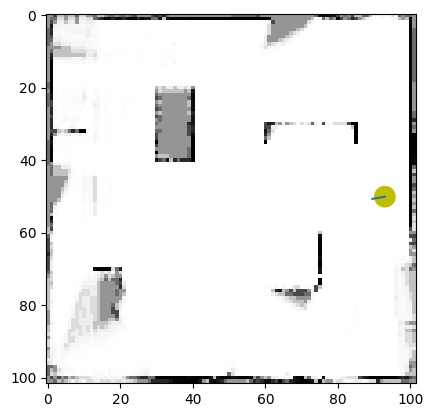

 33%|███▎      | 252/759 [01:14<03:09,  2.67it/s]

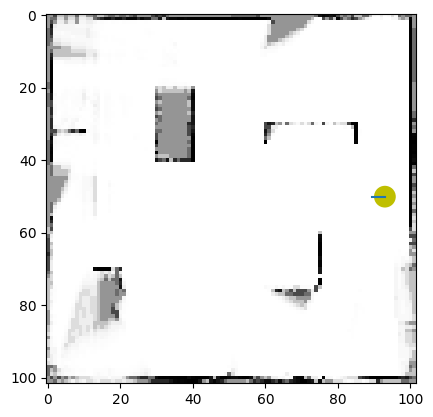

 33%|███▎      | 253/759 [01:15<03:16,  2.58it/s]

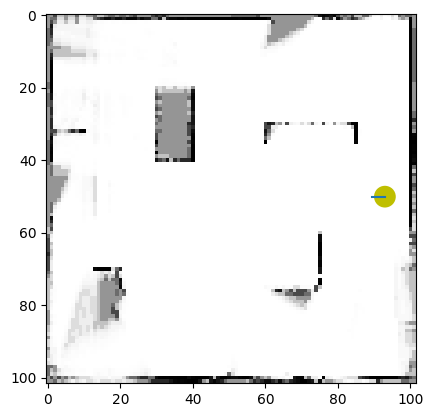

 33%|███▎      | 254/759 [01:15<03:03,  2.75it/s]

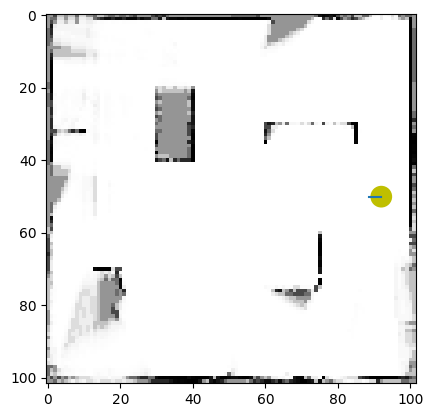

 34%|███▎      | 255/759 [01:15<03:07,  2.69it/s]

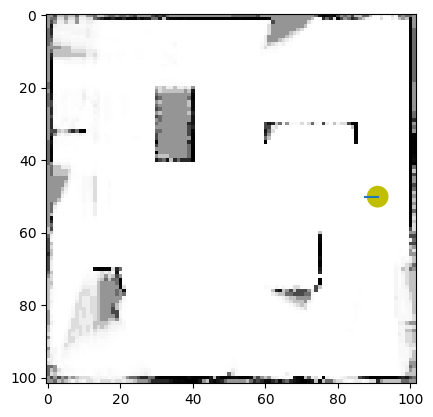

 34%|███▎      | 256/759 [01:16<03:06,  2.70it/s]

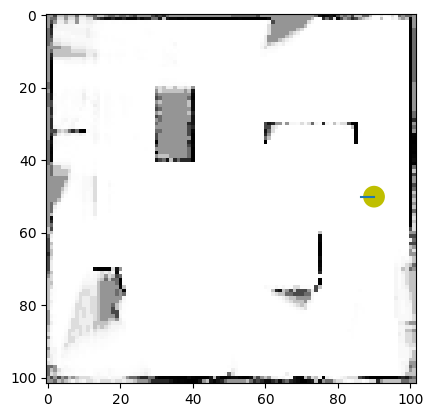

 34%|███▍      | 257/759 [01:16<02:55,  2.86it/s]

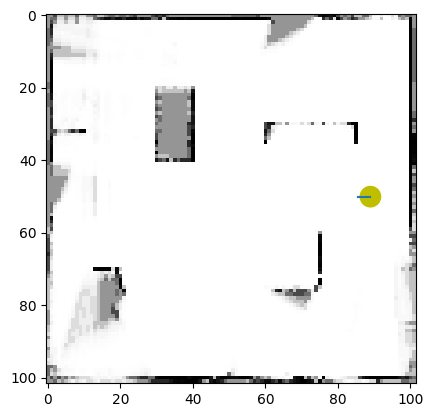

 34%|███▍      | 258/759 [01:16<02:45,  3.03it/s]

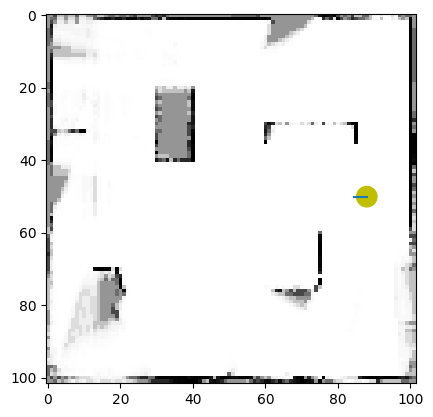

 34%|███▍      | 259/759 [01:17<02:47,  2.98it/s]

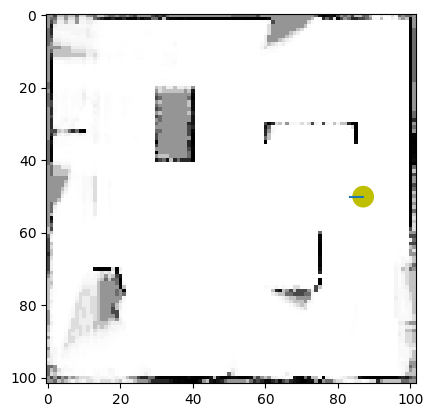

 34%|███▍      | 260/759 [01:17<02:59,  2.78it/s]

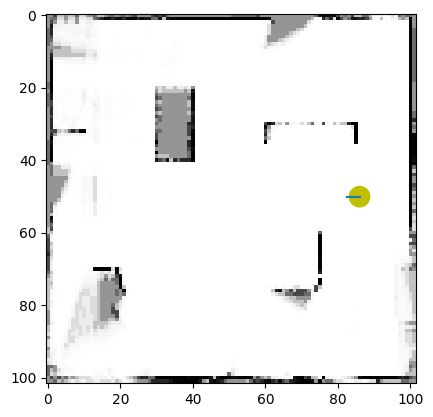

 34%|███▍      | 261/759 [01:17<02:37,  3.16it/s]

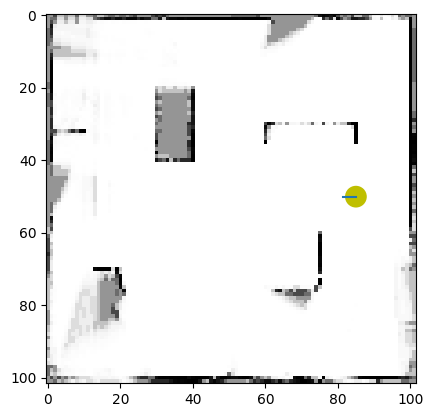

 35%|███▍      | 262/759 [01:18<03:05,  2.68it/s]

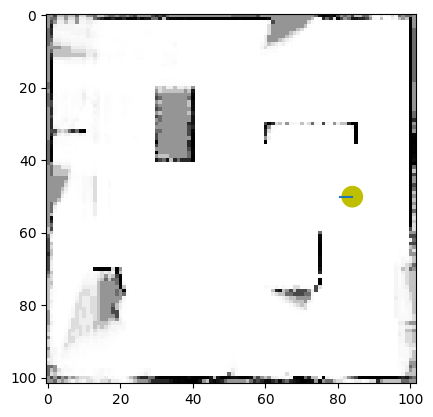

 35%|███▍      | 263/759 [01:18<02:41,  3.08it/s]

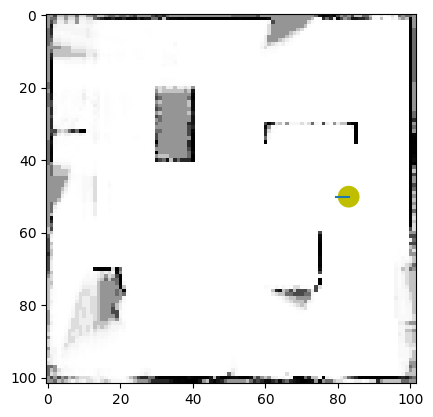

 35%|███▍      | 264/759 [01:18<02:59,  2.76it/s]

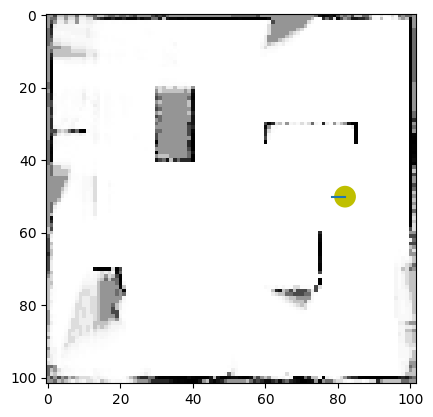

 35%|███▍      | 265/759 [01:19<02:47,  2.95it/s]

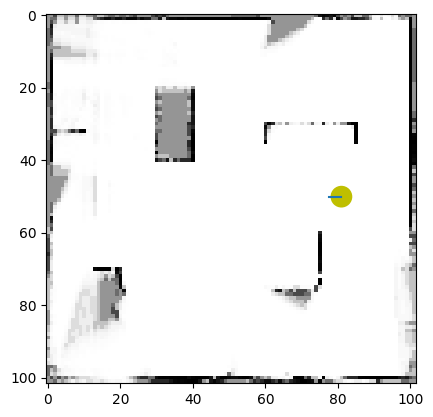

 35%|███▌      | 266/759 [01:19<03:03,  2.68it/s]

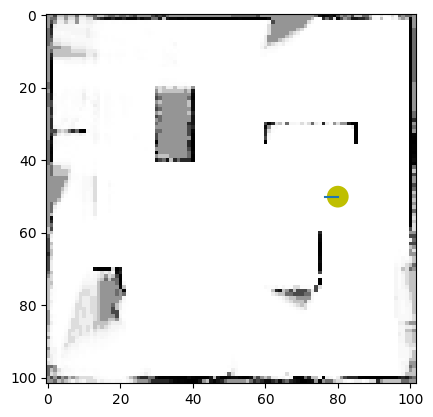

 35%|███▌      | 267/759 [01:19<02:42,  3.03it/s]

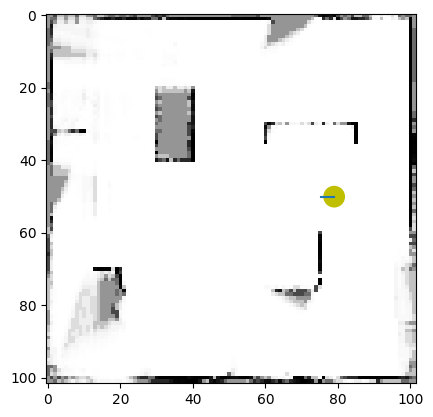

 35%|███▌      | 268/759 [01:20<02:36,  3.13it/s]

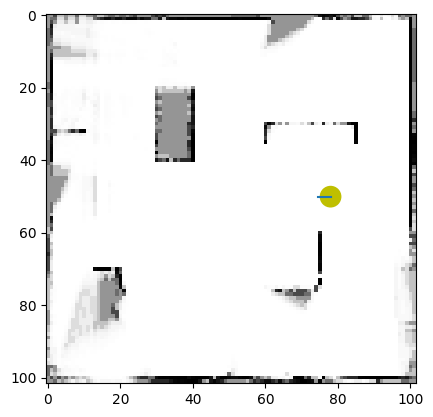

 35%|███▌      | 269/759 [01:20<02:40,  3.06it/s]

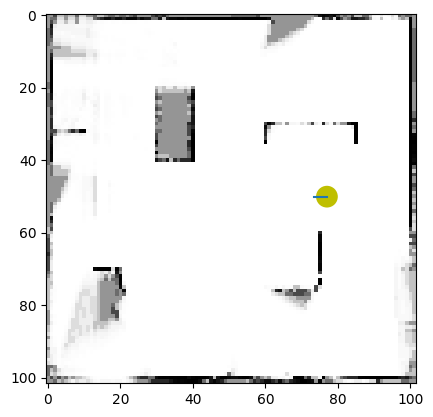

 36%|███▌      | 270/759 [01:20<02:41,  3.03it/s]

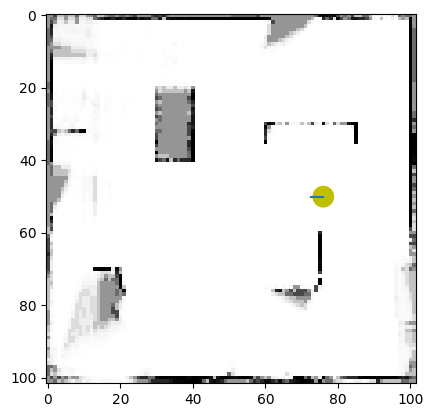

 36%|███▌      | 271/759 [01:21<02:42,  3.00it/s]

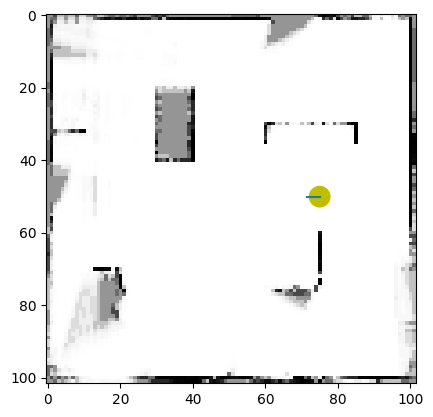

 36%|███▌      | 272/759 [01:21<02:54,  2.79it/s]

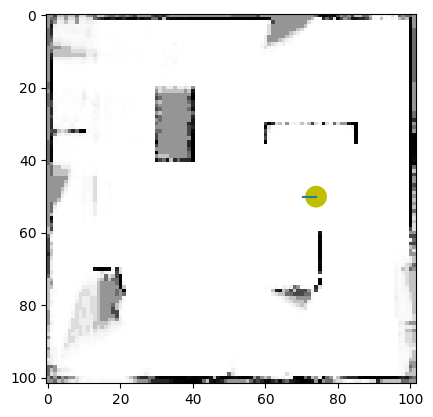

 36%|███▌      | 273/759 [01:22<02:54,  2.78it/s]

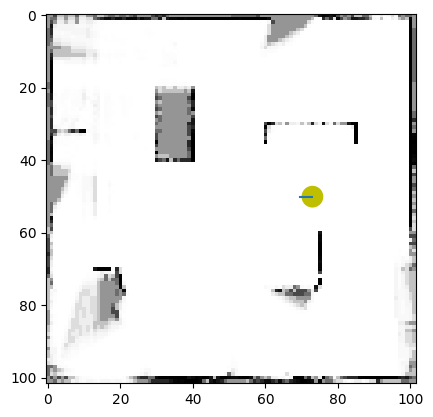

 36%|███▌      | 274/759 [01:22<03:03,  2.64it/s]

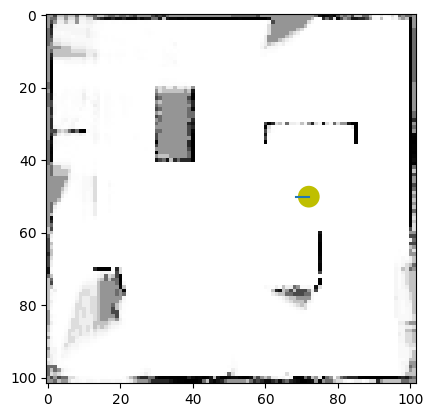

 36%|███▌      | 275/759 [01:22<02:41,  2.99it/s]

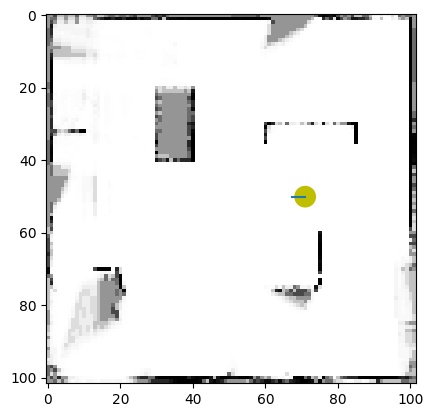

 36%|███▋      | 276/759 [01:23<02:54,  2.77it/s]

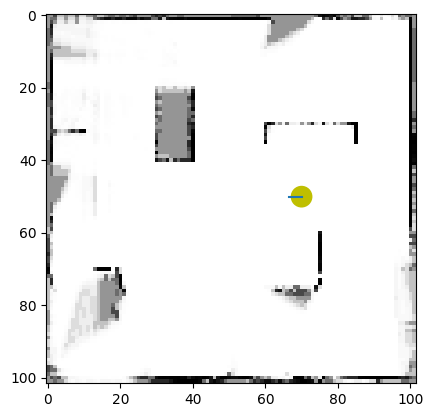

 36%|███▋      | 277/759 [01:23<03:06,  2.59it/s]

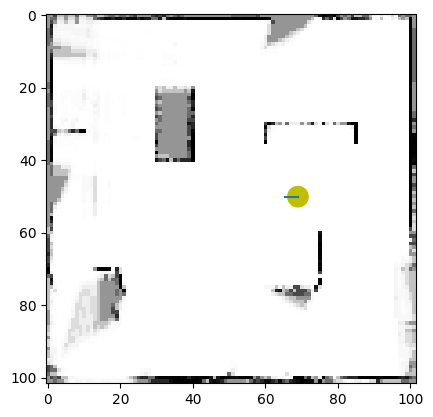

 37%|███▋      | 278/759 [01:23<02:39,  3.02it/s]

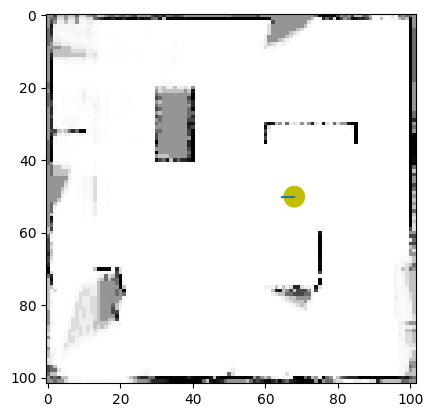

 37%|███▋      | 279/759 [01:24<02:51,  2.79it/s]

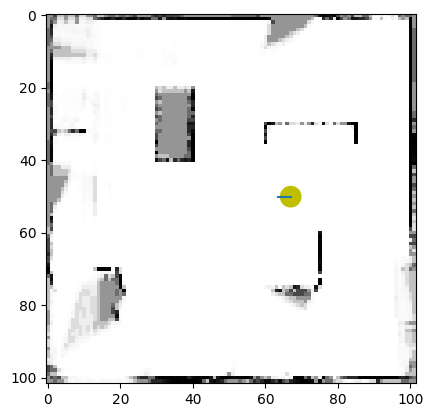

 37%|███▋      | 280/759 [01:24<03:18,  2.42it/s]

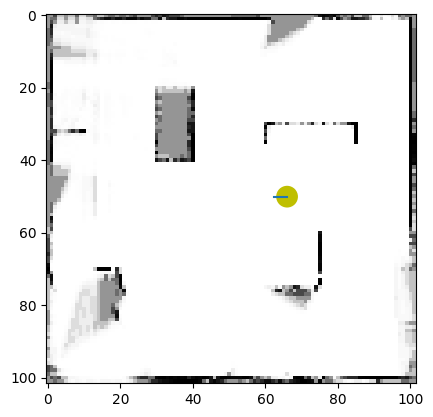

 37%|███▋      | 281/759 [01:25<03:15,  2.45it/s]

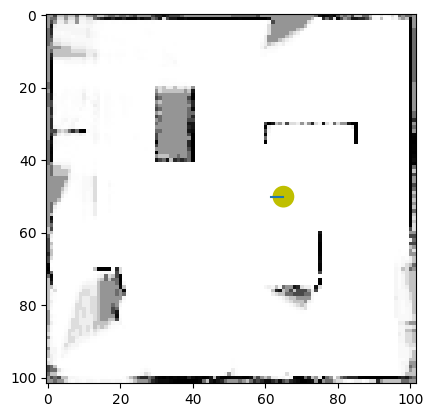

 37%|███▋      | 282/759 [01:25<03:17,  2.41it/s]

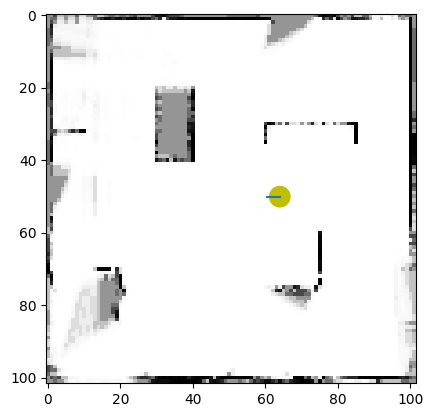

 37%|███▋      | 283/759 [01:25<03:08,  2.52it/s]

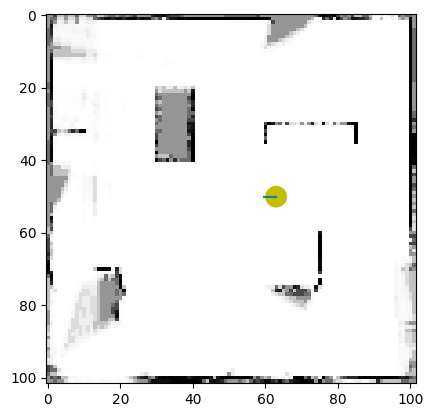

 37%|███▋      | 284/759 [01:26<03:23,  2.33it/s]

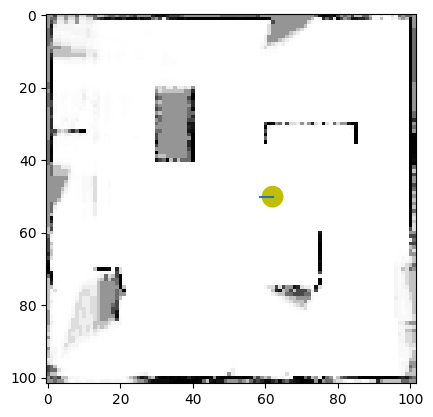

 38%|███▊      | 285/759 [01:26<03:09,  2.50it/s]

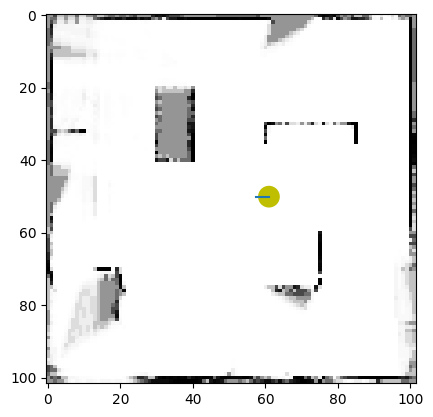

 38%|███▊      | 286/759 [01:27<03:24,  2.31it/s]

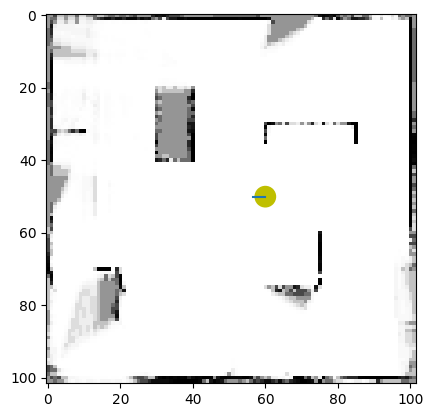

 38%|███▊      | 287/759 [01:27<03:34,  2.20it/s]

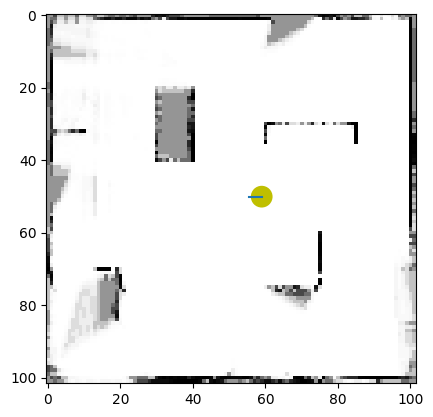

 38%|███▊      | 288/759 [01:28<03:29,  2.25it/s]

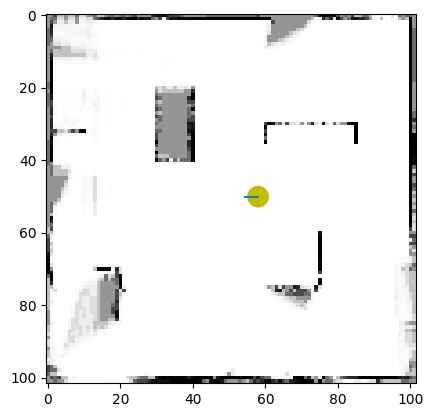

 38%|███▊      | 289/759 [01:28<03:39,  2.15it/s]

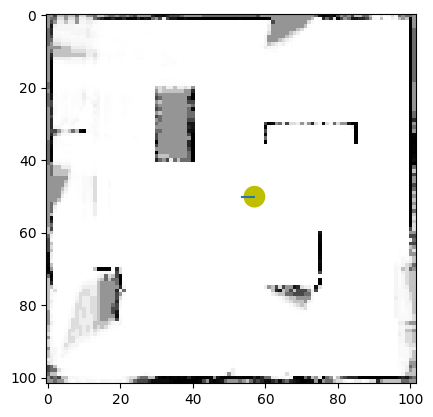

 38%|███▊      | 290/759 [01:29<03:33,  2.20it/s]

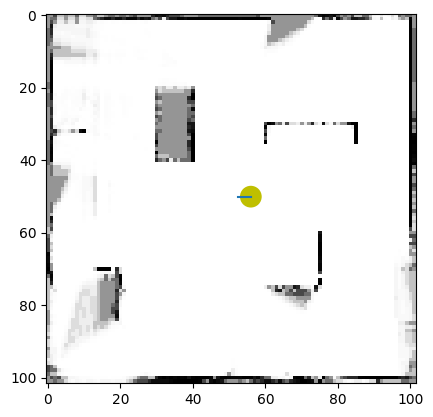

 38%|███▊      | 291/759 [01:29<03:43,  2.09it/s]

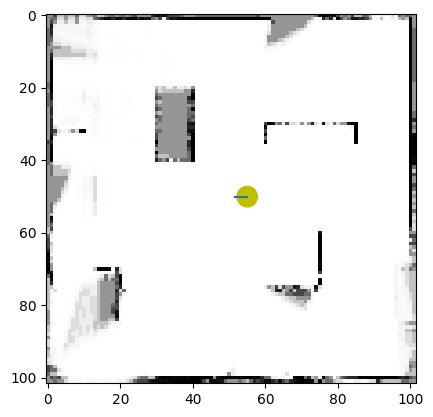

 38%|███▊      | 292/759 [01:29<03:24,  2.29it/s]

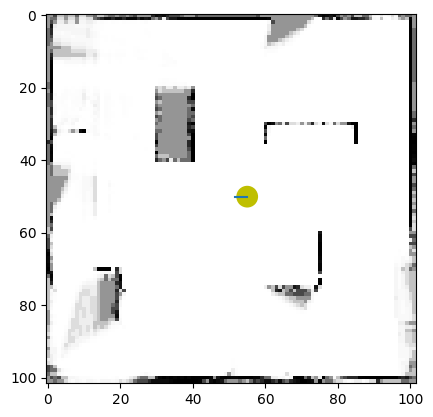

 39%|███▊      | 293/759 [01:30<03:23,  2.29it/s]

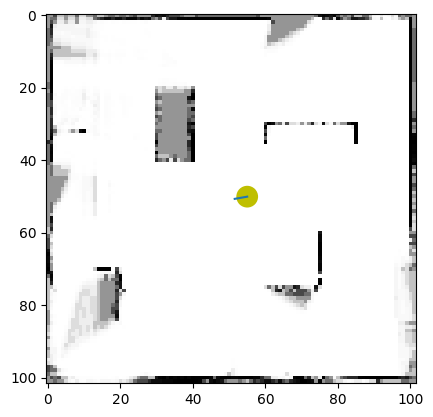

 39%|███▊      | 294/759 [01:30<03:21,  2.31it/s]

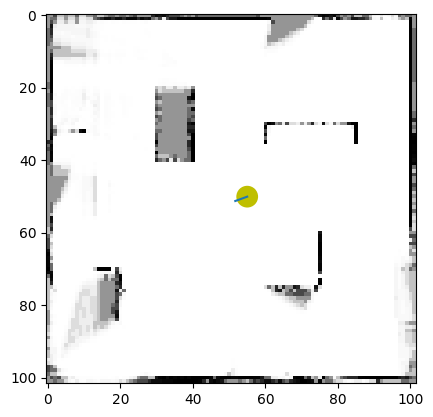

 39%|███▉      | 295/759 [01:31<03:30,  2.20it/s]

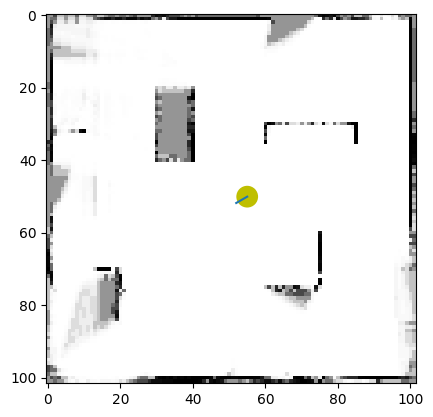

 39%|███▉      | 296/759 [01:31<03:27,  2.23it/s]

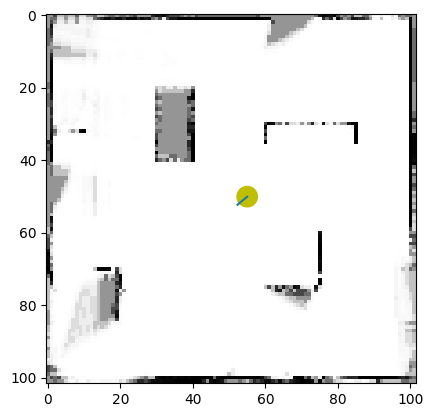

 39%|███▉      | 297/759 [01:32<03:13,  2.39it/s]

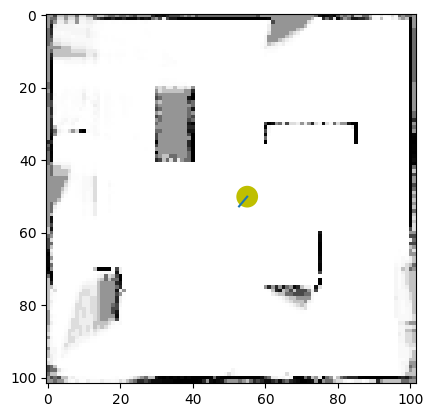

 39%|███▉      | 298/759 [01:32<03:16,  2.34it/s]

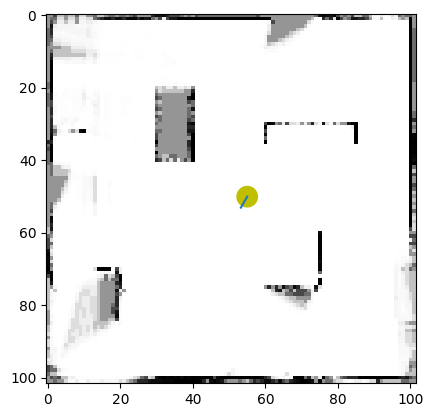

 39%|███▉      | 299/759 [01:33<03:28,  2.20it/s]

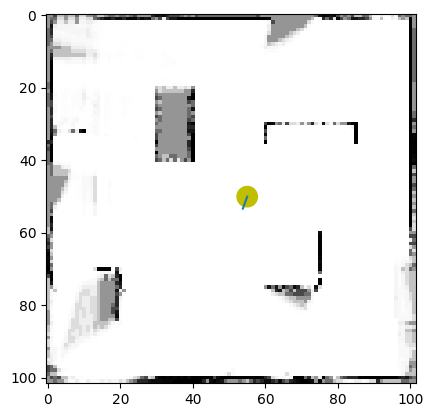

 40%|███▉      | 300/759 [01:33<03:23,  2.25it/s]

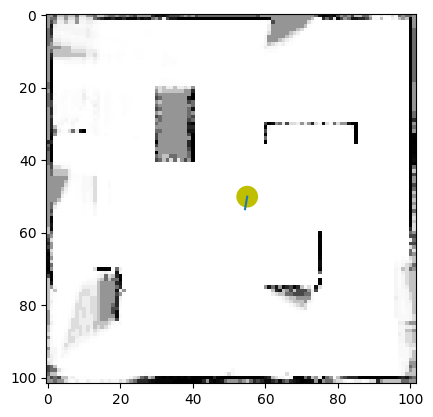

 40%|███▉      | 301/759 [01:34<03:34,  2.13it/s]

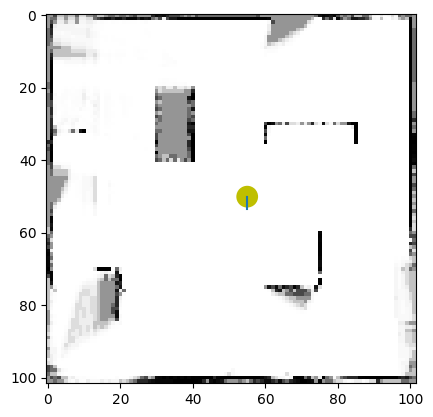

 40%|███▉      | 302/759 [01:34<03:25,  2.22it/s]

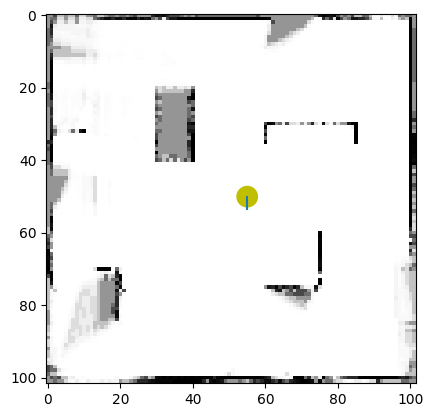

 40%|███▉      | 303/759 [01:34<03:26,  2.21it/s]

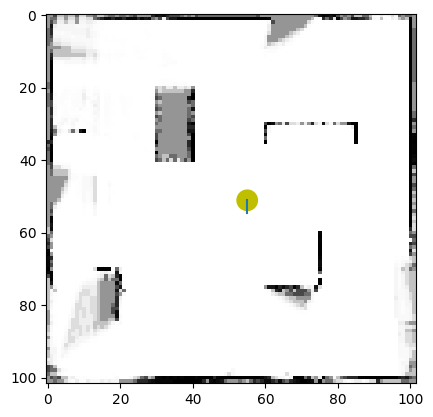

 40%|████      | 304/759 [01:35<03:19,  2.28it/s]

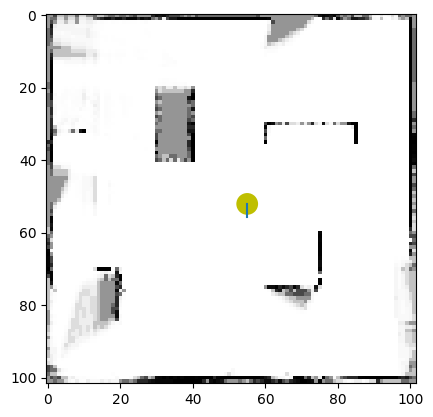

 40%|████      | 305/759 [01:35<03:18,  2.28it/s]

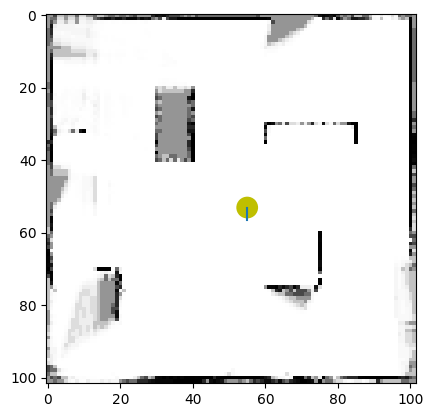

 40%|████      | 306/759 [01:36<03:25,  2.20it/s]

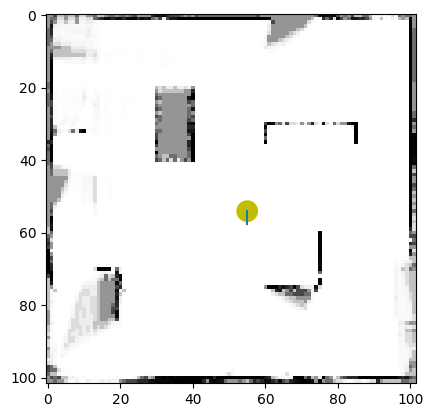

 40%|████      | 307/759 [01:36<03:20,  2.25it/s]

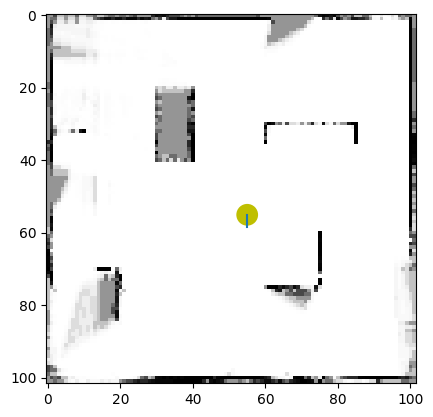

 41%|████      | 308/759 [01:37<03:13,  2.33it/s]

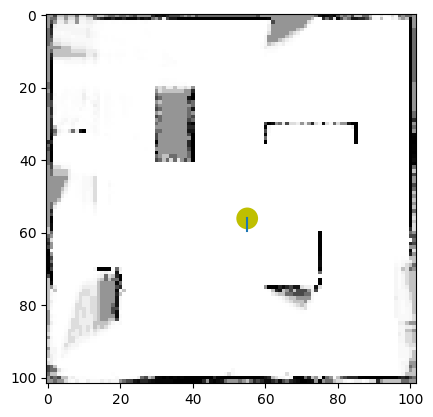

 41%|████      | 309/759 [01:37<03:09,  2.37it/s]

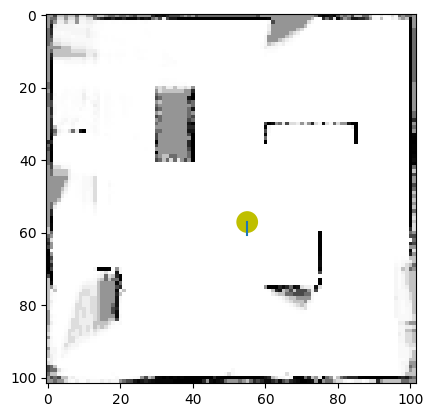

 41%|████      | 310/759 [01:37<02:42,  2.77it/s]

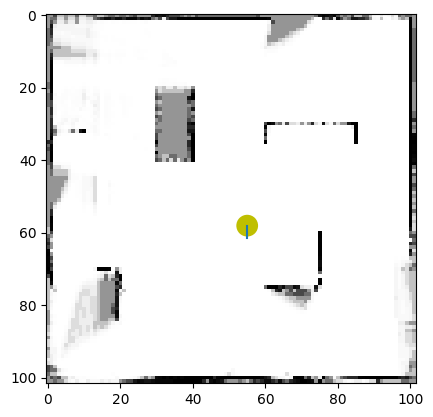

 41%|████      | 311/759 [01:38<02:46,  2.70it/s]

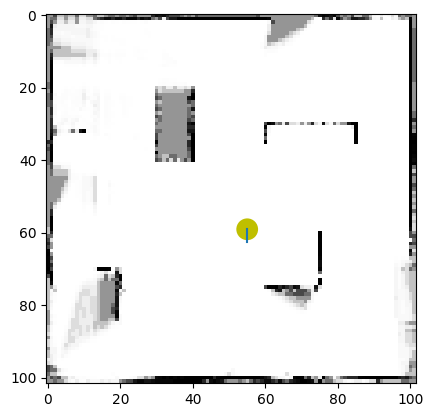

 41%|████      | 312/759 [01:38<02:59,  2.49it/s]

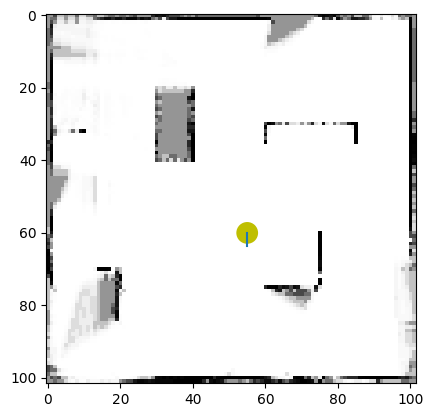

 41%|████      | 313/759 [01:38<03:00,  2.47it/s]

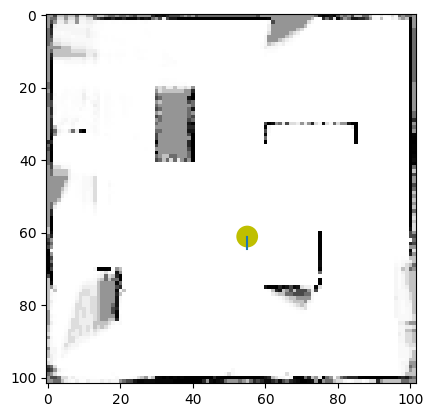

 41%|████▏     | 314/759 [01:39<03:12,  2.32it/s]

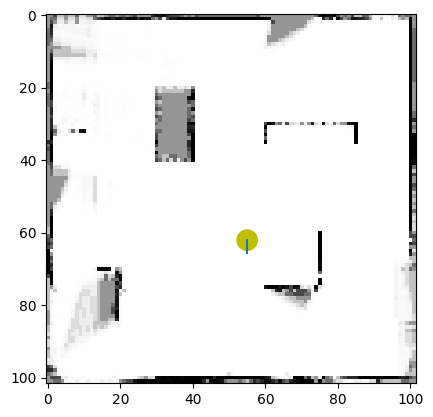

 42%|████▏     | 315/759 [01:39<03:11,  2.31it/s]

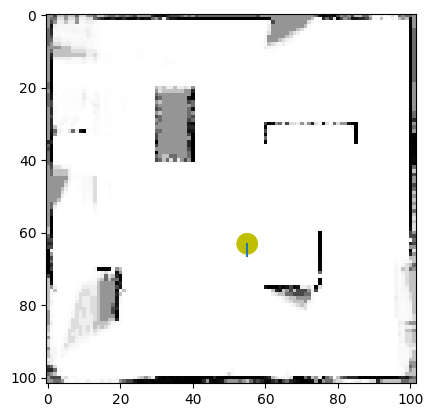

 42%|████▏     | 316/759 [01:40<03:20,  2.21it/s]

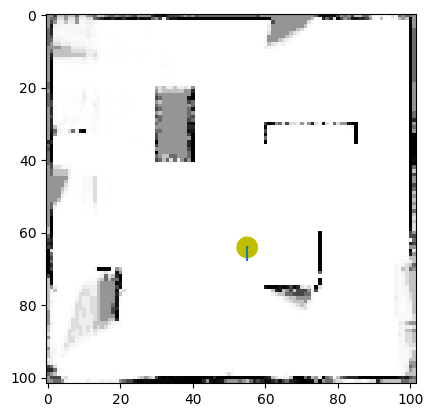

 42%|████▏     | 317/759 [01:40<03:14,  2.27it/s]

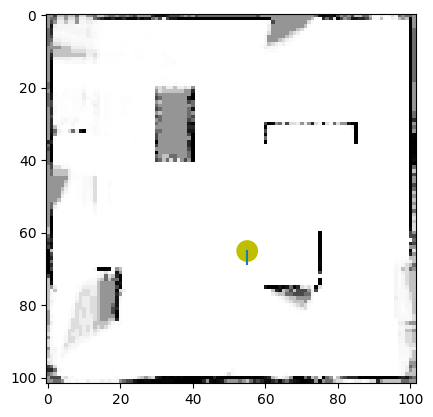

 42%|████▏     | 318/759 [01:41<03:16,  2.24it/s]

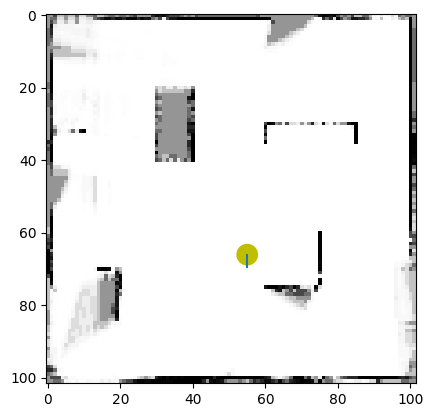

 42%|████▏     | 319/759 [01:41<03:19,  2.21it/s]

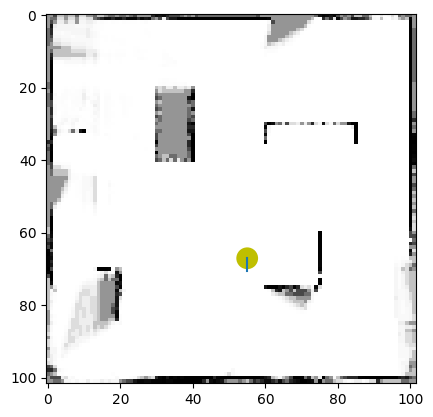

 42%|████▏     | 320/759 [01:42<03:21,  2.18it/s]

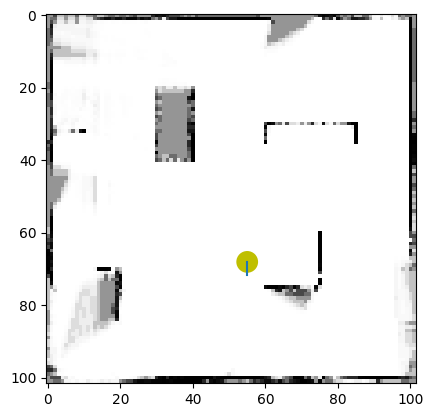

 42%|████▏     | 321/759 [01:42<03:24,  2.14it/s]

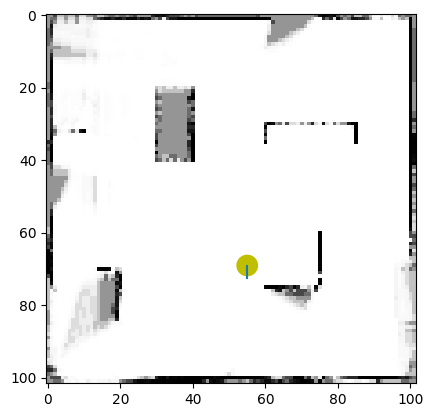

 42%|████▏     | 322/759 [01:43<03:20,  2.18it/s]

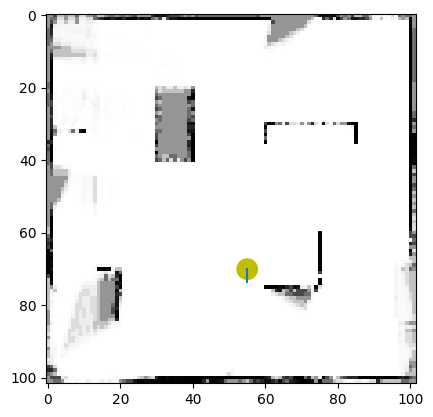

 43%|████▎     | 323/759 [01:43<03:05,  2.35it/s]

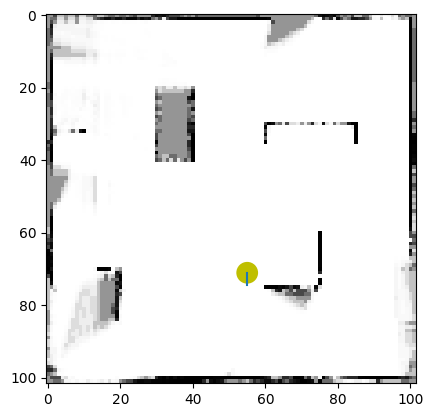

 43%|████▎     | 324/759 [01:43<03:11,  2.27it/s]

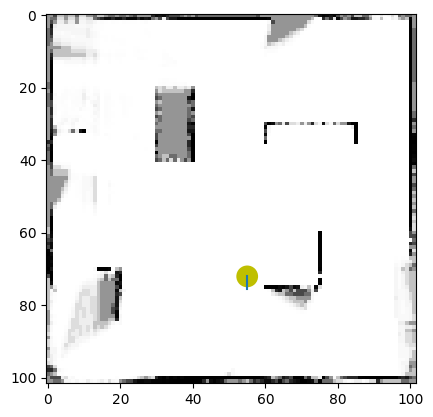

 43%|████▎     | 325/759 [01:44<03:09,  2.28it/s]

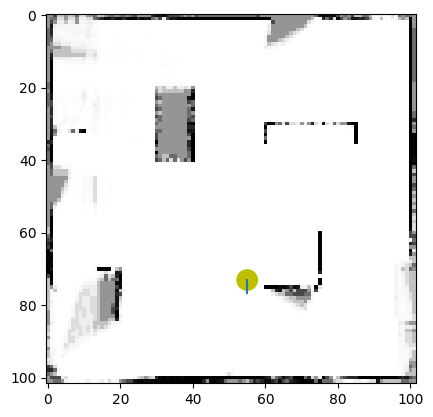

 43%|████▎     | 326/759 [01:44<03:08,  2.30it/s]

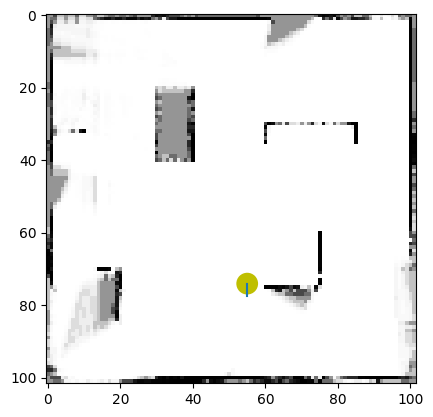

 43%|████▎     | 327/759 [01:45<03:15,  2.20it/s]

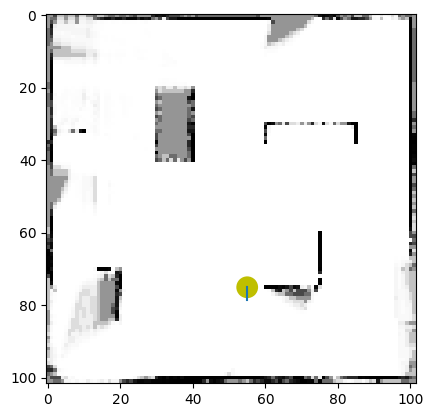

 43%|████▎     | 328/759 [01:45<03:13,  2.22it/s]

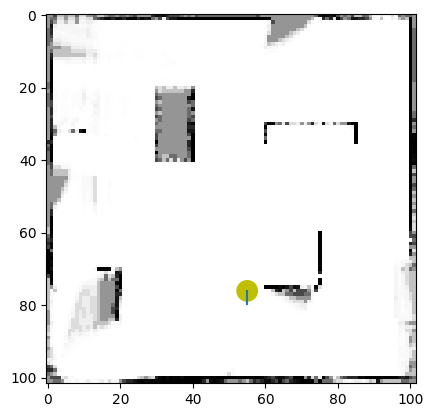

 43%|████▎     | 329/759 [01:46<03:10,  2.26it/s]

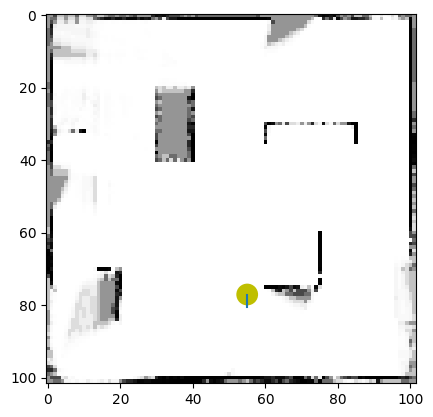

 43%|████▎     | 330/759 [01:46<02:50,  2.52it/s]

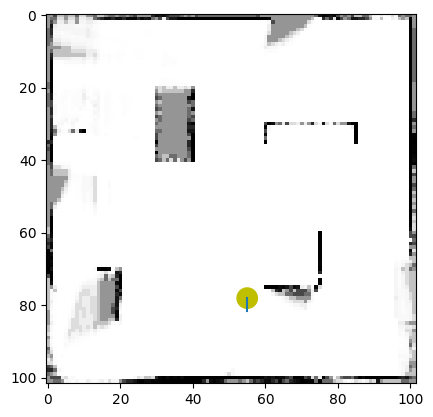

 44%|████▎     | 331/759 [01:46<02:57,  2.41it/s]

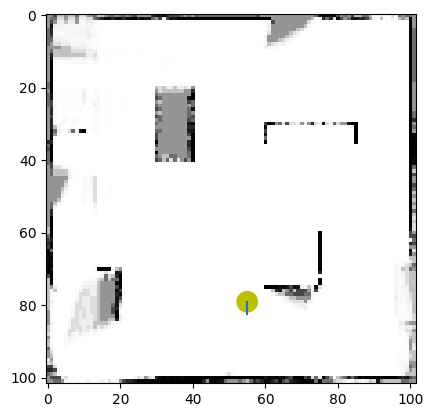

 44%|████▎     | 332/759 [01:47<03:01,  2.35it/s]

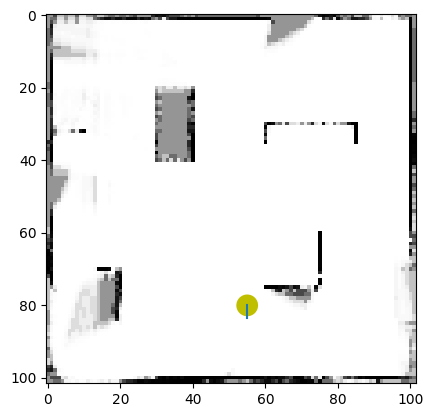

 44%|████▍     | 333/759 [01:47<03:04,  2.30it/s]

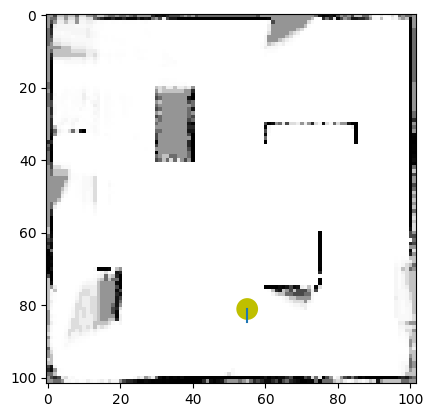

 44%|████▍     | 334/759 [01:48<03:12,  2.21it/s]

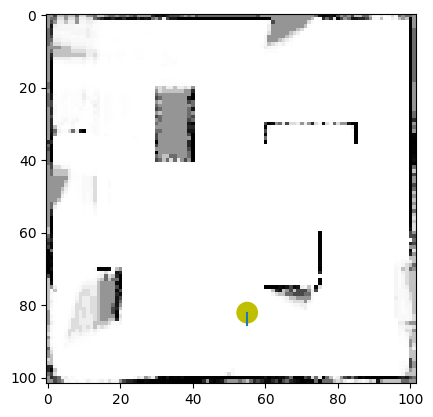

 44%|████▍     | 335/759 [01:48<03:10,  2.23it/s]

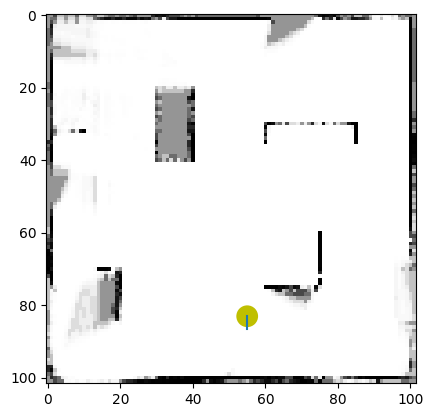

 44%|████▍     | 336/759 [01:49<03:11,  2.21it/s]

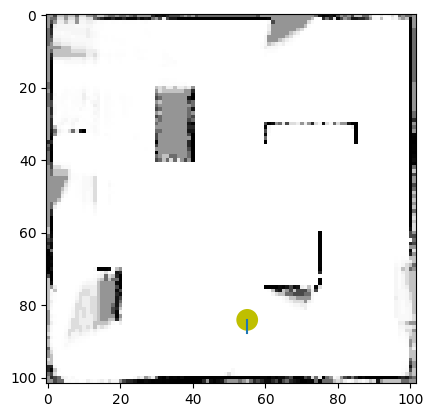

 44%|████▍     | 337/759 [01:49<02:59,  2.36it/s]

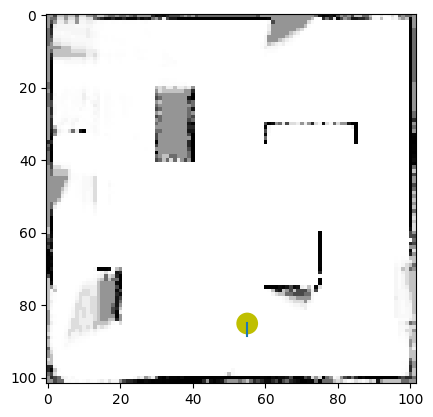

 45%|████▍     | 338/759 [01:50<03:04,  2.29it/s]

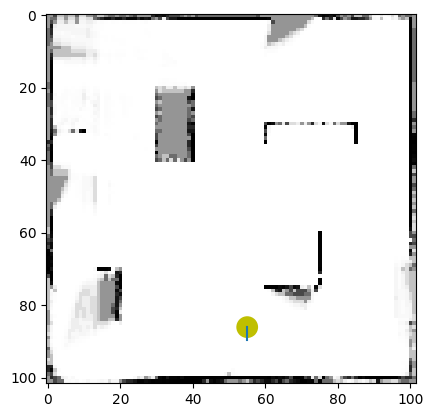

 45%|████▍     | 339/759 [01:50<02:58,  2.35it/s]

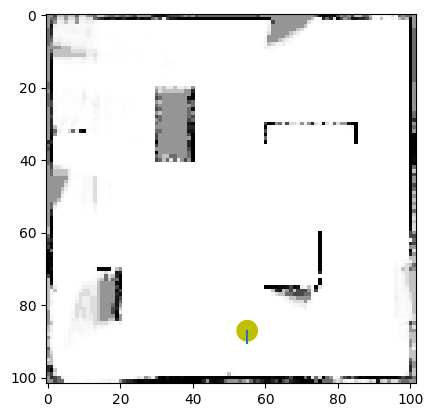

 45%|████▍     | 340/759 [01:50<03:02,  2.30it/s]

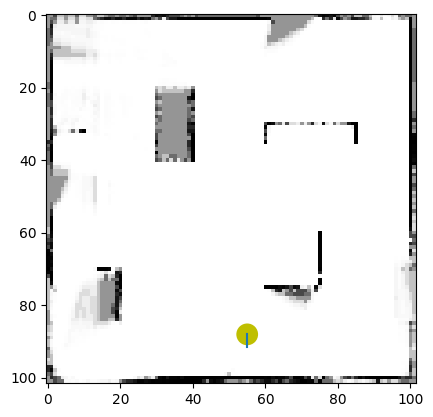

 45%|████▍     | 341/759 [01:51<03:07,  2.23it/s]

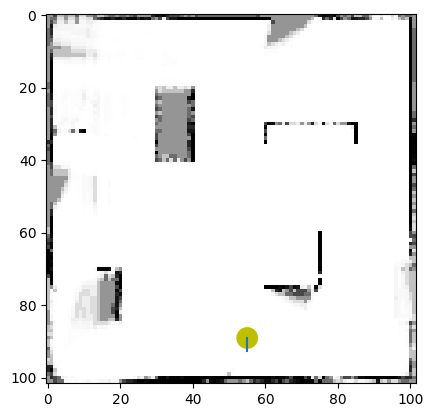

 45%|████▌     | 342/759 [01:51<02:56,  2.37it/s]

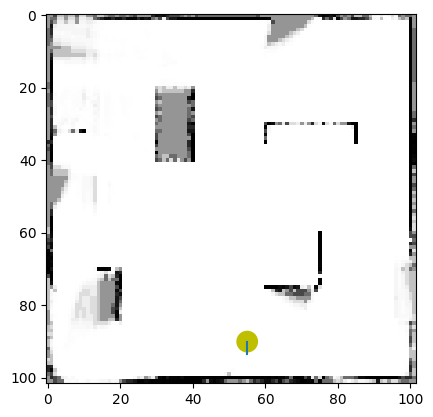

 45%|████▌     | 343/759 [01:52<03:03,  2.27it/s]

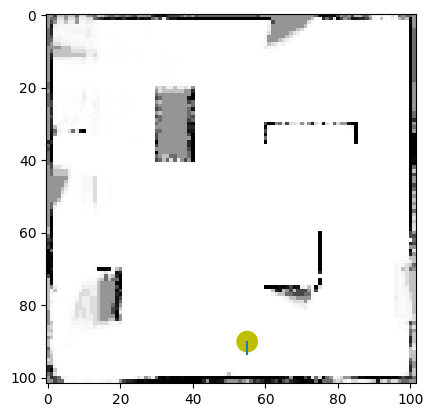

 45%|████▌     | 344/759 [01:52<02:53,  2.40it/s]

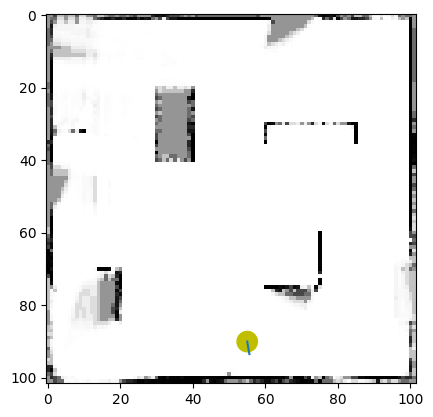

 45%|████▌     | 345/759 [01:53<03:01,  2.28it/s]

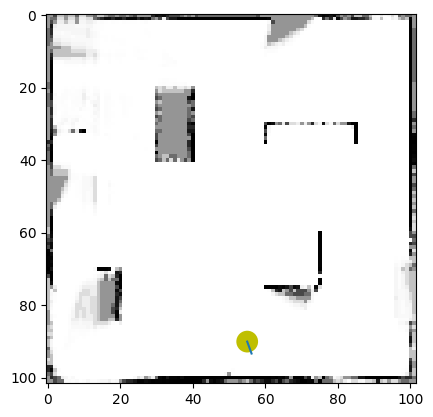

 46%|████▌     | 346/759 [01:53<03:03,  2.25it/s]

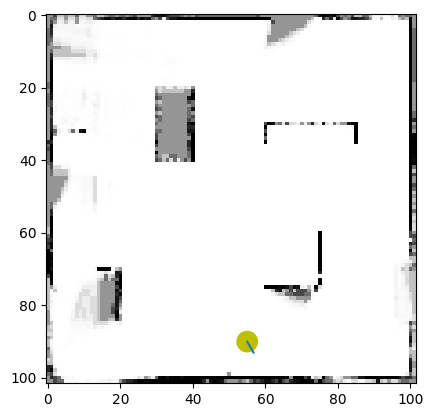

 46%|████▌     | 347/759 [01:53<03:00,  2.29it/s]

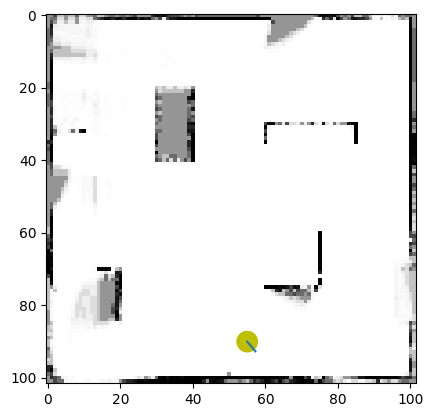

 46%|████▌     | 348/759 [01:54<02:56,  2.33it/s]

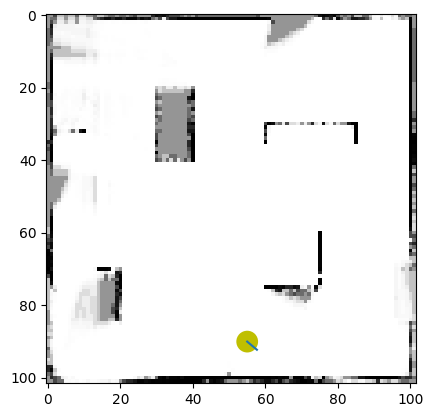

 46%|████▌     | 349/759 [01:54<02:42,  2.52it/s]

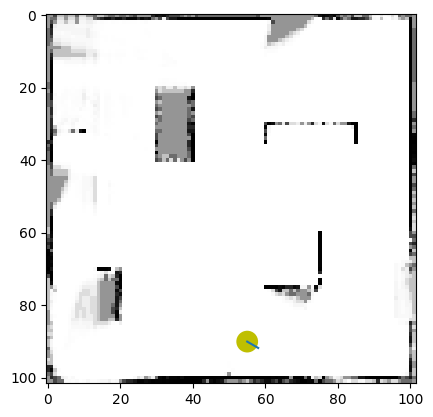

 46%|████▌     | 350/759 [01:54<02:31,  2.69it/s]

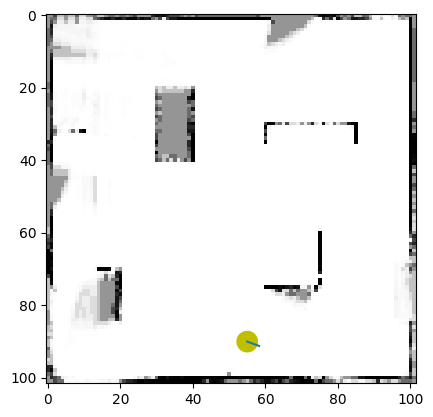

 46%|████▌     | 351/759 [01:55<02:32,  2.67it/s]

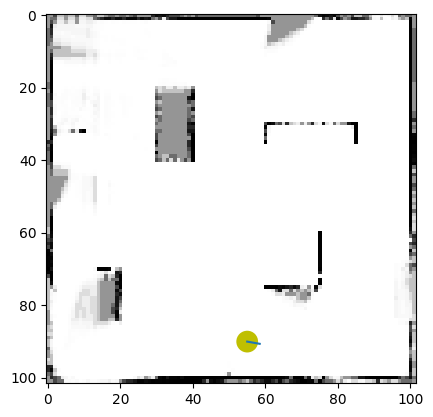

 46%|████▋     | 352/759 [01:55<02:38,  2.57it/s]

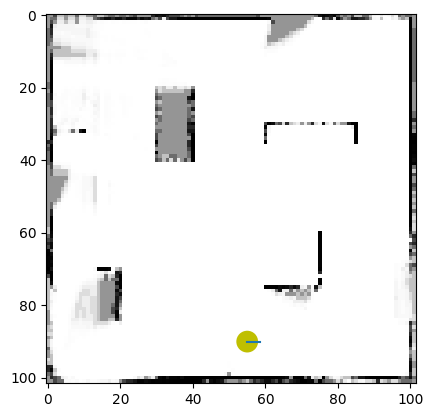

 47%|████▋     | 353/759 [01:56<02:42,  2.49it/s]

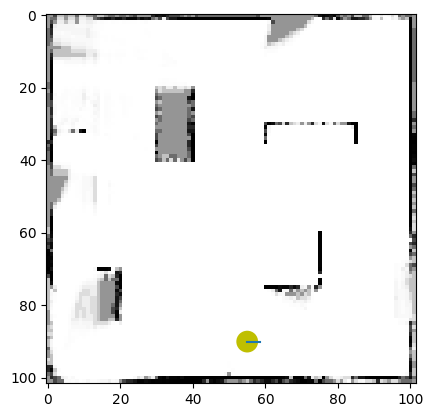

 47%|████▋     | 354/759 [01:56<02:46,  2.43it/s]

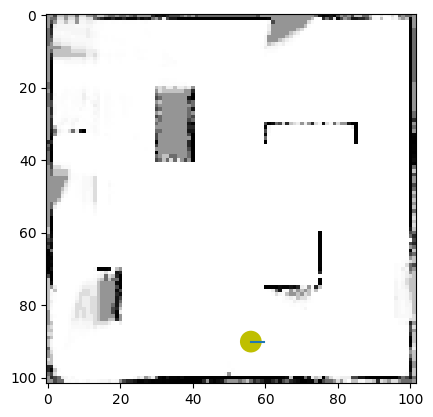

 47%|████▋     | 355/759 [01:56<02:30,  2.68it/s]

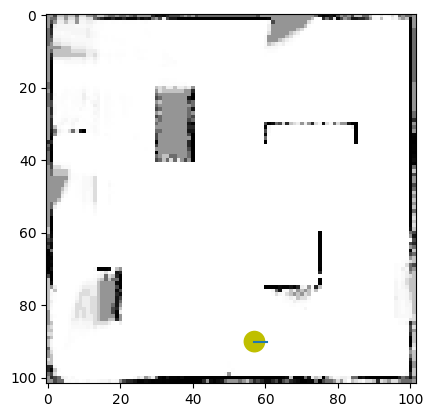

 47%|████▋     | 356/759 [01:57<02:34,  2.61it/s]

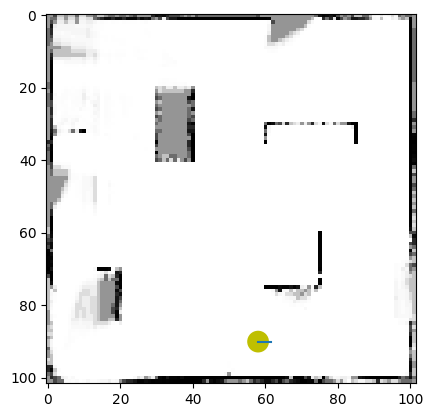

 47%|████▋     | 357/759 [01:57<02:43,  2.45it/s]

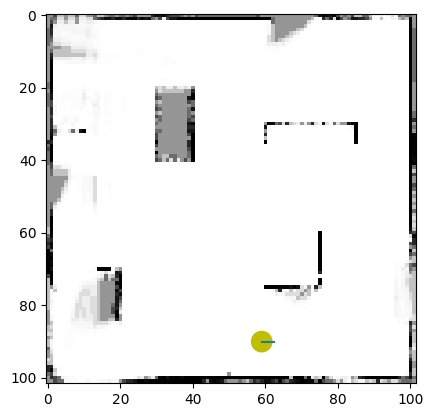

 47%|████▋     | 358/759 [01:58<03:09,  2.12it/s]

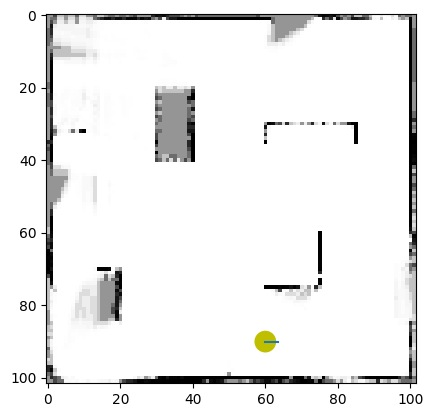

 47%|████▋     | 359/759 [01:59<03:19,  2.01it/s]

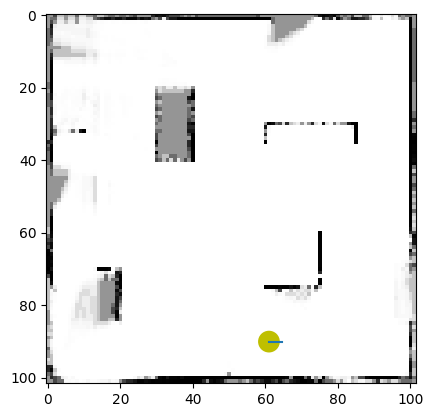

 47%|████▋     | 360/759 [01:59<03:20,  1.99it/s]

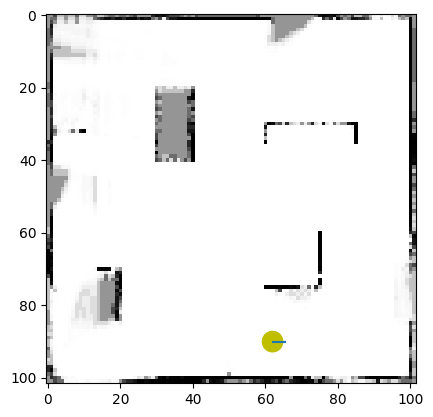

 48%|████▊     | 361/759 [02:00<03:23,  1.95it/s]

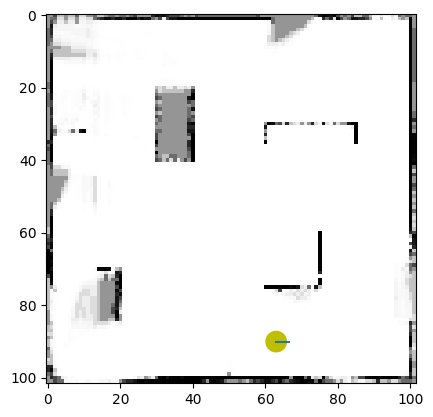

 48%|████▊     | 362/759 [02:00<03:19,  1.99it/s]

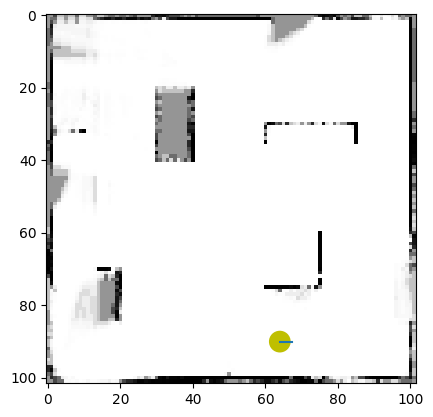

 48%|████▊     | 363/759 [02:00<03:01,  2.18it/s]

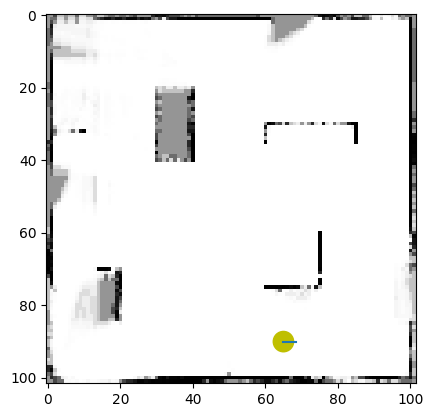

 48%|████▊     | 364/759 [02:01<02:58,  2.21it/s]

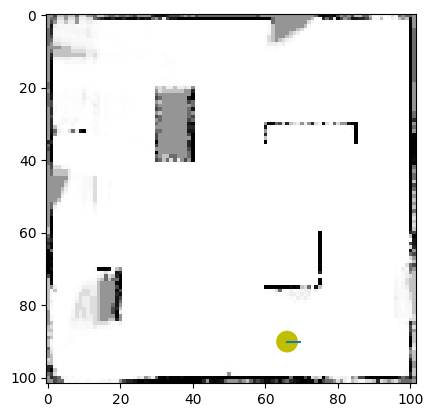

 48%|████▊     | 365/759 [02:01<02:56,  2.23it/s]

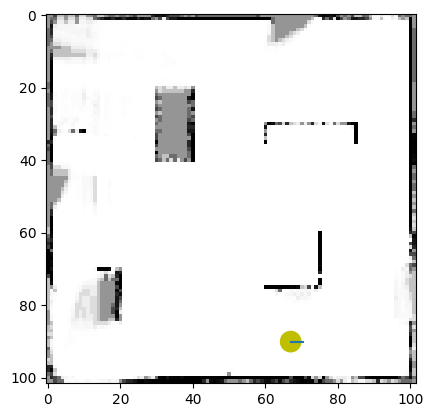

 48%|████▊     | 366/759 [02:02<02:35,  2.52it/s]

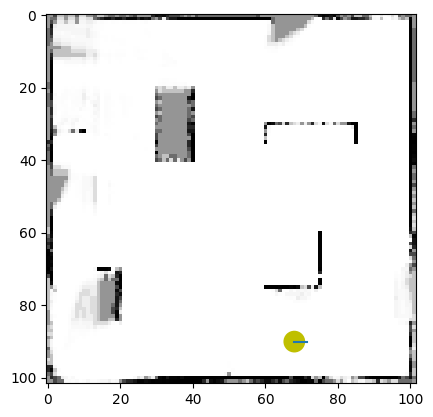

 48%|████▊     | 367/759 [02:02<02:40,  2.44it/s]

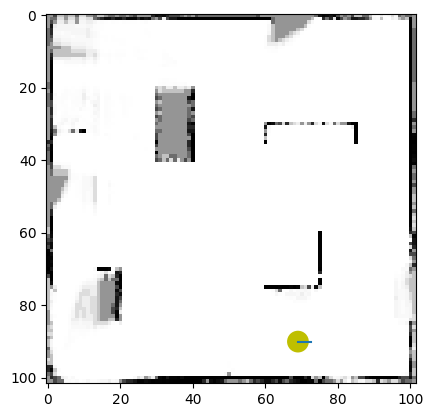

 48%|████▊     | 368/759 [02:02<02:42,  2.41it/s]

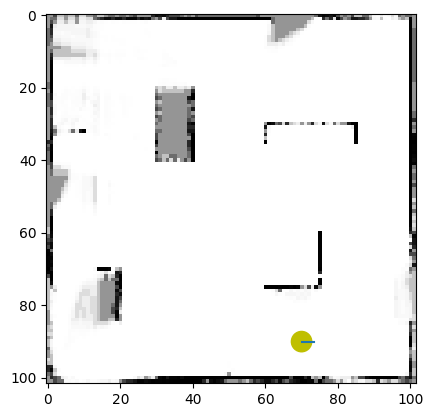

 49%|████▊     | 369/759 [02:03<02:51,  2.27it/s]

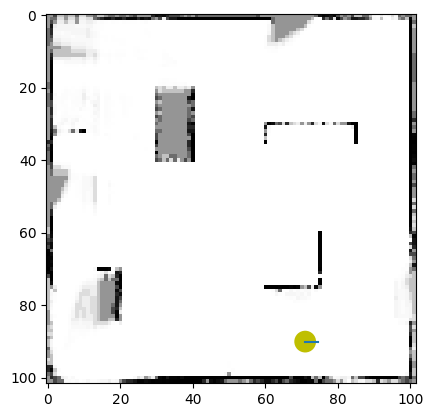

 49%|████▊     | 370/759 [02:03<02:56,  2.21it/s]

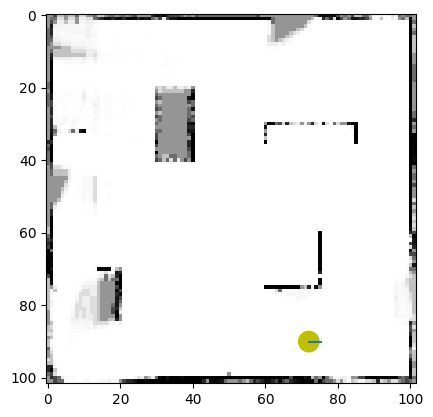

 49%|████▉     | 371/759 [02:04<03:00,  2.15it/s]

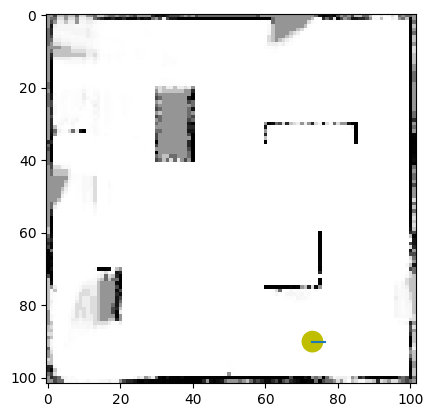

 49%|████▉     | 372/759 [02:04<02:58,  2.17it/s]

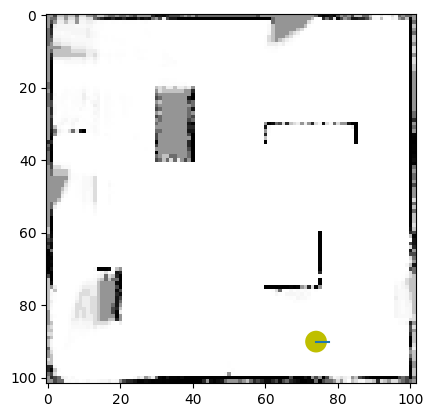

 49%|████▉     | 373/759 [02:05<03:00,  2.14it/s]

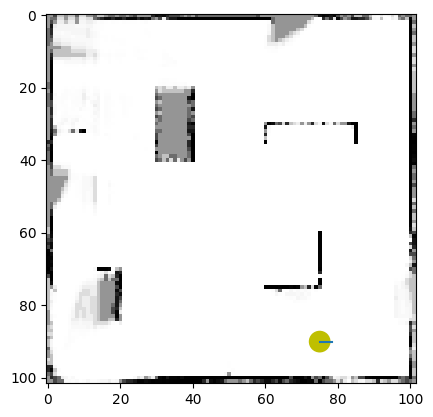

 49%|████▉     | 374/759 [02:05<03:00,  2.13it/s]

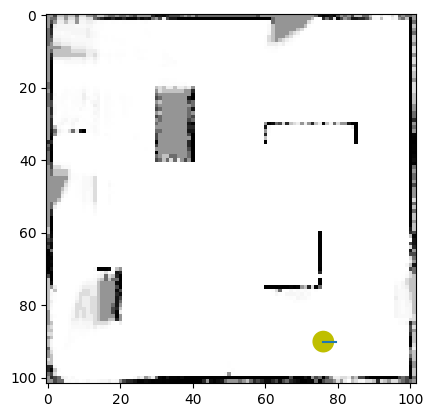

 49%|████▉     | 375/759 [02:06<02:56,  2.17it/s]

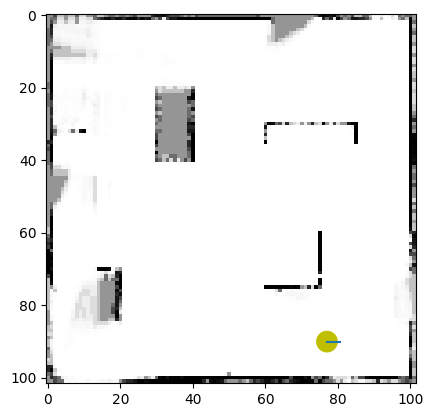

 50%|████▉     | 376/759 [02:06<02:56,  2.17it/s]

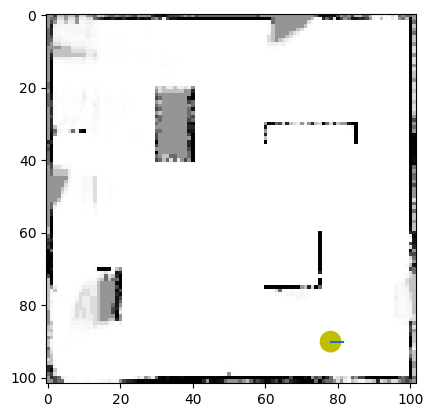

 50%|████▉     | 377/759 [02:07<02:41,  2.36it/s]

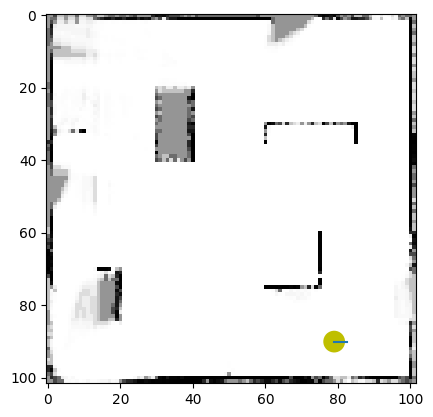

 50%|████▉     | 378/759 [02:07<02:41,  2.35it/s]

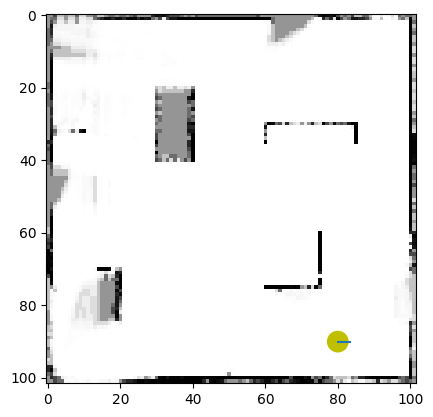

 50%|████▉     | 379/759 [02:07<02:41,  2.36it/s]

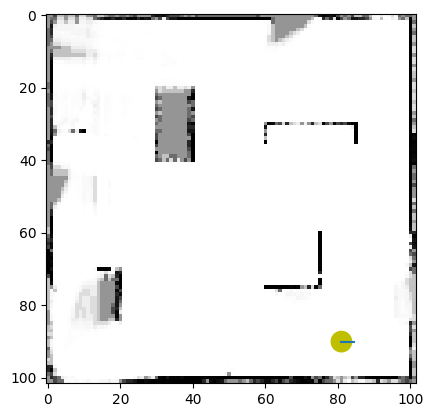

 50%|█████     | 380/759 [02:08<02:32,  2.48it/s]

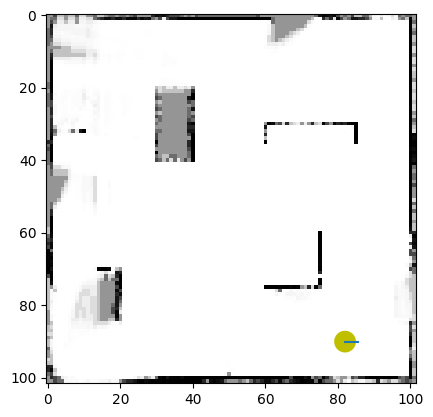

 50%|█████     | 381/759 [02:08<02:37,  2.39it/s]

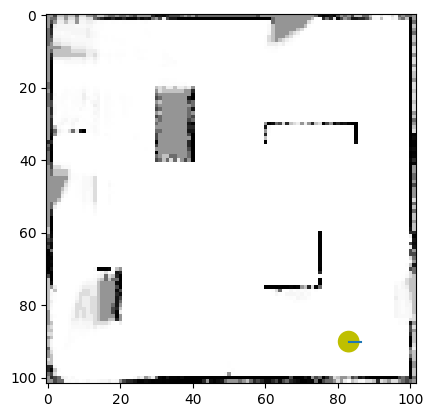

 50%|█████     | 382/759 [02:09<02:38,  2.38it/s]

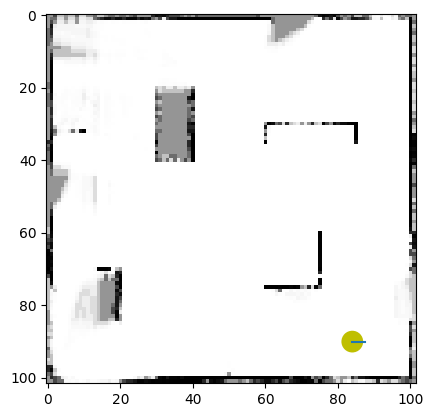

 50%|█████     | 383/759 [02:09<02:51,  2.20it/s]

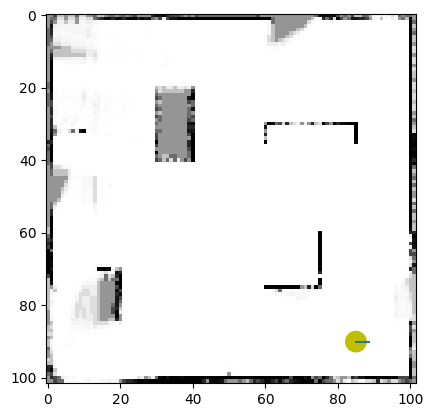

 51%|█████     | 384/759 [02:10<02:50,  2.20it/s]

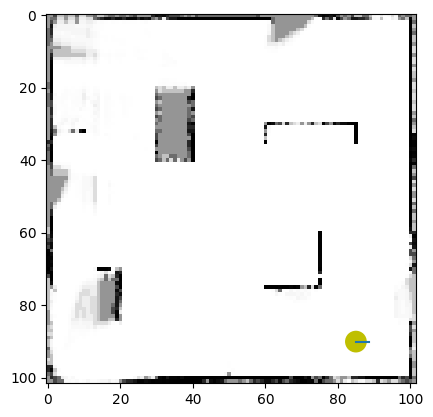

 51%|█████     | 385/759 [02:10<02:42,  2.30it/s]

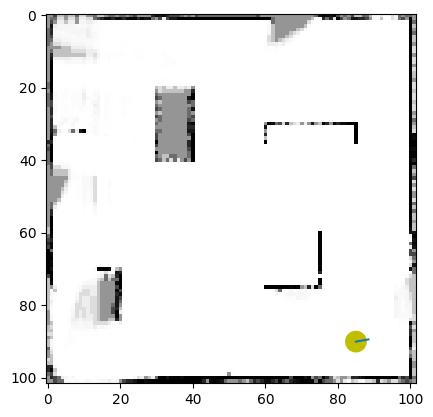

 51%|█████     | 386/759 [02:10<02:48,  2.21it/s]

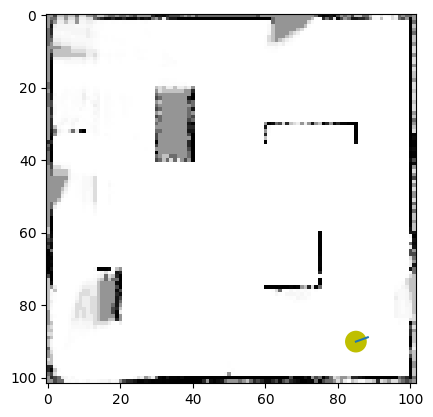

 51%|█████     | 387/759 [02:11<02:40,  2.31it/s]

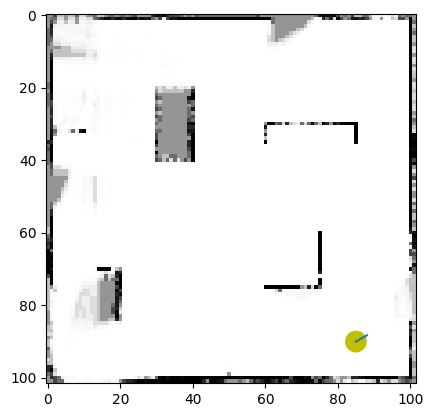

 51%|█████     | 388/759 [02:11<03:01,  2.04it/s]

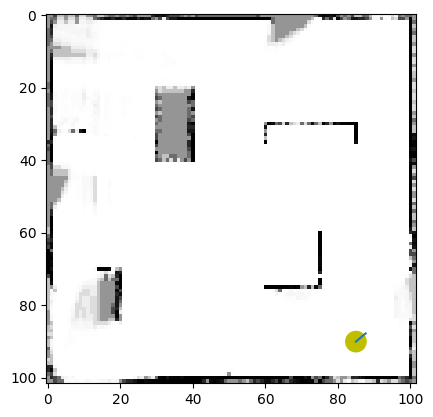

 51%|█████▏    | 389/759 [02:12<02:51,  2.15it/s]

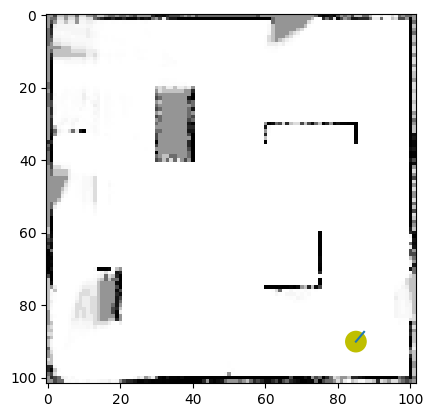

 51%|█████▏    | 390/759 [02:12<02:51,  2.15it/s]

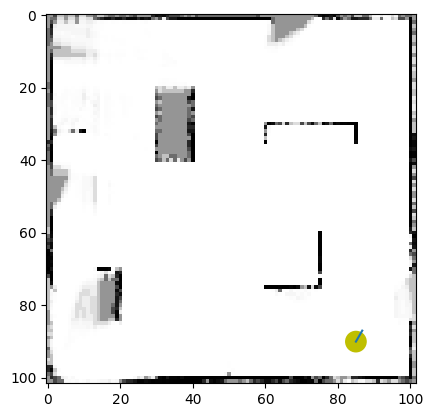

 52%|█████▏    | 391/759 [02:13<02:48,  2.19it/s]

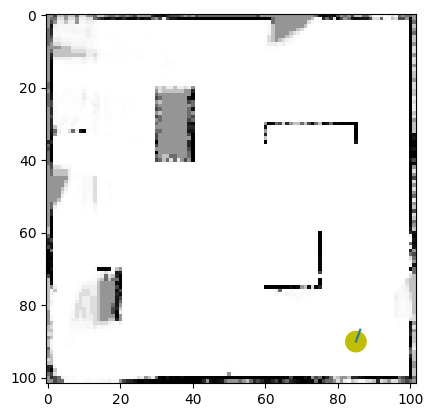

 52%|█████▏    | 392/759 [02:13<02:49,  2.16it/s]

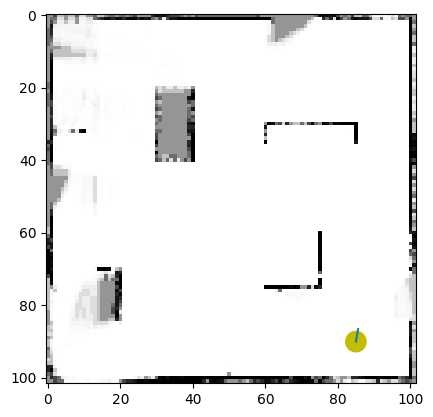

 52%|█████▏    | 393/759 [02:14<02:31,  2.42it/s]

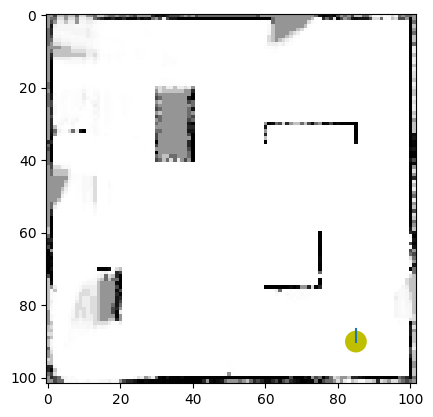

 52%|█████▏    | 394/759 [02:14<02:30,  2.43it/s]

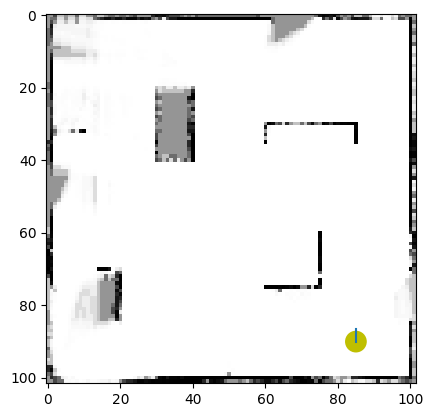

 52%|█████▏    | 395/759 [02:14<02:10,  2.80it/s]

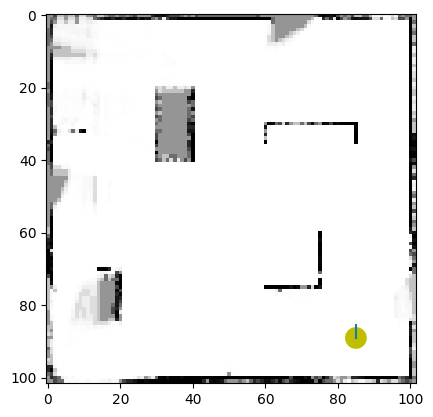

 52%|█████▏    | 396/759 [02:15<02:23,  2.53it/s]

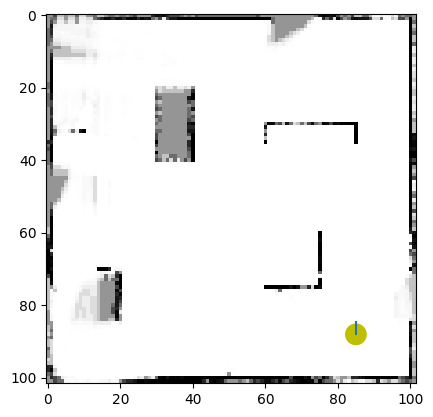

 52%|█████▏    | 397/759 [02:15<02:30,  2.40it/s]

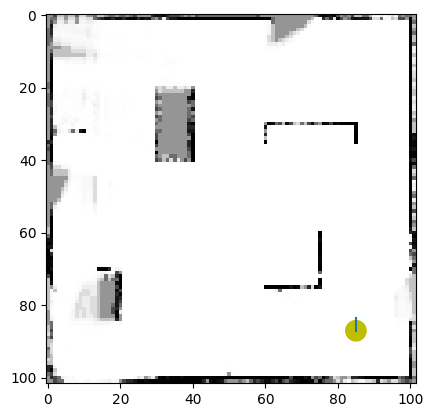

 52%|█████▏    | 398/759 [02:16<02:39,  2.26it/s]

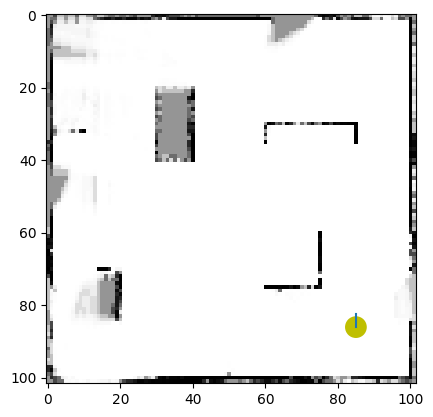

 53%|█████▎    | 399/759 [02:16<02:43,  2.20it/s]

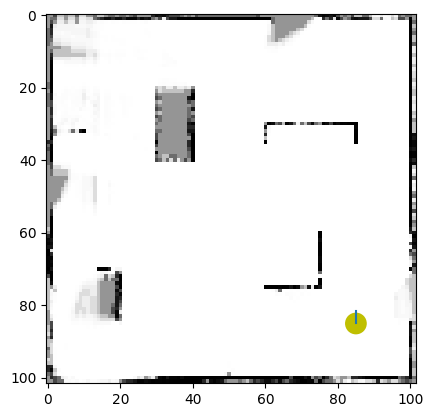

 53%|█████▎    | 400/759 [02:17<02:57,  2.02it/s]

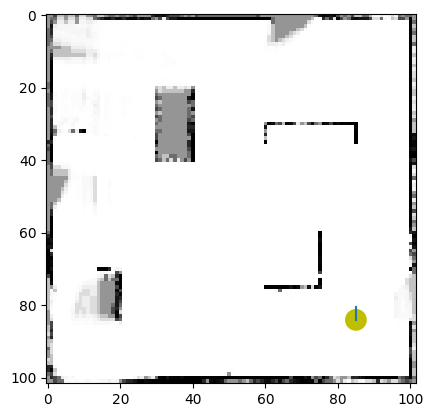

 53%|█████▎    | 401/759 [02:17<03:01,  1.97it/s]

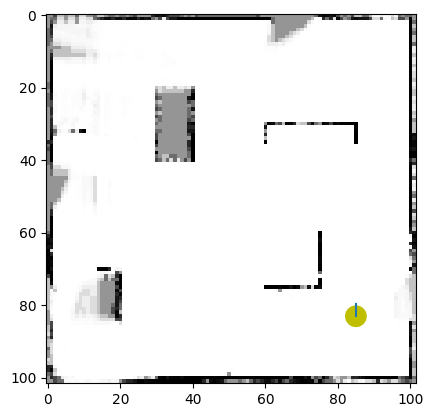

 53%|█████▎    | 402/759 [02:18<02:46,  2.15it/s]

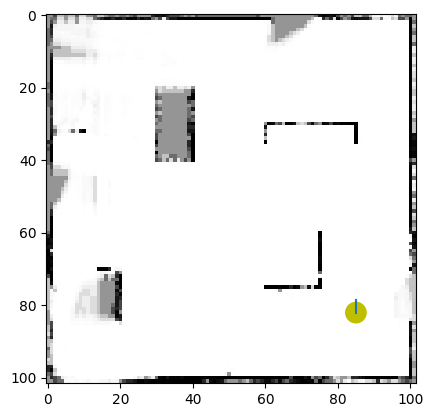

 53%|█████▎    | 403/759 [02:18<02:24,  2.46it/s]

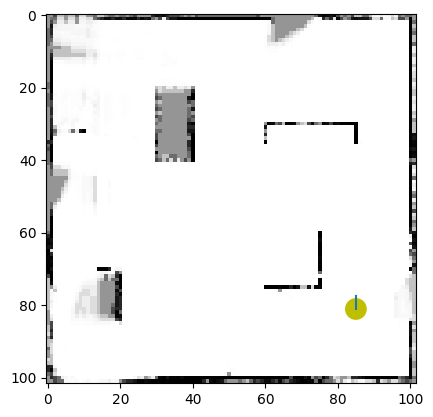

 53%|█████▎    | 404/759 [02:18<02:27,  2.41it/s]

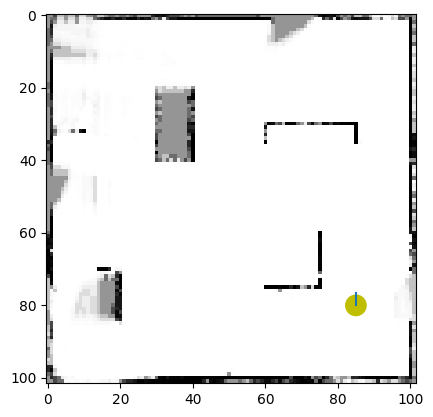

 53%|█████▎    | 405/759 [02:19<02:19,  2.54it/s]

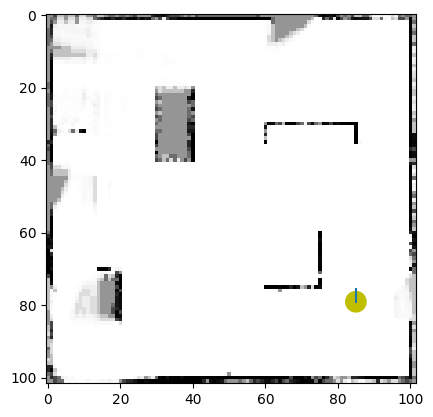

 53%|█████▎    | 406/759 [02:19<02:07,  2.77it/s]

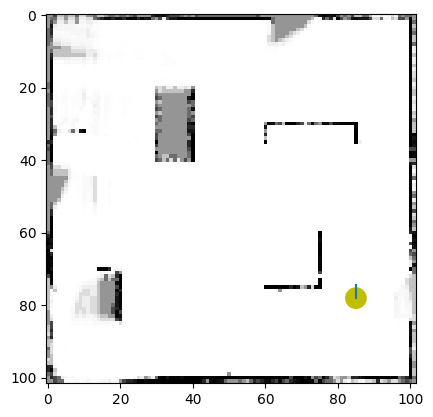

 54%|█████▎    | 407/759 [02:19<01:58,  2.97it/s]

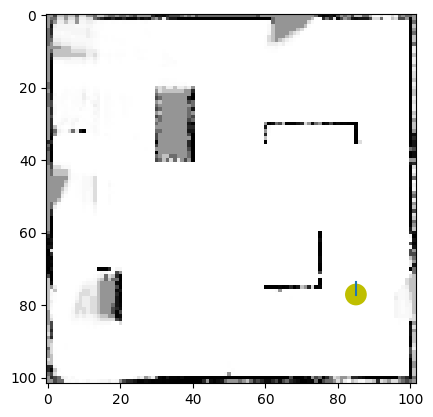

 54%|█████▍    | 408/759 [02:20<01:56,  3.01it/s]

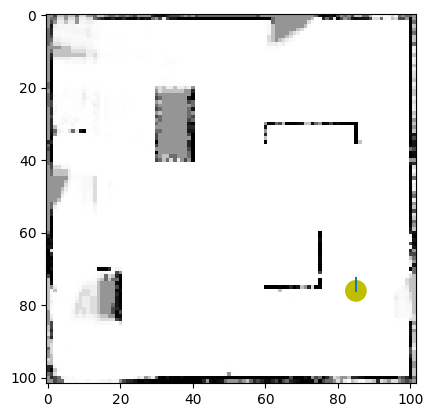

 54%|█████▍    | 409/759 [02:20<02:15,  2.59it/s]

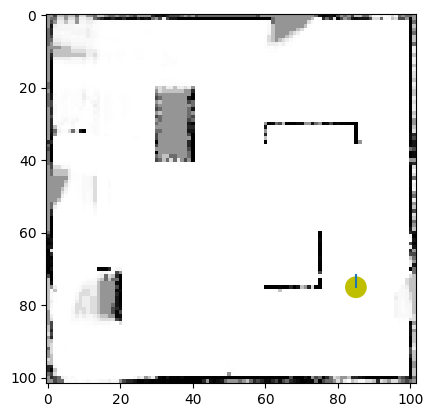

 54%|█████▍    | 410/759 [02:21<02:24,  2.41it/s]

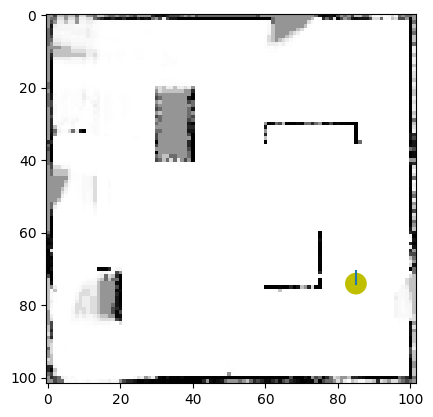

 54%|█████▍    | 411/759 [02:21<02:34,  2.25it/s]

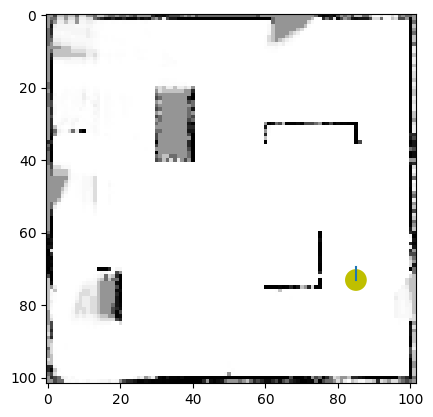

 54%|█████▍    | 412/759 [02:21<02:30,  2.31it/s]

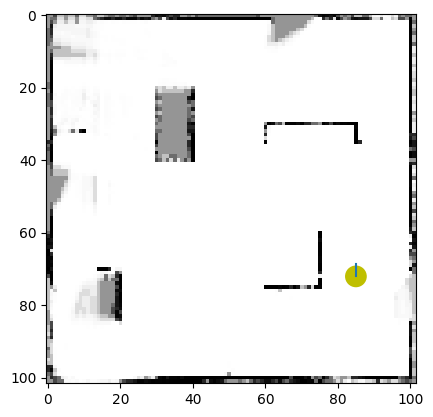

 54%|█████▍    | 413/759 [02:22<02:37,  2.20it/s]

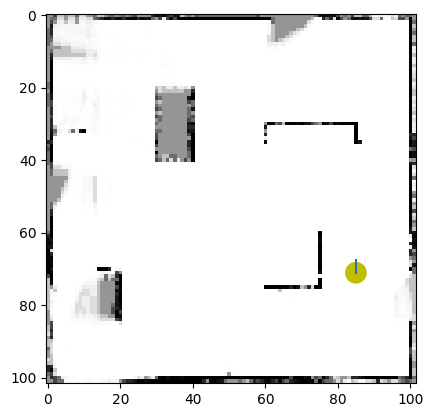

 55%|█████▍    | 414/759 [02:22<02:31,  2.28it/s]

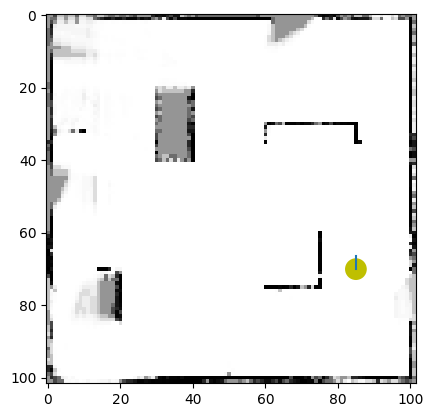

 55%|█████▍    | 415/759 [02:23<02:44,  2.09it/s]

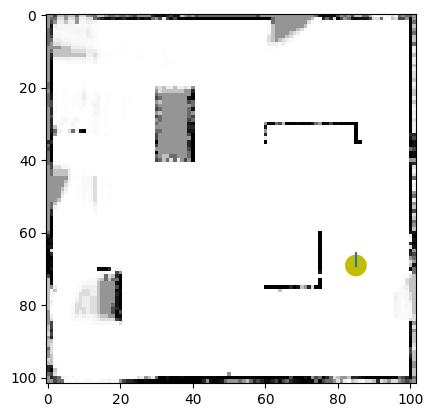

 55%|█████▍    | 416/759 [02:23<02:21,  2.43it/s]

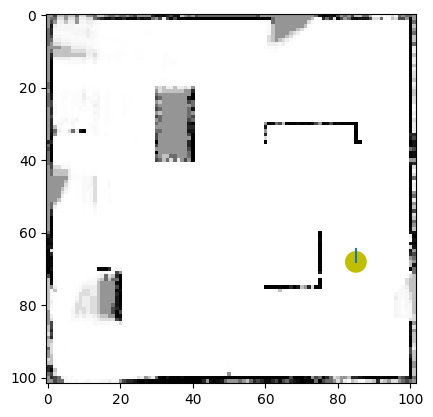

 55%|█████▍    | 417/759 [02:23<02:04,  2.74it/s]

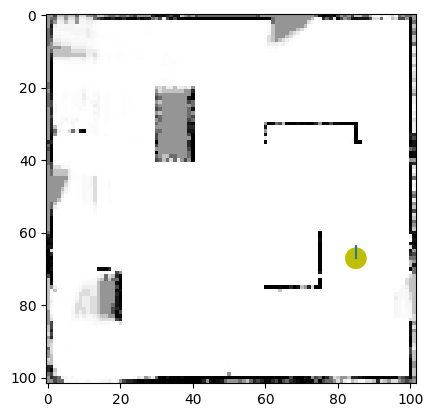

 55%|█████▌    | 418/759 [02:24<01:52,  3.02it/s]

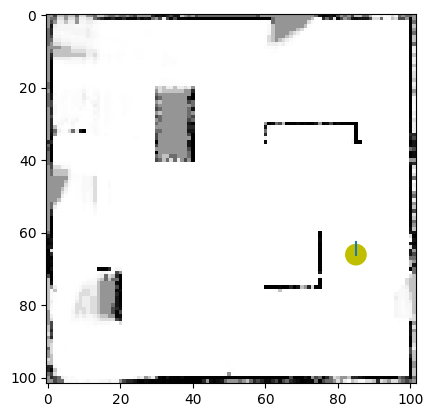

 55%|█████▌    | 419/759 [02:24<01:57,  2.90it/s]

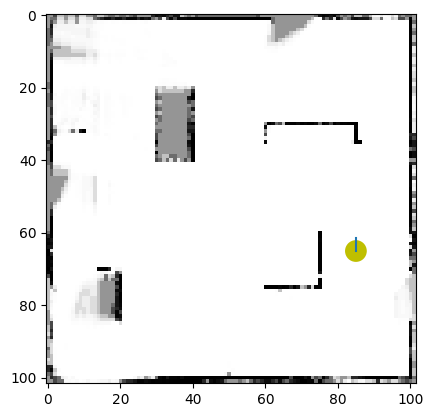

 55%|█████▌    | 420/759 [02:25<02:08,  2.64it/s]

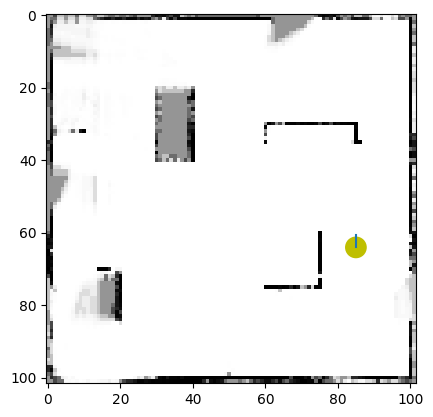

 55%|█████▌    | 421/759 [02:25<02:08,  2.63it/s]

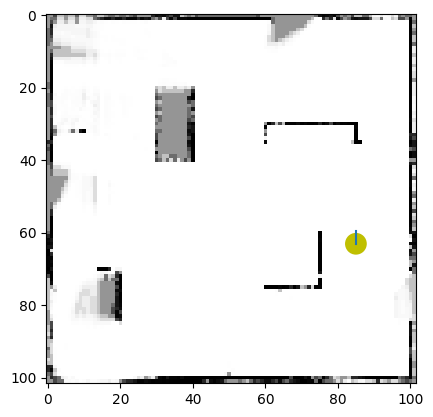

 56%|█████▌    | 422/759 [02:25<02:03,  2.74it/s]

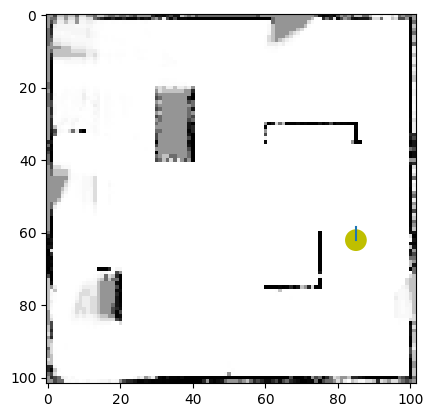

 56%|█████▌    | 423/759 [02:26<02:07,  2.63it/s]

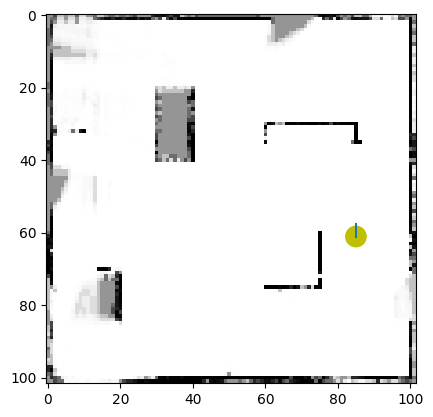

 56%|█████▌    | 424/759 [02:26<02:15,  2.47it/s]

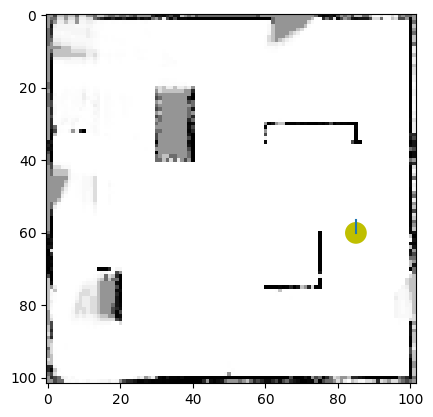

 56%|█████▌    | 425/759 [02:27<02:12,  2.51it/s]

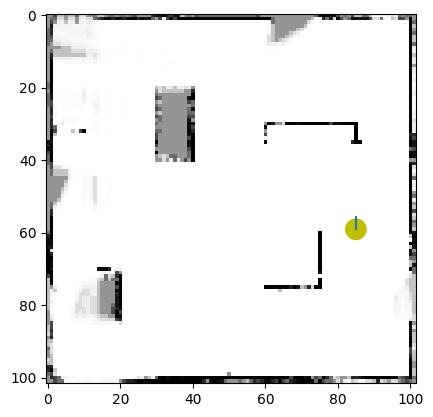

 56%|█████▌    | 426/759 [02:27<02:20,  2.37it/s]

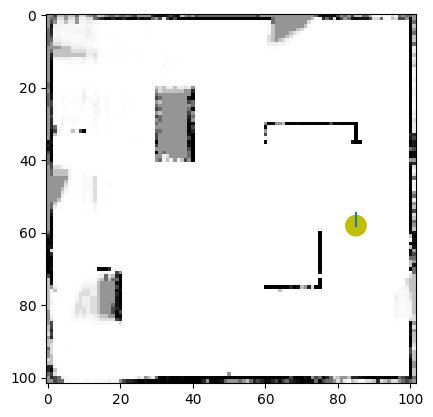

 56%|█████▋    | 427/759 [02:28<02:28,  2.24it/s]

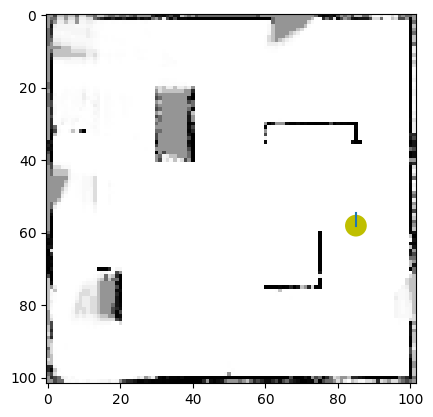

 56%|█████▋    | 428/759 [02:28<02:27,  2.24it/s]

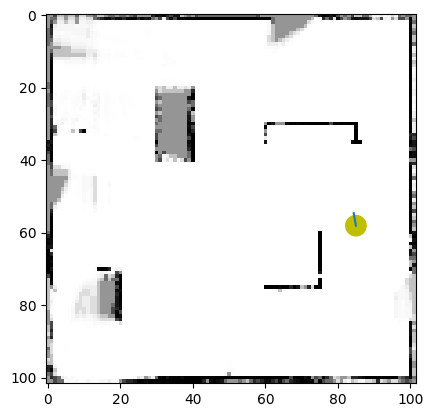

 57%|█████▋    | 429/759 [02:28<02:29,  2.21it/s]

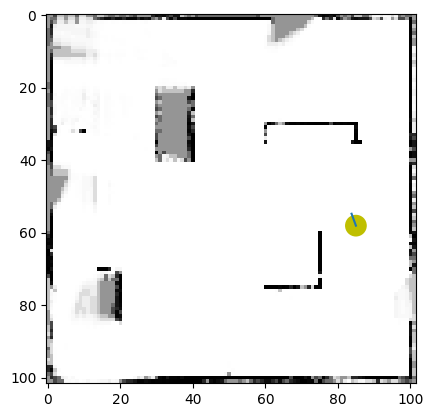

 57%|█████▋    | 430/759 [02:29<02:25,  2.26it/s]

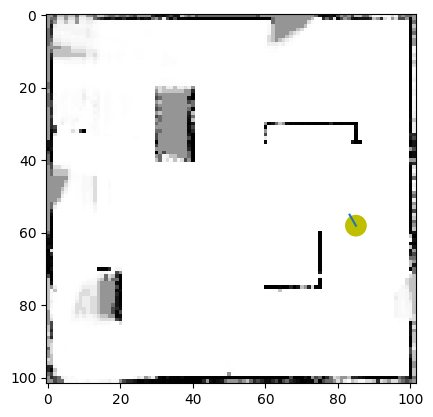

 57%|█████▋    | 431/759 [02:29<02:32,  2.16it/s]

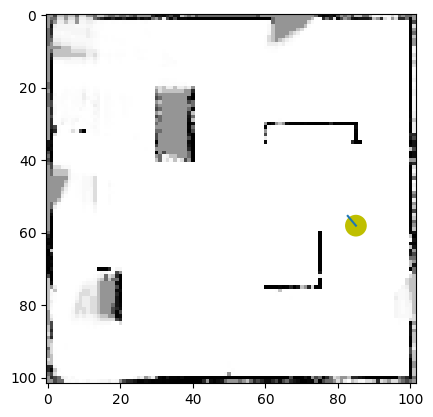

 57%|█████▋    | 432/759 [02:30<02:35,  2.11it/s]

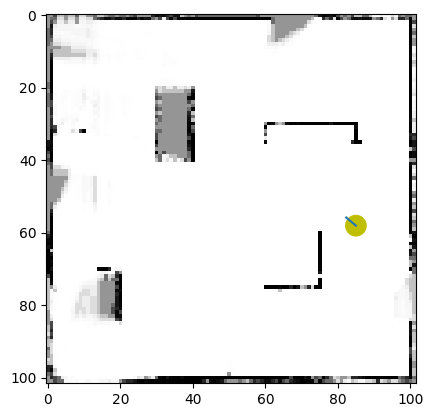

 57%|█████▋    | 433/759 [02:30<02:31,  2.16it/s]

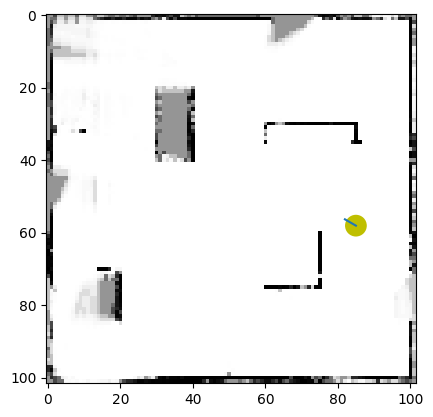

 57%|█████▋    | 434/759 [02:31<02:18,  2.34it/s]

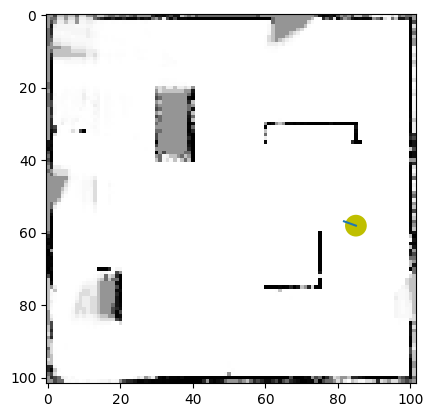

 57%|█████▋    | 435/759 [02:31<02:23,  2.25it/s]

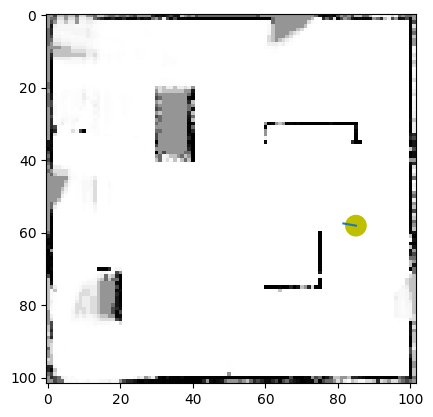

 57%|█████▋    | 436/759 [02:32<02:24,  2.23it/s]

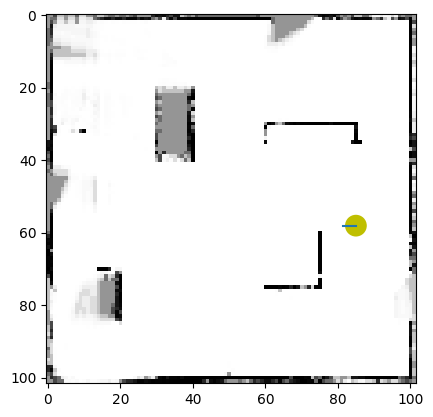

 58%|█████▊    | 437/759 [02:32<02:34,  2.08it/s]

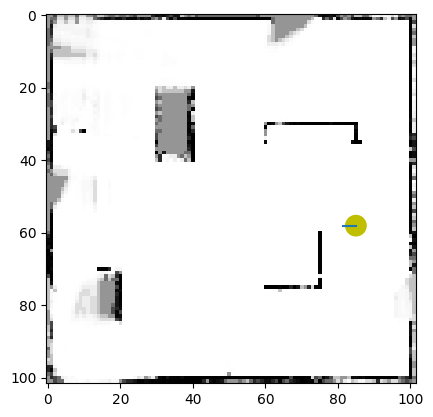

 58%|█████▊    | 438/759 [02:33<02:29,  2.14it/s]

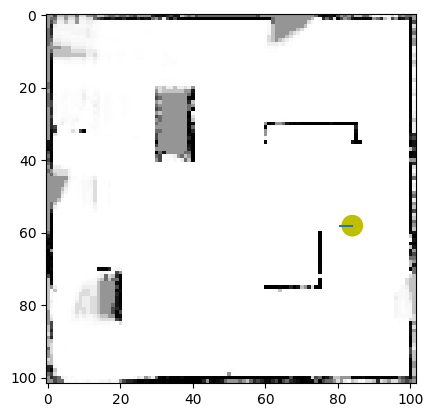

 58%|█████▊    | 439/759 [02:33<02:24,  2.22it/s]

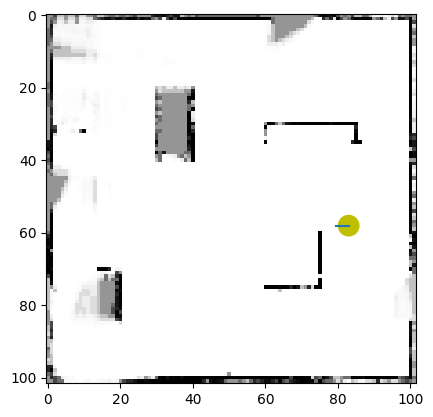

 58%|█████▊    | 440/759 [02:34<02:32,  2.09it/s]

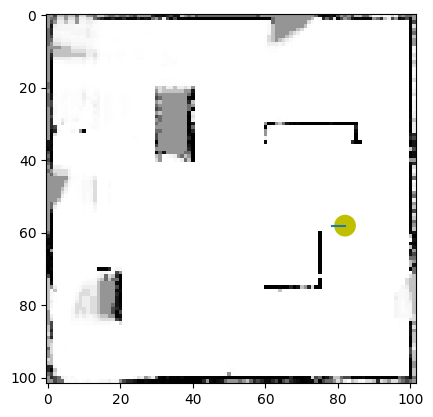

 58%|█████▊    | 441/759 [02:34<02:41,  1.97it/s]

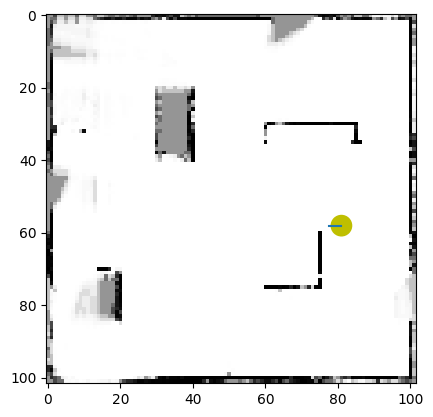

 58%|█████▊    | 442/759 [02:35<02:41,  1.96it/s]

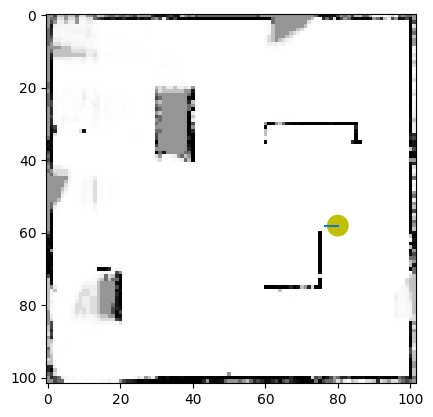

 58%|█████▊    | 443/759 [02:35<02:44,  1.92it/s]

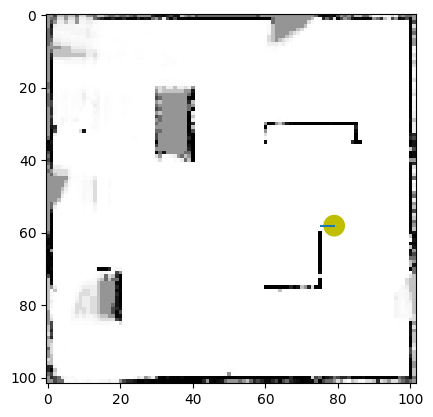

 58%|█████▊    | 444/759 [02:36<02:37,  2.00it/s]

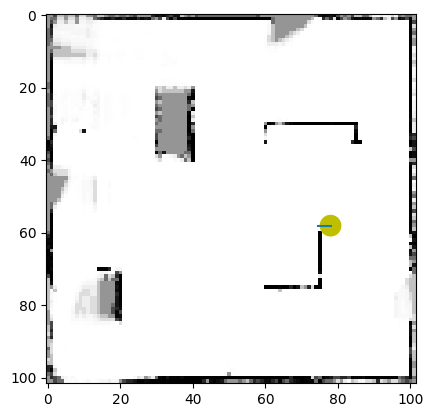

 59%|█████▊    | 445/759 [02:36<02:53,  1.81it/s]

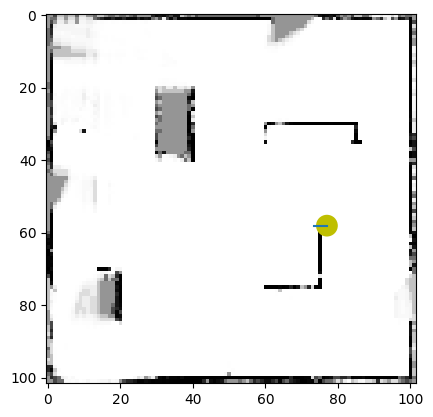

 59%|█████▉    | 446/759 [02:37<02:52,  1.81it/s]

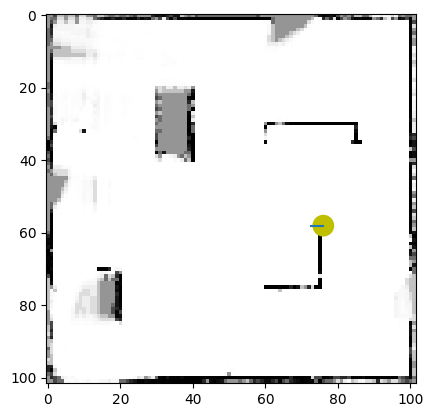

 59%|█████▉    | 447/759 [02:37<02:40,  1.95it/s]

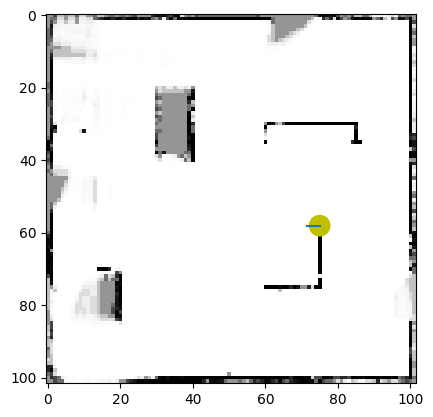

 59%|█████▉    | 448/759 [02:38<02:38,  1.96it/s]

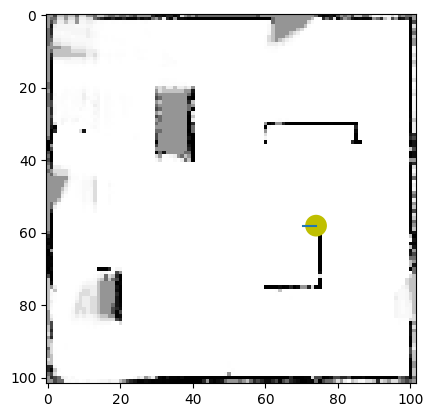

 59%|█████▉    | 449/759 [02:38<02:31,  2.05it/s]

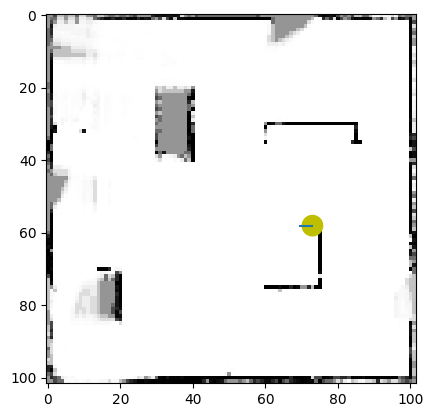

 59%|█████▉    | 450/759 [02:39<02:37,  1.97it/s]

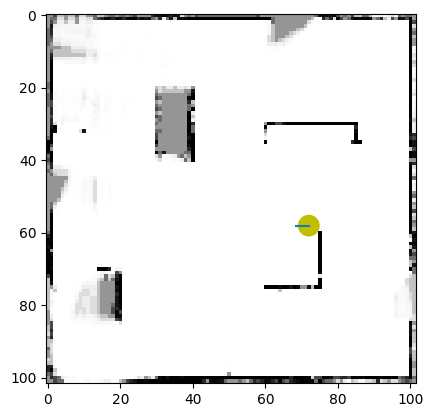

 59%|█████▉    | 451/759 [02:39<02:22,  2.15it/s]

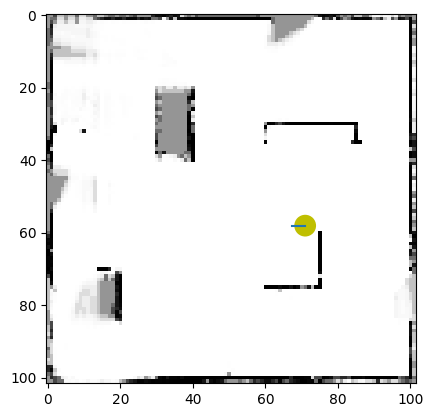

 60%|█████▉    | 452/759 [02:40<02:17,  2.23it/s]

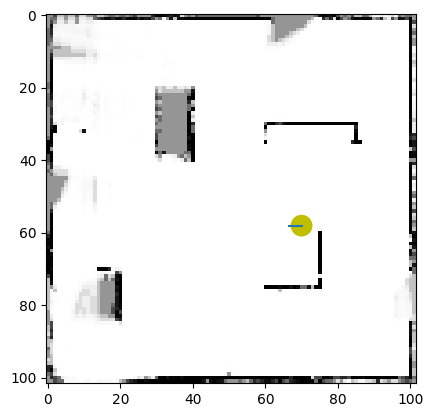

 60%|█████▉    | 453/759 [02:40<02:12,  2.31it/s]

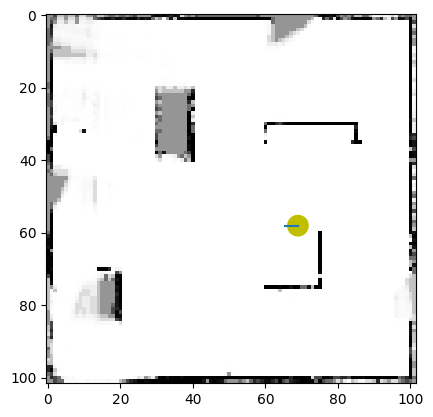

 60%|█████▉    | 454/759 [02:40<02:21,  2.16it/s]

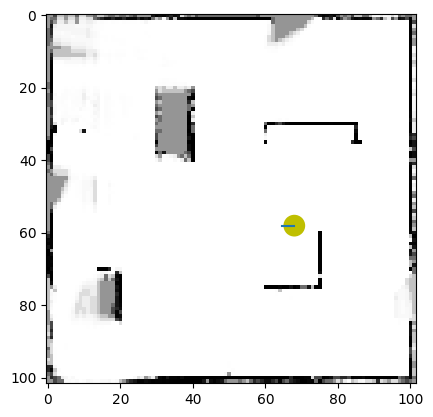

 60%|█████▉    | 455/759 [02:41<02:20,  2.16it/s]

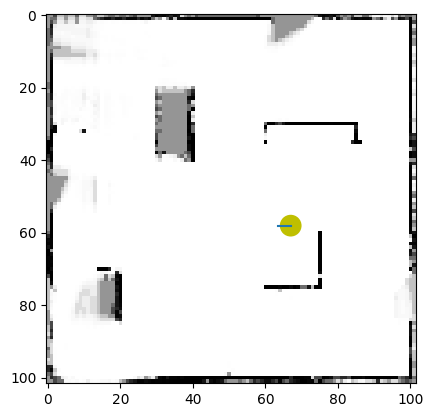

 60%|██████    | 456/759 [02:41<02:26,  2.07it/s]

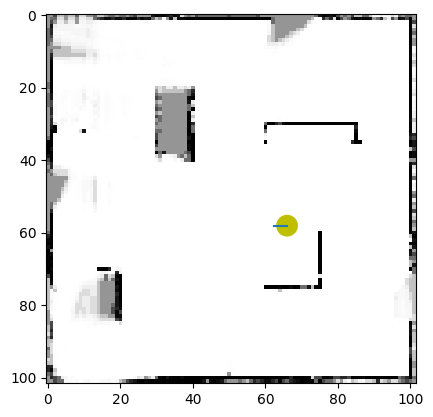

 60%|██████    | 457/759 [02:42<02:22,  2.13it/s]

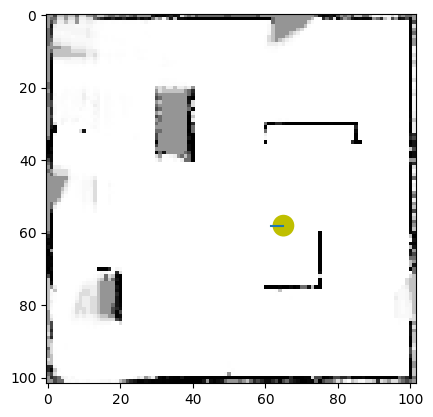

 60%|██████    | 458/759 [02:42<02:29,  2.02it/s]

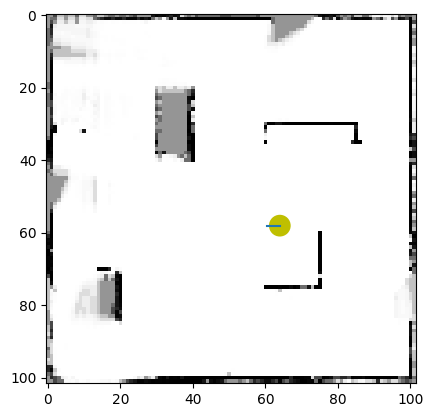

 60%|██████    | 459/759 [02:43<02:22,  2.10it/s]

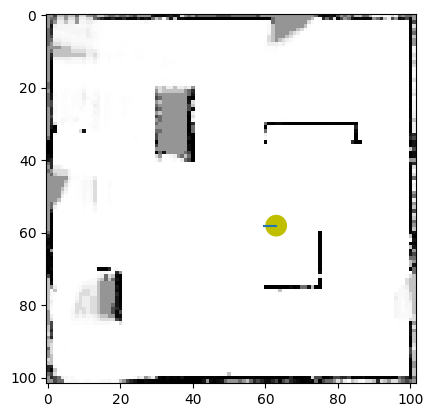

 61%|██████    | 460/759 [02:43<02:30,  1.99it/s]

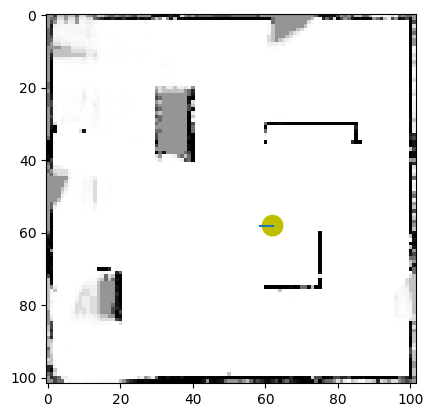

 61%|██████    | 461/759 [02:44<02:37,  1.89it/s]

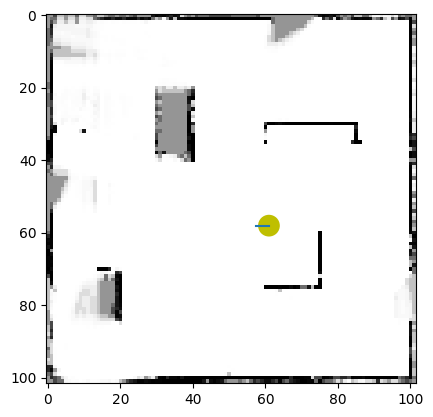

 61%|██████    | 462/759 [02:44<02:22,  2.08it/s]

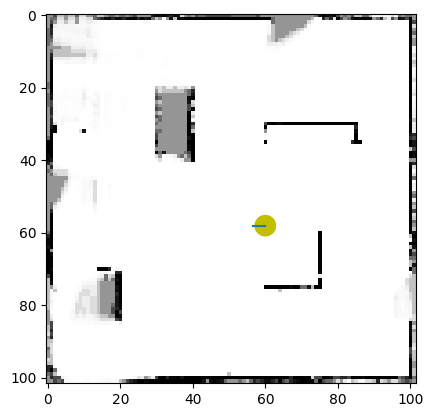

 61%|██████    | 463/759 [02:45<02:30,  1.97it/s]

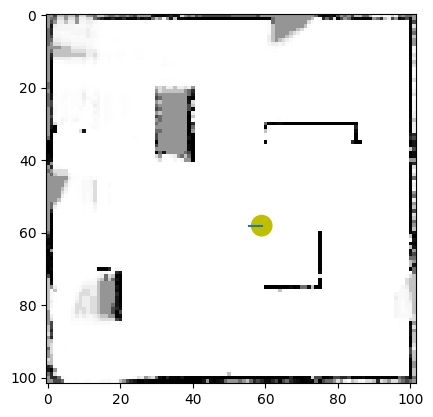

 61%|██████    | 464/759 [02:45<02:08,  2.30it/s]

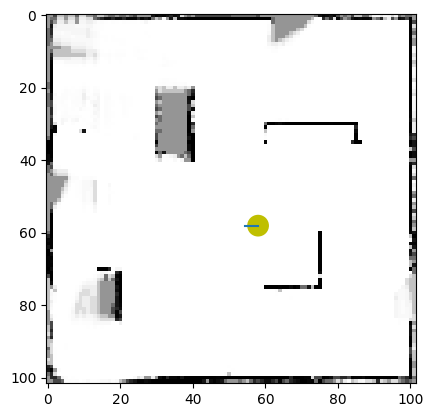

 61%|██████▏   | 465/759 [02:46<02:13,  2.20it/s]

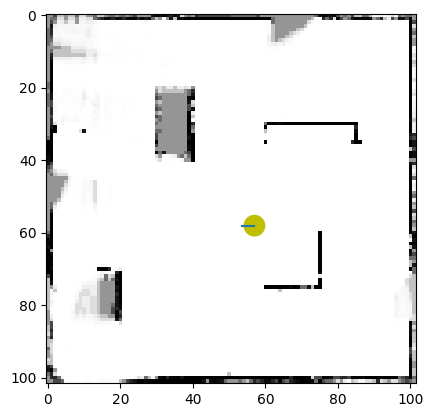

 61%|██████▏   | 466/759 [02:46<02:19,  2.10it/s]

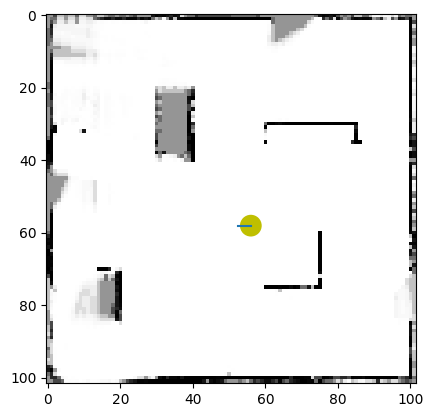

 62%|██████▏   | 467/759 [02:47<02:25,  2.00it/s]

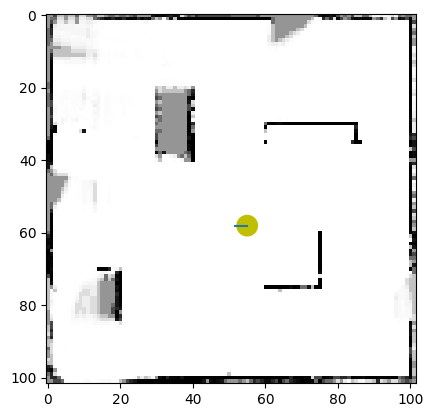

 62%|██████▏   | 468/759 [02:47<02:09,  2.24it/s]

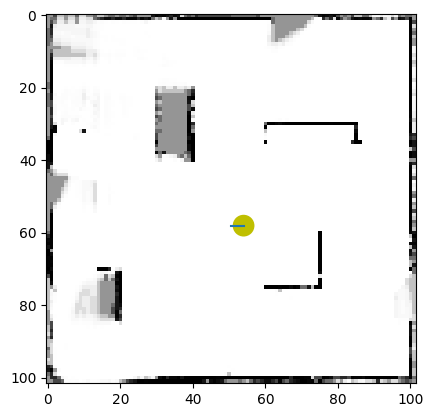

 62%|██████▏   | 469/759 [02:47<01:58,  2.44it/s]

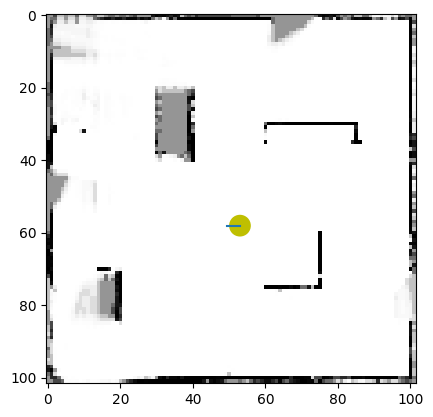

 62%|██████▏   | 470/759 [02:48<01:55,  2.51it/s]

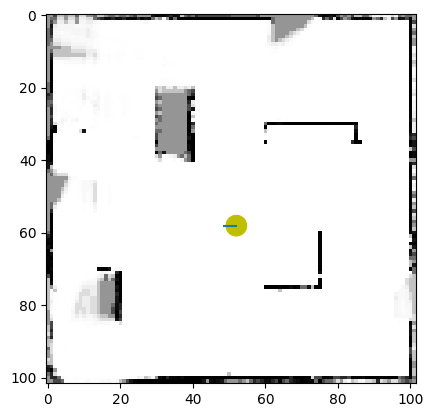

 62%|██████▏   | 471/759 [02:48<02:05,  2.30it/s]

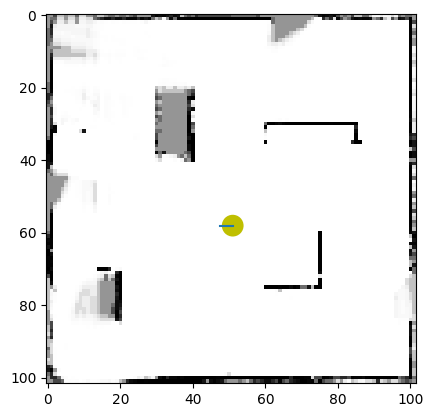

 62%|██████▏   | 472/759 [02:49<02:11,  2.18it/s]

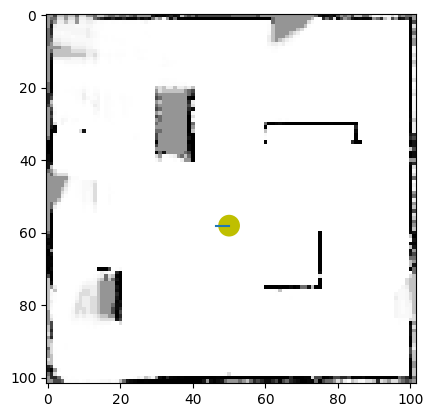

 62%|██████▏   | 473/759 [02:49<02:08,  2.23it/s]

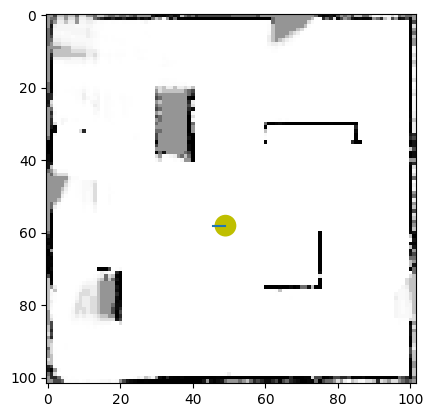

 62%|██████▏   | 474/759 [02:50<02:08,  2.21it/s]

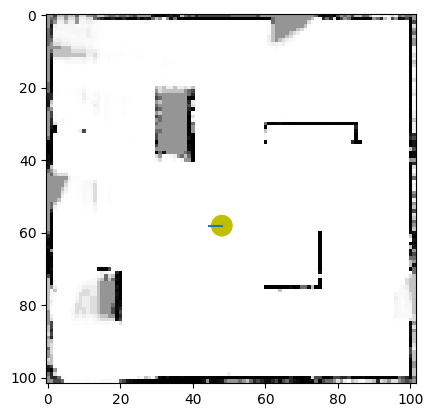

 63%|██████▎   | 475/759 [02:50<02:11,  2.17it/s]

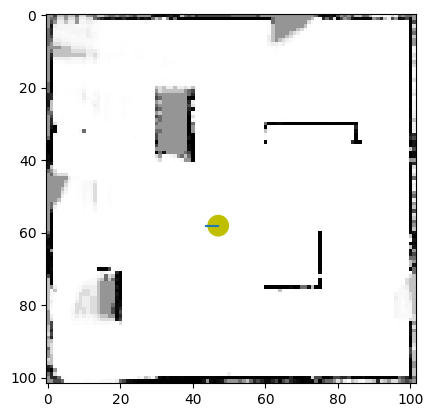

 63%|██████▎   | 476/759 [02:51<02:07,  2.23it/s]

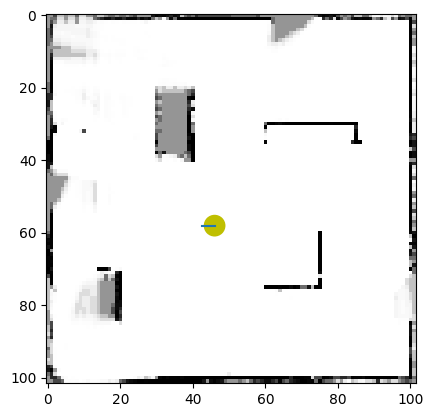

 63%|██████▎   | 477/759 [02:51<02:12,  2.12it/s]

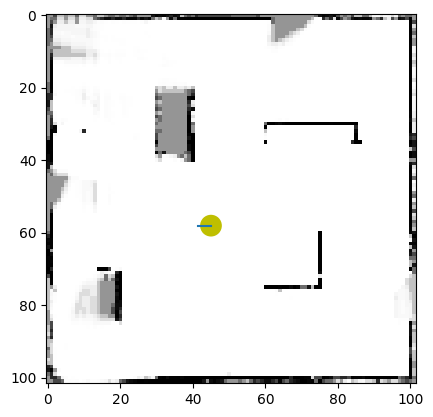

 63%|██████▎   | 478/759 [02:52<02:07,  2.21it/s]

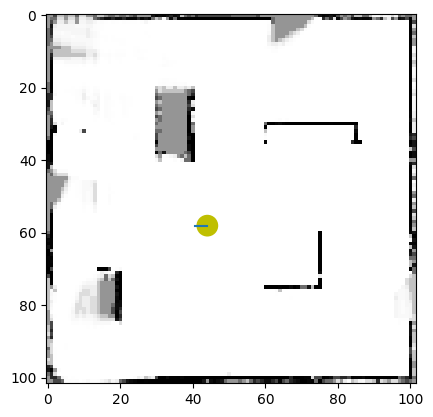

 63%|██████▎   | 479/759 [02:52<02:11,  2.13it/s]

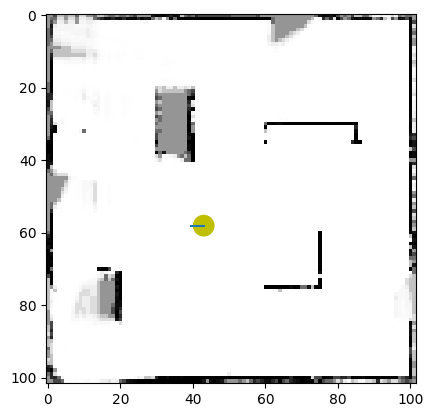

 63%|██████▎   | 480/759 [02:53<02:13,  2.08it/s]

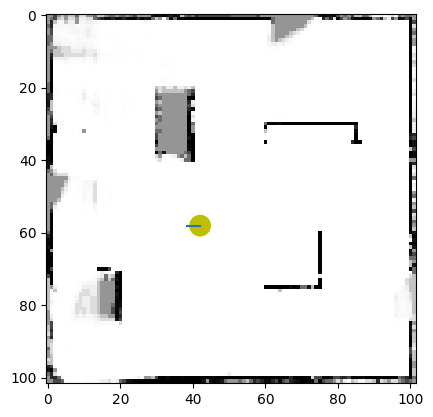

 63%|██████▎   | 481/759 [02:53<02:12,  2.10it/s]

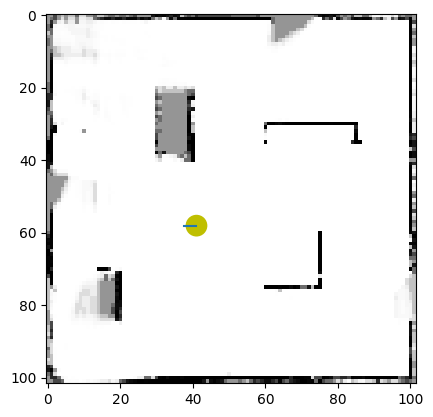

 64%|██████▎   | 482/759 [02:54<02:13,  2.08it/s]

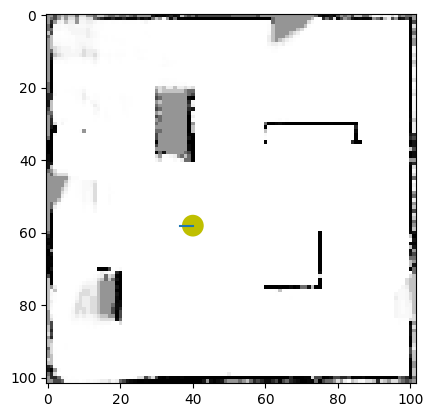

 64%|██████▎   | 483/759 [02:54<02:05,  2.20it/s]

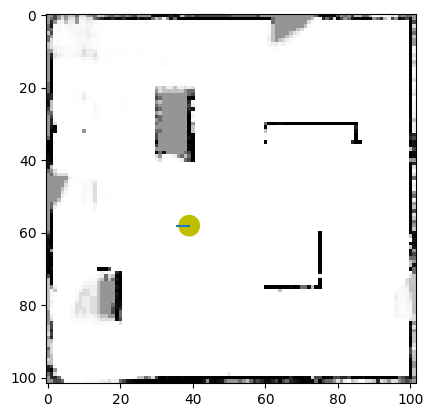

 64%|██████▍   | 484/759 [02:54<02:08,  2.14it/s]

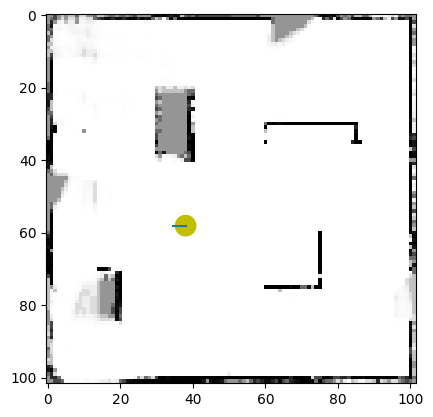

 64%|██████▍   | 485/759 [02:55<02:02,  2.24it/s]

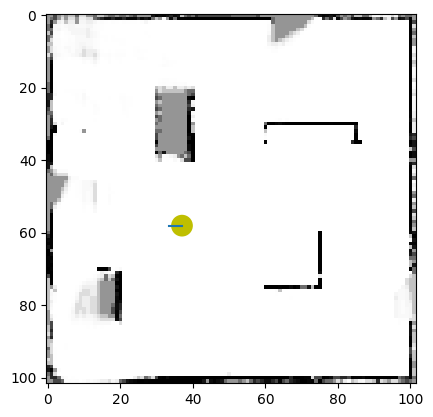

 64%|██████▍   | 486/759 [02:55<02:01,  2.25it/s]

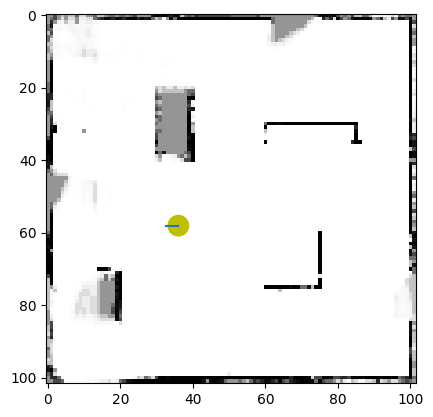

 64%|██████▍   | 487/759 [02:56<02:04,  2.19it/s]

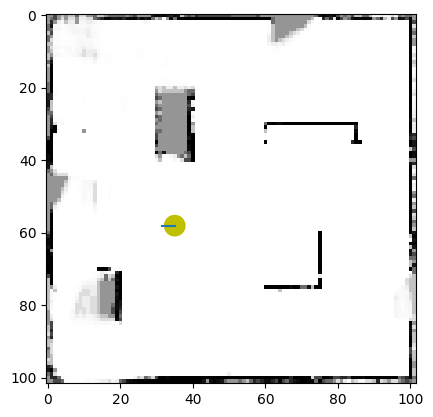

 64%|██████▍   | 488/759 [02:56<02:11,  2.07it/s]

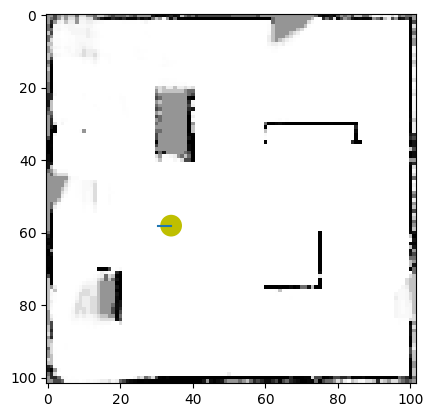

 64%|██████▍   | 489/759 [02:57<02:09,  2.08it/s]

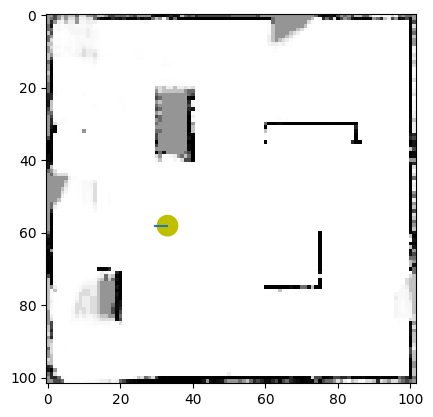

 65%|██████▍   | 490/759 [02:57<02:00,  2.24it/s]

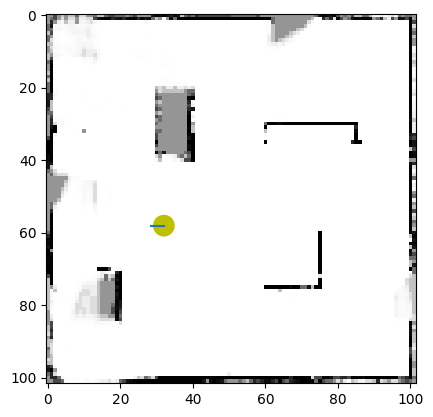

 65%|██████▍   | 491/759 [02:58<02:04,  2.16it/s]

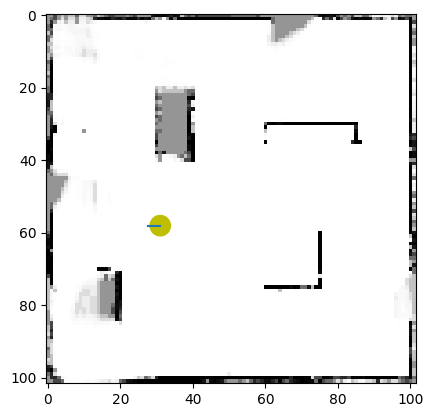

 65%|██████▍   | 492/759 [02:58<02:05,  2.13it/s]

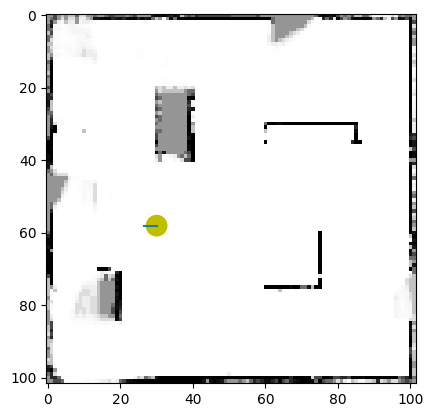

 65%|██████▍   | 493/759 [02:59<01:56,  2.28it/s]

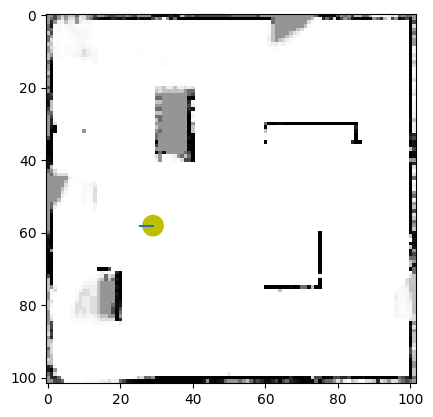

 65%|██████▌   | 494/759 [02:59<01:56,  2.27it/s]

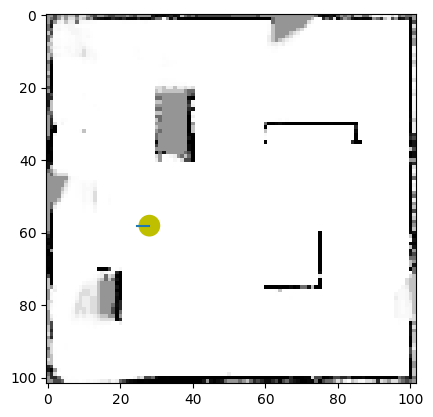

 65%|██████▌   | 495/759 [02:59<02:01,  2.17it/s]

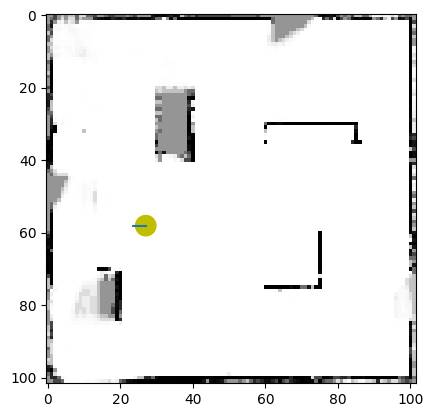

 65%|██████▌   | 496/759 [03:00<01:56,  2.26it/s]

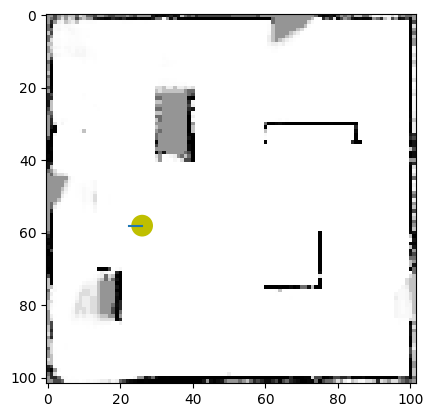

 65%|██████▌   | 497/759 [03:00<02:02,  2.15it/s]

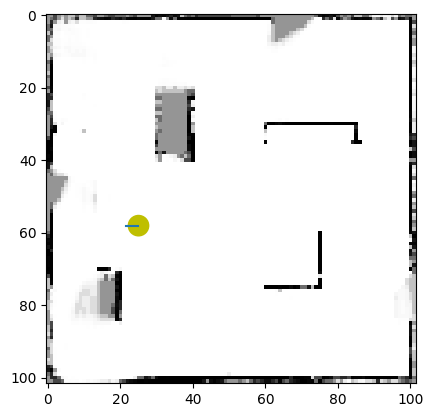

 66%|██████▌   | 498/759 [03:01<02:01,  2.14it/s]

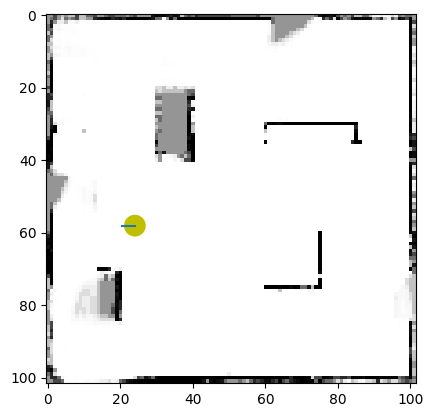

 66%|██████▌   | 499/759 [03:01<02:11,  1.98it/s]

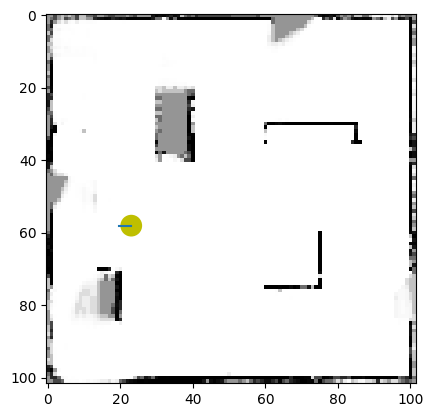

 66%|██████▌   | 500/759 [03:02<02:05,  2.06it/s]

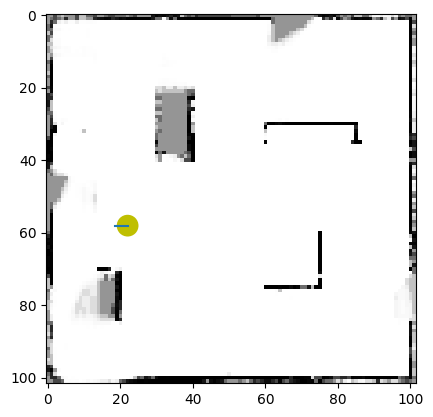

 66%|██████▌   | 501/759 [03:02<01:58,  2.18it/s]

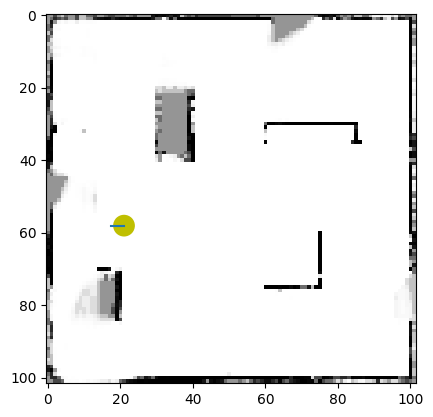

 66%|██████▌   | 502/759 [03:03<02:02,  2.11it/s]

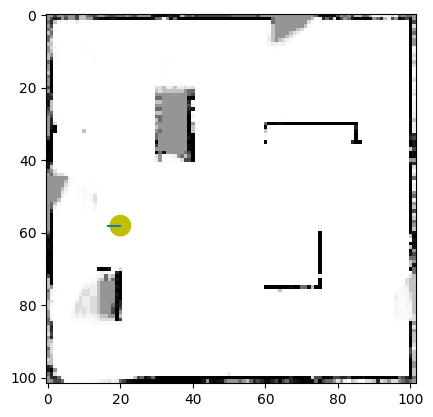

 66%|██████▋   | 503/759 [03:03<02:04,  2.05it/s]

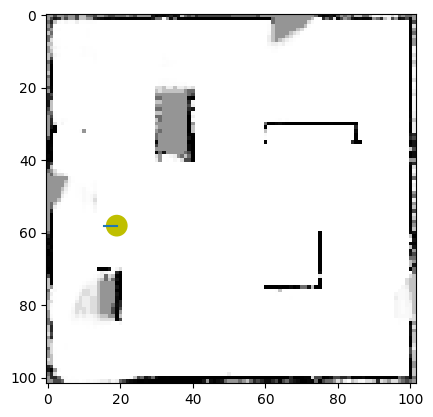

 66%|██████▋   | 504/759 [03:04<01:56,  2.19it/s]

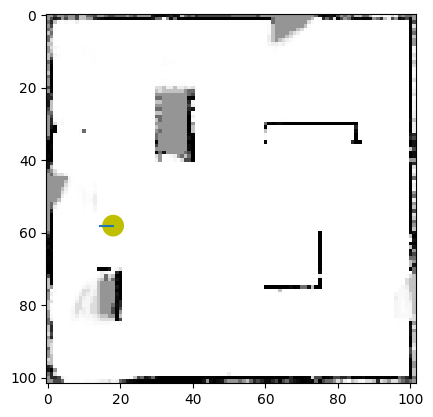

 67%|██████▋   | 505/759 [03:04<01:55,  2.19it/s]

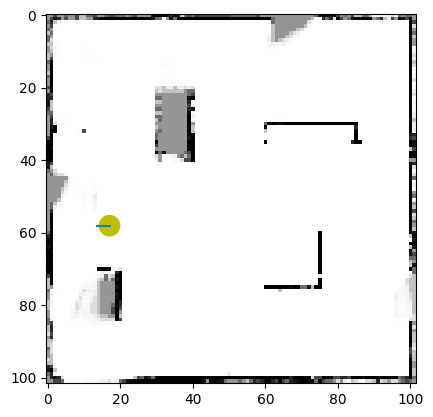

 67%|██████▋   | 506/759 [03:05<01:48,  2.33it/s]

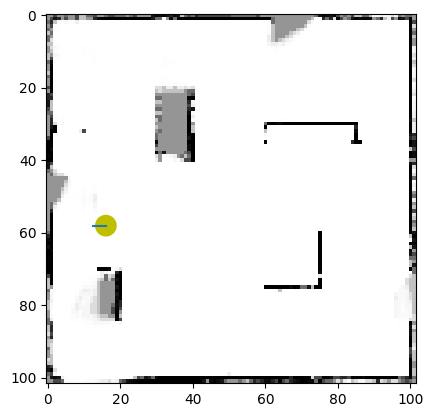

 67%|██████▋   | 507/759 [03:05<01:36,  2.62it/s]

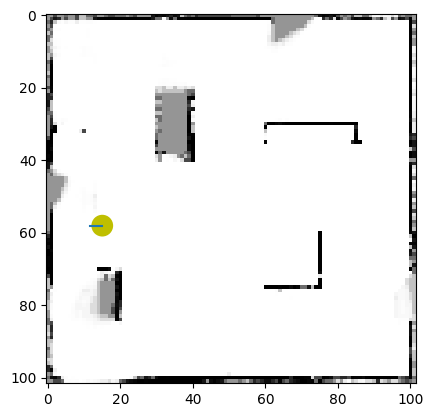

 67%|██████▋   | 508/759 [03:05<01:34,  2.67it/s]

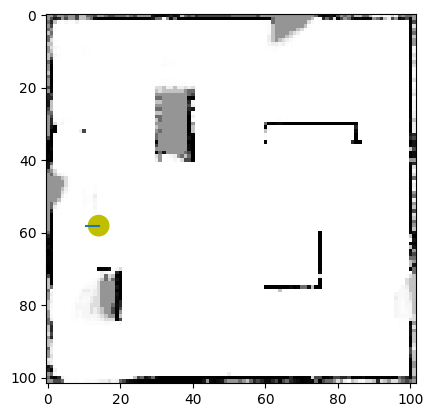

 67%|██████▋   | 509/759 [03:06<01:39,  2.50it/s]

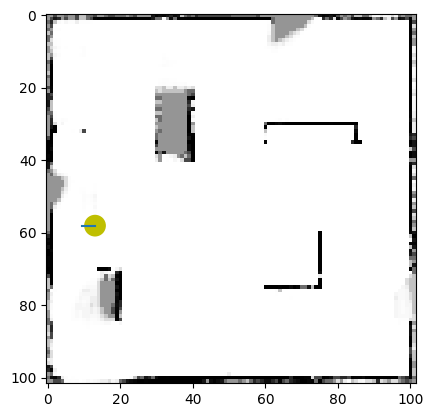

 67%|██████▋   | 510/759 [03:06<01:40,  2.49it/s]

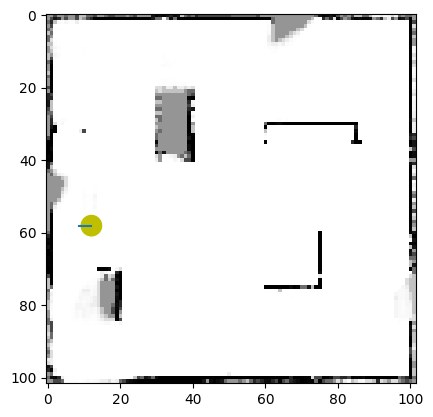

 67%|██████▋   | 511/759 [03:07<01:45,  2.34it/s]

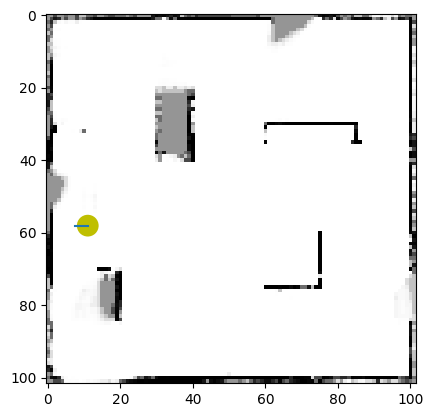

 67%|██████▋   | 512/759 [03:07<01:50,  2.23it/s]

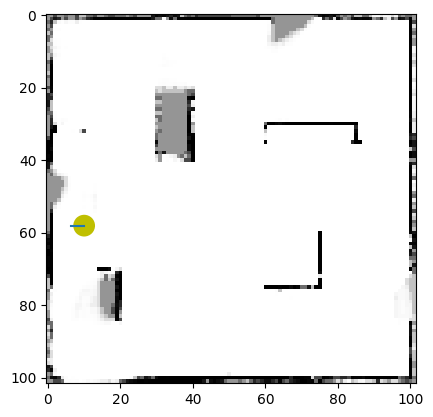

 68%|██████▊   | 513/759 [03:08<01:58,  2.07it/s]

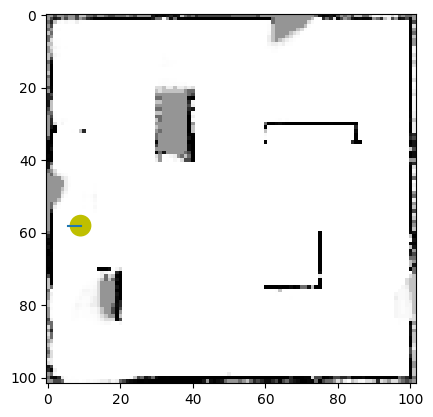

 68%|██████▊   | 514/759 [03:08<02:11,  1.86it/s]

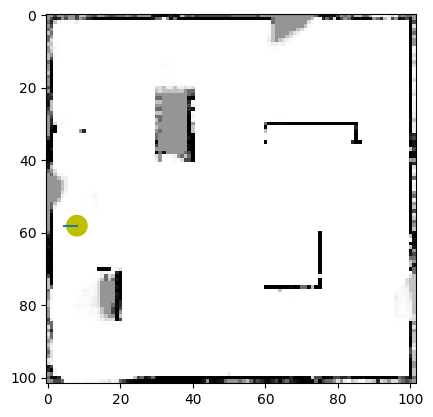

 68%|██████▊   | 515/759 [03:09<01:51,  2.18it/s]

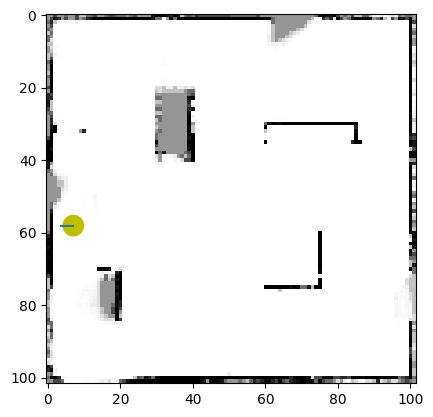

 68%|██████▊   | 516/759 [03:09<01:50,  2.20it/s]

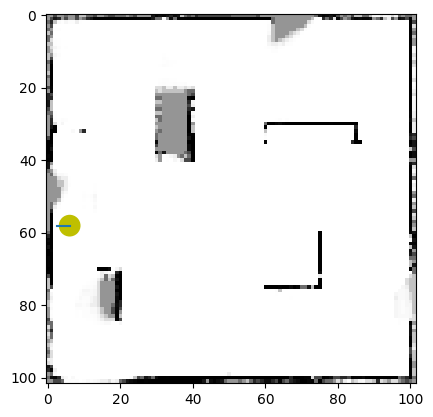

 68%|██████▊   | 517/759 [03:09<01:41,  2.37it/s]

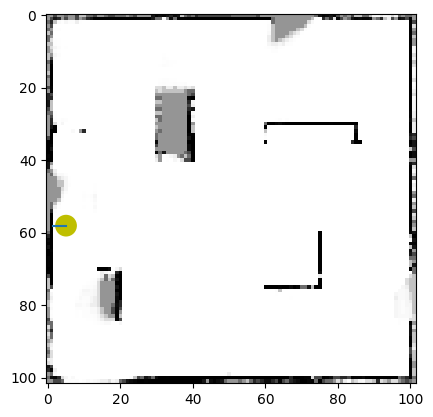

 68%|██████▊   | 518/759 [03:10<02:22,  1.70it/s]

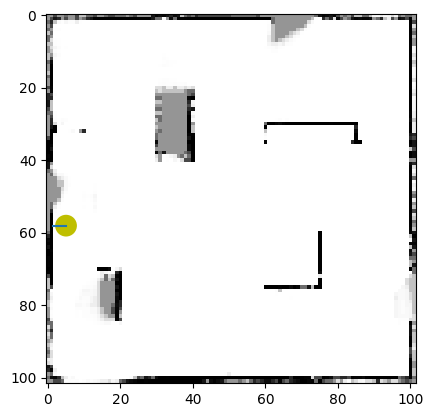

 68%|██████▊   | 519/759 [03:11<02:48,  1.42it/s]

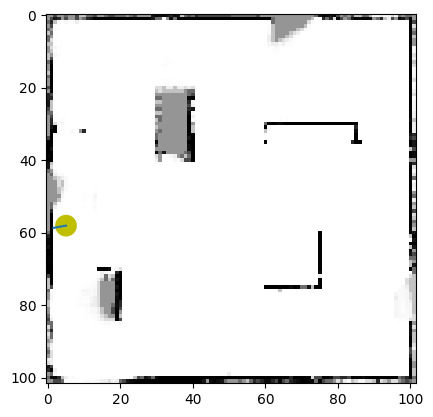

 69%|██████▊   | 520/759 [03:12<02:45,  1.44it/s]

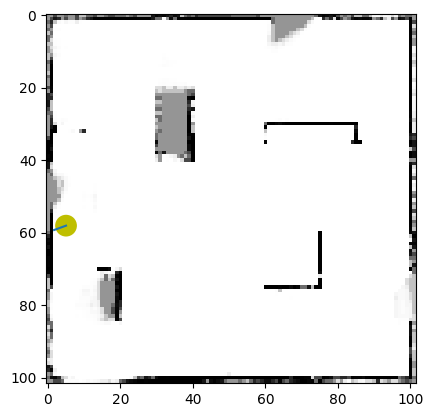

 69%|██████▊   | 521/759 [03:13<02:39,  1.50it/s]

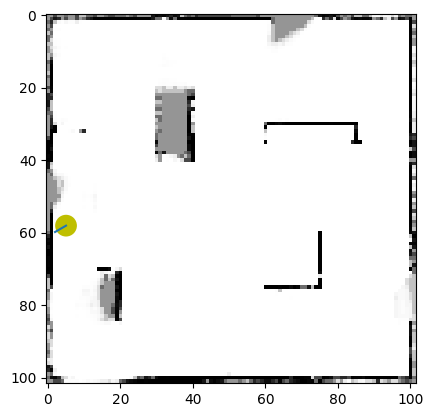

 69%|██████▉   | 522/759 [03:13<02:33,  1.55it/s]

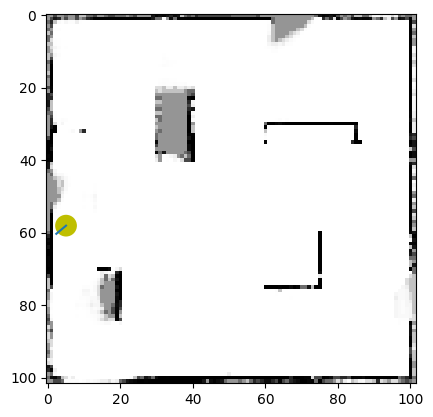

 69%|██████▉   | 523/759 [03:14<02:40,  1.47it/s]

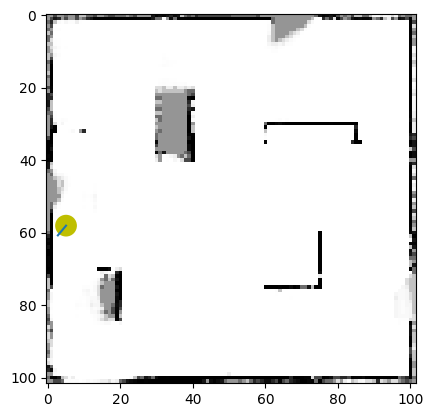

 69%|██████▉   | 524/759 [03:15<02:35,  1.51it/s]

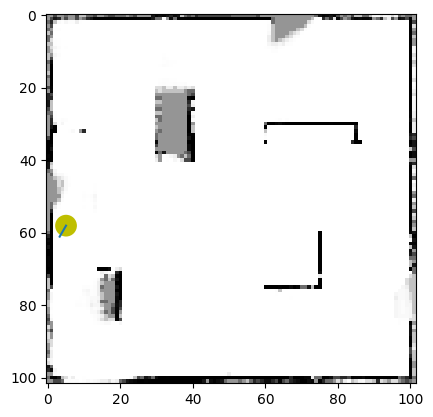

 69%|██████▉   | 525/759 [03:15<02:38,  1.47it/s]

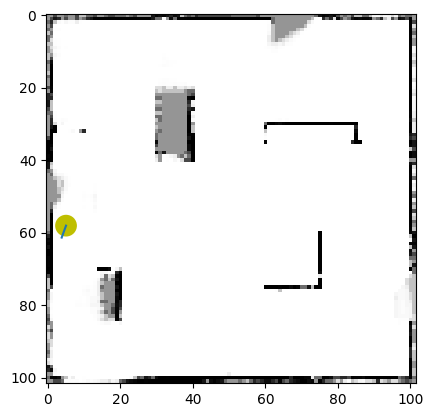

 69%|██████▉   | 526/759 [03:16<02:44,  1.41it/s]

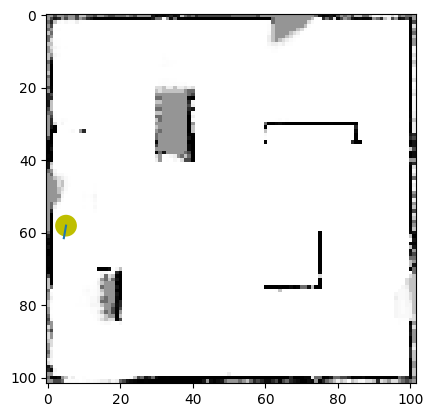

 69%|██████▉   | 527/759 [03:17<02:40,  1.45it/s]

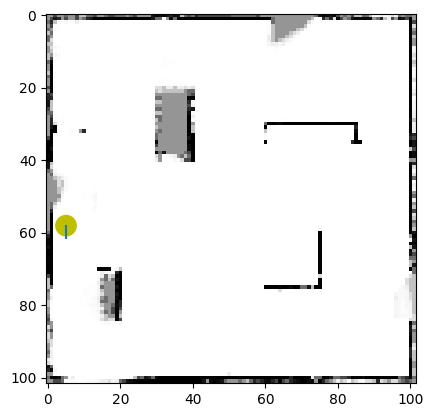

 70%|██████▉   | 528/759 [03:17<02:23,  1.61it/s]

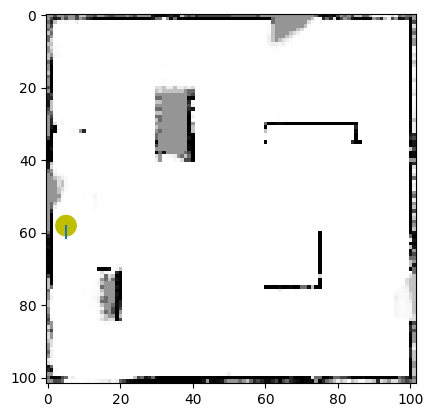

 70%|██████▉   | 529/759 [03:18<02:16,  1.68it/s]

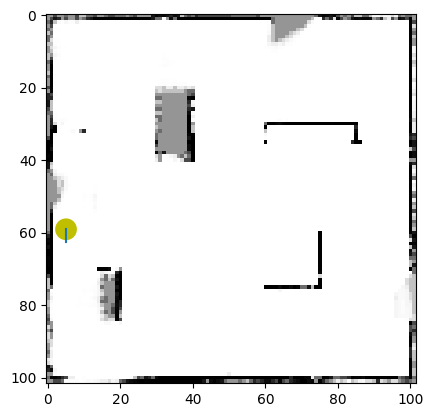

 70%|██████▉   | 530/759 [03:18<02:12,  1.72it/s]

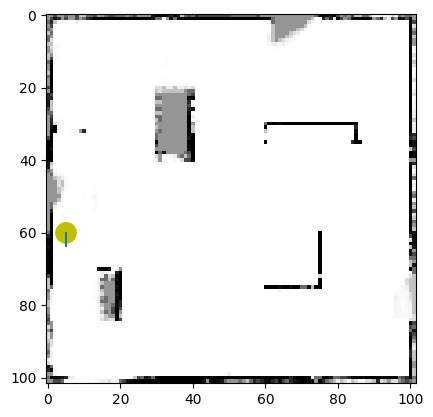

 70%|██████▉   | 531/759 [03:19<02:16,  1.68it/s]

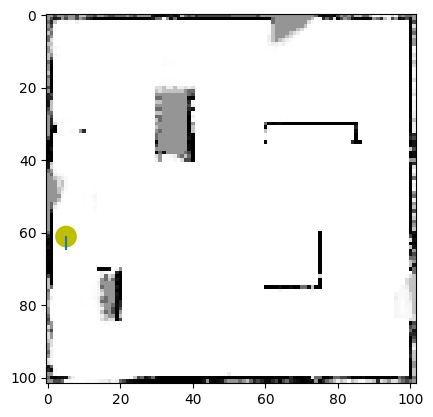

 70%|███████   | 532/759 [03:20<02:28,  1.53it/s]

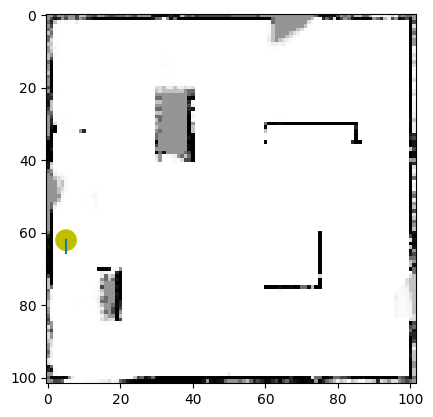

 70%|███████   | 533/759 [03:20<02:27,  1.54it/s]

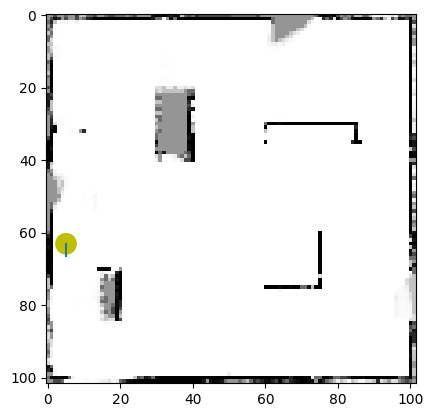

 70%|███████   | 534/759 [03:21<02:12,  1.70it/s]

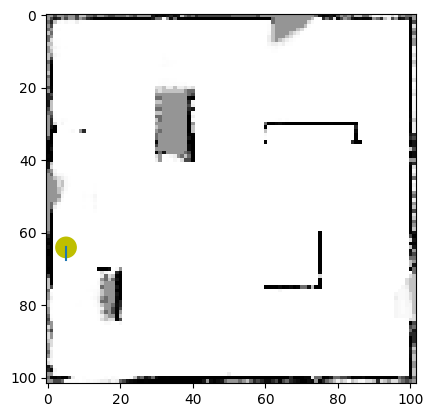

 70%|███████   | 535/759 [03:21<02:12,  1.70it/s]

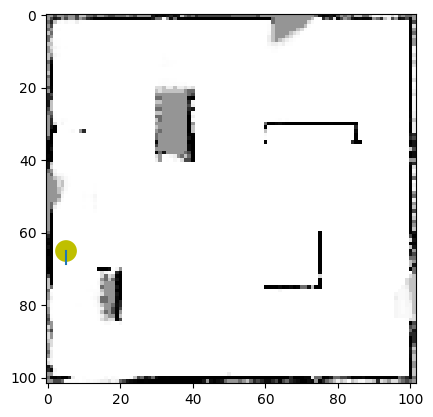

 71%|███████   | 536/759 [03:22<02:17,  1.62it/s]

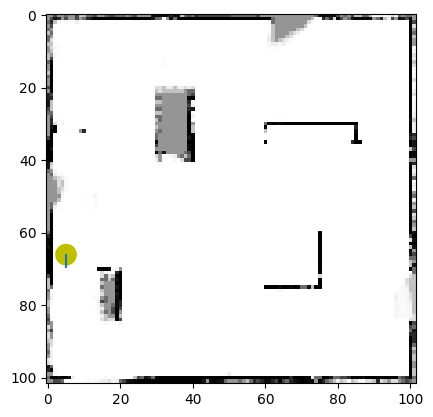

 71%|███████   | 537/759 [03:23<02:14,  1.65it/s]

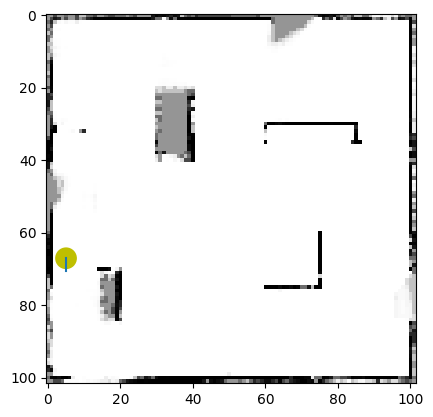

 71%|███████   | 538/759 [03:23<02:15,  1.63it/s]

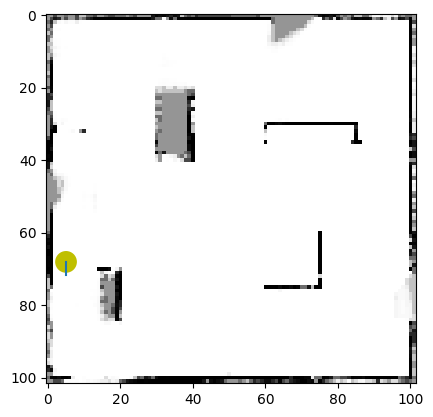

 71%|███████   | 539/759 [03:24<02:06,  1.74it/s]

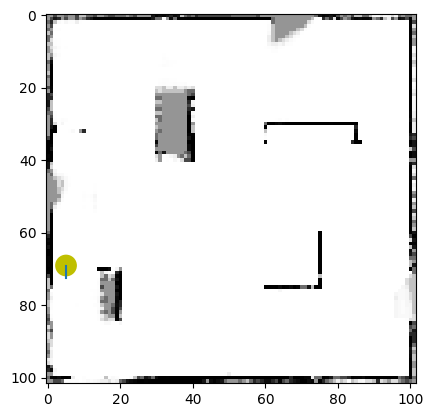

 71%|███████   | 540/759 [03:24<02:10,  1.68it/s]

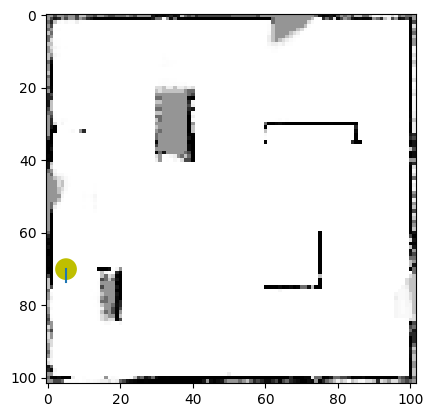

 71%|███████▏  | 541/759 [03:25<02:15,  1.60it/s]

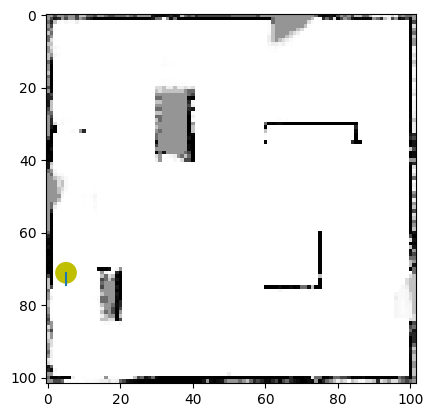

 71%|███████▏  | 542/759 [03:26<02:22,  1.52it/s]

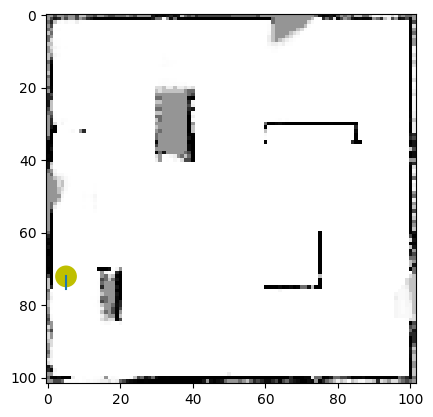

 72%|███████▏  | 543/759 [03:26<02:22,  1.52it/s]

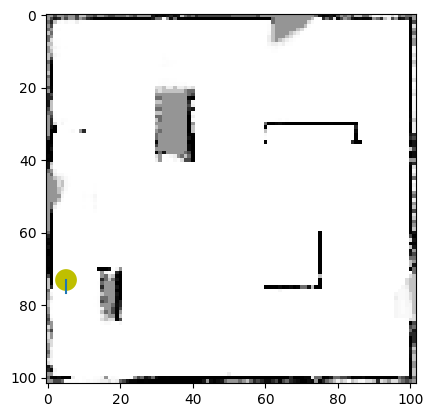

 72%|███████▏  | 544/759 [03:27<02:09,  1.67it/s]

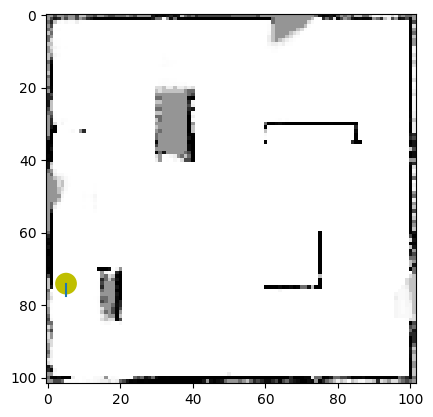

 72%|███████▏  | 545/759 [03:28<02:10,  1.64it/s]

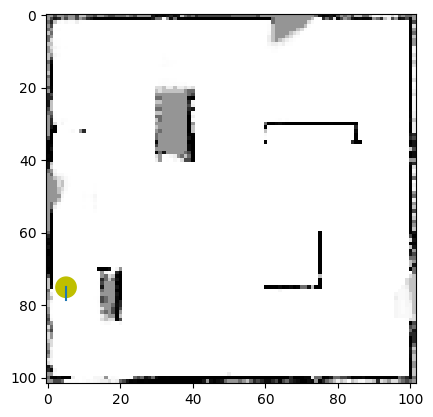

 72%|███████▏  | 546/759 [03:28<02:29,  1.42it/s]

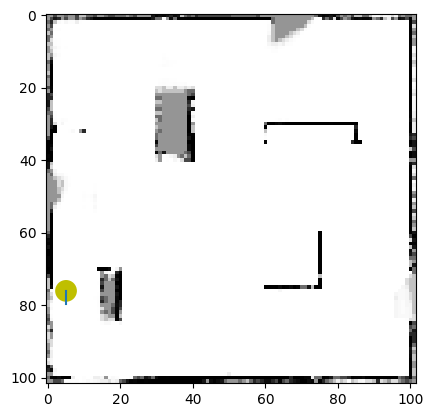

 72%|███████▏  | 547/759 [03:29<02:43,  1.30it/s]

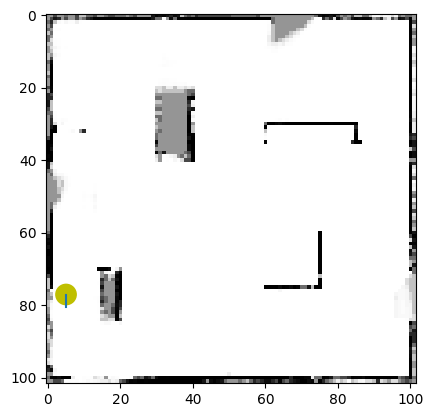

 72%|███████▏  | 548/759 [03:30<02:55,  1.20it/s]

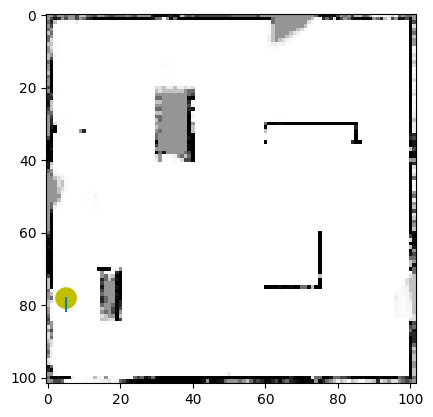

 72%|███████▏  | 549/759 [03:31<02:49,  1.24it/s]

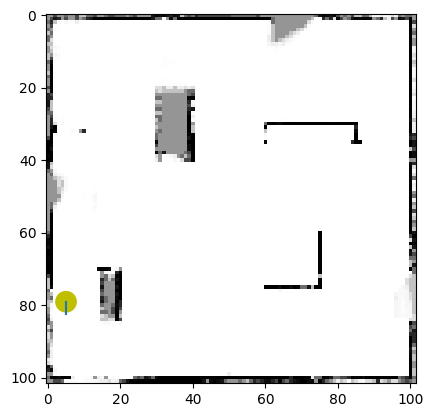

 72%|███████▏  | 550/759 [03:32<02:38,  1.32it/s]

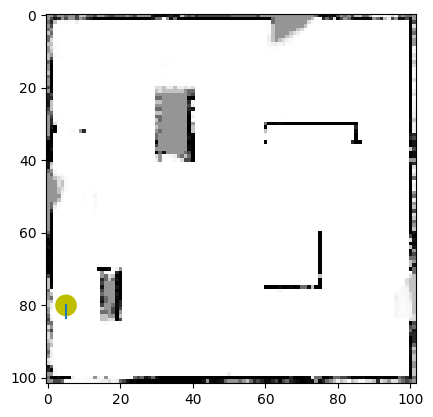

 73%|███████▎  | 551/759 [03:32<02:36,  1.33it/s]

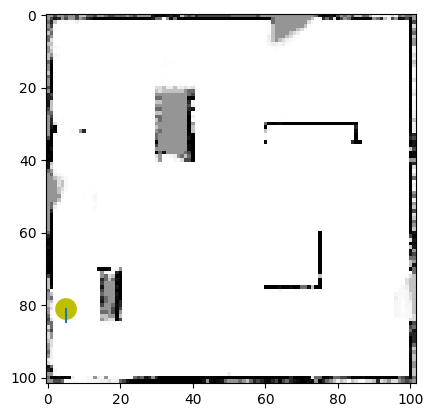

 73%|███████▎  | 552/759 [03:33<02:29,  1.38it/s]

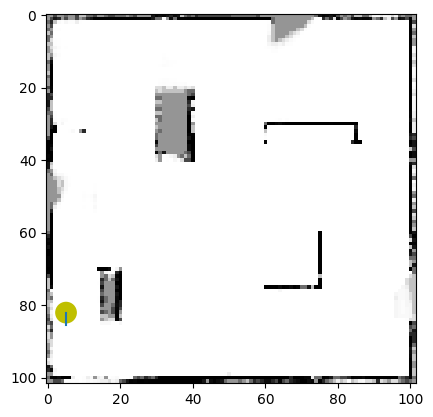

 73%|███████▎  | 553/759 [03:34<02:25,  1.42it/s]

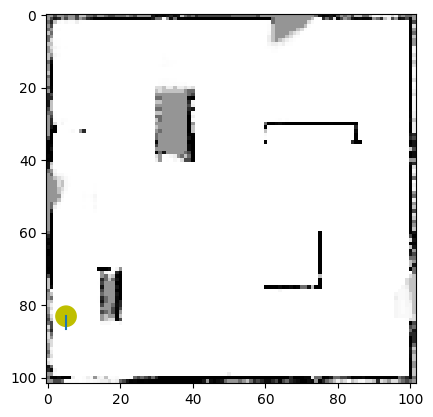

 73%|███████▎  | 554/759 [03:35<02:30,  1.36it/s]

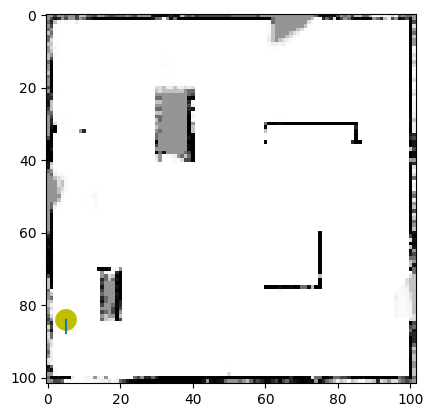

 73%|███████▎  | 555/759 [03:35<02:24,  1.41it/s]

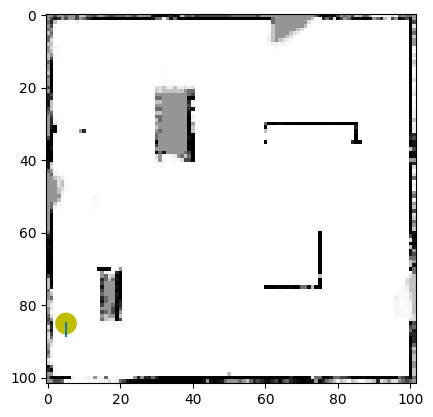

 73%|███████▎  | 556/759 [03:36<02:19,  1.46it/s]

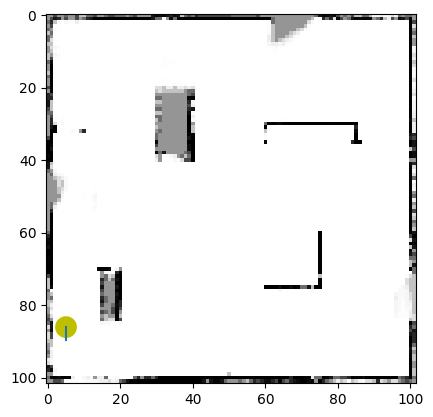

 73%|███████▎  | 557/759 [03:37<02:26,  1.38it/s]

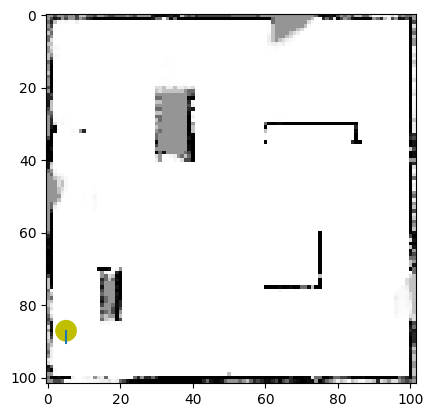

 74%|███████▎  | 558/759 [03:37<02:26,  1.37it/s]

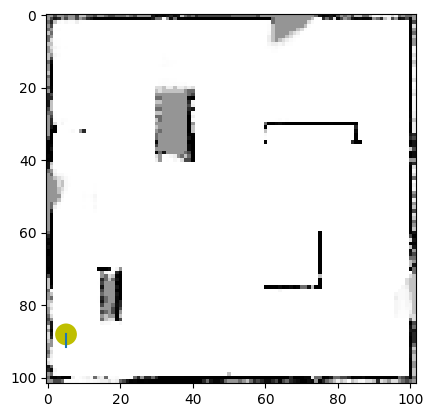

 74%|███████▎  | 559/759 [03:38<02:16,  1.46it/s]

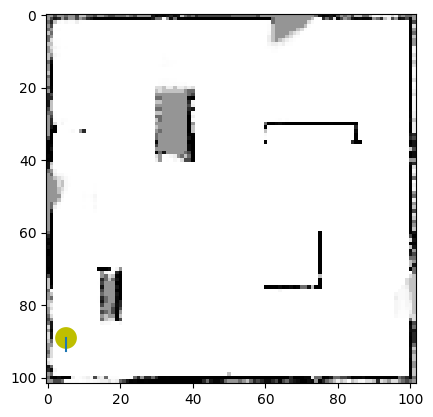

 74%|███████▍  | 560/759 [03:39<02:08,  1.55it/s]

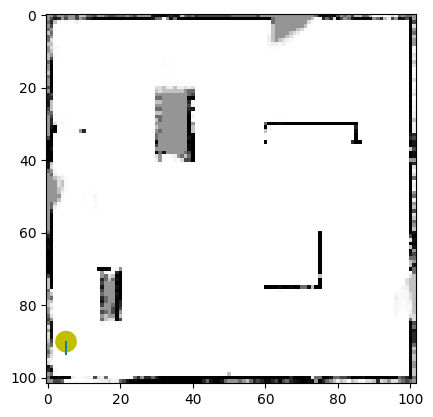

 74%|███████▍  | 561/759 [03:39<02:05,  1.57it/s]

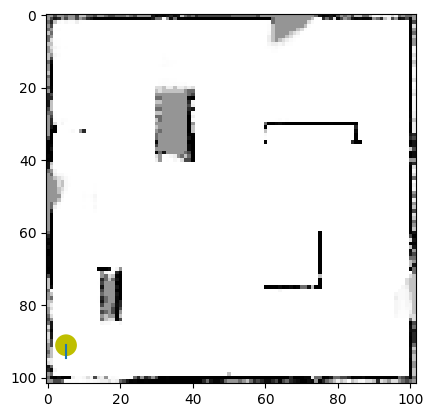

 74%|███████▍  | 562/759 [03:40<02:07,  1.55it/s]

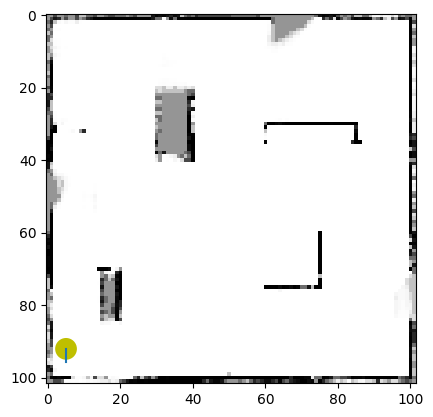

 74%|███████▍  | 563/759 [03:40<02:00,  1.62it/s]

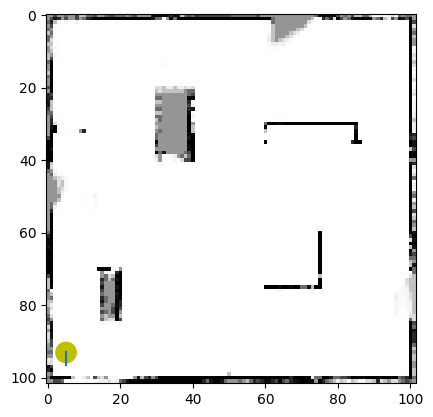

 74%|███████▍  | 564/759 [03:41<01:53,  1.72it/s]

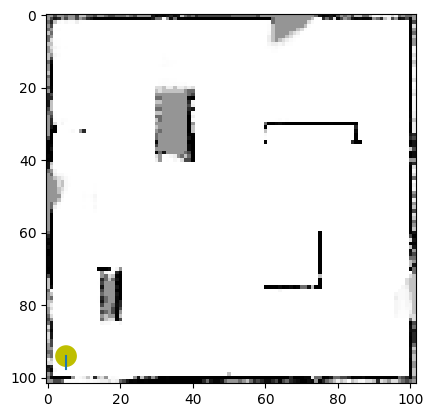

 74%|███████▍  | 565/759 [03:41<01:47,  1.81it/s]

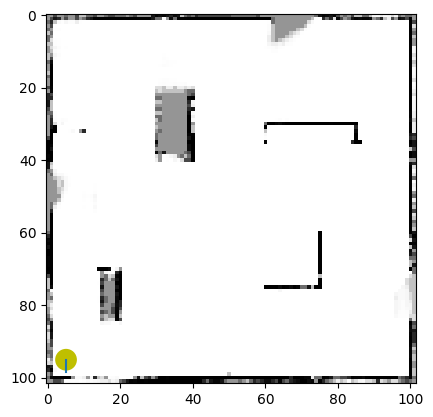

 75%|███████▍  | 566/759 [03:42<01:43,  1.87it/s]

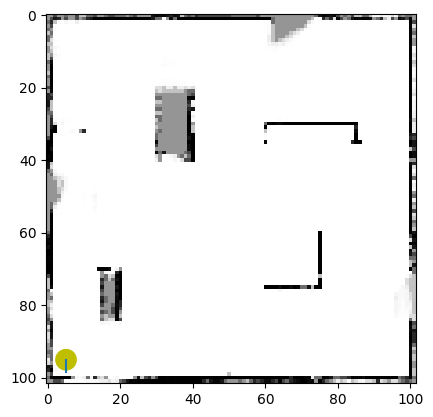

 75%|███████▍  | 567/759 [03:42<01:42,  1.87it/s]

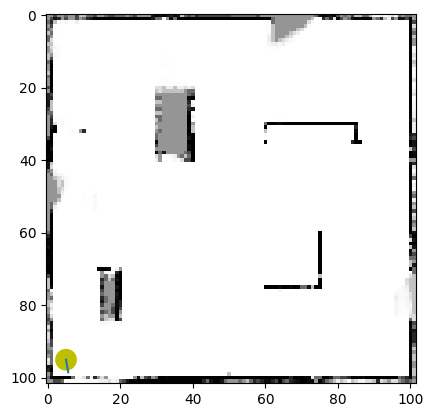

 75%|███████▍  | 568/759 [03:43<01:39,  1.92it/s]

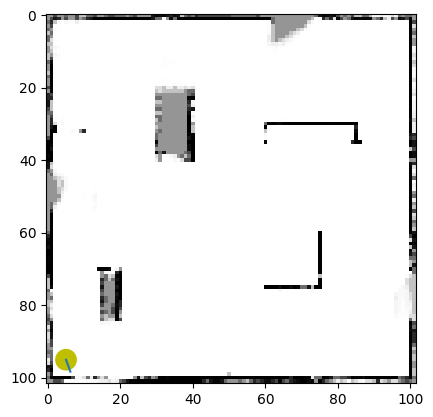

 75%|███████▍  | 569/759 [03:43<01:39,  1.90it/s]

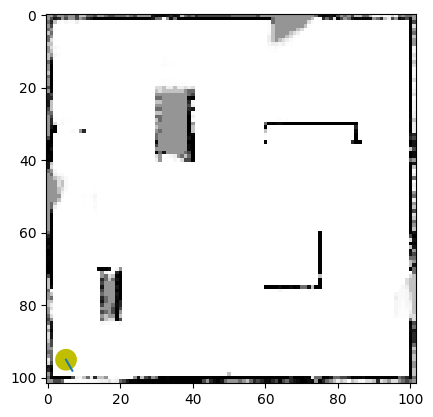

 75%|███████▌  | 570/759 [03:44<01:37,  1.94it/s]

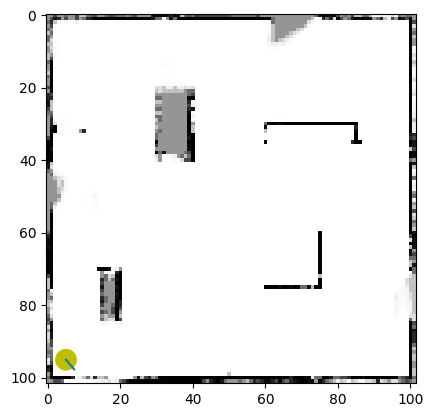

 75%|███████▌  | 571/759 [03:44<01:36,  1.94it/s]

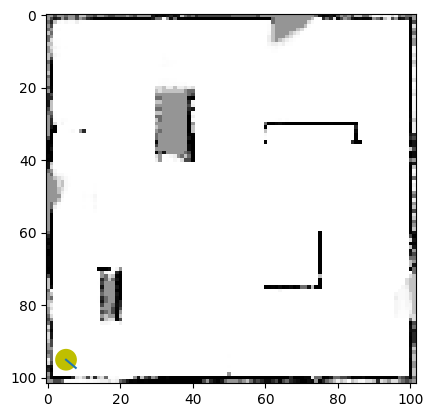

 75%|███████▌  | 572/759 [03:45<01:38,  1.89it/s]

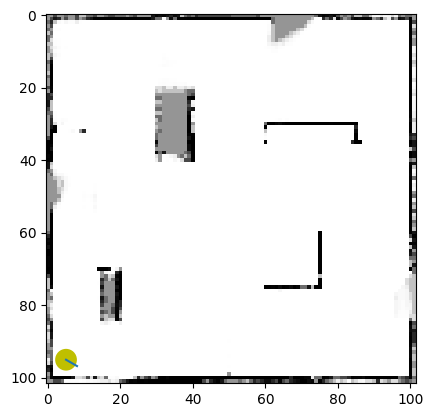

 75%|███████▌  | 573/759 [03:45<01:36,  1.93it/s]

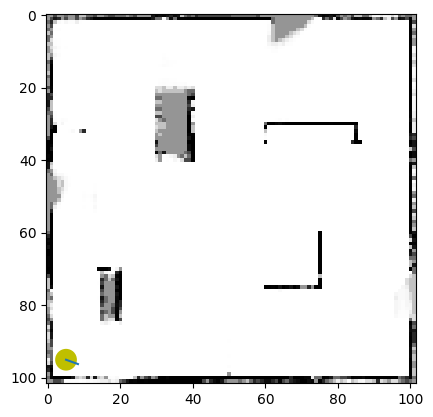

 76%|███████▌  | 574/759 [03:46<01:34,  1.96it/s]

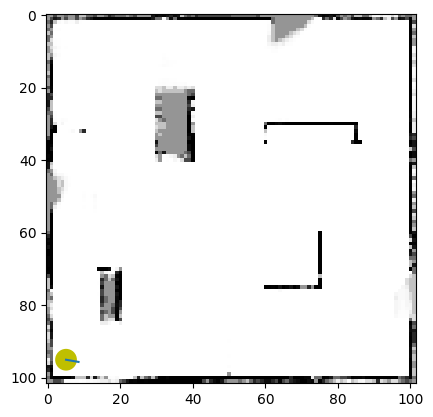

 76%|███████▌  | 575/759 [03:46<01:28,  2.09it/s]

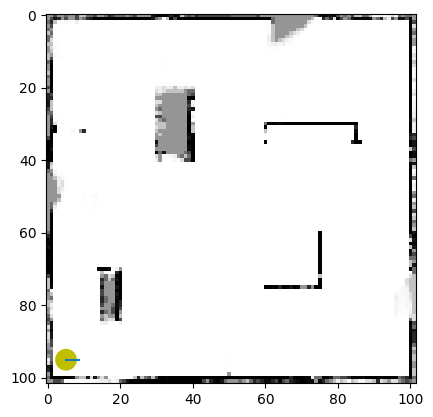

 76%|███████▌  | 576/759 [03:47<01:24,  2.16it/s]

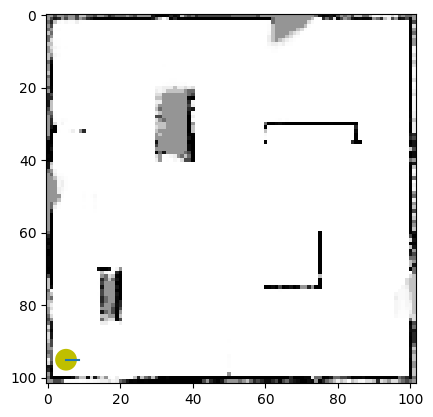

 76%|███████▌  | 577/759 [03:47<01:23,  2.19it/s]

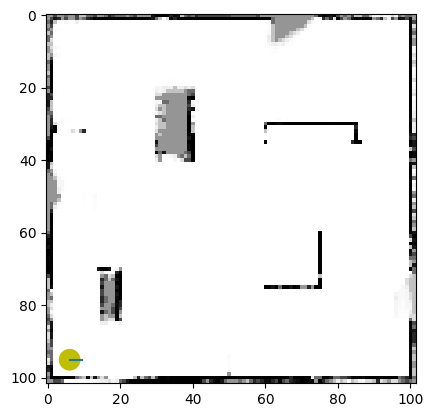

 76%|███████▌  | 578/759 [03:48<01:19,  2.27it/s]

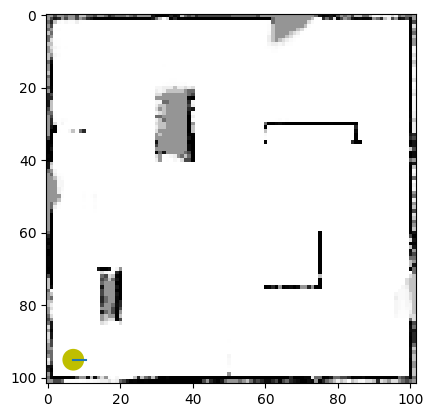

 76%|███████▋  | 579/759 [03:48<01:17,  2.32it/s]

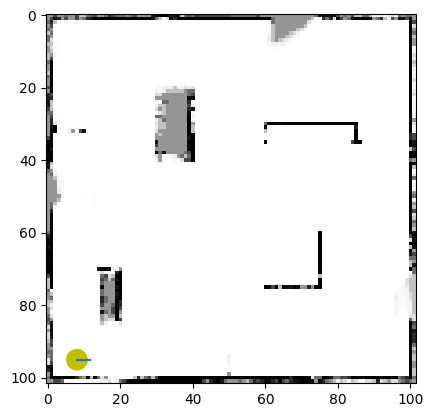

 76%|███████▋  | 580/759 [03:49<01:18,  2.27it/s]

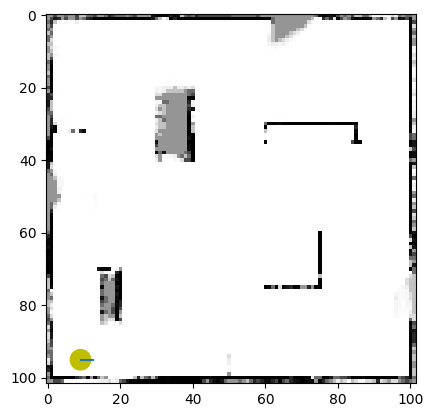

 77%|███████▋  | 581/759 [03:49<01:26,  2.06it/s]

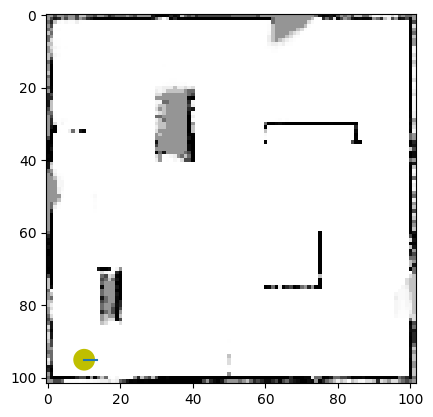

 77%|███████▋  | 582/759 [03:50<01:24,  2.08it/s]

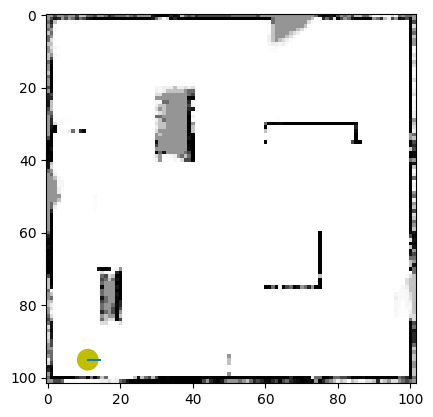

 77%|███████▋  | 583/759 [03:50<01:23,  2.12it/s]

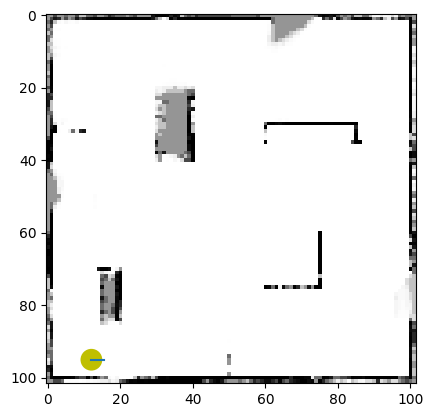

 77%|███████▋  | 584/759 [03:51<01:23,  2.10it/s]

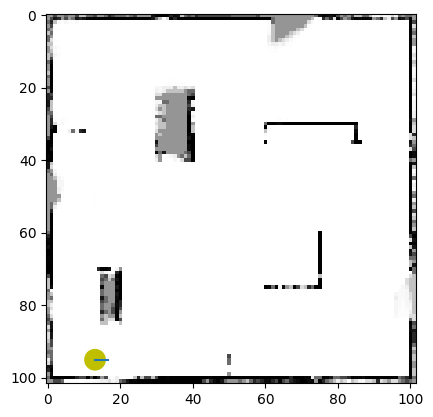

 77%|███████▋  | 585/759 [03:51<01:23,  2.09it/s]

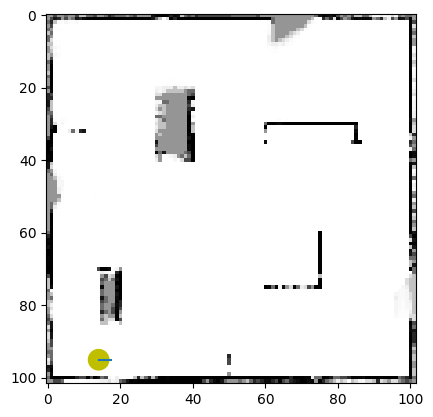

 77%|███████▋  | 586/759 [03:51<01:18,  2.19it/s]

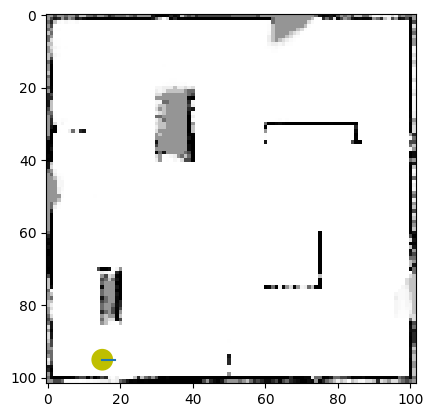

 77%|███████▋  | 587/759 [03:52<01:17,  2.22it/s]

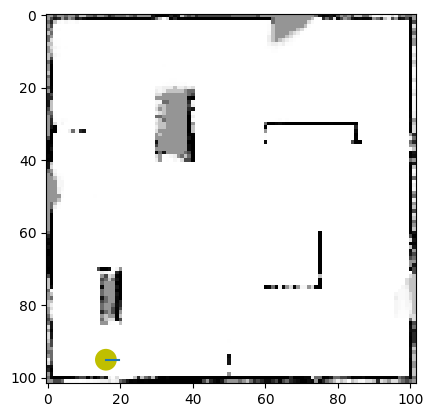

 77%|███████▋  | 588/759 [03:52<01:19,  2.16it/s]

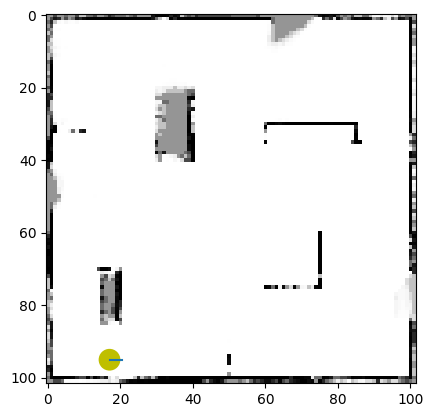

 78%|███████▊  | 589/759 [03:53<01:20,  2.12it/s]

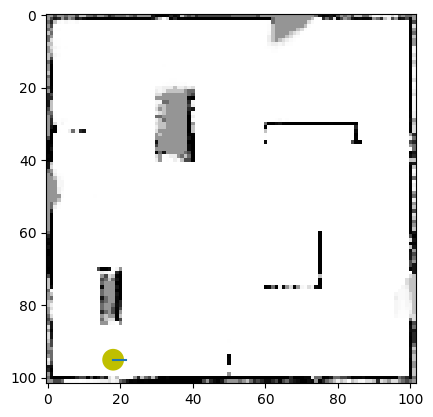

 78%|███████▊  | 590/759 [03:53<01:16,  2.21it/s]

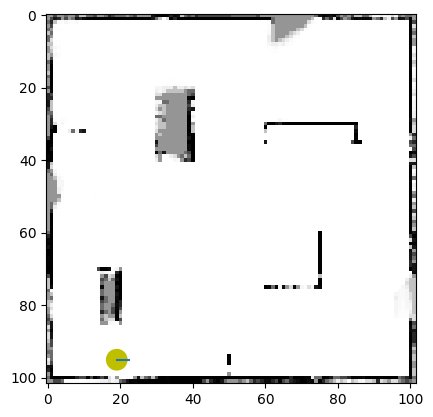

 78%|███████▊  | 591/759 [03:54<01:16,  2.21it/s]

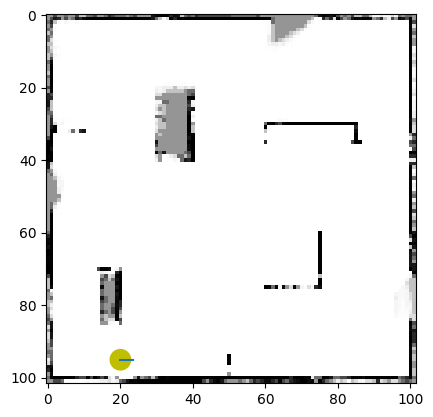

 78%|███████▊  | 592/759 [03:54<01:15,  2.20it/s]

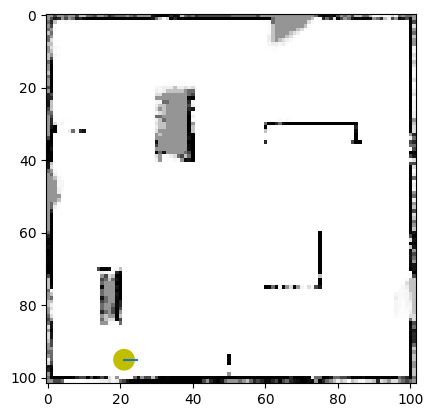

 78%|███████▊  | 593/759 [03:55<01:15,  2.18it/s]

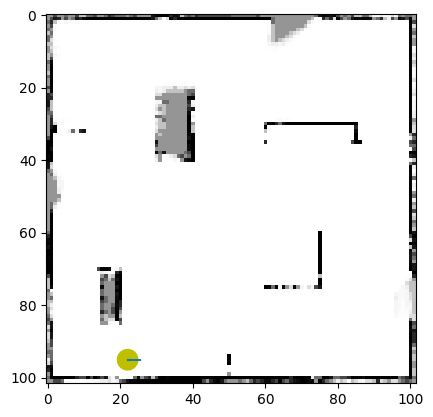

 78%|███████▊  | 594/759 [03:55<01:20,  2.05it/s]

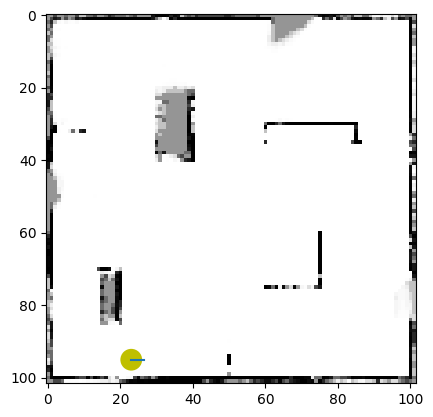

 78%|███████▊  | 595/759 [03:56<01:14,  2.21it/s]

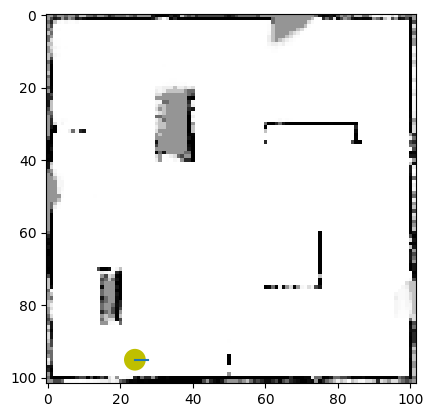

 79%|███████▊  | 596/759 [03:56<01:16,  2.14it/s]

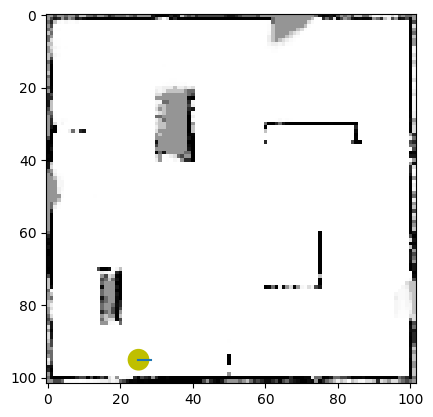

 79%|███████▊  | 597/759 [03:57<01:18,  2.07it/s]

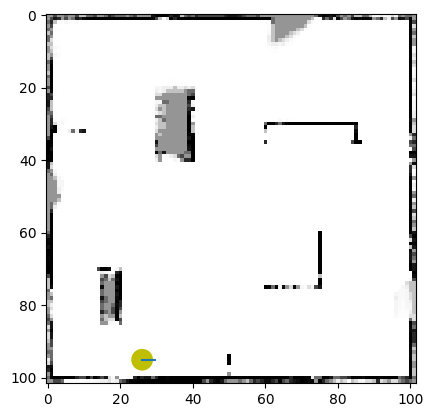

 79%|███████▉  | 598/759 [03:57<01:20,  1.99it/s]

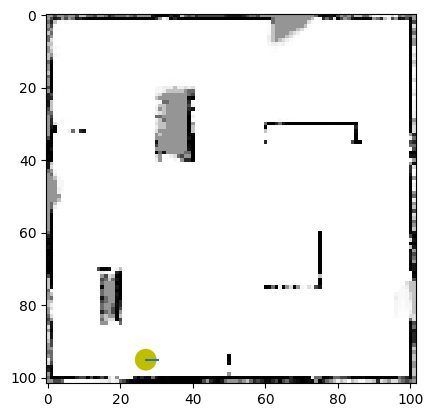

 79%|███████▉  | 599/759 [03:58<01:30,  1.77it/s]

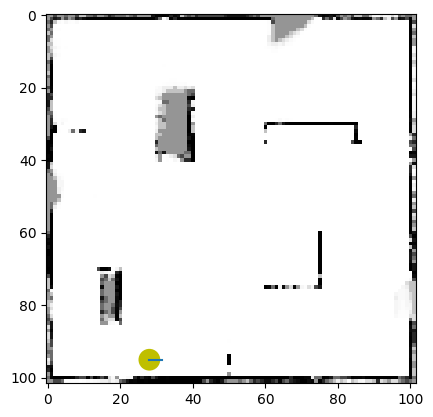

 79%|███████▉  | 600/759 [03:58<01:18,  2.01it/s]

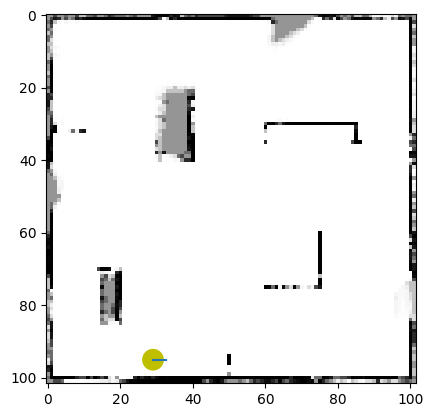

 79%|███████▉  | 601/759 [03:59<01:14,  2.13it/s]

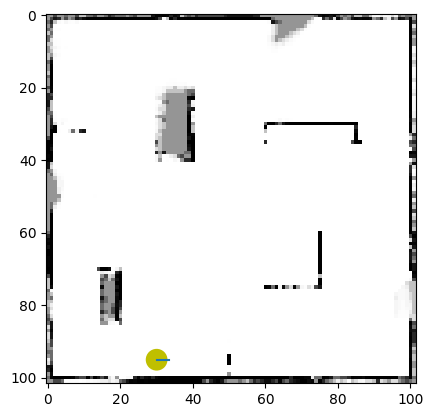

 79%|███████▉  | 602/759 [03:59<01:12,  2.16it/s]

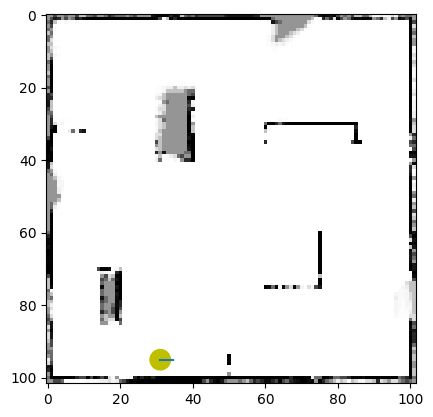

 79%|███████▉  | 603/759 [03:59<01:10,  2.22it/s]

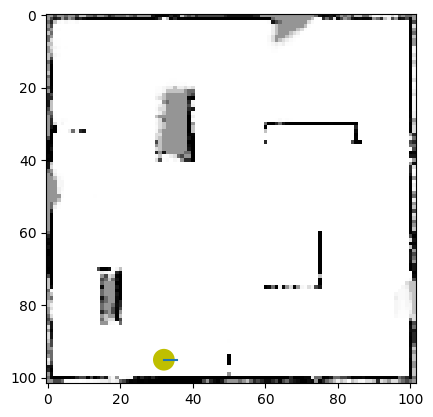

 80%|███████▉  | 604/759 [04:00<01:07,  2.30it/s]

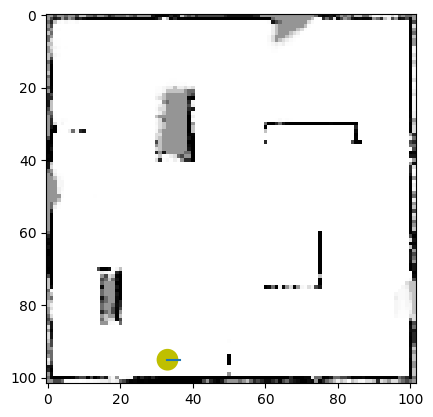

 80%|███████▉  | 605/759 [04:00<01:08,  2.25it/s]

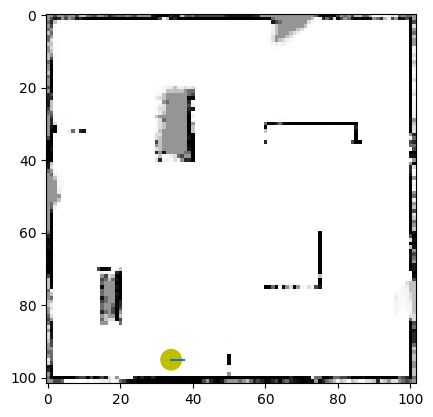

 80%|███████▉  | 606/759 [04:01<01:11,  2.14it/s]

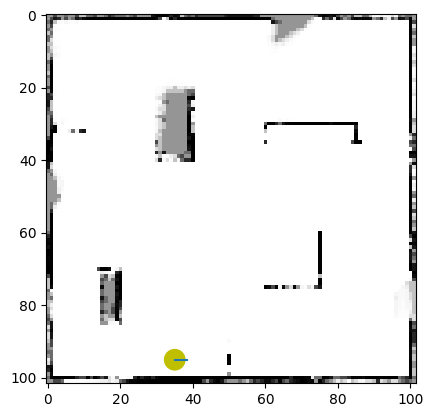

 80%|███████▉  | 607/759 [04:01<01:07,  2.27it/s]

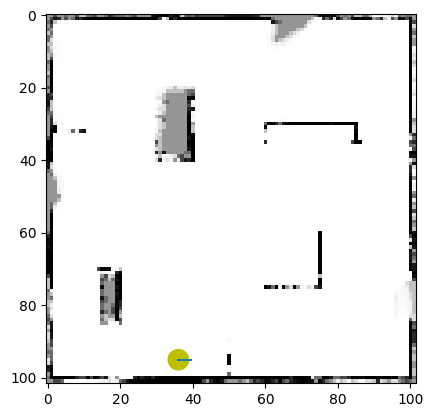

 80%|████████  | 608/759 [04:02<01:10,  2.13it/s]

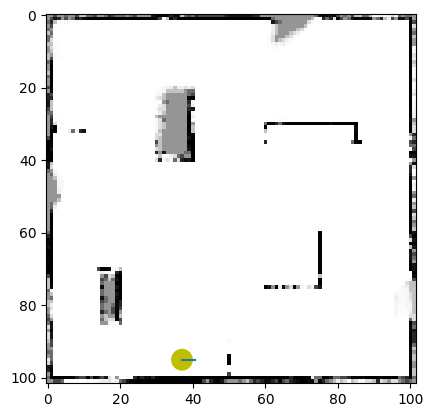

 80%|████████  | 609/759 [04:02<01:09,  2.16it/s]

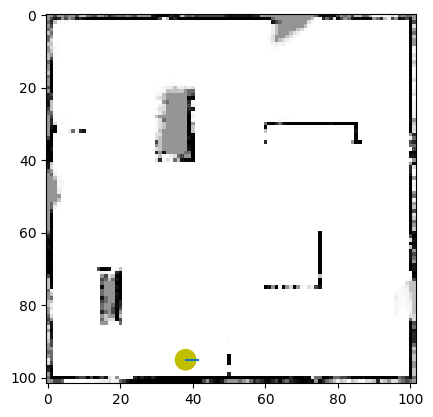

 80%|████████  | 610/759 [04:03<01:11,  2.10it/s]

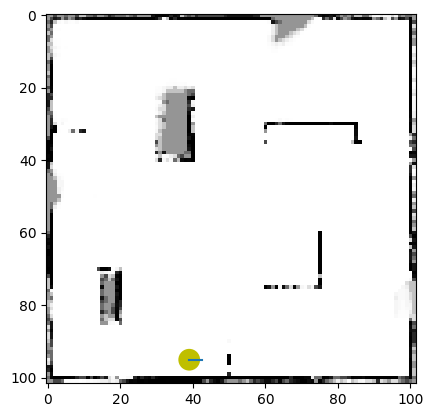

 81%|████████  | 611/759 [04:03<00:59,  2.49it/s]

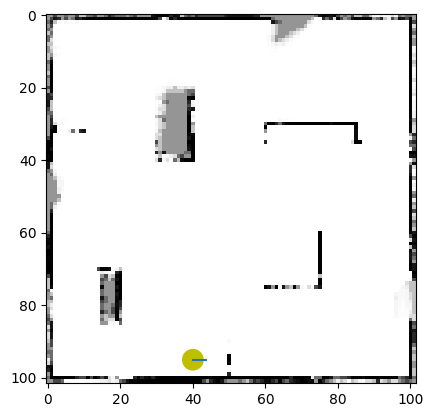

 81%|████████  | 612/759 [04:03<00:56,  2.61it/s]

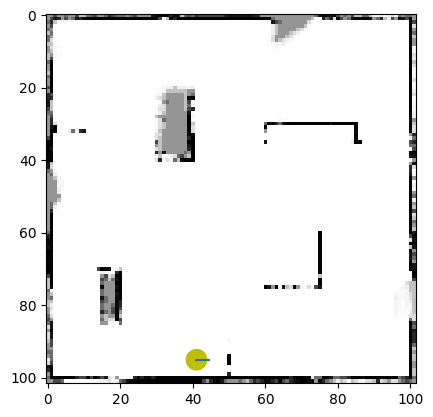

 81%|████████  | 613/759 [04:04<00:59,  2.44it/s]

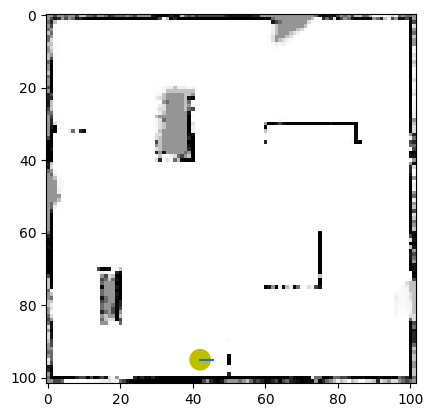

 81%|████████  | 614/759 [04:04<01:01,  2.36it/s]

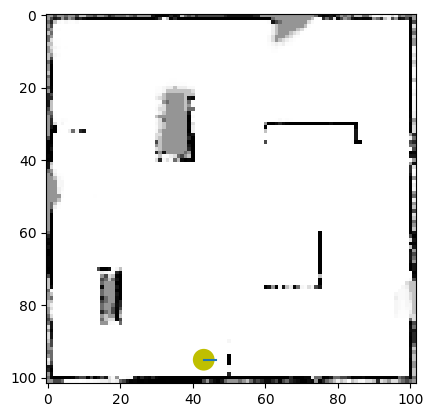

 81%|████████  | 615/759 [04:05<01:03,  2.26it/s]

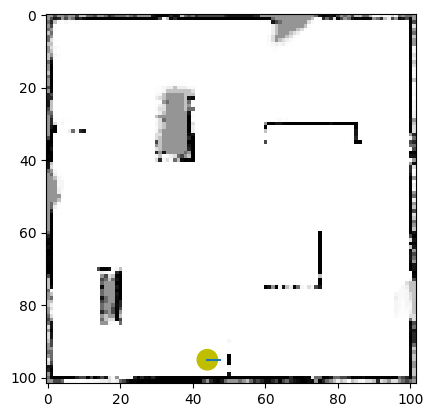

 81%|████████  | 616/759 [04:05<01:04,  2.21it/s]

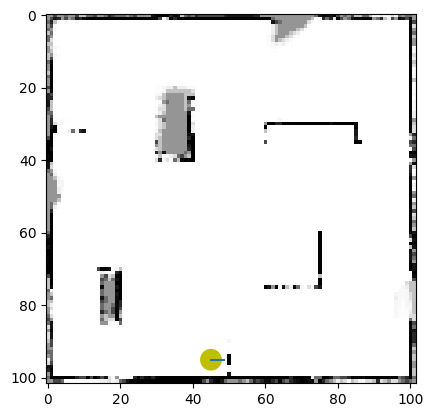

 81%|████████▏ | 617/759 [04:06<01:00,  2.33it/s]

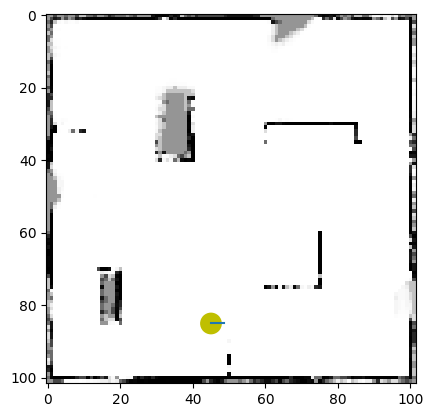

 81%|████████▏ | 618/759 [04:06<00:58,  2.41it/s]

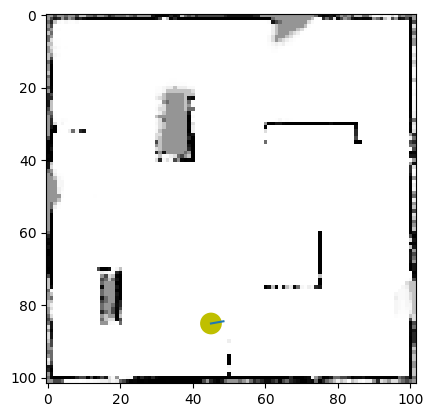

 82%|████████▏ | 619/759 [04:06<01:01,  2.26it/s]

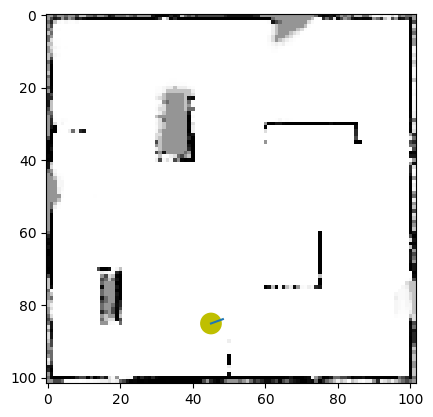

 82%|████████▏ | 620/759 [04:07<01:03,  2.18it/s]

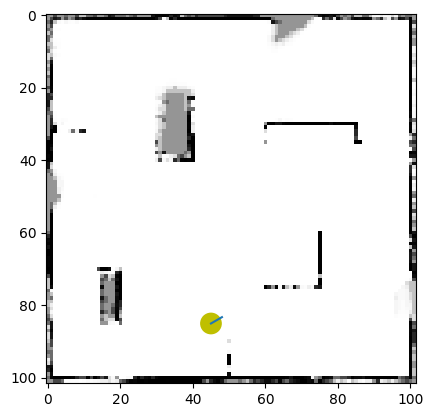

 82%|████████▏ | 621/759 [04:07<01:03,  2.16it/s]

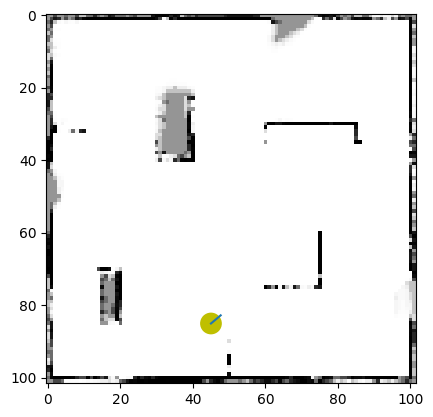

 82%|████████▏ | 622/759 [04:08<01:05,  2.08it/s]

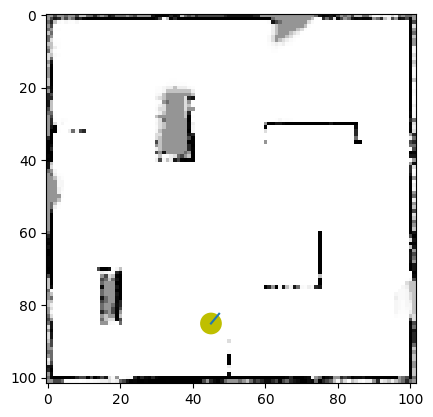

 82%|████████▏ | 623/759 [04:08<01:04,  2.10it/s]

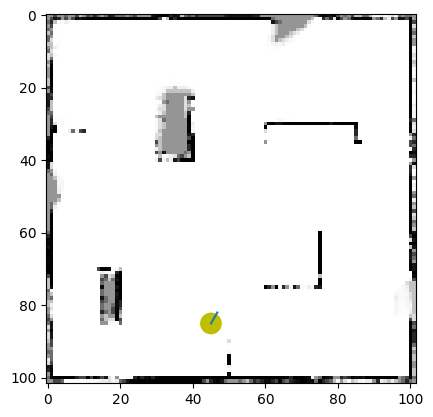

 82%|████████▏ | 624/759 [04:09<01:00,  2.25it/s]

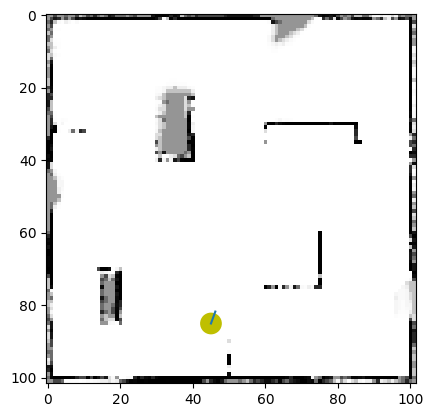

 82%|████████▏ | 625/759 [04:09<00:58,  2.29it/s]

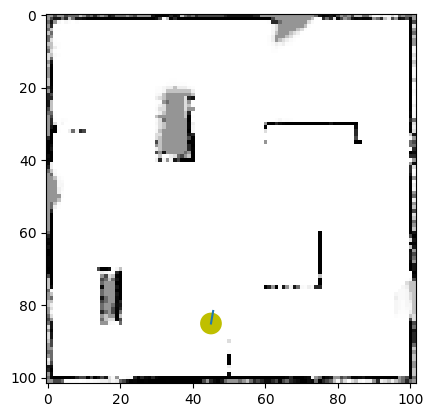

 82%|████████▏ | 626/759 [04:10<01:01,  2.18it/s]

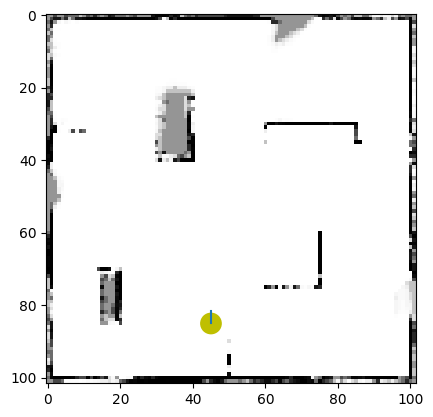

 83%|████████▎ | 627/759 [04:10<01:01,  2.14it/s]

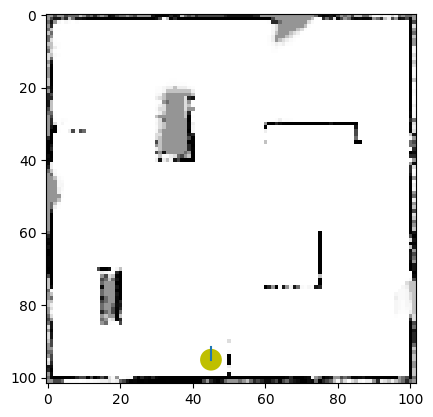

 83%|████████▎ | 628/759 [04:11<00:57,  2.28it/s]

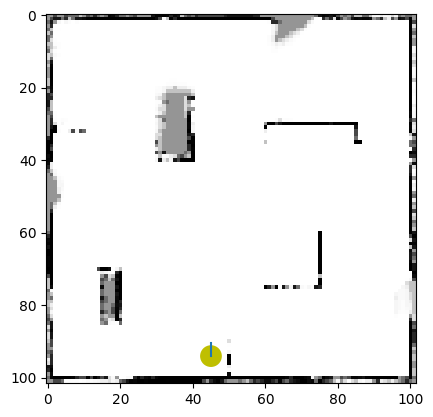

 83%|████████▎ | 629/759 [04:11<00:58,  2.23it/s]

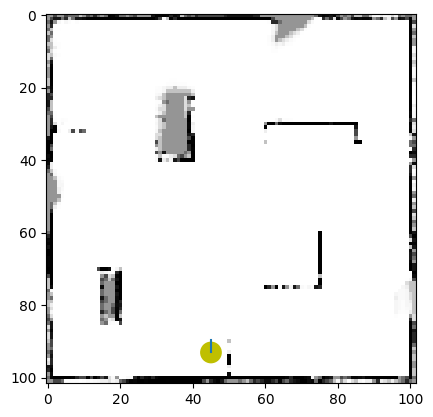

 83%|████████▎ | 630/759 [04:11<00:56,  2.29it/s]

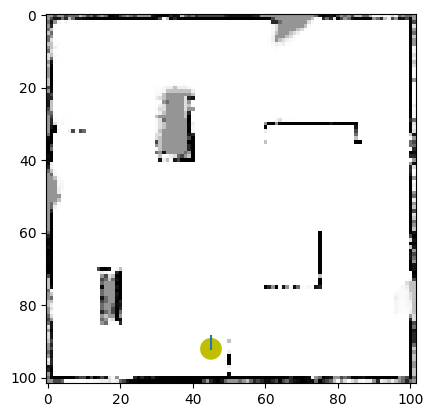

 83%|████████▎ | 631/759 [04:12<00:55,  2.32it/s]

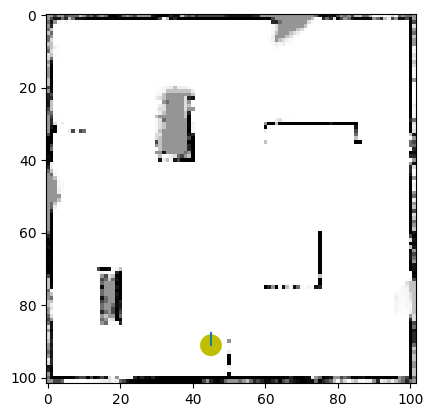

 83%|████████▎ | 632/759 [04:12<00:51,  2.45it/s]

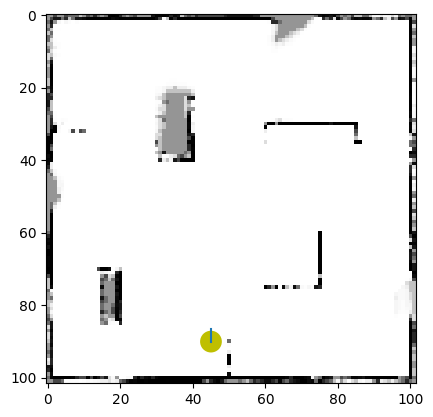

 83%|████████▎ | 633/759 [04:13<00:55,  2.29it/s]

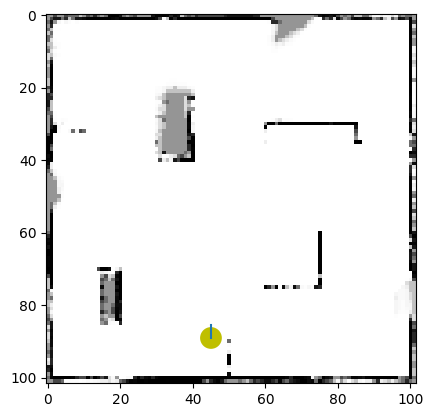

 84%|████████▎ | 634/759 [04:13<00:55,  2.24it/s]

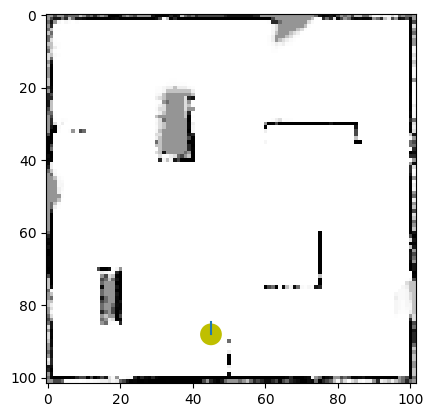

 84%|████████▎ | 635/759 [04:14<00:59,  2.07it/s]

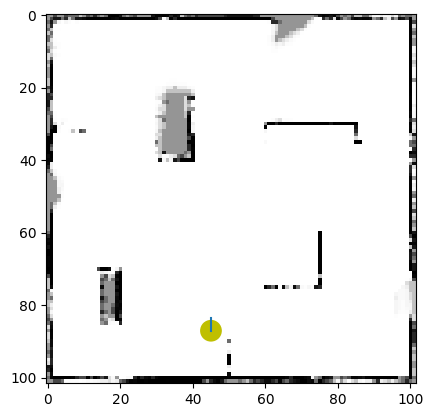

 84%|████████▍ | 636/759 [04:14<00:55,  2.23it/s]

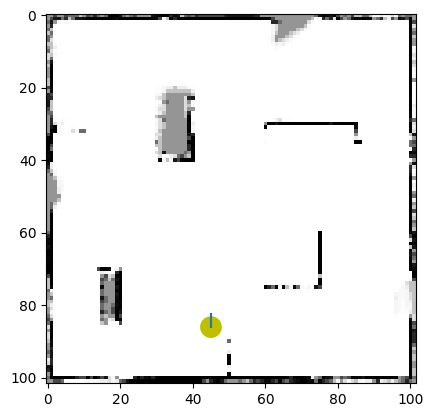

 84%|████████▍ | 637/759 [04:15<00:56,  2.18it/s]

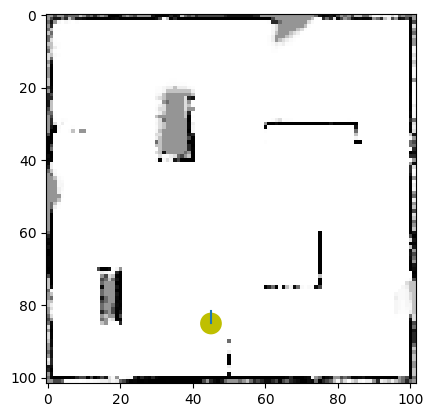

 84%|████████▍ | 638/759 [04:15<00:56,  2.16it/s]

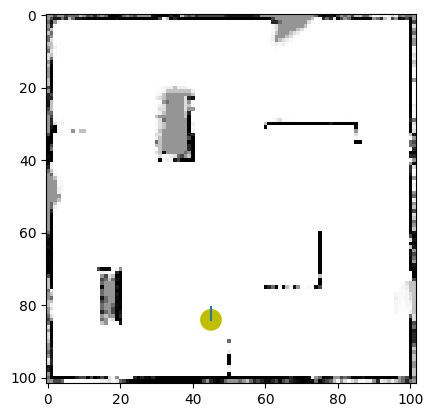

 84%|████████▍ | 639/759 [04:15<00:52,  2.27it/s]

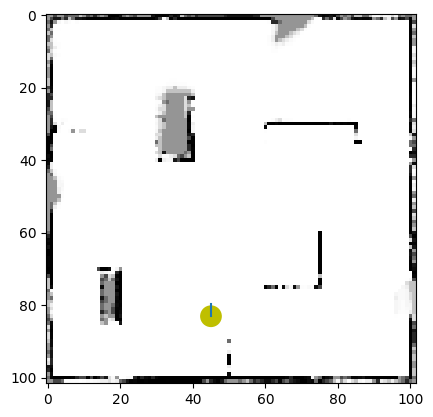

 84%|████████▍ | 640/759 [04:16<00:49,  2.42it/s]

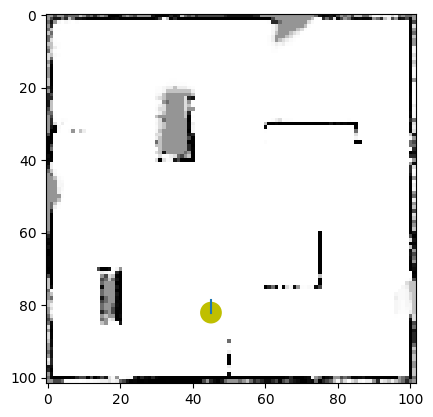

 84%|████████▍ | 641/759 [04:16<00:47,  2.48it/s]

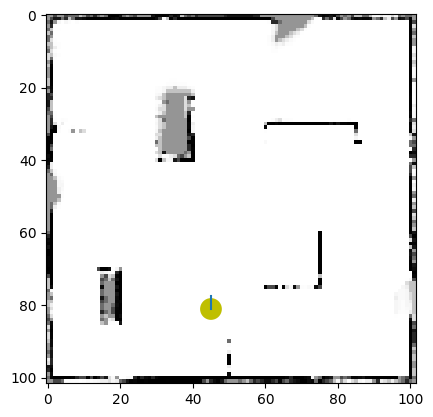

 85%|████████▍ | 642/759 [04:17<00:46,  2.54it/s]

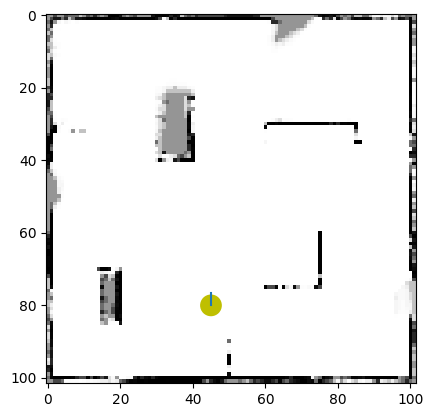

 85%|████████▍ | 643/759 [04:17<00:45,  2.53it/s]

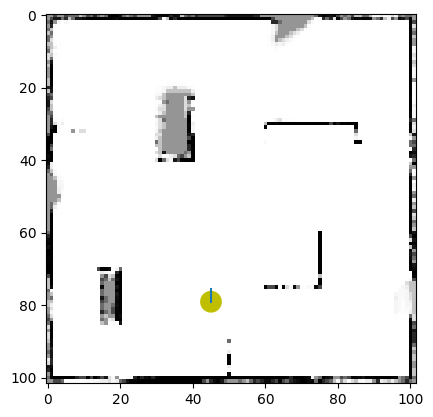

 85%|████████▍ | 644/759 [04:17<00:39,  2.90it/s]

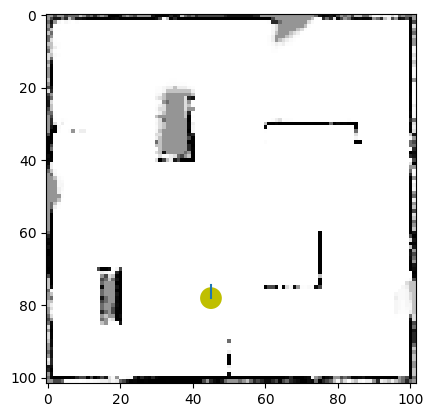

 85%|████████▍ | 645/759 [04:17<00:38,  2.93it/s]

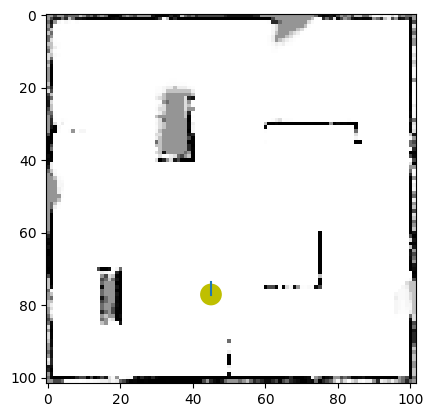

 85%|████████▌ | 646/759 [04:18<00:38,  2.97it/s]

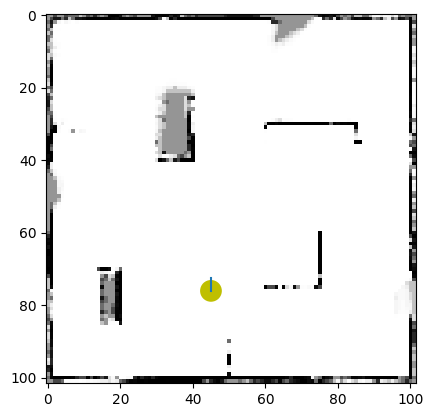

 85%|████████▌ | 647/759 [04:18<00:36,  3.06it/s]

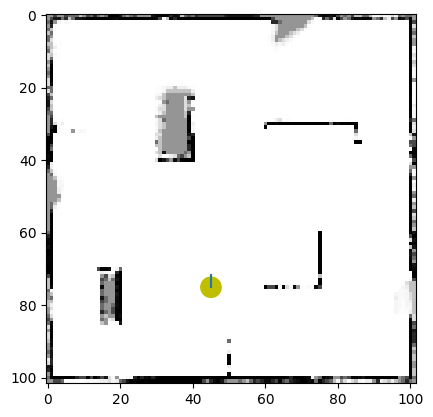

 85%|████████▌ | 648/759 [04:19<00:43,  2.53it/s]

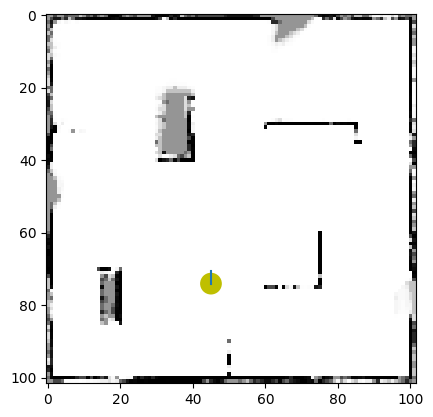

 86%|████████▌ | 649/759 [04:19<00:47,  2.31it/s]

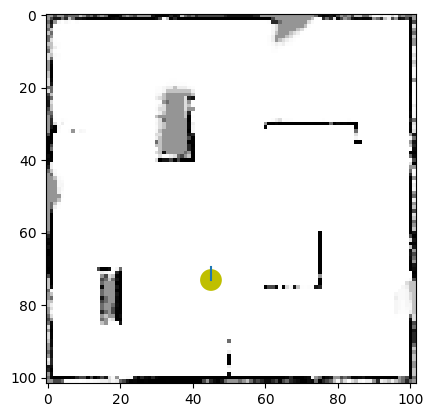

 86%|████████▌ | 650/759 [04:20<00:49,  2.20it/s]

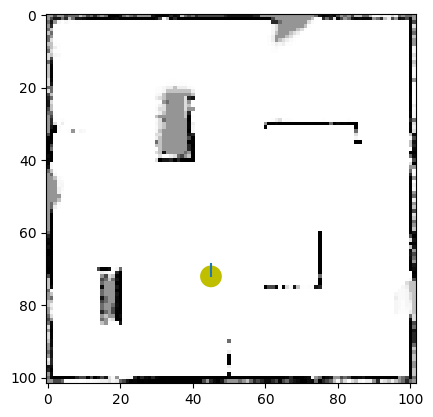

 86%|████████▌ | 651/759 [04:20<00:45,  2.36it/s]

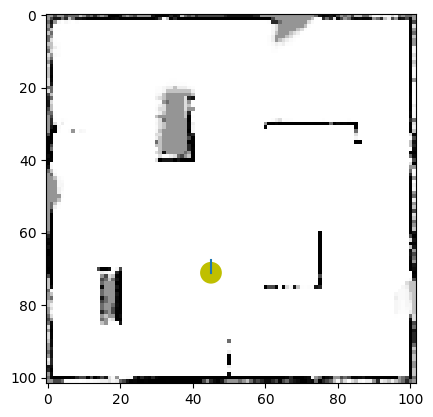

 86%|████████▌ | 652/759 [04:20<00:44,  2.39it/s]

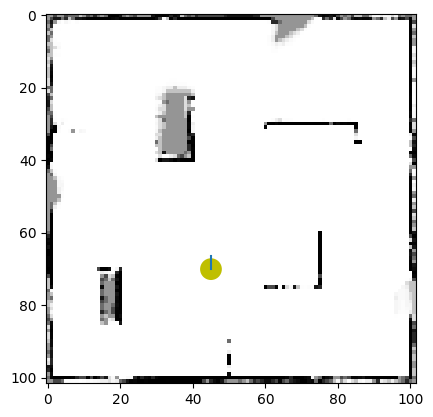

 86%|████████▌ | 653/759 [04:21<00:42,  2.50it/s]

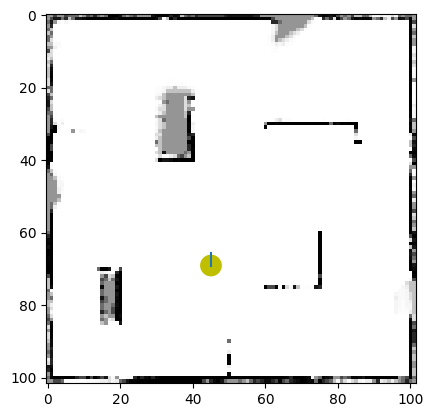

 86%|████████▌ | 654/759 [04:21<00:41,  2.53it/s]

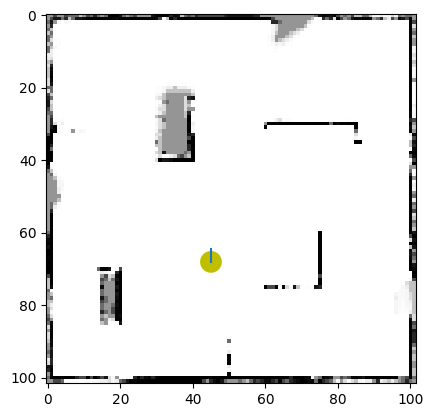

 86%|████████▋ | 655/759 [04:22<00:42,  2.44it/s]

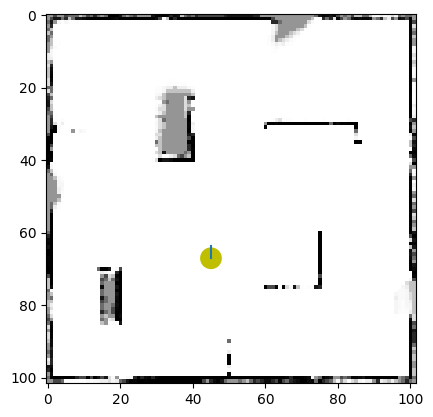

 86%|████████▋ | 656/759 [04:22<00:43,  2.38it/s]

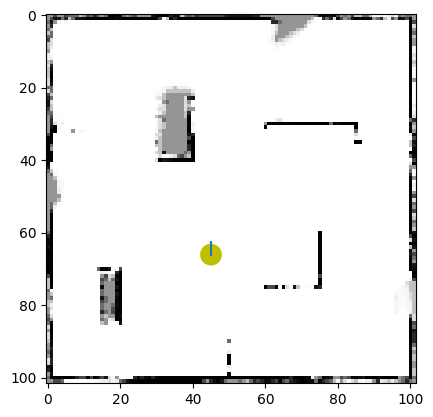

 87%|████████▋ | 657/759 [04:22<00:39,  2.56it/s]

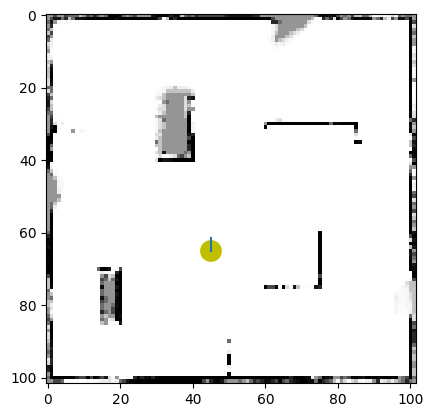

 87%|████████▋ | 658/759 [04:23<00:38,  2.60it/s]

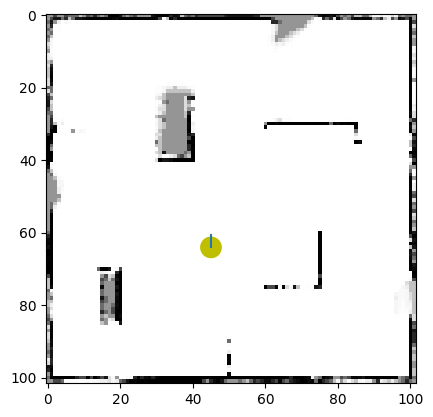

 87%|████████▋ | 659/759 [04:23<00:39,  2.55it/s]

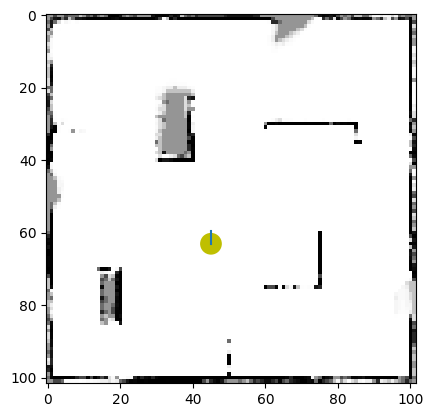

 87%|████████▋ | 660/759 [04:24<00:42,  2.31it/s]

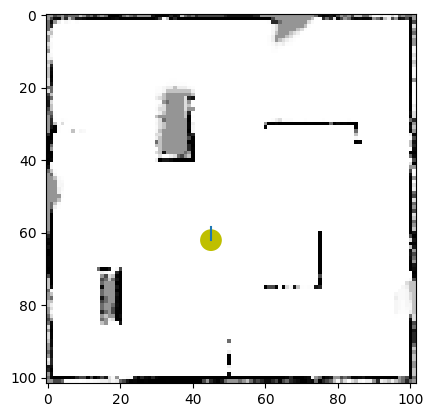

 87%|████████▋ | 661/759 [04:24<00:43,  2.26it/s]

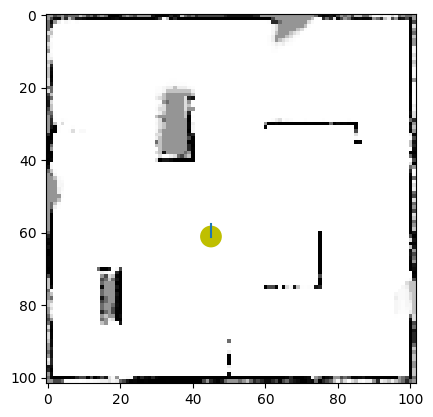

 87%|████████▋ | 662/759 [04:25<00:46,  2.07it/s]

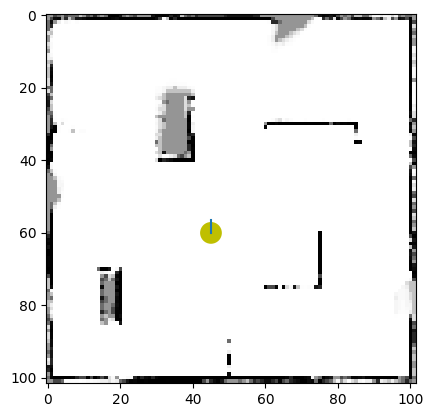

 87%|████████▋ | 663/759 [04:25<00:46,  2.05it/s]

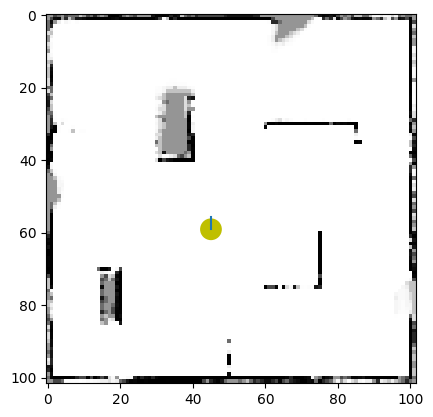

 87%|████████▋ | 664/759 [04:26<00:45,  2.07it/s]

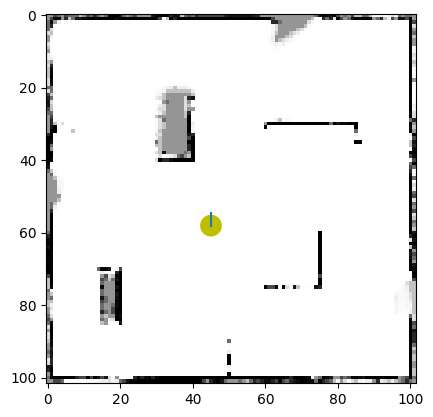

 88%|████████▊ | 665/759 [04:26<00:44,  2.10it/s]

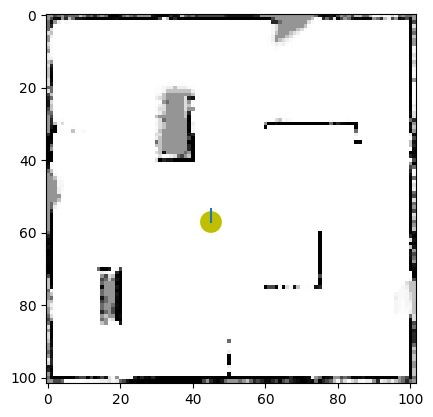

 88%|████████▊ | 666/759 [04:27<00:45,  2.05it/s]

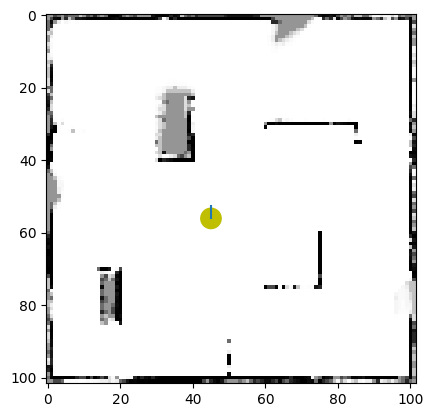

 88%|████████▊ | 667/759 [04:27<00:42,  2.16it/s]

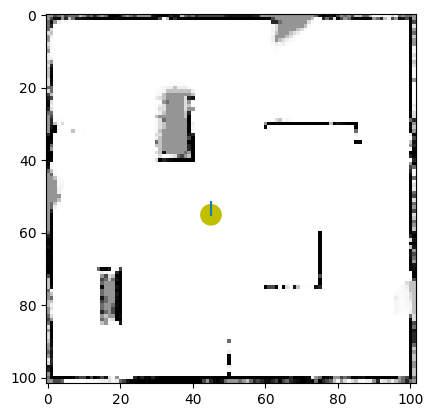

 88%|████████▊ | 668/759 [04:27<00:36,  2.48it/s]

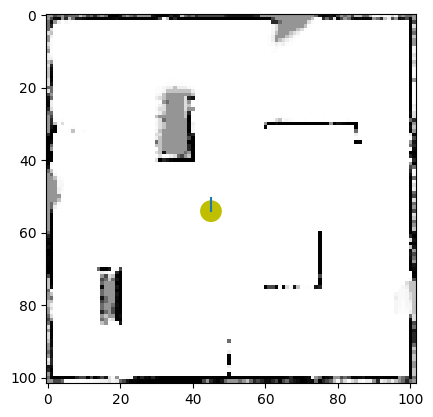

 88%|████████▊ | 669/759 [04:28<00:31,  2.85it/s]

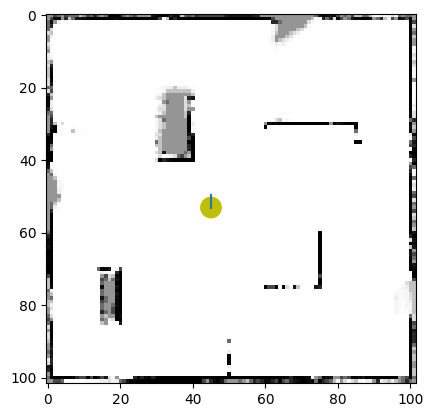

 88%|████████▊ | 670/759 [04:28<00:28,  3.15it/s]

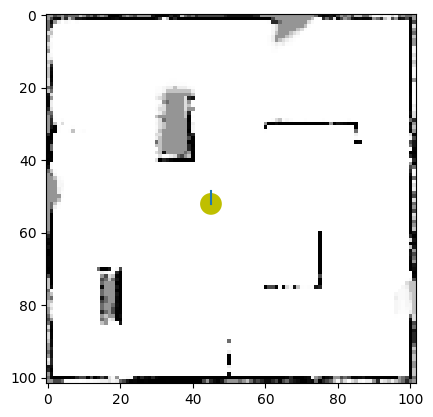

 88%|████████▊ | 671/759 [04:28<00:31,  2.84it/s]

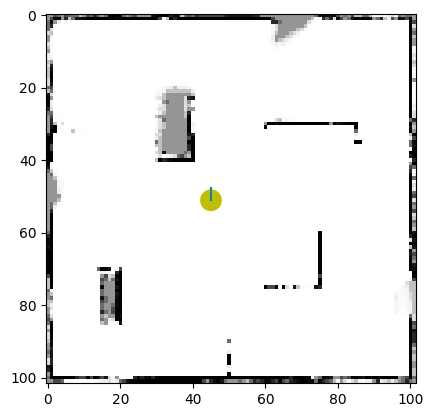

 89%|████████▊ | 672/759 [04:29<00:31,  2.77it/s]

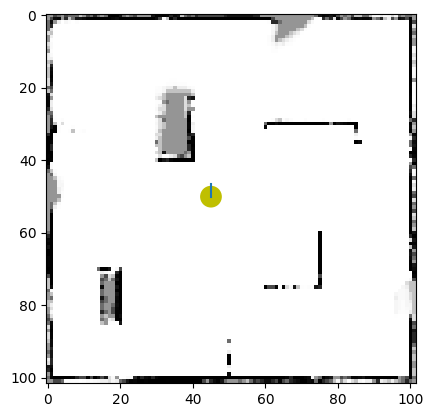

 89%|████████▊ | 673/759 [04:29<00:30,  2.79it/s]

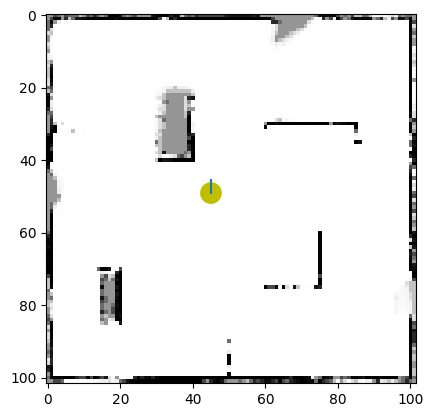

 89%|████████▉ | 674/759 [04:29<00:33,  2.50it/s]

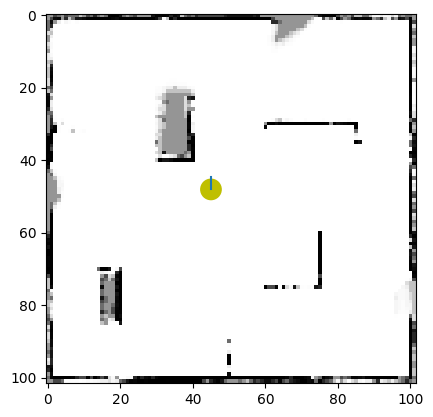

 89%|████████▉ | 675/759 [04:30<00:32,  2.55it/s]

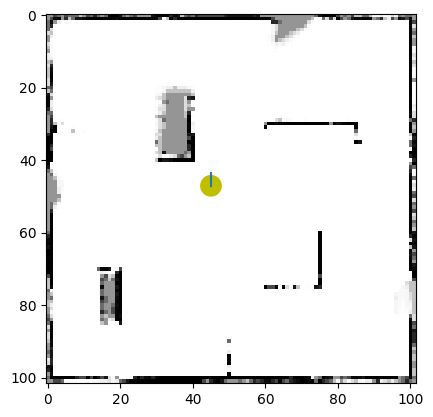

 89%|████████▉ | 676/759 [04:30<00:34,  2.38it/s]

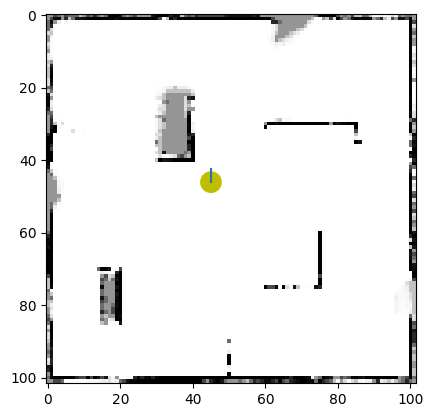

 89%|████████▉ | 677/759 [04:31<00:31,  2.60it/s]

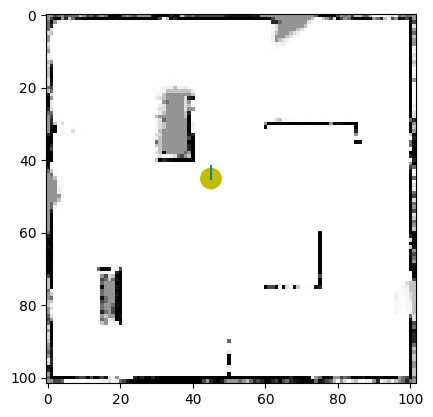

 89%|████████▉ | 678/759 [04:31<00:32,  2.51it/s]

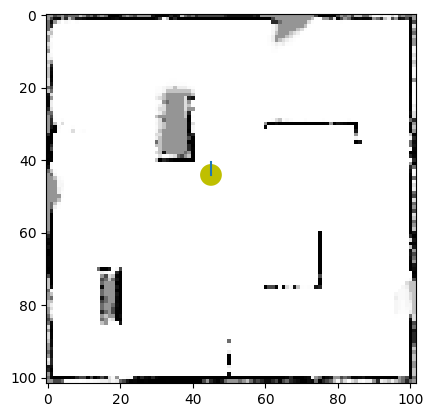

 89%|████████▉ | 679/759 [04:31<00:27,  2.87it/s]

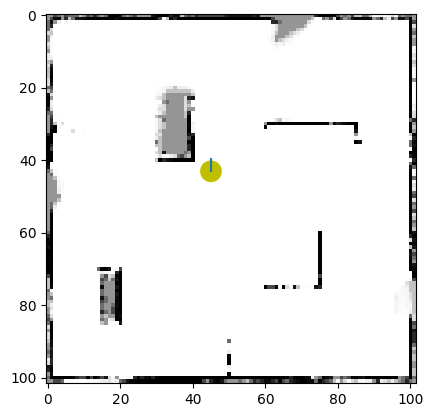

 90%|████████▉ | 680/759 [04:32<00:26,  3.03it/s]

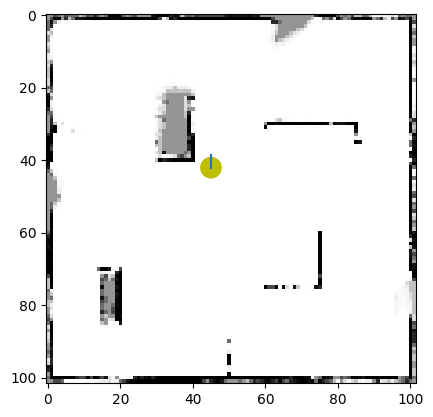

 90%|████████▉ | 681/759 [04:32<00:23,  3.28it/s]

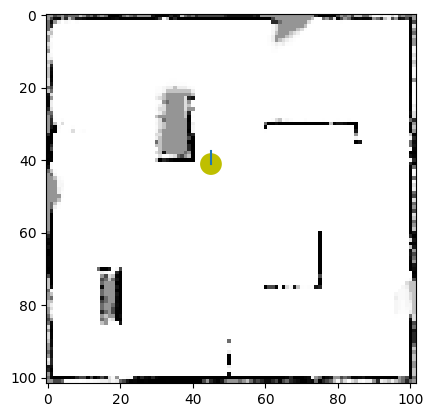

 90%|████████▉ | 682/759 [04:32<00:26,  2.89it/s]

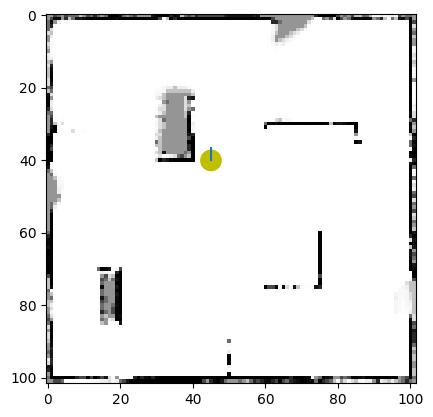

 90%|████████▉ | 683/759 [04:33<00:28,  2.64it/s]

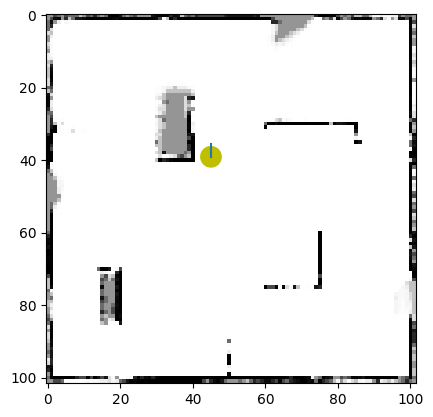

 90%|█████████ | 684/759 [04:33<00:27,  2.72it/s]

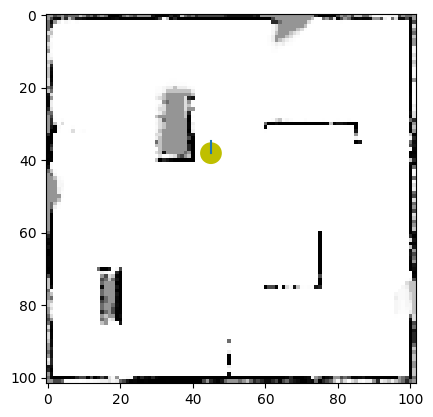

 90%|█████████ | 685/759 [04:33<00:24,  3.06it/s]

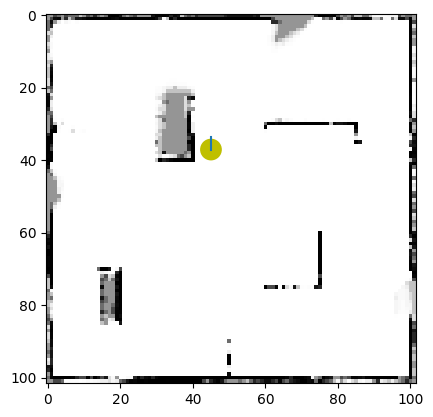

 90%|█████████ | 686/759 [04:34<00:21,  3.35it/s]

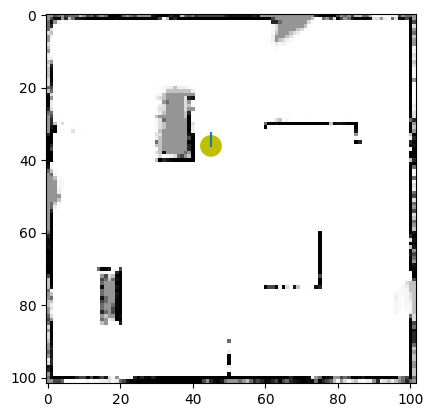

 91%|█████████ | 687/759 [04:34<00:20,  3.56it/s]

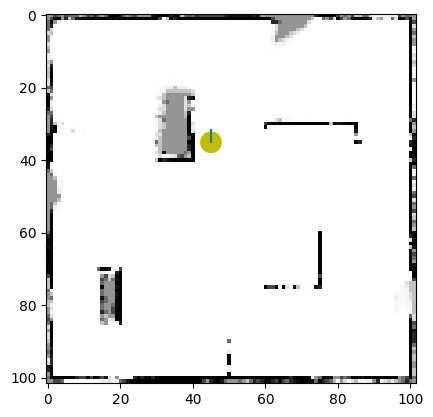

 91%|█████████ | 688/759 [04:34<00:21,  3.38it/s]

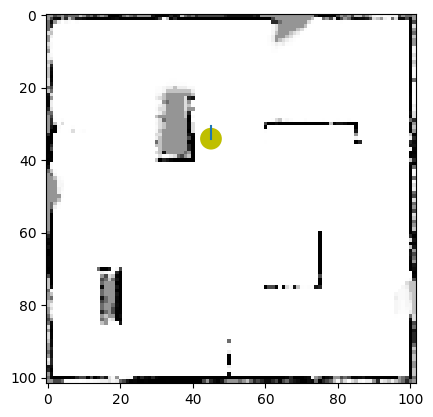

 91%|█████████ | 689/759 [04:35<00:23,  2.97it/s]

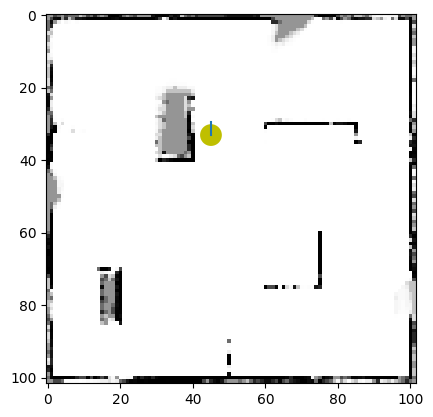

 91%|█████████ | 690/759 [04:35<00:27,  2.54it/s]

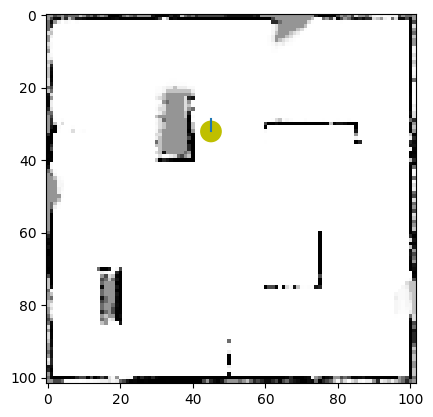

 91%|█████████ | 691/759 [04:36<00:33,  2.04it/s]

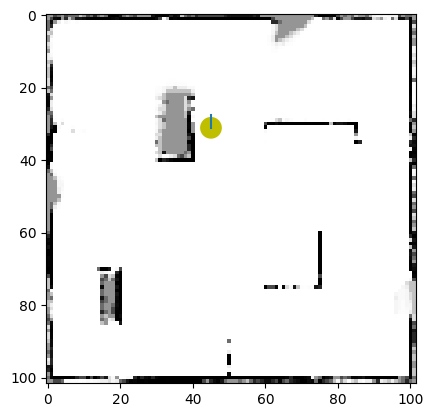

 91%|█████████ | 692/759 [04:36<00:35,  1.88it/s]

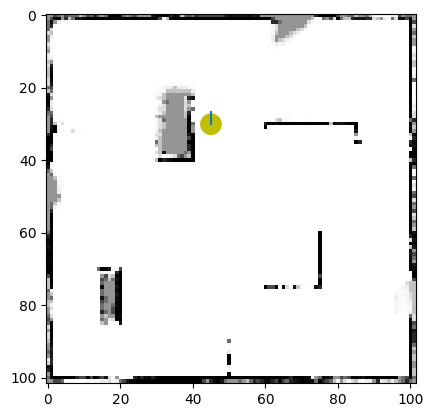

 91%|█████████▏| 693/759 [04:37<00:32,  2.03it/s]

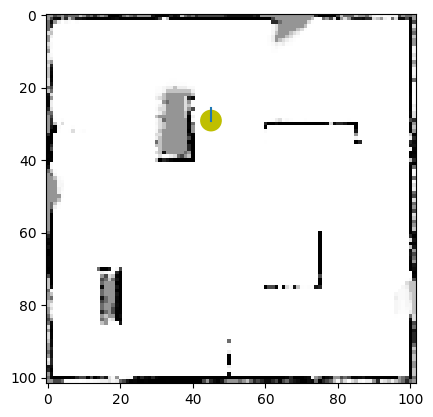

 91%|█████████▏| 694/759 [04:38<00:36,  1.77it/s]

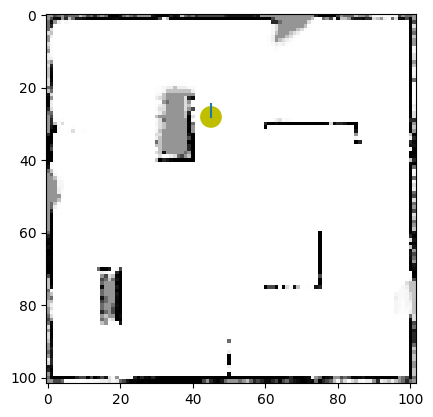

 92%|█████████▏| 695/759 [04:38<00:37,  1.71it/s]

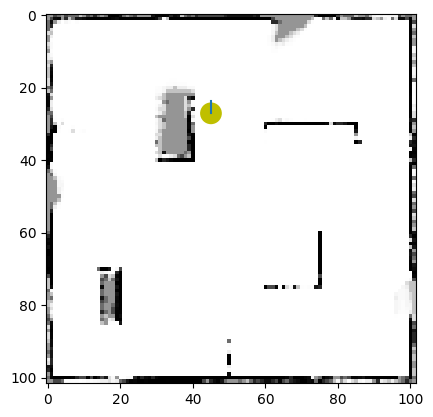

 92%|█████████▏| 696/759 [04:39<00:37,  1.69it/s]

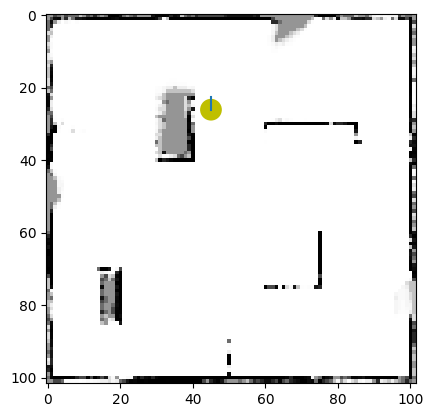

 92%|█████████▏| 697/759 [04:39<00:36,  1.72it/s]

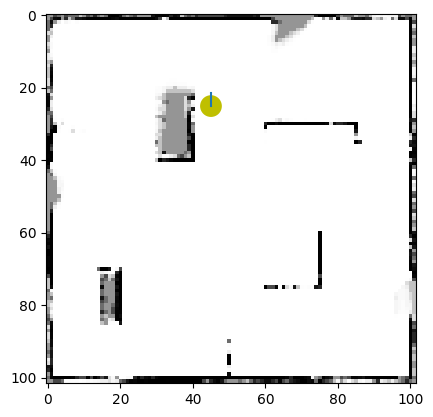

 92%|█████████▏| 698/759 [04:40<00:37,  1.62it/s]

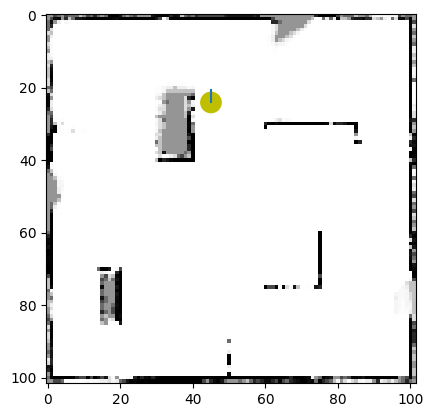

 92%|█████████▏| 699/759 [04:41<00:37,  1.59it/s]

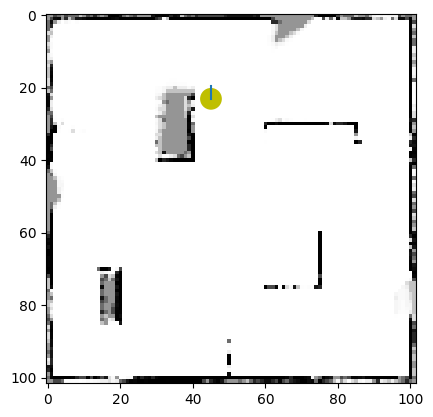

 92%|█████████▏| 700/759 [04:41<00:35,  1.64it/s]

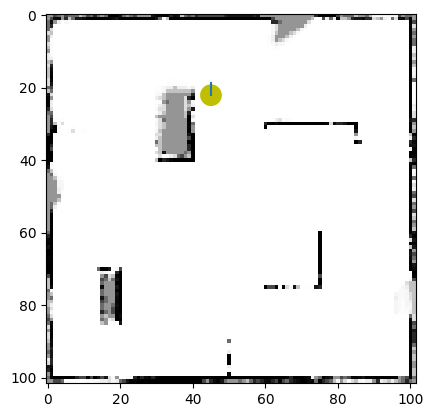

 92%|█████████▏| 701/759 [04:42<00:34,  1.67it/s]

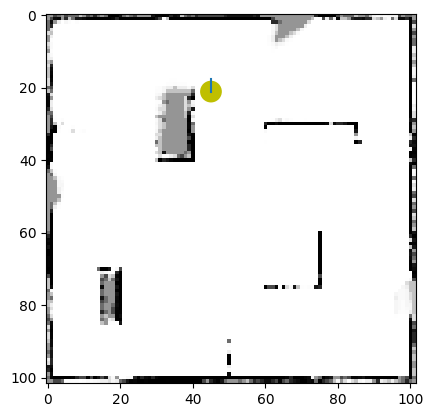

 92%|█████████▏| 702/759 [04:42<00:33,  1.69it/s]

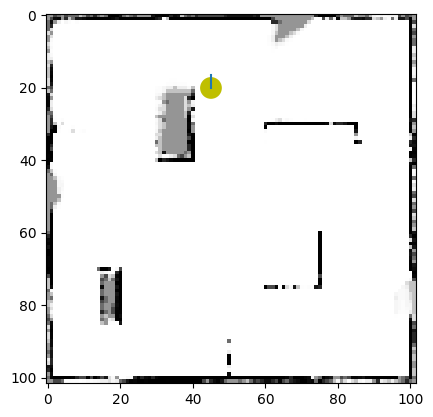

 93%|█████████▎| 703/759 [04:43<00:30,  1.81it/s]

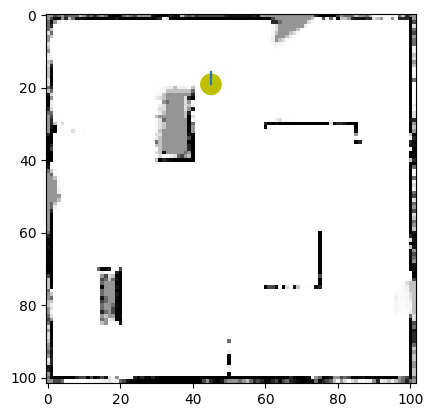

 93%|█████████▎| 704/759 [04:43<00:26,  2.06it/s]

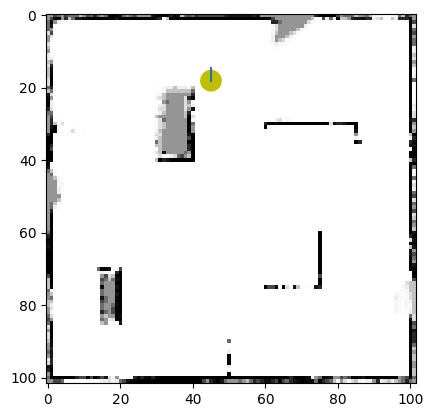

 93%|█████████▎| 705/759 [04:44<00:26,  2.01it/s]

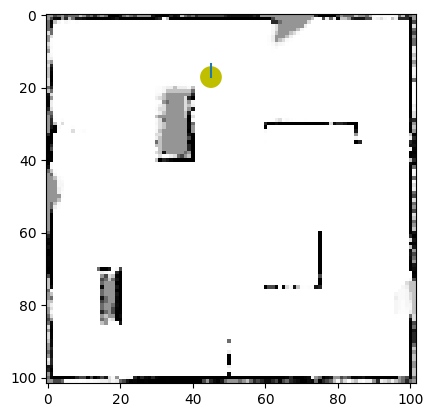

 93%|█████████▎| 706/759 [04:44<00:26,  1.99it/s]

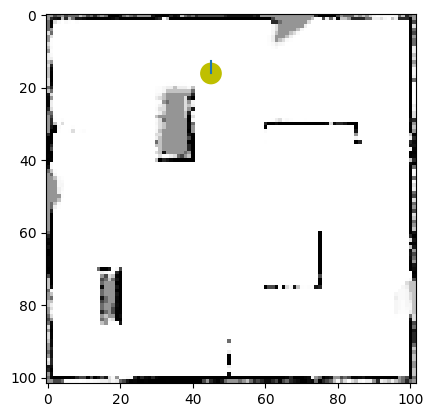

 93%|█████████▎| 707/759 [04:45<00:26,  1.97it/s]

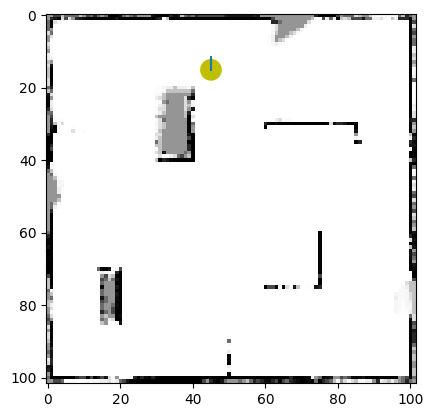

 93%|█████████▎| 708/759 [04:45<00:24,  2.08it/s]

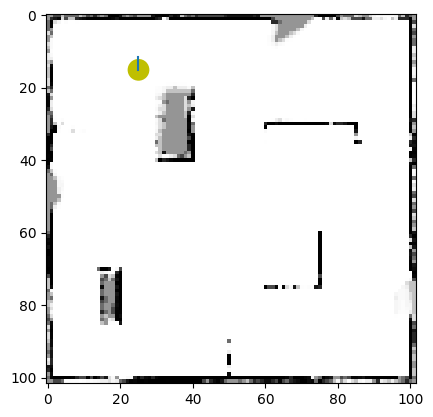

 93%|█████████▎| 709/759 [04:46<00:24,  2.04it/s]

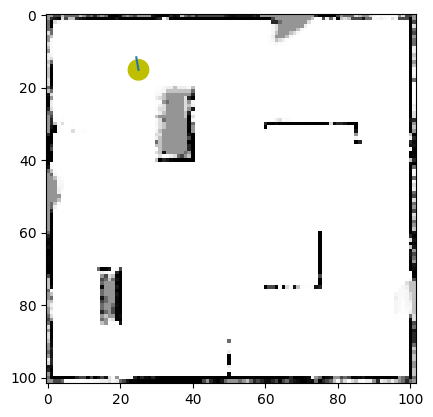

 94%|█████████▎| 710/759 [04:46<00:24,  2.01it/s]

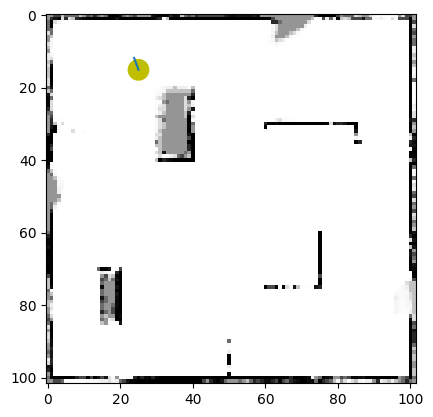

 94%|█████████▎| 711/759 [04:47<00:22,  2.10it/s]

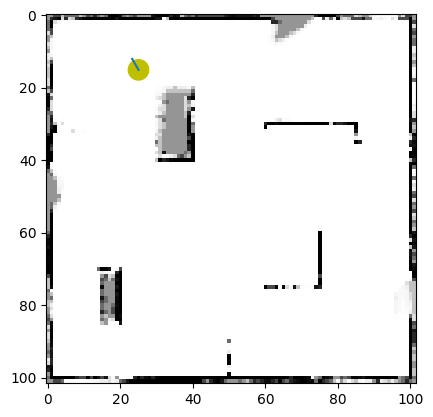

 94%|█████████▍| 712/759 [04:47<00:22,  2.12it/s]

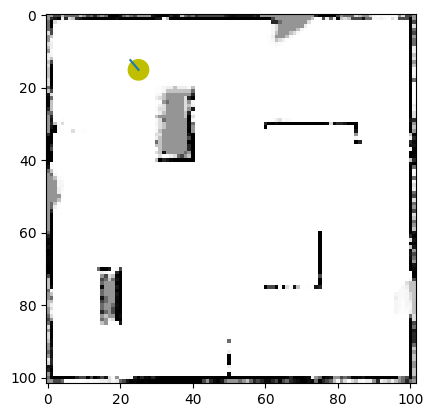

 94%|█████████▍| 713/759 [04:48<00:20,  2.24it/s]

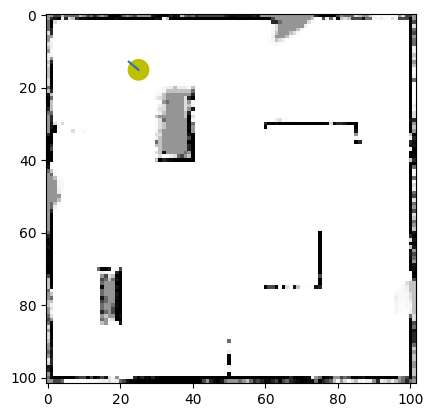

 94%|█████████▍| 714/759 [04:48<00:19,  2.33it/s]

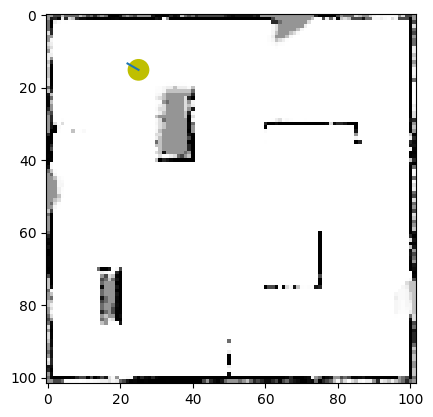

 94%|█████████▍| 715/759 [04:48<00:18,  2.33it/s]

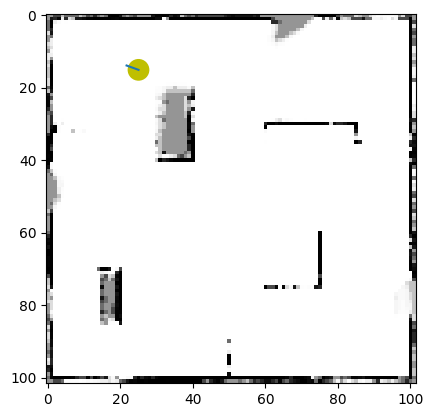

 94%|█████████▍| 716/759 [04:49<00:19,  2.18it/s]

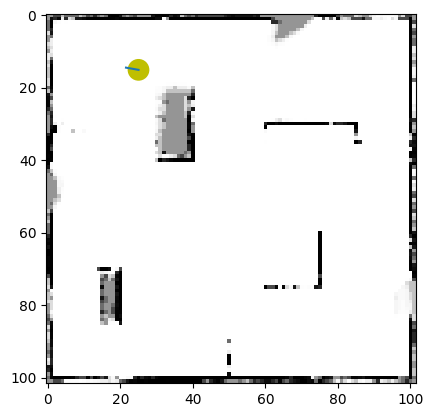

 94%|█████████▍| 717/759 [04:49<00:19,  2.12it/s]

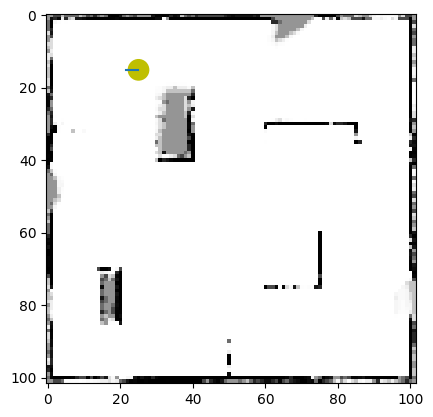

 95%|█████████▍| 718/759 [04:50<00:20,  2.01it/s]

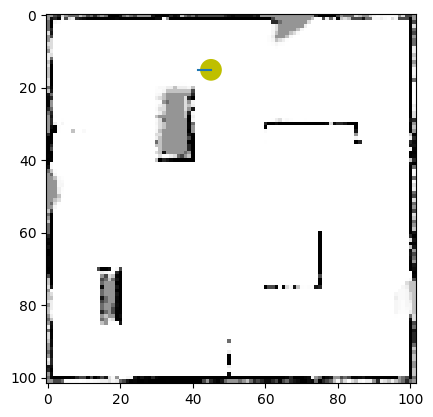

 95%|█████████▍| 719/759 [04:50<00:20,  1.93it/s]

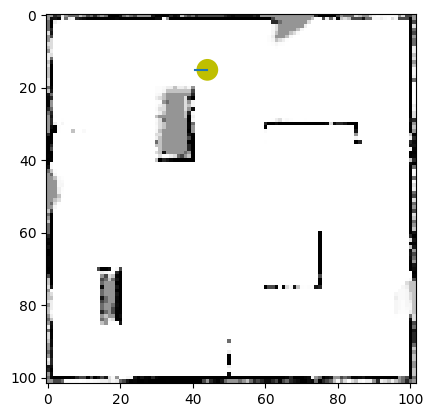

 95%|█████████▍| 720/759 [04:51<00:16,  2.33it/s]

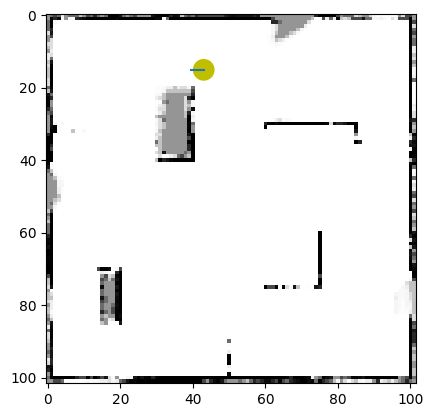

 95%|█████████▍| 721/759 [04:51<00:13,  2.73it/s]

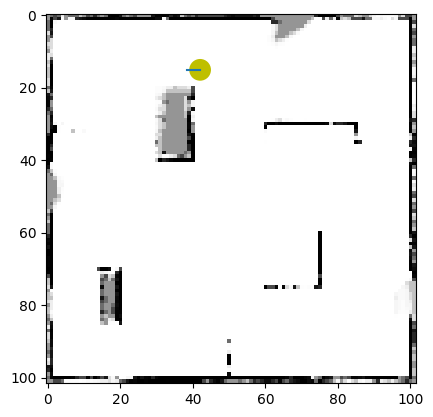

 95%|█████████▌| 722/759 [04:51<00:11,  3.10it/s]

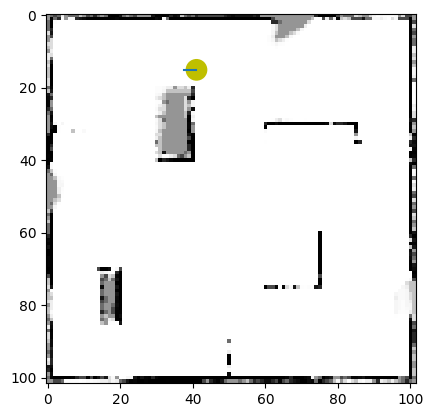

 95%|█████████▌| 723/759 [04:51<00:10,  3.40it/s]

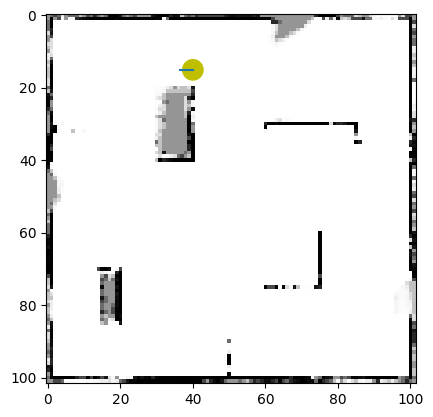

 95%|█████████▌| 724/759 [04:52<00:10,  3.20it/s]

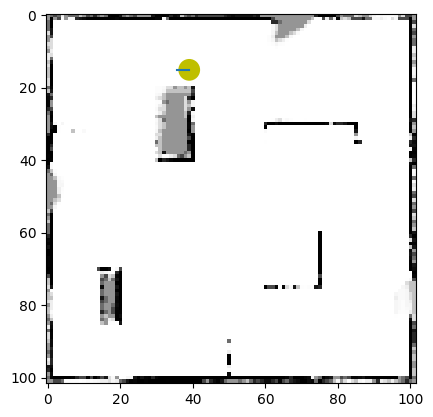

 96%|█████████▌| 725/759 [04:52<00:15,  2.22it/s]

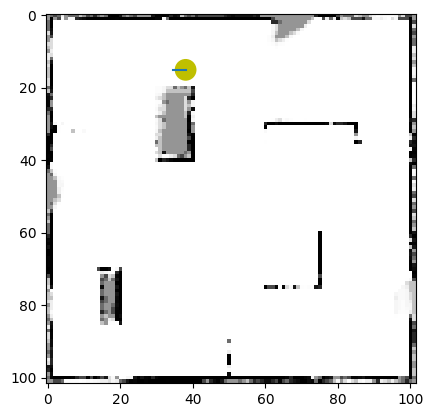

 96%|█████████▌| 726/759 [04:53<00:18,  1.75it/s]

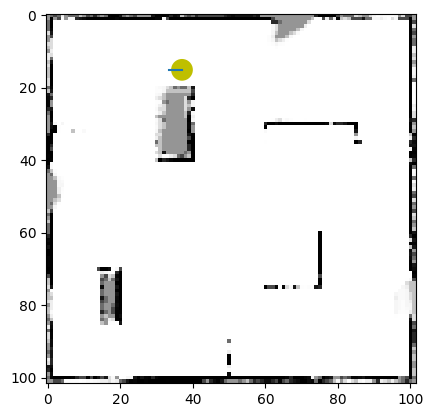

 96%|█████████▌| 727/759 [04:54<00:18,  1.77it/s]

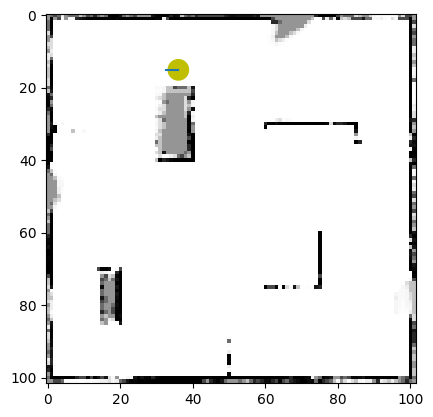

 96%|█████████▌| 728/759 [04:55<00:18,  1.70it/s]

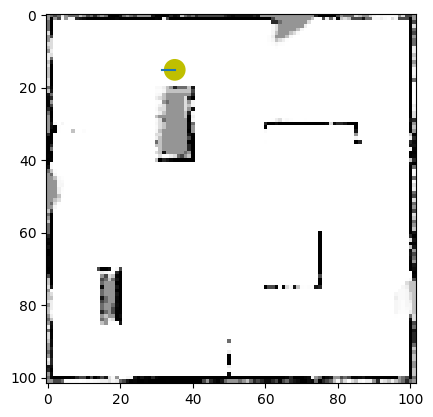

 96%|█████████▌| 729/759 [04:55<00:17,  1.76it/s]

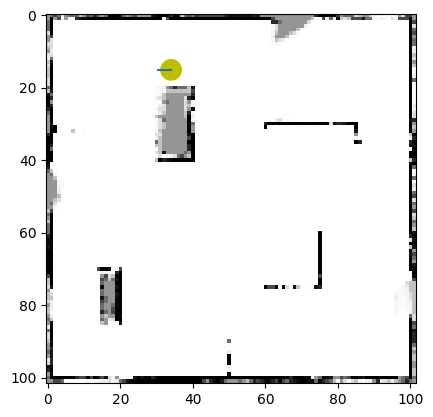

 96%|█████████▌| 730/759 [04:56<00:15,  1.83it/s]

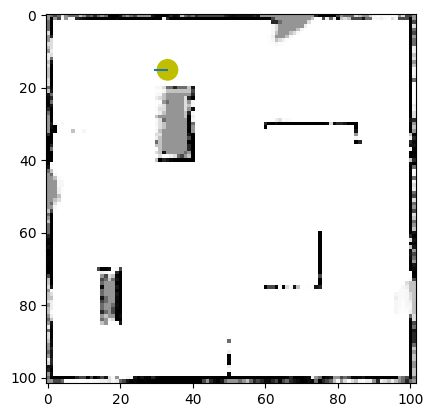

 96%|█████████▋| 731/759 [04:56<00:15,  1.77it/s]

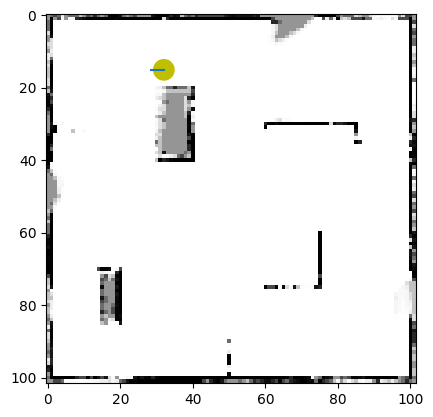

 96%|█████████▋| 732/759 [04:57<00:14,  1.86it/s]

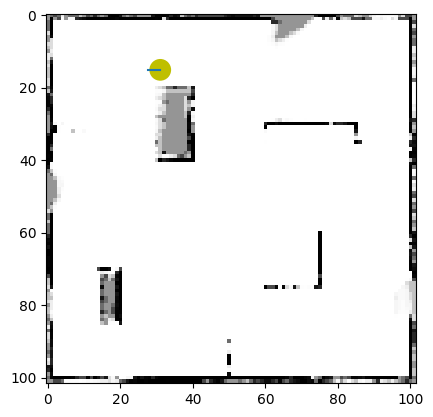

 97%|█████████▋| 733/759 [04:57<00:13,  1.87it/s]

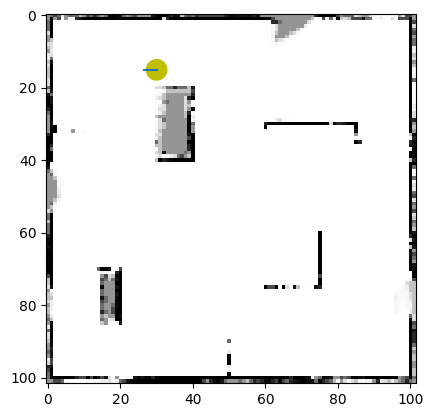

 97%|█████████▋| 734/759 [04:58<00:13,  1.87it/s]

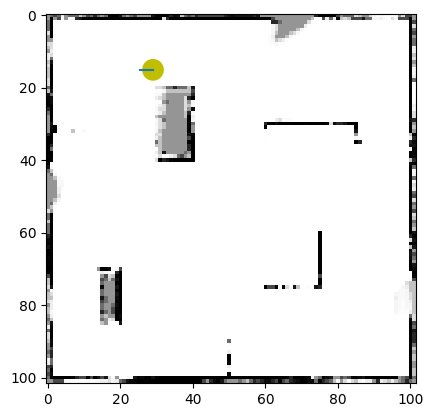

 97%|█████████▋| 735/759 [04:58<00:12,  1.92it/s]

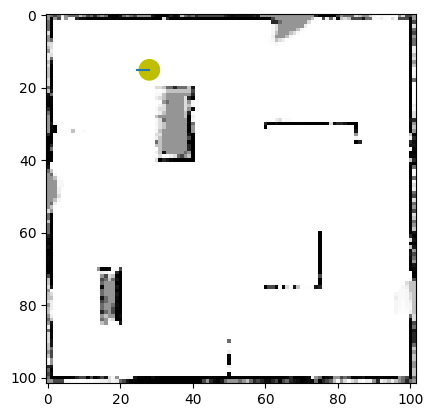

 97%|█████████▋| 736/759 [04:59<00:12,  1.79it/s]

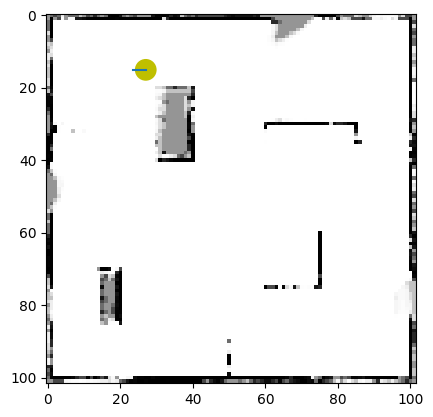

 97%|█████████▋| 737/759 [04:59<00:12,  1.82it/s]

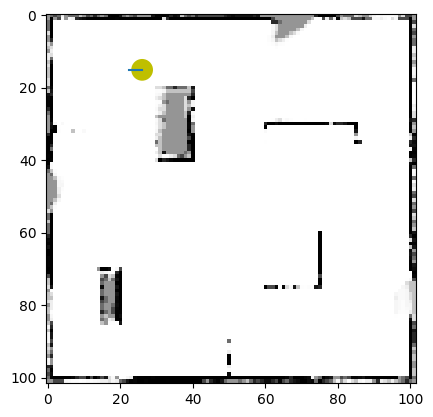

 97%|█████████▋| 738/759 [05:00<00:12,  1.71it/s]

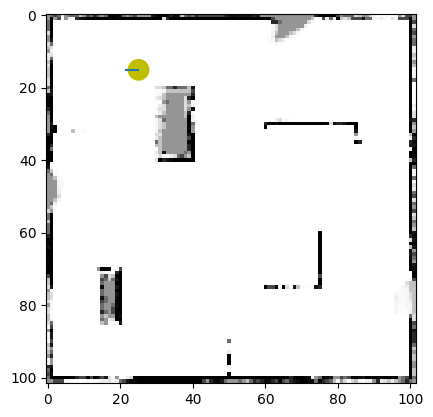

 97%|█████████▋| 739/759 [05:01<00:12,  1.61it/s]

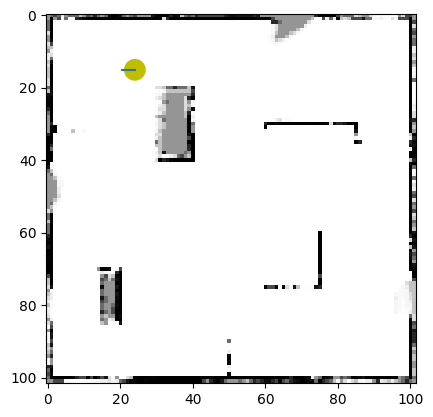

 97%|█████████▋| 740/759 [05:01<00:12,  1.58it/s]

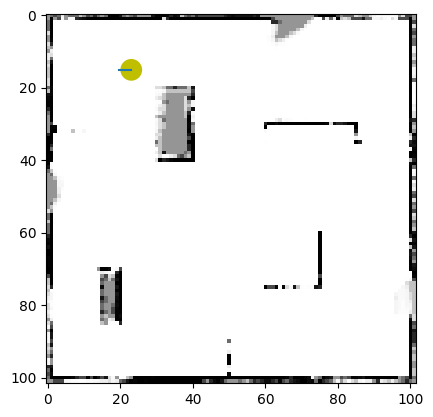

 98%|█████████▊| 741/759 [05:02<00:11,  1.64it/s]

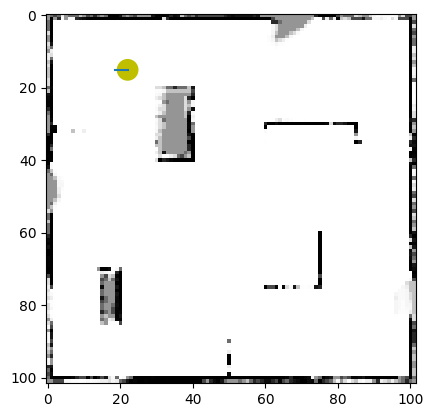

 98%|█████████▊| 742/759 [05:02<00:09,  1.75it/s]

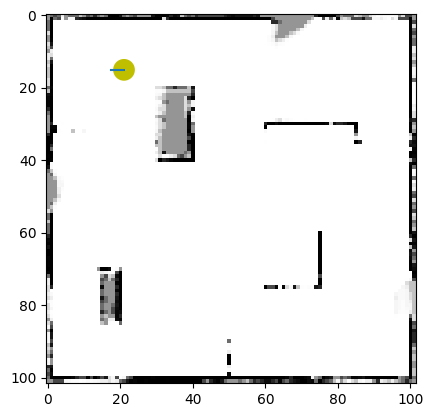

 98%|█████████▊| 743/759 [05:03<00:09,  1.72it/s]

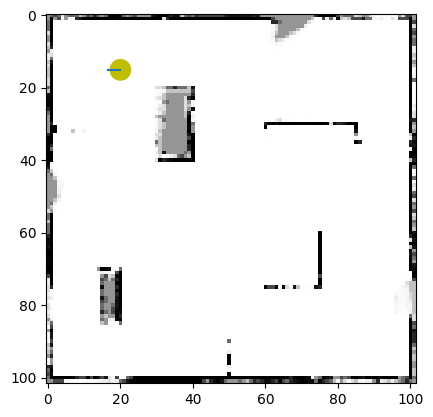

 98%|█████████▊| 744/759 [05:04<00:08,  1.82it/s]

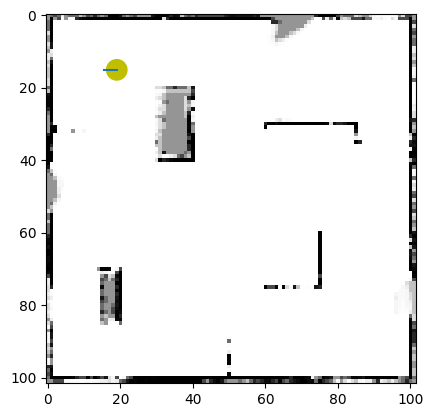

 98%|█████████▊| 745/759 [05:04<00:08,  1.74it/s]

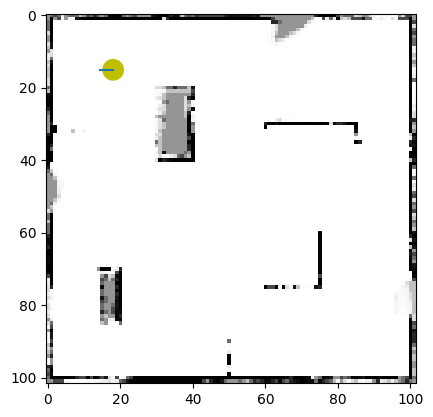

 98%|█████████▊| 746/759 [05:05<00:07,  1.70it/s]

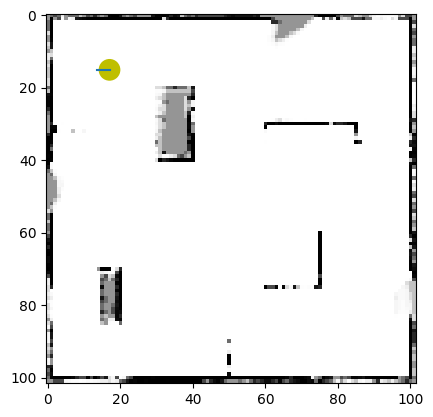

 98%|█████████▊| 747/759 [05:05<00:07,  1.63it/s]

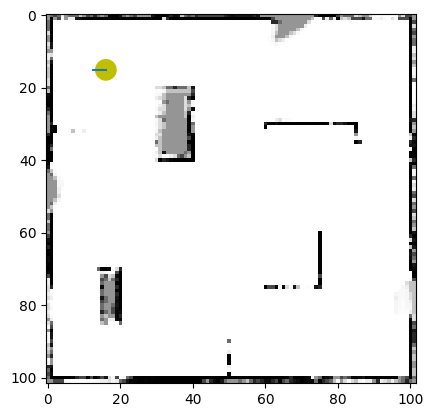

 99%|█████████▊| 748/759 [05:06<00:06,  1.66it/s]

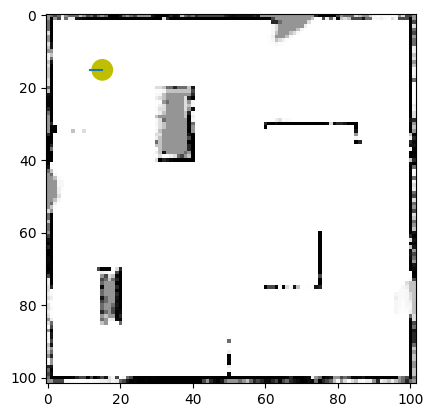

 99%|█████████▊| 749/759 [05:07<00:05,  1.68it/s]

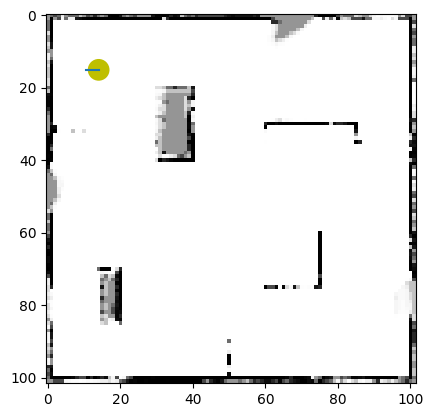

 99%|█████████▉| 750/759 [05:07<00:05,  1.66it/s]

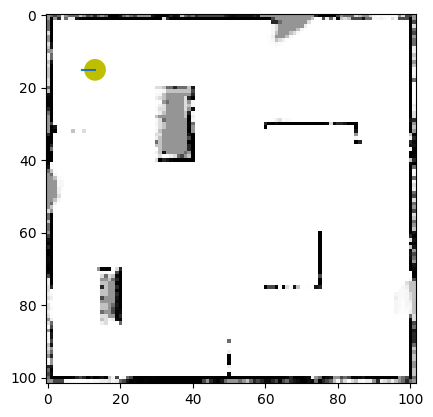

 99%|█████████▉| 751/759 [05:08<00:04,  1.68it/s]

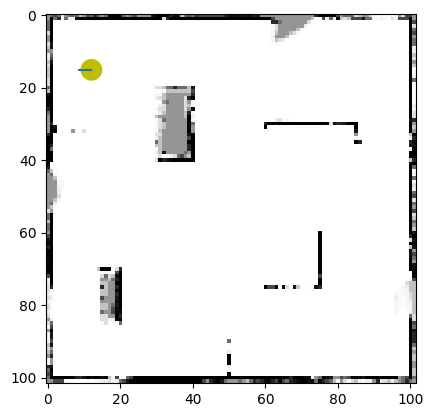

 99%|█████████▉| 752/759 [05:08<00:03,  1.75it/s]

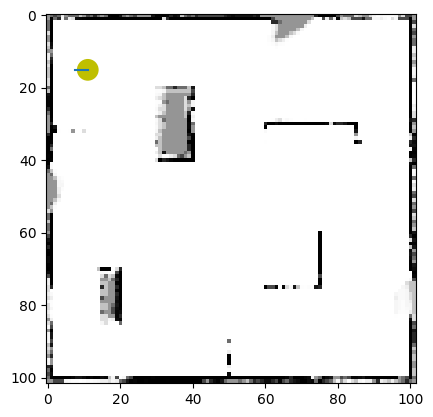

 99%|█████████▉| 753/759 [05:09<00:03,  1.71it/s]

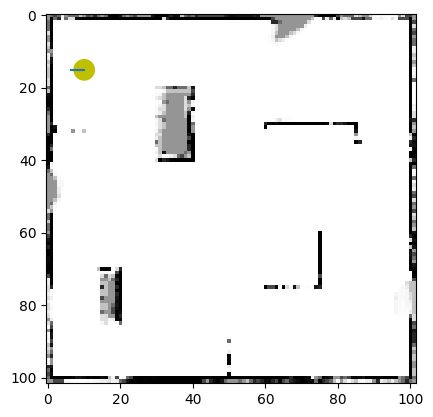

 99%|█████████▉| 754/759 [05:09<00:02,  1.78it/s]

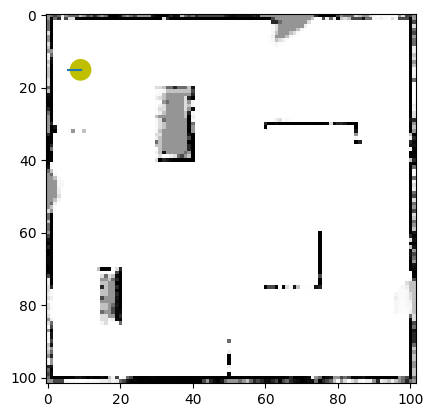

 99%|█████████▉| 755/759 [05:10<00:02,  1.73it/s]

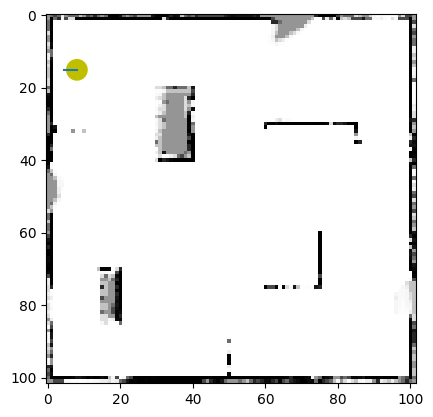

100%|█████████▉| 756/759 [05:11<00:01,  1.79it/s]

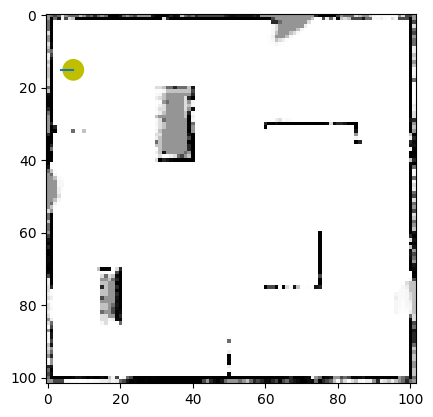

100%|█████████▉| 757/759 [05:11<00:01,  1.72it/s]

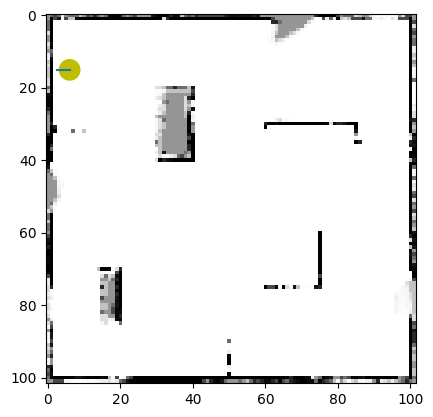

100%|█████████▉| 758/759 [05:12<00:00,  1.67it/s]

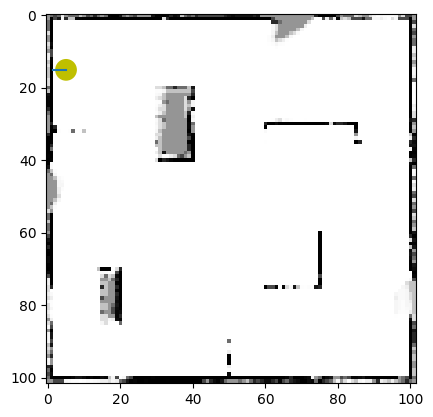

100%|██████████| 759/759 [05:12<00:00,  2.43it/s]


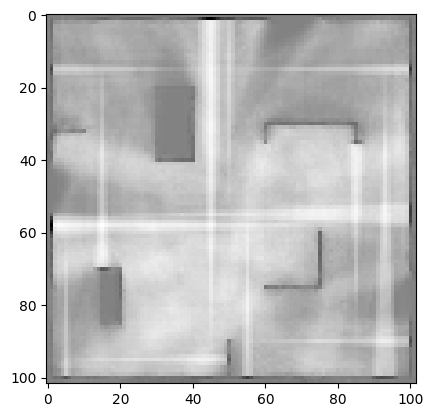

In [8]:
import scipy.io
import scipy.stats
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

class Map():

    def __init__(self, xsize, ysize, grid_size):
        self.xsize = xsize+2 # Add extra cells for the borders
        self.ysize = ysize+2
        self.grid_size = grid_size # save this off for future use
        self.log_prob_map = np.zeros((self.xsize, self.ysize)) # set all to zero

        self.alpha = 1.0 # settiamo alpha= spessore ostacoli 
        self.beta = 5.0*np.pi/180.0 # settiamo beta= larghezza del raggio laser
        self.z_max = 150.0 # settiamo la massima lettura del laser(pesumo sia la distanza massima)

        # Pre-allocare la posizione x e y di tutte le posizioni della griglia in un tensore 3D
        self.grid_position_m = np.array([np.tile(np.arange(0, self.xsize*self.grid_size, self.grid_size)[:,None], (1, self.ysize)),
                                         np.tile(np.arange(0, self.ysize*self.grid_size, self.grid_size)[:,None].T, (self.xsize, 1))])

        # settiamo le percentuali(probabilità logaritmica, log-odd )  che rendono una cella libera o occupata
        self.l_occ = np.log(0.65/0.35)
        self.l_free = np.log(0.35/0.65)

    def update_map(self, pose, z):

        dx = self.grid_position_m.copy() # A tensore di coordinate di tutte le celle
        dx[0, :, :] -= pose[0] # Una mtarice di tutte le coordinate x delle celle 
        dx[1, :, :] -= pose[1] # Una matrice di tutte le coordinate y delle celle 
        theta_to_grid = np.arctan2(dx[1, :, :], dx[0, :, :]) - pose[2] # Una matrice di tutti i cuscinetti dal robot alle celle 

        # conversione angolo in radianti
        theta_to_grid[theta_to_grid > np.pi] -= 2. * np.pi
        theta_to_grid[theta_to_grid < -np.pi] += 2. * np.pi

        # matrice delle distanze (calcolate utilizzando la norma 2) di tutte le celle rispetto alla posizione del robot
        dist_to_grid = scipy.linalg.norm(dx, axis=0) # matrix of L2 distance to all cells from robot

        # For each laser beam
        for z_i in z:
            r = z_i[0] #  (range del raggio laser)
            b = z_i[1] #  (angolo percepito (misura del raggio laser))

            free_mask = (np.abs(theta_to_grid - b) <= self.beta/2.0) & (dist_to_grid < (r - self.alpha/2.0))
            occ_mask = (np.abs(theta_to_grid - b) <= self.beta/2.0) & (np.abs(dist_to_grid - r) <= self.alpha/2.0)

            # Adjust the cells appropriately
            self.log_prob_map[occ_mask] += self.l_occ
            self.log_prob_map[free_mask] += self.l_free

if __name__ == '__main__':
    
    # carichiamo stato e misurazioni sensoriali
    # load matlab generated data (located at https://gitlab.magiccvs.byu.edu/superjax/595R/blob/88a577579a75dc744bca7630716211334e04a528/lab6/state_meas_data.mat?)
    data = scipy.io.loadmat('state_meas_data.mat')
    state = data['X']
    meas = data['z']

    # definiamo i parametri della mappa costruendo una mappa 100x100 con celle 1x1
    grid_size = 1.0
    map = Map(int(100/grid_size), int(100/grid_size), grid_size)

    plt.ion() # enable real-time plotting
    plt.figure(1) # create a plot
    #per ogni stato della mappa(posizione del robot) carica, aggiorna la mappa 
    for i in tqdm(range(len(state.T))): #tqdm è una libreria che genera automaticamente una barra di caricamento
        map.update_map(state[:,i], meas[:,:,i].T) # update the map

        # Real-Time Plotting 
        # (comment out these next lines to make it run super fast, matplotlib is painfully slow)
        plt.clf()
        pose = state[:,i]
        circle = plt.Circle((pose[1], pose[0]), radius=3.0, fc='y')
        plt.gca().add_patch(circle)
        arrow = pose[0:2] + np.array([3.5, 0]).dot(np.array([[np.cos(pose[2]), np.sin(pose[2])], [-np.sin(pose[2]), np.cos(pose[2])]]))
        plt.plot([pose[1], arrow[1]], [pose[0], arrow[0]])
        plt.imshow(1.0 - 1./(1.+np.exp(map.log_prob_map)), 'Greys')
        plt.pause(0.005)

    # Final Plotting
    plt.ioff()
    plt.clf()
    plt.imshow(1.0 - 1./(1.+np.exp(map.log_prob_map)), 'Greys') # This is probability
    plt.imshow(map.log_prob_map, 'Greys') # log probabilities (looks really cool)
    plt.show()